In [41]:
#Objectve -  What factors most affect the movie success?

In [97]:
import pandas as pd
import seaborn as sns
import numpy as np


import matplotlib
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize']= (12,8)
from io import StringIO


In [42]:
movi_data="""
name	rating	genre	year	released	score	votes	director	writer	star	country	budget	gross	company	runtime
The Shining	R	Drama	1980	June 13, 1980 (United States)	8.4	927000	Stanley Kubrick	Stephen King	Jack Nicholson	United Kingdom	19000000	46998772	Warner Bros.	146
The Blue Lagoon	R	Adventure	1980	July 2, 1980 (United States)	5.8	65000	Randal Kleiser	Henry De Vere Stacpoole	Brooke Shields	United States	4500000	58853106	Columbia Pictures	104
Star Wars: Episode V - The Empire Strikes Back	PG	Action	1980	June 20, 1980 (United States)	8.7	1200000	Irvin Kershner	Leigh Brackett	Mark Hamill	United States	18000000	538375067	Lucasfilm	124
Airplane!	PG	Comedy	1980	July 2, 1980 (United States)	7.7	221000	Jim Abrahams	Jim Abrahams	Robert Hays	United States	3500000	83453539	Paramount Pictures	88
Caddyshack	R	Comedy	1980	July 25, 1980 (United States)	7.3	108000	Harold Ramis	Brian Doyle-Murray	Chevy Chase	United States	6000000	39846344	Orion Pictures	98
Friday the 13th	R	Horror	1980	May 9, 1980 (United States)	6.4	123000	Sean S. Cunningham	Victor Miller	Betsy Palmer	United States	550000	39754601	Paramount Pictures	95
The Blues Brothers	R	Action	1980	June 20, 1980 (United States)	7.9	188000	John Landis	Dan Aykroyd	John Belushi	United States	27000000	115229890	Universal Pictures	133
Raging Bull	R	Biography	1980	December 19, 1980 (United States)	8.2	330000	Martin Scorsese	Jake LaMotta	Robert De Niro	United States	18000000	23402427	Chartoff-Winkler Productions	129
Superman II	PG	Action	1980	June 19, 1981 (United States)	6.8	101000	Richard Lester	Jerry Siegel	Gene Hackman	United States	54000000	108185706	Dovemead Films	127
The Long Riders	R	Biography	1980	May 16, 1980 (United States)	7	10000	Walter Hill	Bill Bryden	David Carradine	United States	10000000	15795189	United Artists	100
Any Which Way You Can	PG	Action	1980	December 17, 1980 (United States)	6.1	18000	Buddy Van Horn	Stanford Sherman	Clint Eastwood	United States	15000000	70687344	The Malpaso Company	116
The Gods Must Be Crazy	PG	Adventure	1980	October 26, 1984 (United States)	7.3	54000	Jamie Uys	Jamie Uys	N!xau	South Africa	5000000	30031783	C.A.T. Films	109
Popeye	PG	Adventure	1980	December 12, 1980 (United States)	5.3	30000	Robert Altman	Jules Feiffer	Robin Williams	United States	20000000	49823037	Paramount Pictures	114
Ordinary People	R	Drama	1980	September 19, 1980 (United States)	7.7	49000	Robert Redford	Judith Guest	Donald Sutherland	United States	6000000	54766923	Paramount Pictures	124
Dressed to Kill	R	Crime	1980	July 25, 1980 (United States)	7.1	37000	Brian De Palma	Brian De Palma	Michael Caine	United States	6500000	31899000	Filmways Pictures	104
Somewhere in Time	PG	Drama	1980	October 3, 1980 (United States)	7.2	27000	Jeannot Szwarc	Richard Matheson	Christopher Reeve	United States	5100000	9709597	Rastar Pictures	103
Fame	R	Drama	1980	May 16, 1980 (United States)	6.6	21000	Alan Parker	Christopher Gore	Eddie Barth	United States		21202829	Metro-Goldwyn-Mayer (MGM)	134
9 to 5	PG	Comedy	1980	December 19, 1980 (United States)	6.9	29000	Colin Higgins	Patricia Resnick	Jane Fonda	United States	10000000	103300686	IPC Films	109
The Fog	R	Horror	1980	February 8, 1980 (United States)	6.8	66000	John Carpenter	John Carpenter	Adrienne Barbeau	United States	1000000	21448782	AVCO Embassy Pictures	89
Stir Crazy	R	Comedy	1980	December 12, 1980 (United States)	6.8	26000	Sidney Poitier	Bruce Jay Friedman	Gene Wilder	United States		101300000	Columbia Pictures	111
Cruising	R	Crime	1980	February 15, 1980 (United States)	6.5	20000	William Friedkin	William Friedkin	Al Pacino	West Germany	11000000	19814523	Lorimar Film Entertainment	102
Heaven's Gate	R	Adventure	1980	April 24, 1981 (United States)	6.8	14000	Michael Cimino	Michael Cimino	Kris Kristofferson	United States	44000000	3484523	Partisan Productions	219
The Final Countdown	PG	Action	1980	August 1, 1980 (United States)	6.7	22000	Don Taylor	Thomas Hunter	Kirk Douglas	United States	12000000	16647800	Bryna Productions	103
Xanadu	PG	Fantasy	1980	August 8, 1980 (United States)	5.3	12000	Robert Greenwald	Richard Christian Danus	Olivia Newton-John	United States	20000000	22762571	Universal Pictures	96
Urban Cowboy	PG	Drama	1980	June 6, 1980 (United States)	6.4	14000	James Bridges	Aaron Latham	John Travolta	United States		46918287	Paramount Pictures	132
Altered States	R	Horror	1980	December 25, 1980 (United States)	6.9	33000	Ken Russell	Paddy Chayefsky	William Hurt	United States		19853892	Warner Bros.	102
Little Darlings	R	Comedy	1980	March 21, 1980 (United States)	6.5	5100	Ron Maxwell	Kimi Peck	Tatum O'Neal	United States		34326249	Stephen Friedman/Kings Road Productions	96
Raise the Titanic	PG	Action	1980	August 1, 1980 (United States)	5	4100	Jerry Jameson	Adam Kennedy	Jason Robards	United Kingdom	36000000		ITC Films	115
Brubaker	R	Crime	1980	June 20, 1980 (United States)	7.2	17000	Stuart Rosenberg	W.D. Richter	Robert Redford	United States	9000000	37121708	Twentieth Century Fox	131
American Gigolo	R	Crime	1980	February 1, 1980 (United States)	6.2	22000	Paul Schrader	Paul Schrader	Richard Gere	United States	4800000	22743674	Paramount Pictures	117
My Bodyguard	PG	Comedy	1980	September 26, 1980 (United States)	7.1	8900	Tony Bill	Alan Ormsby	Chris Makepeace	United States		22482952	Twentieth Century Fox	102
Prom Night	R	Horror	1980	July 18, 1980 (United States)	5.4	16000	Paul Lynch	William Gray	Leslie Nielsen	Canada		14796236	Guardian Trust Company	92
Smokey and the Bandit II	PG	Action	1980	August 15, 1980 (United States)	5.3	15000	Hal Needham	Hal Needham	Burt Reynolds	United States		66132626	Universal Pictures	100
Cattle Annie and Little Britches	PG	Drama	1980	April 24, 1981 (United States)	6.1	604	Lamont Johnson	David Eyre	Scott Glenn	United States	5100000	534816	Cattle Annie Productions	97
Seems Like Old Times	PG	Comedy	1980	December 19, 1980 (United States)	6.7	9100	Jay Sandrich	Neil Simon	Goldie Hawn	United States		43995918	Rastar Films	102
Private Benjamin	R	Comedy	1980	October 10, 1980 (United States)	6.2	24000	Howard Zieff	Nancy Meyers	Goldie Hawn	United States	10000000	69847348	Warner Bros.	109
The Hollywood Knights	R	Comedy	1980	May 30, 1980 (United States)	6.3	4300	Floyd Mutrux	Floyd Mutrux	Tony Danza	United States	4000000	10000000	PolyGram Filmed Entertainment	91
Motel Hell	R	Comedy	1980	October 24, 1980 (United States)	6	11000	Kevin Connor	Robert Jaffe	Rory Calhoun	United States	3000000	6342668	Camp Hill	101
The Jazz Singer	PG	Drama	1980	December 19, 1980 (United States)	5.9	4000	Richard Fleischer	Samson Raphaelson	Laurence Olivier	United States		27118000	EMI Films	115
Coal Miner's Daughter	PG	Biography	1980	March 7, 1980 (United States)	7.5	17000	Michael Apted	Thomas Rickman	Sissy Spacek	United States		67182787	Universal Pictures	124
The Watcher in the Woods	PG	Family	1980	October 9, 1981 (United States)	6.3	5700	John Hough	Brian Clemens	Bette Davis	United States		5000000	Walt Disney Productions	84
Breaker Morant	PG	Drama	1980	July 3, 1980 (Australia)	7.9	13000	Bruce Beresford	Jonathan Hardy	Edward Woodward	Australia			The South Australian Film Corporation	107
The Stunt Man	R	Action	1980	June 27, 1980 (United States)	7.1	9000	Richard Rush	Lawrence B. Marcus	Peter O'Toole	United States	3500000	7063886	Melvin Simon Productions	131
Where the Buffalo Roam	R	Biography	1980	April 25, 1980 (United States)	6.6	11000	Art Linson	Hunter S. Thompson	Peter Boyle	United States		6659377	Universal Pictures	99
The Awakening	R	Horror	1980	October 31, 1980 (United States)	4.8	2000	Mike Newell	Allan Scott	Charlton Heston	United Kingdom		8415112	EMI Films	101
Cheech and Chong's Next Movie	R	Comedy	1980	July 18, 1980 (United States)	6.1	12000	Tommy Chong	Tommy Chong	Cheech Marin	United States		41675194	Universal Pictures	99
The Island	R	Action	1980	June 13, 1980 (United States)	5.3	3900	Michael Ritchie	Peter Benchley	Michael Caine	United States	22000000	15716828	Universal Pictures	109
The Boogey Man	R	Horror	1980	November 7, 1980 (United States)	4.6	3900	Ulli Lommel	Ulli Lommel	Suzanna Love	United States	300000		The Jerry Gross Organization	82
The Nude Bomb	PG	Action	1980	May 9, 1980 (United States)	5.1	3100	Clive Donner	Mel Brooks	Don Adams	United States	15000000	14662035	Universal Pictures	94
Lion of the Desert	PG	Biography	1980	May 16, 1981 (Japan)	8.3	15000	Moustapha Akkad	David Butler	Anthony Quinn	Libya	35000000		Falcon International Productions	173
Stardust Memories	PG	Comedy	1980	September 26, 1980 (United States)	7.3	22000	Woody Allen	Woody Allen	Woody Allen	United States	10000000	10389003	Jack Rollins & Charles H. Joffe Productions	89
Melvin and Howard	R	Comedy	1980	September 19, 1980 (United States)	6.8	4500	Jonathan Demme	Bo Goldman	Paul Le Mat	United States	7000000	4309490	Universal Pictures	95
Can't Stop the Music	PG	Biography	1980	June 20, 1980 (United States)	4.2	3700	Nancy Walker	Bronte Woodard	Ray Simpson	United States	20000000		EMI Films	124
Bronco Billy	PG	Action	1980	June 11, 1980 (United States)	6.1	11000	Clint Eastwood	Dennis Hackin	Clint Eastwood	United States	6500000	24265659	Warner Bros.	116
City of Women	R	Comedy	1980	April 8, 1981 (United States)	7	6700	Federico Fellini	Federico Fellini	Marcello Mastroianni	Italy		12516	Opera Film Produzione	139
The Private Eyes	PG	Comedy	1980	November 21, 1980 (United States)	6.7	2900	Lang Elliott	Tim Conway	Tim Conway	United States			Tri Star Productions	91
When Time Ran Out...	PG	Action	1980	March 28, 1980 (United States)	4.6	2600	James Goldstone	Gordon Thomas	Paul Newman	United States	20000000	3763988	International Cinema	121
Oh Heavenly Dog	PG	Comedy	1980	July 11, 1980 (United States)	5.4	2400	Joe Camp	Rod Browning	Chevy Chase	United States	6000000	6216067	Mulberry Square Productions	103
The Octagon	R	Action	1980	August 15, 1980 (United States)	5.1	5200	Eric Karson	Leigh Chapman	Chuck Norris	United States	4000000	18971000	American Cinema Productions	103
Hangar 18	PG	Sci-Fi	1980	March 13, 1981 (Ireland)	5.3	2400	James L. Conway	Ken Pettus	Darren McGavin	United States	11000000		Sunn Classic Pictures	97
Herbie Goes Bananas	G	Adventure	1980	June 25, 1980 (United States)	5	5300	Vincent McEveety	Don Tait	Charles Martin Smith	United States		18000000	Walt Disney Productions	100
The Competition	PG	Drama	1980	December 3, 1980 (United States)	6.7	1900	Joel Oliansky	Joel Oliansky	Richard Dreyfuss	United States		14287755	Rastar Films	123
It's My Turn	R	Comedy	1980	February 5, 1981 (Argentina)	5.5	875	Claudia Weill	Eleanor Bergstein	Jill Clayburgh	United States			Rastar Films	91
Honeysuckle Rose	PG	Drama	1980	July 18, 1980 (United States)	6.3	1400	Jerry Schatzberg	GÃ¶sta Stevens	Willie Nelson	United States		17815212	Major Studio Partners	119
Resurrection	PG	Drama	1980	September 26, 1980 (United States)	7.3	2800	Daniel Petrie	Lewis John Carlino	Ellen Burstyn	United States		3910019	Universal Pictures	103
Fatso	PG	Comedy	1980	February 1, 1980 (United States)	6.3	2000	Anne Bancroft	Anne Bancroft	Dom DeLuise	United States		7653061	Brooksfilms	93
Moscow Does Not Believe in Tears	PG	Comedy	1980	February 11, 1980 (Soviet Union)	8.1	12000	Vladimir Menshov	Valentin Chernykh	Vera Alentova	Soviet Union	900000		Mosfilm	150
The Fiendish Plot of Dr. Fu Manchu	PG	Comedy	1980	August 8, 1980 (United States)	5.1	2000	Piers Haggard	Rudy Dochtermann	Peter Sellers	United States		10697276	Braun Entertainment Group	100
Serial	R	Comedy	1980	March 28, 1980 (United States)	6.6	915	Bill Persky	Cyra McFadden	Martin Mull	United States		9870727	Paramount Pictures	86
Hero at Large	PG	Comedy	1980	February 8, 1980 (United States)	6	1500	Martin Davidson	AJ Carothers	John Ritter	United States		15934737	Kings Road Entertainment	98
Wholly Moses!	PG	Comedy	1980	June 13, 1980 (United States)	4.7	1800	Gary Weis	Guy Thomas	Dudley Moore	United States		14155617	Columbia Pictures	103
Bon Voyage, Charlie Brown (and Don't Come Back!!)	G	Animation	1980	May 30, 1980 (United States)	7.3	2900	Bill Melendez	Charles M. Schulz	Scott Beach	United States		2013193	Lee Mendelson Film Productions	75
In God We Trust (or Gimme That Prime Time Religion)	PG	Comedy	1980	September 26, 1980 (United States)	5.5	965	Marty Feldman	Marty Feldman	Marty Feldman	United States		5215015	Universal Pictures	97
Roadie	PG	Comedy	1980	June 13, 1980 (United States)	5.2	1100	Alan Rudolph	Big Boy Medlin	Meat Loaf	United States		4226370	Alive Enterprises	106
Just Tell Me What You Want	R	Comedy	1980	January 18, 1980 (United States)	5.5	585	Sidney Lumet	Jay Presson Allen	Ali MacGraw	United States		2086905	Warner Bros.	112
The Last Flight of Noah's Ark	G	Adventure	1980	June 25, 1980 (United States)	5.8	1300	Charles Jarrott	Ernest K. Gann	Elliott Gould	United States	6000000	11000000	Walt Disney Productions	97
Little Miss Marker	PG	Comedy	1980	March 21, 1980 (United States)	6.3	1400	Walter Bernstein	Damon Runyon	Walter Matthau	United States		6321392	Universal Pictures	103
Willie & Phil	R	Comedy	1980	August 15, 1980 (United States)	5.9	415	Paul Mazursky	Jean Gruault	Michael Ontkean	United States	5500000	4400000	Twentieth Century Fox	115
Babylon		Drama	1980	November 1980 (United Kingdom)	7.4	1300	Franco Rosso	Franco Rosso	David N. Haynes	United Kingdom		109749	Diversity Music	95
Windwalker	PG	Adventure	1980	November 18, 1983 (Sweden)	6.9	1000	Kieth Merrill	Ray Goldrup	Trevor Howard	United States	3000000		Santa Fe International	108
Phobia	R	Drama	1980	September 9, 1980 (United States)	4	546	John Huston	Gary Sherman	Paul Michael Glaser	Canada	5100000	59167	Borough Park Productions	94
Windows	R	Drama	1980	January 18, 1980 (United States)	4.8	643	Gordon Willis	Barry Siegel	Talia Shire	United States		2128395	Mike Lobell Productions	96
Loving Couples	PG	Comedy	1980	October 24, 1980 (United States)	5.2	351	Jack Smight	Martin Donovan	Shirley MacLaine	United States		2806659	Time Life Films	97
The King and the Mockingbird	Not Rated	Animation	1980	March 19, 1980 (France)	7.9	4800	Paul Grimault	Hans Christian Andersen	Jean Martin	France		167451	Les Films Paul Grimault	83
Oh, God! Book II	PG	Comedy	1980	October 3, 1980 (United States)	5.2	2100	Gilbert Cates	Josh Greenfeld	George Burns	United States		14504277	Warner Bros.	94
Those Lips, Those Eyes	R	Comedy	1980	August 15, 1980 (United States)	6.5	269	Michael Pressman	David Shaber	Frank Langella	United States		804713	Herb Jaffe	105
La Cage aux Folles II	R	Comedy	1980	February 15, 1981 (United States)	5.8	1900	Ã‰douard Molinaro	Jean Poiret	Michel Serrault	France		6950125	Da.Ma. Cinematografica	102
The Gong Show Movie	R	Comedy	1980	May 23, 1980 (United States)	4.3	740	Chuck Barris	Chuck Barris	Chuck Barris	United States		6621520	Chuck Barris Productions	89
Gilda Live	R	Comedy	1980	March 28, 1980 (United States)	6.8	599	Mike Nichols	Anne Beatts	Gilda Radner	United States		2261507	Broadway Productions	96
Why Would I Lie?	PG	Comedy	1980	August 8, 1980 (United States)	6.5	211	Larry Peerce	Hollis Hodges	Treat Williams	United States		1175855	Metro-Goldwyn-Mayer (MGM)	105
First Family	R	Comedy	1980	December 25, 1980 (United States)	4.3	593	Buck Henry	Buck Henry	Bob Newhart	United States		15198912	F.F. Associates	97
Mantis Fist Fighter		Action	1980	July 9, 1982 (United States)	6.7	230	Wing-Cho Yip	Hsin-Yi Chang	Ka-Yan Leung	Hong Kong			East Asia Film Company	89
Indiana Jones and the Raiders of the Lost Ark	PG	Action	1981	June 12, 1981 (United States)	8.4	905000	Steven Spielberg	Lawrence Kasdan	Harrison Ford	United States	18000000	389925971	Paramount Pictures	115
Body Heat	R	Crime	1981	August 28, 1981 (United States)	7.4	32000	Lawrence Kasdan	Lawrence Kasdan	William Hurt	United States		24058838	The Ladd Company	113
An American Werewolf in London	R	Comedy	1981	August 21, 1981 (United States)	7.5	97000	John Landis	John Landis	David Naughton	United Kingdom	10000000	30669378	Polygram Pictures	97
Escape from New York	R	Action	1981	July 10, 1981 (United States)	7.2	131000	John Carpenter	John Carpenter	Kurt Russell	United States	6000000	25244626	AVCO Embassy Pictures	99
The Evil Dead	NC-17	Horror	1981	April 15, 1983 (United States)	7.5	192000	Sam Raimi	Sam Raimi	Bruce Campbell	United States	350000	2956630	Renaissance Pictures	85
Porky's	R	Comedy	1981	March 19, 1982 (United States)	6.2	40000	Bob Clark	Bob Clark	Dan Monahan	Canada	2500000	111289673	Astral Bellevue PathÃ©	94
Blow Out	R	Crime	1981	July 24, 1981 (United States)	7.4	47000	Brian De Palma	Brian De Palma	John Travolta	United States	18000000	12000000	Filmways Pictures	108
Clash of the Titans	PG	Action	1981	June 12, 1981 (United States)	6.9	42000	Desmond Davis	Beverley Cross	Laurence Olivier	United Kingdom	15000000	41092328	Charles H. Schneer Productions	118
Excalibur	R	Adventure	1981	April 10, 1981 (United States)	7.4	59000	John Boorman	Thomas Malory	Nigel Terry	United Kingdom	11000000	34971136	Cinema '84	140
Mad Max 2	R	Action	1981	May 21, 1982 (United States)	7.6	170000	George Miller	Terry Hayes	Mel Gibson	Australia	3000000	23668369	Kennedy Miller Productions	96
Das Boot		Adventure	1981	February 10, 1982 (United States)	8.3	237000	Wolfgang Petersen	Wolfgang Petersen	JÃ¼rgen Prochnow	West Germany		11487676	Bavaria Film	149
Stripes	R	Comedy	1981	June 26, 1981 (United States)	6.9	68000	Ivan Reitman	Len Blum	Bill Murray	United States	10000000	85297000	Columbia Pictures	106
Possession	R	Drama	1981	October 28, 1983 (United States)	7.4	27000	Andrzej Zulawski	Andrzej Zulawski	Isabelle Adjani	France		1113538	Gaumont	124
The Cannonball Run	PG	Action	1981	June 19, 1981 (United States)	6.2	34000	Hal Needham	Brock Yates	Burt Reynolds	United States	18000000	72179579	Golden Harvest Company	95
Thief	R	Action	1981	March 27, 1981 (United States)	7.4	27000	Michael Mann	Frank Hohimer	James Caan	United States	5500000	11492915	Mann/Caan Productions	123
Endless Love	R	Drama	1981	July 17, 1981 (United States)	4.9	7600	Franco Zeffirelli	Scott Spencer	Brooke Shields	United States		32492674	PolyGram Filmed Entertainment	116
Time Bandits	PG	Adventure	1981	November 6, 1981 (United States)	7	60000	Terry Gilliam	Michael Palin	Sean Connery	United Kingdom	5000000	42368025	HandMade Films	110
The Four Seasons	PG	Comedy	1981	May 22, 1981 (United States)	6.8	4200	Alan Alda	Alan Alda	Alan Alda	United States		50427646	Universal Pictures	107
Friday the 13th Part 2	R	Horror	1981	May 1, 1981 (United States)	6.1	61000	Steve Miner	Ron Kurz	Betsy Palmer	United States	1250000	21722776	Georgetown Productions Inc.	87
Scanners	R	Horror	1981	January 14, 1981 (United States)	6.8	51000	David Cronenberg	David Cronenberg	Jennifer O'Neill	Canada		14225876	Canadian Film Development Corporation (CFDC)	103
For Your Eyes Only	PG	Action	1981	June 26, 1981 (United States)	6.7	94000	John Glen	Richard Maibaum	Roger Moore	United Kingdom	28000000	54813222	Eon Productions	127
Halloween II	R	Horror	1981	October 30, 1981 (United States)	6.5	77000	Rick Rosenthal	John Carpenter	Jamie Lee Curtis	United States	2500000	25533818	Dino De Laurentiis Company	92
Taps	PG	Drama	1981	December 25, 1981 (United States)	6.8	17000	Harold Becker	Darryl Ponicsan	George C. Scott	United States	14000000	35856053	Major Studio Partners	126
Reds	PG	Biography	1981	December 25, 1981 (United States)	7.3	21000	Warren Beatty	Warren Beatty	Warren Beatty	United States	32000000	40382659	Barclays Mercantile Industrial Finance	195
On Golden Pond	PG	Drama	1981	February 12, 1982 (United States)	7.6	29000	Mark Rydell	Ernest Thompson	Katharine Hepburn	United States		119285432	IPC Films	109
The Fox and the Hound	G	Animation	1981	July 10, 1981 (United States)	7.3	87000	Directors	Daniel P. Mannix	Mickey Rooney	United States	12000000	63456988	Walt Disney Animation Studios	83
Chariots of Fire	PG	Biography	1981	April 9, 1982 (United States)	7.2	56000	Hugh Hudson	Colin Welland	Ben Cross	United Kingdom	5500000	59303359	Enigma Productions	125
Absence of Malice	PG	Drama	1981	December 18, 1981 (United States)	6.9	12000	Sydney Pollack	Kurt Luedtke	Paul Newman	United States	12000000	40716963	Columbia Pictures	116
Tarzan the Ape Man	Approved	Adventure	1981	July 24, 1981 (United States)	3.4	5300	John Derek	Tom Rowe	Bo Derek	United States	6500000	36565280	Metro-Goldwyn-Mayer (MGM)	115
Victory	PG	Drama	1981	July 31, 1981 (United States)	6.7	29000	John Huston	Yabo Yablonsky	Michael Caine	United Kingdom	10000000	10853418	Lorimar Film Entertainment	116
Arthur	PG	Comedy	1981	July 17, 1981 (United States)	6.9	27000	Steve Gordon	Steve Gordon	Dudley Moore	United States	7000000	95461682	Orion Pictures	97
My Dinner with Andre	PG	Biography	1981	October 11, 1981 (United States)	7.8	19000	Louis Malle	Wallace Shawn	Andre Gregory	United States		5073	Saga Productions Inc.	110
Caveman	PG	Comedy	1981	April 17, 1981 (United States)	5.8	7300	Carl Gottlieb	Rudy De Luca	Ringo Starr	United States		15965924	Estudios Churubusco Azteca S.A.	91
Dead & Buried	R	Horror	1981	October 9, 1981 (United States)	6.6	11000	Gary Sherman	Jeff Millar	James Farentino	United States	3000000		Aspen Productions (I)	94
History of the World: Part I	R	Comedy	1981	June 12, 1981 (United States)	6.9	47000	Mel Brooks	Mel Brooks	Mel Brooks	United States	11000000	31672907	Brooksfilms	92
The Howling	R	Horror	1981	April 10, 1981 (United States)	6.6	32000	Joe Dante	Gary Brandner	Dee Wallace	United States	1000000	17985893	Embassy Pictures	91
Dragonslayer	PG	Action	1981	June 26, 1981 (United States)	6.7	16000	Matthew Robbins	Hal Barwood	Peter MacNicol	United Kingdom	18000000	14110013	Paramount Pictures	109
Cutter's Way	R	Crime	1981	February 10, 1982 (France)	6.9	5300	Ivan Passer	Newton Thornburg	Jeff Bridges	United States	3000000	1752634	Gurian Entertainment	109
Quest for Fire	R	Adventure	1981	February 12, 1982 (United States)	7.3	21000	Jean-Jacques Annaud	GÃ©rard Brach	Everett McGill	Canada	12500000	20962615	International Cinema Corporation (ICC)	100
The Final Conflict	R	Horror	1981	March 20, 1981 (United States)	5.6	19000	Graham Baker	David Seltzer	Sam Neill	United Kingdom	5000000	20471382	Twentieth Century Fox	108
Mommie Dearest	R	Biography	1981	September 25, 1981 (United States)	6.7	15000	Frank Perry	Christina Crawford	Faye Dunaway	United States	5000000	19032261	Paramount Pictures	129
Private Lessons	R	Comedy	1981	June 10, 1981 (United States)	5.2	3400	Alan Myerson	Dan Greenburg	Sylvia Kristel	United States	2800000	26279000	Barry & Enright Productions	87
The Postman Always Rings Twice	R	Crime	1981	March 20, 1981 (United States)	6.6	22000	Bob Rafelson	David Mamet	Jack Nicholson	West Germany	12000000	12376625	CIP Filmproduktion GmbH	122
Ragtime	PG	Drama	1981	December 25, 1981 (United States)	7.3	9000	Milos Forman	E.L. Doctorow	James Cagney	United States		14920781	Dino De Laurentiis Company	155
Deadly Blessing	R	Horror	1981	August 14, 1981 (United States)	5.6	5200	Wes Craven	Glenn M. Benest	Maren Jensen	United States	2500000	8279042	PolyGram Filmed Entertainment	100
Eyewitness	R	Crime	1981	February 13, 1981 (United States)	6	4500	Peter Yates	Steve Tesich	William Hurt	United States	8500000	6400000	Twentieth Century Fox	103
Gallipoli	PG	Adventure	1981	August 28, 1981 (United States)	7.4	38000	Peter Weir	David Williamson	Mel Gibson	Australia		5732587	R&R Films	110
Outland	R	Action	1981	May 22, 1981 (United States)	6.6	28000	Peter Hyams	Peter Hyams	Sean Connery	United Kingdom	16000000	17374595	The Ladd Company	109
Southern Comfort	R	Action	1981	September 25, 1981 (United States)	7.2	17000	Walter Hill	Michael Kane	Keith Carradine	United States			Cinema Group Ventures	106
S.O.B.	R	Comedy	1981	July 1, 1981 (United States)	6.4	5700	Blake Edwards	Blake Edwards	Julie Andrews	United States	12000000	14867086	Artista Management	122
The Beyond	R	Horror	1981	November 11, 1983 (United States)	6.8	21000	Lucio Fulci	Dardano Sacchetti	Catriona MacColl	Italy	400000	123843	Fulvia Film	87
Ghost Story	R	Drama	1981	December 18, 1981 (United States)	6.3	7900	John Irvin	Peter Straub	Craig Wasson	United States		23371905	Universal Pictures	110
My Bloody Valentine	R	Horror	1981	February 11, 1981 (United States)	6.3	19000	George Mihalka	Stephen A. Miller	Paul Kelman	Canada		5672031	Canadian Film Development Corporation (CFDC)	90
The Funhouse	R	Horror	1981	March 13, 1981 (United States)	5.9	13000	Tobe Hooper	Lawrence J. Block	Elizabeth Berridge	United States		7886857	Universal Pictures	96
One from the Heart	R	Drama	1981	February 11, 1982 (United States)	6.5	5700	Francis Ford Coppola	Armyan Bernstein	Frederic Forrest	United States	26000000	636796	Zoetrope Studios	107
The French Lieutenant's Woman	R	Drama	1981	October 16, 1981 (United States)	7	13000	Karel Reisz	John Fowles	Meryl Streep	United Kingdom		26890068	Juniper Films	124
The Great Muppet Caper	G	Adventure	1981	June 26, 1981 (United States)	7.2	14000	Jim Henson	Tom Patchett	Jim Henson	United Kingdom		31206251	Henson Associates (HA)	97
True Confessions	R	Crime	1981	September 25, 1981 (United States)	6.3	7500	Ulu Grosbard	John Gregory Dunne	Robert De Niro	United States	10000000	12850276	Chartoff-Winkler Productions	108
Looker	PG	Drama	1981	October 30, 1981 (United States)	6.1	4900	Michael Crichton	Michael Crichton	Albert Finney	United States	8000000		The Ladd Company	93
Nighthawks	R	Action	1981	April 10, 1981 (United States)	6.4	18000	Bruce Malmuth	David Shaber	Sylvester Stallone	United States	5000000	19905359	Universal Pictures	99
Nice Dreams	R	Comedy	1981	June 5, 1981 (United States)	6.2	7100	Tommy Chong	Tommy Chong	Cheech Marin	United States		37000000	C & C Brown Production	88
Sharky's Machine	R	Action	1981	December 18, 1981 (United States)	6.3	5600	Burt Reynolds	William Diehl	Burt Reynolds	United States		35610100	Deliverance Productions	122
Neighbors	R	Comedy	1981	December 18, 1981 (United States)	5.6	7600	John G. Avildsen	Thomas Berger	John Belushi	United States	8500000	29916207	Columbia Pictures	94
Puberty Blues	R	Comedy	1981	December 10, 1981 (Australia)	5.9	1300	Bruce Beresford	Margaret Kelly	Nell Schofield	Australia		237000	Limelight Productions (II)	87
Eye of the Needle	R	Romance	1981	July 24, 1981 (United States)	7.1	9900	Richard Marquand	Ken Follett	Donald Sutherland	United Kingdom		17583634	Kings Road Entertainment	112
Wolfen	R	Horror	1981	July 24, 1981 (United States)	6.3	9400	Michael Wadleigh	Whitley Strieber	Albert Finney	United States	17000000	10626725	Orion Pictures	115
Student Bodies	R	Comedy	1981	August 7, 1981 (United States)	5.5	4400	Mickey Rose	Mickey Rose	Kristen Riter	United States		5165432	Allen Smithee Classic Films	86
Prince of the City	R	Crime	1981	August 26, 1981 (United States)	7.5	7600	Sidney Lumet	Jay Presson Allen	Treat Williams	United States	8600000	8124257	Orion Pictures	167
The Hand	R	Drama	1981	April 24, 1981 (United States)	5.5	5700	Oliver Stone	Marc Brandel	Michael Caine	United States		2447576	Orion Pictures	104
Continental Divide	PG	Comedy	1981	September 18, 1981 (United States)	6.2	4800	Michael Apted	Lawrence Kasdan	John Belushi	United States		15578237	Universal Pictures	103
Diva	R	Music	1981	April 23, 1982 (United States)	7.2	12000	Jean-Jacques Beineix	Daniel Odier	Wilhelmenia Fernandez	France		110014	Les Films Galaxie	117
Venom	R	Horror	1981	January 29, 1982 (United States)	5.8	2600	Piers Haggard	Alan Scholefield	Klaus Kinski	United Kingdom		5229643	Morison Film Group	92
Fort Apache the Bronx	R	Crime	1981	February 6, 1981 (United States)	6.7	5800	Daniel Petrie	Heywood Gould	Paul Newman	United States		29200000	Time Life Films	125
Eyes of a Stranger	R	Horror	1981	March 27, 1981 (United States)	6	2400	Ken Wiederhorn	Ron Kurz	Lauren Tewes	United States	800000	1118634	Georgetown Productions Inc.	84
Zorro: The Gay Blade	PG	Action	1981	July 17, 1981 (United States)	6.2	4100	Peter Medak	Hal Dresner	George Hamilton	United States			Melvin Simon Productions	93
Under the Rainbow	PG	Comedy	1981	July 31, 1981 (United States)	5.4	2600	Steve Rash	Fred Bauer	Chevy Chase	United States	20000000	18826490	Innovisions	98
Carbon Copy	PG	Comedy	1981	September 25, 1981 (United States)	5.6	2600	Michael Schultz	Stanley Shapiro	George Segal	United States	6000000	9566593	DeHaven/Shapiro Productions	92
The Incredible Shrinking Woman	PG	Comedy	1981	January 30, 1981 (United States)	5.5	4500	Joel Schumacher	Richard Matheson	Lily Tomlin	United States		20259961	Lija Productions	88
The Night the Lights Went Out in Georgia	PG	Drama	1981	June 5, 1981 (United States)	6	891	Ron Maxwell	Bob Bonney	Kristy McNichol	United States		14923752	Viacom Enterprises	112
Quartet	R	Drama	1981	October 25, 1981 (United States)	6.3	1300	James Ivory	Jean Rhys	Isabelle Adjani	United Kingdom		12042	Merchant Ivory Productions	101
Graduation Day	R	Horror	1981	May 1, 1981 (United States)	4.9	3600	Herb Freed	Anne Marisse	Christopher George	United States	250000		Baughn/Freed Productions	96
Modern Problems	PG	Comedy	1981	December 25, 1981 (United States)	5.1	4900	Ken Shapiro	Ken Shapiro	Chevy Chase	United States	8000000	26154211	Twentieth Century Fox	93
Pennies from Heaven	R	Drama	1981	January 1, 1982 (United States)	6.5	5300	Herbert Ross	Dennis Potter	Steve Martin	United States	22000000	9171289	Metro-Goldwyn-Mayer (MGM)	108
American Pop	R	Animation	1981	February 13, 1981 (United States)	7.2	4400	Ralph Bakshi	Ronni Kern	Mews Small	United States	1500000		Bakshi Productions	96
The Legend of the Lone Ranger	PG	Action	1981	May 22, 1981 (United States)	5.1	2000	William A. Fraker	Ivan Goff	Klinton Spilsbury	United States	18000000	12617845	Eaves Movie Ranch	98
Sphinx	PG	Adventure	1981	February 11, 1981 (United States)	5.2	1300	Franklin J. Schaffner	John Byrum	Lesley-Anne Down	United Kingdom	14000000	2022771	Orion Pictures	118
Night School	R	Horror	1981	September 11, 1981 (United States)	5.6	2400	Ken Hughes	Ruth Avergon	Leonard Mann	United States		1169875	Lorimar Productions	88
An Eye for an Eye	R	Action	1981	August 14, 1981 (United States)	5.5	3600	Steve Carver	James Bruner	Chuck Norris	United States	3800000		Adams Apple Film Company	106
Zoot Suit	R	Drama	1981	January 1, 1982 (United States)	6.8	1100	Luis Valdez	Luis Valdez	Daniel Valdez	United States	2700000	3256082	Universal Pictures	103
Rich and Famous	R	Drama	1981	October 9, 1981 (United States)	5.9	1600	George Cukor	Gerald Ayres	Jacqueline Bisset	United States		14492125	Jaquet	117
Buddy Buddy	R	Comedy	1981	December 11, 1981 (United States)	6.5	4500	Billy Wilder	Francis Veber	Jack Lemmon	United States	10000000	7258543	Heron Productions	96
Bustin' Loose	R	Comedy	1981	May 22, 1981 (United States)	6.1	2900	Oz Scott	Lonne Elder III	Richard Pryor	United States	11000000	31261269	Universal Pictures	94
Modern Romance	R	Comedy	1981	March 13, 1981 (United States)	7	3600	Albert Brooks	Albert Brooks	Albert Brooks	United States		2863642	Columbia Pictures	93
Heartbeeps	PG	Comedy	1981	December 18, 1981 (United States)	4.3	1300	Allan Arkush	John Hill	Andy Kaufman	United States	12000000	2154696	Universal Pictures	78
Back Roads	R	Adventure	1981	March 13, 1981 (United States)	5.6	829	Martin Ritt	Gary DeVore	Sally Field	United States		11809387	CBS Theatrical Films	94
Take This Job and Shove It	PG	Comedy	1981	May 15, 1981 (United States)	5	761	Gus Trikonis	Barry Schneider	Robert Hays	United States	3500000	17569027	Cinema Group Ventures	100
Raggedy Man	R	Drama	1981	September 18, 1981 (United States)	6.8	1400	Jack Fisk	William D. Wittliff	Sissy Spacek	United States		1976198	Universal Pictures	94
Whose Life Is It Anyway?	R	Comedy	1981	January 22, 1982 (United States)	7.3	2700	John Badham	Brian Clark	Richard Dreyfuss	United States	13000000	8206145	Metro-Goldwyn-Mayer (MGM)	119
Inchon	PG	Drama	1981	September 17, 1982 (United States)	2.7	659	Terence Young	Robin Moore	Laurence Olivier	South Korea	46000000	5200986	One Way Productions	140
All Night Long	R	Comedy	1981	March 6, 1981 (United States)	5.5	1700	Jean-Claude Tramont	W.D. Richter	Gene Hackman	United States	14000000	4454295	Universal Pictures	87
The Pursuit of D.B. Cooper	PG	Adventure	1981	November 13, 1981 (United States)	5.6	1100	Roger Spottiswoode	J.D. Reed	Robert Duvall	United States	12000000	3702028	PolyGram Pictures	100
Rollover	R	Drama	1981	December 11, 1981 (United States)	5.4	1100	Alan J. Pakula	Howard Kohn	Jane Fonda	United States	16000000	10851261	IPC Films	116
Only When I Laugh	R	Comedy	1981	September 25, 1981 (United States)	6.5	1300	Glenn Jordan	Neil Simon	Marsha Mason	United States		25524778	Columbia Pictures	120
Honky Tonk Freeway	PG	Action	1981	August 21, 1981 (United States)	5.2	928	John Schlesinger	Edward Clinton	David Rasche	United States	24000000	2004742	EMI Films	107
Paternity	PG	Comedy	1981	October 2, 1981 (United States)	4.9	920	David Steinberg	Charlie Peters	Burt Reynolds	United States		18838812	Paramount Pictures	94
King of the Mountain	PG	Action	1981	May 1, 1981 (United States)	5.5	384	Noel Nosseck	David Barry	Harry Hamlin	United States	2000000	1791147	PolyGram Pictures	90
Scream	R	Horror	1981	January 1, 1981 (United States)	2.9	674	Byron Quisenberry	Byron Quisenberry	Pepper Martin	United States			Calendar International Pictures	82
The Devil and Max Devlin	PG	Comedy	1981	March 6, 1981 (United States)	5	1200	Steven Hilliard Stern	Mary Rodgers	Elliott Gould	United States		16000000	Walt Disney Productions	96
The Amateur	R	Crime	1981	February 12, 1982 (United States)	5.8	782	Charles Jarrott	Robert Littell	John Savage	Canada		6892098	Balkan Productions	112
Longshot	TV-PG	Comedy	1981	1981 (United States)	5.1	101	E.W. Swackhamer	Barry Rosen	Leif Garrett	United States			Greentree	100
Comin' at Ya!	R	Western	1981	July 24, 1981 (United States)	5.1	499	Ferdinando Baldi	Wolfe Lowenthal	Tony Anthony	Italy		12000000	Lupo-Anthony-Quintano Productions	91
Le Pont du Nord	Not Rated	Adventure	1981	March 24, 1982 (France)	6.9	1100	Jacques Rivette	Bulle Ogier	Bulle Ogier	France		17110	Les Films du Losange	129
Silence of the North	PG	Drama	1981	October 23, 1981 (Canada)	6.3	228	Allan King	Olive Frederickson	Ellen Burstyn	Canada		1622898	Universal Pictures	94
Fast Times at Ridgemont High	R	Comedy	1982	August 13, 1982 (United States)	7.2	98000	Amy Heckerling	Cameron Crowe	Sean Penn	United States	4500000	27092880	Universal Pictures	90
Blade Runner	R	Action	1982	June 25, 1982 (United States)	8.1	710000	Ridley Scott	Hampton Fancher	Harrison Ford	United States	28000000	41676878	The Ladd Company	117
The Thing	R	Horror	1982	June 25, 1982 (United States)	8.1	382000	John Carpenter	Bill Lancaster	Kurt Russell	United States	15000000	19632053	Universal Pictures	109
Conan the Barbarian	R	Action	1982	May 14, 1982 (United States)	6.9	141000	John Milius	Robert E. Howard	Arnold Schwarzenegger	United States	20000000	68851475	Universal Pictures	129
E.T. the Extra-Terrestrial	PG	Family	1982	June 11, 1982 (United States)	7.8	381000	Steven Spielberg	Melissa Mathison	Henry Thomas	United States	10500000	792910554	Universal Pictures	115
First Blood	R	Action	1982	October 22, 1982 (United States)	7.7	234000	Ted Kotcheff	David Morrell	Sylvester Stallone	United States	15000000	125212904	Anabasis N.V.	93
An Officer and a Gentleman	R	Drama	1982	August 13, 1982 (United States)	7	52000	Taylor Hackford	Douglas Day Stewart	Richard Gere	United States	7500000	129795554	Lorimar Film Entertainment	124
Grease 2	PG	Comedy	1982	June 11, 1982 (United States)	4.4	34000	Patricia Birch	Ken Finkleman	Michelle Pfeiffer	United States	13200000	15171476	Paramount Pictures	115
Annie	PG	Comedy	1982	June 18, 1982 (United States)	6.6	41000	John Huston	Carol Sobieski	Aileen Quinn	United States	50000000	57063861	Columbia Pictures	127
Poltergeist	PG	Horror	1982	June 4, 1982 (United States)	7.3	148000	Tobe Hooper	Steven Spielberg	JoBeth Williams	United States	10700000	77142388	Metro-Goldwyn-Mayer (MGM)	114
48 Hrs.	R	Action	1982	December 8, 1982 (United States)	6.9	73000	Walter Hill	Roger Spottiswoode	Nick Nolte	United States	12000000	78868508	Paramount Pictures	96
Star Trek II: The Wrath of Khan	PG	Action	1982	June 4, 1982 (United States)	7.7	115000	Nicholas Meyer	Gene Roddenberry	William Shatner	United States	11200000	78912963	Paramount Pictures	113
Paradise	R	Adventure	1982	May 7, 1982 (United States)	4.9	2500	Stuart Gillard	Stuart Gillard	Willie Aames	Canada		5588800	Embassy Pictures	100
The Last American Virgin	R	Comedy	1982	July 30, 1982 (United States)	6.3	8100	Boaz Davidson	Boaz Davidson	Lawrence Monoson	United States		5829781	Cannon Group	92
Sophie's Choice	R	Drama	1982	March 4, 1983 (United States)	7.6	44000	Alan J. Pakula	William Styron	Meryl Streep	United Kingdom	12000000	30036000	Incorporated Television Company (ITC)	150
Gandhi	PG	Biography	1982	February 25, 1983 (United States)	8	220000	Richard Attenborough	John Briley	Ben Kingsley	United Kingdom	22000000	52767889	International Film Investors	191
Tootsie	PG	Comedy	1982	December 17, 1982 (United States)	7.4	100000	Sydney Pollack	Don McGuire	Dustin Hoffman	United States	21000000	177200000	Columbia Pictures	116
Tron	PG	Action	1982	July 9, 1982 (United States)	6.8	115000	Steven Lisberger	Steven Lisberger	Jeff Bridges	United States	17000000	33000525	Walt Disney Productions	96
The Secret of NIMH	G	Animation	1982	July 16, 1982 (United States)	7.6	37000	Don Bluth	Robert C. O'Brien	Elizabeth Hartman	United States	7000000	14665733	Aurora	82
The King of Comedy	PG	Comedy	1982	February 18, 1983 (Brazil)	7.8	94000	Martin Scorsese	Paul D. Zimmerman	Robert De Niro	United States	20000000	2536242	Embassy International Pictures	109
Rocky III	PG	Drama	1982	May 28, 1982 (United States)	6.8	179000	Sylvester Stallone	Sylvester Stallone	Sylvester Stallone	United States	17000000	125052686	Chartoff-Winkler Productions	99
The Beastmaster	PG	Action	1982	August 20, 1982 (United States)	6.2	22000	Don Coscarelli	Don Coscarelli	Marc Singer	United States	8000000	14056528	Leisure Investment Company	118
Creepshow	R	Comedy	1982	November 12, 1982 (United States)	6.9	44000	George A. Romero	Stephen King	Hal Holbrook	United States	8000000	21028755	United Film Distribution Company (UFDC)	120
The Man from Snowy River	PG	Adventure	1982	November 5, 1982 (United States)	7.3	8200	George Miller	A.B. 'Banjo' Paterson	Kirk Douglas	Australia	3500000	20659423	Cambridge Productions	102
Pink Floyd: The Wall	R	Drama	1982	September 17, 1982 (United States)	8	78000	Alan Parker	Roger Waters	Bob Geldof	United Kingdom	12000000	22265763	Goldcrest Films International	95
Cat People	R	Fantasy	1982	April 2, 1982 (United States)	6.2	20000	Paul Schrader	DeWitt Bodeen	Nastassja Kinski	United States	18000000	7000000	RKO Pictures	118
Fanny and Alexander	R	Drama	1982	December 17, 1982 (Sweden)	8.1	59000	Ingmar Bergman	Ingmar Bergman	Bertil Guve	Sweden	6000000	6795771	Cinematograph AB	188
Friday the 13th Part III	R	Horror	1982	August 13, 1982 (United States)	5.7	49000	Steve Miner	Martin Kitrosser	Dana Kimmell	United States	2300000	36690067	Paramount Pictures	95
Firefox	PG	Action	1982	June 18, 1982 (United States)	6	26000	Clint Eastwood	Alex Lasker	Clint Eastwood	United States	18000000	46708276	Major Studio Partners	136
Halloween III: Season of the Witch	R	Horror	1982	October 22, 1982 (United States)	5	45000	Tommy Lee Wallace	Tommy Lee Wallace	Tom Atkins	United States	2500000	14400000	Dino De Laurentiis Company	98
The Dark Crystal	PG	Adventure	1982	December 17, 1982 (United States)	7.2	63000	Jim Henson	David Odell	Jim Henson	United Kingdom	15000000	41630431	Incorporated Television Company (ITC)	93
The Verdict	R	Drama	1982	December 17, 1982 (United States)	7.7	37000	Sidney Lumet	Barry Reed	Paul Newman	United States	16000000	53993738	Twentieth Century Fox	129
Pieces	Not Rated	Horror	1982	September 23, 1983 (United States)	6.1	9300	Juan Piquer SimÃ³n	Dick Randall	Christopher George	Spain	300000	2032311	Almena Films	85
Zapped!	R	Comedy	1982	September 3, 1982 (United States)	4.9	6500	Robert J. Rosenthal	Bruce Rubin	Scott Baio	United States		16897768	Embassy Pictures	98
Six Pack	PG	Comedy	1982	July 16, 1982 (United States)	5.9	2800	Daniel Petrie	Mike Marvin	Kenny Rogers	United States		20225989	Twentieth Century Fox	108
The World According to Garp	R	Comedy	1982	July 23, 1982 (United States)	7.2	25000	George Roy Hill	John Irving	Robin Williams	United States	17000000	29712172	Pan Arts	136
Diner	R	Comedy	1982	May 21, 1982 (United States)	7.1	19000	Barry Levinson	Barry Levinson	Steve Guttenberg	United States	5000000	14099953	Metro-Goldwyn-Mayer (MGM)	110
The Best Little Whorehouse in Texas	R	Comedy	1982	July 23, 1982 (United States)	6	10000	Colin Higgins	Larry L. King	Burt Reynolds	United States	35000000	69701637	Universal Pictures	114
The Year of Living Dangerously	PG	Drama	1982	February 18, 1983 (United States)	7.1	20000	Peter Weir	David Williamson	Mel Gibson	Australia	13000000	10278575	Metro-Goldwyn-Mayer (MGM)	115
Night Shift	R	Comedy	1982	July 30, 1982 (United States)	6.6	15000	Ron Howard	Lowell Ganz	Henry Winkler	United States		21095638	Major Studio Partners	106
Summer Lovers	R	Comedy	1982	July 16, 1982 (United States)	5.7	3900	Randal Kleiser	Randal Kleiser	Peter Gallagher	United States		4968000	Filmways Pictures	98
Victor Victoria	PG	Comedy	1982	March 19, 1982 (United States)	7.6	20000	Blake Edwards	Blake Edwards	Julie Andrews	United Kingdom		28229046	Metro-Goldwyn-Mayer (MGM)	134
The Last Unicorn	G	Animation	1982	November 19, 1982 (United States)	7.4	25000	Jules Bass	Peter S. Beagle	Jeff Bridges	United Kingdom	3500000	6455330	Rankin/Bass Productions	92
The Entity	R	Drama	1982	February 4, 1983 (United States)	6.7	15000	Sidney J. Furie	Frank De Felitta	Barbara Hershey	United States	9000000	13277558	American Cinema Productions	125
Airplane II: the Sequel	PG	Comedy	1982	December 10, 1982 (United States)	6.2	50000	Ken Finkleman	Ken Finkleman	Robert Hays	United States	15000000	27150534	Paramount Pictures	85
The Toy	PG	Comedy	1982	December 10, 1982 (United States)	5.8	11000	Richard Donner	Francis Veber	Richard Pryor	United States	17000000	47118057	Columbia Pictures	102
The House on Sorority Row	R	Horror	1982	July 28, 1983 (South Korea)	6	7800	Mark Rosman	Mark Rosman	Kate McNeil	United States	425000	10604986	VAE Productions	91
Evil Under the Sun	PG	Crime	1982	March 5, 1982 (United States)	7.1	15000	Guy Hamilton	Anthony Shaffer	Peter Ustinov	United Kingdom	10000000	6110670	EMI Films	117
The Sword and the Sorcerer	R	Action	1982	April 30, 1982 (United States)	5.6	5700	Albert Pyun	Tom Karnowski	Lee Horsley	United States		39103425	Sorcerer Productions	99
Death Wish II	R	Action	1982	February 19, 1982 (United States)	6	15000	Michael Winner	David Engelbach	Charles Bronson	United States	2000000	16100000	Golan-Globus Productions	89
Silent Rage	R	Action	1982	April 2, 1982 (United States)	5.5	5300	Michael Miller	Joseph Fraley	Chuck Norris	United States	4500000	10490791	Columbia Pictures	103
Megaforce	PG	Action	1982	June 25, 1982 (United States)	3.7	3400	Hal Needham	Bob Kachler	Barry Bostwick	Hong Kong	20000000	5675599	Golden Harvest Company	99
Personal Best	R	Drama	1982	June 26, 1982 (Japan)	6.3	2600	Robert Towne	Robert Towne	Mariel Hemingway	United States	16000000	5672311	The Geffen Company	128
Dead Men Don't Wear Plaid	PG	Comedy	1982	May 21, 1982 (United States)	6.9	21000	Carl Reiner	Carl Reiner	Steve Martin	United States	9000000	18196170	Aspen Film Society	88
Amityville II: The Possession	R	Horror	1982	September 24, 1982 (United States)	5.5	11000	Damiano Damiani	Tommy Lee Wallace	James Olson	Mexico	5000000	12534817	Dino De Laurentiis Company	104
Missing	PG	Biography	1982	March 12, 1982 (United States)	7.7	19000	Costa-Gavras	Costa-Gavras	Jack Lemmon	United States	9500000	14000000	PolyGram Filmed Entertainment	122
Frances	R	Biography	1982	March 11, 1983 (Australia)	7.3	7300	Graeme Clifford	Eric Bergren	Jessica Lange	United States			Brooksfilms	140
The Seduction	R	Thriller	1982	January 29, 1982 (United States)	4.9	1100	David Schmoeller	David Schmoeller	Morgan Fairchild	United States		11378339	The Romantic Venture	104
Cannery Row	PG	Comedy	1982	February 12, 1982 (United States)	6.7	3500	David S. Ward	John Steinbeck	Nick Nolte	United States	11300000	5301539	Chai Productions	120
Deathtrap	PG	Comedy	1982	March 19, 1982 (United States)	7	13000	Sidney Lumet	Ira Levin	Michael Caine	United States		19282134	Warner Bros.	116
Tex	PG	Drama	1982	July 30, 1982 (United States)	6.5	2000	Tim Hunter	S.E. Hinton	Matt Dillon	United States		7400000	Walt Disney Productions	103
Time Walker	PG	Horror	1982	November 19, 1982 (United States)	3.6	1700	Tom Kennedy	Jason Williams	Ben Murphy	United States	750000		Byzantine Productions	83
I, the Jury	R	Crime	1982	April 22, 1982 (West Germany)	5.9	1500	Richard T. Heffron	Mickey Spillane	Armand Assante	United States		1515578	American Cinema Productions	111
Tempest	PG	Comedy	1982	September 24, 1982 (United States)	6.5	2200	Paul Mazursky	Paul Mazursky	John Cassavetes	United States	13000000	5005245	Columbia Pictures	140
Young Doctors in Love	R	Comedy	1982	July 16, 1982 (United States)	5.5	3000	Garry Marshall	Michael Elias	Michael McKean	United States		30688860	ABC Motion Pictures	96
My Favorite Year	PG	Comedy	1982	October 8, 1982 (United States)	7.4	9000	Richard Benjamin	Norman Steinberg	Peter O'Toole	United States		20123620	Metro-Goldwyn-Mayer (MGM)	92
Still of the Night	PG	Crime	1982	November 19, 1982 (United States)	6.1	4300	Robert Benton	Robert Benton	Roy Scheider	United States	10000000	5979947	United Artists	93
Parasite	R	Horror	1982	March 12, 1982 (United States)	3.9	2300	Charles Band	Alan J. Adler	Robert Glaudini	United States	800000	2270	Embassy Pictures	85
Making Love	R	Drama	1982	March 5, 1982 (United States)	6.9	2500	Arthur Hiller	Barry Sandler	Michael Ontkean	United States		11897978	IndieProd Company Productions	113
Honkytonk Man	PG	Comedy	1982	December 15, 1982 (United States)	6.6	8200	Clint Eastwood	Clancy Carlile	Clint Eastwood	United States	2000000	4484991	The Malpaso Company	122
The Beast Within	R	Horror	1982	February 12, 1982 (United States)	5.6	3700	Philippe Mora	Tom Holland	Ronny Cox	United States		7742572	Katzka	98
Come Back to the 5 & Dime Jimmy Dean, Jimmy Dean	PG	Comedy	1982	April 6, 1983 (France)	7.2	4200	Robert Altman	Ed Graczyk	Cher	United States	850000	840958	Sandcastle 5 Productions	109
The Final Option	R	Action	1982	September 16, 1983 (United States)	6.4	3000	Ian Sharp	George Markstein	Lewis Collins	Switzerland	6000000	2666873	Richmond Light Horse Productions	125
Trail of the Pink Panther	PG	Comedy	1982	December 17, 1982 (United States)	5	9800	Blake Edwards	Blake Edwards	Peter Sellers	United Kingdom	6000000	9056073	United Artists	96
The Sender	R	Drama	1982	October 22, 1982 (United States)	6	1800	Roger Christian	Thomas Baum	Kathryn Harrold	United Kingdom		1054328	Paramount Pictures	91
The Border	R	Crime	1982	February 12, 1982 (United States)	6.4	6100	Tony Richardson	Deric Washburn	Jack Nicholson	United States	22000000	6118683	Efer Productions	108
Kiss Me Goodbye	PG	Comedy	1982	December 22, 1982 (United States)	6	1900	Robert Mulligan	Bruno Barreto	Sally Field	United States		15782759	Twentieth Century Fox	101
A Midsummer Night's Sex Comedy	PG	Comedy	1982	July 16, 1982 (United States)	6.6	19000	Woody Allen	Woody Allen	Woody Allen	United States		9077269	Jack Rollins & Charles H. Joffe Productions	88
Vice Squad	R	Action	1982	January 22, 1982 (United States)	6.5	2000	Gary Sherman	Sandy Howard	Season Hubley	United Kingdom		13253583	AVCO Embassy Pictures	97
Best Friends	PG	Comedy	1982	December 17, 1982 (United States)	5.5	2700	Norman Jewison	Valerie Curtin	Burt Reynolds	United States	15000000	36821203	Warner Bros.	116
Shoot the Moon	R	Drama	1982	February 19, 1982 (United States)	6.9	2500	Alan Parker	Bo Goldman	Albert Finney	United States	12000000	9217530	Metro-Goldwyn-Mayer (MGM)	124
Lookin' to Get Out	R	Comedy	1982	June 30, 1983 (Australia)	5.1	684	Hal Ashby	Al Schwartz	Jon Voight	United States	17000000	946461	Lorimar Productions	105
Barbarosa	PG	Western	1982	February 19, 1982 (United States)	6.4	1500	Fred Schepisi	William D. Wittliff	Willie Nelson	United States	11000000	1736123	Incorporated Television Company (ITC)	90
Visiting Hours	R	Horror	1982	May 28, 1982 (United States)	5.7	3800	Jean-Claude Lord	Brian Taggert	Michael Ironside	Canada		13258670	Canadian Film Development Corporation (CFDC)	103
A Little Sex	R	Comedy	1982	April 2, 1982 (United States)	4.9	501	Bruce Paltrow	Robert De Laurentiis	Tim Matheson	United States		2370376	Company Four	95
Class Reunion	R	Comedy	1982	October 29, 1982 (United States)	4.7	2000	Michael Miller	John Hughes	Gerrit Graham	United States		10054150	ABC Motion Pictures	84
Hanky Panky	PG	Action	1982	June 4, 1982 (United States)	5.6	2400	Sidney Poitier	Henry Rosenbaum	Gene Wilder	United States		9823934	Columbia Pictures	110
Author! Author!	PG	Comedy	1982	June 18, 1982 (United States)	6.2	5100	Arthur Hiller	Israel Horovitz	Al Pacino	United States		13111101	Twentieth Century Fox	110
Split Image	R	Drama	1982	October 3, 1982 (United States)	6.5	768	Ted Kotcheff	Scott Spencer	Michael O'Keefe	Canada		263635	PolyGram Filmed Entertainment	110
The Challenge	R	Action	1982	July 23, 1982 (United States)	6.3	2000	John Frankenheimer	Richard Maxwell	Scott Glenn	United States		2977706	CBS Theatrical Films	108
The Soldier	R	Action	1982	August 27, 1982 (United States)	5.3	1100	James Glickenhaus	James Glickenhaus	Ken Wahl	United States	4000000	6328816	James Glickenhaus	96
Wrong Is Right	R	Comedy	1982	May 14, 1982 (United States)	5.7	1800	Richard Brooks	Charles McCarry	Sean Connery	United States	10000000	3583513	Columbia Pictures	117
Six Weeks	PG	Drama	1982	December 17, 1982 (United States)	5.7	818	Tony Bill	Fred Mustard Stewart	Dudley Moore	United States		6668025	PolyGram Pictures	107
The State of Things		Drama	1982	February 18, 1983 (United States)	7	3000	Wim Wenders	Robert Kramer	Allen Garfield	West Germany		3700	Gray City	121
Jekyll and Hyde... Together Again	R	Sci-Fi	1982	October 1, 1982 (United States)	6.2	1100	Jerry Belson	Monica Mcgowan Johnson	Mark Blankfield	United States	5000000	3792188	Paramount Pictures	87
Forced Vengeance	R	Action	1982	July 30, 1982 (United States)	5.6	2900	James Fargo	Franklin Thompson	Chuck Norris	United States	5000000	6660333	Metro-Goldwyn-Mayer (MGM)	90
The Missionary	R	Comedy	1982	November 5, 1982 (United States)	6.2	2100	Richard Loncraine	Michael Palin	Michael Palin	United Kingdom		7241180	HandMade Films	90
The Escape Artist	PG	Comedy	1982	May 28, 1982 (United States)	6.2	683	Caleb Deschanel	David Wagoner	Raul Julia	United States		143369	Zoetrope Studios	94
Night Crossing	PG	Drama	1982	February 5, 1982 (United States)	6.5	1300	Delbert Mann	John McGreevey	John Hurt	United Kingdom	10000000	8000000	Walt Disney Productions	107
Endangered Species	R	Drama	1982	September 10, 1982 (United States)	5.9	914	Alan Rudolph	Judd Klinger	Robert Urich	United States		1474249	Alive Enterprises	97
Things Are Tough All Over	R	Action	1982	August 4, 1982 (United States)	6	3100	Thomas K. Avildsen	Cheech Marin	Toni Attell	United States	7000000	21134374	C & C Brown Production	90
Homework	R	Comedy	1982	August 27, 1982 (United States)	3.5	322	James Beshears	Maurice Peterson	Joan Collins	United States		2914328	Jensen Farley Pictures	90
Jinxed!	R	Comedy	1982	October 22, 1982 (United States)	4.7	984	Don Siegel	Frank D. Gilroy	Bette Midler	United States	13400000	2869638	Herb Jaffe	103
The Return of Martin Guerre	Not Rated	Biography	1982	August 26, 1983 (United States)	7.4	4100	Daniel Vigne	Jean-Claude CarriÃ¨re	GÃ©rard Depardieu	France		3723036	S.F.P.C.	112
They Call Me Bruce	PG	Action	1982	November 12, 1982 (United States)	5.7	1500	Elliott Hong	David Randolph	Johnny Yune	United States		16894678	Gold Pine Productions	87
Some Kind of Hero	R	Comedy	1982	April 2, 1982 (United States)	5.8	1400	Michael Pressman	Robert Boris	Richard Pryor	United States		23671186	Paramount Pictures	97
Hammett	PG	Crime	1982	September 17, 1982 (United States)	6.5	3000	Wim Wenders	Joe Gores	Frederic Forrest	United States		42914	Orion Pictures	97
Five Days One Summer	PG	Drama	1982	1982 (Japan)	6.1	1000	Fred Zinnemann	Michael Austin	Sean Connery	United States	15000000	199078	Cable and Wireless Finance	108
Penitentiary II	R	Crime	1982	April 2, 1982 (United States)	4.4	538	Jamaa Fanaka	Jamaa Fanaka	Leon Isaac Kennedy	United States		3178542	Bob-Bea Productions	108
If You Could See What I Hear	PG	Biography	1982	April 23, 1982 (United States)	6.8	785	Eric Till	Stuart Gillard	Marc Singer	Canada		8693512	Cypress Grove	103
Partners	R	Comedy	1982	April 30, 1982 (United States)	5.3	1200	James Burrows	Francis Veber	Ryan O'Neal	United States	6000000	6062898	Paramount Pictures	93
Richard Pryor: Live on the Sunset Strip	R	Comedy	1982	March 12, 1982 (United States)	7.7	3900	Joe Layton	Paul Mooney	Richard Pryor	United States		36299720	Columbia Pictures	82
Bugs Bunny's 3rd Movie: 1001 Rabbit Tales	G	Animation	1982	November 19, 1982 (United States)	7.1	1800	Directors	John W. Dunn	Mel Blanc	United States		78350	Warner Bros. Animation	74
Monsignor	R	Crime	1982	October 22, 1982 (United States)	5.1	838	Frank Perry	Jack-Alain LÃ©ger	Christopher Reeve	United States		12408066	Frank Yablans Presentations	121
Yes, Giorgio	PG	Comedy	1982	September 24, 1982 (United States)	3.9	653	Franklin J. Schaffner	Anne Piper	Luciano Pavarotti	United States	19000000	2279543	Metro-Goldwyn-Mayer (MGM)	110
I Ought to Be in Pictures	PG	Comedy	1982	March 26, 1982 (United States)	6.2	895	Herbert Ross	Neil Simon	Walter Matthau	United States		6968359	Twentieth Century Fox	108
La traviata	G	Drama	1982	February 18, 1983 (Italy)	7.2	1300	Franco Zeffirelli	Francesco Maria Piave	Teresa Stratas	Netherlands		3783329	Accent Films B.V.	109
Fighting Back	R	Action	1982	May 21, 1982 (United States)	6.1	460	Lewis Teague	Thomas Hedley Jr.	Tom Skerritt	United States		3355948	Permut Presentations	98
Kamikaze 89	Not Rated	Sci-Fi	1982	July 16, 1982 (West Germany)	5.8	665	Wolf Gremm	Robert Katz	Rainer Werner Fassbinder	West Germany		22440	Regina Ziegler Filmproduktion	106
The Wizard of Oz	Not Rated	Animation	1982	October 6, 1982 (United States)	6.8	352	Fumihiko Takayama	Yoshimitsu Banno	Aileen Quinn	United States			Alan Enterprises	78
Heidi's Song	G	Animation	1982	November 19, 1982 (United States)	6.3	256	Robert Taylor	Joseph Barbera	Lorne Greene	United States		5124391	Hanna-Barbera Productions	94
Love Child	R	Crime	1982	October 15, 1982 (United States)	5.7	253	Larry Peerce	Anne Gerard	Amy Madigan	United States			The Ladd Company	96
Boardinghouse	R	Comedy	1982	October 21, 1983 (United States)	3.8	651	John Wintergate	John Wintergate	John Wintergate	United States	10000		Blustarr	98
Experience Preferred... But Not Essential	PG	Drama	1982	December 22, 1982 (United Kingdom)	7	240	Peter Duffell	June Roberts	Elizabeth Edmonds	United Kingdom			Channel Four Film	80
The Personals	PG	Comedy	1982	October 1982 (United States)	6.7	75	Peter Markle	Peter Markle	Bill Schoppert	United States	435000		Blueline Productions	90
Lonely Hearts	R	Comedy	1982	October 21, 1982 (Australia)	6.8	336	Paul Cox	Paul Cox	Wendy Hughes	Australia		777087	Adam Packer Film Productions	106
Scarface	R	Crime	1983	December 9, 1983 (United States)	8.3	766000	Brian De Palma	Oliver Stone	Al Pacino	United States	25000000	65884703	Universal Pictures	170
The Outsiders	PG	Crime	1983	March 25, 1983 (United States)	7.1	78000	Francis Ford Coppola	Kathleen Rowell	C. Thomas Howell	United States	10000000	25697647	Zoetrope Studios	91
Star Wars: Episode VI - Return of the Jedi	PG	Action	1983	May 25, 1983 (United States)	8.3	973000	Richard Marquand	Lawrence Kasdan	Mark Hamill	United States	32500000	475106177	Lucasfilm	131
Risky Business	R	Comedy	1983	August 5, 1983 (United States)	6.8	83000	Paul Brickman	Paul Brickman	Tom Cruise	United States	6200000	63541777	The Geffen Company	99
National Lampoon's Vacation	R	Adventure	1983	July 29, 1983 (United States)	7.4	100000	Harold Ramis	John Hughes	Chevy Chase	United States	15000000	61399552	National Lampoon	98
Trading Places	R	Comedy	1983	June 8, 1983 (United States)	7.5	141000	John Landis	Timothy Harris	Eddie Murphy	United States	15000000	90404800	Cinema Group Ventures	116
Superman III	PG	Action	1983	June 17, 1983 (United States)	5	66000	Richard Lester	Jerry Siegel	Christopher Reeve	France	39000000	59950623	Dovemead Films	125
The Big Chill	R	Comedy	1983	September 30, 1983 (United States)	7.2	34000	Lawrence Kasdan	Lawrence Kasdan	Tom Berenger	United States	8000000	56399659	Columbia Pictures	105
Staying Alive	PG	Drama	1983	July 15, 1983 (United States)	4.7	15000	Sylvester Stallone	Nik Cohn	John Travolta	United States	22000000	64892670	Paramount Pictures	93
Jaws 3-D	PG	Adventure	1983	July 22, 1983 (United States)	3.7	41000	Joe Alves	Peter Benchley	Dennis Quaid	United States	20500000	87987055	Universal Pictures	99
Christine	R	Horror	1983	December 9, 1983 (United States)	6.7	75000	John Carpenter	Stephen King	Keith Gordon	United States	9700000	21017849	Columbia Pictures	110
Sleepaway Camp	R	Horror	1983	November 18, 1983 (United States)	6.3	28000	Robert Hiltzik	Robert Hiltzik	Felissa Rose	United States	350000		American Eagle Films	84
Flashdance	R	Drama	1983	April 15, 1983 (United States)	6.2	50000	Adrian Lyne	Thomas Hedley Jr.	Jennifer Beals	United States	4000000	92921203	Paramount Pictures	95
WarGames	PG	Action	1983	June 3, 1983 (United States)	7.1	93000	John Badham	Lawrence Lasker	Matthew Broderick	United States	12000000	79567667	United Artists	114
The Right Stuff	PG	Adventure	1983	February 17, 1984 (United States)	7.8	57000	Philip Kaufman	Philip Kaufman	Sam Shepard	United States	27000000	21192315	The Ladd Company	193
Krull	PG	Action	1983	July 29, 1983 (United States)	6.1	31000	Peter Yates	Stanford Sherman	Ken Marshall	United Kingdom	47000000	16916617	Columbia Pictures	121
Spring Break	R	Comedy	1983	March 25, 1983 (United States)	4.9	2800	Sean S. Cunningham	David Smilow	David Knell	United States		24071666	Columbia Pictures	102
The Dead Zone	R	Drama	1983	October 21, 1983 (United States)	7.2	65000	David Cronenberg	Jeffrey Boam	Christopher Walken	United States	10000000	20766616	Dino De Laurentiis Company	103
Octopussy	PG	Action	1983	June 10, 1983 (United States)	6.5	98000	John Glen	George MacDonald Fraser	Roger Moore	United Kingdom	27500000	67893619	United Artists	131
Private School	R	Comedy	1983	July 29, 1983 (United States)	5.3	6100	Noel Black	Dan Greenburg	Phoebe Cates	United States	3500000	14049540	Unity Productions	89
Valley Girl	R	Comedy	1983	April 29, 1983 (United States)	6.4	14000	Martha Coolidge	Andrew Lane	Nicolas Cage	United States	350000	17343596	Atlantic Entertainment Group	99
Rumble Fish	R	Crime	1983	October 21, 1983 (United States)	7.2	32000	Francis Ford Coppola	S.E. Hinton	Matt Dillon	United States	10000000	2494480	Zoetrope Studios	94
Videodrome	R	Horror	1983	February 4, 1983 (United States)	7.2	86000	David Cronenberg	David Cronenberg	James Woods	Canada	5952000	2120439	Filmplan International	87
Terms of Endearment	PG	Comedy	1983	December 9, 1983 (United States)	7.4	57000	James L. Brooks	Larry McMurtry	Shirley MacLaine	United States	8000000	108423749	Paramount Pictures	132
Twilight Zone: The Movie	PG	Horror	1983	June 24, 1983 (United States)	6.5	34000	Directors	John Landis	Dan Aykroyd	United States	10000000	29450919	Amblin Entertainment	101
Never Say Never Again	PG	Action	1983	October 7, 1983 (United States)	6.2	63000	Irvin Kershner	Kevin McClory	Sean Connery	United Kingdom	36000000	55432841	TaliaFilm II Productions	134
A Christmas Story	PG	Comedy	1983	November 18, 1983 (United States)	7.9	134000	Bob Clark	Jean Shepherd	Peter Billingsley	United States	3300000	20653717	Metro-Goldwyn-Mayer (MGM)	93
Cujo	R	Horror	1983	August 12, 1983 (United States)	6.1	41000	Lewis Teague	Stephen King	Dee Wallace	United States	5000000	21156152	Sunn Classic Pictures	93
Sudden Impact	R	Action	1983	December 9, 1983 (United States)	6.6	42000	Clint Eastwood	Harry Julian Fink	Clint Eastwood	United States	22000000	67642693	Warner Bros.	117
The Hunger	R	Drama	1983	April 29, 1983 (United States)	6.7	24000	Tony Scott	James Costigan	Catherine Deneuve	United Kingdom		5988322	Metro-Goldwyn-Mayer (MGM)	97
Mr. Mom	PG	Comedy	1983	August 19, 1983 (United States)	6.6	22000	Stan Dragoti	John Hughes	Michael Keaton	United States		64783827	Sherwood Productions	91
Blue Thunder	R	Action	1983	May 13, 1983 (United States)	6.4	18000	John Badham	Dan O'Bannon	Roy Scheider	United States	22000000	42313354	Columbia Pictures	109
Breathless	R	Action	1983	May 13, 1983 (United States)	5.9	8700	Jim McBride	FranÃ§ois Truffaut	Richard Gere	United States	7500000	19910002	Breathless Associates	100
Psycho II	R	Crime	1983	June 3, 1983 (United States)	6.5	25000	Richard Franklin	Tom Holland	Anthony Perkins	United States	5000000	34725000	Universal Pictures	113
Local Hero	PG	Comedy	1983	March 17, 1983 (United Kingdom)	7.4	22000	Bill Forsyth	Bill Forsyth	Burt Lancaster	United Kingdom		5899678	Enigma Productions	111
Bad Boys	R	Crime	1983	March 25, 1983 (United States)	7.2	14000	Rick Rosenthal	Richard Di Lello	Sean Penn	United States		9190819	EMI Films	123
Silkwood	R	Biography	1983	January 27, 1984 (United States)	7.2	19000	Mike Nichols	Nora Ephron	Meryl Streep	United States	10000000	35615609	ABC Motion Pictures	131
All the Right Moves	R	Drama	1983	October 21, 1983 (United States)	5.9	16000	Michael Chapman	Michael Kane	Tom Cruise	United States	5600000	17233166	Lucille Ball Productions	91
The Keep	R	Drama	1983	December 16, 1983 (United States)	5.7	11000	Michael Mann	F. Paul Wilson	Scott Glenn	United Kingdom	11000000	4218594	Paramount Pictures	96
My Tutor	R	Comedy	1983	April 22, 1983 (United States)	5.2	3300	George Bowers	Joe Roberts	Matt Lattanzi	United States		22587834	Marimark Productions	97
Yentl	PG	Drama	1983	January 6, 1984 (United States)	6.6	13000	Barbra Streisand	Jack Rosenthal	Barbra Streisand	United Kingdom	12000000	40218899	Ladbroke	133
Fire and Ice	PG	Animation	1983	August 26, 1983 (United States)	6.6	10000	Ralph Bakshi	Ralph Bakshi	Randy Norton	United States	1200000	760883	Polyc International BV	81
Eddie and the Cruisers	PG	Drama	1983	September 23, 1983 (United States)	6.9	6900	Martin Davidson	Martin Davidson	Tom Berenger	United States		4786789	Aurora	95
Yellowbeard	PG	Action	1983	June 24, 1983 (United States)	6	7500	Mel Damski	Graham Chapman	Graham Chapman	United Kingdom	6500000	4300000	Seagoat Films	96
The Meaning of Life	R	Comedy	1983	March 31, 1983 (United States)	7.5	115000	Terry Jones	Graham Chapman	John Cleese	United Kingdom	9000000	14949697	Celandine Films	107
Nostalghia	Not Rated	Drama	1983	March 1992 (United States)	8.1	24000	Andrei Tarkovsky	Andrei Tarkovsky	Oleg Yankovskiy	Italy		55269	Rai 2	125
Hot Dog... The Movie	R	Comedy	1983	January 13, 1984 (United States)	5	3200	Peter Markle	Mike Marvin	David Naughton	United States		20307325	Edward S. Feldman Productions	96
Smokey and the Bandit Part 3	PG	Action	1983	August 12, 1983 (United States)	3.5	8200	Dick Lowry	Stuart Birnbaum	Jackie Gleason	United States		5678950	Universal Pictures	85
Deathstalker	R	Action	1983	September 16, 1983 (United States)	4.6	4600	James Sbardellati	Howard R. Cohen	Rick Hill	United States	457000	11919250	Aries CinematogrÃ¡fica Argentina	80
Porky's II: The Next Day	R	Comedy	1983	June 24, 1983 (United States)	5	11000	Bob Clark	Roger Swaybill	Dan Monahan	Canada	6500000	33759266	Astral Bellevue PathÃ©	98
Something Wicked This Way Comes	PG	Fantasy	1983	April 29, 1983 (United States)	6.8	8600	Jack Clayton	Ray Bradbury	Jason Robards	United States	19000000	8400000	Walt Disney Productions	95
Tender Mercies	PG	Drama	1983	March 4, 1983 (Canada)	7.4	9700	Bruce Beresford	Horton Foote	Robert Duvall	United States		8443124	Antron Media Production	92
Star 80	R	Biography	1983	February 3, 1984 (United States)	6.7	6000	Bob Fosse	Teresa Carpenter	Mariel Hemingway	United States	12000000	6472990	The Ladd Company	103
Gorky Park	R	Crime	1983	December 16, 1983 (United States)	6.7	13000	Michael Apted	Martin Cruz Smith	William Hurt	United States	15000000	15856028	Eagle Associates.	128
Lone Wolf McQuade	PG	Action	1983	April 15, 1983 (United States)	6.3	11000	Steve Carver	B.J. Nelson	Chuck Norris	United States	5000000	12232628	1818 Productions	107
Easy Money	R	Comedy	1983	August 19, 1983 (United States)	6.3	8200	James Signorelli	Rodney Dangerfield	Rodney Dangerfield	United States		29309766	Easy Money Associates	95
Merry Christmas Mr. Lawrence	R	Drama	1983	September 2, 1983 (United States)	7.3	16000	Nagisa Ã”shima	Lourens van der Post	David Bowie	United Kingdom		2306560	National Film Trustee Company	123
Losin' It	R	Comedy	1983	April 22, 1983 (United States)	4.9	4200	Curtis Hanson	Bill Norton	Tom Cruise	Canada	7000000	1246141	Tiberius Film Productions	100
Screwballs	R	Comedy	1983	April 1, 1983 (United States)	4.7	3000	Rafal Zielinski	Linda Shayne	Peter Keleghan	Canada	800000	2082215	Millenium	80
Brainstorm	PG	Sci-Fi	1983	September 30, 1983 (United States)	6.4	11000	Douglas Trumbull	Bruce Joel Rubin	Christopher Walken	United States	15000000	10219460	JF Productions	106
The Man with Two Brains	R	Comedy	1983	June 3, 1983 (United States)	6.4	25000	Carl Reiner	George Gipe	Steve Martin	United States		10353438	Aspen Film Society	93
Angel	R	Action	1983	January 13, 1984 (United States)	5.7	2900	Robert Vincent O'Neil	Robert Vincent O'Neil	Cliff Gorman	United States	3000000	17488564	Adams Apple Film Company	94
10 to Midnight	R	Crime	1983	March 11, 1983 (United States)	6.3	7200	J. Lee Thompson	William Roberts	Charles Bronson	United States	4520000	7175592	Cannon Films	101
Uncommon Valor	R	Action	1983	December 16, 1983 (United States)	6.4	9300	Ted Kotcheff	Joe Gayton	Gene Hackman	United States	14500000	30503151	Paramount Pictures	105
Doctor Detroit	R	Comedy	1983	May 6, 1983 (United States)	5.2	5400	Michael Pressman	Bruce Jay Friedman	Dan Aykroyd	United States		10375893	Black Rhino Productions	89
Mortuary	R	Horror	1983	September 2, 1983 (United States)	5.2	1900	Howard Avedis	Howard Avedis	Mary Beth McDonough	United States	250000	4319001	Hickmar Productions	93
Stroker Ace	PG	Action	1983	July 1, 1983 (United States)	4.9	3700	Hal Needham	William Neely	Burt Reynolds	United States		13000000	Universal Pictures	96
Sahara	PG	Adventure	1983	March 2, 1984 (United States)	5	1500	Andrew V. McLaglen	Menahem Golan	Brooke Shields	United Kingdom	25000000	1402962	Cabal Film	111
Two of a Kind	PG	Comedy	1983	December 16, 1983 (United States)	4.7	3900	John Herzfeld	John Herzfeld	John Travolta	United States	14000000	23646952	Twentieth Century Fox	88
Chained Heat	R	Action	1983	May 27, 1983 (United States)	5	2100	Paul Nicholas	Aaron Butler	Linda Blair	United States	1250000	6149983	Heat GBR	95
Spacehunter: Adventures in the Forbidden Zone	PG	Action	1983	May 20, 1983 (United States)	5.5	5500	Lamont Johnson	Stewart Harding	Peter Strauss	United States	14400000	16478265	Columbia Pictures	90
High Road to China	PG	Adventure	1983	March 18, 1983 (United States)	6.1	5100	Brian G. Hutton	Jon Cleary	Tom Selleck	United States	19000000	28445927	City Films	105
Never Cry Wolf	PG	Adventure	1983	January 27, 1984 (United States)	7.5	7800	Carroll Ballard	Farley Mowat	Charles Martin Smith	United States		29600000	Walt Disney Pictures	105
The Pirates of Penzance	G	Comedy	1983	February 18, 1983 (United States)	7.1	3300	Wilford Leach	W.S. Gilbert	Kevin Kline	United Kingdom		694497	Universal Pictures	112
Rock & Rule	PG	Animation	1983	July 24, 1987 (United States)	6.5	3400	Clive Smith	Patrick Loubert	Don Francks	Canada	8000000	30379	Nelvana	77
Hercules	PG	Adventure	1983	August 26, 1983 (United States)	4	3600	Luigi Cozzi	Luigi Cozzi	Lou Ferrigno	Italy	2500000	10676194	Cannon Films Inc.	98
Educating Rita	PG	Comedy	1983	October 28, 1983 (United States)	7.2	13000	Lewis Gilbert	Willy Russell	Michael Caine	United Kingdom		14648076	Acorn Pictures	110
A Night in Heaven	R	Drama	1983	November 18, 1983 (United States)	4.3	1200	John G. Avildsen	Joan Tewkesbury	Christopher Atkins	United States		5563663		83
Under Fire	R	Drama	1983	October 21, 1983 (United States)	7	7200	Roger Spottiswoode	Ron Shelton	Nick Nolte	United States	9500000	5696391	Cinema '84	128
Amityville 3-D	PG	Horror	1983	November 18, 1983 (United States)	4.1	6000	Richard Fleischer	David Ambrose	Tony Roberts	Mexico	6000000	6333135	De Laurentiis Entertainment Group (DEG)	105
Testament	PG	Drama	1983	January 5, 1984 (Argentina)	7	5800	Lynne Littman	Carol Amen	Jane Alexander	United States		2044892	Paramount Pictures	90
The Osterman Weekend	R	Action	1983	November 4, 1983 (United States)	5.9	8200	Sam Peckinpah	Robert Ludlum	Rutger Hauer	United States	6500000	6486797	Osterman Weekend Associates	103
Revenge of the Ninja	R	Action	1983	September 16, 1983 (United States)	6.1	4700	Sam Firstenberg	James R. Silke	ShÃ´ Kosugi	United States	700000	13168027	Cannon Films	90
Zelig	PG	Comedy	1983	August 25, 1983 (Argentina)	7.7	41000	Woody Allen	Woody Allen	Woody Allen	United States		11798616	Jack Rollins & Charles H. Joffe Productions	79
Independence Day	R	Drama	1983	September 9, 1983 (Denmark)	6.5	458	Robert Mandel	Alice Hoffman	Kathleen Quinlan	United States			Warner Bros.	110
Escape from the Bronx	R	Action	1983	January 18, 1985 (United States)	4.6	2300	Enzo G. Castellari	Tito Carpi	Mark Gregory	Italy			Fulvia Film	89
To Be or Not to Be	PG	Comedy	1983	December 16, 1983 (United States)	6.8	10000	Alan Johnson	Thomas Meehan	Mel Brooks	United States	9000000	13030214	Brooksfilms	107
Eureka	R	Drama	1983	May 20, 1983 (United Kingdom)	6	3100	Nicolas Roeg	Marshall Houts	Gene Hackman	United Kingdom		123572	Recorded Picture Company (RPC)	130
The Wicked Lady	R	Adventure	1983	October 28, 1983 (United States)	4.7	1100	Michael Winner	Leslie Arliss	Faye Dunaway	United Kingdom	8000000	724912	Golan-Globus Productions	98
Still Smokin	R	Comedy	1983	May 6, 1983 (United States)	5.6	7400	Tommy Chong	Tommy Chong	Cheech Marin	United States		15543710	Paramount Pictures	91
Yor, the Hunter from the Future	PG	Action	1983	August 19, 1983 (United States)	4.4	2900	Antonio Margheriti	Juan Zanotto	Reb Brown	Italy		2810199	Diamant Film	88
Of Unknown Origin	R	Horror	1983	November 24, 1983 (United States)	6.1	2900	George P. Cosmatos	Chauncey G. Parker III	Peter Weller	Canada	4000000	1080470	Warner Bros.	88
Curse of the Pink Panther	PG	Comedy	1983	August 12, 1983 (United States)	4.3	5700	Blake Edwards	Blake Edwards	David Niven	United Kingdom	11000000	4491986	United Artists	109
D.C. Cab	R	Action	1983	December 16, 1983 (United States)	5.5	4400	Joel Schumacher	Topper Carew	Max Gail	United States	8000000	16134627	RKO Pictures	100
Beyond the Limit	R	Drama	1983	September 30, 1983 (United States)	5.7	1200	John Mackenzie	Graham Greene	Michael Caine	United Kingdom	11800000	5997566	World Film Services	104
The Survivors	R	Comedy	1983	June 22, 1983 (United States)	5.8	4700	Michael Ritchie	Michael Leeson	Walter Matthau	United States	12000000	14000000	Rastar Films	103
The Lonely Lady	R	Drama	1983	September 30, 1983 (United States)	3	938	Peter Sasdy	Harold Robbins	Pia Zadora	United States	5000000	1223200	Harold Robbins International Company	92
The Star Chamber	R	Crime	1983	August 5, 1983 (United States)	6.3	6500	Peter Hyams	Roderick Taylor	Michael Douglas	United States		5555305	Twentieth Century Fox	109
The Dresser	PG	Drama	1983	December 6, 1983 (United States)	7.6	4900	Peter Yates	Ronald Harwood	Albert Finney	United Kingdom		5310748	Columbia Pictures	118
The Lords of Discipline	R	Thriller	1983	February 18, 1983 (United States)	6.6	2600	Franc Roddam	Pat Conroy	David Keith	United States		11787127	Paramount Pictures	102
Cross Creek	PG	Biography	1983	October 27, 1983 (Netherlands)	7	1700	Martin Ritt	Marjorie Kinnan Rawlings	Mary Steenburgen	United States			Thorn EMI Screen Entertainment	127
The Man Who Loved Women	R	Comedy	1983	December 16, 1983 (United States)	5.3	2200	Blake Edwards	Blake Edwards	Burt Reynolds	United States	19000000	10964740	Delphi Films	110
Nightmares	R	Horror	1983	September 9, 1983 (United States)	5.8	3000	Joseph Sargent	Christopher Crowe	Cristina Raines	United States	6000000	6670680	Universal Pictures	99
Deal of the Century	PG	Comedy	1983	November 4, 1983 (United States)	4.6	3600	William Friedkin	Paul Brickman	Chevy Chase	United States	10000000	10369581	Warner Bros.	99
Eddie Macon's Run	PG	Action	1983	March 25, 1983 (United States)	5.7	1100	Jeff Kanew	James McLendon	Kirk Douglas	United States	5000000	1262691	Universal Pictures	95
Max Dugan Returns	PG	Comedy	1983	March 25, 1983 (United States)	6.6	3300	Herbert Ross	Neil Simon	Jason Robards	United States		17613720	Twentieth Century Fox	98
The Sting II	PG	Comedy	1983	February 18, 1983 (United States)	4.9	2100	Jeremy Kagan	David S. Ward	Jackie Gleason	United States		6347072	Universal Pictures	101
Baby It's You	R	Comedy	1983	March 4, 1983 (United States)	6.3	1700	John Sayles	Amy Robinson	Rosanna Arquette	United States	3000000	1867792	Double Play	105
Heat and Dust	R	Drama	1983	January 1983 (United Kingdom)	6.6	1600	James Ivory	Ruth Prawer Jhabvala	Julie Christie	United Kingdom		1772889	Merchant Ivory Productions	130
Going Berserk	R	Comedy	1983	September 30, 1983 (United States)	5.2	1700	David Steinberg	Dana Olsen	John Candy	Canada			Les Productions Mutuelles LtÃ©e	85
Daniel	R	Drama	1983	February 10, 1984 (United Kingdom)	6.6	1200	Sidney Lumet	E.L. Doctorow	Timothy Hutton	United Kingdom		687475	Paramount Pictures	130
Heart Like a Wheel	PG	Biography	1983	April 1, 1983 (United States)	6.7	1300	Jonathan Kaplan	Ken Friedman	Bonnie Bedelia	United States		272278	Aurora	113
Love Letters	R	Drama	1983	April 27, 1984 (United States)	5.9	701	Amy Holden Jones	Amy Holden Jones	Jamie Lee Curtis	United States	550000	5269990	Millenium	88
Get Crazy	R	Comedy	1983	August 5, 1983 (United States)	6.7	1100	Allan Arkush	Danny Opatoshu	Malcolm McDowell	United States	5500000	1645711	D & P Productions	92
Nate and Hayes	PG	Action	1983	November 18, 1983 (United States)	6.2	2100	Ferdinand Fairfax	Lloyd Phillips	Tommy Lee Jones	New Zealand	12000000	1963756	Phillips Whitehouse Productions	99
Strange Invaders	PG	Horror	1983	September 16, 1983 (United States)	5.5	2700	Michael Laughlin	Bill Condon	Paul Le Mat	United States		1362303	EMI Films	94
The Black Stallion Returns	PG	Adventure	1983	March 25, 1983 (United States)	6	2100	Robert Dalva	Walter Farley	Kelly Reno	United States		12049514	Zoetrope Studios	103
Metalstorm: the Destruction of Jared-Syn	PG	Action	1983	August 19, 1983 (United States)	3.8	1600	Charles Band	Alan J. Adler	Jeffrey Byron	United States		5301085	Albert Band International Productions Inc.	84
Getting It on	R	Comedy	1983	August 1983 (United States)	3.7	208	William Olsen	William Olsen	Martin Yost	United States	220000	975414	Seventh Avenue Films	96
Lianna	R	Drama	1983	September 8, 1983 (Netherlands)	6.8	1600	John Sayles	John Sayles	Linda Griffiths	United States	300000	1530839	Winwood Productions	110
Better Late Than Never	PG	Comedy	1983	April 15, 1983 (United States)	5.8	115	Bryan Forbes	Gwen Davis	David Niven	United Kingdom			Golden Harvest Company	89
Lovesick	PG	Comedy	1983	February 18, 1983 (United States)	5.2	747	Marshall Brickman	Marshall Brickman	Dudley Moore	United States	10100000	10171304	The Ladd Company	95
Running Brave	PG	Biography	1983	November 4, 1983 (United States)	6.7	659	Donald Shebib	Henry Bean	Robby Benson	Canada	8000000	3000000	Englander Productions	106
Exposed	R	Drama	1983	April 22, 1983 (United States)	5.1	786	James Toback	James Toback	Nastassja Kinski	United States		1818910	United Artists	100
Trenchcoat	PG	Comedy	1983	March 11, 1983 (United States)	5.3	456	Michael Tuchner	Jeffrey Price	Margot Kidder	United States	5000000	4304286	Walt Disney Productions	91
Stryker	R	Action	1983	September 2, 1983 (United States)	4.3	617	Cirio H. Santiago	Howard R. Cohen	Steve Sandor	Philippines		1723487	Cinema Vehicle Services	86
The Man Who Wasn't There	R	Action	1983	August 12, 1983 (United States)	3.8	513	Bruce Malmuth	Stanford Sherman	Steve Guttenberg	United States		2443487	Paramount Pictures	111
Table for Five	PG	Drama	1983	March 10, 1983 (Australia)	6.1	681	Robert Lieberman	David Seltzer	Jon Voight	United States		2439705	CBS Theatrical Films	122
Romantic Comedy	PG	Comedy	1983	October 7, 1983 (United States)	5.2	786	Arthur Hiller	Bernard Slade	Dudley Moore	United States		6857733	Metrocolor	103
Young Warriors	R	Action	1983	August 28, 1983 (United States)	4.7	460	Lawrence David Foldes	Russell W. Colgin	Ernest Borgnine	United States			Star Cinema	105
Man, Woman and Child	PG	Drama	1983	September 7, 1983 (France)	6.1	368	Dick Richards	Erich Segal	Martin Sheen	United States		2314561	Gaylord Productions	99
Hanna K.	R	Drama	1983	September 7, 1983 (France)	6.3	661	Costa-Gavras	Franco Solinas	Jill Clayburgh	Israel			K.G. Productions	111
Slayground	R	Crime	1983	February 1984 (United States)	4.9	360	Terry Bedford	Trevor Preston	Peter Coyote	United Kingdom		108128	Jennie and Company	89
White Star		Drama	1983	March 8, 1985 (West Germany)	6	235	Roland Klick	Karen Jaehne-Lathan	Dennis Hopper	West Germany	100000			92
Richard Pryor... Here and Now	R	Comedy	1983	October 28, 1983 (United States)	7.3	2200	Richard Pryor	Paul Mooney	Richard Pryor	United States		16156776	Columbia Pictures	83
Deadly Force	R	Action	1983	July 15, 1983 (United States)	4.9	300	Paul Aaron	Ken Barnett	Wings Hauser	United States	3000000		Force Productions	95
My Brother's Wedding	Not Rated	Drama	1983	March 1985 (United States)	7.2	826	Charles Burnett	Charles Burnett	Everett Silas	United States	50000	26177	Charles Burnett Productions	115
Blue Skies Again	PG	Comedy	1983	April 29, 1983 (United States)	5.4	169	Richard Michaels	Kevin Sellers	Harry Hamlin	United States			Lantana	96
Last Plane Out	PG	Action	1983	September 23, 1983 (United States)	4.5	131	David Nelson	Ernest Tidyman	Jan-Michael Vincent	United States				92
Cross Country	R	Thriller	1983	November 18, 1983 (United States)	5.4	182	Paul Lynch	Herbert Kastle	Richard Beymer	Canada	2500000		Filmline Productions	95
A Polish Vampire in Burbank	Not Rated	Comedy	1983	October 31, 1983 (United States)	5	275	Mark Pirro	Mark Pirro	Mark Pirro	United States	3000		Pirromount Pictures	80
Forever Young	Not Rated	Drama	1983	January 29, 1986 (United States)	6.7	51	David Drury	Ray Connolly	James Aubrey	United Kingdom			Channel Four Films	84
The Golden Seal	PG	Drama	1983	August 19, 1983 (United States)	5.3	313	Frank Zuniga	Donald G. Payne	Steve Railsback	United States		6666725	The Samuel Goldwyn Company	94
The Business of Show Business		History	1983	February 15, 1983 (Canada)	8.3	79	Tom Logan	Tom Logan		Canada	323562		CTV	55
The Terminator	R	Action	1984	October 26, 1984 (United States)	8	812000	James Cameron	James Cameron	Arnold Schwarzenegger	United Kingdom	6400000	78371200	Cinema '84	107
Dune	PG-13	Action	1984	December 14, 1984 (United States)	6.5	132000	David Lynch	Frank Herbert	Kyle MacLachlan	United States	40000000	30925690	Dino De Laurentiis Company	137
Ghostbusters	PG	Action	1984	June 8, 1984 (United States)	7.8	365000	Ivan Reitman	Dan Aykroyd	Bill Murray	United States	30000000	296187079	Columbia Pictures	105
The Karate Kid	PG	Action	1984	June 22, 1984 (United States)	7.3	205000	John G. Avildsen	Robert Mark Kamen	Ralph Macchio	United States	8000000	91119319	Columbia Pictures	126
Once Upon a Time in America	R	Crime	1984	June 1, 1984 (United States)	8.4	321000	Sergio Leone	Harry Grey	Robert De Niro	Italy	30000000	5473212	The Ladd Company	229
Police Academy	R	Comedy	1984	March 23, 1984 (United States)	6.7	118000	Hugh Wilson	Neal Israel	Steve Guttenberg	United States	4500000	81198894	The Ladd Company	96
Indiana Jones and the Temple of Doom	PG	Action	1984	May 23, 1984 (United States)	7.5	459000	Steven Spielberg	Willard Huyck	Harrison Ford	United States	28000000	333107271	Paramount Pictures	118
Body Double	R	Crime	1984	October 26, 1984 (United States)	6.8	30000	Brian De Palma	Robert J. Avrech	Craig Wasson	United States	10000000	8801940	Columbia Pictures	114
A Nightmare on Elm Street	R	Horror	1984	November 16, 1984 (United States)	7.5	212000	Wes Craven	Wes Craven	Heather Langenkamp	United States	1800000	25507137	New Line Cinema	91
Amadeus	PG	Biography	1984	September 19, 1984 (United States)	8.3	377000	Milos Forman	Peter Shaffer	F. Murray Abraham	United States	18000000	52066791	AMLF	160
Beverly Hills Cop	R	Action	1984	December 5, 1984 (United States)	7.3	171000	Martin Brest	Daniel Petrie Jr.	Eddie Murphy	United States	14000000	316360478	Paramount Pictures	105
Red Dawn	PG-13	Action	1984	August 10, 1984 (United States)	6.4	53000	John Milius	Kevin Reynolds	Patrick Swayze	United States	17000000	38376497	United Artists	114
The NeverEnding Story	PG	Adventure	1984	July 20, 1984 (United States)	7.4	135000	Wolfgang Petersen	Wolfgang Petersen	Noah Hathaway	West Germany	27000000	20251411	Constantin Film	102
Footloose	PG	Drama	1984	February 17, 1984 (United States)	6.6	73000	Herbert Ross	Dean Pitchford	Kevin Bacon	United States	8200000	80039064	Paramount Pictures	107
Revenge of the Nerds	R	Comedy	1984	August 10, 1984 (United States)	6.6	50000	Jeff Kanew	Tim Metcalfe	Robert Carradine	United States	8000000	40874452	Twentieth Century Fox	90
Gremlins	PG	Comedy	1984	June 8, 1984 (United States)	7.3	204000	Joe Dante	Chris Columbus	Zach Galligan	United States	11000000	153633143	Warner Bros.	106
Romancing the Stone	PG	Action	1984	March 30, 1984 (United States)	6.9	86000	Robert Zemeckis	Diane Thomas	Michael Douglas	Mexico	10000000	86572238	Twentieth Century Fox	106
Streets of Fire	PG	Action	1984	June 1, 1984 (United States)	6.7	19000	Walter Hill	Walter Hill	Michael ParÃ©	United States	14500000	8089290	Universal Pictures	93
Sixteen Candles	PG	Comedy	1984	May 4, 1984 (United States)	7	108000	John Hughes	John Hughes	Molly Ringwald	United States	6500000	23686027	Universal Pictures	93
Paris, Texas	R	Drama	1984	August 23, 1984 (United Kingdom)	8.1	96000	Wim Wenders	L.M. Kit Carson	Harry Dean Stanton	West Germany		2207548	Road Movies Filmproduktion	145
This Is Spinal Tap	R	Comedy	1984	March 2, 1984 (United States)	7.9	132000	Rob Reiner	Christopher Guest	Rob Reiner	United States	2500000	4736202	Spinal Tap Prod.	82
1984	R	Drama	1984	March 22, 1985 (United States)	7.1	68000	Michael Radford	Michael Radford	John Hurt	United Kingdom		8430492	Virgin	113
Top Secret!	PG	Comedy	1984	June 8, 1984 (United States)	7.2	62000	Jim Abrahams	Jim Abrahams	Val Kilmer	United Kingdom	9000000	20458340	Kingsmere Properties	90
Conan the Destroyer	PG	Action	1984	June 29, 1984 (United States)	5.9	77000	Richard Fleischer	Robert E. Howard	Arnold Schwarzenegger	United States	18000000	31042035	Dino De Laurentiis Company	103
Children of the Corn	R	Horror	1984	March 9, 1984 (United States)	5.6	49000	Fritz Kiersch	Stephen King	Peter Horton	United States	800000	14568989	Hal Roach Studios	92
The Last Starfighter	PG	Action	1984	July 13, 1984 (United States)	6.8	39000	Nick Castle	Jonathan R. Betuel	Lance Guest	United States	15000000	28733290	Lorimar Film Entertainment	101
Splash	PG	Comedy	1984	March 9, 1984 (United States)	6.3	71000	Ron Howard	Brian Grazer	Tom Hanks	United States	8000000	69821334	Touchstone Pictures	111
Blood Simple	R	Crime	1984	January 18, 1985 (United States)	7.6	91000	Joel Coen	Joel Coen	John Getz	United States	1500000	4228292	River Road Productions	99
The Natural	PG	Drama	1984	May 11, 1984 (United States)	7.5	46000	Barry Levinson	Bernard Malamud	Robert Redford	United States	28000000	47951979	TriStar Pictures	138
Bachelor Party	R	Comedy	1984	June 29, 1984 (United States)	6.3	36000	Neal Israel	Bob Israel	Tom Hanks	United States	5000000	38435947	Bachelor Party Productions	105
NausicaÃ¤ of the Valley of the Wind		Animation	1984	November 25, 1987 (United States)	8.1	157000	Hayao Miyazaki	Hayao Miyazaki	Sumi Shimamoto	Japan	1000000	8736506	Nibariki	117
Friday the 13th: the Final Chapter	R	Horror	1984	April 13, 1984 (United States)	6	47000	Joseph Zito	Victor Miller	Erich Anderson	United States	2600000	32980880	Paramount Pictures	91
Hardbodies	R	Comedy	1984	May 4, 1984 (United States)	4.9	3200	Mark Griffiths	Steve Greene	Grant Cramer	United States		7121719	Chroma III Productions	88
Against All Odds	R	Action	1984	March 2, 1984 (United States)	5.9	11000	Taylor Hackford	Eric Hughes	Rachel Ward	United States	13000000	21689062	Columbia Pictures	128
Supergirl	PG	Action	1984	November 21, 1984 (United States)	4.4	19000	Jeannot Szwarc	David Odell	Helen Slater	United Kingdom	35000000	14296438	Artistry Limited	124
The Bounty	PG	Adventure	1984	May 4, 1984 (United States)	7	25000	Roger Donaldson	Robert Bolt	Mel Gibson	United Kingdom	25000000	8613462	Dino De Laurentiis Company	132
Firestarter	R	Action	1984	May 11, 1984 (United States)	6.1	30000	Mark L. Lester	Stephen King	Drew Barrymore	United States	15000000	17080167	Dino De Laurentiis Company	114
C.H.U.D.	R	Horror	1984	August 31, 1984 (United States)	5.6	11000	Douglas Cheek	Parnell Hall	John Heard	United States	1250000	4654423	C.H.U.D. Productions	88
The Woman in Red	PG-13	Comedy	1984	August 15, 1984 (United States)	6	15000	Gene Wilder	Jean-Loup Dabadie	Gene Wilder	United States	9000000	25348610	Orion Pictures	87
Runaway	PG-13	Action	1984	December 14, 1984 (United States)	5.9	12000	Michael Crichton	Michael Crichton	Tom Selleck	United States		6770587	TriStar Pictures	99
The Adventures of Buckaroo Banzai Across the 8th Dimension	PG	Adventure	1984	October 5, 1984 (Canada)	6.4	25000	W.D. Richter	Earl Mac Rauch	Peter Weller	United States		6254148	Sherwood Productions	103
Star Trek III: The Search for Spock	PG	Action	1984	June 1, 1984 (United States)	6.7	76000	Leonard Nimoy	Gene Roddenberry	William Shatner	United States	17000000	76471046	Paramount Pictures	105
Repo Man	R	Action	1984	March 2, 1984 (United States)	6.9	35000	Alex Cox	Alex Cox	Harry Dean Stanton	United States	1500000	129000	Edge City Productions	92
2010: the Year We Make Contact	PG	Adventure	1984	December 7, 1984 (United States)	6.8	50000	Peter Hyams	Arthur C. Clarke	Roy Scheider	United States	28000000	40400657	Metro-Goldwyn-Mayer (MGM)	116
The Killing Fields	R	Biography	1984	February 1, 1985 (United States)	7.8	53000	Roland JoffÃ©	Bruce Robinson	Sam Waterston	United Kingdom	14400000	34700291	Goldcrest Films International	141
The Cotton Club	R	Crime	1984	December 14, 1984 (United States)	6.5	17000	Francis Ford Coppola	William Kennedy	Richard Gere	United States	58000000	25928721	Zoetrope Studios	127
Starman	PG	Romance	1984	December 14, 1984 (United States)	7	44000	John Carpenter	Bruce A. Evans	Jeff Bridges	United States	22000000	28744356	Columbia Pictures	115
Night of the Comet	PG-13	Comedy	1984	November 16, 1984 (United States)	6.4	19000	Thom Eberhardt	Thom Eberhardt	Catherine Mary Stewart	United States	700000	14418922	Atlantic Entertainment Group	95
Blame It on Rio	R	Comedy	1984	February 17, 1984 (United States)	5.8	10000	Stanley Donen	Charlie Peters	Michael Caine	United States		18644570	Sherwood Productions	100
Dreamscape	PG-13	Action	1984	August 17, 1984 (United States)	6.3	14000	Joseph Ruben	David Loughery	Dennis Quaid	United States		12145169	Zupnik-Curtis Enterprises	99
Crimes of Passion	R	Drama	1984	October 19, 1984 (United States)	6.4	6600	Ken Russell	Barry Sandler	Kathleen Turner	United States		2912945	New World Pictures	107
The Philadelphia Experiment	PG	Adventure	1984	August 3, 1984 (United States)	6.1	15000	Stewart Raffill	Michael Janover	Michael ParÃ©	United States	21000000	8103330	New World Pictures	102
Places in the Heart	PG	Drama	1984	October 5, 1984 (United States)	7.4	11000	Robert Benton	Robert Benton	Sally Field	United States		34901614	Delphi II Productions	111
Bolero	R	Comedy	1984	August 31, 1984 (United States)	3	5100	John Derek	John Derek	Bo Derek	United States	7000000	8914881	City Films	105
Cannonball Run II	PG	Action	1984	June 29, 1984 (United States)	5.1	15000	Hal Needham	Brock Yates	Burt Reynolds	Hong Kong	20000000	28078073	Arcafin B.V.	108
Stranger Than Paradise	R	Comedy	1984	October 4, 1984 (United Kingdom)	7.5	36000	Jim Jarmusch	Jim Jarmusch	John Lurie	United States	90000	2436000	Cinesthesia Productions	89
The Ice Pirates	PG	Action	1984	March 16, 1984 (United States)	5.7	10000	Stewart Raffill	Stewart Raffill	Robert Urich	United States	9000000	14255801	Metro-Goldwyn-Mayer (MGM)	91
A Passage to India	PG	Adventure	1984	February 1, 1985 (United States)	7.3	18000	David Lean	E.M. Forster	Judy Davis	United Kingdom	16000000	27201487	EMI Films	164
Purple Rain	R	Drama	1984	July 27, 1984 (United States)	6.5	20000	Albert Magnoli	Albert Magnoli	Prince	United States	7200000	70263155	Warner Bros.	111
The Hotel New Hampshire	R	Comedy	1984	March 9, 1984 (United States)	6	8000	Tony Richardson	John Irving	Rob Lowe	United Kingdom	7500000	5142858	Filmline Productions	109
The Hit	R	Crime	1984	March 8, 1985 (United States)	7.1	7700	Stephen Frears	Peter Prince	Freddie Stuart	United Kingdom		876775	Zenith Entertainment	98
Sheena	PG	Adventure	1984	August 17, 1984 (United States)	4.9	4600	John Guillermin	David Newman	Tanya Roberts	United Kingdom	25000000	5778353	Colgems Productions Ltd.	117
Missing in Action	R	Action	1984	November 16, 1984 (United States)	5.5	14000	Joseph Zito	Arthur Silver	Chuck Norris	United States	2550000	22812411	The Cannon Group	101
Greystoke: The Legend of Tarzan, Lord of the Apes	PG	Adventure	1984	March 30, 1984 (United States)	6.4	18000	Hugh Hudson	Edgar Rice Burroughs	Christopher Lambert	United Kingdom	30000000	45858563	Warner Bros.	143
The Muppets Take Manhattan	G	Adventure	1984	July 13, 1984 (United States)	6.9	20000	Frank Oz	Tom Patchett	Jim Henson	United States		25534703	Henson Associates (HA)	94
The Wild Life	R	Comedy	1984	September 28, 1984 (United States)	6.1	2500	Art Linson	Cameron Crowe	Chris Penn	United States		11020375	Universal Pictures	96
Falling in Love	PG-13	Drama	1984	November 21, 1984 (United States)	6.5	13000	Ulu Grosbard	Michael Cristofer	Robert De Niro	United States	12000000	11129057	Paramount Pictures	106
Gwendoline	R	Action	1984	January 25, 1985 (United States)	5.3	2700	Just Jaeckin	Just Jaeckin	Tawny Kitaen	France		1337274	Films de L'Alma	87
Breakin'	PG	Comedy	1984	May 4, 1984 (United States)	5.8	6000	Joel Silberg	Charles Parker	Lucinda Dickey	United States		38682707	Golan-Globus Productions	90
Birdy	R	Drama	1984	December 21, 1984 (United States)	7.3	22000	Alan Parker	William Wharton	Matthew Modine	United States	12000000	1455045	A&M Films	120
The Company of Wolves	R	Drama	1984	April 19, 1985 (United States)	6.7	15000	Neil Jordan	Angela Carter	Sarah Patterson	United Kingdom	2000000	4389334	Incorporated Television Company (ITC)	95
Ghoulies	PG-13	Comedy	1984	January 18, 1985 (United States)	4.2	8400	Luca Bercovici	Luca Bercovici	Peter Liapis	United States	5500000		Empire Pictures	81
Electric Dreams	PG	Comedy	1984	July 20, 1984 (United States)	6.5	7100	Steve Barron	Rusty Lemorande	Lenny von Dohlen	United States		2193612	Virgin	95
Cloak & Dagger	PG	Action	1984	August 10, 1984 (United States)	6.6	7000	Richard Franklin	Tom Holland	Henry Thomas	United States			Universal Pictures	101
Racing with the Moon	PG	Comedy	1984	March 23, 1984 (United States)	6.7	4200	Richard Benjamin	Steve Kloves	Sean Penn	United States	6500000	6045647	Jaffe-Lansing	108
Silent Night, Deadly Night	R	Horror	1984	November 9, 1984 (United States)	5.9	14000	Charles E. Sellier Jr.	Paul Caimi	Lilyan Chauvin	United States	1065000	2491460	TriStar Pictures	79
The Pope of Greenwich Village	R	Action	1984	June 22, 1984 (United States)	6.7	8000	Stuart Rosenberg	Vincent Patrick	Eric Roberts	United States	8000000	6836201	United Artists	121
All of Me	PG	Comedy	1984	September 21, 1984 (United States)	6.7	17000	Carl Reiner	Edwin Davis	Steve Martin	United States		36403064	Kings Road Entertainment	93
Grandview, U.S.A.	R	Drama	1984	August 3, 1984 (United States)	5.4	1800	Randal Kleiser	Ken Hixon	Jamie Lee Curtis	United States		4743119	CBS Theatrical Films	97
Where the Boys Are	R	Comedy	1984	April 6, 1984 (United States)	4.1	983	Hy Averback	Stu Krieger	Lisa Hartman	United Kingdom		10530000	Incorporated Television Company (ITC)	94
Reckless	R	Comedy	1984	February 3, 1984 (United States)	6.3	1900	James Foley	Chris Columbus	Aidan Quinn	United States		8289916	Edgar J. Scherick Associates	90
Tightrope	R	Crime	1984	August 17, 1984 (United States)	6.3	16000	Richard Tuggle	Richard Tuggle	Clint Eastwood	United States		48143579	The Malpaso Company	114
Rhinestone	PG	Comedy	1984	June 22, 1984 (United States)	3.9	7000	Bob Clark	Phil Alden Robinson	Sylvester Stallone	United States	28000000	21435321	Twentieth Century Fox	111
The Flamingo Kid	PG-13	Comedy	1984	December 21, 1984 (United States)	6.2	5000	Garry Marshall	Neal Marshall	Matt Dillon	United States		23859382	ABC Motion Pictures	100
Up the Creek	R	Comedy	1984	April 6, 1984 (United States)	5.6	3300	Robert Butler	Jim Kouf	Tim Matheson	United States		11708269	Orion Pictures	96
Swing Shift	PG	Drama	1984	April 13, 1984 (United States)	5.9	4400	Jonathan Demme	Nancy Dowd	Goldie Hawn	United States	15000000	6650206	Warner Bros.	100
Beat Street	PG	Drama	1984	June 8, 1984 (United States)	6.5	3600	Stan Lathan	Steven Hager	Rae Dawn Chong	United States	9500000	16595791	Orion Pictures	105
Joy of Sex	R	Comedy	1984	August 3, 1984 (United States)	3.7	705	Martha Coolidge	Kathleen Rowell	Cameron Dye	United States		4463841	Paramount Pictures	93
Breakin' 2: Electric Boogaloo	PG	Comedy	1984	December 21, 1984 (United States)	5.1	3900	Sam Firstenberg	Charles Parker	Lucinda Dickey	United States		15101131	TriStar Pictures	94
The Razor's Edge	PG-13	Drama	1984	October 19, 1984 (United States)	6.6	5100	John Byrum	W. Somerset Maugham	Bill Murray	United Kingdom	13000000	6551987	Columbia Pictures	128
Tank	PG	Action	1984	March 16, 1984 (United States)	5.8	4100	Marvin J. Chomsky	Dan Gordon	James Garner	United States		11302884	Lorimar Film Entertainment	113
Moscow on the Hudson	R	Comedy	1984	April 6, 1984 (United States)	6.5	11000	Paul Mazursky	Paul Mazursky	Robin Williams	United States	13000000	25068724	Bavaria Film	115
Ninja III: The Domination	R	Action	1984	September 14, 1984 (United States)	5.4	4200	Sam Firstenberg	James R. Silke	ShÃ´ Kosugi	United States		7610785	Golan-Globus Productions	92
The Warrior and the Sorceress	R	Adventure	1984	September 7, 1984 (United States)	4.3	1700	John C. Broderick	John C. Broderick	David Carradine	United States		2886225	Aries CinematogrÃ¡fica Argentina	81
The Evil That Men Do	R	Action	1984	September 21, 1984 (United States)	6	3600	J. Lee Thompson	R. Lance Hill	Charles Bronson	Mexico	4600000	13102025	Capricorn	90
Firstborn	R	Drama	1984	October 26, 1984 (United States)	6.2	2300	Michael Apted	Ron Koslow	Teri Garr	United States	8000000	6250994	Paramount Pictures	103
Cut and Run	R	Adventure	1984	May 2, 1986 (United States)	5.7	2100	Ruggero Deodato	Cesare Frugoni	Lisa Blount	Italy			Racing Pictures	90
Teachers	R	Comedy	1984	October 5, 1984 (United States)	6.1	4000	Arthur Hiller	W.R. McKinney	Nick Nolte	United States	9000000	27774237	United Artists	107
Repentance	PG	Drama	1984	May 18, 1987 (Denmark)	8.3	4100	Tengiz Abuladze	Tengiz Abuladze	Avtandil Makharadze	Soviet Union			Georgian-Film	153
The River	PG-13	Drama	1984	January 11, 1985 (United States)	6.3	6500	Mark Rydell	Robert Dillon	Mel Gibson	United States	18000000	11489982	Universal Pictures	124
Razorback	R	Horror	1984	November 16, 1984 (United States)	6	6100	Russell Mulcahy	Everett De Roche	Gregory Harrison	Australia		150463	UAA Films	95
A Soldier's Story	PG	Crime	1984	November 2, 1984 (United States)	7.2	9300	Norman Jewison	Charles Fuller	Howard E. Rollins Jr.	United States	6000000	21821347	Columbia Pictures	101
Comfort and Joy	PG	Comedy	1984	October 10, 1984 (United States)	6.7	1900	Bill Forsyth	Bill Forsyth	Bill Paterson	United Kingdom		1057368	Lake (Comfort and Joy)	106
Meatballs Part II	PG	Comedy	1984	July 27, 1984 (United States)	3.7	2300	Ken Wiederhorn	Martin Kitrosser	Richard Mulligan	United States		5410972	TriStar Pictures	87
Lassiter	R	Action	1984	February 17, 1984 (United States)	5.9	2200	Roger Young	David Taylor	Tom Selleck	United States		17513452	Golden Harvest Company	100
Irreconcilable Differences	PG	Comedy	1984	September 28, 1984 (United States)	5.8	2900	Charles Shyer	Nancy Meyers	Ryan O'Neal	United States	6000000	12414210	Hemdale	113
City Heat	PG	Action	1984	December 7, 1984 (United States)	5.5	9300	Richard Benjamin	Blake Edwards	Clint Eastwood	United States	25000000	38348988	Warner Bros.	93
Under the Volcano	R	Drama	1984	June 13, 1984 (United States)	7	5100	John Huston	Malcolm Lowry	Albert Finney	Mexico		2556800	Conacite Uno	112
Iceman	PG	Drama	1984	April 13, 1984 (United States)	6.1	5300	Fred Schepisi	Chip Proser	Timothy Hutton	United States		7343032	Universal Pictures	100
Flashpoint	R	Action	1984	August 31, 1984 (United States)	6.4	2300	William Tannen	George LaFountaine	Kris Kristofferson	United States	10000000	3854833	HBO Pictures	93
The Little Drummer Girl	R	Drama	1984	October 19, 1984 (United States)	6.1	2000	George Roy Hill	Loring Mandel	Diane Keaton	United States		7828841	Bavaria Film	130
Lust in the Dust	R	Comedy	1984	March 1, 1985 (United States)	6.4	3000	Paul Bartel	Philip John Taylor	Tab Hunter	United States	3000000	727639	Fox Run Productions Inc.	84
Hot Moves	R	Comedy	1984	October 4, 1984 (United States)	4.8	619	Jim Sotos	Larry Anderson	Michael Zorek	United States		2732684	Spectrum Cinema Productions	85
Oxford Blues	PG-13	Comedy	1984	August 24, 1984 (United States)	5.3	3000	Robert Boris	Robert Boris	Rob Lowe	United Kingdom		8793152	Baltic Industrial Finance	97
Thief of Hearts	Not Rated	Crime	1984	October 19, 1984 (United States)	5.8	1600	Douglas Day Stewart	Douglas Day Stewart	Steven Bauer	United States	9000000	10435015	Don Simpson/Jerry Bruckheimer Films	100
The Brother from Another Planet	R	Comedy	1984	September 14, 1984 (United States)	6.8	5700	John Sayles	John Sayles	Joe Morton	United States	350000	3677209	Anarchist's Convention Films	108
No Small Affair	R	Comedy	1984	November 9, 1984 (United States)	5.5	2000	Jerry Schatzberg	Craig Bolotin	Jon Cryer	United States		4994094	Delphi II Productions	102
Broadway Danny Rose	PG	Comedy	1984	January 27, 1984 (United States)	7.4	24000	Woody Allen	Woody Allen	Woody Allen	United States	8000000	10600497	Orion Pictures	84
Best Defense	R	Comedy	1984	July 20, 1984 (United States)	3.8	5600	Willard Huyck	Robert Grossbach	Dudley Moore	United States	18000000	19265302	Cinema Group Ventures	94
Micki + Maude	PG-13	Comedy	1984	December 21, 1984 (United States)	6	2800	Blake Edwards	Jonathan Reynolds	Dudley Moore	United States	15100000	26080861	BBE	118
Protocol	PG	Comedy	1984	December 21, 1984 (United States)	5.5	4600	Herbert Ross	Buck Henry	Goldie Hawn	United States	12000000	26186631	Hawn / Sylbert Movie Company	96
Exterminator 2	R	Action	1984	September 14, 1984 (United States)	4.5	2000	Mark Buntzman	Mark Buntzman	Robert Ginty	United States		3739406	The Cannon Group	89
American Dreamer	PG	Comedy	1984	October 26, 1984 (United States)	6.6	1400	Rick Rosenthal	Ann Biderman	JoBeth Williams	United States		5021751	CBS Theatrical Films	105
The Lonely Guy	R	Comedy	1984	January 27, 1984 (United States)	6.3	6800	Arthur Hiller	Ed. Weinberger	Steve Martin	United States		5718573	Universal Pictures	90
Choose Me	R	Comedy	1984	August 29, 1984 (United States)	6.8	2600	Alan Rudolph	Alan Rudolph	GeneviÃ¨ve Bujold	United States	700000	2490233	Tartan Productions	106
Making the Grade	R	Comedy	1984	May 18, 1984 (United States)	5.7	1300	Dorian Walker	Gene Quintano	Judd Nelson	United States		4561346	The Cannon Group	105
Full Moon in Paris	R	Comedy	1984	August 29, 1984 (France)	7.4	4200	Ã‰ric Rohmer	Ã‰ric Rohmer	Pascale Ogier	France		15726	Les Films du Losange	101
Unfaithfully Yours	PG	Comedy	1984	February 10, 1984 (United States)	6	2600	Howard Zieff	Preston Sturges	Dudley Moore	United States	12000000	19928200	Twentieth Century Fox	96
Impulse	R	Horror	1984	September 28, 1984 (United States)	5.9	1300	Graham Baker	Nicholas Kazan	Tim Matheson	United States	10000000	2773433	ABC Motion Pictures	91
Mrs. Soffel	PG-13	Drama	1984	February 8, 1985 (United States)	6.1	3000	Gillian Armstrong	Ron Nyswaner	Diane Keaton	United States	11000000	4385312	Edgar J. Scherick Associates	110
Garbo Talks	PG-13	Comedy	1984	October 12, 1984 (United States)	6.4	1500	Sidney Lumet	Larry Grusin	Anne Bancroft	United States		1493782	United Artists	103
Country	PG	Drama	1984	September 29, 1984 (United States)	6.7	1800	Richard Pearce	William D. Wittliff	Jessica Lange	United States		9640000	Far West	105
Cheech & Chong's the Corsican Brothers	PG	Comedy	1984	July 27, 1984 (United States)	4.7	3900	Tommy Chong	Tommy Chong	Cheech Marin	United States		3772785	Orion Pictures	82
Purple Hearts	R	Drama	1984	August 31, 1984 (West Germany)	5.8	816	Sidney J. Furie	Rick Natkin	Ken Wahl	United States		2075282	The Ladd Company	116
Give My Regards to Broad Street	PG	Drama	1984	October 23, 1984 (United States)	5.2	1400	Peter Webb	Paul McCartney	Paul McCartney	United Kingdom	9000000	1393501	MPL Communications	108
Songwriter	R	Drama	1984	October 14, 1984 (United States)	6.3	599	Alan Rudolph	Bud Shrake	Willie Nelson	United States		865915	TriStar Pictures	94
Finders Keepers	R	Comedy	1984	May 18, 1984 (United States)	5.4	856	Richard Lester	Charles Dennis	Michael O'Keefe	United States	7000000	1467396	CBS Theatrical Films	96
The Bostonians	Not Rated	Drama	1984	October 5, 1984 (United Kingdom)	6.3	1800	James Ivory	Henry James	Christopher Reeve	United Kingdom		1009700	Merchant Ivory Productions	122
Body Rock	PG-13	Drama	1984	September 28, 1984 (United States)	3.7	446	Marcelo Epstein	Desmond Nakano	Lorenzo Lamas	United States		1689501	New World Pictures	93
The River Rat	PG	Adventure	1984	September 28, 1984 (United States)	6.3	866	Thomas Rickman	Thomas Rickman	Tommy Lee Jones	United States		1142944	Cinema Group Ventures	93
Just the Way You Are	PG	Comedy	1984	November 16, 1984 (United States)	5.9	807	Ã‰douard Molinaro	Allan Burns	Kristy McNichol	United States		7889694	Metro-Goldwyn-Mayer (MGM)	94
Until September	R	Drama	1984	September 21, 1984 (United States)	5.7	634	Richard Marquand	Janice Lee Graham	Karen Allen	United States		4239154	United Artists	95
Crackers	PG	Adventure	1984	February 17, 1984 (United States)	5.2	1200	Louis Malle	Jeffrey Alan Fiskin	Donald Sutherland	United States	12000000	129268	Universal Pictures	91
Kaos	R	Comedy	1984	February 14, 1986 (United States)	7.9	2700	Paolo Taviani	Luigi Pirandello	Margarita Lozano	Italy			Filmtre	187
Misunderstood	PG	Drama	1984	March 30, 1984 (United States)	6	440	Jerry Schatzberg	Florence Montgomery	Gene Hackman	Italy		1525532	ACCENT Films	91
Mike's Murder	R	Drama	1984	March 9, 1984 (United States)	5.8	822	James Bridges	James Bridges	Debra Winger	United States	6300000	1059966	Skyewiay	109
The Buddy System	PG	Drama	1984	January 20, 1984 (United States)	5.7	794	Glenn Jordan	Mary Agnes Donoghue	Richard Dreyfuss	United States		1820049	Twentieth Century Fox	110
A Private Function	R	Comedy	1984	March 1, 1985 (United States)	6.5	2600	Malcolm Mowbray	Alan Bennett	Michael Palin	United Kingdom		2527088	HandMade Films	92
Scandalous	PG	Comedy	1984	January 20, 1984 (United States)	4.5	212	Rob Cohen	Larry Cohen	Robert Hays	United Kingdom		526805	Angeles Cinema Investors	92
Oh, God! You Devil	PG	Comedy	1984	November 9, 1984 (United States)	5.4	2400	Paul Bogart	Andrew Bergman	George Burns	United States		21538850	Warner Bros.	97
The Bay Boy	R	Drama	1984	February 15, 1985 (United States)	6.3	653	Daniel Petrie	Daniel Petrie	Liv Ullmann	Canada		162364	International Cinema Corporation (ICC)	107
Heavenly Bodies	R	Drama	1984	February 1, 1985 (United States)	5.2	733	Lawrence Dane	Lawrence Dane	Cynthia Dale	Canada		1839623	Producers Sales Organization (PSO)	90
Heartbreakers	R	Drama	1984	September 28, 1984 (United States)	5.9	456	Bobby Roth	Bobby Roth	Peter Coyote	United States		148750	Jethro Films Production	98
Champions	PG	Biography	1984	April 20, 1984 (United States)	6.5	586	John Irvin	Bob Champion	John Hurt	United Kingdom		200498	Archerwest	106
A Sunday in the Country	G	Drama	1984	April 11, 1984 (France)	7.6	2500	Bertrand Tavernier	Pierre Bost	Louis Ducreux	France		2411143	Films A2	90
Mass Appeal	PG	Drama	1984	December 14, 1984 (United States)	6.6	952	Glenn Jordan	Bill C. Davis	Jack Lemmon	United States		1945658	David Foster Productions	99
Windy City	R	Drama	1984	January 1, 1986 (Uruguay)	5.8	262	Armyan Bernstein	Armyan Bernstein	John Shea	United States		343890	CBS Theatrical Films	103
Lovelines	R	Comedy	1984	November 2, 1984 (United States)	5.3	241	Rod Amateau	Chip Hand	Greg Bradford	United States			Delphi II Productions	93
The Bear	PG	Biography	1984	September 28, 1984 (United States)	6.1	270	Richard C. Sarafian	Michael Kane	Gary Busey	United States	221000	2687148		110
Weekend Pass	R	Comedy	1984	February 3, 1984 (United States)	3.8	424	Lawrence Bassoff	Lawrence Bassoff	Patrick Houser	United States		21058033	Marimark Productions	88
Over the Brooklyn Bridge	R	Comedy	1984	March 2, 1984 (United States)	5.7	1400	Menahem Golan	Arnold Somkin	Elliott Gould	United States		837914	City Films	108
Fast Talking	Not Rated	Drama	1984	April 23, 1986 (United States)	6.9	94	Ken Cameron	Ken Cameron	Steve Bisley	Australia			Filmtrex	95
Lily in Love	PG-13	Comedy	1984	April 19, 1985 (United States)	5.7	184	KÃ¡roly Makk	Frank Cucci	Christopher Plummer	Hungary			Hungarofilm	90
Winter Flight		Drama	1984	February 14, 1986 (United States)	7.3	67	Roy Battersby	Alan Janes	Reece Dinsdale	United Kingdom		2729	Enigma Productions	89
Almost You	R	Comedy	1984	March 29, 1985 (United States)	5.1	216	Adam Brooks	Adam Brooks	Brooke Adams	United States	1000000	95000	Almost You	96
The Adventures of Pinocchio	Not Rated	Animation	1984	June 8, 1984 (United States)	5.1	73	Ippei Kuri	Donald Paonessa	Danielle Romeo	United States			Century Video Corporation	98
Blame It on the Night	PG-13	Comedy	1984	November 2, 1984 (United States)	5.1	172	Gene Taft	Gene Taft	Nick Mancuso	United States			Delphi II Productions	85
Petit Con	R	Comedy	1984	April 19, 1985 (United States)	6.2	105	GÃ©rard Lauzier	GÃ©rard Lauzier	Guy Marchand	France		127426	Gaumont International	90
Weird Science	PG-13	Comedy	1985	August 2, 1985 (United States)	6.6	83000	John Hughes	John Hughes	Anthony Michael Hall	United States	7500000	38934048	Universal Pictures	94
The Goonies	PG	Adventure	1985	June 7, 1985 (United States)	7.8	252000	Richard Donner	Chris Columbus	Sean Astin	United States	19000000	63980721	Warner Bros.	114
Back to the Future	PG	Adventure	1985	July 3, 1985 (United States)	8.5	1100000	Robert Zemeckis	Robert Zemeckis	Michael J. Fox	United States	19000000	381906762	Universal Pictures	116
To Live and Die in L.A.	R	Action	1985	November 1, 1985 (United States)	7.3	31000	William Friedkin	Gerald Petievich	William Petersen	United States	6000000	17307019	SLM Production Group	116
Clue	PG	Comedy	1985	December 13, 1985 (United States)	7.3	88000	Jonathan Lynn	John Landis	Eileen Brennan	United States	15000000	14643997	Paramount Pictures	94
The Breakfast Club	R	Comedy	1985	February 15, 1985 (United States)	7.8	367000	John Hughes	John Hughes	Emilio Estevez	United States	1000000	51525171	Universal Pictures	97
Cocoon	PG-13	Comedy	1985	June 21, 1985 (United States)	6.7	59000	Ron Howard	Tom Benedek	Don Ameche	United States	17500000	85313124	Twentieth Century Fox	117
Rambo: First Blood Part II	R	Action	1985	May 22, 1985 (United States)	6.5	159000	George P. Cosmatos	David Morrell	Sylvester Stallone	United States	44000000	300400432	Estudios Churubusco Azteca S.A.	96
Mask	PG-13	Biography	1985	March 22, 1985 (United States)	7.2	27000	Peter Bogdanovich	Anna Hamilton Phelan	Cher	United States	8000000	48230162	Universal Pictures	120
Legend	PG	Adventure	1985	April 18, 1986 (United States)	6.4	62000	Ridley Scott	William Hjortsberg	Tom Cruise	United States	24500000	15502112	Legend Production Company	94
The Return of the Living Dead	R	Comedy	1985	August 16, 1985 (United States)	7.3	56000	Dan O'Bannon	Rudy Ricci	Clu Gulager	United States	4000000	14237880	Cinema '84	91
St. Elmo's Fire	R	Drama	1985	June 28, 1985 (United States)	6.4	38000	Joel Schumacher	Joel Schumacher	Demi Moore	United States	10000000	37803872	Columbia Pictures	110
Brazil	R	Drama	1985	December 18, 1985 (United States)	7.9	191000	Terry Gilliam	Terry Gilliam	Jonathan Pryce	United Kingdom	15000000	9949953	Embassy International Pictures	132
Pale Rider	R	Drama	1985	June 28, 1985 (United States)	7.3	55000	Clint Eastwood	Michael Butler	Clint Eastwood	United States	6900000	41410568	The Malpaso Company	115
Teen Wolf	PG	Comedy	1985	August 23, 1985 (United States)	6.1	48000	Rod Daniel	Jeph Loeb	Michael J. Fox	United States		33086611	Atlantic Entertainment Group	91
Real Genius	PG	Comedy	1985	August 7, 1985 (United States)	7	31000	Martha Coolidge	Neal Israel	Val Kilmer	United States	8000000	12952019	Delphi III Productions	108
Commando	R	Action	1985	October 4, 1985 (United States)	6.7	150000	Mark L. Lester	Jeph Loeb	Arnold Schwarzenegger	United States	10000000	57491000	SLM Production Group	90
Witness	R	Crime	1985	February 8, 1985 (United States)	7.4	89000	Peter Weir	William Kelley	Harrison Ford	United States	12000000	68706993	Paramount Pictures	112
The Color Purple	PG-13	Drama	1985	February 7, 1986 (United States)	7.8	81000	Steven Spielberg	Menno Meyjes	Danny Glover	United States	15000000	98467863	Amblin Entertainment	154
Silverado	PG-13	Action	1985	July 10, 1985 (United States)	7.2	40000	Lawrence Kasdan	Lawrence Kasdan	Kevin Kline	United States	26000000	32192570	Columbia Pictures	133
Rocky IV	PG	Drama	1985	November 27, 1985 (United States)	6.9	192000	Sylvester Stallone	Sylvester Stallone	Sylvester Stallone	United States	30000000	300473716	United Artists	91
Better Off Dead...	PG	Comedy	1985	October 11, 1985 (United States)	7.1	42000	Savage Steve Holland	Savage Steve Holland	John Cusack	United States		10297601	A&M Films	97
Ran	R	Action	1985	June 1, 1985 (Japan)	8.2	117000	Akira Kurosawa	Akira Kurosawa	Tatsuya Nakadai	Japan	11500000	4164283	Greenwich Film Productions	162
Ladyhawke	PG-13	Adventure	1985	April 12, 1985 (United States)	7	44000	Richard Donner	Edward Khmara	Matthew Broderick	United States	20000000	18432000	Twentieth Century Fox	121
A Room with a View	Not Rated	Drama	1985	April 11, 1986 (United Kingdom)	7.3	41000	James Ivory	E.M. Forster	Maggie Smith	United Kingdom	3000000	21041453	Goldcrest Films International	117
Red Sonja	PG-13	Action	1985	July 3, 1985 (United States)	5.1	39000	Richard Fleischer	Robert E. Howard	Arnold Schwarzenegger	United States	17900000	6951415	Dino De Laurentiis Company	89
Fright Night	R	Fantasy	1985	August 2, 1985 (United States)	7.1	63000	Tom Holland	Tom Holland	Chris Sarandon	United States	9000000	24922237	Columbia Pictures	106
Explorers	PG	Adventure	1985	July 12, 1985 (United States)	6.5	20000	Joe Dante	Eric Luke	Ethan Hawke	United States	25000000	9873044	Paramount Pictures	109
Flesh+Blood	R	Adventure	1985	August 30, 1985 (United States)	6.7	17000	Paul Verhoeven	Gerard Soeteman	Rutger Hauer	Netherlands	6500000		Riverside Pictures	126
Mad Max Beyond Thunderdome	PG-13	Action	1985	July 10, 1985 (United States)	6.3	129000	George Miller	Terry Hayes	Mel Gibson	Australia	10000000	36230219	Kennedy Miller Productions	107
After Hours	R	Comedy	1985	October 11, 1985 (United States)	7.7	63000	Martin Scorsese	Joseph Minion	Griffin Dunne	United States	4500000	10609321	The Geffen Company	97
A View to a Kill	PG	Action	1985	May 24, 1985 (United States)	6.3	91000	John Glen	Richard Maibaum	Roger Moore	United Kingdom	30000000	50327960	Eon Productions	131
Fletch	PG	Comedy	1985	May 31, 1985 (United States)	6.9	49000	Michael Ritchie	Gregory McDonald	Chevy Chase	United States	8000000	59612888	Universal Pictures	98
Perfect	R	Drama	1985	June 7, 1985 (United States)	4.5	4800	James Bridges	Aaron Latham	John Travolta	United States	19000000	12918858	Columbia Pictures	115
A Nightmare on Elm Street 2: Freddy's Revenge	R	Horror	1985	November 1, 1985 (United States)	5.5	63000	Jack Sholder	David Chaskin	Robert Englund	United States	3000000	29999213	New Line Cinema	87
Summer Rental	PG	Comedy	1985	August 9, 1985 (United States)	6.3	15000	Carl Reiner	Jeremy Stevens	John Candy	United States		24689703	Paramount Pictures	87
Lifeforce	R	Action	1985	June 21, 1985 (United States)	6.2	24000	Tobe Hooper	Colin Wilson	Steve Railsback	United Kingdom	25000000	11603545	Golan-Globus Productions	101
Pee-wee's Big Adventure	PG	Adventure	1985	August 9, 1985 (United States)	7	50000	Tim Burton	Phil Hartman	Paul Reubens	United States	6000000	40940662	Warner Bros.	91
Out of Africa	PG	Biography	1985	December 20, 1985 (United States)	7.2	75000	Sydney Pollack	Karen Blixen	Meryl Streep	United States	31000000	227514205	Mirage Enterprises	161
Day of the Dead	Not Rated	Horror	1985	July 19, 1985 (United States)	7.1	65000	George A. Romero	George A. Romero	Lori Cardille	United States	3500000	5000000	United Film Distribution Company (UFDC)	101
Just One of the Guys	PG-13	Comedy	1985	April 26, 1985 (United States)	6.5	15000	Lisa Gottlieb	Dennis Feldman	Joyce Hyser	United States		11528900	Columbia Pictures	100
National Lampoon's European Vacation	PG-13	Adventure	1985	July 26, 1985 (United States)	6.2	60000	Amy Heckerling	John Hughes	Chevy Chase	United States	17000000	49364621	National Lampoon	95
Spies Like Us	PG	Adventure	1985	December 6, 1985 (United States)	6.4	45000	John Landis	Dan Aykroyd	Chevy Chase	United States	22000000	60088980	Warner Bros.	102
House	R	Comedy	1985	February 28, 1986 (United States)	6.2	24000	Steve Miner	Fred Dekker	William Katt	United States	3000000	19444631	New World Pictures	93
Police Academy 2: Their First Assignment	PG-13	Comedy	1985	March 29, 1985 (United States)	5.8	53000	Jerry Paris	Neal Israel	Steve Guttenberg	United States	7600000	55600000	Warner Bros.	87
The Black Cauldron	PG	Animation	1985	July 24, 1985 (United States)	6.4	33000	Ted Berman	Lloyd Alexander	Grant Bardsley	United States	44000000	21288692	Walt Disney Pictures	80
Friday the 13th: A New Beginning	R	Horror	1985	March 22, 1985 (United States)	4.8	35000	Danny Steinmann	Martin Kitrosser	Melanie Kinnaman	United States	2200000	21930418	Georgetown Productions Inc.	92
Runaway Train	R	Action	1985	January 17, 1986 (United States)	7.2	28000	Andrey Konchalovskiy	Djordje Milicevic	Jon Voight	United States	9000000	7683620	Golan-Globus Productions	111
Re-Animator	Unrated	Comedy	1985	October 18, 1985 (United States)	7.2	59000	Stuart Gordon	H.P. Lovecraft	Jeffrey Combs	United States	900000	2023414	Empire Pictures	104
Brewster's Millions	PG	Comedy	1985	May 22, 1985 (United States)	6.5	36000	Walter Hill	George Barr McCutcheon	Richard Pryor	United States	20000000	45833132	Universal Pictures	102
The Last Dragon	PG-13	Action	1985	March 22, 1985 (United States)	6.9	13000	Michael Schultz	Louis Venosta	Taimak	United States	10000000	25754284	Delphi III Productions	109
The Legend of Billie Jean	PG-13	Action	1985	July 19, 1985 (United States)	6.6	9200	Matthew Robbins	Mark Rosenthal	Helen Slater	United States		3099497	Gomillion Studios	96
Desperately Seeking Susan	PG-13	Comedy	1985	April 12, 1985 (United States)	6	22000	Susan Seidelman	Leora Barish	Rosanna Arquette	United States	4500000	27398584	Orion Pictures	104
Girls Just Want to Have Fun	PG	Comedy	1985	April 12, 1985 (United States)	6	10000	Alan Metter	Amy Spies	Biff Yeager	United States		6326051	New World Pictures	90
Vision Quest	R	Drama	1985	February 15, 1985 (United States)	6.6	8100	Harold Becker	Terry Davis	Matthew Modine	United States		12993175	Warner Bros.	107
Jagged Edge	R	Drama	1985	October 4, 1985 (United States)	6.5	14000	Richard Marquand	Joe Eszterhas	Jeff Bridges	United States	15000000	40491165	Columbia Pictures	108
Enemy Mine	PG-13	Action	1985	December 20, 1985 (United States)	6.9	45000	Wolfgang Petersen	Barry Longyear	Dennis Quaid	United States	40000000	12303411	Twentieth Century Fox	108
Tuff Turf	R	Action	1985	January 11, 1985 (United States)	6.1	4400	Fritz Kiersch	Jette Rinck	James Spader	United States		9369329	New World Pictures	112
Volunteers	R	Adventure	1985	August 16, 1985 (United States)	5.5	8900	Nicholas Meyer	Keith Critchlow	Tom Hanks	United States		19875740	HBO Pictures	107
The Jewel of the Nile	PG	Action	1985	December 11, 1985 (United States)	6.1	53000	Lewis Teague	Mark Rosenthal	Michael Douglas	United States	25000000	96773200	SLM Production Group	106
Once Bitten	PG-13	Comedy	1985	November 15, 1985 (United States)	5.5	14000	Howard Storm	Dimitri Villard	Lauren Hutton	United States	3200000	10000000	Night Life Inc.	94
Private Resort	R	Comedy	1985	May 3, 1985 (United States)	5.3	7900	George Bowers	Gordon Mitchell	Rob Morrow	United States		331816	Delphi III Productions	82
Police Story	PG-13	Action	1985	December 14, 1985 (Hong Kong)	7.6	31000	Jackie Chan	Jackie Chan	Jackie Chan	Hong Kong		113164	Golden Way Films Ltd.	100
Into the Night	R	Action	1985	February 22, 1985 (United States)	6.5	11000	John Landis	Ron Koslow	Jeff Goldblum	United States	8000000	7562164	Universal Pictures	115
The Sure Thing	PG-13	Comedy	1985	March 1, 1985 (United States)	7	20000	Rob Reiner	Steve Bloom	John Cusack	United States	4500000	18135531	Embassy Pictures	95
White Nights	PG-13	Drama	1985	December 6, 1985 (United States)	6.7	6900	Taylor Hackford	James Goldman	Mikhail Baryshnikov	United States	20000000	42160849	Columbia Pictures	136
Mischief	R	Comedy	1985	February 8, 1985 (United States)	6.5	5900	Mel Damski	Noel Black	Doug McKeon	United States		8692426	Twentieth Century Fox	97
Silver Bullet	R	Horror	1985	October 11, 1985 (United States)	6.4	25000	Daniel Attias	Stephen King	Gary Busey	United States	7000000	12361866	Dino De Laurentiis Company	95
Kiss of the Spider Woman	R	Drama	1985	July 26, 1985 (United States)	7.4	15000	Hector Babenco	Manuel Puig	William Hurt	Brazil		17009654	HB Filmes	120
My Beautiful Laundrette	R	Comedy	1985	April 4, 1986 (United States)	6.9	15000	Stephen Frears	Hanif Kureishi	Saeed Jaffrey	United Kingdom		2455535	Working Title Films	97
Young Sherlock Holmes	PG-13	Adventure	1985	December 4, 1985 (United States)	6.8	20000	Barry Levinson	Arthur Conan Doyle	Nicholas Rowe	United States	18000000	19739575	Amblin Entertainment	109
Smooth Talk	PG-13	Drama	1985	November 15, 1985 (United States)	6.5	2200	Joyce Chopra	Joyce Carol Oates	Treat Williams	United Kingdom	2400000	16785	American Playhouse	92
Porky's Revenge	R	Comedy	1985	March 22, 1985 (United States)	4.8	8100	James Komack	Bob Clark	Dan Monahan	United States	9000000	20518905	Melvin Simon Productions	92
Year of the Dragon	R	Action	1985	August 16, 1985 (United States)	6.9	14000	Michael Cimino	Robert Daley	Mickey Rourke	United States	24000000	18707466	Dino De Laurentiis Company	134
Prizzi's Honor	R	Comedy	1985	June 14, 1985 (United States)	6.7	23000	John Huston	Richard Condon	Jack Nicholson	United States		26657534	ABC Motion Pictures	130
The Quiet Earth	R	Drama	1985	October 18, 1985 (United States)	6.8	25000	Geoff Murphy	Craig Harrison	Bruno Lawrence	New Zealand	1000000	2123135	Cinepro	91
Tampopo	Not Rated	Comedy	1985	September 1987 (United States)	8	17000	JÃ»zÃ´ Itami	JÃ»zÃ´ Itami	Ken Watanabe	Japan		444213	Itami Productions	114
Creature	R	Horror	1985	March 19, 1986 (France)	4.3	3400	William Malone	William Malone	Stan Ivar	United States	750000		Trans World Entertainment (TWE)	97
Secret Admirer	R	Comedy	1985	June 14, 1985 (United States)	6.6	6600	David Greenwalt	Jim Kouf	C. Thomas Howell	United States		8622757	Orion Pictures	90
No Retreat, No Surrender	PG	Action	1985	May 2, 1986 (United States)	5.7	16000	Corey Yuen	See-Yuen Ng	Kurt McKinney	United States		4662137	Seasonal Film Corporation	85
D.A.R.Y.L.	PG	Family	1985	June 14, 1985 (United States)	6.3	12000	Simon Wincer	David Ambrose	Mary Beth Hurt	United Kingdom		7840873	Paramount Pictures	99
Mishima: A Life in Four Chapters	R	Biography	1985	September 20, 1985 (United States)	8	10000	Paul Schrader	Paul Schrader	Ken Ogata	United States	5000000	569996	Zoetrope Studios	120
A Chorus Line	PG-13	Drama	1985	December 20, 1985 (United States)	6.2	9300	Richard Attenborough	Arnold Schulman	Michael Douglas	United States	27000000	14202899	Embassy Pictures	113
Cat's Eye	PG-13	Comedy	1985	April 12, 1985 (United States)	6.3	23000	Lewis Teague	Stephen King	Drew Barrymore	United States	7000000	13086298	Dino De Laurentiis Company	94
Murphy's Romance	PG-13	Comedy	1985	January 31, 1986 (United States)	7	5600	Martin Ritt	Max Schott	Sally Field	United States	13000000	30867525	Columbia Pictures	107
Heaven Help Us	R	Comedy	1985	February 8, 1985 (United States)	6.9	4100	Michael Dinner	Charles Purpura	Donald Sutherland	United States		6070794	HBO Pictures	104
American Flyers	PG-13	Drama	1985	August 16, 1985 (United States)	6.5	5700	John Badham	Steve Tesich	Kevin Costner	United States		1420355	WW Production	113
The Journey of Natty Gann	PG	Adventure	1985	September 27, 1985 (United States)	7	5600	Jeremy Kagan	Jeanne Rosenberg	Meredith Salenger	United States		9708373	Walt Disney Pictures	101
Trouble in Mind	R	Comedy	1985	March 1986 (United States)	6.5	1800	Alan Rudolph	Alan Rudolph	Kris Kristofferson	United States		19632	Pfeiffer/Blocker Production	111
Fandango	PG	Comedy	1985	January 25, 1985 (United States)	6.7	7500	Kevin Reynolds	Kevin Reynolds	Kevin Costner	United States	7000000	91666	Warner Bros.	91
Gotcha!	PG-13	Action	1985	May 3, 1985 (United States)	6.2	7000	Jeff Kanew	Paul G. Hensler	Anthony Edwards	United States		10806919	Universal Pictures	101
Death Wish 3	R	Action	1985	November 1, 1985 (United States)	5.9	14000	Michael Winner	Don Jakoby	Charles Bronson	United States	9000000	16116878	The Cannon Group	92
King Solomon's Mines	PG-13	Action	1985	November 22, 1985 (United States)	5.2	13000	J. Lee Thompson	H. Rider Haggard	Richard Chamberlain	United States	12500000	15057465	The Cannon Group	100
American Warrior	R	Action	1985	August 30, 1985 (United States)	5.5	14000	Sam Firstenberg	Paul De Mielche	Michael Dudikoff	United States	1000000	10499694	The Cannon Group	95
The Emerald Forest	R	Action	1985	July 3, 1985 (United States)	6.9	9600	John Boorman	Rospo Pallenberg	Powers Boothe	United Kingdom		24468550	Christel Films	114
The Holcroft Covenant	R	Action	1985	October 18, 1985 (United States)	5.7	3100	John Frankenheimer	Robert Ludlum	Michael Caine	United Kingdom		393825	Edie & Ely Landau Inc.	112
The Falcon and the Snowman	R	Biography	1985	February 8, 1985 (United States)	6.8	11000	John Schlesinger	Robert Lindsey	Timothy Hutton	United Kingdom	12000000	17130087	Hemdale	131
Transylvania 6-5000	PG	Comedy	1985	November 8, 1985 (United States)	5	6900	Rudy De Luca	Rudy De Luca	Jeff Goldblum	Yugoslavia	3000000	7196872	Balcor Film Investors	93
Desert Hearts	R	Drama	1985	March 7, 1986 (United States)	7	5500	Donna Deitch	Jane Rule	Helen Shaver	United States	1250000	2492088	Desert Hearts Productions	91
The Heavenly Kid	PG-13	Comedy	1985	July 26, 1985 (United States)	6.3	4600	Cary Medoway	Cary Medoway	Lewis Smith	United States		3852271	Engelberg-Sumner-Cheikes	90
The Purple Rose of Cairo	PG	Comedy	1985	April 19, 1985 (United States)	7.7	48000	Woody Allen	Woody Allen	Mia Farrow	United States	15000000	10631333	Jack Rollins & Charles H. Joffe Productions	82
The Man with One Red Shoe	PG	Comedy	1985	July 19, 1985 (United States)	5.7	15000	Stan Dragoti	Francis Veber	Tom Hanks	United States	16000000	8645411	Twentieth Century Fox	92
My Life as a Dog	Unrated	Drama	1985	May 1, 1987 (United States)	7.6	19000	Lasse HallstrÃ¶m	Reidar JÃ¶nsson	Anton Glanzelius	Sweden		8349284	Svensk Filmindustri (SF)	101
My Science Project	PG	Action	1985	August 9, 1985 (United States)	6	5500	Jonathan R. Betuel	Jonathan R. Betuel	John Stockwell	United States		4122748	Touchstone Pictures	94
Seven Minutes in Heaven	PG-13	Comedy	1985	May 9, 1985 (United States)	6.1	1500	Linda Feferman	Jane Bernstein	Jennifer Connelly	United States			Fifteen	88
Fraternity Vacation	R	Comedy	1985	April 12, 1985 (United States)	5.3	2200	James Frawley	Lindsay Harrison	Stephen Geoffreys	United States		3333306	New World Pictures	94
The New Kids	R	Crime	1985	January 18, 1985 (United States)	6.1	2900	Sean S. Cunningham	Stephen Gyllenhaal	Shannon Presby	United States		199108	Columbia Pictures	110
Tomboy	R	Comedy	1985	November 14, 1985 (West Germany)	4.7	1400	Herb Freed	Ben Zelig	Betsy Russell	United States		14100000	Marimark Productions	91
Invasion U.S.A.	R	Action	1985	September 27, 1985 (United States)	5.5	9200	Joseph Zito	James Bruner	Chuck Norris	United States	10000000	17536256	Cannon Films	107
Revolution	PG	Adventure	1985	December 25, 1985 (United States)	5.3	6500	Hugh Hudson	Robert Dillon	Al Pacino	United Kingdom	28000000	358574	Goldcrest Films International	126
Lost in America	R	Comedy	1985	February 8, 1985 (United States)	7	8200	Albert Brooks	Albert Brooks	Albert Brooks	United States		10179000	The Geffen Company	91
Subway	R	Thriller	1985	November 6, 1985 (United States)	6.6	14000	Luc Besson	Luc Besson	Christopher Lambert	France		390659	Les Films du Loup	104
Moving Violations	PG-13	Comedy	1985	April 19, 1985 (United States)	5.7	3800	Neal Israel	Neal Israel	John Murray	United States		10627754	SLM Production Group	90
Nomads	R	Horror	1985	March 7, 1986 (United States)	5.3	4000	John McTiernan	John McTiernan	Lesley-Anne Down	United States		2278264	Cinema VII	91
Fool for Love	R	Drama	1985	May 14, 1986 (France)	6.1	2400	Robert Altman	Sam Shepard	Sam Shepard	United States		836156	Cinema '84	106
Baby: Secret of the Lost Legend	PG	Adventure	1985	March 22, 1985 (United States)	5.1	3100	Bill Norton	Clifford Green	William Katt	United States		14972297	Silver Screen Partners II	95
Code of Silence	R	Action	1985	May 3, 1985 (United States)	6.1	7300	Andrew Davis	Michael Butler	Chuck Norris	United States	7000000	20345361	Orion Pictures	101
Crimewave	PG-13	Comedy	1985	April 25, 1986 (United States)	5.7	5300	Sam Raimi	Ethan Coen	Louise Lasser	United States	3000000	5101	Columbia Pictures	83
Gymkata	R	Action	1985	May 3, 1985 (United States)	4.4	3900	Robert Clouse	Charles Robert Carner	Kurt Thomas	United States		5730596	Metro-Goldwyn-Mayer (MGM)	90
Sweet Dreams	PG-13	Biography	1985	October 11, 1985 (United States)	7.1	4400	Karel Reisz	Robert Getchell	Jessica Lange	United States		9085049	HBO Pictures	115
The Slugger's Wife	PG-13	Comedy	1985	March 29, 1985 (United States)	4.5	1000	Hal Ashby	Neil Simon	Michael O'Keefe	United States		1878561	Rastar Films	105
Avenging Angel	R	Action	1985	January 11, 1985 (United States)	4.8	1400	Robert Vincent O'Neil	Robert Vincent O'Neil	Betsy Russell	United States		5622787	Avenging Venture	93
Santa Claus: The Movie	PG	Adventure	1985	November 27, 1985 (United States)	6.3	12000	Jeannot Szwarc	David Newman	Dudley Moore	United Kingdom	50000000	23717291	GGG	107
That Was Then... This Is Now	R	Crime	1985	November 8, 1985 (United States)	6.2	2200	Christopher Cain	S.E. Hinton	Emilio Estevez	United States		8630068	Media Ventures	102
Agnes of God	PG-13	Drama	1985	September 27, 1985 (United States)	6.6	6900	Norman Jewison	John Pielmeier	Jane Fonda	United States	10000000	25627836	Columbia Pictures	98
Rustlers' Rhapsody	PG	Comedy	1985	May 10, 1985 (United States)	6.5	2100	Hugh Wilson	Hugh Wilson	Tom Berenger	United States		6090497	Paramount Pictures	88
The Adventures of Mark Twain	G	Animation	1985	July 26, 1985 (United States)	7.4	2700	Will Vinton	Susan Shadburne	James Whitmore	United States		849915	Atlantic	86
Stick	R	Action	1985	April 26, 1985 (United States)	5.7	1900	Burt Reynolds	Elmore Leonard	Burt Reynolds	United States	22000000	8489518	Universal Pictures	109
The Bride	PG-13	Fantasy	1985	August 16, 1985 (United States)	5.3	2900	Franc Roddam	Lloyd Fonvielle	Sting	United Kingdom	13000000	3558669	Colgems Productions Ltd.	118
Morons from Outer Space	PG-13	Comedy	1985	September 20, 1985 (United States)	4.5	1800	Mike Hodges	Griff Rhys Jones	Mel Smith	United Kingdom		441137	Calendar Productions	90
Godzilla 1985	PG	Action	1985	August 23, 1985 (United States)	6.2	6100	Directors	Reuben Bercovitch	Raymond Burr	Japan	2000000	4116395	Toho Company	87
Plenty	R	Drama	1985	September 20, 1985 (United States)	6	2800	Fred Schepisi	David Hare	Meryl Streep	United Kingdom	10000000	6148000	Pressman Productions	121
King David	PG-13	Adventure	1985	March 29, 1985 (United States)	5.3	2100	Bruce Beresford	Andrew Birkin	Richard Gere	United Kingdom	22000000	5111099	Barclays Mercantile Industrial Finance	114
The Trip to Bountiful	PG	Drama	1985	January 24, 1986 (United States)	7.5	4300	Peter Masterson	Horton Foote	Geraldine Page	United States		7491903	Bountiful Film Partners	108
Missing in Action 2: The Beginning	R	Action	1985	March 1, 1985 (United States)	5.3	7900	Lance Hool	Steve Bing	Chuck Norris	United States	2410000	10755447	The Cannon Group	100
The Protector	R	Action	1985	August 23, 1985 (United States)	5.7	4200	James Glickenhaus	James Glickenhaus	Jackie Chan	Hong Kong	5000000	981817	Eurasia Investments	91
The Mean Season	R	Crime	1985	February 15, 1985 (United States)	6.1	3800	Phillip Borsos	John Katzenbach	Kurt Russell	United States	7000000	4349446	David Foster Productions	103
Turk 182	PG-13	Comedy	1985	February 15, 1985 (United States)	6	3700	Bob Clark	James Gregory Kingston	Timothy Hutton	United States		3594997	Interscope Communications	102
The Official Story	Not Rated	Drama	1985	November 8, 1985 (United States)	7.8	8800	Luis Puenzo	AÃ­da Bortnik	Norma Aleandro	Argentina		69832	Historias Cinematograficas Cinemania	112
Krush Groove	R	Comedy	1985	October 25, 1985 (United States)	6.5	2900	Michael Schultz	Ralph Farquhar	Sheila E.	United States	3000000	11052713	Crystalite Productions	97
He-Man and She-Ra: The Secret of the Sword	G	Animation	1985	March 22, 1985 (United States)	7.3	2600	Directors	Larry DiTillio	John Erwin	United States	2000000	7660857	Filmation Associates	100
Warning Sign	R	Drama	1985	August 23, 1985 (United States)	6.1	2300	Hal Barwood	Hal Barwood	Sam Waterston	United States		1918117	SLM Production Group	99
Creator	R	Comedy	1985	September 20, 1985 (United States)	6.2	3000	Ivan Passer	Jeremy Leven	Peter O'Toole	United States		5349607	Kings Road Entertainment	107
Taipei Story	Not Rated	Drama	1985	1985 (Taiwan)	7.7	2500	Edward Yang	T'ien-wen Chu	Chin Tsai	Taiwan		35336	Evergreen Film Company	119
Otac na sluzbenom putu	R	Drama	1985	October 11, 1985 (United States)	7.8	9000	Emir Kusturica	Abdulah Sidran	Moreno D'E Bartolli	Yugoslavia		34751	Centar Film	136
The Aviator	PG	Adventure	1985	March 15, 1985 (United States)	5.5	1200	George Miller	Ernest K. Gann	Christopher Reeve	United States		1304192	United Artists	96
Starchaser: The Legend of Orin	PG	Animation	1985	November 22, 1985 (United States)	6.5	2100	Steven Hahn	Jeffrey Scott	Joe Colligan	South Korea	15000000	3360800	Young Sung Production Co.	100
Maxie	PG	Comedy	1985	September 27, 1985 (United States)	5.4	993	Paul Aaron	Jack Finney	Glenn Close	United States		2564278	Aurora	98
DEFCON-4	R	Action	1985	March 15, 1985 (United States)	4.5	1800	Paul Donovan	Paul Donovan	Lenore Zann	Canada		1057064	New World Pictures	88
The Care Bears Movie	G	Animation	1985	March 29, 1985 (United States)	5.7	5200	Arna Selznick	Peter Sauder	Georgia Engel	Canada	2000000	22934622	Nelvana	77
Sylvester	PG	Drama	1985	March 15, 1985 (United States)	6.4	404	Tim Hunter	Carol Sobieski	Richard Farnsworth	United States		385687	Columbia Pictures	104
Radioactive Dreams	R	Action	1985	September 19, 1986 (United States)	5.6	1600	Albert Pyun	Albert Pyun	John Stockwell	Mexico		220038	ITM Productions	98
Twice in a Lifetime	R	Drama	1985	November 8, 1985 (United States)	6.5	1000	Bud Yorkin	Colin Welland	Gene Hackman	United States	8000000	8402424	Bud Yorkin Productions	111
Dance with a Stranger	R	Biography	1985	August 9, 1985 (United States)	6.7	2500	Mike Newell	Shelagh Delaney	Miranda Richardson	United Kingdom		2174622	Goldcrest Films International	96
Water	PG-13	Adventure	1985	April 18, 1986 (United States)	6.1	2300	Dick Clement	Dick Clement	Michael Caine	United Kingdom		1256862	HandMade Films	115
One Magic Christmas	G	Family	1985	November 22, 1985 (United States)	6.5	3400	Phillip Borsos	Thomas Meehan	Mary Steenburgen	Canada		13677222	Walt Disney Pictures	89
Echo Park	R	Comedy	1985	July 25, 1986 (United States)	5.8	610	Robert Dornhelm	Michael Ventura	Susan Dey	United States			Sascha-Verleih	88
O.C. and Stiggs	R	Comedy	1985	1985 (United States)	5.4	1200	Robert Altman	Tod Carroll	Daniel Jenkins	United States	7000000	29815	Metro-Goldwyn-Mayer (MGM)	109
The Good Father	R	Drama	1985	February 11, 1987 (United States)	6.2	511	Mike Newell	Peter Prince	Anthony Hopkins	United Kingdom		421201	Channel Four Films	90
Fever Pitch	R	Drama	1985	November 22, 1985 (United States)	4.1	243	Richard Brooks	Richard Brooks	Ryan O'Neal	United States	7000000	618847	Metro-Goldwyn-Mayer (MGM)	96
The Doctor and the Devils	R	Crime	1985	October 4, 1985 (United States)	6.1	1100	Freddie Francis	Dylan Thomas	Timothy Dalton	United Kingdom		147070	Brooksfilms	93
Head Office	PG-13	Comedy	1985	January 3, 1986 (United States)	5.4	1400	Ken Finkleman	Ken Finkleman	Judge Reinhold	United States		3393807	Guber-Peters Company	90
Eleni	PG	Drama	1985	December 21, 1985 (Japan)	7	1400	Peter Yates	Nicholas Gage	Kate Nelligan	United States		305102	CBS Entertainment Production	114
Dreamchild	PG	Biography	1985	October 4, 1985 (United States)	6.8	1500	Gavin Millar	Dennis Potter	Coral Browne	United Kingdom		1215923	PfH Ltd.	94
Defense of the Realm	PG	Thriller	1985	November 21, 1986 (United States)	6.5	2100	David Drury	Martin Stellman	Gabriel Byrne	United Kingdom		750000	The Rank Organisation	96
Bad Medicine	PG-13	Comedy	1985	November 22, 1985 (United States)	4.6	1200	Harvey Miller	Steven Horowitz	Steve Guttenberg	United States		2685453	Lantana Productions	98
Wetherby	R	Drama	1985	July 19, 1985 (United States)	6.8	1400	David Hare	David Hare	Vanessa Redgrave	United Kingdom		1299985	Film Four International	102
Compromising Positions	R	Comedy	1985	August 30, 1985 (United States)	5.9	953	Frank Perry	Susan Isaacs	Susan Sarandon	United States		12531831	Blackhawk Productions	99
Rainbow Brite and the Star Stealer	G	Animation	1985	November 15, 1985 (United States)	6.9	1100	Bernard DeyriÃ¨s	Jean Chalopin	Bettina Bush	United States		4889971	DIC Entertainment	85
Alamo Bay	R	Action	1985	April 3, 1985 (United States)	6	1100	Louis Malle	Alice Arlen	Amy Madigan	United States	5000000		Delphi IV Productions	98
Three Men and a Cradle	PG-13	Comedy	1985	April 25, 1986 (United States)	6.6	3400	Coline Serreau	Coline Serreau	Roland Giraud	France		2052466	Flach Film	106
In the Shadow of Kilimanjaro	R	Action	1985	May 9, 1986 (United States)	5.1	386	Raju Patel	T. Michael Harry	John Rhys-Davies	United Kingdom			Film Corporation of Kenya	97
Rappin'	PG	Drama	1985	May 10, 1985 (United States)	4.1	434	Joel Silberg	Adam Friedman	Mario Van Peebles	United States	2000000	2864844	Cannon Pictures	92
Bal na vodi	R	Drama	1985	October 24, 1985 (Yugoslavia)	7.6	804	Jovan Acin	Jovan Acin	Gala Videnovic	Yugoslavia			CFS Avala Film	112
Certain Fury	R	Action	1985	March 1, 1985 (United States)	5.2	487	Stephen Gyllenhaal	Michael Jacobs	Tatum O'Neal	United States		1381091	Entertainment Events	87
Bliss	R	Comedy	1985	February 21, 1986 (United States)	6.9	1300	Ray Lawrence	Ray Lawrence	Barry Otto	Australia			Window III Productions	112
Code Name: Emerald	PG	Action	1985	September 27, 1985 (United States)	5.9	934	Jonathan Sanger	Ronald Bass	Ed Harris	United States		561548	Metro-Goldwyn-Mayer (MGM)	95
Colonel Redl	R	Biography	1985	October 4, 1985 (United States)	7.5	2800	IstvÃ¡n SzabÃ³	IstvÃ¡n SzabÃ³	Klaus Maria Brandauer	Yugoslavia		2357	Manfred Durniok Filmproduktion	144
Thunder Run	PG-13	Action	1985	May 30, 1986 (United States)	5	301	Gary Hudson	Charles Davis	Forrest Tucker	United States			Lynn-Davis Productions	90
Marie	PG-13	Biography	1985	September 27, 1985 (United States)	6.7	861	Roger Donaldson	Peter Maas	Sissy Spacek	United States		2507995	Dino De Laurentiis Company	112
Movers & Shakers	PG	Comedy	1985	March 31, 1988 (Italy)	4.2	468	William Asher	Charles Grodin	Walter Matthau	United States		372438	Asher-Grodin Productions	80
La Cage aux Folles 3: The Wedding	PG-13	Comedy	1985	February 14, 1986 (United States)	4.7	760	Georges Lautner	Philippe Nicaud	Michel Serrault	France		345280	Columbia Films	87
James Joyce's Women	R	Drama	1985	September 13, 1985 (United States)	6.1	122	Michael Pearce	Fionnula Flanagan	Fionnula Flanagan	Ireland			The Rejoycing Company	88
Turtle Diary	PG	Comedy	1985	February 14, 1986 (United States)	6.9	726	John Irvin	Russell Hoban	Glenda Jackson	United Kingdom		2156772	Britannic	97
Maccheroni	PG	Comedy	1985	October 24, 1985 (Italy)	6.4	701	Ettore Scola	Ruggero Maccari	Jack Lemmon	Italy			Filmauro	104
My Man Adam	R	Comedy	1985	October 25, 1985 (United States)	5.3	128	Roger L. Simon	RenÃ©e Missel	Raphael Sbarge	United States			The Mount Company (II)	83
Sudden Death	R	Action	1985	September 13, 1985 (United States)	4.8	134	Sig Shore	Sig Shore	Denise Coward	United States			Lodestar Productions	90
One Woman or Two	PG-13	Comedy	1985	February 20, 1987 (United States)	5.1	351	Daniel Vigne	Ã‰lisabeth Rappeneau	GÃ©rard Depardieu	France			Hachette PremiÃ¨re	97
Joshua Then and Now	R	Comedy	1985	September 20, 1985 (United States)	6.6	545	Ted Kotcheff	Mordecai Richler	James Woods	Canada		542420	Films RSL	119
On the Edge	PG-13	Drama	1985	May 2, 1986 (United States)	6.8	214	Rob Nilsson	Roy Kissin	Bruce Dern	United States			Alliance Communications Corporation	95
The Girl in the Picture	PG-13	Comedy	1985	July 5, 1985 (United Kingdom)	6.3	155	Cary Parker	Cary Parker	John Gordon Sinclair	United Kingdom		202428	Antonine Films	84
Here Come the Littles	G	Animation	1985	May 24, 1985 (United States)	6.9	207	Bernard DeyriÃ¨s	Heywood Kling	Jimmy Keegan	United States		6565359	ABC Entertainment	72
Came a Hot Friday	PG	Adventure	1985	October 4, 1985 (United States)	6.6	192	Ian Mune	Ronald Hugh Morrieson	Peter Bland	New Zealand			Mirage Films	101
Wuthering Heights	Not Rated	Drama	1985	October 9, 1985 (France)	6.5	339	Jacques Rivette	Pascal Bonitzer	Fabienne Babe	France			La Cecilia	130
The Frog Prince	PG	Comedy	1985	February 21, 1986 (United States)	6.6	91	Brian Gilbert	Brian Gilbert	Jane Snowden	United Kingdom			Enigma Productions	90
Lune de miel	R	Thriller	1985	November 20, 1985 (France)	4.6	100	Patrick Jamain	Robert Geoffrion	Nathalie Baye	France			Malofilm	98
Tea in the Harem		Drama	1985	June 6, 1986 (United States)	6.9	397	Mehdi Charef	Mehdi Charef	Kader Boukhanef	France			Centre national du cinÃ©ma et de l'image animÃ©e (CNC)	110
Mr. Love	PG-13	Comedy	1985	April 25, 1986 (United States)	6.4	166	Roy Battersby	Kenneth Eastaugh	Barry Jackson	United Kingdom			Enigma Productions	91
Death of an Angel	PG	Drama	1985	March 7, 1986 (United States)	5.4	51	Petru Popescu	Petru Popescu	Bonnie Bedelia	United States			Angeles	91
Sincerely Charlotte		Drama	1985	July 18, 1986 (United States)	5.6	139	Caroline Huppert	Caroline Huppert	Isabelle Huppert	France			Les Films de la Tour	88
Top Gun	PG	Action	1986	May 16, 1986 (United States)	6.9	306000	Tony Scott	Jim Cash	Tom Cruise	United States	15000000	357288178	Paramount Pictures	110
Aliens	R	Action	1986	July 18, 1986 (United States)	8.3	668000	James Cameron	James Cameron	Sigourney Weaver	United Kingdom	18500000	131060248	Twentieth Century Fox	137
Stand by Me	R	Adventure	1986	August 22, 1986 (United States)	8.1	374000	Rob Reiner	Stephen King	Wil Wheaton	United States	8000000	52287414	Columbia Pictures	89
Ferris Bueller's Day Off	PG-13	Comedy	1986	June 11, 1986 (United States)	7.8	330000	John Hughes	John Hughes	Matthew Broderick	United States	6000000	70720215	Paramount Pictures	103
Crocodile Dundee	PG-13	Action	1986	September 26, 1986 (United States)	6.6	96000	Peter Faiman	Paul Hogan	Paul Hogan	Australia	8800000	328203506	Rimfire Films	97
Labyrinth	PG	Adventure	1986	June 27, 1986 (United States)	7.4	127000	Jim Henson	Dennis Lee	David Bowie	United Kingdom	25000000	13915874	Henson Associates (HA)	101
Highlander	R	Action	1986	March 7, 1986 (United States)	7.1	127000	Russell Mulcahy	Gregory Widen	Christopher Lambert	United Kingdom	16000000	5900712	Thorn EMI Screen Entertainment	116
Big Trouble in Little China	PG-13	Action	1986	July 2, 1986 (United States)	7.3	128000	John Carpenter	Gary Goldman	Kurt Russell	United States	25000000	11100577	Twentieth Century Fox	99
Pretty in Pink	PG-13	Comedy	1986	February 28, 1986 (United States)	6.8	76000	Howard Deutch	John Hughes	Molly Ringwald	United States	9000000	40479480	Paramount Pictures	97
Platoon	R	Drama	1986	February 6, 1987 (United States)	8.1	389000	Oliver Stone	Oliver Stone	Charlie Sheen	United States	6000000	138545632	Hemdale	120
Blue Velvet	R	Drama	1986	October 23, 1986 (Italy)	7.7	186000	David Lynch	David Lynch	Isabella Rossellini	United States	6000000	8618766	De Laurentiis Entertainment Group (DEG)	120
Manhunter	R	Crime	1986	August 15, 1986 (United States)	7.2	68000	Michael Mann	Thomas Harris	William Petersen	United States	15000000	8621783	De Laurentiis Entertainment Group (DEG)	120
Howard the Duck	PG	Action	1986	August 1, 1986 (United States)	4.7	44000	Willard Huyck	Steve Gerber	Lea Thompson	United States	37000000	37962774	Universal Pictures	110
The Fly	R	Drama	1986	August 15, 1986 (United States)	7.6	165000	David Cronenberg	George Langelaan	Jeff Goldblum	United States	15000000	60629159	SLM Production Group	96
Little Shop of Horrors	PG-13	Comedy	1986	December 19, 1986 (United States)	7	68000	Frank Oz	Howard Ashman	Rick Moranis	United States	25000000	38983045	The Geffen Company	94
The Mosquito Coast	PG	Adventure	1986	November 26, 1986 (United States)	6.6	28000	Peter Weir	Paul Theroux	Harrison Ford	United States	25000000	14302779	The Saul Zaentz Company	117
The Karate Kid Part II	PG	Action	1986	June 20, 1986 (United States)	6.1	82000	John G. Avildsen	Robert Mark Kamen	Pat Morita	United States		115103979	Columbia Pictures	113
River's Edge	R	Crime	1986	May 8, 1987 (United States)	7	17000	Tim Hunter	Neal Jimenez	Crispin Glover	United States	1900000	4600000	Hemdale	99
9Â½ Weeks	R	Drama	1986	February 21, 1986 (United States)	6	39000	Adrian Lyne	Elizabeth McNeill	Mickey Rourke	United States	17000000	6735922	Producers Sales Organization (PSO)	117
The Golden Child	PG-13	Action	1986	December 12, 1986 (United States)	6	53000	Michael Ritchie	Dennis Feldman	Eddie Murphy	United States	25000000	79817937	Paramount Pictures	94
Star Trek IV: The Voyage Home	PG	Action	1986	November 26, 1986 (United States)	7.3	81000	Leonard Nimoy	Gene Roddenberry	William Shatner	United States	25000000	109713132	Paramount Pictures	119
Short Circuit	PG	Comedy	1986	May 9, 1986 (United States)	6.7	58000	John Badham	S.S. Wilson	Ally Sheedy	United States	15000000	40697761	TriStar Pictures	98
The Delta Force	R	Action	1986	February 14, 1986 (United States)	5.6	19000	Menahem Golan	James Bruner	Chuck Norris	United States	12000000	17768900	Golan-Globus Productions	125
The Name of the Rose	R	Crime	1986	September 24, 1986 (United States)	7.7	104000	Jean-Jacques Annaud	Umberto Eco	Sean Connery	West Germany		7153487	Constantin Film	130
The Wraith	PG-13	Action	1986	November 21, 1986 (United States)	6	15000	Mike Marvin	Mike Marvin	Charlie Sheen	United States	2700000	3500000	New Century Entertainment Corporation	93
The Color of Money	R	Drama	1986	October 17, 1986 (United States)	7	77000	Martin Scorsese	Walter Tevis	Paul Newman	United States	13800000	52293982	Touchstone Pictures	119
Hoosiers	PG	Drama	1986	February 27, 1987 (United States)	7.5	44000	David Anspaugh	Angelo Pizzo	Gene Hackman	United Kingdom	6000000	28607524	Cinema '84	114
Heartbreak Ridge	R	Drama	1986	December 5, 1986 (United States)	6.9	41000	Clint Eastwood	James Carabatsos	Clint Eastwood	United States	15000000	42724017	Jay Weston Productions	130
Flight of the Navigator	PG	Adventure	1986	August 1, 1986 (United States)	6.9	45000	Randal Kleiser	Mark H. Baker	Joey Cramer	United States	9000000	18564613	Walt Disney Pictures	90
Cobra	R	Action	1986	May 23, 1986 (United States)	5.8	69000	George P. Cosmatos	Paula Gosling	Sylvester Stallone	United States	25000000	49042224	Warner Bros.	87
Peggy Sue Got Married	PG-13	Comedy	1986	October 10, 1986 (United States)	6.4	34000	Francis Ford Coppola	Jerry Leichtling	Kathleen Turner	United States	18000000	41488348	TriStar Pictures	103
The Mission	PG	Adventure	1986	October 31, 1986 (United States)	7.4	57000	Roland JoffÃ©	Robert Bolt	Robert De Niro	United Kingdom	24500000	17502499	Warner Bros.	125
Working Girls	Unrated	Drama	1986	March 20, 1987 (United States)	6.6	780	Lizzie Borden	Lizzie Borden	Louise Smith	United States		1777378	Alternate Current	93
Youngblood	R	Drama	1986	January 31, 1986 (United States)	6.2	13000	Peter Markle	Peter Markle	Rob Lowe	United States		15448384	Blueline Productions	110
Three Amigos!	PG	Comedy	1986	December 12, 1986 (United States)	6.5	70000	John Landis	Steve Martin	Steve Martin	United States	25000000	39246734	L.A. Films	104
Maximum Overdrive	R	Action	1986	July 25, 1986 (United States)	5.5	31000	Stephen King	Stephen King	Emilio Estevez	United States	10000000	7433663	De Laurentiis Entertainment Group (DEG)	98
Lucas	PG-13	Comedy	1986	March 28, 1986 (United States)	6.9	15000	David Seltzer	David Seltzer	Corey Haim	United States	6000000	8200000	Lawrence Gordon Productions	100
Friday the 13th Part VI: Jason Lives	R	Horror	1986	August 1, 1986 (United States)	6	40000	Tom McLoughlin	Tom McLoughlin	Thom Mathews	United States	3000000	19472057	Paramount Pictures	86
The Money Pit	PG	Comedy	1986	March 26, 1986 (United States)	6.4	54000	Richard Benjamin	David Giler	Tom Hanks	United States	10000000	54999651	Amblin Entertainment	91
Back to School	PG-13	Comedy	1986	June 13, 1986 (United States)	6.6	29000	Alan Metter	Rodney Dangerfield	Rodney Dangerfield	United States	11000000	91258000	Orion Pictures	96
Betty Blue	Unrated	Drama	1986	November 7, 1986 (United States)	7.4	19000	Jean-Jacques Beineix	Philippe Djian	Jean-Hugues Anglade	France		2016851	Gaumont	185
About Last Night	R	Comedy	1986	July 2, 1986 (United States)	6.2	15000	Edward Zwick	David Mamet	Rob Lowe	United States	8500000	38702310	TriStar Pictures	113
Critters	PG-13	Comedy	1986	April 11, 1986 (United States)	6.1	32000	Stephen Herek	Domonic Muir	Dee Wallace	United States	2000000	13167232	New Line Cinema	86
The Texas Chainsaw Massacre 2	Unrated	Comedy	1986	August 22, 1986 (United States)	5.6	29000	Tobe Hooper	L.M. Kit Carson	Dennis Hopper	United States	4700000	8025872	Cannon Films	101
Iron Eagle	PG-13	Action	1986	January 17, 1986 (United States)	5.5	14000	Sidney J. Furie	Kevin Alyn Elders	Louis Gossett Jr.	United States		24159872	TriStar Pictures	117
One Crazy Summer	PG	Comedy	1986	August 8, 1986 (United States)	6.4	14000	Savage Steve Holland	Savage Steve Holland	John Cusack	United States		13431806	A&M Films	93
From Beyond	R	Horror	1986	October 24, 1986 (United States)	6.7	24000	Stuart Gordon	H.P. Lovecraft	Jeffrey Combs	United States	4500000	1261000	Empire Pictures	85
Sid and Nancy	R	Biography	1986	November 7, 1986 (United States)	7	30000	Alex Cox	Alex Cox	Gary Oldman	United Kingdom	4000000	2850707	Initial Pictures	112
Henry: Portrait of a Serial Killer	Unrated	Biography	1986	September 7, 1990 (United States)	7	33000	John McNaughton	Richard Fire	Michael Rooker	United States	111000	609939	Maljack Productions	83
Mona Lisa	R	Crime	1986	June 13, 1986 (United States)	7.3	14000	Neil Jordan	Neil Jordan	Bob Hoskins	United Kingdom		5794184	HandMade Films	104
Police Academy 3: Back in Training	PG	Comedy	1986	March 21, 1986 (United States)	5.4	43000	Jerry Paris	Neal Israel	Steve Guttenberg	Canada		43579163	Police Academy Productions	83
Night of the Creeps	R	Comedy	1986	August 22, 1986 (United States)	6.8	22000	Fred Dekker	Fred Dekker	Jason Lively	United States	5000000	591366	TriStar Pictures	88
The Sacrifice	PG	Drama	1986	May 9, 1986 (Sweden)	8.1	26000	Andrei Tarkovsky	Andrei Tarkovsky	Erland Josephson	Sweden		167292	Svenska Filminstitutet (SFI)	149
The Hitcher	R	Action	1986	February 21, 1986 (United States)	7.2	45000	Robert Harmon	Eric Red	Rutger Hauer	United States	6000000	5844868	HBO Pictures	97
Rad	PG	Drama	1986	March 28, 1986 (United States)	6.9	5600	Hal Needham	Sam Bernard	Bart Conner	United States		2015882	TaliaFilm II Productions	91
An American Tail	G	Animation	1986	November 21, 1986 (United States)	6.9	50000	Don Bluth	Judy Freudberg	Dom DeLuise	United States		84542002	Universal Pictures	80
SpaceCamp	PG	Adventure	1986	June 6, 1986 (United States)	5.7	13000	Harry Winer	Clifford Green	Kate Capshaw	United States	18000000	9697739	ABC Motion Pictures	107
Raw Deal	R	Action	1986	June 6, 1986 (United States)	5.6	32000	John Irvin	Luciano Vincenzoni	Arnold Schwarzenegger	United States	8500000	16209459	De Laurentiis Entertainment Group (DEG)	106
Hannah and Her Sisters	PG-13	Comedy	1986	March 14, 1986 (United States)	7.9	68000	Woody Allen	Woody Allen	Mia Farrow	United States	6400000	40084041	Orion Pictures	107
The Great Mouse Detective	G	Animation	1986	July 2, 1986 (United States)	7.2	46000	Directors	Peter Young	Vincent Price	United States	14000000	38625550	Walt Disney Pictures	74
Ruthless People	R	Comedy	1986	June 27, 1986 (United States)	6.9	27000	Jim Abrahams	Dale Launer	Bette Midler	United States	13000000	71624879	Touchstone Pictures	93
The Transformers: the Movie	PG	Animation	1986	August 8, 1986 (United States)	7.3	38000	Nelson Shin	Ron Friedman	Orson Welles	United States	6000000	5860601	Sunbow Productions	84
Wildcats	R	Comedy	1986	February 14, 1986 (United States)	6.1	12000	Michael Ritchie	Ezra Sacks	Goldie Hawn	United States		26285544	Hawn / Sylbert Movie Company	106
Troll	PG-13	Comedy	1986	January 17, 1986 (United States)	4.5	9500	John Carl Buechler	John Carl Buechler	Michael Moriarty	Italy	1100000	5450815	Empire Pictures	82
At Close Range	R	Crime	1986	April 18, 1986 (United States)	7	15000	James Foley	Elliott Lewitt	Sean Penn	United States	6500000	2347000	Hemdale	111
The Boy Who Could Fly	PG	Drama	1986	August 15, 1986 (United States)	6.5	5600	Nick Castle	Nick Castle	Lucy Deakins	United States		7177431	Lorimar Film Partners	114
Something Wild	R	Comedy	1986	November 7, 1986 (United States)	6.9	17000	Jonathan Demme	E. Max Frye	Jeff Daniels	United States	7000000	8362969	Religioso Primitiva	114
Heartburn	R	Comedy	1986	July 25, 1986 (United States)	6.1	10000	Mike Nichols	Nora Ephron	Meryl Streep	United States	20000000	25314189	Paramount Pictures	108
Crossroads	R	Drama	1986	March 14, 1986 (United States)	7.1	15000	Walter Hill	John Fusco	Ralph Macchio	United States		5839031	Columbia Pictures	99
The Clan of the Cave Bear	R	Adventure	1986	January 17, 1986 (United States)	5.4	6200	Michael Chapman	Jean M. Auel	Daryl Hannah	United States	15000000	1953732	Warner Bros.	98
She's Gotta Have It	R	Comedy	1986	August 8, 1986 (United States)	6.8	13000	Spike Lee	Spike Lee	Tracy Camilla Johns	United States	175000	7137502	40 Acres & A Mule Filmworks	84
Running Scared	R	Action	1986	June 27, 1986 (United States)	6.5	12000	Peter Hyams	Gary DeVore	Gregory Hines	United States		38500726	Metro-Goldwyn-Mayer (MGM)	107
8 Million Ways to Die	R	Action	1986	April 25, 1986 (United States)	5.8	4700	Hal Ashby	Lawrence Block	Jeff Bridges	United States	18000000	1305114	Producers Sales Organization (PSO)	115
Soul Man	PG-13	Comedy	1986	October 24, 1986 (United States)	5.3	7800	Steve Miner	Carol Black	C. Thomas Howell	United States		27820000	Balcor Film Investors	104
Down by Law	R	Comedy	1986	September 25, 1986 (Canada)	7.7	49000	Jim Jarmusch	Jim Jarmusch	Tom Waits	United States	1100000	1504286	Island Pictures	107
Poltergeist II: the Other Side	PG-13	Horror	1986	May 23, 1986 (United States)	5.7	26000	Brian Gibson	Mark Victor	JoBeth Williams	United States	19000000	40996665	Freddie Fields Productions	91
Bad Blood	Unrated	Crime	1986	November 26, 1986 (France)	7.3	7500	Leos Carax	Leos Carax	Michel Piccoli	Switzerland		58731	Les Films Plain Chant	105
Psycho III	R	Horror	1986	July 2, 1986 (United States)	5.4	14000	Anthony Perkins	Charles Edward Pogue	Anthony Perkins	United States		14481606	Universal Pictures	93
Allan Quatermain and the Lost City of Gold	PG	Action	1986	January 30, 1987 (United States)	4.6	9000	Gary Nelson	H. Rider Haggard	Richard Chamberlain	United States	13000000	3751699	Golan-Globus Productions	99
The Adventures of Milo and Otis	G	Adventure	1986	August 25, 1989 (United States)	7	11000	Masanori Hata	Masanori Hata	KyÃ´ko Koizumi	Japan		13299749	Fuji Television Network	76
Caravaggio		Biography	1986	August 29, 1986 (United States)	6.6	5500	Derek Jarman	Derek Jarman	Noam Almaz	United Kingdom		5478	British Film Institute (BFI)	93
Children of a Lesser God	R	Drama	1986	October 31, 1986 (United States)	7.2	15000	Randa Haines	Mark Medoff	William Hurt	United States	10500000	31853080	Paramount Pictures	119
Invaders from Mars	PG	Horror	1986	June 6, 1986 (United States)	5.6	8200	Tobe Hooper	Richard Blake	Karen Black	United States	12000000	4884663	Cannon Pictures	100
Matador	NC-17	Drama	1986	March 7, 1986 (Spain)	7	11000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Assumpta Serna	Spain		286126	CompaÃ±Ã­a Iberoamericana de TV	110
Down and Out in Beverly Hills	R	Comedy	1986	January 31, 1986 (United States)	6.2	16000	Paul Mazursky	RenÃ© Fauchois	Nick Nolte	United States	14000000	62134225	Touchstone Pictures	103
April Fool's Day	R	Horror	1986	March 28, 1986 (United States)	6.2	15000	Fred Walton	Danilo Bach	Deborah Foreman	United States	5000000	12947763	Paramount Pictures	89
The Big Easy	R	Comedy	1986	August 21, 1987 (United States)	6.5	12000	Jim McBride	Daniel Petrie Jr.	Dennis Quaid	United States	8500000	17685307	Kings Road Entertainment	102
Pirates	PG-13	Action	1986	July 18, 1986 (United States)	6.1	8100	Roman Polanski	John Brownjohn	Walter Matthau	France	40000000	1641825	Carthago Films S.a.r.l.	121
No Mercy	R	Crime	1986	December 19, 1986 (United States)	5.7	7000	Richard Pearce	James Carabatsos	Richard Gere	United States	14000000	12303904	TriStar Pictures	106
Lady Jane	PG-13	Biography	1986	February 7, 1986 (United States)	7.1	6300	Trevor Nunn	Chris Bryant	Helena Bonham Carter	United Kingdom	8500000	277646	Capital Equipment Leasing	136
Club Paradise	PG-13	Comedy	1986	July 11, 1986 (United States)	5.1	5900	Harold Ramis	Harry Shearer	Robin Williams	United States	15000000	12308521	Warner Bros.	96
Manon of the Spring	PG	Drama	1986	December 4, 1987 (United States)	8	21000	Claude Berri	Claude Berri	Yves Montand	Switzerland		3940542	DD Productions	113
Gothic	R	Drama	1986	April 10, 1987 (United States)	5.7	7400	Ken Russell	Stephen Volk	Gabriel Byrne	United Kingdom		916172	Virgin Vision	87
Armed and Dangerous	PG-13	Action	1986	August 15, 1986 (United States)	5.7	11000	Mark L. Lester	Brian Grazer	John Candy	United States	12000000	15945534	Columbia Pictures	88
F/X	R	Action	1986	February 7, 1986 (United States)	6.7	18000	Robert Mandel	Robert T. Megginson	Bryan Brown	United States	10000000	20603715	Orion Pictures	109
King Kong Lives	PG-13	Action	1986	December 19, 1986 (United States)	3.9	5600	John Guillermin	Ronald Shusett	Brian Kerwin	United States	10000000	4711220	Toho Company	105
Castaway	R	Adventure	1986	September 11, 1987 (United States)	5.8	3100	Nicolas Roeg	Lucy Irvine	Oliver Reed	United Kingdom			Cannon Screen Entertainment	117
Wise Guys	R	Comedy	1986	April 18, 1986 (United States)	5.7	5500	Brian De Palma	George Gallo	Danny DeVito	United States	13000000	8475466	Metro-Goldwyn-Mayer (MGM)	100
Solarbabies	PG-13	Action	1986	November 26, 1986 (United States)	4.8	4100	Alan Johnson	Walon Green	Richard Jordan	United States	25000000	1579260	Brooksfilms	94
The Manhattan Project	PG-13	Sci-Fi	1986	June 13, 1986 (United States)	6.2	5600	Marshall Brickman	Marshall Brickman	John Lithgow	United States	18000000	3900000	Gladden Entertainment	117
Trick or Treat	R	Comedy	1986	October 24, 1986 (United States)	5.8	6200	Charles Martin Smith	Rhet Topham	Marc Price	United States		6797218	De Laurentiis Entertainment Group (DEG)	98
Body Slam	PG	Comedy	1986	May 21, 1987 (United States)	5.2	976	Hal Needham	Shel Lytton	Dirk Benedict	United States			Hemdale	92
Jumpin' Jack Flash	R	Comedy	1986	October 10, 1986 (United States)	5.9	19000	Penny Marshall	David Franzoni	Whoopi Goldberg	United States		29844101	Lawrence Gordon Productions	105
Fire with Fire	PG-13	Drama	1986	May 9, 1986 (United States)	6.5	1500	Duncan Gibbins	Bill Phillips	Craig Sheffer	United States		4636169	Paramount Pictures	103
Gung Ho	PG-13	Comedy	1986	March 14, 1986 (United States)	6.3	12000	Ron Howard	Edwin Blum	Michael Keaton	United States	18000000	36611610	Paramount Pictures	111
True Stories	PG	Comedy	1986	October 10, 1986 (United States)	7.2	6100	David Byrne	Stephen Tobolowsky	David Byrne	United States		2545459	Gary Kurfirst Pictures	89
When the Wind Blows	Not Rated	Animation	1986	March 11, 1988 (United States)	7.7	10000	Jimmy T. Murakami	Raymond Briggs	Peggy Ashcroft	United Kingdom		5274	Meltdown Productions	84
Murphy's Law	R	Action	1986	April 18, 1986 (United States)	6	5100	J. Lee Thompson	Gail Morgan Hickman	Charles Bronson	United States	6000000	9947631	Cannon Group	100
Deadly Friend	R	Drama	1986	October 10, 1986 (United States)	5.6	6900	Wes Craven	Diana Henstell	Matthew Labyorteaux	United States		8988731	Warner Bros.	91
Jean de Florette	PG	Comedy	1986	August 28, 1987 (United States)	8	24000	Claude Berri	Claude Berri	Yves Montand	Switzerland		4940939	DD Productions	120
Reform School Girls	R	Crime	1986	August 22, 1986 (United States)	5.4	2200	Tom DeSimone	Tom DeSimone	Linda Carol	United States		2510433	Balcor Film Investors	94
Band of the Hand	R	Action	1986	April 11, 1986 (United States)	6.2	2800	Paul Michael Glaser	Leo Garen	Stephen Lang	United States	8700000	4865912	Delphi V Productions	109
Vamp	R	Comedy	1986	July 18, 1986 (United States)	5.9	5100	Richard Wenk	Donald P. Borchers	Chris Makepeace	United States	3300000	4941117	New World Pictures	93
Nothing in Common	PG	Comedy	1986	July 30, 1986 (United States)	5.9	6600	Garry Marshall	Garry Marshall	Tom Hanks	United States		32324557	Delphi Films	118
TerrorVision	R	Comedy	1986	February 14, 1986 (United States)	5.7	6600	Ted Nicolaou	Ted Nicolaou	Diane Franklin	United States		320256	Empire Pictures	85
Quicksilver	PG	Crime	1986	February 14, 1986 (United States)	5.7	4500	Thomas Michael Donnelly	Thomas Michael Donnelly	Kevin Bacon	United States		7634909	Columbia Pictures	105
52 Pick-Up	R	Crime	1986	November 7, 1986 (United States)	6.4	5400	John Frankenheimer	Elmore Leonard	Roy Scheider	United States		5186646	Cannon Group	110
Black Moon Rising	R	Action	1986	January 10, 1986 (United States)	5.5	5400	Harley Cokeliss	John Carpenter	Tommy Lee Jones	United States		6637565	New World Pictures	100
Extremities	R	Drama	1986	August 22, 1986 (United States)	6.3	3500	Robert M. Young	William Mastrosimone	Farrah Fawcett	United States		13418091	Atlantic Entertainment Group	89
The Men's Club	R	Drama	1986	September 19, 1986 (United States)	4.7	790	Peter Medak	Leonard Michaels	David Dukes	United States		2556361	Atlantic Entertainment Group	101
Haunted Honeymoon	PG	Comedy	1986	July 25, 1986 (United States)	5.7	6900	Gene Wilder	Gene Wilder	Gene Wilder	United Kingdom	13000000	8033397	Orion Pictures	82
Summer	R	Drama	1986	August 29, 1986 (United States)	7.7	7700	Ã‰ric Rohmer	Marie RiviÃ¨re	Marie RiviÃ¨re	France		63137	MinistÃ¨re de la Culture et de la Communication	99
Tough Guys	PG	Comedy	1986	October 3, 1986 (United States)	6.2	6800	Jeff Kanew	James Orr	Burt Lancaster	United States	10000000	21458229	Touchstone Pictures	104
Eliminators	PG	Action	1986	January 31, 1986 (United States)	4.9	1900	Peter Manoogian	Paul De Meo	Andrew Prine	United States		4601256	Empire Pictures	96
The Best of Times	PG-13	Comedy	1986	January 31, 1986 (United States)	6	6800	Roger Spottiswoode	Ron Shelton	Robin Williams	United States	12000000	7817314	Cinema Group Ventures	104
Firewalker	PG	Action	1986	November 21, 1986 (United States)	5.1	6300	J. Lee Thompson	Robert Gosnell	Chuck Norris	United States	8000000	11949484	Cannon Group	105
Modern Girls	PG-13	Comedy	1986	November 7, 1986 (United States)	5.8	1300	Jerry Kramer	Laurie Craig	Daphne Zuniga	United States		604849		84
Witchboard	R	Horror	1986	March 13, 1987 (United States)	5.7	6600	Kevin Tenney	Kevin Tenney	Todd Allen	United Kingdom	2000000	7369373	Paragon Arts International	98
Clockwise	PG	Comedy	1986	October 10, 1986 (United States)	6.6	12000	Christopher Morahan	Michael Frayn	John Cleese	United Kingdom		1476356	Thorn EMI Screen Entertainment	96
Legal Eagles	PG	Comedy	1986	June 20, 1986 (United States)	6	10000	Ivan Reitman	Ivan Reitman	Robert Redford	United States	40000000	93151591	Universal Pictures	116
Link	R	Horror	1986	September 19, 1986 (United States)	5.9	2800	Richard Franklin	Lee David Zlotoff	Terence Stamp	United Kingdom		1720450	Cannon Screen Entertainment	103
Jo Jo Dancer, Your Life Is Calling	R	Biography	1986	May 2, 1986 (United States)	6.4	1600	Richard Pryor	Rocco Urbisci	Richard Pryor	United States	14000000	18034150	Columbia Pictures	97
Wanted: Dead or Alive	R	Action	1986	January 16, 1987 (United States)	6	4700	Gary Sherman	Michael Patrick Goodman	Rutger Hauer	United States		7555000	New World Pictures	106
American Anthem	PG-13	Drama	1986	June 27, 1986 (United States)	4.8	1400	Albert Magnoli	Evan Archerd	Mitchell Gaylord	United States		4845724	Lorimar Productions	102
The Morning After	R	Crime	1986	December 25, 1986 (United States)	6	6200	Sidney Lumet	James Cresson	Jane Fonda	United States	15000000	25147055	American Filmworks	103
Crimes of the Heart	PG-13	Comedy	1986	January 23, 1987 (United States)	6.4	3800	Bruce Beresford	Beth Henley	Diane Keaton	United States	20000000	22905522	De Laurentiis Entertainment Group (DEG)	105
Under the Cherry Moon	PG-13	Comedy	1986	July 2, 1986 (United States)	5	3200	Prince	Becky Johnston	Prince	United States		10090429	Warner Bros.	100
Malcolm	PG-13	Comedy	1986	November 5, 1986 (United States)	7.1	2100	Nadia Tass	David Parker	Colin Friels	Australia			Cascade Films	85
Meatballs III: Summer Job	R	Comedy	1986	January 9, 1987 (United States)	3.5	2200	George Mendeluk	Janis Allen	Sally Kellerman	Canada		2147228	TMS Pictures	96
Devil in the Flesh	X	Drama	1986	May 22, 1987 (United States)	5.8	1400	Marco Bellocchio	Marco Bellocchio	Maruschka Detmers	Italy		546904	L.P. Film	114
Absolute Beginners	PG-13	Drama	1986	April 18, 1986 (United States)	5.6	3200	Julien Temple	Colin MacInnes	Patsy Kensit	United Kingdom		930211	Goldcrest Films International	108
Deadtime Stories	R	Comedy	1986	November 28, 1986 (United States)	4.7	1800	Jeffrey Delman	Jeffrey Delman	Scott Valentine	United States		2750741	Scary Stuff	93
Avenging Force	R	Action	1986	September 12, 1986 (United States)	5.8	2600	Sam Firstenberg	James Booth	Michael Dudikoff	United States	4000000	4679650	The Cannon Group	104
Heat	R	Action	1986	March 13, 1987 (United States)	5.6	1900	Dick Richards	William Goldman	Burt Reynolds	United States	17000000	2793214	Escalante Productions	101
Sweet Liberty	PG	Comedy	1986	May 16, 1986 (United States)	5.8	2600	Alan Alda	Alan Alda	Alan Alda	United States		14205021	Universal Pictures	106
Killer Party	R	Comedy	1986	May 9, 1986 (United States)	5.1	1800	William Fruet	Barney Cohen	Martin Hewitt	Canada			Marquis	91
Out of Bounds	R	Action	1986	July 25, 1986 (United States)	5.4	1400	Richard Tuggle	Tony Kayden	Anthony Michael Hall	United States		5099316	Columbia Pictures	93
Wisdom	R	Crime	1986	January 2, 1987 (United States)	5.7	3100	Emilio Estevez	Emilio Estevez	Emilio Estevez	United States		5715174	Gladden Entertainment	109
Shanghai Surprise	PG-13	Adventure	1986	August 29, 1986 (United States)	3.2	5000	Jim Goddard	John Kohn	Sean Penn	United Kingdom	17000000	2315683	HandMade Films	97
Power	R	Drama	1986	January 31, 1986 (United States)	5.7	2700	Sidney Lumet	David Himmelstein	Richard Gere	United States	16000000	3800000	Lorimar Productions	111
A Fine Mess	PG	Action	1986	August 8, 1986 (United States)	4.7	1400	Blake Edwards	Blake Edwards	Ted Danson	United States		6029824	Blake Edwards	90
Let's Get Harry	R	Action	1986	October 31, 1986 (United States)	5.2	1200	Director	Mark Feldberg	Michael Schoeffling	United States		140980	Delphi V Productions	102
My Chauffeur	R	Comedy	1986	January 24, 1986 (United States)	5.6	1900	David Beaird	David Beaird	Deborah Foreman	United States		4781448	Marimark Productions	97
Biggles: Adventures in Time	PG	Adventure	1986	January 29, 1988 (United States)	5.7	2800	John Hough	W.E. Johns	Neil Dickson	United Kingdom			Compact Yellowbill	108
Half Moon Street	R	Drama	1986	September 26, 1986 (United States)	5.4	2500	Bob Swaim	Edward Behr	Sigourney Weaver	United Kingdom		1131399	Centurion	90
Every Time We Say Goodbye	PG-13	Drama	1986	November 14, 1986 (United States)	5.9	2300	MoshÃ© Mizrahi	MoshÃ© Mizrahi	Tom Hanks	Israel		278623	Delphi V Productions	98
The Decline of the American Empire	R	Comedy	1986	November 14, 1986 (United States)	7.2	8000	Denys Arcand	Denys Arcand	Dominique Michel	Canada		1915792	Corporation Image M & M	101
Hardbodies 2	R	Comedy	1986	September 12, 1986 (United States)	3.2	1100	Mark Griffiths	Mark Griffiths	James Karen	United States		78068	Chroma III Productions	88
The Boy in Blue	R	Biography	1986	January 17, 1986 (United States)	5.3	1100	Charles Jarrott	Douglas Bowie	Nicolas Cage	Canada		275000	Canadian Broadcasting Corporation (CBC)	100
Brighton Beach Memoirs	PG-13	Comedy	1986	December 25, 1986 (United States)	6.8	3400	Gene Saks	Neil Simon	Blythe Danner	United States	18000000	11957943	Rastar Pictures	108
The Longshot	PG-13	Comedy	1986	January 17, 1986 (United States)	5.4	565	Paul Bartel	Tim Conway	Tim Conway	United States			Orion Pictures	89
Willy/Milly	PG-13	Comedy	1986	November 14, 1986 (United States)	5.6	454	Paul Schneider	Alan Friedman	Pamela Adlon	United States		277405	Griffon Productions	86
Ginger and Fred	PG-13	Comedy	1986	March 28, 1986 (United States)	7.3	4900	Federico Fellini	Federico Fellini	Marcello Mastroianni	Italy		837623	Produzioni Europee Associate (PEA)	125
'Round Midnight	R	Drama	1986	October 3, 1986 (United States)	7.4	4700	Bertrand Tavernier	David Rayfiel	Dexter Gordon	United States		3272593	Little Bear	133
Violets Are Blue...	PG-13	Drama	1986	April 25, 1986 (United States)	5.9	906	Jack Fisk	Naomi Foner	Sissy Spacek	United States	10000000	4743287	Rastar Films	88
Parting Glances	Not Rated	Drama	1986	February 19, 1986 (United States)	7.2	2800	Bill Sherwood	Bill Sherwood	John Bolger	United States			Rondo Productions	90
The Whoopee Boys	R	Comedy	1986	August 22, 1986 (United States)	5.9	783	John Byrum	Steve Zacharias	Michael O'Keefe	United States			Paramount Pictures	88
Tai-Pan	R	Adventure	1986	November 7, 1986 (United States)	5.6	1600	Daryl Duke	John Briley	Bryan Brown	United States	25000000	4007250	De Laurentiis Entertainment Group (DEG)	127
My Little Pony: The Movie	G	Animation	1986	June 6, 1986 (United States)	6	2500	Directors	George Arthur Bloom	Danny DeVito	United States		5958456	Sunbow Productions	86
Playing for Keeps	PG-13	Comedy	1986	October 3, 1986 (United States)	4.2	616	Bob Weinstein	Bob Weinstein	Daniel Jordano	United States		2669366	Miramax	102
'night, Mother	PG-13	Drama	1986	January 29, 1987 (Australia)	7.6	2100	Tom Moore	Marsha Norman	Sissy Spacek	United States		441863	Aaron Spelling Productions	96
Jake Speed	PG	Action	1986	May 30, 1986 (United States)	5.2	879	Andrew Lane	Wayne Crawford	Wayne Crawford	United States		1943751	Balcor Film Investors	105
The Naked Cage	R	Action	1986	March 7, 1986 (United States)	5.2	543	Paul Nicholas	Paul Nicholas	Shari Shattuck	United States		3136701	The Cannon Group	97
Blue City	R	Action	1986	May 2, 1986 (United States)	4.4	1100	Michelle Manning	Ross Macdonald	Judd Nelson	United States	10000000	6947787	Paramount Pictures	83
That's Life!	PG-13	Comedy	1986	October 10, 1986 (United States)	6	1400	Blake Edwards	Milton Wexler	Jack Lemmon	United States		4079895	Blake Edwards	102
Sky Bandits	PG	Action	1986	October 31, 1986 (United States)	4.6	258	Zoran Perisic	Thom Keyes	Scott McGinnis	United Kingdom	18000000	2295500	J&M Entertainment	105
MÃ©nage		Comedy	1986	October 1, 1986 (United States)	7	2700	Bertrand Blier	Bertrand Blier	GÃ©rard Depardieu	France		925952	CinÃ© Valse	84
Dream Lover	R	Crime	1986	April 2, 1986 (France)	4.9	503	Alan J. Pakula	Jon Boorstin	Kristy McNichol	United States		502237	Metro-Goldwyn-Mayer (MGM)	104
Dangerously Close	R	Action	1986	May 9, 1986 (United States)	5.6	1200	Albert Pyun	Scott Fields	John Stockwell	United States		2390525	Golan-Globus Productions	95
The Whistle Blower	PG	Thriller	1986	July 10, 1987 (United States)	6.2	2000	Simon Langton	Julian Bond	Michael Caine	United Kingdom		1500000	Portreeve	100
Care Bears Movie II: A New Generation	G	Animation	1986	March 21, 1986 (United States)	5.5	2200	Dale Schott	Peter Sauder	Maxine Miller	Canada		8540346	Nelvana	76
Knights of the City	R	Action	1986	February 14, 1986 (United States)	4.8	153	Dominic Orlando	Leon Isaac Kennedy	Leon Isaac Kennedy	United States		601451	Grace	87
Born American	R	Action	1986	December 19, 1986 (Finland)	4.1	1900	Renny Harlin	Renny Harlin	Mike Norris	United States	3401376	3388020	Cinema Group Ventures	95
Desert Bloom	PG	Drama	1986	April 18, 1986 (United States)	6.6	937	Eugene Corr	Linda Remy	Jon Voight	United States		416393	Carson Productions	105
Touch and Go	R	Comedy	1986	August 22, 1986 (United States)	5.7	818	Robert Mandel	Alan Ormsby	Michael Keaton	United States		1254040	Kings Road Entertainment	101
Man Facing Southeast	R	Drama	1986	March 13, 1987 (United States)	7.7	3800	Eliseo Subiela	Eliseo Subiela	Lorenzo Quinteros	Argentina	600000		Cinequanon	105
Nutcracker	G	Family	1986	November 26, 1986 (United States)	7.2	1000	Carroll Ballard	Kent Stowell	Hugh Duncan Bigney Mitchell	United States		781727	Hyperion Pictures	89
The Fringe Dwellers	PG	Drama	1986	October 1986 (United States)	6.7	377	Bruce Beresford	Bruce Beresford	Kristina Nehm	Australia			Fringe Dwellers Productions	98
Just Between Friends	PG-13	Drama	1986	March 21, 1986 (United States)	5.9	735	Allan Burns	Allan Burns	Mary Tyler Moore	United States		6408791	MTM Enterprises	110
Oviri	R	Biography	1986	September 5, 1986 (Denmark)	6	367	Henning Carlsen	Henning Carlsen	Donald Sutherland	Denmark		583800	CamÃ©ras Continentales	90
P.O.W. the Escape	R	Action	1986	April 4, 1986 (United States)	5	533	Gideon Amir	Malcolm Barbour	David Carradine	United States		2497233		90
Armed Response	R	Action	1986	October 3, 1986 (United States)	5	592	Fred Olen Ray	T.L. Lankford	David Carradine	United States	1500000		Cinetel Films	86
Duet for One	R	Drama	1986	February 1987 (United States)	6.8	840	Andrey Konchalovskiy	Tom Kempinski	Julie Andrews	United States		8736	Golan-Globus Productions	107
Bullies	R	Action	1986	August 29, 1986 (United States)	5.3	453	Paul Lynch	John Sheppard	Jonathan Crombie	Canada		2995527	Simcom Limited	90
Native Son	PG	Drama	1986	December 12, 1986 (United States)	5.8	525	Jerrold Freedman	Richard Wesley	Victor Love	United States	2000000	1301121	American Playhouse	111
The Assault	PG	Drama	1986	February 6, 1986 (Netherlands)	7.2	3100	Fons Rademakers	Gerard Soeteman	Derek de Lint	Netherlands		512403	Fons Rademakers Produktie	144
Nobody's Fool	PG-13	Comedy	1986	November 7, 1986 (United States)	5.5	754	Evelyn Purcell	Beth Henley	Rosanna Arquette	United States		563358	Island Pictures	107
Alien Predator	R	Drama	1986	February 6, 1987 (United States)	3.7	922	Deran Sarafian	Deran Sarafian	Dennis Christopher	United States			Continental Motion Pictures	90
Low Blow	R	Action	1986	April 1986 (United States)	4	437	Frank Harris	Leo Fong	Leo Fong	United States			Action Communications	90
A Man and a Woman: 20 Years Later	PG	Drama	1986	August 15, 1986 (United States)	5.9	675	Claude Lelouch	Claude Lelouch	Anouk AimÃ©e	France			Les Films 13	102
The Princess Bride	PG	Adventure	1987	October 9, 1987 (United States)	8.1	402000	Rob Reiner	William Goldman	Cary Elwes	United Kingdom	16000000	30902642	Act III Communications	98
The Lost Boys	R	Comedy	1987	July 31, 1987 (United States)	7.3	128000	Joel Schumacher	Jan Fischer	Jason Patric	United States		32388898	Warner Bros.	97
Full Metal Jacket	R	Drama	1987	July 10, 1987 (United States)	8.3	691000	Stanley Kubrick	Stanley Kubrick	Matthew Modine	United Kingdom	30000000	46357676	Natant	116
Predator	R	Action	1987	June 12, 1987 (United States)	7.8	381000	John McTiernan	Jim Thomas	Arnold Schwarzenegger	United States	15000000	98268458	Twentieth Century Fox	107
RoboCop	R	Action	1987	July 17, 1987 (United States)	7.5	240000	Paul Verhoeven	Edward Neumeier	Peter Weller	United States	13000000	53424681	Orion Pictures	102
Dirty Dancing	PG-13	Drama	1987	August 21, 1987 (United States)	7	211000	Emile Ardolino	Eleanor Bergstein	Patrick Swayze	United States	6000000	214577242	Great American Films Limited Partnership	100
Adventures in Babysitting	PG-13	Adventure	1987	July 3, 1987 (United States)	6.9	40000	Chris Columbus	David Simkins	Elisabeth Shue	United States	7000000	34368475	Touchstone Pictures	102
The Untouchables	R	Crime	1987	June 3, 1987 (United States)	7.9	289000	Brian De Palma	David Mamet	Kevin Costner	United States	25000000	76270454	Paramount Pictures	119
Spaceballs	PG	Adventure	1987	June 24, 1987 (United States)	7.1	176000	Mel Brooks	Mel Brooks	Mel Brooks	United States	22700000	38119483	Brooksfilms	96
Raising Arizona	PG-13	Comedy	1987	April 17, 1987 (United States)	7.3	130000	Joel Coen	Ethan Coen	Nicolas Cage	United States	6000000	29180280	Circle Films	94
Lethal Weapon	R	Action	1987	March 6, 1987 (United States)	7.6	243000	Richard Donner	Shane Black	Mel Gibson	United States	15000000	120207127	Warner Bros.	109
Near Dark	R	Action	1987	January 8, 1988 (United Kingdom)	7	35000	Kathryn Bigelow	Kathryn Bigelow	Adrian Pasdar	United States	5000000	3369307	F/M	94
Mannequin	PG	Comedy	1987	February 13, 1987 (United States)	5.9	30000	Michael Gottlieb	Edward Rugoff	Andrew McCarthy	United States	6000000	42721196	Gladden Entertainment	90
Masters of the Universe	PG	Action	1987	August 7, 1987 (United States)	5.4	38000	Gary Goddard	David Odell	Dolph Lundgren	United States	22000000	17336370	Golan-Globus Productions	106
Fatal Attraction	R	Drama	1987	September 18, 1987 (United States)	6.9	79000	Adrian Lyne	James Dearden	Michael Douglas	United States	14000000	320145693	Paramount Pictures	119
Hellraiser	R	Horror	1987	September 18, 1987 (United States)	7	108000	Clive Barker	Clive Barker	Andrew Robinson	United Kingdom		14575193	New World Pictures	94
Empire of the Sun	PG	Action	1987	December 25, 1987 (United States)	7.7	119000	Steven Spielberg	Tom Stoppard	Christian Bale	United States	35000000	22238696	Amblin Entertainment	153
No Way Out	R	Action	1987	August 14, 1987 (United States)	7.1	37000	Roger Donaldson	Kenneth Fearing	Kevin Costner	United States	15000000	35509515	Orion Pictures	114
The Witches of Eastwick	R	Comedy	1987	June 12, 1987 (United States)	6.6	65000	George Miller	John Updike	Jack Nicholson	United States	22000000	63766510	Warner Bros.	118
Some Kind of Wonderful	PG-13	Drama	1987	February 27, 1987 (United States)	7.1	29000	Howard Deutch	John Hughes	Eric Stoltz	United States		18553948	Hughes Entertainment	95
The Running Man	R	Action	1987	November 13, 1987 (United States)	6.7	144000	Paul Michael Glaser	Stephen King	Arnold Schwarzenegger	United States	27000000	38122105	TAFT Entertainment Pictures	101
Black Widow	R	Crime	1987	February 6, 1987 (United States)	6.4	9000	Bob Rafelson	Ronald Bass	Debra Winger	United States	10500000	25205460	Amercent Films	102
Angel Heart	X	Horror	1987	March 6, 1987 (United States)	7.3	83000	Alan Parker	William Hjortsberg	Mickey Rourke	United Kingdom	17000000	17186348	Carolco International N.V.	113
Moonstruck	PG	Comedy	1987	January 15, 1988 (United States)	7.1	53000	Norman Jewison	John Patrick Shanley	Cher	United States	15000000	80642217	Metro-Goldwyn-Mayer (MGM)	102
Jaws: the Revenge	PG-13	Adventure	1987	July 17, 1987 (United States)	3	42000	Joseph Sargent	Peter Benchley	Lorraine Gary	United States	23000000	51881013	Universal Pictures	89
Wall Street	R	Crime	1987	December 11, 1987 (United States)	7.4	147000	Oliver Stone	Stanley Weiser	Charlie Sheen	United States	15000000	43848069	Twentieth Century Fox	126
Good Morning, Vietnam	R	Biography	1987	January 15, 1988 (United States)	7.3	131000	Barry Levinson	Mitch Markowitz	Robin Williams	United States	13000000	123922370	Touchstone Pictures	121
A Nightmare on Elm Street 3: Dream Warriors	R	Fantasy	1987	February 27, 1987 (United States)	6.6	73000	Chuck Russell	Wes Craven	Heather Langenkamp	United States	4500000	44793222	New Line Cinema	96
Planes, Trains & Automobiles	R	Comedy	1987	November 25, 1987 (United States)	7.6	128000	John Hughes	John Hughes	Steve Martin	United States	30000000	49530280	Paramount Pictures	93
Can't Buy Me Love	PG-13	Comedy	1987	August 14, 1987 (United States)	6.8	34000	Steve Rash	Michael Swerdlick	Patrick Dempsey	United States		31623833	Touchstone Pictures	94
Overboard	PG	Comedy	1987	December 16, 1987 (United States)	6.9	55000	Garry Marshall	Leslie Dixon	Goldie Hawn	United States	22000000	26713187	Metro-Goldwyn-Mayer (MGM)	112
Beverly Hills Cop II	R	Action	1987	May 20, 1987 (United States)	6.5	111000	Tony Scott	Danilo Bach	Eddie Murphy	United States	28000000	299965036	Paramount Pictures	100
Superman IV: The Quest for Peace	PG	Action	1987	July 24, 1987 (United States)	3.7	44000	Sidney J. Furie	Jerry Siegel	Christopher Reeve	United Kingdom	17000000	15681020	Cannon Films	90
The Secret of My Success	PG-13	Comedy	1987	April 10, 1987 (United States)	6.5	31000	Herbert Ross	Jim Cash	Michael J. Fox	United States	12000000	110996879	Rastar Pictures	111
Withnail & I	R	Comedy	1987	June 19, 1987 (United States)	7.6	41000	Bruce Robinson	Bruce Robinson	Richard E. Grant	United Kingdom		1628359	Cineplex Odeon Films	107
Evil Dead II	R	Comedy	1987	March 13, 1987 (United States)	7.7	152000	Sam Raimi	Sam Raimi	Bruce Campbell	United States	3600000	5923798	Renaissance Pictures	84
Summer School	PG-13	Comedy	1987	July 22, 1987 (United States)	6.6	18000	Carl Reiner	Stuart Birnbaum	Mark Harmon	United States		35659098	Paramount Pictures	97
Innerspace	PG	Action	1987	July 1, 1987 (United States)	6.8	56000	Joe Dante	Chip Proser	Dennis Quaid	United States	27000000	25893810	Warner Bros.	120
The Living Daylights	PG	Action	1987	July 31, 1987 (United States)	6.7	91000	John Glen	Richard Maibaum	Timothy Dalton	United Kingdom	40000000	51186259	Eon Productions	130
Over the Top	PG	Action	1987	February 13, 1987 (United States)	5.8	51000	Menahem Golan	Gary Conway	Sylvester Stallone	United States	25000000	16057580	The Cannon Group	93
The Last Emperor	PG-13	Biography	1987	April 15, 1988 (United States)	7.7	97000	Bernardo Bertolucci	Mark Peploe	John Lone	United Kingdom		43993869	Recorded Picture Company (RPC)	163
Less Than Zero	R	Crime	1987	November 6, 1987 (United States)	6.4	19000	Marek Kanievska	Bret Easton Ellis	Andrew McCarthy	United States		12396383	Twentieth Century Fox	98
Three Men and a Baby	PG	Comedy	1987	November 25, 1987 (United States)	6.1	50000	Leonard Nimoy	Coline Serreau	Tom Selleck	United States	11000000	167780960	Touchstone Pictures	102
La Bamba	PG-13	Biography	1987	July 24, 1987 (United States)	6.9	30000	Luis Valdez	Luis Valdez	Lou Diamond Phillips	United States	6500000	54215416	Columbia Pictures	108
Revenge of the Nerds II: Nerds in Paradise	PG-13	Comedy	1987	July 10, 1987 (United States)	5.1	14000	Joe Roth	Tim Metcalfe	Robert Carradine	United States		30063289	Twentieth Century Fox	88
The Monster Squad	PG-13	Action	1987	August 14, 1987 (United States)	7	30000	Fred Dekker	Shane Black	Andre Gower	United States	12000000	3769990	TAFT Entertainment Pictures	79
Prince of Darkness	R	Horror	1987	October 23, 1987 (United States)	6.7	39000	John Carpenter	John Carpenter	Donald Pleasence	United States	3000000	14182492	Alive Films	102
Wings of Desire	PG-13	Drama	1987	May 6, 1988 (United States)	8	67000	Wim Wenders	Wim Wenders	Bruno Ganz	West Germany		3404057	Road Movies Filmproduktion	128
Maurice	R	Drama	1987	September 18, 1987 (United States)	7.7	17000	James Ivory	E.M. Forster	James Wilby	United Kingdom		2642567	Merchant Ivory Productions	140
Broadcast News	R	Comedy	1987	December 25, 1987 (United States)	7.2	28000	James L. Brooks	James L. Brooks	William Hurt	United States	20000000	67331309	Amercent Films	133
Harry and the Hendersons	PG	Comedy	1987	June 5, 1987 (United States)	6	32000	William Dear	William Dear	John Lithgow	United States	10000000	49998613	Amblin Entertainment	110
Creepshow 2	R	Fantasy	1987	May 1, 1987 (United States)	6.1	23000	Michael Gornick	Stephen King	George Kennedy	United States	3500000	14000000	New World Pictures	92
Police Academy 4: Citizens on Patrol	PG	Comedy	1987	April 3, 1987 (United States)	5	41000	Jim Drake	Neal Israel	Steve Guttenberg	United States		28061343	Warner Bros.	88
The Stepfather	R	Horror	1987	June 5, 1987 (United States)	6.8	14000	Joseph Ruben	Carolyn Lefcourt	Terry O'Quinn	United Kingdom		2488740	Incorporated Television Company (ITC)	89
My Best Friend Is a Vampire	PG	Comedy	1987	May 6, 1988 (United States)	6.1	3300	Jimmy Huston	Tab Murphy	Robert Sean Leonard	United States		174380	Kings Road Entertainment	89
Flowers in the Attic	PG-13	Drama	1987	November 20, 1987 (United States)	5.7	9500	Jeffrey Bloom	Virginia C. Andrews	Louise Fletcher	United States		15151736	New World Pictures	93
*batteries not included	PG	Comedy	1987	December 18, 1987 (United States)	6.7	32000	Matthew Robbins	Mick Garris	Hume Cronyn	United States	25000000	65088797	Universal Pictures	106
Roxanne	PG	Comedy	1987	June 19, 1987 (United States)	6.6	42000	Fred Schepisi	Edmond Rostand	Steve Martin	United States	12000000	40050884	Columbia Pictures Industries	107
Dragnet	PG-13	Comedy	1987	June 26, 1987 (United States)	6	33000	Tom Mankiewicz	Dan Aykroyd	Dan Aykroyd	United States	20000000	66673516	Applied Action	106
Throw Momma from the Train	PG-13	Comedy	1987	December 11, 1987 (United States)	6.3	35000	Danny DeVito	Stu Silver	Danny DeVito	United States	14000000	57915972	Orion Pictures	88
Amazon Women on the Moon	R	Comedy	1987	September 18, 1987 (United States)	6.2	10000	Directors	Michael Barrie	Rosanna Arquette	United States		548696	Universal Pictures	85
Teen Wolf Too	PG	Comedy	1987	November 20, 1987 (United States)	3.4	11000	Christopher Leitch	Jeph Loeb	Jason Bateman	United States	3000000	7888703	Atlantic Entertainment Group	95
Baby Boom	PG	Comedy	1987	October 30, 1987 (United States)	6.3	14000	Charles Shyer	Nancy Meyers	Diane Keaton	United States		26712476	United Artists	110
84 Charing Cross Road	PG	Biography	1987	February 13, 1987 (United States)	7.5	9500	David Hugh Jones	Helene Hanff	Anne Bancroft	United Kingdom		1083486	Brooksfilms	100
The Gate	PG-13	Fantasy	1987	May 15, 1987 (United States)	6.1	16000	Tibor TakÃ¡cs	Michael Nankin	Stephen Dorff	Canada		13539458	New Century Entertainment	85
Ernest Goes to Camp	PG	Comedy	1987	May 22, 1987 (United States)	5.5	11000	John R. Cherry III	John R. Cherry III	Jim Varney	United States	3500000	23509382	Emshell Producers	92
Aria	R	Comedy	1987	September 15, 1987 (United States)	5.8	2600	Directors	Robert Altman	John Hurt	United Kingdom		1028679	Lightyear Entertainment	90
Hamburger Hill	R	Action	1987	August 28, 1987 (United States)	6.7	24000	John Irvin	James Carabatsos	Anthony Barrile	United States		13839404	RKO Pictures	110
Cherry 2000	PG-13	Action	1987	February 5, 1988 (United States)	5.6	9100	Steve De Jarnatt	Lloyd Fonvielle	Melanie Griffith	United States	10000000		Orion Pictures	99
The Hidden	R	Horror	1987	October 30, 1987 (United States)	7	18000	Jack Sholder	Jim Kouf	Kyle MacLachlan	United States	5000000	9747988	Heron Communications	97
The Bedroom Window	R	Crime	1987	January 16, 1987 (United States)	6.4	5100	Curtis Hanson	Anne Holden	Steve Guttenberg	United States	8300000	12640385	De Laurentiis Entertainment Group (DEG)	112
Barfly	R	Comedy	1987	October 16, 1987 (United States)	7.2	19000	Barbet Schroeder	Charles Bukowski	Mickey Rourke	United States	3000000	3221568	Golan-Globus Productions	100
Maid to Order	PG	Fantasy	1987	July 31, 1987 (United States)	5.5	3300	Amy Holden Jones	Amy Holden Jones	Ally Sheedy	United States	3000000	9868521	Vista Organization	93
Blind Date	PG-13	Comedy	1987	March 27, 1987 (United States)	6	21000	Blake Edwards	Dale Launer	Kim Basinger	United States	18000000	39337581	TriStar Pictures	95
Au Revoir les Enfants	PG	Drama	1987	February 12, 1988 (United States)	8	32000	Louis Malle	Louis Malle	Gaspard Manesse	France		4575613	Nouvelles Ã‰ditions de Films (NEF)	104
Rita, Sue and Bob Too	R	Comedy	1987	May 29, 1987 (United Kingdom)	6.5	3600	Alan Clarke	Andrea Dunbar	Siobhan Finneran	United Kingdom		124167	British Screen Productions	93
Hope and Glory	PG-13	Comedy	1987	February 19, 1988 (United States)	7.3	13000	John Boorman	John Boorman	Sarah Miles	United Kingdom		10021120	Columbia Pictures	113
No Man's Land	R	Crime	1987	October 23, 1987 (United States)	6.1	4400	Peter Werner	Dick Wolf	Charlie Sheen	United States	8000000	2877571	Orion Pictures	106
Ishtar	PG-13	Action	1987	May 15, 1987 (United States)	4.5	11000	Elaine May	Elaine May	Warren Beatty	United States	55000000	14375181	Columbia Pictures	107
Tough Guys Don't Dance	R	Comedy	1987	September 18, 1987 (United States)	4.8	1300	Norman Mailer	Norman Mailer	Ryan O'Neal	United States	5000000	858250	Golan-Globus Productions	110
Stakeout	R	Action	1987	August 5, 1987 (United States)	6.6	24000	John Badham	Jim Kouf	Richard Dreyfuss	United States		65673233	Touchstone Pictures	117
Babette's Feast	G	Drama	1987	March 4, 1988 (United States)	7.8	19000	Gabriel Axel	Karen Blixen	StÃ©phane Audran	Denmark		4637920	Panorama Film A/S	103
The Garbage Pail Kids Movie	PG	Adventure	1987	August 22, 1987 (United States)	2.6	7600	Rod Amateau	Linda Palmer	Anthony Newley	United States	1000000	1576615	Atlantic Entertainment Group	100
Radio Days	PG	Comedy	1987	January 30, 1987 (United States)	7.5	32000	Woody Allen	Woody Allen	Mia Farrow	United States	16000000	14792779	Jack Rollins & Charles H. Joffe Productions	88
Bagdad Cafe	PG	Comedy	1987	April 22, 1988 (United States)	7.4	13000	Percy Adlon	Eleonore Adlon	Marianne SÃ¤gebrecht	West Germany		3731829	Pelemele Film	95
Project X	PG	Comedy	1987	April 17, 1987 (United States)	6.1	10000	Jonathan Kaplan	Lawrence Lasker	Matthew Broderick	United States	18000000	21589395	Amercent Films	108
Three O'Clock High	PG-13	Comedy	1987	October 9, 1987 (United States)	7.1	11000	Phil Joanou	Richard Christian Matheson	Casey Siemaszko	United States	6000000	3685862	Aaron Spelling Productions	101
The Barbarians	R	Action	1987	March 20, 1987 (United States)	5	3600	Ruggero Deodato	Alberto Piferi	David Paul	Italy	4000000	800000	Canon Italia S.r.l.	87
North Shore	PG	Action	1987	August 14, 1987 (United States)	6.5	2500	William Phelps	William Phelps	Matt Adler	United States		3832228	Finnegan/Pinchuk Productions	96
The Believers	R	Crime	1987	June 10, 1987 (United States)	6.1	6500	John Schlesinger	Nicholas Conde	Martin Sheen	United States	13000000	18753438	Orion Pictures	114
House II: the Second Story	PG-13	Comedy	1987	August 28, 1987 (United States)	5.4	10000	Ethan Wiley	Fred Dekker	Arye Gross	United States		7800000	New World Pictures	88
Death Wish 4: The Crackdown	R	Action	1987	November 6, 1987 (United States)	5.4	9100	J. Lee Thompson	Brian Garfield	Charles Bronson	United States	5000000	6880310	Golan-Globus Productions	99
House of Games	R	Crime	1987	October 14, 1987 (United States)	7.3	21000	David Mamet	David Mamet	Lindsay Crouse	United States		2585639	Filmhaus	102
Cry Freedom	PG	Biography	1987	November 6, 1987 (United States)	7.4	13000	Richard Attenborough	John Briley	Denzel Washington	United Kingdom	29000000	5899797	Universal Pictures	157
Man on Fire	R	Action	1987	September 4, 1987 (France)	5.9	1900	Ã‰lie Chouraqui	A.J. Quinnell	Scott Glenn	France		519596	7 Films CinÃ©ma	92
Assassination	PG-13	Action	1987	January 9, 1987 (United States)	5.2	3000	Peter R. Hunt	Richard Sale	Charles Bronson	United States	5000000	6075793	The Cannon Group	88
The Pick-up Artist	PG-13	Comedy	1987	September 18, 1987 (United States)	5.3	6600	James Toback	James Toback	Molly Ringwald	United States	15000000	13290368	Amercent Films	81
Back to the Beach	PG	Comedy	1987	August 7, 1987 (United States)	5.9	2800	Lyndall Hobbs	James Komack	Frankie Avalon	United States		13110903	Paramount Pictures	92
Someone to Watch Over Me	R	Crime	1987	October 9, 1987 (United States)	6.1	9700	Ridley Scott	Howard Franklin	Tom Berenger	United States	12800000	10278549	Columbia Pictures	106
Born in East L.A.	R	Comedy	1987	August 21, 1987 (United States)	6	5600	Cheech Marin	Cheech Marin	Cheech Marin	United States		17355263	Clear Type	85
Ironweed	R	Drama	1987	February 12, 1988 (United States)	6.7	8600	Hector Babenco	William Kennedy	Jack Nicholson	United States	27000000	7393346	Home Box Office (HBO)	143
Who's That Girl	PG	Comedy	1987	August 7, 1987 (United States)	4.8	9600	James Foley	Andrew Smith	Madonna	United States	17000000	7305209	The Guber-Peters Company	92
Extreme Prejudice	R	Action	1987	April 24, 1987 (United States)	6.6	6400	Walter Hill	John Milius	Nick Nolte	United States	22000000	11307844	Carolco Pictures	104
Matewan	PG-13	Drama	1987	August 28, 1987 (United States)	7.9	7500	John Sayles	John Sayles	Chris Cooper	United States	4000000	1680358	Cinecom Entertainment Group	135
Pelle the Conqueror	PG-13	Drama	1987	December 21, 1988 (United States)	7.8	10000	Bille August	Martin Andersen NexÃ¸	Pelle Hvenegaard	Denmark		2063688	Per Holst Filmproduktion	157
Suspect	R	Crime	1987	October 23, 1987 (United States)	6.6	9600	Peter Yates	Eric Roth	Cher	United States	14500000	18782400	TriStar Pictures	121
The Fourth Protocol	R	Thriller	1987	August 28, 1987 (United States)	6.6	9200	John Mackenzie	George Axelrod	Michael Caine	United Kingdom	6000000	12423831	Fourth Protocol	119
The Chipmunk Adventure	G	Animation	1987	May 22, 1987 (United States)	7.2	5200	Janice Karman	Janice Karman	Ross Bagdasarian Jr.	United States		6804312	Bagdasarian Productions	77
The Allnighter	PG-13	Comedy	1987	May 1, 1987 (United States)	4.2	1200	Tamar Simon Hoffs	Tamar Simon Hoffs	Susanna Hoffs	United States		2700000	Aurora Productions LLC	108
Prom Night II	R	Horror	1987	October 16, 1987 (United States)	5.7	5600	Bruce Pittman	Ron Oliver	Lisa Schrage	Canada		2683519	British Columbia Television	97
Hiding Out	PG-13	Comedy	1987	November 6, 1987 (United States)	6.4	3500	Bob Giraldi	Joe Menosky	Jon Cryer	United States	7000000	7019441	De Laurentiis Entertainment Group (DEG)	98
White Water Summer	PG	Adventure	1987	July 10, 1987 (United States)	6.2	5200	Jeff Bleckner	Manya Starr	Kevin Bacon	United States		300859	Columbia Pictures	90
Made in Heaven	PG	Comedy	1987	November 6, 1987 (United States)	6.4	3200	Alan Rudolph	Bruce A. Evans	Timothy Hutton	United States	13000000	4572845	Lorimar Motion Pictures	103
Best Seller	R	Action	1987	September 25, 1987 (United States)	6.5	5000	John Flynn	Larry Cohen	James Woods	United States		4278150	Hemdale	95
Date with an Angel	PG	Comedy	1987	November 20, 1987 (United States)	5.7	2600	Tom McLoughlin	Tom McLoughlin	Michael E. Knight	United States	8000000	1988962	De Laurentiis Entertainment Group (DEG)	105
Hunk	PG	Comedy	1987	March 6, 1987 (United States)	4.7	1300	Lawrence Bassoff	Lawrence Bassoff	John Allen Nelson	United States		1749956	Marimark Productions	102
Real Men	PG-13	Action	1987	September 25, 1987 (United States)	6.1	3900	Dennis Feldman	Dennis Feldman	Jim Belushi	United States		873903	United Artists	85
Critical Condition	R	Comedy	1987	January 16, 1987 (United States)	5.4	3200	Michael Apted	Denis Hamill	Richard Pryor	United States	14000000	20240502	Paramount Pictures	97
A Month in the Country	PG	Drama	1987	December 4, 1987 (United Kingdom)	6.9	1500	Pat O'Connor	Simon Gray	Colin Firth	United Kingdom			Channel Four Films	96
Outrageous Fortune	R	Comedy	1987	January 30, 1987 (United States)	6.2	7600	Arthur Hiller	Leslie Dixon	Shelley Long	United States		52864741	Touchstone Pictures	99
Like Father Like Son	PG-13	Comedy	1987	October 2, 1987 (United States)	5.2	5700	Rod Daniel	Lorne Cameron	Dudley Moore	United States	10500000	34377585	Imagine Films Entertainment	100
Steel Dawn	R	Action	1987	March 31, 1988 (South Africa)	5.1	4700	Lance Hool	Doug Lefler	Patrick Swayze	United States	3520000	562187	Independent Film Centre	100
Tin Men	R	Comedy	1987	March 13, 1987 (United States)	6.6	8000	Barry Levinson	Barry Levinson	Richard Dreyfuss	United States	11000000	25411386	Touchstone Pictures	112
The Big Town	R	Drama	1987	September 25, 1987 (United States)	5.9	1800	Ben Bolt	Clark Howard	Matt Dillon	United States		1733017	Albacore Productions Inc.	109
Light of Day	PG-13	Drama	1987	February 6, 1987 (United States)	5.6	2600	Paul Schrader	Paul Schrader	Michael J. Fox	United States		10489617	TAFT Entertainment Pictures	107
Prison	R	Crime	1987	December 8, 1987 (United Kingdom)	5.8	4000	Renny Harlin	Irwin Yablans	Lane Smith	United States	4000000	345704	Empire Pictures	102
Wish You Were Here	R	Comedy	1987	July 24, 1987 (United States)	6.8	2700	David Leland	David Leland	Emily Lloyd	United Kingdom		3283832	Channel Four Films	88
Gandahar	PG	Animation	1987	September 20, 1989 (United States)	7.1	4500	RenÃ© Laloux	RenÃ© Laloux	Glenn Close	France		370698	Col.Ima.Son	78
Street Smart	R	Crime	1987	March 20, 1987 (United States)	6.4	2900	Jerry Schatzberg	David Freeman	Christopher Reeve	United States	5000000	1119112	Golan-Globus Productions	97
The Curse	R	Horror	1987	September 14, 1988 (Spain)	5.1	2900	David Keith	David Chaskin	Wil Wheaton	Italy		1930001	Trans World Entertainment (TWE)	92
The House on Carroll Street	PG	Thriller	1987	1987 (United States)	6.1	2300	Peter Yates	Walter Bernstein	Kelly McGillis	United States	14000000	459824	Orion Pictures	101
The Whales of August	Not Rated	Drama	1987	August 19, 1987 (France)	7.3	4400	Lindsay Anderson	David Berry	Bette Davis	United States		1338198	Alive Films	90
Prick Up Your Ears	R	Biography	1987	May 8, 1987 (United States)	7.3	5700	Stephen Frears	John Lahr	Gary Oldman	United Kingdom		1672927	Zenith Entertainment	105
The Principal	R	Action	1987	September 18, 1987 (United States)	6.3	9300	Christopher Cain	Frank Deese	Jim Belushi	United States	11000000	19734940	TriStar Pictures	109
American Ninja 2: The Confrontation	R	Action	1987	May 1, 1987 (United States)	4.9	8200	Sam Firstenberg	Avi Kleinberger	Michael Dudikoff	United States	350000	4000000	Golan-Globus Productions	90
Housekeeping	PG	Comedy	1987	February 5, 1988 (Sweden)	7.2	2300	Bill Forsyth	Marilynne Robinson	Christine Lahti	United States		1083282	Columbia Pictures	116
A Prayer for the Dying	R	Action	1987	September 11, 1987 (United States)	6.3	4800	Mike Hodges	Jack Higgins	Mickey Rourke	United Kingdom	6000000	1432687	The Samuel Goldwyn Company	107
Slam Dance	R	Crime	1987	October 2, 1987 (United States)	5.3	1400	Wayne Wang	Don Keith Opper	Tom Hulce	United Kingdom	4500000	406881	Zenith Entertainment	92
Rampage	R	Drama	1987	October 30, 1992 (United States)	6.2	2000	William Friedkin	William P. Wood	Michael Biehn	United States	7500000	796368	De Laurentiis Entertainment Group (DEG)	97
The Sicilian	R	Action	1987	October 23, 1987 (United States)	5.4	4800	Michael Cimino	Mario Puzo	Christopher Lambert	United States	9000000	5406879	Gladden Entertainment	115
Silent Night, Deadly Night Part 2	R	Horror	1987	April 10, 1987 (United States)	3.8	6400	Lee Harry	Michael Hickey	Eric Freeman	United States	100000		Silent Night Releasing Corporation	88
Creepozoids	R	Horror	1987	October 2, 1987 (United States)	4	2100	David DeCoteau	Dave Eisenstark	Linnea Quigley	United States	75000		Titan Productions	72
The Outing	R	Horror	1987	November 21, 1987 (Japan)	5.1	1600	Tom Daley	Warren Chaney	Deborah Winters	United States	2000000	1083395	H.I.T. Films	87
Nightflyers	R	Horror	1987	April 7, 1988 (Australia)	4.3	1100	Robert Collector	George R.R. Martin	Catherine Mary Stewart	United States		1149470	Vista Organization	89
Fatal Beauty	R	Action	1987	October 30, 1987 (United States)	5.4	3400	Tom Holland	Bill Svanoe	Whoopi Goldberg	United States		12046526	Metro-Goldwyn-Mayer (MGM)	104
Siesta	R	Drama	1987	November 11, 1987 (United States)	5.6	2100	Mary Lambert	Patrice Chaplin	Ellen Barkin	United States		700000	Lorimar Motion Pictures	97
Leonard Part 6	PG	Action	1987	December 18, 1987 (United States)	2.2	7900	Paul Weiland	Jonathan Reynolds	Bill Cosby	United States	24000000	4615255	Columbia Pictures	85
Boyfriends and Girlfriends	PG	Comedy	1987	July 15, 1988 (United States)	7.6	4300	Ã‰ric Rohmer	Ã‰ric Rohmer	Emmanuelle Chaulet	France		824024	Les Films du Losange	103
White Mischief	R	Crime	1987	May 6, 1988 (United States)	6.3	2600	Michael Radford	James Fox	Sarah Miles	United Kingdom	5300000	3107551	Columbia Pictures	107
White of the Eye	R	Horror	1987	June 19, 1987 (United Kingdom)	6.2	2200	Donald Cammell	China Kong	David Keith	United Kingdom			Mrs. White's Productions	110
Hot Pursuit	PG-13	Comedy	1987	May 8, 1987 (United States)	5.8	3500	Steven Lisberger	Steven Lisberger	John Cusack	United States		4215849	RKO Pictures	93
Hollywood Shuffle	R	Comedy	1987	March 20, 1987 (United States)	7	5200	Robert Townsend	Dom Irrera	Robert Townsend	United States	100000	5228617	Conquering Unicorn	78
The Dead	PG	Drama	1987	December 18, 1987 (United States)	7.3	7300	John Huston	James Joyce	Anjelica Huston	United Kingdom		4370078	Vestron Pictures	83
Gardens of Stone	R	Drama	1987	May 8, 1987 (United States)	6.4	5200	Francis Ford Coppola	Nicholas Proffitt	James Caan	United States		5262047	TriStar Pictures	111
Nuts	R	Drama	1987	December 11, 1987 (United States)	6.6	6000	Martin Ritt	Tom Topor	Barbra Streisand	United States	25000000	30950002	Warner Bros.	116
Four Adventures of Reinette and Mirabelle	Not Rated	Comedy	1987	July 19, 1989 (United States)	7.6	2200	Ã‰ric Rohmer	Ã‰ric Rohmer	JoÃ«lle Miquel	France		22039	Compagnie Eric Rohmer (CER)	99
Walk Like a Man	PG	Comedy	1987	April 17, 1987 (United States)	4.8	1400	Melvin Frank	Robert Klane	Christopher Lloyd	United States			Metro-Goldwyn-Mayer (MGM)	86
Cross My Heart	R	Comedy	1987	November 13, 1987 (United States)	5.7	999	Armyan Bernstein	Armyan Bernstein	Martin Short	United States		1025762	Northern	90
Walker	R	Biography	1987	December 4, 1987 (United States)	6.6	3300	Alex Cox	Rudy Wurlitzer	Ed Harris	United States	5800000		In-Cine CompaÃ±Ã­a Industrial CinematogrÃ¡fica	94
Malone	R	Action	1987	May 1, 1987 (United States)	5.7	2800	Harley Cokeliss	Christopher Frank	Burt Reynolds	United States	10000000	3060858	Orion Pictures	92
Making Mr. Right	PG-13	Comedy	1987	April 3, 1987 (United States)	5.4	2500	Susan Seidelman	Floyd Byars	John Malkovich	United States		1584970	Barry & Enright Productions	98
Return to Horror High	R	Comedy	1987	February 20, 1987 (United States)	4.3	3100	Bill Froehlich	Bill Froehlich	Lori Lethin	United States		1189709	Balcor Film Investors	95
Straight to Hell	R	Action	1987	June 26, 1987 (United States)	5.7	2300	Alex Cox	Alex Cox	Sy Richardson	United Kingdom	1000000	210200	Commies From Mars Corporation	86
Hello Again	PG	Comedy	1987	November 6, 1987 (United States)	5.3	3200	Frank Perry	Susan Isaacs	Shelley Long	United States		20419446	Touchstone Pictures	96
Promised Land	R	Drama	1987	January 22, 1988 (United States)	5.7	1200	Michael Hoffman	Michael Hoffman	Jason Gedrick	United States		316199	Great American Films Limited Partnership	102
Dead of Winter	R	Drama	1987	February 6, 1987 (United States)	6.2	3700	Arthur Penn	Marc Shmuger	Mary Steenburgen	United States		2413427	Metro-Goldwyn-Mayer (MGM)	100
No Retreat, No Surrender 2	R	Adventure	1987	January 27, 1989 (United States)	5.1	1600	Corey Yuen	Maria Elena Cellino	Loren Avedon	Hong Kong			Seasonal Film Corporation	92
My Demon Lover	PG-13	Comedy	1987	April 24, 1987 (United States)	4.6	1200	Charlie Loventhal	Leslie Ray	Scott Valentine	United States		3922273	New Line Cinema	90
China Girl	R	Crime	1987	September 25, 1987 (United States)	6.2	1700	Abel Ferrara	Nicholas St. John	James Russo	United States		1262091	Great American Films Limited Partnership	90
Five Corners	R	Crime	1987	May 1988 (United Kingdom)	6.2	3100	Tony Bill	John Patrick Shanley	Jodie Foster	United Kingdom	5500000	969205	Cineplex Odeon Films	90
The Squeeze	PG-13	Action	1987	July 10, 1987 (United States)	4.7	1100	Roger Young	Daniel Taplitz	Michael Keaton	United States	19000000	2228951	TriStar Pictures	101
Nadine	PG	Comedy	1987	August 7, 1987 (United States)	5.5	3800	Robert Benton	Robert Benton	Jeff Bridges	United States	12000000	5669831	TriStar Pictures	83
Personal Services	R	Comedy	1987	May 15, 1987 (United States)	6.4	1400	Terry Jones	David Leland	Julie Walters	United Kingdom	19897678	1744164	British Screen Productions	105
Cyclone	R	Action	1987	June 5, 1987 (United States)	4.5	882	Fred Olen Ray	Paul Garson	Heather Thomas	United States			Cinetel Films	89
Three for the Road	PG	Drama	1987	July 24, 1987 (Philippines)	5.3	997	Bill Norton	Richard Martini	Charlie Sheen	United States		1539000	Vista Organization	88
Little Dorrit	G	Drama	1987	October 21, 1988 (United States)	7.3	1000	Christine Edzard	Charles Dickens	Derek Jacobi	United Kingdom		1025228	Sands	357
The Year My Voice Broke	PG-13	Drama	1987	October 17, 1987 (United States)	7.4	2000	John Duigan	John Duigan	Noah Taylor	Australia		213901	Kennedy Miller Productions	103
The Belly of an Architect	R	Drama	1987	October 16, 1987 (United Kingdom)	7	5500	Peter Greenaway	Peter Greenaway	Brian Dennehy	United Kingdom			Callender Company	119
Pass the Ammo	R	Comedy	1987	March 4, 1988 (United States)	6.1	512	David Beaird	Joel Cohen	Bill Paxton	United States		169785	The Vista Organisation	93
In the Mood	PG-13	Comedy	1987	September 16, 1987 (United States)	6.2	905	Phil Alden Robinson	Robert Kosberg	Patrick Dempsey	United States	7000000	999382	Kings Road Entertainment	98
Surrender	PG	Comedy	1987	October 9, 1987 (United States)	5.4	872	Jerry Belson	Jerry Belson	Sally Field	United States	15000000	5711976	The Cannon Group	105
Intervista		Comedy	1987	November 6, 1992 (United States)	7	2500	Federico Fellini	Federico Fellini	Sergio Rubini	Italy		138608	Aljosha	105
Square Dance	PG-13	Drama	1987	January 9, 1988 (Japan)	5.9	878	Daniel Petrie	Alan Hines	Jason Robards	United States		225358	Island Pictures	112
Shy People	R	Drama	1987	March 11, 1988 (United States)	6.7	1200	Andrey Konchalovskiy	Andrey Konchalovskiy	Jill Clayburgh	United States			The Cannon Group	118
A Man in Love	R	Drama	1987	September 1987 (United States)	5.9	541	Diane Kurys	Diane Kurys	Peter Coyote	France		949451	Alexandre Films	125
Disorderlies	PG	Comedy	1987	August 14, 1987 (United States)	5	2100	Michael Schultz	Mark Feldberg	Darren Robinson	United States		10348437	Warner Bros.	86
Anguish	R	Horror	1987	January 8, 1988 (United States)	6.7	3500	Bigas Luna	Bigas Luna	Zelda Rubinstein	Spain			Luna Films	89
September	PG	Drama	1987	December 18, 1987 (United States)	6.5	9300	Woody Allen	Woody Allen	Elaine Stritch	United States	10000000	486434	Jack Rollins & Charles H. Joffe Productions	83
Oci ciornie		Comedy	1987	November 6, 1987 (United States)	7.4	3000	Nikita Mikhalkov	Aleksandr Adabashyan	Marcello Mastroianni	Italy		2201428	Excelsior Film-TV	118
Burglar	R	Comedy	1987	March 20, 1987 (United States)	5.2	4200	Hugh Wilson	Lawrence Block	Whoopi Goldberg	Canada		16337355	Nelvana	103
The Kindred	R	Horror	1987	January 30, 1987 (Canada)	5.6	1700	Stephen Carpenter	Stephen Carpenter	Rod Steiger	United States		2407024	Kindred Limited Partnership	91
Julia and Julia	R	Drama	1987	February 5, 1988 (United States)	5.6	771	Peter Del Monte	Peter Del Monte	Kathleen Turner	Italy		901364	RAI Radiotelevisione Italiana	98
Russkies	PG	Drama	1987	November 6, 1987 (United States)	5.6	1400	Rick Rosenthal	Sheldon Lettich	Whip Hubley	United States		2189047	New Century Entertainment Corporation	99
Sister, Sister	R	Drama	1987	February 9, 1988 (United States)	5.4	834	Bill Condon	Bill Condon	Eric Stoltz	United States	4000000	743445	New World Entertainment Films	91
From the Hip	PG	Comedy	1987	February 6, 1987 (United States)	6.2	2200	Bob Clark	Bob Clark	Judd Nelson	United States		9518342	De Laurentiis Entertainment Group (DEG)	111
Death Before Dishonor	R	Action	1987	February 20, 1987 (United States)	4.9	862	Terry Leonard	John Gatliff	Fred Dryer	United States		4546244	Balcor Film Investors	91
Cold Steel	R	Action	1987	April 9, 1988 (Japan)	4.5	697	Dorothy Ann Puzo	Lisa M. Hansen	Brad Davis	United States		285885	Cinetel Films	91
Million Dollar Mystery	PG	Comedy	1987	June 12, 1987 (United States)	5.1	390	Richard Fleischer	Tim Metcalfe	Eddie Deezen	United States	10000000	989033	De Laurentiis Entertainment Group (DEG)	95
The Glass Menagerie	PG	Drama	1987	May 27, 1987 (France)	7.1	1900	Paul Newman	Tennessee Williams	Joanne Woodward	United States		895904	Cineplex Odeon Films	134
Anna	PG-13	Drama	1987	November 28, 1987 (United States)	6.5	639	Yurek Bogayevicz	Yurek Bogayevicz	Sally Kirkland	United States		1236848	Magnus Films	100
Die Hard	R	Action	1988	July 20, 1988 (United States)	8.2	810000	John McTiernan	Roderick Thorp	Bruce Willis	United States	28000000	141603197	Twentieth Century Fox	132
Midnight Run	R	Action	1988	July 20, 1988 (United States)	7.5	79000	Martin Brest	George Gallo	Robert De Niro	United States	30000000	81613606	Universal Pictures	126
Beetlejuice	PG	Comedy	1988	March 30, 1988 (United States)	7.5	270000	Tim Burton	Michael McDowell	Alec Baldwin	United States	15000000	74270074	The Geffen Company	92
Big	PG	Comedy	1988	June 3, 1988 (United States)	7.3	205000	Penny Marshall	Gary Ross	Tom Hanks	United States	18000000	151927281	American Entertainment Partners II L.P.	104
Rain Man	R	Drama	1988	December 16, 1988 (United States)	8	483000	Barry Levinson	Barry Morrow	Dustin Hoffman	United States	25000000	354825435	United Artists	133
Running on Empty	PG-13	Crime	1988	September 9, 1988 (United States)	7.7	15000	Sidney Lumet	Naomi Foner	River Phoenix	United States	7000000	2847941	Double Play	116
They Live	R	Action	1988	November 4, 1988 (United States)	7.3	117000	John Carpenter	Ray Nelson	Roddy Piper	United States	4000000	13008928	Alive Films	94
Willow	PG	Action	1988	May 20, 1988 (United States)	7.3	103000	Ron Howard	George Lucas	Val Kilmer	United Kingdom	35000000	57269863	Metro-Goldwyn-Mayer (MGM)	126
Crocodile Dundee II	PG	Action	1988	May 25, 1988 (United States)	5.6	55000	John Cornell	Paul Hogan	Paul Hogan	Australia	14000000	239606210	Paramount Pictures	108
Heathers	R	Comedy	1988	March 31, 1989 (United States)	7.2	92000	Michael Lehmann	Daniel Waters	Winona Ryder	United States	3000000	1163969	New World Pictures	103
Coming to America	R	Comedy	1988	June 29, 1988 (United States)	7.1	196000	John Landis	Eddie Murphy	Eddie Murphy	United States	39000000	288752301	Paramount Pictures	117
Who Framed Roger Rabbit	PG	Animation	1988	June 22, 1988 (United States)	7.7	187000	Robert Zemeckis	Gary K. Wolf	Bob Hoskins	United States	70000000	329803958	Touchstone Pictures	104
Mystic Pizza	R	Comedy	1988	October 21, 1988 (United States)	6.3	27000	Donald Petrie	Amy Holden Jones	Annabeth Gish	United States	6000000	12793213	Night Life Inc.	104
Akira	R	Animation	1988	July 16, 1988 (Japan)	8	171000	Katsuhiro Ã”tomo	Katsuhiro Ã”tomo	Mitsuo Iwata	Japan		2562351	Akira Committee Company Ltd.	124
Cinema Paradiso	PG	Drama	1988	February 23, 1990 (United States)	8.5	239000	Giuseppe Tornatore	Giuseppe Tornatore	Philippe Noiret	Italy	5000000	13019063	Cristaldifilm	155
Mississippi Burning	R	Crime	1988	January 27, 1989 (United States)	7.8	91000	Alan Parker	Chris Gerolmo	Gene Hackman	United States	15000000	34603943	Orion Pictures	128
Child's Play	R	Fantasy	1988	November 9, 1988 (United States)	6.6	91000	Tom Holland	Don Mancini	Catherine Hicks	United States	9000000	44196684	United Artists	87
Twins	PG	Comedy	1988	December 9, 1988 (United States)	6.1	117000	Ivan Reitman	William Davies	Arnold Schwarzenegger	United States	15000000	216614388	Universal Pictures	107
The Naked Gun: from the Files of Police Squad!	PG-13	Comedy	1988	December 2, 1988 (United States)	7.6	158000	David Zucker	Jerry Zucker	Leslie Nielsen	United States	12000000	78756177	Paramount Pictures	85
The Great Outdoors	PG	Comedy	1988	June 17, 1988 (United States)	6.6	41000	Howard Deutch	John Hughes	Dan Aykroyd	United States	24000000	43455230	Universal Pictures	91
Cocktail	R	Comedy	1988	July 29, 1988 (United States)	5.9	81000	Roger Donaldson	Heywood Gould	Tom Cruise	United States	20000000	171504781	Touchstone Pictures	104
My Neighbor Totoro	G	Animation	1988	July 13, 1990 (United States)	8.2	304000	Hayao Miyazaki	Hayao Miyazaki	Hitoshi Takagi	Japan	3700000	30550920	Tokuma Japan Communications	86
Young Guns	R	Action	1988	August 12, 1988 (United States)	6.9	57000	Christopher Cain	John Fusco	Emilio Estevez	United States	13000000	45661556	Morgan Creek Entertainment	107
A Fish Called Wanda	R	Comedy	1988	July 29, 1988 (United States)	7.5	135000	Charles Crichton	John Cleese	John Cleese	United Kingdom	7500000	62493712	Metro-Goldwyn-Mayer (MGM)	108
Working Girl	R	Comedy	1988	December 21, 1988 (United States)	6.8	54000	Mike Nichols	Kevin Wade	Melanie Griffith	United States	28000000	102953112	Twentieth Century Fox	113
Bloodsport	R	Action	1988	April 29, 1988 (United States)	6.8	79000	Newt Arnold	Sheldon Lettich	Jean-Claude Van Damme	United States	1100000	11806119	Cannon International	92
The Last Temptation of Christ	R	Drama	1988	August 12, 1988 (Canada)	7.5	54000	Martin Scorsese	Nikos Kazantzakis	Willem Dafoe	Canada	7000000	8865702	Universal Pictures	164
Married to the Mob	R	Comedy	1988	August 19, 1988 (United States)	6.2	16000	Jonathan Demme	Barry Strugatz	Michelle Pfeiffer	United States	10000000	21486757	Orion Pictures	104
The Land Before Time	G	Animation	1988	November 18, 1988 (United States)	7.4	82000	Don Bluth	Stu Krieger	Pat Hingle	United States	12500000	84460846	Lucasfilm	69
Rambo III	R	Action	1988	May 25, 1988 (United States)	5.8	125000	Peter MacDonald	David Morrell	Sylvester Stallone	United States	63000000	189015611	Carolco Pictures	102
The Accused	R	Crime	1988	October 14, 1988 (United States)	7.2	33000	Jonathan Kaplan	Tom Topor	Kelly McGillis	Canada	13000000	32078318	Paramount Pictures	111
Dangerous Liaisons	R	Drama	1988	February 24, 1989 (United States)	7.6	66000	Stephen Frears	Christopher Hampton	Glenn Close	United States	14000000	34670720	Lorimar Film Entertainment	119
Earth Girls Are Easy	PG	Comedy	1988	May 12, 1989 (United States)	5.4	21000	Julien Temple	Julie Brown	Geena Davis	United Kingdom	10000000	3916303	De Laurentiis Entertainment Group (DEG)	100
Hairspray	PG	Comedy	1988	February 26, 1988 (United States)	7	20000	John Waters	John Waters	Sonny Bono	United States	2000000	6673032	New Line Cinema	92
Dead Ringers	R	Drama	1988	September 23, 1988 (United States)	7.3	43000	David Cronenberg	David Cronenberg	Jeremy Irons	Canada	13000000	8038508	Morgan Creek Entertainment	116
Bull Durham	R	Comedy	1988	June 15, 1988 (United States)	7.1	49000	Ron Shelton	Ron Shelton	Kevin Costner	United States	7000000	50888729	The Mount Company	108
The Big Blue	PG	Adventure	1988	August 19, 1988 (United States)	7.6	49000	Luc Besson	Luc Besson	Jean-Marc Barr	France		3975244	Gaumont	168
The Unbearable Lightness of Being	R	Drama	1988	February 5, 1988 (United States)	7.3	35000	Philip Kaufman	Milan Kundera	Daniel Day-Lewis	Sweden	17000000	10006806	The Saul Zaentz Company	171
The Blob	R	Horror	1988	August 5, 1988 (United States)	6.5	34000	Chuck Russell	Theodore Simonson	Shawnee Smith	United States	19000000	8247943	TriStar Pictures	95
Oliver & Company	G	Animation	1988	November 18, 1988 (United States)	6.7	45000	George Scribner	Jim Cox	Joey Lawrence	United States	31000000	74151346	Walt Disney Animation Studios	74
Two Moon Junction	R	Drama	1988	April 29, 1988 (United States)	5.1	5200	Zalman King	Zalman King	Sherilyn Fenn	United States		1547397	DDM Film Corporation	104
Beaches	PG-13	Comedy	1988	January 13, 1989 (United States)	6.9	24000	Garry Marshall	Iris Rainer	Bette Midler	United States	20000000	57041866	All Girl Productions	123
Red Heat	R	Action	1988	June 17, 1988 (United States)	6.1	67000	Walter Hill	Walter Hill	Arnold Schwarzenegger	United States	29000000	34994648	Carolco Pictures	104
A Nightmare on Elm Street 4: The Dream Master	R	Horror	1988	August 19, 1988 (United States)	5.7	51000	Renny Harlin	Wes Craven	Robert Englund	United States	13000000	49369899	New Line Cinema	93
The Accidental Tourist	PG	Drama	1988	January 6, 1989 (United States)	6.8	15000	Lawrence Kasdan	Anne Tyler	William Hurt	United States		32632093	Warner Bros.	121
The Adventures of Baron Munchausen	PG	Adventure	1988	March 10, 1989 (United States)	7.2	52000	Terry Gilliam	Charles McKeown	John Neville	United Kingdom	46630000	8083123	Prominent Features	126
Killer Klowns from Outer Space	PG-13	Comedy	1988	May 27, 1988 (United States)	6.2	34000	Stephen Chiodo	Charles Chiodo	Grant Cramer	United States	2000000		Sarlui / Diamant	88
Halloween 4: The Return of Michael Myers	R	Horror	1988	October 21, 1988 (United States)	5.9	45000	Dwight H. Little	Dhani Lipsius	Donald Pleasence	United States	5000000	17768757	Trancas International Films	88
Elvira: Mistress of the Dark	PG-13	Comedy	1988	September 30, 1988 (United States)	6.6	14000	James Signorelli	Sam Egan	Cassandra Peterson	United States	7500000	5596267	NBC Productions	96
Mac and Me	PG	Adventure	1988	August 12, 1988 (United States)	3.4	12000	Stewart Raffill	Stewart Raffill	Christine Ebersole	United States	13000000	6424112	Mac and Me Joint Venture	99
Above the Law	R	Action	1988	April 22, 1988 (United States)	6	30000	Andrew Davis	Andrew Davis	Steven Seagal	United States	7500000	18869631	Warner Bros.	99
Scrooged	PG-13	Comedy	1988	November 23, 1988 (United States)	7	90000	Richard Donner	Mitch Glazer	Bill Murray	United States	32000000	60329001	Paramount Pictures	101
The Dead Pool	R	Action	1988	July 13, 1988 (United States)	6.3	42000	Buddy Van Horn	Harry Julian Fink	Clint Eastwood	United States	31000000	37903295	Warner Bros.	91
I'm Gonna Git You Sucka	R	Action	1988	January 11, 1989 (United States)	6.6	13000	Keenen Ivory Wayans	Keenen Ivory Wayans	Keenen Ivory Wayans	United States	3000000	13030057	Front Films	88
Pumpkinhead	R	Fantasy	1988	January 13, 1989 (United States)	6.2	21000	Stan Winston	Ed Justin	Lance Henriksen	United States	3500000	4385516	De Laurentiis Entertainment Group (DEG)	86
Dirty Rotten Scoundrels	PG	Comedy	1988	December 14, 1988 (United States)	7.4	67000	Frank Oz	Dale Launer	Steve Martin	United States		42039085	Orion Pictures	110
Friday the 13th Part VII: the New Blood	R	Horror	1988	May 13, 1988 (United States)	5.3	34000	John Carl Buechler	Daryl Haney	Terry Kiser	United States	2800000	19170001	Paramount Pictures	88
License to Drive	PG-13	Comedy	1988	July 6, 1988 (United States)	6.3	19000	Greg Beeman	Neil Tolkin	Corey Haim	United States	8000000	22433275	Twentieth Century Fox	88
Hellbound: Hellraiser II	R	Horror	1988	December 23, 1988 (United States)	6.5	44000	Tony Randel	Peter Atkins	Doug Bradley	United Kingdom	3000000	12090735	New World Pictures	97
Frantic	R	Crime	1988	February 26, 1988 (United States)	6.9	51000	Roman Polanski	Roman Polanski	Harrison Ford	France	20000000	17637950	Warner Bros.	120
Colors	R	Action	1988	April 29, 1988 (United States)	6.7	25000	Dennis Hopper	Michael Schiffer	Sean Penn	United States	6000000	46616067	Orion Pictures	120
My Stepmother Is an Alien	PG-13	Comedy	1988	December 9, 1988 (United States)	5.4	25000	Richard Benjamin	Jerico Stone	Dan Aykroyd	United States	20000000	13854000	Weintraub Entertainment Group	105
A Cry in the Dark	PG-13	Biography	1988	November 11, 1988 (United States)	6.9	9600	Fred Schepisi	John Bryson	Meryl Streep	Australia	15000000	6908797	Cannon Entertainment	120
The Lair of the White Worm	R	Comedy	1988	October 21, 1988 (United States)	5.9	10000	Ken Russell	Ken Russell	Amanda Donohoe	United Kingdom	2500000	1189315	White Lair	93
High Spirits	PG-13	Comedy	1988	November 18, 1988 (United States)	5.8	8900	Neil Jordan	Neil Jordan	Peter O'Toole	Ireland	17000000	8578231	Vision PDG	99
Vampire's Kiss	R	Comedy	1988	June 16, 1989 (Italy)	6	15000	Robert Bierman	Joseph Minion	Nicolas Cage	United States	2000000	725131	Hemdale	103
Return of the Living Dead II	R	Comedy	1988	January 15, 1988 (United States)	5.8	19000	Ken Wiederhorn	Ken Wiederhorn	James Karen	United States	6200000	9205924	Lorimar Motion Pictures	89
The New Adventures of Pippi Longstocking	G	Adventure	1988	July 29, 1988 (United States)	5.9	4000	Ken Annakin	Astrid Lindgren	Tami Erin	Sweden	5000000	3569939	Columbia Pictures	100
Eight Men Out	PG	Drama	1988	June 29, 1989 (Australia)	7.2	19000	John Sayles	Eliot Asinof	John Cusack	United States	6000000	5680515	Orion Pictures	119
Stand and Deliver	PG	Biography	1988	March 11, 1988 (United States)	7.3	17000	RamÃ³n MenÃ©ndez	RamÃ³n MenÃ©ndez	Edward James Olmos	United States		13994920	American Playhouse	103
Maniac Cop	R	Action	1988	May 13, 1988 (United States)	6	15000	William Lustig	Larry Cohen	Tom Atkins	United States	1100000	671382	Shapiro-Glickenhaus Entertainment	85
Women on the Verge of a Nervous Breakdown	R	Comedy	1988	November 11, 1988 (United States)	7.6	37000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Carmen Maura	Spain	700000	7263129	Laurenfilm	88
She's Having a Baby	PG-13	Comedy	1988	February 5, 1988 (United States)	5.9	12000	John Hughes	John Hughes	Kevin Bacon	United States	20000000	16031707	Paramount Pictures	106
Police Academy 5: Assignment: Miami Beach	PG	Comedy	1988	March 18, 1988 (United States)	4.6	33000	Alan Myerson	Neal Israel	Bubba Smith	United States		19510371	Warner Bros.	90
Tequila Sunrise	R	Crime	1988	December 2, 1988 (United States)	6.1	30000	Robert Towne	Robert Towne	Mel Gibson	United States	23000000	41292551	Cinema City Films	115
Night of the Demons	R	Comedy	1988	October 14, 1988 (United States)	6.2	14000	Kevin Tenney	Joe Augustyn	Cathy Podewell	United States	1200000	3109904	Blue Rider Pictures	90
Biloxi Blues	PG-13	Comedy	1988	March 25, 1988 (United States)	6.6	15000	Mike Nichols	Neil Simon	Matthew Broderick	United States	20000000	51684798	Rastar Pictures	106
Shag	PG	Comedy	1988	July 21, 1989 (United States)	6.4	4000	Zelda Barron	Lanier Laney	Phoebe Cates	United Kingdom	5000000	6957975	Palace Pictures	98
Cocoon: the Return	PG	Adventure	1988	November 23, 1988 (United States)	5.4	16000	Daniel Petrie	David Saperstein	Don Ameche	United States	17500000	25024919	Zanuck/Brown Productions	116
Poltergeist III	PG	Horror	1988	June 10, 1988 (United States)	4.7	17000	Gary Sherman	Gary Sherman	Heather O'Rourke	United States	10500000	14114488	Metro-Goldwyn-Mayer (MGM)	98
Waxwork	R	Comedy	1988	June 17, 1988 (United States)	6.2	12000	Anthony Hickox	Anthony Hickox	Zach Galligan	United States	3000000	808114	Palla	95
Funny Farm	PG	Comedy	1988	June 3, 1988 (United States)	6.2	20000	George Roy Hill	Jay Cronley	Chevy Chase	United States	19000000	25537221	Cornelius Productions	101
As Tears Go By	Not Rated	Crime	1988	May 2, 2008 (United States)	7	9000	Kar-Wai Wong	Jeffrey Lau	Andy Lau	Hong Kong		13133	In-Gear Film Production	102
Fright Night Part 2	R	Comedy	1988	May 19, 1989 (United States)	5.9	12000	Tommy Lee Wallace	Tom Holland	William Ragsdale	United States	7500000	2983784	Vista Organization	104
Caddyshack II	PG	Comedy	1988	July 22, 1988 (United States)	3.8	15000	Allan Arkush	Brian Doyle-Murray	Jackie Mason	United States	20000000	11798302	The Guber-Peters Company	98
School Daze	R	Comedy	1988	February 12, 1988 (United States)	6	6700	Spike Lee	Spike Lee	Laurence Fishburne	United States	6500000	14545844	Columbia Pictures	121
Johnny Be Good	R	Comedy	1988	March 25, 1988 (United States)	4.6	6300	Bud S. Smith	Steve Zacharias	Anthony Michael Hall	United States	22000000	17550399	Zacharias-Buhai Productions	91
Taffin	R	Action	1988	February 26, 1988 (United States)	5.5	1600	Francis Megahy	David Ambrose	Pierce Brosnan	United Kingdom		159969	United British Artists (UBA)	96
Short Circuit 2	PG	Comedy	1988	July 6, 1988 (United States)	5.7	24000	Kenneth Johnson	S.S. Wilson	Fisher Stevens	United States	15000000	21630088	TriStar Pictures	110
The Serpent and the Rainbow	R	Fantasy	1988	February 5, 1988 (United States)	6.5	23000	Wes Craven	Wade Davis	Bill Pullman	United States	7000000	19595031	Universal Pictures	98
A Night in the Life of Jimmy Reardon	R	Comedy	1988	February 26, 1988 (United States)	5.5	2600	William Richert	William Richert	River Phoenix	United States		6264058	Island Pictures	90
The Presidio	R	Action	1988	June 10, 1988 (United States)	6	17000	Peter Hyams	Larry Ferguson	Sean Connery	United States		20324096	Paramount Pictures	97
Big Business	PG	Comedy	1988	June 10, 1988 (United States)	6.4	13000	Jim Abrahams	Dori Pierson	Bette Midler	United States		40150487	Touchstone Pictures	97
Monkey Shines	R	Drama	1988	July 29, 1988 (United States)	6.2	11000	George A. Romero	Michael Stewart	Jason Beghe	United States	7000000	5344577	Orion Pictures	113
The Seventh Sign	R	Drama	1988	April 1, 1988 (United States)	5.9	14000	Carl Schultz	Ellen Green	Demi Moore	United States		18875011	TriStar Pictures	97
Time of the Gypsies	R	Comedy	1988	February 9, 1990 (United States)	8.2	29000	Emir Kusturica	Emir Kusturica	Davor Dujmovic	Yugoslavia			Forum Sarajevo	142
Masquerade	R	Drama	1988	March 11, 1988 (United States)	6.1	3500	Bob Swaim	Dick Wolf	Rob Lowe	United States	12000000	15855828	Metro-Goldwyn-Mayer (MGM)	91
Phantasm II	R	Action	1988	July 8, 1988 (United States)	6.5	14000	Don Coscarelli	Don Coscarelli	James Le Gros	United States	3000000	7282851	Spacegate Productions	97
Tucker: The Man and His Dream	PG	Biography	1988	August 12, 1988 (United States)	6.9	17000	Francis Ford Coppola	Arnold Schulman	Jeff Bridges	United States	23000000	19652638	Lucasfilm	110
Action Jackson	R	Action	1988	February 12, 1988 (United States)	5.4	10000	Craig R. Baxley	Robert Reneau	Carl Weathers	United States	7000000	20256975	Lorimar Film Entertainment	96
Bright Lights, Big City	R	Drama	1988	April 1, 1988 (United States)	5.7	7600	James Bridges	Jay McInerney	Michael J. Fox	United States	25000000	16118077	United Artists	107
Shoot to Kill	R	Action	1988	February 12, 1988 (United States)	6.8	12000	Roger Spottiswoode	Harv Zimmel	Sidney Poitier	United States	15000000	29300090	Touchstone Pictures	110
The Beast of War	R	Adventure	1988	September 7, 1988 (France)	7.3	9100	Kevin Reynolds	William Mastrosimone	George Dzundza	United States	8000000	161004	A&M Films	111
Lady in White	PG-13	Fantasy	1988	April 22, 1988 (United States)	6.7	6400	Frank LaLoggia	Frank LaLoggia	Lukas Haas	United States	4700000	1705139	New Sky Communications Inc.	113
Gorillas in the Mist	PG-13	Biography	1988	October 7, 1988 (United States)	7	25000	Michael Apted	Harold T.P. Hayes	Sigourney Weaver	United States	22000000	61149479	Universal Pictures	129
Alien Nation	R	Action	1988	October 7, 1988 (United States)	6.3	15000	Graham Baker	Rockne S. O'Bannon	James Caan	United States	16000000	32155047	American Entertainment Partners II L.P.	91
Betrayed	R	Crime	1988	August 26, 1988 (United States)	6.3	5800	Costa-Gavras	Joe Eszterhas	Debra Winger	Japan	19000000	25816139	United Artists	127
Miracle Mile	R	Action	1988	May 19, 1989 (United States)	7	9800	Steve De Jarnatt	Steve De Jarnatt	Anthony Edwards	United States	3700000	1145404	Hemdale	87
Buster	R	Comedy	1988	November 23, 1988 (United States)	5.9	3600	David Green	Colin Shindler	Phil Collins	United Kingdom		540000	The Movie Group	102
Big Top Pee-wee	PG	Adventure	1988	July 22, 1988 (United States)	5.1	8800	Randal Kleiser	Paul Reubens	Paul Reubens	United States		15122324	Paramount Pictures	86
For Keeps?	PG-13	Comedy	1988	January 15, 1988 (United States)	5.9	4500	John G. Avildsen	Tim Kazurinsky	Molly Ringwald	United States		17514553	TriStar Pictures	90
Appointment with Death	PG	Crime	1988	April 27, 1988 (France)	6.2	4200	Michael Winner	Agatha Christie	Peter Ustinov	United States	6000000	960040	Golan-Globus Productions	102
Some Girls	R	Comedy	1988	September 9, 1988 (United States)	5.8	3100	Michael Hoffman	Rupert Walters	Patrick Dempsey	United Kingdom		401421	Metro-Goldwyn-Mayer (MGM)	94
Critters 2	PG-13	Comedy	1988	April 29, 1988 (United States)	5.5	14000	Mick Garris	David Twohy	Scott Grimes	United States	4500000	3813293	New Line Cinema	86
Dead Heat	R	Action	1988	May 6, 1988 (United States)	6	7200	Mark Goldblatt	Terry Black	Treat Williams	United States	5000000	3588626	New World Pictures	86
Talk Radio	R	Drama	1988	January 13, 1989 (United States)	7.3	13000	Oliver Stone	Stephen Singular	Eric Bogosian	United States	4000000	3468572	Cineplex Odeon Films	110
Satisfaction	PG-13	Comedy	1988	February 12, 1988 (United States)	4.9	3400	Joan Freeman	Charles Purpura	Justine Bateman	United States		8253123	National Broadcasting Company (NBC)	92
The Bear	PG	Adventure	1988	October 27, 1989 (United States)	7.7	17000	Jean-Jacques Annaud	James Oliver Curwood	TchÃ©ky Karyo	France		31753898	Price	96
The Milagro Beanfield War	R	Comedy	1988	March 18, 1988 (United States)	6.9	6000	Robert Redford	John Nichols	RubÃ©n Blades	United States	22000000	13825794	Esparza	117
18 Again!	PG	Comedy	1988	April 8, 1988 (United States)	5.7	4400	Paul Flaherty	Josh Goldstein	Charlie Schlatter	United States		2567099	New World Entertainment Films	93
Vice Versa	PG	Comedy	1988	March 11, 1988 (United States)	5.9	9300	Brian Gilbert	Dick Clement	Judge Reinhold	United States		13664060	Columbia Pictures	98
Fresh Horses	PG-13	Drama	1988	November 18, 1988 (United States)	5.1	1700	David Anspaugh	Larry Ketron	Molly Ringwald	United States	14000000	6640346	Weintraub Entertainment Group	105
Bat*21	R	Drama	1988	October 21, 1988 (United States)	6.5	8300	Peter Markle	William C. Anderson	Gene Hackman	United States		3966256	TriStar Pictures	105
Casual Sex?	R	Comedy	1988	April 22, 1988 (United States)	5	3800	GeneviÃ¨ve Robert	Wendy Goldman	Lea Thompson	United States		12277096	Jascat	97
Jack's Back	R	Crime	1988	May 6, 1988 (United States)	5.9	3000	Rowdy Herrington	Rowdy Herrington	James Spader	United States	1000000		Cinema Group	97
Bird	R	Biography	1988	September 30, 1988 (United States)	7.2	12000	Clint Eastwood	Joel Oliansky	Forest Whitaker	United States	9000000	2181286	The Malpaso Company	161
Stealing Home	PG-13	Drama	1988	August 26, 1988 (United States)	6.7	4200	Steven Kampmann	Steven Kampmann	Mark Harmon	United States		7467504	The Mount Company	98
Salaam Bombay!	Not Rated	Crime	1988	October 7, 1988 (United States)	8	8800	Mira Nair	Mira Nair	Shafiq Syed	United States		2080758	Mirabai Films	113
Young Einstein	PG	Comedy	1988	August 4, 1989 (United States)	5.2	8500	Yahoo Serious	Yahoo Serious	Yahoo Serious	Australia		11536599	Warner Bros.	91
Punchline	R	Comedy	1988	October 7, 1988 (United States)	5.9	8200	David Seltzer	David Seltzer	Sally Field	United States	15000000	21042667	Columbia Pictures	128
Return to Snowy River	PG	Adventure	1988	April 15, 1988 (United States)	6.6	2400	Geoff Burrowes	John Dixon	Tom Burlinson	Australia		13687027	Burrowes Film Group	99
Moving	R	Comedy	1988	March 4, 1988 (United States)	6.2	5300	Alan Metter	Andy Breckman	Richard Pryor	United States		10815378	Warner Bros.	89
And God Created Woman	R	Comedy	1988	March 4, 1988 (United States)	4.3	1800	Roger Vadim	R.J. Stewart	Rebecca De Mornay	United States		717376	Vestron Pictures	100
High Hopes	PG	Comedy	1988	May 25, 1989 (Italy)	7.4	4800	Mike Leigh	Mike Leigh	Phil Davis	United Kingdom		1192322	Portman Productions	108
Little Nikita	PG	Drama	1988	March 18, 1988 (United States)	6	5100	Richard Benjamin	John Hill	Sidney Poitier	United States	15000000	1733070	Columbia Pictures	98
Camille Claudel	R	Biography	1988	December 21, 1989 (United States)	7.3	6400	Bruno Nuytten	Reine-Marie Paris	Isabelle Adjani	France		3331297	Les Films Christian Fechner	175
Torch Song Trilogy	R	Comedy	1988	December 14, 1988 (United States)	7.7	6800	Paul Bogart	Harvey Fierstein	Anne Bancroft	United States		4870903	New Line Cinema	120
Vibes	PG	Adventure	1988	August 5, 1988 (United States)	5.7	3900	Ken Kwapis	Deborah Blum	Cyndi Lauper	United States	18000000	1883811	Imagine Entertainment	99
36 fillette		Romance	1988	January 6, 1989 (United States)	6	1200	Catherine Breillat	Catherine Breillat	Delphine Zentout	France			CB Films	88
D.O.A.	R	Mystery	1988	March 18, 1988 (United States)	6.2	9700	Annabel Jankel	Charles Edward Pogue	Dennis Quaid	United States		12706478	Bigelow Productions	96
Braddock: Missing in Action III	R	Action	1988	January 22, 1988 (United States)	4.9	6000	Aaron Norris	Arthur Silver	Chuck Norris	United States		6193901	The Cannon Group	103
Red Scorpion	R	Action	1988	April 21, 1989 (United States)	5.2	8400	Joseph Zito	Robert Abramoff	Dolph Lundgren	United States	16000000	4192440	Abramoff Production	105
Drowning by Numbers	R	Comedy	1988	June 1991 (United States)	7.2	8300	Peter Greenaway	Peter Greenaway	Bernard Hill	United Kingdom		424773	Film Four International	118
Watchers	R	Action	1988	December 2, 1988 (United States)	5.4	4000	Jon Hess	Dean R. Koontz	Corey Haim	Canada		940173	Concorde Pictures	91
Rocket Gibraltar	PG	Drama	1988	September 2, 1988 (United States)	6.6	1800	Daniel Petrie	Amos Poe	Burt Lancaster	United States	3000000	187349	Columbia Pictures	99
The Unholy	R	Horror	1988	April 22, 1988 (United States)	5	1700	Camilo Vila	Philip Yordan	Ben Cross	United States		6337299	Vestron Pictures	102
Not of This Earth	R	Comedy	1988	May 20, 1988 (United States)	4.9	2200	Jim Wynorski	R.J. Robertson	Traci Lords	United States	210000		Miracle Pictures	81
A New Life	PG-13	Comedy	1988	March 25, 1988 (United States)	5.8	497	Alan Alda	Alan Alda	Alan Alda	United States		7721852	Paramount Pictures	104
1969	R	Drama	1988	November 18, 1988 (United States)	5.8	3600	Ernest Thompson	Ernest Thompson	Robert Downey Jr.	United States	7000000	5979011	Atlantic Entertainment Group	95
Arthur 2: on the Rocks	PG	Comedy	1988	July 8, 1988 (United States)	4.6	6100	Bud Yorkin	Steve Gordon	Dudley Moore	United States		14681192	Warner Bros.	113
Messenger of Death	R	Action	1988	September 17, 1988 (United States)	5.5	2600	J. Lee Thompson	Rex Burns	Charles Bronson	United States		3074681	The Cannon Group	91
Memories of Me	PG-13	Comedy	1988	October 7, 1988 (United States)	5.7	994	Henry Winkler	Eric Roth	Billy Crystal	United States	12000000	3965604	Metro-Goldwyn-Mayer (MGM)	105
Chocolat	PG-13	Drama	1988	May 1989 (United States)	7.3	3100	Claire Denis	Claire Denis	Isaach De BankolÃ©	France		2319801	Caroline Productions	105
The Couch Trip	R	Comedy	1988	January 15, 1988 (United States)	5.8	4800	Michael Ritchie	Ken Kolb	Dan Aykroyd	United States	19000000	11005304	Orion Pictures	97
Without a Clue	PG	Comedy	1988	October 21, 1988 (United States)	7	9800	Thom Eberhardt	Gary Murphy	Michael Caine	United Kingdom		8539181	Incorporated Television Company (ITC)	107
Bad Dreams	R	Horror	1988	April 8, 1988 (United States)	5.6	3600	Andrew Fleming	Andrew Fleming	Jennifer Rubin	United States	4000000	9797098	No Frills Film Production	80
Another Woman	PG	Drama	1988	November 18, 1988 (United States)	7.3	13000	Woody Allen	Woody Allen	Gena Rowlands	United States	10000000	1562749	Jack Rollins & Charles H. Joffe Productions	81
Paperhouse	PG-13	Drama	1988	February 17, 1989 (United States)	6.7	5500	Bernard Rose	Catherine Storr	Charlotte Burke	United Kingdom		241278	Working Title Films	92
Sunset	R	Crime	1988	April 29, 1988 (United States)	5.7	3900	Blake Edwards	Rod Amateau	Bruce Willis	United States	16000000	4594452	Cecchi Gori Group Tiger Cinematografica	102
Cop	R	Crime	1988	March 11, 1988 (United States)	6.4	4800	James B. Harris	James Ellroy	James Woods	United States	3000000	1984315	Atlantic Entertainment Group	110
Pulse	PG-13	Horror	1988	March 4, 1988 (United States)	5.4	2300	Paul Golding	Paul Golding	Cliff De Young	United States	6000000	40397	Aspen Film Society	91
Stormy Monday	R	Crime	1988	May 1988 (United States)	6.2	3800	Mike Figgis	Mike Figgis	Melanie Griffith	United Kingdom	4000000	1791328	Atlantic Entertainment Group	93
Heart of Midnight	R	Drama	1988	March 3, 1989 (United States)	5.4	1200	Matthew Chapman	Matthew Chapman	Jennifer Jason Leigh	United States			Virgin Vision	93
Switching Channels	PG	Comedy	1988	March 4, 1988 (United States)	5.9	3500	Ted Kotcheff	Ben Hecht	Kathleen Turner	United States	18000000	9129999	TriStar Pictures	105
Miles from Home	R	Action	1988	September 16, 1988 (United States)	5.7	1300	Gary Sinise	Chris Gerolmo	Richard Gere	United States		188964	Cinecom Pictures	108
Clean and Sober	R	Drama	1988	August 10, 1988 (United States)	6.7	5700	Glenn Gordon Caron	Tod Carroll	Michael Keaton	United States		8674093	Imagine Films Entertainment	124
Crossing Delancey	PG	Comedy	1988	September 16, 1988 (United States)	6.9	3900	Joan Micklin Silver	Susan Sandler	Amy Irving	United States	4000000	16262415	Warner Bros.	97
Things Change	PG	Comedy	1988	October 21, 1988 (United States)	7	3400	David Mamet	David Mamet	Don Ameche	United States		3527886	Columbia Pictures	100
Kansas	R	Crime	1988	September 23, 1988 (United States)	5.5	997	David Stevens	Spencer Eastman	Matt Dillon	United States		2432536	Trans World Entertainment (TWE)	108
Hot to Trot	PG	Comedy	1988	August 26, 1988 (United States)	4.4	3100	Michael Dinner	Stephen Neigher	Bobcat Goldthwait	United States		6436211	Warner Bros.	83
Shakedown	R	Action	1988	May 6, 1988 (United States)	6	3000	James Glickenhaus	James Glickenhaus	Peter Weller	United States	6000000	10068039	Shapiro-Glickenhaus Entertainment	97
976-EVIL	R	Comedy	1988	March 24, 1989 (United States)	5.1	4900	Robert Englund	Rhet Topham	Stephen Geoffreys	United States		2955917	Cinetel Films	92
Pascali's Island	PG-13	Drama	1988	August 1988 (United States)	6.8	1200	James Dearden	James Dearden	Ben Kingsley	United Kingdom		1451857	Avenue Pictures	104
Everybody's All-American	R	Drama	1988	November 4, 1988 (United States)	6.2	3000	Taylor Hackford	Frank Deford	Jessica Lange	United States	22000000	12638294	New Visions	127
Heartbreak Hotel	PG-13	Comedy	1988	September 30, 1988 (United States)	5.7	1200	Chris Columbus	Chris Columbus	David Keith	United States	13000000	5509417	Silver Screen Partners III	97
The Chocolate War	R	Drama	1988	November 18, 1988 (United States)	6.7	2100	Keith Gordon	Robert Cormier	John Glover	United States		303624	Management Company Entertainment Group (MCEG)	100
It Takes Two	PG-13	Comedy	1988	July 13, 1988 (United States)	5.4	688	David Beaird	Richard Christian Matheson	George Newbern	United States		344375	United Artists	81
Iron Eagle II	PG	Action	1988	November 11, 1988 (United States)	3.8	4700	Sidney J. Furie	Kevin Alyn Elders	Louis Gossett Jr.	Canada		10497324	Carolco Pictures	105
Party Line	R	Thriller	1988	October 1988 (United States)	4.9	309	William Webb	Richard Brandes	Richard Hatch	United States			Westwind	91
The Kiss	R	Drama	1988	October 14, 1988 (United States)	5.4	1500	Pen Densham	Tom Ropelewski	Joanna Pacula	Canada	6000000	1869148	TriStar Pictures	101
Spellbinder	R	Drama	1988	September 23, 1988 (United States)	5.8	2200	Janet Greek	Tracy TormÃ©	Tim Daly	United States	6000000	657446	Metro-Goldwyn-Mayer (MGM)	99
Patty Hearst	R	Biography	1988	September 23, 1988 (United States)	6.3	1700	Paul Schrader	Patricia Hearst	Natasha Richardson	United Kingdom		1223326	Atlantic Entertainment Group	108
A Handful of Dust	PG	Drama	1988	June 24, 1988 (United States)	6.6	1900	Charles Sturridge	Evelyn Waugh	James Wilby	United Kingdom		1560700	Handful of Dust	118
Criminal Law	R	Crime	1988	April 28, 1989 (United States)	5.7	3800	Martin Campbell	Mark Kasdan	Gary Oldman	United States		9974446	Hemdale	117
A Summer Story	PG-13	Drama	1988	July 23, 1988 (South Korea)	7.3	998	Piers Haggard	John Galsworthy	Imogen Stubbs	United Kingdom			Incorporated Television Company (ITC)	95
Platoon Leader	R	Drama	1988	October 1988 (United States)	5.4	1600	Aaron Norris	Andrew Deutsch	Tony Pierce	United States		1348771	Cannon International	97
The Girl in a Swing	R	Drama	1988	September 29, 1989 (United States)	5.4	613	Gordon Hessler	Richard Adams	Meg Tilly	United Kingdom		747013	Panorama	119
Permanent Record	PG-13	Drama	1988	April 22, 1988 (United States)	6.4	1900	Marisa Silver	Jarre Fees	Alan Boyce	United States	8000000	1893139	Paramount Pictures	91
Hero and the Terror	R	Action	1988	August 26, 1988 (United States)	5.3	3500	William Tannen	Michael Blodgett	Chuck Norris	United States		5301200	Golan-Globus Productions	96
Illegally Yours	PG	Comedy	1988	May 13, 1988 (United States)	4.2	949	Peter Bogdanovich	Michael Kaplan	Rob Lowe	United States	13000000	259019	Crescent Moon	102
Track 29	R	Drama	1988	July 12, 1988 (United States)	5.9	2000	Nicolas Roeg	Dennis Potter	Theresa Russell	United Kingdom	5000000	429028	HandMade Films	90
Distant Voices, Still Lives	PG-13	Drama	1988	November 16, 1988 (France)	7.4	3900	Terence Davies	Terence Davies	Pete Postlethwaite	United Kingdom		771745	British Film Institute (BFI)	84
Ernest Saves Christmas	PG	Comedy	1988	November 11, 1988 (United States)	5.6	10000	John R. Cherry III	Ed Turner	Jim Varney	United States	6000000	28202109	Touchstone Pictures	95
Feds	PG-13	Comedy	1988	October 28, 1988 (United States)	5.4	3000	Daniel Goldberg	Len Blum	Rebecca De Mornay	United States		3838793	Warner Bros.	82
Moon Over Parador	PG-13	Comedy	1988	September 9, 1988 (United States)	6	5500	Paul Mazursky	Charles G. Booth	Richard Dreyfuss	United States	20000000	11444204	Universal Pictures	103
Salome's Last Dance	R	Biography	1988	June 1988 (United States)	6.5	1500	Ken Russell	Oscar Wilde	Glenda Jackson	United Kingdom			Jolly Russell Productions	89
Off Limits	R	Action	1988	March 11, 1988 (United States)	6.2	2700	Christopher Crowe	Christopher Crowe	Willem Dafoe	United States	12000000	7242035	Twentieth Century Fox	102
Tapeheads	R	Comedy	1988	October 21, 1988 (United States)	5.7	3900	Bill Fishman	Bill Fishman	John Cusack	United States	3000000	343786	Front Films	93
Apartment Zero	R	Drama	1988	September 15, 1989 (United Kingdom)	7	3700	Martin Donovan	Martin Donovan	Hart Bochner	United Kingdom	4000000	1267578	Producers Representative Organization	124
The Good Mother	R	Drama	1988	November 4, 1988 (United States)	5.7	1500	Leonard Nimoy	Michael Bortman	Diane Keaton	United States	14000000	4764606	Touchstone Pictures	103
Indiana Jones and the Last Crusade	PG-13	Action	1989	May 24, 1989 (United States)	8.2	707000	Steven Spielberg	Jeffrey Boam	Harrison Ford	United States	48000000	474171806	Paramount Pictures	127
Road House	R	Action	1989	May 19, 1989 (United States)	6.6	66000	Rowdy Herrington	R. Lance Hill	Patrick Swayze	United States	17000000	30050028	Silver Pictures	114
Batman	PG-13	Action	1989	June 23, 1989 (United States)	7.5	346000	Tim Burton	Bob Kane	Michael Keaton	United States	35000000	411508343	Warner Bros.	126
Bill & Ted's Excellent Adventure	PG	Adventure	1989	February 17, 1989 (United States)	7	123000	Stephen Herek	Chris Matheson	Keanu Reeves	United States	10000000	40508994	De Laurentiis Entertainment Group (DEG)	90
Field of Dreams	PG	Drama	1989	May 5, 1989 (United States)	7.5	111000	Phil Alden Robinson	W.P. Kinsella	Kevin Costner	United States		84431625	Gordon Company	107
Dead Poets Society	PG	Comedy	1989	June 9, 1989 (United States)	8.1	442000	Peter Weir	Tom Schulman	Robin Williams	United States	16400000	235860116	Touchstone Pictures	128
The Little Mermaid	G	Animation	1989	November 17, 1989 (United States)	7.6	244000	Ron Clements	John Musker	Jodi Benson	United States	40000000	211343479	Walt Disney Pictures	83
The Abyss	PG-13	Adventure	1989	August 9, 1989 (United States)	7.5	167000	James Cameron	James Cameron	Ed Harris	United States	70000000	90000098	Twentieth Century Fox	140
Back to the Future Part II	PG	Adventure	1989	November 22, 1989 (United States)	7.8	494000	Robert Zemeckis	Robert Zemeckis	Michael J. Fox	United States	40000000	332500002	Universal Pictures	108
Do the Right Thing	R	Comedy	1989	July 21, 1989 (United States)	8	94000	Spike Lee	Spike Lee	Danny Aiello	United States	6500000	37295445	40 Acres & A Mule Filmworks	120
Honey, I Shrunk the Kids	PG	Adventure	1989	June 23, 1989 (United States)	6.4	146000	Joe Johnston	Stuart Gordon	Rick Moranis	United States	18000000	222724172	Walt Disney Pictures	93
Turner & Hooch	PG	Comedy	1989	July 28, 1989 (United States)	6.2	66000	Roger Spottiswoode	Dennis Shryack	Tom Hanks	United States	13000000	71079915	Touchstone Pictures	97
Weekend at Bernie's	PG-13	Adventure	1989	July 5, 1989 (United States)	6.4	51000	Ted Kotcheff	Robert Klane	Andrew McCarthy	United States		30218387	Gladden Entertainment	97
The Karate Kid Part III	PG	Action	1989	June 30, 1989 (United States)	5.3	56000	John G. Avildsen	Robert Mark Kamen	Ralph Macchio	United States		38956288	Columbia Pictures	112
Sex, Lies, and Videotape	R	Drama	1989	September 22, 1989 (United States)	7.2	52000	Steven Soderbergh	Steven Soderbergh	James Spader	United States	1200000	24741667	Outlaw Productions (I)	100
When Harry Met Sally...	R	Comedy	1989	July 21, 1989 (United States)	7.6	201000	Rob Reiner	Nora Ephron	Billy Crystal	United States	16000000	93232006	Castle Rock Entertainment	95
Major League	R	Comedy	1989	April 7, 1989 (United States)	7.2	64000	David S. Ward	David S. Ward	Tom Berenger	United States	11000000	49797148	Mirage Enterprises	107
Steel Magnolias	PG	Comedy	1989	November 22, 1989 (United States)	7.3	50000	Herbert Ross	Robert Harling	Shirley MacLaine	United States	15000000	96759512	TriStar Pictures	117
Pet Sematary	R	Fantasy	1989	April 21, 1989 (United States)	6.6	97000	Mary Lambert	Stephen King	Dale Midkiff	United States	11500000	57470138	Paramount Pictures	103
Uncle Buck	PG	Comedy	1989	August 16, 1989 (United States)	7	88000	John Hughes	John Hughes	John Candy	United States	15000000	79258538	Universal Pictures	100
Ghostbusters II	PG	Action	1989	June 16, 1989 (United States)	6.6	187000	Ivan Reitman	Dan Aykroyd	Bill Murray	United States	37000000	215394738	Columbia Pictures	108
Tango & Cash	R	Action	1989	December 22, 1989 (United States)	6.4	98000	Andrey Konchalovskiy	Randy Feldman	Sylvester Stallone	United States	55000000	63408614	Warner Bros.	104
Born on the Fourth of July	R	Biography	1989	January 5, 1990 (United States)	7.2	101000	Oliver Stone	Ron Kovic	Tom Cruise	United States	14000000	161001698	Ixtlan	145
Glory	R	Biography	1989	February 16, 1990 (United States)	7.8	126000	Edward Zwick	Kevin Jarre	Matthew Broderick	United States	18000000	26979166	TriStar Pictures	122
Parenthood	PG-13	Comedy	1989	August 2, 1989 (United States)	7	46000	Ron Howard	Lowell Ganz	Steve Martin	United States	20000000	126297830	Imagine Entertainment	124
Lethal Weapon 2	R	Action	1989	July 7, 1989 (United States)	7.2	166000	Richard Donner	Jeffrey Boam	Mel Gibson	United States	28000000	227853986	Warner Bros.	114
National Lampoon's Christmas Vacation	PG-13	Comedy	1989	December 1, 1989 (United States)	7.6	164000	Jeremiah S. Chechik	John Hughes	Chevy Chase	United States	27000000	73594646	Warner Bros.	97
The 'Burbs	PG	Comedy	1989	February 17, 1989 (United States)	6.9	71000	Joe Dante	Dana Olsen	Tom Hanks	United States	18000000	49101993	Imagine Entertainment	102
Say Anything	PG-13	Comedy	1989	April 14, 1989 (United States)	7.3	85000	Cameron Crowe	Cameron Crowe	John Cusack	United States		21515196	Gracie Films	100
License to Kill	PG-13	Action	1989	July 14, 1989 (United States)	6.6	97000	John Glen	Michael G. Wilson	Timothy Dalton	United Kingdom	32000000	156167015	Danjaq	133
Shirley Valentine	R	Comedy	1989	August 30, 1989 (United States)	7.2	7400	Lewis Gilbert	Willy Russell	Pauline Collins	United Kingdom		6056912	Paramount Pictures	108
Harlem Nights	R	Comedy	1989	November 17, 1989 (United States)	6.1	21000	Eddie Murphy	Eddie Murphy	Eddie Murphy	United States	30000000	60864870	Eddie Murphy Productions	116
Lock Up	R	Action	1989	August 4, 1989 (United States)	6.4	39000	John Flynn	Richard Smith	Sylvester Stallone	United States	24000000	22099847	White Eagle	109
The Cook, the Thief, His Wife & Her Lover	X	Crime	1989	April 6, 1990 (United States)	7.6	36000	Peter Greenaway	Peter Greenaway	Richard Bohringer	Netherlands		7724701	Allarts	124
Warlock	R	Action	1989	January 11, 1991 (United States)	6.2	16000	Steve Miner	David Twohy	Julian Sands	United States	7000000	9094451	New World Pictures	103
See No Evil, Hear No Evil	R	Comedy	1989	May 12, 1989 (United States)	6.9	50000	Arthur Hiller	Earl Barret	Richard Pryor	United States	18000000	46908987	TriStar Pictures	103
Casualties of War	R	Action	1989	August 18, 1989 (United States)	7.1	42000	Brian De Palma	Daniel Lang	Michael J. Fox	United States	22500000	18671317	Art Linson Productions	113
The Package	R	Action	1989	August 25, 1989 (United States)	6.4	9100	Andrew Davis	John Bishop	Gene Hackman	United States	18000000	10647219	Orion Pictures	108
My Left Foot	R	Biography	1989	March 30, 1990 (United States)	7.9	70000	Jim Sheridan	Shane Connaughton	Daniel Day-Lewis	Ireland		14743391	Ferndale Films	103
The War of the Roses	R	Comedy	1989	December 8, 1989 (United States)	6.8	50000	Danny DeVito	Warren Adler	Michael Douglas	United States	26000000	160188546	Twentieth Century Fox	116
Wild Orchid	R	Drama	1989	April 27, 1990 (United States)	4.6	12000	Zalman King	Patricia Louisianna Knop	Mickey Rourke	United States		11060485	Vision PDG	105
Little Monsters	PG	Adventure	1989	August 25, 1989 (United States)	6.1	12000	Richard Greenberg	Terry Rossio	Fred Savage	United States		793775	Davis Entertainment	100
The Wizard	PG	Adventure	1989	December 15, 1989 (United States)	6.1	14000	Todd Holland	David Chisholm	Fred Savage	United States	6000000	14278900	Carolco Pictures	100
UHF	PG-13	Comedy	1989	July 21, 1989 (United States)	7	27000	Jay Levey	'Weird Al' Yankovic	'Weird Al' Yankovic	United States	5000000	6157157	Cinecorp SAC	97
Look Who's Talking	PG-13	Comedy	1989	October 13, 1989 (United States)	5.9	78000	Amy Heckerling	Amy Heckerling	John Travolta	United States	7500000	296999813	TriStar Pictures	93
Star Trek V: The Final Frontier	PG	Action	1989	June 9, 1989 (United States)	5.5	57000	William Shatner	Gene Roddenberry	William Shatner	United States	27800000	52210049	Paramount Pictures	107
Tie Me Up! Tie Me Down!	NC-17	Comedy	1989	January 22, 1990 (Spain)	7	26000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Victoria Abril	Spain		4088140	El Deseo	101
All Dogs Go to Heaven	G	Animation	1989	November 17, 1989 (United States)	6.8	38000	Don Bluth	Don Bluth	Dom DeLuise	Ireland	13800000	27100027	Goldcrest Films International	84
Cyborg	R	Action	1989	April 7, 1989 (United States)	5.1	30000	Albert Pyun	Albert Pyun	Jean-Claude Van Damme	United States	500000	10166459	Cannon Entertainment	86
Always	PG	Drama	1989	December 22, 1989 (United States)	6.4	29000	Steven Spielberg	Jerry Belson	Richard Dreyfuss	United States	31000000	74134790	Universal Pictures	122
Leviathan	R	Adventure	1989	March 17, 1989 (United States)	5.8	19000	George P. Cosmatos	David Webb Peoples	Peter Weller	United States	25000000	15704614	Filmauro	98
Best of the Best	PG-13	Action	1989	November 10, 1989 (United States)	6.4	13000	Robert Radler	Phillip Rhee	Eric Roberts	United States	5000000	1700000	The Movie Group	97
Dead Calm	R	Horror	1989	April 7, 1989 (United States)	6.8	38000	Phillip Noyce	Terry Hayes	Nicole Kidman	Australia	10400000	7825009	Kennedy Miller Productions	96
Kickboxer	R	Action	1989	September 8, 1989 (United States)	6.5	52000	Mark DiSalle	Mark DiSalle	Jean-Claude Van Damme	United States	1500000	14697005	Kings Road Entertainment	97
Black Rain	R	Action	1989	September 22, 1989 (United States)	6.6	51000	Ridley Scott	Craig Bolotin	Michael Douglas	United States	30000000	134212055	Paramount Pictures	125
Troop Beverly Hills	PG	Adventure	1989	March 24, 1989 (United States)	5.8	9600	Jeff Kanew	Ava Ostern Fries	Shelley Long	United States	18000000	8508843	Weintraub Entertainment Group	105
Driving Miss Daisy	PG	Drama	1989	January 26, 1990 (United States)	7.4	102000	Bruce Beresford	Alfred Uhry	Morgan Freeman	United States	7500000	145793296	The Zanuck Company	99
Drugstore Cowboy	R	Crime	1989	October 20, 1989 (United States)	7.3	34000	Gus Van Sant	James Fogle	Matt Dillon	United States	2500000	4729352	Avenue Pictures	101
A Nightmare on Elm Street 5: The Dream Child	R	Fantasy	1989	August 11, 1989 (United States)	5.1	42000	Stephen Hopkins	Wes Craven	Robert Englund	United States	6000000	22168359	New Line Cinema	89
Dream a Little Dream	PG-13	Comedy	1989	March 3, 1989 (United States)	5.8	6500	Marc Rocco	Daniel Jay Franklin	Corey Feldman	United States		5552441	Lightning Pictures	114
Halloween 5: The Revenge of Michael Myers	R	Horror	1989	October 13, 1989 (United States)	5.1	36000	Dominique Othenin-Girard	John Carpenter	Donald Pleasence	United States	5000000	11642254	Magnum Pictures Inc.	96
DeepStar Six	R	Action	1989	January 13, 1989 (United States)	5.4	11000	Sean S. Cunningham	Lewis Abernathy	Greg Evigan	United States	8000000	8143225	Carolco Entertainment	99
Sea of Love	R	Crime	1989	September 15, 1989 (United States)	6.8	39000	Harold Becker	Richard Price	Al Pacino	United States	19000000	110879513	Universal Pictures	113
Skin Deep	R	Comedy	1989	March 3, 1989 (United States)	6.1	4200	Blake Edwards	Blake Edwards	John Ritter	United States	9000000	19674852	Beco Films	101
K-9	PG-13	Action	1989	April 28, 1989 (United States)	6	32000	Rod Daniel	Steven Siegel	Jim Belushi	United States	17000000	78247647	Gordon Company	101
Lean on Me	PG-13	Drama	1989	March 3, 1989 (United States)	7.4	19000	John G. Avildsen	Michael Schiffer	Morgan Freeman	United States	10000000	31906454	Norman Twain Productions	108
Henry V	PG-13	Action	1989	November 8, 1989 (United States)	7.5	29000	Kenneth Branagh	William Shakespeare	Kenneth Branagh	United Kingdom	9000000	10161099	Renaissance Films	137
She's Out of Control	PG	Comedy	1989	April 14, 1989 (United States)	5.4	4100	Stan Dragoti	Seth Winston	Tony Danza	United States		12065892	Weintraub Entertainment Group	90
Friday the 13th Part VIII: Jason Takes Manhattan	R	Adventure	1989	July 28, 1989 (United States)	4.6	35000	Rob Hedden	Rob Hedden	Jensen Daggett	Canada	5000000	14343976	Paramount Pictures	100
Teen Witch	PG-13	Comedy	1989	April 28, 1989 (United States)	6.1	8600	Dorian Walker	Robin Menken	Robyn Lively	United States		27843	Trans World Entertainment (TWE)	90
Valmont	R	Drama	1989	November 17, 1989 (United States)	7	13000	Milos Forman	Choderlos de Laclos	Colin Firth	France	33000000	1132112	Renn Productions	137
Scandal	R	Drama	1989	April 28, 1989 (United States)	6.5	4800	Michael Caton-Jones	Michael Thomas	John Hurt	United Kingdom	7000000	8800000	British Screen Productions	106
The Fabulous Baker Boys	R	Comedy	1989	October 13, 1989 (United States)	6.9	22000	Steve Kloves	Steve Kloves	Jeff Bridges	United States	13000000	18428904	Gladden Entertainment	114
Shocker	R	Comedy	1989	October 27, 1989 (United States)	5.5	15000	Wes Craven	Wes Craven	Michael Murphy	United States	5000000	16554699	Alive Films	109
Next of Kin	R	Action	1989	October 20, 1989 (United States)	5.8	9700	John Irvin	Michael Jenning	Patrick Swayze	United States	12000000	15942628	Lorimar Film Entertainment	108
The Fly II	R	Drama	1989	February 10, 1989 (United States)	5.1	22000	Chris Walas	Mick Garris	Eric Stoltz	United States		38903179	Brooksfilms	105
She-Devil	PG-13	Comedy	1989	December 8, 1989 (United States)	5.6	17000	Susan Seidelman	Fay Weldon	Meryl Streep	United States		15351421	Orion Pictures	99
Mystery Train	R	Comedy	1989	November 17, 1989 (United States)	7.6	26000	Jim Jarmusch	Jim Jarmusch	Masatoshi Nagase	Japan	2800000	1544973	JVC Entertainment Networks	110
Blaze	R	Biography	1989	December 13, 1989 (United States)	6	3600	Ron Shelton	Blaze Starr	Paul Newman	United States	22000000	19131246	Touchstone Pictures	120
The Rainbow	R	Action	1989	May 26, 1989 (United States)	6.2	1400	Ken Russell	Ken Russell	Sammi Davis	United Kingdom	11987578	444055	Vestron Pictures	113
Gleaming the Cube	PG-13	Action	1989	January 13, 1989 (United States)	6.3	7400	Graeme Clifford	Michael Tolkin	Christian Slater	United States	10000000	2777280	David Foster Productions	105
Fletch Lives	PG	Comedy	1989	March 17, 1989 (United States)	6.1	20000	Michael Ritchie	Gregory McDonald	Chevy Chase	United States	8000000	39450960	Universal Pictures	95
Communion	R	Biography	1989	November 10, 1989 (United States)	5.6	5900	Philippe Mora	Whitley Strieber	Christopher Walken	United States	5000000	1919653	Allied Vision	107
Erik the Viking	PG-13	Comedy	1989	September 22, 1989 (United States)	6.2	13000	Terry Jones	Terry Jones	Tim Robbins	United Kingdom		1932642	KB Erik the Viking	107
Crimes and Misdemeanors	PG-13	Comedy	1989	November 3, 1989 (United States)	7.9	56000	Woody Allen	Woody Allen	Martin Landau	United States	19000000	18254702	Jack Rollins & Charles H. Joffe Productions	104
An Innocent Man	R	Action	1989	October 6, 1989 (United States)	6.5	6300	Peter Yates	Larry Brothers	Tom Selleck	United States		20047604	Interscope Communications	113
Let It Ride	PG-13	Comedy	1989	August 18, 1989 (United States)	6.8	5300	Joe Pytka	Jay Cronley	Richard Dreyfuss	United States	18000000	4973285	Alleged Productions	90
Loverboy	PG-13	Comedy	1989	April 28, 1989 (United States)	6.1	7500	Joan Micklin Silver	Robin Schiff	Patrick Dempsey	United States		3960327	Crescent Film Enterprises	98
Kill Me Again	R	Action	1989	October 27, 1989 (United States)	6.3	4600	John Dahl	John Dahl	Val Kilmer	United States	4000000	283694	Incorporated Television Company (ITC)	94
The Gods Must Be Crazy II	PG	Comedy	1989	April 13, 1990 (United States)	6.9	16000	Jamie Uys	Jamie Uys	N!xau	South Africa		6291444	Elrina Investment	98
Millennium	PG-13	Drama	1989	August 25, 1989 (United States)	5.8	6100	Michael Anderson	John Varley	Kris Kristofferson	United States		5777099	First Millenium Partnership	108
Chances Are	PG	Comedy	1989	March 10, 1989 (United States)	6.5	11000	Emile Ardolino	Perry Howze	Cybill Shepherd	United States	16000000	16278590	TriStar Pictures	108
The Dream Team	PG-13	Comedy	1989	April 7, 1989 (United States)	6.5	13000	Howard Zieff	Jon Connolly	Michael Keaton	United States	15000000	28890240	Universal Pictures	113
Last Exit to Brooklyn	R	Drama	1989	May 4, 1990 (United States)	6.8	5900	Uli Edel	Hubert Selby Jr.	Jennifer Jason Leigh	United Kingdom		1730005	Allied Filmmakers	102
Little Nemo: Adventures in Slumberland	G	Animation	1989	August 21, 1992 (United States)	7.1	7000	Masami Hata	Chris Columbus	Gabriel Damon	Japan	35000000	1368000	TMS Entertainment	85
Kinjite: Forbidden Subjects	R	Action	1989	February 3, 1989 (United States)	5.5	2900	J. Lee Thompson	Harold Nebenzal	Charles Bronson	United States	5000000	3416846	Golan-Globus Productions	97
Great Balls of Fire!	PG-13	Biography	1989	June 30, 1989 (United States)	6.2	16000	Jim McBride	Myra Lewis	Dennis Quaid	United States		13741060	Orion Pictures	108
New York Stories	PG	Comedy	1989	March 10, 1989 (United States)	6.4	17000	Woody Allen	Richard Price	Woody Allen	United States	15000000	10763469	Touchstone Pictures	124
Cousins	PG-13	Comedy	1989	February 10, 1989 (United States)	6.3	4300	Joel Schumacher	Jean-Charles Tacchella	Ted Danson	United States	13000000	22026369	Paramount Pictures	113
Blind Fury	R	Action	1989	March 16, 1990 (United States)	6.4	16000	Phillip Noyce	RyÃ´zÃ´ Kasahara	Rutger Hauer	United States	10000000	2692037	TriStar Pictures	86
The Return of Swamp Thing	PG-13	Action	1989	May 12, 1989 (United States)	4.7	4400	Jim Wynorski	Neil Cuthbert	Dick Durock	United States	4000000	192816	Lightyear Entertainment	88
The January Man	R	Action	1989	January 13, 1989 (United States)	5.6	6700	Pat O'Connor	John Patrick Shanley	Kevin Kline	United States		4611062	Metro-Goldwyn-Mayer (MGM)	97
We're No Angels	PG-13	Comedy	1989	December 15, 1989 (United States)	6.1	22000	Neil Jordan	David Mamet	Robert De Niro	United States	20000000	10555348	Paramount Pictures	106
Johnny Handsome	R	Crime	1989	September 29, 1989 (United States)	6.1	9200	Walter Hill	John Godey	Mickey Rourke	United States	20000000	7237794	Carolco Pictures	94
Who's Harry Crumb?	PG-13	Comedy	1989	February 3, 1989 (United States)	5.9	15000	Paul Flaherty	Robert Conte	John Candy	United States		10982364	TriStar Pictures	94
The Mighty Quinn	R	Action	1989	February 17, 1989 (United States)	6	5200	Carl Schenkel	Albert Z. Carr	Denzel Washington	United States		4557214	A&M Films	98
Fat Man and Little Boy	PG-13	Biography	1989	October 20, 1989 (United States)	6.5	7200	Roland JoffÃ©	Bruce Robinson	Paul Newman	United States	30000000	3563162	Paramount Pictures	127
Police Academy 6: City Under Siege	PG	Comedy	1989	March 10, 1989 (United States)	4.4	29000	Peter Bonerz	Neal Israel	Bubba Smith	United States	12000000	11567217	Warner Bros.	84
Her Alibi	PG	Comedy	1989	February 3, 1989 (United States)	5.8	6900	Bruce Beresford	Charlie Peters	Tom Selleck	United States		18699037	Warner Bros.	94
The Blood of Heroes	R	Action	1989	February 23, 1990 (United States)	6.5	6500	David Webb Peoples	David Webb Peoples	Rutger Hauer	Australia		882290	Kings Road Entertainment	90
Pink Cadillac	PG-13	Action	1989	May 26, 1989 (United States)	5.4	11000	Buddy Van Horn	John Eskow	Clint Eastwood	United States	19000000	12143484	Malpaso Productions	122
Three Fugitives	PG-13	Action	1989	January 27, 1989 (United States)	6.2	11000	Francis Veber	Francis Veber	Nick Nolte	United States	15000000	40586886	Touchstone Pictures	96
Robot Jox	PG	Action	1989	November 21, 1990 (United States)	5.4	6000	Stuart Gordon	Stuart Gordon	Gary Graham	United States	10000000	1272977	Empire Pictures	85
No Holds Barred	PG-13	Action	1989	June 2, 1989 (United States)	4.4	6000	Thomas J. Wright	Dennis Hackin	Hulk Hogan	United States	8000000	16093651	New Line Cinema	93
Family Business	R	Crime	1989	December 15, 1989 (United States)	5.7	12000	Sidney Lumet	Vincent Patrick	Sean Connery	United States		12195695	TriStar Pictures	110
Wicked Stepmother	PG-13	Comedy	1989	February 3, 1989 (United States)	4.3	1800	Larry Cohen	Larry Cohen	Bette Davis	United States	2500000		Larco Productions	90
Chattahoochee	R	Biography	1989	April 20, 1990 (United States)	6.3	1900	Mick Jackson	James Cresson	Gary Oldman	United States		259486	Hemdale	98
Stepfather II: Make Room for Daddy	R	Horror	1989	November 3, 1989 (United States)	5.7	3700	Jeff Burr	Carolyn Lefcourt	Terry O'Quinn	United Kingdom	1500000	1519796	Incorporated Television Company (ITC)	93
Eddie and the Cruisers II: Eddie Lives!	PG-13	Drama	1989	August 18, 1989 (United States)	6.2	2800	Jean-Claude Lord	P.F. Kluge	Michael ParÃ©	Canada		536508	Scotti Brothers Pictures (I)	104
The Big Picture	PG-13	Comedy	1989	December 15, 1989 (Brazil)	6.2	4800	Christopher Guest	Michael Varhol	Kevin Bacon	United States	5000000	117463	Aspen Film Society	100
Parents	R	Comedy	1989	January 27, 1989 (United States)	6.1	6800	Bob Balaban	Christopher Hawthorne	Randy Quaid	Canada	3000000	870532	Great American Films Limited Partnership	81
Jacknife	R	Drama	1989	March 10, 1989 (United States)	6.3	5600	David Hugh Jones	Stephen Metcalfe	Robert De Niro	United States		2049769	Kings Road Entertainment	102
Dad	PG	Comedy	1989	November 10, 1989 (United States)	6.3	4700	Gary David Goldberg	William Wharton	Jack Lemmon	United States	19000000	27503037	Amblin Entertainment	117
Speed Zone	PG	Action	1989	April 21, 1989 (United States)	4.5	3200	Jim Drake	Michael Short	Peter Boyle	Canada	18000000	3077361	Canadian International Studios VIII	94
How to Get Ahead in Advertising	R	Comedy	1989	March 29, 1990 (West Germany)	6.9	5700	Bruce Robinson	Bruce Robinson	Richard E. Grant	United Kingdom		418053	HandMade Films	90
Lisa	PG-13	Drama	1989	October 20, 1989 (Argentina)	6	1700	Gary Sherman	Gary Sherman	Staci Keanan	United States		4347648	Gary Sherman Productions	95
Out Cold	R	Comedy	1989	March 3, 1989 (United States)	5.5	703	Malcolm Mowbray	Leonard Glasser	John Lithgow	United States		294266	Braunstein and Hamady Productions	92
Longtime Companion	R	Drama	1989	May 1, 1990 (Portugal)	7.6	5400	Norman RenÃ©	Craig Lucas	Stephen Caffrey	United States	3000000	4609953	American Playhouse	96
Happily Ever After	G	Animation	1989	May 28, 1993 (United States)	5.6	2200	John Howley	Martha Moran	Edward Asner	United States		3299382	Filmation Associates	75
Heart of Dixie	PG	Drama	1989	August 25, 1989 (United States)	5.2	677	Martin Davidson	Anne Rivers Siddons	Ally Sheedy	United States	8000000	1097333		95
Tap	PG-13	Comedy	1989	February 10, 1989 (United States)	6.5	1500	Nick Castle	Nick Castle	Gregory Hines	United States		9114702	Beco Films	111
A Dry White Season	R	Drama	1989	September 20, 1989 (United States)	7	5300	Euzhan Palcy	AndrÃ© P. Brink	Donald Sutherland	United States	9000000	3766879	Davros Films	106
The Phantom of the Opera	R	Drama	1989	November 3, 1989 (United States)	5.5	3800	Dwight H. Little	Gaston Leroux	Robert Englund	United States		3953745	21st Century Film Corporation	93
The Experts	PG-13	Comedy	1989	January 13, 1989 (United States)	4.8	2300	Dave Thomas	Steven Greene	John Travolta	Canada		169203	Paramount Pictures	94
Triumph of the Spirit	R	Biography	1989	December 23, 1989 (South Korea)	6.8	2300	Robert M. Young	Shimon Arama	Willem Dafoe	United States		408839	Nova International Films	120
The Unbelievable Truth	R	Comedy	1989	November 8, 1990 (Australia)	7.3	5000	Hal Hartley	Hal Hartley	Adrienne Shelly	United States	75000		Action Features	90
True Believer	R	Crime	1989	February 17, 1989 (United States)	6.7	4500	Joseph Ruben	Wesley Strick	James Woods	United States		8742750	Columbia Pictures	108
The Horror Show	R	Horror	1989	April 28, 1989 (United States)	5	3600	James Isaac	Allyn Warner	Lance Henriksen	United States	3000000	1738897	Sean S. Cunningham Films	95
The Tall Guy	R	Comedy	1989	September 21, 1990 (United States)	6.2	4500	Mel Smith	Richard Curtis	Jeff Goldblum	United Kingdom		510712	London Weekend Television (LWT)	92
The Toxic Avenger Part II	R	Action	1989	February 24, 1989 (United States)	5.1	6200	Michael Herz	Lloyd Kaufman	Ron Fazio	United States	2300000	792966	Lorimar Film Entertainment	102
Dead Bang	R	Action	1989	March 24, 1989 (United States)	6.1	3500	John Frankenheimer	Robert Foster	Don Johnson	United States	14500000	8125592	Lorimar Film Entertainment	102
Music Box	PG-13	Crime	1989	January 19, 1990 (United States)	7.4	7200	Costa-Gavras	Joe Eszterhas	Jessica Lange	United States		6263883	Carolco Pictures	124
Gross Anatomy	PG-13	Drama	1989	October 20, 1989 (United States)	6.1	3600	Thom Eberhardt	Mark Spragg	Matthew Modine	United States	8500000	11604598	Hill/Rosenman	109
Violent Cop	Not Rated	Action	1989	July 16, 1999 (United States)	7.2	11000	Takeshi Kitano	Hisashi Nozawa	Takeshi Kitano	Japan			Bandai Media Department	103
Renegades	R	Action	1989	June 2, 1989 (United States)	5.4	3300	Jack Sholder	David Rich	Kiefer Sutherland	United States	16000000	9015164	Morgan Creek Entertainment	106
Sing	PG-13	Drama	1989	March 31, 1989 (United States)	6.9	716	Richard Baskin	Dean Pitchford	Lorraine Bracco	United States	11500000	2260616	TriStar Pictures	98
Sweetie	R	Comedy	1989	September 28, 1989 (Australia)	6.8	3500	Jane Campion	Gerard Lee	GeneviÃ¨ve Lemon	Australia		938562	Arenafilm	97
Listen to Me	PG-13	Drama	1989	May 5, 1989 (United States)	5.3	1000	Douglas Day Stewart	Douglas Day Stewart	Kirk Cameron	United States		4299023	Weintraub Entertainment Group	107
Miss Firecracker	PG	Comedy	1989	January 19, 1990 (Sweden)	6	2000	Thomas Schlamme	Beth Henley	Holly Hunter	United States		1852655	Corsair Pictures	102
The Rachel Papers	R	Drama	1989	May 12, 1989 (United States)	6.1	1900	Damian Harris	Damian Harris	Dexter Fletcher	United Kingdom		201468	Initial Film and Television	95
Wired	R	Biography	1989	August 25, 1989 (United States)	3.7	790	Larry Peerce	Bob Woodward	Michael Chiklis	United States		1089000	FM Entertainment	112
Lost Angels	R	Drama	1989	May 5, 1989 (United States)	6	881	Hugh Hudson	Michael Weller	Donald Sutherland	United States		1247946		116
Jesus of Montreal	R	Drama	1989	May 25, 1990 (United States)	7.5	6800	Denys Arcand	Denys Arcand	Lothaire Bluteau	Canada		1601612	Max Films Productions	120
Rooftops	R	Action	1989	March 17, 1989 (United States)	4.8	490	Robert Wise	Allan A. Goldstein	Jason Gedrick	United States		2043889	Koch Company	98
After Midnight	R	Horror	1989	November 3, 1989 (United States)	5.5	1700	Jim Wheat	Ken Wheat	Jillian McWhirter	United States	3000000	76325	High Bar Productions	90
Disorganized Crime	R	Action	1989	April 14, 1989 (United States)	6.3	2200	Jim Kouf	Jim Kouf	Hoyt Axton	United States		7723506	Kouf/Bigelow Productions	98
Slaves of New York	R	Comedy	1989	March 1989 (United States)	5.7	917	James Ivory	Tama Janowitz	Bernadette Peters	United States		463972	TriStar Pictures	124
Damned River	R	Action	1989	October 13, 1989 (United States)	5	201	Michael Schroeder	John Crowther	Stephen Shellen	United States	5000000		Metro-Goldwyn-Mayer (MGM)	95
My Twentieth Century		Comedy	1989	January 13, 1990 (Japan)	7.1	1500	IldikÃ³ Enyedi	IldikÃ³ Enyedi	Dorota Segda	Hungary			Budapest StÃºdiÃ³ VÃ¡llalat	104
Scenes from the Class Struggle in Beverly Hills	R	Comedy	1989	July 1989 (United States)	6	1200	Paul Bartel	Paul Bartel	Jacqueline Bisset	United States		2156471	North Street Films	103
The Terror Within	R	Horror	1989	January 20, 1989 (United States)	4.8	1600	Thierry Notz	Thomas McKelvey Cleaver	Andrew Stevens	United States		858591	Concorde Pictures	88
Farewell to the King	PG-13	Action	1989	March 3, 1989 (United States)	6.3	2700	John Milius	Pierre Schoendoerffer	Nick Nolte	United States	20000000	2420917	Cine Location Services	117
See You in the Morning	PG-13	Drama	1989	April 21, 1989 (United States)	5.8	849	Alan J. Pakula	Alan J. Pakula	Jeff Bridges	United States		4795009	Lorimar Film Entertainment	119
I, Madman	R	Fantasy	1989	April 7, 1989 (United States)	6	2900	Tibor TakÃ¡cs	David Chaskin	Jenny Wright	Canada			Trans World Entertainment (TWE)	89
Immediate Family	PG-13	Drama	1989	October 27, 1989 (United States)	6	1500	Jonathan Kaplan	Barbara Benedek	Glenn Close	United States	14000000	5932613	Columbia Pictures	95
In Country	R	Drama	1989	September 29, 1989 (United States)	5.9	2700	Norman Jewison	Bobbie Ann Mason	Emily Lloyd	United States	18000000	3531971	Warner Bros.	120
Winter People	PG-13	Drama	1989	April 14, 1989 (United States)	6.2	1300	Ted Kotcheff	John Ehle	Kurt Russell	United States		2023282	Castle Rock Entertainment	110
Enemies, A Love Story	R	Comedy	1989	December 13, 1989 (United States)	6.6	2100	Paul Mazursky	Isaac Bashevis Singer	Ron Silver	United States	9500000	7754571	Morgan Creek Entertainment	119
American Ninja 3: Blood Hunt	R	Action	1989	February 24, 1989 (United States)	3.6	5000	Cedric Sundstrom	Avi Kleinberger	David Bradley	United States		902152	Breton Film Productions	89
Physical Evidence	R	Crime	1989	January 27, 1989 (United States)	5.1	1600	Michael Crichton	Steve Ransohoff	Burt Reynolds	United States	17000000	3560932	Columbia Pictures	99
Worth Winning	PG-13	Comedy	1989	October 27, 1989 (United States)	5.8	1600	Will Mackenzie	Dan Lewandowski	Mark Harmon	United States		3690328	A&M Films	103
Edge of Sanity	R	Horror	1989	April 14, 1989 (United States)	5.2	1300	GÃ©rard KikoÃ¯ne	J.P. FÃ©lix	Anthony Perkins	United Kingdom			Allied Vision	85
Brenda Starr	PG	Adventure	1989	April 15, 1992 (United States)	4.8	1000	Robert Ellis Miller	Noreen Stone	Brooke Shields	United States	16000000	67878	AM/PM Entertainment	93
How I Got Into College	PG-13	Comedy	1989	May 19, 1989 (United States)	5.8	2100	Savage Steve Holland	Terrel Seltzer	Anthony Edwards	United States	10000000	1642239	Twentieth Century Fox	86
Mortal Passions	R	Crime	1989	January 26, 1990 (United States)	4.5	274	Andrew Lane	Alan Moskowitz	Zach Galligan	United States			Gibraltar Entertainment	92
Old Gringo	R	Adventure	1989	October 6, 1989 (United States)	5.8	1800	Luis Puenzo	Carlos Fuentes	Jane Fonda	United States	34000000	3574256	Columbia Pictures	119
Relentless	R	Crime	1989	August 30, 1989 (United States)	5.9	1400	William Lustig	Phil Alden Robinson	Judd Nelson	United States	4000000	6985999	Cinetel Films	92
Cheetah	G	Adventure	1989	August 18, 1989 (United States)	6	943	Jeff Blyth	Alan Caillou	Keith Coogan	United States	5000000	8153677	Silver Screen Partners III	83
Monsieur Hire	PG-13	Crime	1989	June 1990 (United States)	7.6	6100	Patrice Leconte	Georges Simenon	Michel Blanc	France		1417030	CinÃ©a	81
Prancer	G	Drama	1989	November 17, 1989 (United States)	6.4	4800	John D. Hancock	Greg Taylor	Sam Elliott	United States		18587135	Cineplex Odeon Films	103
Too Beautiful for You	R	Comedy	1989	April 1990 (United States)	6.8	2600	Bertrand Blier	Bertrand Blier	GÃ©rard Depardieu	France		1776440	CinÃ© Valse	91
Getting It Right	R	Comedy	1989	May 5, 1989 (United States)	6.4	659	Randal Kleiser	Elizabeth Jane Howard	Jesse Birdsall	United Kingdom		960385	Management Company Entertainment Group (MCEG)	102
Rude Awakening	R	Comedy	1989	August 16, 1989 (United States)	4.8	1200	David Greenwalt	Neil Levy	Cheech Marin	United States	10000000	3169719	Aaron Russo Entertainment	100
Cookie	R	Comedy	1989	August 23, 1989 (United States)	5.4	1200	Susan Seidelman	Nora Ephron	Peter Falk	United States		1869417	Lorimar Film Entertainment	94
Bloodhounds of Broadway	PG	Comedy	1989	November 3, 1989 (United States)	5.5	1200	Howard Brookner	Howard Brookner	Josef Sommer	United States	4000000	43671	American Playhouse Theatrical Films	93
The Toxic Avenger Part III: The Last Temptation of Toxie	R	Action	1989	November 24, 1989 (United States)	4.4	4300	Michael Herz	Lloyd Kaufman	Ron Fazio	United States		363561	Troma Entertainment	102
River of Death	R	Action	1989	September 29, 1989 (United States)	4.3	1100	Steve Carver	Alistair MacLean	Michael Dudikoff	United States			Breton Film Productions	107
Staying Together	R	Comedy	1989	November 10, 1989 (United States)	6.2	761	Lee Grant	Monte Merrick	Sean Astin	United States		4348025		91
Fast Food	PG-13	Comedy	1989	April 28, 1989 (United States)	4.5	653	Michael A. Simpson	Scott B. Sowers	Clark Brandon	United States			Double Helix Films	92
Martians Go Home	PG-13	Comedy	1989	April 20, 1990 (United States)	3.1	666	David Odell	Fredric Brown	Randy Quaid	United States		129778	Edward R. Pressman Productions	89
Night Game	R	Crime	1989	September 15, 1989 (United States)	4.9	710	Peter Masterson	Spencer Eastman	Roy Scheider	United States		337812	Epic Productions	95
Romero	PG-13	Biography	1989	August 25, 1989 (United States)	7.2	2100	John Duigan	John Sacret Young	Raul Julia	United States		1316495	Paulist Pictures	102
84C MoPic	R	Drama	1989	April 7, 1989 (United States)	6.9	1700	Patrick Sheane Duncan	Patrick Sheane Duncan	Jonathan Emerson	United States			Charlie Mopic	95
Rosalie Goes Shopping	PG	Comedy	1989	May 1990 (United States)	5.8	877	Percy Adlon	Christopher Doherty	Marianne SÃ¤gebrecht	United States		574080	Bayerischer Rundfunk (BR)	94
True Love	R	Comedy	1989	September 15, 1989 (United States)	6	696	Nancy Savoca	Nancy Savoca	Annabella Sciorra	United States		1354268	United Artists	104
Second Sight	PG	Comedy	1989	November 3, 1989 (United States)	4.4	1300	Joel Zwick	Tom Schulman	John Larroquette	United States		5368865	Lorimar Film Entertainment	83
A Chorus of Disapproval	PG	Comedy	1989	November 3, 1989 (United Kingdom)	5.6	776	Michael Winner	Alan Ayckbourn	Jeremy Irons	United Kingdom		216373	Curzon Films	92
The Lemon Sisters	PG-13	Comedy	1989	August 31, 1990 (United States)	5	694	Joyce Chopra	Jeremy Pikser	Diane Keaton	United States	9000000	3473905	Lightyear Entertainment	93
Breaking In	R	Adventure	1989	October 13, 1989 (United States)	6.1	1400	Bill Forsyth	John Sayles	Burt Reynolds	United States	6000000	1877618	Act III Communications	94
Crack House	R	Action	1989	November 10, 1989 (United States)	5.5	353	Michael Fischa	Blake Schaffer	Jim Brown	United States		862551	Silverman Entertainment	90
Goodfellas	R	Biography	1990	September 21, 1990 (United States)	8.7	1100000	Martin Scorsese	Nicholas Pileggi	Robert De Niro	United States	25000000	46963277	Warner Bros.	146
The Godfather: Part III	R	Crime	1990	December 25, 1990 (United States)	7.6	370000	Francis Ford Coppola	Mario Puzo	Al Pacino	United States	54000000	136861392	Paramount Pictures	162
Total Recall	R	Action	1990	June 1, 1990 (United States)	7.5	310000	Paul Verhoeven	Philip K. Dick	Arnold Schwarzenegger	United States	65000000	261317921	Carolco Pictures	113
Pretty Woman	R	Comedy	1990	March 23, 1990 (United States)	7	299000	Garry Marshall	J.F. Lawton	Richard Gere	United States	14000000	463406268	Touchstone Pictures	119
Home Alone	PG	Comedy	1990	November 16, 1990 (United States)	7.6	501000	Chris Columbus	John Hughes	Macaulay Culkin	United States	18000000	476684675	Hughes Entertainment	103
Ghost	PG-13	Drama	1990	July 13, 1990 (United States)	7.1	203000	Jerry Zucker	Bruce Joel Rubin	Patrick Swayze	United States	22000000	505703557	Paramount Pictures	127
Dances with Wolves	PG-13	Adventure	1990	November 21, 1990 (United States)	8	247000	Kevin Costner	Michael Blake	Kevin Costner	United States	22000000	424208848	Tig Productions	181
Tremors	PG-13	Comedy	1990	January 19, 1990 (United States)	7.1	126000	Ron Underwood	S.S. Wilson	Kevin Bacon	United States	11000000	16667084	Universal Pictures	96
Die Hard 2	R	Action	1990	July 3, 1990 (United States)	7.1	344000	Renny Harlin	Steven E. de Souza	Bruce Willis	United States	70000000	240031274	Twentieth Century Fox	124
Misery	R	Drama	1990	November 30, 1990 (United States)	7.8	191000	Rob Reiner	Stephen King	James Caan	United States	20000000	61276872	Castle Rock Entertainment	107
Kindergarten Cop	PG-13	Action	1990	December 21, 1990 (United States)	6.2	140000	Ivan Reitman	Murray Salem	Arnold Schwarzenegger	United States	15000000	201957688	Universal Pictures	111
The Bonfire of the Vanities	R	Comedy	1990	December 21, 1990 (United States)	5.6	22000	Brian De Palma	Michael Cristofer	Tom Hanks	United States	47000000	15691192	Warner Bros.	125
Teenage Mutant Ninja Turtles	PG	Action	1990	March 30, 1990 (United States)	6.8	88000	Steve Barron	Kevin Eastman	Judith Hoag	United States	13500000	201965915	888 Productions	93
Edward Scissorhands	PG-13	Drama	1990	December 14, 1990 (United States)	7.9	456000	Tim Burton	Tim Burton	Johnny Depp	United States	20000000	86024005	Twentieth Century Fox	105
The Hunt for Red October	PG	Action	1990	March 2, 1990 (United States)	7.6	186000	John McTiernan	Tom Clancy	Sean Connery	United States	30000000	200512643	Paramount Pictures	135
Dick Tracy	PG	Action	1990	June 15, 1990 (United States)	6.1	59000	Warren Beatty	Chester Gould	Warren Beatty	United States	47000000	162738726	Touchstone Pictures	105
Awakenings	PG-13	Biography	1990	January 11, 1991 (United States)	7.8	130000	Penny Marshall	Oliver Sacks	Robert De Niro	United States	31000000	52096475	Columbia Pictures	121
The Handmaid's Tale	R	Drama	1990	March 9, 1990 (United States)	6	9100	Volker SchlÃ¶ndorff	Margaret Atwood	Natasha Richardson	United States		4960385	Bioskop Film	108
Wild at Heart	R	Comedy	1990	August 17, 1990 (United States)	7.2	86000	David Lynch	Barry Gifford	Nicolas Cage	United States	9500000	14561425	PolyGram Filmed Entertainment	125
Predator 2	R	Action	1990	November 21, 1990 (United States)	6.3	151000	Stephen Hopkins	Jim Thomas	Danny Glover	United States	35000000	57120318	Davis Entertainment	108
RoboCop 2	R	Action	1990	June 22, 1990 (United States)	5.8	83000	Irvin Kershner	Edward Neumeier	Peter Weller	United States	25000000	45681173	Orion Pictures	117
The Witches	PG	Adventure	1990	August 24, 1990 (United States)	6.9	46000	Nicolas Roeg	Roald Dahl	Anjelica Huston	United Kingdom		10360553	Lorimar Film Entertainment	91
Jacob's Ladder	R	Drama	1990	November 2, 1990 (United States)	7.5	101000	Adrian Lyne	Bruce Joel Rubin	Tim Robbins	United States	25000000	26118851	Carolco Pictures	113
Back to the Future Part III	PG	Adventure	1990	May 25, 1990 (United States)	7.4	416000	Robert Zemeckis	Robert Zemeckis	Michael J. Fox	United States	40000000	245077583	Universal Pictures	118
Darkman	R	Action	1990	August 24, 1990 (United States)	6.4	60000	Sam Raimi	Sam Raimi	Liam Neeson	United States	14000000	48878502	Renaissance Pictures	96
The Hot Spot	R	Crime	1990	October 26, 1990 (United States)	6.4	11000	Dennis Hopper	Charles Williams	Don Johnson	United States	13000000	1293976	Orion Pictures	130
Cry-Baby	PG-13	Comedy	1990	April 6, 1990 (United States)	6.5	57000	John Waters	John Waters	Johnny Depp	United States	11000000	8266343	Universal Pictures	85
Presumed Innocent	R	Mystery	1990	July 27, 1990 (United States)	6.9	39000	Alan J. Pakula	Scott Turow	Harrison Ford	United States	22000000	221303188	Warner Bros.	127
Arachnophobia	PG-13	Comedy	1990	July 18, 1990 (United States)	6.4	65000	Frank Marshall	Don Jakoby	Jeff Daniels	United States	22000000	53208180	Hollywood Pictures	109
Days of Thunder	PG-13	Action	1990	June 27, 1990 (United States)	6.1	81000	Tony Scott	Robert Towne	Tom Cruise	United States	60000000	157920733	Don Simpson/Jerry Bruckheimer Films	107
King of New York	R	Crime	1990	January 5, 1991 (United States)	7	34000	Abel Ferrara	Nicholas St. John	Christopher Walken	Italy	5300000	2554476	Reteitalia	103
Gremlins 2: The New Batch	PG-13	Comedy	1990	June 15, 1990 (United States)	6.4	95000	Joe Dante	Chris Columbus	Zach Galligan	United States	50000000	41482207	Warner Bros.	106
Rocky V	PG-13	Drama	1990	November 16, 1990 (United States)	5.3	130000	John G. Avildsen	Sylvester Stallone	Sylvester Stallone	United States	42000000	119946358	United Artists	104
Young Guns II	PG-13	Action	1990	August 1, 1990 (United States)	6.5	32000	Geoff Murphy	John Fusco	Emilio Estevez	United States	20000000	44143410	Morgan Creek Entertainment	104
Miller's Crossing	R	Crime	1990	October 5, 1990 (United States)	7.7	128000	Joel Coen	Joel Coen	Gabriel Byrne	United States	14000000	5080409	Circle Films	115
Revenge	R	Action	1990	February 16, 1990 (United States)	6.2	17000	Tony Scott	Jim Harrison	Kevin Costner	United States	22000000	15645616	New World Pictures	124
Lord of the Flies	R	Adventure	1990	March 16, 1990 (United States)	6.4	28000	Harry Hook	William Golding	Balthazar Getty	United States		13985225	Castle Rock Entertainment	90
Nikita	R	Action	1990	April 1991 (United States)	7.3	69000	Luc Besson	Luc Besson	Anne Parillaud	France		5017971	Gaumont	117
Mermaids	PG-13	Comedy	1990	December 14, 1990 (United States)	6.7	30000	Richard Benjamin	Patty Dann	Cher	United States	20000000	35419397	Orion Pictures	110
Child's Play 2	R	Horror	1990	November 9, 1990 (United States)	5.9	47000	John Lafia	Don Mancini	Alex Vincent	United States	13000000	35763605	Universal Pictures	84
Joe Versus the Volcano	PG	Comedy	1990	March 9, 1990 (United States)	5.8	35000	John Patrick Shanley	John Patrick Shanley	Tom Hanks	United States	25000000	39404261	Warner Bros.	102
Slacker	R	Comedy	1990	July 5, 1991 (United States)	7.1	20000	Richard Linklater	Richard Linklater	Richard Linklater	United States	23000	1228108	Detour Filmproduction	97
Flatliners	R	Drama	1990	August 10, 1990 (United States)	6.6	82000	Joel Schumacher	Peter Filardi	Kiefer Sutherland	United States	26000000	61489265	Columbia Pictures	115
Days of Being Wild	Not Rated	Crime	1990	December 15, 1990 (Hong Kong)	7.5	19000	Kar-Wai Wong	Jeffrey Lau	Leslie Cheung	Hong Kong		3106052	In-Gear Film	94
The Exorcist III	R	Drama	1990	August 17, 1990 (United States)	6.4	27000	William Peter Blatty	William Peter Blatty	George C. Scott	United States		39024251	Morgan Creek Entertainment	110
Quigley Down Under	PG-13	Action	1990	October 19, 1990 (United States)	6.9	21000	Simon Wincer	John Hill	Tom Selleck	Australia	20000000	21413105	PathÃ© Entertainment	119
Nightbreed	R	Action	1990	February 16, 1990 (United States)	6.5	21000	Clive Barker	Clive Barker	Craig Sheffer	United States	11000000	8862354	Morgan Creek Entertainment	102
The Two Jakes	R	Crime	1990	August 10, 1990 (United States)	6.2	12000	Jack Nicholson	Robert Towne	Jack Nicholson	United States	19000000	10005969	88 Productions	137
Lionheart	R	Action	1990	January 11, 1991 (United States)	6.2	34000	Sheldon Lettich	Stefani Warren	Jean-Claude Van Damme	United States	6000000	24271196	Imperial Entertainment Corporation	108
Internal Affairs	R	Crime	1990	January 12, 1990 (United States)	6.5	18000	Mike Figgis	Henry Bean	Richard Gere	United States	15000000	27734391	Paramount Pictures	115
Three Men and a Little Lady	PG	Comedy	1990	November 21, 1990 (United States)	5.5	23000	Emile Ardolino	Coline Serreau	Tom Selleck	United States		71609321	Touchstone Pictures	104
Problem Child	PG	Comedy	1990	July 27, 1990 (United States)	5.4	29000	Dennis Dugan	Scott Alexander	Michael Oliver	United States	10000000	72270891	Universal Pictures	81
The Grifters	R	Crime	1990	January 25, 1991 (United States)	6.9	26000	Stephen Frears	Jim Thompson	Anjelica Huston	United States		13446769	Cineplex Odeon Films	110
My Blue Heaven	PG-13	Comedy	1990	August 17, 1990 (United States)	6.3	19000	Herbert Ross	Nora Ephron	Steve Martin	United States		23591472	Hawn / Sylbert Movie Company	97
The Rescuers Down Under	G	Animation	1990	November 16, 1990 (United States)	6.9	40000	Hendel Butoy	Jim Cox	Bob Newhart	United States	30000000	27931461	Silver Screen Partners IV	77
House Party	R	Comedy	1990	March 9, 1990 (United States)	6.5	14000	Reginald Hudlin	Reginald Hudlin	Christopher Reid	United States	2500000	26385627	Jackson/McHenry Company,The	100
Another 48 Hrs.	R	Action	1990	June 8, 1990 (United States)	5.9	40000	Walter Hill	John Fasano	Eddie Murphy	United States	38000000	153518974	Paramount Pictures	93
Night of the Living Dead	R	Horror	1990	October 19, 1990 (United States)	6.9	40000	Tom Savini	John A. Russo	Tony Todd	United States	4200000	5835247	21st Century Film Corporation	92
Pacific Heights	R	Thriller	1990	September 28, 1990 (United States)	6.4	19000	John Schlesinger	Daniel Pyne	Melanie Griffith	United States	18000000	44926706	Morgan Creek Entertainment	102
Postcards from the Edge	R	Comedy	1990	September 14, 1990 (United States)	6.7	16000	Mike Nichols	Carrie Fisher	Meryl Streep	United States	22000000	39071603	Columbia Pictures	101
Henry & June	NC-17	Biography	1990	October 5, 1990 (United States)	6.3	13000	Philip Kaufman	AnaÃ¯s Nin	Fred Ward	United States		23472449	Universal Pictures	136
Hard to Kill	R	Action	1990	February 9, 1990 (United States)	5.8	28000	Bruce Malmuth	Steven McKay	Steven Seagal	United States	10000000	47410827	Warner Bros.	96
Pump Up the Volume	R	Comedy	1990	August 22, 1990 (United States)	7.2	27000	Allan Moyle	Allan Moyle	Christian Slater	Canada		11541758	New Line Cinema	102
Hamlet	PG	Drama	1990	January 18, 1991 (United States)	6.7	22000	Franco Zeffirelli	William Shakespeare	Mel Gibson	United States		20710451	Icon Productions	135
The NeverEnding Story II: The Next Chapter	PG	Adventure	1990	February 8, 1991 (United States)	5.2	25000	George Miller	Karin Howard	Jonathan Brandis	Germany	36000000	17373527	Warner Bros.	89
Men at Work	PG-13	Action	1990	August 24, 1990 (United States)	6	23000	Emilio Estevez	Emilio Estevez	Charlie Sheen	United States		16247964	Epic Productions	98
Leatherface: Texas Chainsaw Massacre III	R	Horror	1990	January 12, 1990 (United States)	5.1	15000	Jeff Burr	Kim Henkel	Kate Hodge	United States	2000000	5765562	Nicolas Entertainment	85
Reversal of Fortune	R	Biography	1990	November 9, 1990 (United States)	7.2	15000	Barbet Schroeder	Alan Dershowitz	Jeremy Irons	United States		15445131	Sovereign Pictures	111
Frankenhooker	R	Comedy	1990	June 1, 1990 (United States)	6.2	9400	Frank Henenlotter	Robert Martin	James Lorinz	United States	2500000	205068	Levins-Henenlotter	85
State of Grace	R	Action	1990	September 14, 1990 (United States)	7.2	21000	Phil Joanou	Dennis McIntyre	Sean Penn	United Kingdom	18000000	1911542	Cinehaus	134
Bird on a Wire	PG-13	Action	1990	May 18, 1990 (United States)	6	42000	John Badham	Louis Venosta	Mel Gibson	United States	20000000	138697012	Universal Pictures	110
Memphis Belle	PG-13	Action	1990	October 12, 1990 (United States)	6.9	27000	Michael Caton-Jones	Monte Merrick	Matthew Modine	United Kingdom	23000000	27441977	Enigma Productions	107
The Adventures of Ford Fairlane	R	Action	1990	July 11, 1990 (United States)	6.4	17000	Renny Harlin	Daniel Waters	Andrew Dice Clay	United States	20000000	21413502	Twentieth Century Fox	104
Marked for Death	R	Action	1990	October 5, 1990 (United States)	6	21000	Dwight H. Little	Michael Grais	Steven Seagal	United States	12000000	57968936	Victor & Grais	93
Slumber Party Massacre III	R	Comedy	1990	September 7, 1990 (United States)	4.6	2500	Sally Mattison	Catherine Cyran	Keely Christian	United States	350000	1242995	Concorde Pictures	87
Dreams	PG	Drama	1990	August 24, 1990 (United States)	7.8	25000	Akira Kurosawa	Akira Kurosawa	Akira Terao	Japan	12000000	2970161	Warner Bros.	119
Air America	R	Action	1990	August 10, 1990 (United States)	5.8	27000	Roger Spottiswoode	Christopher Robbins	Mel Gibson	United States	35000000	33461269	Carolco Pictures	113
I Love You to Death	R	Comedy	1990	April 6, 1990 (United States)	6.4	14000	Lawrence Kasdan	John Kostmayer	Kevin Kline	United States		16186793	Chestnut Hill Productions	97
Class of 1999	R	Action	1990	May 11, 1990 (United States)	5.9	7000	Mark L. Lester	Mark L. Lester	Bradley Gregg	United States	5200000	2459895	Lightning Pictures	99
Death Warrant	R	Action	1990	September 14, 1990 (United States)	5.7	18000	Deran Sarafian	David S. Goyer	Jean-Claude Van Damme	United States	4000000	16853487	Cannon Films	89
White Palace	R	Drama	1990	October 26, 1990 (United States)	6.5	7700	Luis Mandoki	Glenn Savan	Susan Sarandon	United States		17487531	Universal Pictures	103
Close-Up	Not Rated	Biography	1990	October 30, 1991 (France)	8.3	17000	Abbas Kiarostami	Abbas Kiarostami	Hossain Sabzian	Iran			Kanun parvaresh fekri	98
Quick Change	R	Comedy	1990	July 13, 1990 (United States)	6.8	20000	Howard Franklin	Jay Cronley	Bill Murray	United States	15000000	15260154	Devoted Productions	89
Hardware	R	Sci-Fi	1990	September 14, 1990 (United States)	6	13000	Richard Stanley	Steve MacManus	Dylan McDermott	United Kingdom	1500000	5728953	Palace Pictures	94
Mr. Destiny	PG-13	Comedy	1990	October 12, 1990 (United States)	6.4	12000	James Orr	James Orr	Jim Belushi	United States	20000000	15379253	Laurence Mark Productions	110
The Freshman	PG	Comedy	1990	July 27, 1990 (United States)	6.5	19000	Andrew Bergman	Andrew Bergman	Marlon Brando	United States	12000000	21460601	TriStar Pictures	102
Blue Steel	R	Action	1990	March 16, 1990 (United States)	5.7	13000	Kathryn Bigelow	Kathryn Bigelow	Jamie Lee Curtis	United States		8217997	Lightning Pictures	102
The Krays	R	Biography	1990	November 9, 1990 (United States)	6.6	7900	Peter Medak	Philip Ridley	Gary Kemp	United Kingdom		2060847	Fugitive TV Productions	115
Navy Seals	R	Action	1990	July 20, 1990 (United States)	5.6	16000	Lewis Teague	Chuck Pfarrer	Charlie Sheen	United States	20000000	25069101	Orion Pictures	113
Graveyard Shift	R	Horror	1990	October 26, 1990 (United States)	4.9	10000	Ralph S. Singleton	Stephen King	David Andrews	United States	10500000	11582891	Paramount Pictures	89
The Sheltering Sky	R	Adventure	1990	December 12, 1990 (United States)	6.8	12000	Bernardo Bertolucci	Paul Bowles	Debra Winger	United Kingdom	25000000	2075084	Recorded Picture Company (RPC)	138
Dark Angel	R	Action	1990	September 28, 1990 (United States)	6.1	11000	Craig R. Baxley	Jonathan Tydor	Dolph Lundgren	United States	7000000	4348368	Vision PDG	91
The Comfort of Strangers	R	Drama	1990	April 1991 (United States)	6.3	5000	Paul Schrader	Ian McEwan	Christopher Walken	United States		1244381	Erre Produzioni	107
Mo' Better Blues	R	Drama	1990	August 3, 1990 (United States)	6.6	12000	Spike Lee	Spike Lee	Denzel Washington	United States	10000000	16153593	Universal Pictures	130
Welcome Home, Roxy Carmichael	PG-13	Comedy	1990	October 12, 1990 (United States)	5.9	5000	Jim Abrahams	Karen Leigh Hopkins	Winona Ryder	United Kingdom		3989297	Incorporated Television Company (ITC)	95
Bad Influence	R	Drama	1990	March 9, 1990 (United States)	6.3	7700	Curtis Hanson	David Koepp	Rob Lowe	United States	7000000	12626043	Epic Productions	99
Look Who's Talking Too	PG-13	Comedy	1990	December 14, 1990 (United States)	4.7	45000	Amy Heckerling	Amy Heckerling	John Travolta	United States		47789074	TriStar Pictures	81
Rosencrantz & Guildenstern Are Dead	PG	Comedy	1990	February 8, 1991 (United States)	7.4	21000	Tom Stoppard	Tom Stoppard	Gary Oldman	United Kingdom		739104	Brandenberg	117
Tales from the Darkside: The Movie	R	Comedy	1990	May 4, 1990 (United States)	6.3	16000	John Harrison	Michael McDowell	Debbie Harry	United States	3500000	16324573	Paramount Pictures	93
The Rookie	R	Action	1990	December 7, 1990 (United States)	5.9	26000	Clint Eastwood	Boaz Yakin	Clint Eastwood	United States	10000000	21633874	Warner Bros.	120
Green Card	PG-13	Comedy	1990	February 1, 1991 (United States)	6.2	23000	Peter Weir	Peter Weir	GÃ©rard Depardieu	France	12500000	29888235	Touchstone Pictures	107
Metropolitan	PG-13	Comedy	1990	August 3, 1990 (United States)	7.4	10000	Whit Stillman	Whit Stillman	Carolyn Farina	United States	230000	2960492	Westerly Films	98
Europa Europa	R	Drama	1990	November 14, 1990 (France)	7.6	15000	Agnieszka Holland	Agnieszka Holland	Solomon Perel	Germany		5575738	Bayerischer Rundfunk (BR)	112
Cyrano de Bergerac	PG	Comedy	1990	December 1, 1990 (United States)	7.5	23000	Jean-Paul Rappeneau	Edmond Rostand	GÃ©rard Depardieu	France		5822041	CamÃ©ra One	137
Almost an Angel	PG	Comedy	1990	December 19, 1990 (United States)	5.6	4200	John Cornell	Paul Hogan	Paul Hogan	United States	25000000	6939946	Ironbark Films	95
Everybody Wins	R	Drama	1990	January 19, 1990 (United States)	5.1	1100	Karel Reisz	Arthur Miller	Debra Winger	United Kingdom	19000000	1372350	Recorded Picture Company (RPC)	97
Truly Madly Deeply	PG	Comedy	1990	May 24, 1991 (United States)	7.2	7600	Anthony Minghella	Anthony Minghella	Juliet Stevenson	United Kingdom		1554742	British Broadcasting Corporation (BBC)	106
Havana	R	Drama	1990	December 14, 1990 (United States)	6.1	7400	Sydney Pollack	Judith Rascoe	Robert Redford	United States	40000000	9645440	Mirage Enterprises	144
DuckTales the Movie: Treasure of the Lost Lamp	G	Animation	1990	August 3, 1990 (United States)	6.9	26000	Bob Hathcock	Alan Burnett	Alan Young	France		18115724	Disney Television Animation	74
The Russia House	R	Drama	1990	December 21, 1990 (United States)	6.1	15000	Fred Schepisi	John le CarrÃ©	Sean Connery	United States	21800000	22997992	PathÃ© Entertainment	123
Life Is Sweet	R	Comedy	1990	December 1991 (United States)	7.5	9500	Mike Leigh	Mike Leigh	Alison Steadman	United Kingdom		1516414	British Screen Productions	103
Jetsons: The Movie	G	Animation	1990	July 6, 1990 (United States)	5.6	4900	Joseph Barbera	Dennis Marks	George O'Hanlon	United States		20305841	Hanna-Barbera Productions	82
White Hunter Black Heart	PG	Adventure	1990	September 14, 1990 (United States)	6.6	11000	Clint Eastwood	Peter Viertel	Clint Eastwood	United States	24000000	2319124	Malpaso Productions	112
Avalon	PG	Drama	1990	October 19, 1990 (United States)	7.2	5900	Barry Levinson	Barry Levinson	Aidan Quinn	United States	20000000	15779578	TriStar Pictures	128
Narrow Margin	R	Action	1990	September 21, 1990 (United States)	6.6	8400	Peter Hyams	Peter Hyams	Gene Hackman	United States		10873237	Carolco Pictures	97
Cadillac Man	R	Comedy	1990	May 18, 1990 (United States)	5.7	14000	Roger Donaldson	Ken Friedman	Robin Williams	United States		27627310	Orion Pictures	97
Taking Care of Business	R	Comedy	1990	August 17, 1990 (United States)	6.5	8100	Arthur Hiller	Jill Mazursky	Jim Belushi	United States		20005435	Hollywood Pictures	108
Texasville	R	Drama	1990	September 28, 1990 (United States)	6	2500	Peter Bogdanovich	Larry McMurtry	Jeff Bridges	United States		2268181	Cine-Source	123
The Guardian	R	Drama	1990	April 27, 1990 (United States)	5.4	5300	William Friedkin	Dan Greenburg	Jenny Seagrove	United States		17037887	Universal Pictures	92
Repossessed	PG-13	Comedy	1990	September 14, 1990 (United States)	4.8	8300	Bob Logan	Bob Logan	Leslie Nielsen	United States		1382462	Carolco Pictures	80
Fire Birds	PG-13	Action	1990	May 25, 1990 (United States)	4.8	6000	David Green	Step Tyner	Nicolas Cage	United States	22000000	14760451	Nova International Films	85
Miami Blues	R	Comedy	1990	April 20, 1990 (United States)	6.4	8000	George Armitage	Charles Willeford	Fred Ward	United States		9888167	Tristes Tropiques	97
The Field	PG-13	Drama	1990	March 1991 (United States)	7.4	5800	Jim Sheridan	Jim Sheridan	Richard Harris	Ireland		1494399	Granada Television	107
After Dark, My Sweet	R	Crime	1990	August 24, 1990 (United States)	6.6	3300	James Foley	Jim Thompson	Jason Patric	United States		2678414	Avenue Pictures	114
Alice	PG-13	Comedy	1990	January 10, 1991 (Argentina)	6.6	14000	Woody Allen	Woody Allen	Mia Farrow	United States	12000000	7331647	Jack Rollins & Charles H. Joffe Productions	106
Side Out	PG-13	Comedy	1990	March 30, 1990 (United States)	5.5	1900	Peter Israelson	David Thoreau	C. Thomas Howell	United States	6000000		Aurora	100
The First Power	R	Crime	1990	April 6, 1990 (United States)	5.7	3800	Robert Resnikoff	Robert Resnikoff	Lou Diamond Phillips	United States	10000000	22424195	Interscope Communications	98
Delta Force 2: the Colombian Connection	R	Action	1990	August 24, 1990 (United States)	4.9	6900	Aaron Norris	James Bruner	Chuck Norris	United States		6698361	Cannon Films	111
Desperate Hours	R	Action	1990	October 5, 1990 (United States)	5.4	7200	Michael Cimino	Joseph Hayes	Mickey Rourke	United States	18000000	2742912	Dino De Laurentiis Company	105
Ju Dou	PG-13	Drama	1990	April 1991 (United States)	7.7	7800	Yimou Zhang	Heng Liu	Gong Li	China		1986433	China Film Co-Production Corporation	95
Cadence	PG-13	Drama	1990	February 15, 1991 (United States)	6.5	5300	Martin Sheen	Dennis Shryack	Charlie Sheen	United States	4000000	2070871	The Movie Group	97
Brain Dead	R	Horror	1990	January 19, 1990 (United States)	6	4100	Adam Simon	Charles Beaumont	Bill Pullman	United States	2000000	1627955	Concorde Pictures	85
The Hairdresser's Husband	R	Comedy	1990	October 3, 1990 (France)	7.3	9200	Patrice Leconte	Claude Klotz	Jean Rochefort	France		1217084	Lambart Productions	82
Ernest Goes to Jail	PG	Comedy	1990	April 6, 1990 (United States)	5.4	9000	John R. Cherry III	Charlie Cohen	Jim Varney	United States	9000000	25029569	Silver Screen Partners IV	81
Madhouse	PG-13	Comedy	1990	February 16, 1990 (United States)	5.5	3000	Tom Ropelewski	Tom Ropelewski	Richard Alexander	United States			Orion Pictures	90
A Cry in the Wild	PG	Action	1990	June 1, 1990 (United States)	5.6	945	Mark Griffiths	Gary Paulsen	Jared Rushton	United States		1494969	Concorde Pictures	82
The Long Walk Home	PG	Drama	1990	April 12, 1991 (Brazil)	7.3	3500	Richard Pearce	John Cork	Sissy Spacek	United States		4873620	Dave Bell Associates	97
Mountains of the Moon	R	Adventure	1990	February 23, 1990 (United States)	7.2	3500	Bob Rafelson	William Harrison	Patrick Bergin	United States	19000000	4011793	Carolco Pictures	136
Two Evil Eyes	R	Horror	1990	October 25, 1991 (United States)	6.1	6400	Dario Argento	Edgar Allan Poe	Adrienne Barbeau	Italy	9000000	349618	ADC Films	120
Mr. & Mrs. Bridge	PG-13	Drama	1990	January 18, 1991 (United Kingdom)	6.6	2800	James Ivory	Evan S. Connell	Paul Newman	United Kingdom		7698010	Cineplex Odeon Films	126
Trust	R	Comedy	1990	September 20, 1991 (United Kingdom)	7.4	9400	Hal Hartley	Hal Hartley	Adrienne Shelly	United Kingdom	700000	357400	Channel Four Films	107
Crazy People	R	Comedy	1990	April 13, 1990 (United States)	6	4200	Tony Bill	Mitch Markowitz	Dudley Moore	United States		13236513	Paramount Pictures	90
A Shock to the System	R	Comedy	1990	March 23, 1990 (United States)	6.7	4500	Jan Egleson	Simon Brett	Michael Caine	United States	12000000	3417056	Brigand Films	88
The Boyfriend School	PG-13	Comedy	1990	September 21, 1990 (United States)	5.8	2600	Malcolm Mowbray	Sarah Bird	Steve Guttenberg	United Kingdom	6700000	1171762	Hemdale	101
Roger Corman's Frankenstein Unbound	R	Drama	1990	November 2, 1990 (United States)	5.5	3600	Roger Corman	Brian Aldiss	John Hurt	United States	11500000	334748	The Mount Company	85
Nuns on the Run	PG-13	Comedy	1990	March 30, 1990 (United States)	6	7700	Jonathan Lynn	Jonathan Lynn	Eric Idle	United Kingdom		10959015	HandMade Films	89
Q&A	R	Crime	1990	April 27, 1990 (United States)	6.6	5600	Sidney Lumet	Edwin Torres	Nick Nolte	United States		11207891	Regency International Pictures	132
An Angel at My Table	R	Biography	1990	September 20, 1990 (Australia)	7.5	6900	Jane Campion	Janet Frame	Kerry Fox	New Zealand		1055995	Hibiscus Films	158
Stanley & Iris	PG-13	Drama	1990	February 9, 1990 (United States)	6.4	7300	Martin Ritt	Pat Barker	Jane Fonda	United States	23000000	5820015	Metro-Goldwyn-Mayer (MGM)	104
Flashback	R	Action	1990	February 2, 1990 (United States)	6.2	5100	Franco Amurri	David Loughery	Dennis Hopper	United States		6488114	Paramount Pictures	108
Men Don't Leave	PG-13	Comedy	1990	February 23, 1990 (United States)	6.7	2400	Paul Brickman	Barbara Benedek	Jessica Lange	United States		6070725	The Geffen Company	115
Ski Patrol	PG	Action	1990	January 12, 1990 (United States)	5.2	3400	Richard Correll	Steven Long Mitchell	Roger Rose	United States		8533973	Epic Productions	91
Ghost Dad	PG	Comedy	1990	June 29, 1990 (United States)	4.4	7500	Sidney Poitier	Brent Maddock	Bill Cosby	United States		25421633	Universal Pictures	83
Book of Love	PG-13	Comedy	1990	February 1, 1991 (United States)	6.2	1100	Robert Shaye	William Kotzwinkle	Chris Young	United States		1382259	New Line Cinema	82
Hidden Agenda	R	Drama	1990	January 1991 (United States)	6.9	3700	Ken Loach	Jim Allen	Frances McDormand	United Kingdom		1232210	Hemdale	108
Everybody's Fine	PG-13	Drama	1990	May 31, 1991 (United States)	7.7	3700	Giuseppe Tornatore	Massimo De Rita	Marcello Mastroianni	Italy		1745470	Erre Produzioni	118
Spaced Invaders	PG	Adventure	1990	April 27, 1990 (United States)	5.3	3300	Patrick Read Johnson	Patrick Read Johnson	Douglas Barr	United States	3000000	15369573	Silver Screen Partners IV	100
Meet the Applegates	R	Comedy	1990	February 1, 1991 (United States)	5.5	2200	Michael Lehmann	Michael Lehmann	Ed Begley Jr.	United States	5000000	485772	Cinemarque Entertainment	90
Betsy's Wedding	R	Comedy	1990	June 22, 1990 (United States)	5.6	3500	Alan Alda	Alan Alda	Alan Alda	United States		19740070	Touchstone Pictures	94
Def by Temptation	R	Horror	1990	May 11, 1990 (United States)	4.7	1400	James Bond III	James Bond III	James Bond III	United States		2218579	Bonded Filmworks	95
Heart Condition	R	Comedy	1990	February 2, 1990 (United States)	5.6	3300	James D. Parriott	James D. Parriott	Bob Hoskins	United States		4134992	New Line Cinema	100
My Father's Glory	G	Adventure	1990	August 1991 (United States)	7.6	6200	Yves Robert	Louis NucÃ©ra	Philippe CaubÃ¨re	France		1730856	Gaumont	105
Vincent & Theo	PG-13	Biography	1990	November 16, 1990 (United States)	6.9	3700	Robert Altman	Julian Mitchell	Tim Roth	France		2231274	Belbo Films	138
Streets	R	Action	1990	January 19, 1990 (United States)	5.7	712	Katt Shea	Andy Ruben	Christina Applegate	United States		1510053		85
Stella	PG-13	Drama	1990	February 2, 1990 (United States)	6.2	2400	John Erman	Olive Higgins Prouty	Bette Midler	United States		20240128	The Samuel Goldwyn Company	109
The Forbidden Dance	PG-13	Drama	1990	March 16, 1990 (United States)	3.9	1500	Greydon Clark	Menahem Golan	Laura Harring	United States		1823154	21st Century Film Corporation	97
Loose Cannons	R	Action	1990	February 9, 1990 (United States)	4.9	4500	Bob Clark	Richard Christian Matheson	Gene Hackman	United States	15000000	5585154	TriStar Pictures	94
A Tale of Springtime	PG	Comedy	1990	April 4, 1990 (France)	7.2	4000	Ã‰ric Rohmer	Ã‰ric Rohmer	Anne TeyssÃ¨dre	France		20554	Compagnie Eric Rohmer (CER)	108
To Sleep with Anger	PG	Drama	1990	October 12, 1990 (United States)	7.2	2200	Charles Burnett	Charles Burnett	Danny Glover	United States		1161135	SVS Films	102
Where the Heart Is	R	Comedy	1990	February 23, 1990 (United States)	6	1500	John Boorman	Telsche Boorman	Dabney Coleman	United States	15000000	1106475	Touchstone Pictures	107
Love at Large	R	Comedy	1990	March 9, 1990 (United States)	5.7	1200	Alan Rudolph	Alan Rudolph	Tom Berenger	United States		1436308	David Blocker Productions	97
Boiling Point	Not Rated	Action	1990	November 19, 1999 (United States)	6.8	6300	Takeshi Kitano	Takeshi Kitano	Takeshi Kitano	Japan			Bandai Visual Company	96
Downtown	R	Action	1990	January 12, 1990 (United States)	5.7	1800	Richard Benjamin	Nat Mauldin	Anthony Edwards	United States	10000000	2346150	Pacific Western	96
Short Time	PG-13	Comedy	1990	May 4, 1990 (United States)	6.4	2200	Gregg Champion	John Blumenthal	Dabney Coleman	United States		4010647	Gladden Entertainment	97
American Ninja 4: The Annihilation	R	Action	1990	March 8, 1991 (United States)	4	4600	Cedric Sundstrom	Gideon Amir	Michael Dudikoff	United States		358047	The Cannon Group	99
Gate 2: The Trespassers	R	Fantasy	1990	February 28, 1992 (United States)	4.8	2000	Tibor TakÃ¡cs	Michael Nankin	Louis Tripp	Canada	6500000	2032973	Vision PDG	93
Come See the Paradise	R	Drama	1990	January 1991 (United States)	6.7	2600	Alan Parker	Alan Parker	Dennis Quaid	United States	17500000	947306	Twentieth Century Fox	138
The Garden	Unrated	Drama	1990	1990 (United States)	6.4	840	Derek Jarman		Tilda Swinton	United Kingdom		5006	Basilisk Communications	92
Lambada	PG	Drama	1990	March 16, 1990 (United States)	3.5	979	Joel Silberg	Joel Silberg	J. Eddie Peck	United States		4263112	Cannon Films	104
The Shrimp on the Barbie	PG-13	Comedy	1990	August 31, 1990 (United States)	5.7	1200	Director	Grant Morris	Cheech Marin	Australia			Unity Pictures	90
May Fools	R	Comedy	1990	July 1990 (United States)	7.3	2900	Louis Malle	Louis Malle	Miou-Miou	France		1576702	Nouvelles Ã‰ditions de Films (NEF)	107
The Last of the Finest	R	Action	1990	March 9, 1990 (United States)	5.8	1200	John Mackenzie	Jere Cunningham	Brian Dennehy	United States	12000000	1531489	Orion Pictures	106
Strangers in Good Company	PG	Drama	1990	1990 (Canada)	7.7	995	Cynthia Scott	Gloria Demers	Alice Diabo	Canada			National Film Board of Canada (NFB)	101
Opportunity Knocks	PG-13	Comedy	1990	March 30, 1990 (United States)	6	2900	Donald Petrie	Mitchel Katlin	Dana Carvey	United States		11359129	Imagine Films Entertainment	103
Funny About Love	PG-13	Comedy	1990	September 21, 1990 (United States)	4.9	1300	Leonard Nimoy	Bob Greene	Gene Wilder	United States		8141292	Duffy Films	101
Graffiti Bridge	PG-13	Drama	1990	November 2, 1990 (United States)	4.5	1800	Prince	Prince	Prince	United States	7500000	4562778	Paisley Park Films	90
Coupe de Ville	PG-13	Comedy	1990	March 9, 1990 (United States)	6.7	2300	Joe Roth	Mike Binder	Patrick Dempsey	United States		715983	Morgan Creek Entertainment	99
Sibling Rivalry	PG-13	Comedy	1990	October 26, 1990 (United States)	5.4	2500	Carl Reiner	Martha Goldhirsh	Kirstie Alley	United States	16000000	17854933	Castle Rock Entertainment	87
Vital Signs	R	Drama	1990	April 13, 1990 (United States)	5.4	703	Marisa Silver	Larry Ketron	Adrian Pasdar	United States		1224605	Twentieth Century Fox	103
Body Chemistry	R	Drama	1990	March 9, 1990 (United States)	4.3	406	Kristine Peterson	Jackson Barr	Marc Singer	United States		2415312	Concorde-New Horizons	84
The Haunting of Morella	R	Horror	1990	February 9, 1990 (United States)	4.4	694	Jim Wynorski	Edgar Allan Poe	Nicole Eggert	United States		1547867	Concorde-New Horizons	82
The Fourth War	R	Drama	1990	March 23, 1990 (United States)	5.6	1400	John Frankenheimer	Stephen Peters	Roy Scheider	United States		1305887	Kodiak Films	91
Tune in Tomorrow...	PG-13	Comedy	1990	November 2, 1990 (United States)	6.2	1700	Jon Amiel	Mario Vargas Llosa	Barbara Hershey	United States	11000000	1794001	Odyssey	107
Impulse	R	Crime	1990	April 6, 1990 (United States)	5.7	1200	Sondra Locke	John DeMarco	Theresa Russell	United States	9000000	2544504	Warner Bros.	109
La discrÃ¨te		Drama	1990	November 21, 1990 (France)	7	930	Christian Vincent	Christian Vincent	Fabrice Luchini	France			France 3 CinÃ©ma	94
Heaven and Earth	PG-13	Action	1990	February 8, 1991 (United States)	7	958	Haruki Kadokawa	Haruki Kadokawa	Takaaki Enoki	Japan	42000000		Haruki Kadokawa Films	125
Crossing the Line	R	Crime	1990	August 31, 1990 (United Kingdom)	5.8	1000	David Leland	William McIlvanney	Kenny Ireland	United Kingdom		59227	Palace Pictures	93
Mindwalk	PG	Drama	1990	December 20, 1991 (United States)	7.6	3000	Bernt Amadeus Capra	Bernt Amadeus Capra	Liv Ullmann	United States		774048	Atlas	112
The Nasty Girl	PG-13	Comedy	1990	March 1991 (United States)	7.3	2500	Michael Verhoeven	Michael Verhoeven	Lena Stolze	West Germany		2293625	Filmverlag der Autoren	92
Archangel	Not Rated	Comedy	1990	September 1, 1990 (Canada)	6.5	1300	Guy Maddin	John B. Harvie	Michael Gottli	Canada			Cinephile	90
Terminator 2: Judgment Day	R	Action	1991	July 3, 1991 (United States)	8.5	1000000	James Cameron	James Cameron	Arnold Schwarzenegger	United States	102000000	520881154	Carolco Pictures	137
Point Break	R	Action	1991	July 12, 1991 (United States)	7.3	166000	Kathryn Bigelow	Rick King	Patrick Swayze	United States	24000000	83531958	Largo Entertainment	122
The Silence of the Lambs	R	Crime	1991	February 14, 1991 (United States)	8.6	1300000	Jonathan Demme	Thomas Harris	Jodie Foster	United States	19000000	272742922	Strong Heart/Demme Production	118
Hook	PG	Adventure	1991	December 11, 1991 (United States)	6.8	240000	Steven Spielberg	J.M. Barrie	Dustin Hoffman	United States	70000000	300854823	Amblin Entertainment	142
Boyz n the Hood	R	Crime	1991	July 12, 1991 (United States)	7.8	130000	John Singleton	John Singleton	Cuba Gooding Jr.	United States	6500000	57529070	Columbia Pictures	112
Cape Fear	R	Crime	1991	November 15, 1991 (United States)	7.3	180000	Martin Scorsese	John D. MacDonald	Robert De Niro	United States	35000000	182291969	Amblin Entertainment	128
Career Opportunities	PG-13	Comedy	1991	March 29, 1991 (United States)	5.9	12000	Bryan Gordon	John Hughes	Frank Whaley	United States		11336986	Hughes Entertainment	83
The Addams Family	PG-13	Comedy	1991	November 22, 1991 (United States)	6.9	140000	Barry Sonnenfeld	Charles Addams	Anjelica Huston	United States	30000000	191502426	Orion Pictures	99
Thelma & Louise	R	Adventure	1991	May 24, 1991 (United States)	7.5	142000	Ridley Scott	Callie Khouri	Susan Sarandon	United States	16500000	45456285	PathÃ© Entertainment	130
Y Tu MamÃ¡ TambiÃ©n		Drama	1991	June 8, 2001 (Mexico)	7.6	118000	Alfonso CuarÃ³n	Carlos CuarÃ³n	Maribel VerdÃº	Mexico	2000000	33616692	Anhelo Producciones	106
Robin Hood: Prince of Thieves	PG-13	Action	1991	June 14, 1991 (United States)	6.9	182000	Kevin Reynolds	Pen Densham	Kevin Costner	United States	48000000	390493908	Warner Bros.	143
The Doors	R	Biography	1991	March 1, 1991 (United States)	7.2	86000	Oliver Stone	Randall Jahnson	Val Kilmer	United States	38000000	34416893	Bill Graham Films	140
Beauty and the Beast	G	Animation	1991	November 22, 1991 (United States)	8	424000	Gary Trousdale	Linda Woolverton	Paige O'Hara	United States	25000000	424967620	Walt Disney Pictures	84
Fried Green Tomatoes	PG-13	Drama	1991	January 24, 1992 (United States)	7.7	69000	Jon Avnet	Fannie Flagg	Kathy Bates	United States	11000000	119418501	Universal Pictures	130
JFK	R	Drama	1991	December 20, 1991 (United States)	8	146000	Oliver Stone	Jim Garrison	Kevin Costner	United States	40000000	205405498	Warner Bros.	189
The Rocketeer	PG	Action	1991	June 21, 1991 (United States)	6.5	55000	Joe Johnston	Dave Stevens	Billy Campbell	United States	35000000	46704056	Walt Disney Pictures	108
My Girl	PG	Comedy	1991	November 27, 1991 (United States)	6.9	75000	Howard Zieff	Laurice Elehwany	Anna Chlumsky	United States	17000000	59489799	Columbia Pictures	102
Backdraft	R	Action	1991	May 24, 1991 (United States)	6.7	74000	Ron Howard	Gregory Widen	Kurt Russell	United States	40000000	152368585	Imagine Films Entertainment	137
Bill & Ted's Bogus Journey	PG	Adventure	1991	July 19, 1991 (United States)	6.3	72000	Peter Hewitt	Chris Matheson	Keanu Reeves	United States	20000000	38039850	Nelson Entertainment	93
Father of the Bride	PG	Comedy	1991	December 20, 1991 (United States)	6.5	71000	Charles Shyer	Frances Goodrich	Steve Martin	United States		89325780	Touchstone Pictures	105
City Slickers	PG-13	Comedy	1991	June 7, 1991 (United States)	6.8	51000	Ron Underwood	Lowell Ganz	Billy Crystal	United States	27000000	179033791	Castle Rock Entertainment	113
Don't Tell Mom the Babysitter's Dead	PG-13	Comedy	1991	June 7, 1991 (United States)	6.3	29000	Stephen Herek	Neil Landau	Christina Applegate	United States		25196249	Home Box Office (HBO)	102
The Fisher King	R	Comedy	1991	September 27, 1991 (United States)	7.5	81000	Terry Gilliam	Richard LaGravenese	Jeff Bridges	United States	24000000	41895491	TriStar Pictures	137
Sex and Zen	R	Comedy	1991	November 30, 1991 (Hong Kong)	5.6	2200	Michael Mak	Alexander Lee	Lawrence Ng	Hong Kong			Golden Harvest Company	99
Sleeping with the Enemy	R	Drama	1991	February 8, 1991 (United States)	6.3	52000	Joseph Ruben	Nancy Price	Julia Roberts	United States	19000000	174999005	Twentieth Century Fox	99
The Beautiful Troublemaker	Unrated	Drama	1991	September 4, 1991 (France)	7.6	7500	Jacques Rivette	Pascal Bonitzer	Michel Piccoli	France		403056	Pierre Grise Productions	238
Return to the Blue Lagoon	PG-13	Adventure	1991	August 2, 1991 (United States)	5.2	19000	William A. Graham	Henry De Vere Stacpoole	Brian Krause	United States	11000000	2807854	Columbia Pictures	102
The Last Boy Scout	R	Action	1991	December 13, 1991 (United States)	7	95000	Tony Scott	Shane Black	Bruce Willis	United States	43000000	59509925	Geffen Pictures	105
Star Trek VI: The Undiscovered Country	PG	Action	1991	December 6, 1991 (United States)	7.2	72000	Nicholas Meyer	Gene Roddenberry	William Shatner	United States	30000000	96888996	Paramount Pictures	110
My Own Private Idaho	R	Drama	1991	July 20, 1991 (Japan)	7	53000	Gus Van Sant	Gus Van Sant	River Phoenix	United States	2500000	6401336	New Line Cinema	104
Drop Dead Fred	PG-13	Comedy	1991	May 24, 1991 (United States)	5.9	27000	Ate de Jong	Elizabeth Livingston	Phoebe Cates	United States	6788000	13878411	PolyGram Filmed Entertainment	103
Hot Shots!	PG-13	Action	1991	July 31, 1991 (United States)	6.8	102000	Jim Abrahams	Jim Abrahams	Charlie Sheen	United States	26000000	181096164	Twentieth Century Fox	84
Hudson Hawk	R	Action	1991	May 24, 1991 (United States)	5.8	54000	Michael Lehmann	Bruce Willis	Bruce Willis	United States	65000000	17218080	TriStar Pictures	100
The Prince of Tides	R	Drama	1991	December 25, 1991 (United States)	6.7	17000	Barbra Streisand	Pat Conroy	Barbra Streisand	United States	30000000	74787599	Columbia Pictures	132
Barton Fink	R	Comedy	1991	August 21, 1991 (United States)	7.7	116000	Joel Coen	Joel Coen	John Turturro	United Kingdom	9000000	6153939	Circle Films	116
Nothing But Trouble	PG-13	Comedy	1991	February 15, 1991 (United States)	5.1	23000	Dan Aykroyd	Peter Aykroyd	Chevy Chase	United States	40000000	8479793	Applied Action	94
What About Bob?	PG	Comedy	1991	May 17, 1991 (United States)	7	65000	Frank Oz	Alvin Sargent	Bill Murray	United States	35000000	63707829	Touchstone Pictures	99
Naked Lunch	R	Drama	1991	April 24, 1992 (United Kingdom)	7	48000	David Cronenberg	William S. Burroughs	Peter Weller	Canada	16000000	2641357	Recorded Picture Company (RPC)	115
Teenage Mutant Ninja Turtles II: The Secret of the Ooze	PG	Action	1991	March 22, 1991 (United States)	6	53000	Michael Pressman	Kevin Eastman	Paige Turco	United States	25000000	78656813	Golden Harvest Company	88
The Naked Gun 2Â½: The Smell of Fear	PG-13	Comedy	1991	June 28, 1991 (United States)	6.9	108000	David Zucker	Jim Abrahams	Leslie Nielsen	United States	23000000	86930411	Paramount Pictures	85
Double Impact	R	Action	1991	August 9, 1991 (United States)	5.6	39000	Sheldon Lettich	Sheldon Lettich	Jean-Claude Van Damme	United States	15000000	30102717	Stone Group Pictures	110
The Commitments	R	Comedy	1991	September 13, 1991 (United States)	7.6	34000	Alan Parker	Roddy Doyle	Robert Arkins	Ireland	12000000	14919570	Beacon Communications	118
The Man in the Moon	PG-13	Drama	1991	October 4, 1991 (United States)	7.3	16000	Robert Mulligan	Jenny Wingfield	Sam Waterston	United States		2853801	Metro-Goldwyn-Mayer (MGM)	99
The Double Life of VÃ©ronique	R	Drama	1991	November 22, 1991 (United States)	7.8	44000	Krzysztof Kieslowski	Krzysztof Kieslowski	IrÃ¨ne Jacob	France		2175939	SidÃ©ral Productions	98
New Jack City	R	Action	1991	March 8, 1991 (United States)	6.7	33000	Mario Van Peebles	Thomas Lee Wright	Wesley Snipes	United States	8000000	47624353	Warner Bros.	97
Toy Soldiers	R	Action	1991	April 26, 1991 (United States)	6.6	20000	Daniel Petrie Jr.	William P. Kennedy	Sean Astin	United States	10000000	15073942	TriStar Pictures	111
The People Under the Stairs	R	Comedy	1991	November 1, 1991 (United States)	6.4	32000	Wes Craven	Wes Craven	Brandon Quintin Adams	United States	6000000	31347154	Universal Pictures	102
Regarding Henry	PG-13	Drama	1991	July 10, 1991 (United States)	6.7	30000	Mike Nichols	J.J. Abrams	Harrison Ford	United States	25000000	43001500	Paramount Pictures	108
Bugsy	R	Biography	1991	December 20, 1991 (United States)	6.8	27000	Barry Levinson	James Toback	Warren Beatty	United States	30000000	49114016	TriStar Pictures	136
Doc Hollywood	PG-13	Comedy	1991	August 2, 1991 (United States)	6.2	34000	Michael Caton-Jones	Neil B. Shulman	Michael J. Fox	United States	20000000	54830779	Warner Bros.	104
Delicatessen	R	Comedy	1991	April 3, 1992 (United States)	7.6	82000	Marc Caro	Jean-Pierre Jeunet	Marie-Laure Dougnac	France		1794187	Constellation	99
Night on Earth	R	Comedy	1991	December 12, 1991 (Germany)	7.7	57000	Jim Jarmusch	Jim Jarmusch	Winona Ryder	France	3500000	2023808	Victor Company of Japan (JVC)	129
Child's Play 3	R	Horror	1991	August 30, 1991 (United States)	5.1	37000	Jack Bender	Don Mancini	Justin Whalin	United Kingdom	13000000	20560255	Universal Pictures	90
Freddy's Dead: The Final Nightmare	R	Fantasy	1991	September 13, 1991 (United States)	4.9	43000	Rachel Talalay	Wes Craven	Robert Englund	United States	11000000	34872033	New Line Cinema	89
Oscar	PG	Comedy	1991	April 26, 1991 (United States)	6.5	30000	John Landis	Claude Magnier	Sylvester Stallone	United States	35000000	23562716	Joseph S. Vecchio Entertainment	109
The Lovers on the Bridge	R	Drama	1991	July 2, 1999 (United States)	7.6	13000	Leos Carax	Leos Carax	Juliette Binoche	France	28000000	29679	Films A2	125
Highlander II: The Quickening	R	Action	1991	November 1, 1991 (United States)	4.2	44000	Russell Mulcahy	Gregory Widen	Christopher Lambert	United Kingdom	30000000	15556340	Davis-Panzer Productions	91
Stone Cold	R	Action	1991	May 17, 1991 (United States)	6	7300	Craig R. Baxley	Walter Doniger	Brian Bosworth	United States	17000000	9151887	Stone Group Pictures	92
Wild Hearts Can't Be Broken	G	Drama	1991	May 24, 1991 (United States)	7.2	5000	Steve Miner	Matt Williams	Gabrielle Anwar	United States		7294835	Walt Disney Pictures	88
Showdown in Little Tokyo	R	Action	1991	August 23, 1991 (United States)	6.1	17000	Mark L. Lester	Stephen Glantz	Dolph Lundgren	United States	8000000	2275557	Little Tokyo Productions	79
Jungle Fever	R	Drama	1991	June 7, 1991 (United States)	6.6	17000	Spike Lee	Spike Lee	Wesley Snipes	United States	14000000	43882682	Universal Pictures	132
Harley Davidson and the Marlboro Man	R	Action	1991	August 23, 1991 (United States)	6.1	19000	Simon Wincer	Don Michael Paul	Mickey Rourke	United States	23000000	7434726	Krisjair	98
Not Without My Daughter	PG-13	Drama	1991	January 11, 1991 (United States)	6.4	13000	Brian Gilbert	Betty Mahmoody	Sally Field	United States		14789113	PathÃ© Entertainment	116
Defending Your Life	PG	Comedy	1991	April 5, 1991 (United States)	7.2	18000	Albert Brooks	Albert Brooks	Albert Brooks	United States		16371128	Geffen Pictures	112
Flight of the Intruder	PG-13	Action	1991	January 18, 1991 (United States)	5.8	6600	John Milius	Stephen Coonts	Danny Glover	United States	35000000	14587732	Paramount Pictures	115
Problem Child 2	PG-13	Comedy	1991	July 3, 1991 (United States)	4.9	21000	Brian Levant	Scott Alexander	John Ritter	United States	15000000	32704700	Universal Pictures	90
The Hard Way	R	Action	1991	March 8, 1991 (United States)	6.4	19000	John Badham	Lem Dobbs	Michael J. Fox	United States	24000000	65595485	Universal Pictures	111
Ricochet	R	Action	1991	October 4, 1991 (United States)	6.2	17000	Russell Mulcahy	Fred Dekker	Denzel Washington	United States		21756163	Home Box Office (HBO)	102
L.A. Story	PG-13	Comedy	1991	February 8, 1991 (United States)	6.7	30000	Mick Jackson	Steve Martin	Steve Martin	United States		28862081	Carolco Pictures	95
Rush	R	Action	1991	January 17, 1992 (United States)	6.8	8200	Lili Fini Zanuck	Kim Wozencraft	Jason Patric	United States	17000000	7241350	Metro-Goldwyn-Mayer (MGM)	120
Dead Again	R	Crime	1991	August 30, 1991 (United States)	6.9	27000	Kenneth Branagh	Scott Frank	Kenneth Branagh	United States	15000000	38016380	Paramount Pictures	107
Out for Justice	R	Action	1991	April 12, 1991 (United States)	6.1	22000	John Flynn	R. Lance Hill	Steven Seagal	United States	14000000	39673161	Arnold Kopelson Productions	91
Only Yesterday	PG	Animation	1991	February 26, 2016 (United States)	7.6	29000	Isao Takahata	Hotaru Okamoto	Miki Imai	Japan		545825	Nippon Television Network (NTV)	118
The Indian Runner	R	Drama	1991	September 20, 1991 (United States)	7	8600	Sean Penn	Sean Penn	David Morse	United States	7000000	191125	Columbia Pictures	127
An American Tail: Fievel Goes West	G	Animation	1991	November 22, 1991 (United States)	6.5	24000	Phil Nibbelink	Flint Dille	James Stewart	United States		40766041	Universal Pictures	75
Life Stinks	PG-13	Comedy	1991	July 26, 1991 (United States)	5.9	9800	Mel Brooks	Mel Brooks	Mel Brooks	United States	13000000	4102526	Brooksfilms	92
Frankie and Johnny	R	Comedy	1991	October 11, 1991 (United States)	6.7	30000	Garry Marshall	Terrence McNally	Al Pacino	United States	29000000	22773535	Paramount Pictures	118
Grand Canyon	R	Crime	1991	January 17, 1992 (United States)	6.9	15000	Lawrence Kasdan	Lawrence Kasdan	Danny Glover	United States		40991329	Twentieth Century Fox	134
Close My Eyes	R	Drama	1991	November 22, 1991 (United States)	6.3	3100	Stephen Poliakoff	Stephen Poliakoff	Alan Rickman	United Kingdom		135893	Film Four International	108
Homicide	R	Crime	1991	August 28, 1991 (France)	7	6500	David Mamet	David Mamet	Joe Mantegna	United States		2971661	Pressman Film	102
Soapdish	PG-13	Comedy	1991	May 31, 1991 (United States)	6.6	15000	Michael Hoffman	Robert Harling	Sally Field	United States	25000000	36489888	Paramount Pictures	97
Curly Sue	PG	Comedy	1991	October 25, 1991 (United States)	5.9	21000	John Hughes	John Hughes	Jim Belushi	United States	25000000	33691313	Warner Bros.	101
The Rapture	R	Drama	1991	October 4, 1991 (United States)	6.3	5000	Michael Tolkin	Michael Tolkin	Mimi Rogers	United States		1277404	New Line Cinema	100
Mannequin: on the Move	PG	Comedy	1991	May 17, 1991 (United States)	4.4	5800	Stewart Raffill	Edward Rugoff	Kristy Swanson	United States	13000000	3752428	Gladden Entertainment	95
Rock-A-Doodle	G	Animation	1991	April 3, 1992 (United States)	6.1	8800	Don Bluth	Don Bluth	Glen Campbell	Ireland	18000000	11657385	Goldcrest Films International	77
Necessary Roughness	PG-13	Comedy	1991	September 27, 1991 (United States)	6.2	11000	Stan Dragoti	Rick Natkin	Scott Bakula	United States	13500000	26255594	Paramount Pictures	108
Cool as Ice	PG	Comedy	1991	October 18, 1991 (United States)	2.9	9100	David Kellogg	David Stenn	Vanilla Ice	United States	6000000	1193062	Alive Films	91
Wild Orchid II: Two Shades of Blue	R	Drama	1991	May 8, 1992 (United States)	4	1500	Zalman King	Zalman King	Nina Siemaszko	United States		573904	Vision PDG	111
Switch	R	Comedy	1991	May 10, 1991 (United States)	5.8	9100	Blake Edwards	Blake Edwards	Ellen Barkin	United States	14000000	15545943	Beco Films	103
White Fang	PG	Adventure	1991	January 18, 1991 (United States)	6.7	20000	Randal Kleiser	Jack London	Ethan Hawke	United States	14000000	34793160	Walt Disney Pictures	107
Until the End of the World	R	Action	1991	December 25, 1991 (United States)	6.8	9500	Wim Wenders	Peter Carey	William Hurt	Germany	23000000	829625	Argos Films	158
Only the Lonely	PG-13	Comedy	1991	May 24, 1991 (United States)	6.4	10000	Chris Columbus	Chris Columbus	John Candy	United States		25092802	Twentieth Century Fox	104
Dutch	PG-13	Comedy	1991	July 19, 1991 (United States)	6.5	12000	Peter Faiman	John Hughes	Ed O'Neill	United States	17000000	4603929	Twentieth Century Fox	107
Shattered	R	Crime	1991	October 11, 1991 (United States)	6.5	8900	Wolfgang Petersen	Richard Neely	Tom Berenger	United States	22000000	11511031	Capella International	98
Raise the Red Lantern	PG	Drama	1991	December 18, 1991 (Italy)	8.1	30000	Yimou Zhang	Tong Su	Gong Li	China		2603061	ERA International	125
Suburban Commando	PG	Action	1991	October 4, 1991 (United States)	4.5	9600	Burt Kennedy	Frank A. Cappello	Hulk Hogan	United States		6948859	New Line Cinema	90
Popcorn	R	Comedy	1991	February 1, 1991 (United States)	5.8	4200	Mark Herrier	Mitchell Smith	Jill Schoelen	United States		4205000	Movie Partners	91
Mobsters	R	Crime	1991	July 26, 1991 (United States)	6	8600	Michael Karbelnikoff	Michael Mahern	Christian Slater	United States	23000000	20246790	Universal Pictures	104
Operation Condor	PG-13	Action	1991	July 18, 1997 (United States)	7.3	19000	Jackie Chan	Jackie Chan	Jackie Chan	Hong Kong		10405394	Golden Harvest Company	80
If Looks Could Kill	PG-13	Action	1991	March 15, 1991 (United States)	5.8	6600	William Dear	Fred Dekker	Richard Grieco	United States		7788597	Warner Bros.	88
The Butcher's Wife	PG-13	Comedy	1991	October 25, 1991 (United States)	5.4	6800	Terry Hughes	Ezra Litwak	Demi Moore	United States		9689816	Paramount Pictures	107
Dying Young	R	Drama	1991	June 21, 1991 (United States)	6.1	15000	Joel Schumacher	Marti Leimbach	Julia Roberts	United States	18000000	82264675	Fogwood Films	111
Dogfight	R	Comedy	1991	October 4, 1991 (United States)	7.4	8700	Nancy Savoca	Bob Comfort	River Phoenix	United States		394631	Warner Bros.	94
Whore	NC-17	Drama	1991	October 18, 1991 (United States)	5.6	3500	Ken Russell	David Hines	Theresa Russell	United States		1008404	Cheap Date	85
Hear My Song	R	Comedy	1991	February 1992 (United States)	7	1600	Peter Chelsom	Peter Chelsom	Ned Beatty	Ireland		4313473	British Screen Productions	104
Other People's Money	R	Comedy	1991	October 18, 1991 (United States)	6.2	8200	Norman Jewison	Jerry Sterner	Danny DeVito	United States		25682090	Warner Bros.	103
Delirious	PG	Comedy	1991	August 9, 1991 (United States)	5.9	8000	Tom Mankiewicz	Lawrence J. Cohen	John Candy	United States	18000000	5546827	Metro-Goldwyn-Mayer (MGM)	96
Flirting	R	Drama	1991	November 14, 1992 (United States)	7.2	5800	John Duigan	John Duigan	Noah Taylor	Australia		2415396	Kennedy Miller Productions	99
The Pit and the Pendulum	R	Horror	1991	April 1991 (United States)	6	4400	Stuart Gordon	Edgar Allan Poe	Lance Henriksen	United States	2000000		Empire Pictures	97
High Heels	R	Comedy	1991	December 20, 1991 (United States)	7.1	14000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Victoria Abril	Spain		1710057	Canal+	112
Little Man Tate	PG	Drama	1991	November 1, 1991 (United States)	6.6	14000	Jodie Foster	Scott Frank	Jodie Foster	United States	10000000	25010896	Orion Pictures	99
Shadows and Fog	PG-13	Comedy	1991	March 20, 1992 (United States)	6.7	16000	Woody Allen	Woody Allen	Woody Allen	United States	14000000	2735731	Jack Rollins & Charles H. Joffe Productions	85
Shakes the Clown	R	Comedy	1991	March 13, 1992 (United States)	5.6	4700	Bobcat Goldthwait	Bobcat Goldthwait	Bobcat Goldthwait	United States	1400000	115103	IRS Media	87
Black Robe	R	Adventure	1991	October 4, 1991 (United States)	7.1	6600	Bruce Beresford	Brian Moore	Lothaire Bluteau	Canada		8211952	Alliance Communications Corporation	101
Billy Bathgate	R	Crime	1991	November 1, 1991 (United States)	5.9	11000	Robert Benton	E.L. Doctorow	Dustin Hoffman	United States	48000000	15565363	Touchstone Pictures	106
Europa	R	Drama	1991	June 27, 1991 (Germany)	7.6	20000	Lars von Trier	Lars von Trier	Barbara Sukowa	Denmark		1015007	AlicÃ©lÃ©o	112
The Doctor	PG-13	Drama	1991	August 16, 1991 (United States)	7	5200	Randa Haines	Ed Rosenbaum	William Hurt	United States		38120905	Touchstone Pictures	122
Kafka	PG-13	Drama	1991	November 15, 1991 (United States)	6.9	9600	Steven Soderbergh	Lem Dobbs	Jeremy Irons	France	11000000	1059071	Baltimore Pictures	98
Johnny Suede	R	Comedy	1991	April 22, 1992 (France)	5.8	3800	Tom DiCillo	Tom DiCillo	Brad Pitt	Switzerland	500000	90091	Arena	97
Mystery Date	PG-13	Comedy	1991	August 16, 1991 (United States)	6	2700	Jonathan Wacks	Parker Bennett	Ethan Hawke	United States	10000000	6166819	Orion Pictures	97
Ernest Scared Stupid	PG	Comedy	1991	October 11, 1991 (United States)	5.8	11000	John R. Cherry III	John R. Cherry III	Jim Varney	United States		14143280	Touchstone Pictures	91
The Five Heartbeats	R	Drama	1991	March 29, 1991 (United States)	7.6	3900	Robert Townsend	Robert Townsend	Robert Townsend	United States		8750400	Twentieth Century Fox	121
Mississippi Masala	R	Drama	1991	February 5, 1992 (United States)	6.7	4800	Mira Nair	Sooni Taraporevala	Denzel Washington	United States		7308786	Black River Productions	118
The Marrying Man	R	Comedy	1991	April 5, 1991 (United States)	5.8	5300	Jerry Rees	Neil Simon	Kim Basinger	United States	26000000	12454768	Hollywood Pictures	115
He Said, She Said	PG-13	Comedy	1991	February 22, 1991 (United States)	5.6	6100	Ken Kwapis	Brian Hohlfeld	Kevin Bacon	United States		9804775	Paramount Pictures	115
Poison	Unrated	Drama	1991	August 16, 1991 (Sweden)	6.4	4100	Todd Haynes	Jean Genet	Edith Meeks	United States	250000	787280	Bronze Eye Productions	85
King Ralph	PG	Comedy	1991	February 15, 1991 (United States)	5.3	15000	David S. Ward	Emlyn Williams	John Goodman	United States	23000000	52487045	Universal Pictures	97
Enchanted April	PG	Drama	1991	December 25, 1992 (Sweden)	7.4	6200	Mike Newell	Elizabeth von Arnim	Alfred Molina	United Kingdom		13200170	BBC Films	95
Mediterraneo	R	Comedy	1991	January 31, 1991 (Italy)	7.5	14000	Gabriele Salvatores	Enzo Monteleone	Diego Abatantuono	Italy		4532791	A.M.A. Film	96
House Party 2	R	Comedy	1991	October 23, 1991 (United States)	5.3	6100	George Jackson	Reginald Hudlin	Christopher Reid	United States	5000000	19438638	Jackson/McHenry Company,The	94
Deceived	PG-13	Crime	1991	September 27, 1991 (United States)	6.2	6700	Damian Harris	Mary Agnes Donoghue	Goldie Hawn	United States		28738096	Touchstone Pictures	104
The Perfect Weapon	R	Action	1991	March 15, 1991 (United States)	6	3800	Mark DiSalle	David C. Wilson	Jeff Speakman	United States	10000000	14061361	Paramount Pictures	83
Class Action	R	Drama	1991	March 15, 1991 (United States)	6.4	7000	Michael Apted	Carolyn Shelby	Gene Hackman	United States		28277918	Interscope Communications	110
Under Suspicion	R	Crime	1991	February 28, 1992 (United States)	6.5	3800	Simon Moore	Simon Moore	Liam Neeson	United Kingdom	6000000	221295	Carnival Film & Television	99
Edward II	R	Drama	1991	October 18, 1991 (United Kingdom)	6.8	2500	Derek Jarman	Christopher Marlowe	Steven Waddington	United Kingdom		706131	British Screen Productions	87
The Princess and the Goblin	G	Animation	1991	June 3, 1994 (United States)	6.8	2600	JÃ³zsef GÃ©mes	Robin Lyons	Claire Bloom	United Kingdom	10000000	2105078	Siriol Productions	82
Rambling Rose	R	Drama	1991	September 20, 1991 (United States)	6.6	4700	Martha Coolidge	Calder Willingham	Laura Dern	United States	7500000	6266621	Carolco Pictures	112
Big Girls Don't Cry... They Get Even	PG	Comedy	1991	May 8, 1992 (United States)	6.5	1800	Joan Micklin Silver	Frank Mugavero	Griffin Dunne	United States		271327	New Line Cinema	96
K2	R	Adventure	1991	May 1, 1992 (United States)	6.2	6500	Franc Roddam	Patrick Meyers	Michael Biehn	United Kingdom		3106559	Paramount Pictures	104
Prospero's Books	R	Drama	1991	August 30, 1991 (United Kingdom)	6.9	6100	Peter Greenaway	William Shakespeare	John Gielgud	United Kingdom		1750301	Allarts	124
Pure Luck	PG	Comedy	1991	August 9, 1991 (United States)	5.8	6700	Nadia Tass	Francis Veber	Martin Short	United States	17010000	24941969	Hivemind	96
F/X2	PG-13	Action	1991	May 10, 1991 (United States)	5.9	9000	Richard Franklin	Robert T. Megginson	Bryan Brown	United States	16400000	21082165	Orion Pictures	108
The Adjuster	R	Comedy	1991	July 1992 (United States)	6.7	3300	Atom Egoyan	Atom Egoyan	Elias Koteas	Canada		396573	Alliance Entertainment	102
Mortal Thoughts	R	Mystery	1991	April 19, 1991 (United States)	5.7	8400	Alan Rudolph	William Reilly	Demi Moore	United States	8000000	18784957	Columbia Pictures	103
Another You	R	Comedy	1991	July 26, 1991 (United States)	5.4	3700	Maurice Phillips	Ziggy Steinberg	Richard Pryor	United States	17000000	2865916	TriStar Pictures	98
For the Boys	R	Comedy	1991	November 27, 1991 (United States)	6.4	5300	Mark Rydell	Neal Jimenez	Bette Midler	United States	40000000	23202444	All Girl Productions	138
Beastmaster 2: Through the Portal of Time	PG-13	Action	1991	August 30, 1991 (United States)	4.1	3000	Sylvio Tabet	Andre Norton	Marc Singer	United States	6000000	869325	Les Films 21	107
McBain	R	Action	1991	September 20, 1991 (United States)	4.8	1700	James Glickenhaus	James Glickenhaus	Christopher Walken	United States		456127	Marble Hall	102
Eve of Destruction	R	Action	1991	January 18, 1991 (United States)	4.9	2100	Duncan Gibbins	Duncan Gibbins	Gregory Hines	United States	13000000	5451119	Nelson Entertainment	99
A Rage in Harlem	R	Comedy	1991	May 3, 1991 (United States)	5.9	2000	Bill Duke	Chester Himes	Forest Whitaker	United Kingdom	8000000	10438504	Palace Pictures	115
Rhapsody in August	PG	Drama	1991	December 20, 1991 (United States)	7.2	6400	Akira Kurosawa	Kiyoko Murata	Sachiko Murase	Japan		516431	Feature Film Enterprise II	98
Kickboxer 2: the Road Back	R	Action	1991	June 14, 1991 (United States)	4.5	5400	Albert Pyun	Mark DiSalle	Sasha Mitchell	United States		1250712	Kings Road Entertainment	90
V.I. Warshawski	R	Action	1991	July 26, 1991 (United States)	5	4800	Jeff Kanew	Sara Paretsky	Kathleen Turner	United States		11128309	Hollywood Pictures	89
The Super	R	Comedy	1991	October 4, 1991 (United States)	5.6	5400	Rod Daniel	Sam Simon	Joe Pesci	United States	22000000	11000863	Largo Entertainment	95
Proof	R	Drama	1991	March 20, 1992 (United States)	7.2	6300	Jocelyn Moorhouse	Jocelyn Moorhouse	Hugo Weaving	Australia		524668	House & Moorhouse Films	86
At Play in the Fields of the Lord	R	Drama	1991	December 6, 1991 (United States)	6.8	3100	Hector Babenco	Peter Matthiessen	Tom Berenger	United States	36000000	1345903	The Saul Zaentz Company	189
True Colors	R	Drama	1991	March 15, 1991 (United States)	6.3	5000	Herbert Ross	Kevin Wade	John Cusack	United States	20000000	418807	Paramount Pictures	111
Impromptu	PG-13	Biography	1991	May 1991 (United States)	6.9	4800	James Lapine	Sarah Kernochan	Judy Davis	United States		4076211	C.L.G. Films	107
A Kiss Before Dying	R	Crime	1991	April 26, 1991 (United States)	5.7	5100	James Dearden	Ira Levin	Matt Dillon	United Kingdom	15000000	15429177	Universal Pictures	94
Guilty by Suspicion	PG-13	Drama	1991	March 15, 1991 (United States)	6.5	8000	Irwin Winkler	Irwin Winkler	Robert De Niro	United States		9480198	Warner Bros.	105
Scissors	R	Horror	1991	March 22, 1991 (United States)	5.2	2700	Frank De Felitta	Joyce Selznick	Sharon Stone	United States		2368	DDM Film Corporation	105
Where Angels Fear to Tread	PG	Drama	1991	February 28, 1992 (United States)	6.4	2100	Charles Sturridge	E.M. Forster	Helena Bonham Carter	United Kingdom		1403033	Sovereign Pictures	116
Tous les matins du monde	Not Rated	Biography	1991	December 18, 1991 (France)	7.5	6800	Alain Corneau	Pascal Quignard	GÃ©rard Depardieu	France		3089497	Film Par Film	115
The Hitman	R	Action	1991	October 25, 1991 (United States)	5.4	3700	Aaron Norris	Robert Geoffrion	Chuck Norris	United States		4654288	Cannon Pictures	95
Bingo	PG	Adventure	1991	August 9, 1991 (United States)	4.9	2700	Matthew Robbins	Jim Strain	Cindy Williams	United States	10000000	8667684	TriStar Pictures	89
Queens Logic	R	Comedy	1991	February 1, 1991 (United States)	5.9	1500	Steve Rash	Tony Spiridakis	Kevin Bacon	United States		612781	Carolco Pictures	100
Body Parts	R	Horror	1991	August 2, 1991 (United States)	5.6	4100	Eric Red	Pierre Boileau	Jeff Fahey	United States	10000000	9188150	Paramount Pictures	88
One Good Cop	R	Action	1991	May 3, 1991 (United States)	5.9	3900	Heywood Gould	Heywood Gould	Michael Keaton	United States	4000000	11276846	Hollywood Pictures	114
Year of the Gun	R	Action	1991	November 1, 1991 (United States)	5.6	2500	John Frankenheimer	Michael Mewshaw	Andrew McCarthy	United States		1182273	Initial Films	111
Strictly Business	PG-13	Comedy	1991	November 8, 1991 (United States)	5.5	1900	Kevin Hooks	Pam Gibson	Tommy Davidson	United States		7683267	Island World	83
The Efficiency Expert	PG	Comedy	1991	November 6, 1992 (United States)	6.2	1700	Mark Joffe	Max Dann	Anthony Hopkins	Australia		179469	Australian Film Finance Corporation (AFFC)	85
All I Want for Christmas	G	Comedy	1991	November 8, 1991 (United States)	6	4600	Robert Lieberman	Thom Eberhardt	Harley Jane Kozak	United States		14812144	Paramount Pictures	92
29th Street	R	Comedy	1991	November 1, 1991 (United States)	7.3	2700	George Gallo	Frank Pesce	Anthony LaPaglia	Japan		2120564	JVC Entertainment Networks	101
Shout	PG-13	Drama	1991	October 4, 1991 (United States)	5.3	1800	Jeffrey Hornaday	Joe Gayton	John Travolta	United States		3547684	Robert Simonds Productions	89
Daughters of the Dust	TV-PG	Drama	1991	December 27, 1991 (United States)	6.6	2300	Julie Dash	Julie Dash	Cora Lee Day	United States		1689723	Geechee Girls	113
Once Around	R	Comedy	1991	February 1, 1991 (United States)	6.5	4100	Lasse HallstrÃ¶m	Malia Scotch Marmo	Richard Dreyfuss	United States	16000000	14851083	Cinecom Entertainment Group	115
SÃ³lo con tu pareja	Not Rated	Comedy	1991	December 25, 1992 (Mexico)	6.9	3500	Alfonso CuarÃ³n	Alfonso CuarÃ³n	Daniel GimÃ©nez Cacho	Mexico		9915	Esperanto Filmoj	94
The Taking of Beverly Hills	R	Action	1991	October 11, 1991 (United States)	5.1	1100	Sidney J. Furie	Sidney J. Furie	Ken Wahl	United States	19000000	939277	Nelson Entertainment	96
Run	R	Action	1991	February 1, 1991 (United States)	6.2	2600	Geoff Burrowes	Dennis Shryack	Patrick Dempsey	United States	16000000	4409328	Hollywood Pictures	91
Paradise	PG-13	Drama	1991	October 4, 1991 (United States)	6.7	2700	Mary Agnes Donoghue	Mary Agnes Donoghue	Melanie Griffith	United States		18634643	Grand Highway Productions	111
Madame Bovary	PG-13	Drama	1991	December 25, 1991 (United States)	6.6	3600	Claude Chabrol	Gustave Flaubert	Isabelle Huppert	France		1942423	MK2 Productions	143
Company Business	PG-13	Action	1991	September 6, 1991 (United States)	5.6	2600	Nicholas Meyer	Nicholas Meyer	Gene Hackman	United States	18000000	1501785	PathÃ© Entertainment	98
Talent for the Game	PG	Drama	1991	June 28, 1991 (United Kingdom)	6	796	Robert M. Young	David Himmelstein	Edward James Olmos	United States		336396	Paramount Pictures	91
City of Hope	R	Crime	1991	November 15, 1991 (United Kingdom)	7.3	2300	John Sayles	John Sayles	Vincent Spano	United States	3000000	1345015	Esperanza Films Inc.	129
Riff-Raff	R	Comedy	1991	February 12, 1993 (United States)	7.1	4300	Ken Loach	Bill Jesse	Robert Carlyle	United Kingdom		295444	Parallax Pictures	95
The Object of Beauty	R	Comedy	1991	April 12, 1991 (United States)	5.7	2000	Michael Lindsay-Hogg	Michael Lindsay-Hogg	John Malkovich	United Kingdom		5136759	Avenue Pictures	103
Liebestraum	R	Mystery	1991	November 1991 (United States)	5.9	1500	Mike Figgis	Mike Figgis	Kevin Anderson	United States	6900000	133645	Initial Entertainment Group (IEG)	112
Voyager	PG-13	Drama	1991	January 31, 1992 (United States)	6.7	3100	Volker SchlÃ¶ndorff	Max Frisch	Sam Shepard	Germany		516517	Bioskop Film	117
Closet Land	R	Drama	1991	March 6, 1991 (United States)	7.1	2700	Radha Bharadwaj	Radha Bharadwaj	Madeleine Stowe	United States	4000000	259012	Imagine Entertainment	89
Timebomb	R	Action	1991	May 25, 1991 (South Korea)	5.4	1600	Avi Nesher	Avi Nesher	Michael Biehn	United States	6000000		Raffaella Productions	96
Crooked Hearts	R	Drama	1991	September 6, 1991 (United States)	6	945	Michael Bortman	Robert Boswell	Peter Berg	United States		30964	A&M Films	113
The Unborn	R	Drama	1991	March 29, 1991 (United States)	4.6	1100	Rodman Flender	John Brancato	Brooke Adams	United States		1159578	Califilm	83
Van Gogh	R	Biography	1991	October 30, 1992 (United States)	7.2	2800	Maurice Pialat	Maurice Pialat	Jacques Dutronc	France		193205	Erato Films	158
Late for Dinner	PG	Drama	1991	September 20, 1991 (United States)	6.4	1700	W.D. Richter	Mark Andrus	Peter Berg	United States	14000000	8906823	Castle Rock Entertainment	99
Lovers: A True Story	R	Action	1991	April 12, 1991 (Spain)	7	2800	Vicente Aranda	Ãlvaro del Amo	Victoria Abril	Spain		1407309	Pedro Costa Producciones CinematogrÃ¡ficas	103
Johnny Stecchino	R	Comedy	1991	October 24, 1991 (Italy)	7.2	10000	Roberto Benigni	Roberto Benigni	Roberto Benigni	Italy		626057	Cecchi Gori Group Tiger Cinematografica	102
Stepping Out	PG	Comedy	1991	October 11, 1991 (United States)	6.4	1100	Lewis Gilbert	Richard Harris	Liza Minnelli	United States		246000	Paramount Pictures	106
The Inner Circle	PG-13	Biography	1991	December 25, 1991 (United States)	7.1	2000	Andrey Konchalovskiy	Andrey Konchalovskiy	Tom Hulce	Italy		93292	Numero Uno International	137
Mon pÃ¨re, ce hÃ©ros.		Comedy	1991	October 23, 1991 (France)	6.1	2600	GÃ©rard Lauzier	GÃ©rard Lauzier	GÃ©rard Depardieu	France			Film Par Film	105
Defenseless	R	Mystery	1991	August 23, 1991 (United States)	5.6	815	Martin Campbell	James Cresson	Barbara Hershey	United States		6413375	New Visions Pictures	104
Reservoir Dogs	R	Crime	1992	September 2, 1992 (France)	8.3	943000	Quentin Tarantino	Quentin Tarantino	Harvey Keitel	United States	1200000	2913644	Live Entertainment	99
Basic Instinct	R	Drama	1992	March 20, 1992 (United States)	7	186000	Paul Verhoeven	Joe Eszterhas	Michael Douglas	United States	49000000	352927224	Carolco Pictures	127
Candyman	R	Horror	1992	October 16, 1992 (United States)	6.6	74000	Bernard Rose	Clive Barker	Virginia Madsen	United States	6000000	25795897	Candyman Films	99
My Cousin Vinny	R	Comedy	1992	March 13, 1992 (United States)	7.6	112000	Jonathan Lynn	Dale Launer	Joe Pesci	United States	11000000	64088552	Twentieth Century Fox	120
The Last of the Mohicans	R	Action	1992	September 25, 1992 (United States)	7.7	156000	Michael Mann	James Fenimore Cooper	Daniel Day-Lewis	United States	40000000	75505856	Morgan Creek Entertainment	112
Dracula	R	Horror	1992	November 13, 1992 (United States)	7.4	199000	Francis Ford Coppola	Bram Stoker	Gary Oldman	United Kingdom	40000000	215862692	American Zoetrope	128
Unforgiven	R	Drama	1992	August 7, 1992 (United States)	8.2	385000	Clint Eastwood	David Webb Peoples	Clint Eastwood	United States	14400000	159157447	Warner Bros.	130
A Few Good Men	R	Drama	1992	December 11, 1992 (United States)	7.7	242000	Rob Reiner	Aaron Sorkin	Tom Cruise	United States	41000000	243240178	Columbia Pictures	138
A League of Their Own	PG	Comedy	1992	July 1, 1992 (United States)	7.3	97000	Penny Marshall	Kim Wilson	Tom Hanks	United States	40000000	132440069	Columbia Pictures	128
The Bodyguard	R	Action	1992	November 25, 1992 (United States)	6.3	124000	Mick Jackson	Lawrence Kasdan	Kevin Costner	United States	25000000	411006740	Kasdan Pictures	129
Scent of a Woman	R	Drama	1992	January 8, 1993 (United States)	8	274000	Martin Brest	Giovanni Arpino	Al Pacino	United States	31000000	134095253	Universal Pictures	156
Batman Returns	PG-13	Action	1992	June 19, 1992 (United States)	7	280000	Tim Burton	Bob Kane	Michael Keaton	United States	80000000	266892996	Warner Bros.	126
The Mighty Ducks	PG	Comedy	1992	October 2, 1992 (United States)	6.6	62000	Stephen Herek	Steven Brill	Emilio Estevez	United States	10000000	50752337	Avnet/Kerner Productions	104
Aladdin	G	Animation	1992	November 25, 1992 (United States)	8	382000	Ron Clements	Ron Clements	Scott Weinger	United States	28000000	504050219	Walt Disney Pictures	90
Sister Act	PG	Comedy	1992	May 29, 1992 (United States)	6.4	91000	Emile Ardolino	Paul Rudnick	Whoopi Goldberg	United States	31000000	231605150	Touchstone Pictures	100
Alien 3	R	Action	1992	May 22, 1992 (United States)	6.5	284000	David Fincher	Dan O'Bannon	Sigourney Weaver	United States	50000000	159814498	Twentieth Century Fox	114
Death Becomes Her	PG-13	Comedy	1992	July 31, 1992 (United States)	6.6	108000	Robert Zemeckis	Martin Donovan	Meryl Streep	United States	55000000	149022650	Universal Pictures	104
Far and Away	PG-13	Adventure	1992	May 22, 1992 (United States)	6.6	60000	Ron Howard	Bob Dolman	Tom Cruise	United States	60000000	137783840	Imagine Films Entertainment	140
The Crying Game	R	Crime	1992	February 19, 1993 (United States)	7.3	52000	Neil Jordan	Neil Jordan	Stephen Rea	United Kingdom		62548947	Palace Pictures	112
Howards End	PG	Drama	1992	February 26, 1993 (United States)	7.4	30000	James Ivory	E.M. Forster	Anthony Hopkins	United Kingdom		26341736	Merchant Ivory Productions	142
Under Siege	R	Action	1992	October 9, 1992 (United States)	6.5	80000	Andrew Davis	J.F. Lawton	Steven Seagal	France	35000000	156563139	Warner Bros.	103
Deep Cover	R	Action	1992	April 15, 1992 (United States)	6.9	9500	Bill Duke	Michael Tolkin	Laurence Fishburne	United States	8000000	16639799	Image Organization	107
Single White Female	R	Drama	1992	August 14, 1992 (United States)	6.4	34000	Barbet Schroeder	John Lutz	Bridget Fonda	United States	16000000	48017402	Columbia Pictures	107
Cool World	PG-13	Animation	1992	July 10, 1992 (United States)	4.9	22000	Ralph Bakshi	Michael Grais	Gabriel Byrne	United States	30000000	14110589	Bakshi Animation	102
Glengarry Glen Ross	R	Crime	1992	October 2, 1992 (United States)	7.7	98000	James Foley	David Mamet	Al Pacino	United States	12500000	10725228	New Line Cinema	100
Wayne's World	PG-13	Comedy	1992	February 14, 1992 (United States)	7	148000	Penelope Spheeris	Mike Myers	Mike Myers	United States	20000000	183097323	Paramount Pictures	94
Army of Darkness	R	Comedy	1992	February 19, 1993 (United States)	7.5	166000	Sam Raimi	Sam Raimi	Bruce Campbell	United States	11000000	11502976	Dino De Laurentiis Company	81
A River Runs Through It	PG	Drama	1992	October 30, 1992 (United States)	7.2	55000	Robert Redford	Norman Maclean	Craig Sheffer	United States	12000000	43440294	Allied Filmmakers	123
Twin Peaks: Fire Walk with Me	R	Drama	1992	August 28, 1992 (United States)	7.3	89000	David Lynch	David Lynch	Sheryl Lee	France	10000000	4184990	New Line Cinema	134
Of Mice and Men	PG-13	Drama	1992	October 2, 1992 (United States)	7.5	41000	Gary Sinise	John Steinbeck	John Malkovich	United States		5471088	Metro-Goldwyn-Mayer (MGM)	115
Beethoven	PG	Comedy	1992	April 3, 1992 (United States)	5.7	68000	Brian Levant	John Hughes	Charles Grodin	United States		147214049	Universal Pictures	87
Universal Soldier	R	Action	1992	July 10, 1992 (United States)	6	85000	Roland Emmerich	Richard Rothstein	Jean-Claude Van Damme	United States	23000000	36299898	StudioCanal	102
Buffy the Vampire Slayer	PG-13	Action	1992	July 31, 1992 (United States)	5.7	41000	Fran Rubel Kuzui	Joss Whedon	Kristy Swanson	United States	7000000	16624456	Twentieth Century Fox	86
Sleepwalkers	R	Fantasy	1992	April 10, 1992 (United States)	5.3	21000	Mick Garris	Stephen King	Brian Krause	United States	15000000	30524763	Columbia Pictures	91
Chaplin	PG-13	Biography	1992	January 8, 1993 (United States)	7.5	55000	Richard Attenborough	David Robinson	Robert Downey Jr.	United Kingdom	31000000	9493259	Carolco Pictures	143
The Lover	R	Biography	1992	October 30, 1992 (United States)	6.9	20000	Jean-Jacques Annaud	Marguerite Duras	Jane March	France		5013090	Films A2	115
Home Alone 2: Lost in New York	PG	Adventure	1992	November 20, 1992 (United States)	6.8	318000	Chris Columbus	John Hughes	Macaulay Culkin	United States	28000000	358994850	Twentieth Century Fox	120
The Hand That Rocks the Cradle	R	Drama	1992	January 10, 1992 (United States)	6.6	40000	Curtis Hanson	Amanda Silver	Annabella Sciorra	United States	11700000	88036683	Hollywood Pictures	110
Newsies	PG	Drama	1992	April 10, 1992 (United States)	6.9	19000	Kenny Ortega	Bob Tzudiker	Christian Bale	United States	15000000	2819485	Touchwood Pacific Partners 1	121
Malcolm X	PG-13	Biography	1992	November 18, 1992 (United States)	7.7	89000	Spike Lee	Alex Haley	Denzel Washington	Japan	33000000	48169910	Largo International N.V.	202
Patriot Games	R	Action	1992	June 5, 1992 (United States)	6.9	106000	Phillip Noyce	Tom Clancy	Harrison Ford	United States	45000000	178051587	Mace Neufeld Productions	117
Dead Alive	R	Comedy	1992	February 12, 1993 (United States)	7.5	93000	Peter Jackson	Stephen Sinclair	Timothy Balme	New Zealand	3000000	242623	WingNut Films	104
Poison Ivy	R	Drama	1992	May 8, 1992 (United States)	5.4	18000	Katt Shea	Melissa Goddard	Drew Barrymore	United States	3000000	1829804	New Line Cinema	93
Sneakers	PG-13	Comedy	1992	September 11, 1992 (United States)	7.1	54000	Phil Alden Robinson	Phil Alden Robinson	Robert Redford	United States	23000000	105232691	Parkes/Lasker productions	126
The Lawnmower Man	R	Horror	1992	March 6, 1992 (United States)	5.4	34000	Brett Leonard	Stephen King	Jeff Fahey	United Kingdom	10000000	32100816	Allied Vision	108
The Player	R	Comedy	1992	May 8, 1992 (United States)	7.5	56000	Robert Altman	Michael Tolkin	Tim Robbins	United States	8000000	21706101	Avenue Pictures	124
Encino Man	PG	Comedy	1992	May 22, 1992 (United States)	5.8	38000	Les Mayfield	George Zaloom	Sean Astin	United States	7000000	40693477	Encino Man Productions	88
White Men Can't Jump	R	Comedy	1992	March 27, 1992 (United States)	6.8	78000	Ron Shelton	Ron Shelton	Wesley Snipes	United States		90753806	Twentieth Century Fox	115
Lethal Weapon 3	R	Action	1992	May 15, 1992 (United States)	6.7	160000	Richard Donner	Jeffrey Boam	Mel Gibson	United States	35000000	321731527	Warner Bros.	118
American Me	R	Biography	1992	March 13, 1992 (United States)	7.2	8600	Edward James Olmos	Floyd Mutrux	Edward James Olmos	United States	16000000	13086430	Hivemind	125
El Mariachi	R	Action	1992	February 26, 1993 (United States)	6.9	64000	Robert Rodriguez	Robert Rodriguez	Carlos Gallardo	Mexico	7000	2040920	Columbia Pictures	81
Bitter Moon	R	Drama	1992	March 18, 1994 (United States)	7.2	37000	Roman Polanski	Pascal Bruckner	Hugh Grant	France	5000000	1862805	Canal+	139
Pet Sematary II	R	Fantasy	1992	August 28, 1992 (United States)	4.9	20000	Mary Lambert	Richard Outten	Edward Furlong	United States	8000000	17092453	Paramount Pictures	100
Bad Lieutenant	NC-17	Crime	1992	December 17, 1992 (Argentina)	7.1	40000	Abel Ferrara	ZoÃ« Lund	Harvey Keitel	United States	1000000	2038916	Bad Lt. Productions	96
Singles	PG-13	Comedy	1992	September 18, 1992 (United States)	6.7	28000	Cameron Crowe	Cameron Crowe	Bridget Fonda	United States		18471850	Warner Bros.	99
FernGully: The Last Rainforest	G	Animation	1992	April 10, 1992 (United States)	6.5	28000	Bill Kroyer	Jim Cox	Samantha Mathis	Australia	24000000	32710894	FAI Films	76
HouseSitter	PG	Comedy	1992	June 12, 1992 (United States)	6.1	23000	Frank Oz	Mark Stein	Steve Martin	United States	26000000	94900635	Imagine Entertainment	102
School Ties	PG-13	Drama	1992	September 18, 1992 (United States)	6.9	23000	Robert Mandel	Dick Wolf	Brendan Fraser	United States	18000000	14715067	Paramount Pictures	106
Hoffa	R	Biography	1992	December 25, 1992 (United States)	6.6	22000	Danny DeVito	David Mamet	Jack Nicholson	United States	35000000	29302121	Twentieth Century Fox	140
Juice	R	Action	1992	January 17, 1992 (United States)	7.1	25000	Ernest R. Dickerson	Ernest R. Dickerson	Omar Epps	United States	5000000	20146880	Island World	95
Damage	R	Drama	1992	January 22, 1993 (United States)	6.8	17000	Louis Malle	David Hare	Jeremy Irons	United Kingdom		7532911	Nouvelles Ã‰ditions de Films (NEF)	111
Forever Young	PG	Drama	1992	December 16, 1992 (United States)	6.3	45000	Steve Miner	J.J. Abrams	Mel Gibson	United States		127956187	Warner Bros.	102
Man Bites Dog	NC-17	Comedy	1992	January 15, 1993 (United States)	7.5	37000	RÃ©my Belvaux	RÃ©my Belvaux	BenoÃ®t Poelvoorde	Belgium		205569	Les Artistes Anonymes	95
3 Ninjas	PG	Action	1992	August 7, 1992 (United States)	5.3	21000	Jon Turteltaub	Kenny Kim	Victor Wong	United States	6500000	29000301	Touchstone Pictures	84
Hellraiser III: Hell on Earth	R	Horror	1992	September 11, 1992 (United States)	5.5	28000	Anthony Hickox	Peter Atkins	Terry Farrell	United States	5000000	12534961	Fifth Avenue Entertainment	97
Body of Evidence	R	Drama	1992	January 15, 1993 (United States)	4.5	14000	Uli Edel	Brad Mirman	Madonna	Germany	30000000	13273595	Constantin Film	99
Honey, I Blew Up the Kid	PG	Adventure	1992	July 17, 1992 (United States)	4.9	42000	Randal Kleiser	Stuart Gordon	Rick Moranis	United States	40000000	58662452	Touchwood Pacific Partners 1	89
Captain Ron	PG-13	Adventure	1992	September 18, 1992 (United States)	5.8	21000	Thom Eberhardt	John Dwyer	Kurt Russell	United States	24000000	22518097	Touchstone Pictures	100
The Cutting Edge	PG	Comedy	1992	March 27, 1992 (United States)	6.9	19000	Paul Michael Glaser	Tony Gilroy	D.B. Sweeney	United States		25105517	Metro-Goldwyn-Mayer (MGM)	101
Passenger 57	R	Action	1992	November 6, 1992 (United States)	5.9	46000	Kevin Hooks	Stewart Raffill	Wesley Snipes	United States	15000000	44065653	Warner Bros.	84
JamÃ³n, JamÃ³n	R	Comedy	1992	February 4, 1994 (United States)	6.4	13000	Bigas Luna	Cuca Canals	PenÃ©lope Cruz	Spain			Lolafilms	95
Children of the Corn II: the Final Sacrifice	R	Horror	1992	January 29, 1993 (United States)	4.3	7900	David Price	A L Katz	Terence Knox	United States	900000	6980986	Fifth Avenue Entertainment	92
Ladybugs	PG-13	Comedy	1992	March 27, 1992 (United States)	5.5	9100	Sidney J. Furie	Curtis Burch	Rodney Dangerfield	United States		14796494	Ladybugs	90
Radio Flyer	PG-13	Drama	1992	February 21, 1992 (United States)	7	13000	Richard Donner	David Mickey Evans	Lorraine Bracco	United States	35000000	4651977	Columbia Pictures	114
Strictly Ballroom	PG	Comedy	1992	February 12, 1993 (United States)	7.2	26000	Baz Luhrmann	Baz Luhrmann	Paul Mercurio	Australia		11749595	Beyond Films	94
Raising Cain	R	Crime	1992	August 7, 1992 (United States)	6.1	15000	Brian De Palma	Brian De Palma	John Lithgow	United States	12000000	37170057	Pacific Western	92
Orlando	PG-13	Biography	1992	June 9, 1993 (United States)	7.2	15000	Sally Potter	Virginia Woolf	Tilda Swinton	United Kingdom	4000000	5378172	Adventure Pictures	94
Gladiator	R	Action	1992	March 6, 1992 (United States)	6.5	8500	Rowdy Herrington	Djordje Milicevic	James Marshall	United States	20000000	9223441	Columbia Pictures	101
Split Second	R	Action	1992	May 1, 1992 (United States)	6.2	13000	Tony Maylam	Gary Scott Thompson	Rutger Hauer	United Kingdom	7000000	5430822	Challenge Film Corporation	90
Tom and Jerry: The Movie	G	Animation	1992	July 30, 1993 (United States)	5.4	10000	Phil Roman	Dennis Marks	Richard Kind	United States	8000000	3560469	Turner Pictures (I)	84
Toys	PG-13	Adventure	1992	December 18, 1992 (United States)	5.1	31000	Barry Levinson	Valerie Curtin	Robin Williams	United States	43000000	23278931	Baltimore Pictures	118
Romper Stomper	R	Crime	1992	November 12, 1992 (Australia)	6.8	38000	Geoffrey Wright	Geoffrey Wright	Russell Crowe	Australia		175340	Film Victoria	94
1492: Conquest of Paradise	PG-13	Adventure	1992	October 9, 1992 (United States)	6.5	29000	Ridley Scott	Rose Bosch	GÃ©rard Depardieu	United Kingdom	47000000	7191399	Gaumont	154
Pure Country	PG	Drama	1992	October 23, 1992 (United States)	7	4100	Christopher Cain	Rex McGee	George Strait	United States	10000000	15164458	Warner Bros.	112
Boomerang	R	Comedy	1992	July 1, 1992 (United States)	5.5	27000	Reginald Hudlin	Barry W. Blaustein	Eddie Murphy	United States	42000000	131052444	Paramount Pictures	117
The Power of One	PG-13	Drama	1992	March 27, 1992 (United States)	7.2	9500	John G. Avildsen	Bryce Courtenay	Stephen Dorff	Australia	18000000	2827107	Alcor Films	127
Dr. Giggles	R	Comedy	1992	October 23, 1992 (United States)	5.2	5900	Manny Coto	Manny Coto	Larry Drake	United States		8403433	Dark Horse Entertainment	95
Sidekicks	PG	Action	1992	April 30, 1993 (United States)	5.1	8000	Aaron Norris	Lou Illar	Chuck Norris	United States		17180393	Gallery Films	101
Medicine Man	PG-13	Adventure	1992	February 7, 1992 (United States)	6	22000	John McTiernan	Tom Schulman	Sean Connery	United States	40000000	45500797	Hollywood Pictures	106
Honeymoon in Vegas	PG-13	Comedy	1992	August 28, 1992 (United States)	5.8	17000	Andrew Bergman	Andrew Bergman	James Caan	United States	25000000	35208854	Castle Rock Entertainment	96
Thunderheart	R	Crime	1992	April 3, 1992 (United States)	6.8	15000	Michael Apted	John Fusco	Val Kilmer	United States	15000000	22660758	TriStar Pictures	119
Stop! Or My Mom Will Shoot	PG-13	Action	1992	February 21, 1992 (United States)	4.3	39000	Roger Spottiswoode	Blake Snyder	Sylvester Stallone	United States	45000000	70611210	Northern Lights Entertainment	87
Innocent Blood	R	Action	1992	September 25, 1992 (United States)	6.2	9500	John Landis	Michael Wolk	Anne Parillaud	United States	20000000	4943279	Warner Bros.	112
Unlawful Entry	R	Crime	1992	June 26, 1992 (United States)	6.3	15000	Jonathan Kaplan	George Putnam	Kurt Russell	Japan		57138719	Largo Entertainment	111
Lorenzo's Oil	PG-13	Biography	1992	January 29, 1993 (United States)	7.3	21000	George Miller	George Miller	Nick Nolte	United States	30000000	7286388	Universal Pictures	129
Final Analysis	R	Drama	1992	February 7, 1992 (United States)	5.9	14000	Phil Joanou	Robert Berger	Richard Gere	United States	32000000	28590665	Warner Bros.	124
One False Move	R	Crime	1992	May 8, 1992 (United States)	7.1	11000	Carl Franklin	Billy Bob Thornton	Bill Paxton	United States		1543112	IRS Media	105
Stay Tuned	PG	Adventure	1992	August 14, 1992 (United States)	6.2	11000	Peter Hyams	Tom S. Parker	John Ritter	United States	25000000	10736401	Morgan Creek Entertainment	88
Consenting Adults	R	Crime	1992	October 16, 1992 (United States)	5.7	7000	Alan J. Pakula	Matthew Chapman	Kevin Kline	United States	18000000	21591728	Hollywood Pictures	99
Fortress	R	Action	1992	September 3, 1993 (United States)	5.9	28000	Stuart Gordon	Troy Neighbors	Christopher Lambert	Australia	8000000	6739141	Davis Entertainment	95
Once Upon a Crime...	PG	Comedy	1992	March 6, 1992 (United States)	5.9	4100	Eugene Levy	Rodolfo Sonego	John Candy	United States	18000000	8669847	Ascot Film	94
Mom and Dad Save the World	PG	Adventure	1992	July 24, 1992 (United States)	5.4	4400	Greg Beeman	Chris Matheson	Teri Garr	United States	14000000	2034470	Home Box Office (HBO)	88
Supercop	R	Action	1992	July 4, 1992 (Hong Kong)	6.9	20000	Stanley Tong	Edward Tang	Jackie Chan	Hong Kong	900000	16270600	Golden Harvest Company	91
Jennifer 8	R	Crime	1992	November 6, 1992 (United States)	6.3	16000	Bruce Robinson	Bruce Robinson	Andy Garcia	Canada	20000000	11390479	Paramount Pictures	124
BÃ©bÃ©'s Kids	PG-13	Animation	1992	July 31, 1992 (United States)	5.8	4900	Bruce W. Smith	Robin Harris	Faizon Love	United States		8442162	Hyperion Pictures	72
Memoirs of an Invisible Man	PG-13	Comedy	1992	February 28, 1992 (United States)	6	23000	John Carpenter	H.F. Saint	Chevy Chase	United States	40000000	14358033	Warner Bros.	99
Peter's Friends	R	Comedy	1992	December 25, 1992 (United States)	7	11000	Kenneth Branagh	Rita Rudner	Hugh Laurie	United Kingdom	5000000	4058564	British Broadcasting Corporation (BBC)	101
Freejack	R	Action	1992	January 17, 1992 (United States)	5.4	15000	Geoff Murphy	Robert Sheckley	Emilio Estevez	United States	30000000	17129026	Morgan Creek Entertainment	110
Como agua para chocolate	R	Drama	1992	May 28, 1993 (United States)	7.1	17000	Alfonso Arau	Laura Esquivel	Marco Leonardi	Mexico	2000000	21744201	Consejo Nacional para la Cultura y las Artes (CONACULTA)	105
Leap of Faith	PG-13	Comedy	1992	December 18, 1992 (United States)	6.1	13000	Richard Pearce	Janus Cercone	Steve Martin	United States		23369283	Paramount Pictures	108
Noises Off...	PG-13	Comedy	1992	March 20, 1992 (United States)	7.5	11000	Peter Bogdanovich	Michael Frayn	Michael Caine	United States	12000000	2280148	Touchstone Pictures	101
Class Act	PG-13	Comedy	1992	June 5, 1992 (United States)	6.1	7100	Randall Miller	Michael Swerdlick	Christopher Reid	United States	7500000	13272113	Warner Bros.	98
Diggstown	R	Drama	1992	August 14, 1992 (United States)	7	7000	Michael Ritchie	Leonard Wise	James Woods	United States	17000000	4836637	Metro-Goldwyn-Mayer (MGM)	98
Indochine	PG-13	Drama	1992	December 23, 1992 (United States)	7.1	9500	RÃ©gis Wargnier	Erik Orsenna	Catherine Deneuve	France		5603158	Paradis Films	160
Nemesis	R	Action	1992	December 26, 1992 (Japan)	5.4	5300	Albert Pyun	Rebecca Charles	Olivier Gruner	Denmark		2001124	Imperial Entertainment	95
Kuffs	PG-13	Action	1992	January 10, 1992 (United States)	5.9	10000	Bruce A. Evans	Bruce A. Evans	Christian Slater	United States	10000000	21142815	Dino de Laurentiis Communications	102
Shining Through	R	Drama	1992	January 31, 1992 (United States)	6.4	9400	David Seltzer	Susan Isaacs	Michael Douglas	United States		43838238	Twentieth Century Fox	132
Mo' Money	R	Action	1992	July 24, 1992 (United States)	5.5	7200	Peter MacDonald	Damon Wayans	Damon Wayans	United States	10000000	40227006	Columbia Pictures	89
Husbands and Wives	R	Comedy	1992	September 18, 1992 (United States)	7.5	28000	Woody Allen	Woody Allen	Woody Allen	United States	20000000	10555619	Jack Rollins & Charles H. Joffe Productions	108
Trespass	R	Action	1992	December 25, 1992 (United States)	6.3	10000	Walter Hill	Bob Gale	Bill Paxton	United States	14000000	13249535	Universal Pictures	101
Love Potion No. 9	PG-13	Comedy	1992	November 13, 1992 (United States)	5.7	13000	Dale Launer	Dale Launer	Tate Donovan	United States		754935	Penta Pictures	92
Rapid Fire	R	Action	1992	August 21, 1992 (United States)	6.3	8600	Dwight H. Little	Cindy Cirile	Brandon Lee	United States	10000000	14356479	Twentieth Century Fox	95
Wind	PG-13	Action	1992	September 11, 1992 (United States)	6.4	2600	Carroll Ballard	Jeff Benjamin	Matthew Modine	United States	29000000	5519569	American Zoetrope	126
Hero	PG-13	Comedy	1992	October 2, 1992 (United States)	6.5	22000	Stephen Frears	Laura Ziskin	Dustin Hoffman	United States	42000000	19507345	Columbia Pictures	119
South Central	R	Crime	1992	September 18, 1992 (United States)	6.8	5400	Stephen Milburn Anderson	Stephen Milburn Anderson	Glenn Plummer	United States	4000000	1373196	Enchantment Films Inc.	98
The Muppet Christmas Carol	G	Comedy	1992	December 11, 1992 (United States)	7.7	51000	Brian Henson	Charles Dickens	Michael Caine	United States	12000000	32574382	Walt Disney Pictures	85
Un Coeur en Hiver		Drama	1992	June 4, 1993 (United States)	7.6	9300	Claude Sautet	Claude Sautet	Daniel Auteuil	France		1605437	Film Par Film	105
Tokyo Decadence	NC-17	Drama	1992	April 30, 1993 (United States)	6	3000	RyÃ» Murakami	RyÃ» Murakami	Miho Nikaido	Japan		277845	Cinemabrain	112
Mr. Baseball	PG-13	Comedy	1992	October 2, 1992 (United States)	6	10000	Fred Schepisi	Theo Pelletier	Tom Selleck	United States	40000000	20883046	DENTSU Music And Entertainment	108
Love Crimes	R	Romance	1992	January 24, 1992 (United States)	4.2	874	Lizzie Borden	Allan Moyle	Sean Young	United Kingdom		2287928	Sovereign Pictures	90
Naked Killer	R	Action	1992	August 4, 1995 (United States)	6	2200	Clarence Fok	Jing Wong	Chingmy Yau	Hong Kong			Wong Jing's Workshop Ltd.	89
CrissCross	R	Crime	1992	May 8, 1992 (United States)	5.8	1800	Chris Menges	Scott Sommer	Goldie Hawn	United States	14000000	3052738	Hawn / Sylbert Movie Company	100
Waterland	R	Drama	1992	October 30, 1992 (United States)	6.6	2100	Stephen Gyllenhaal	Graham Swift	Jeremy Irons	United Kingdom	10000000	1100218	British Screen Productions	95
The Distinguished Gentleman	R	Comedy	1992	December 4, 1992 (United States)	5.9	15000	Jonathan Lynn	Marty Kaplan	Eddie Murphy	United States	50000000	46666502	Hollywood Pictures	112
White Sands	R	Action	1992	April 24, 1992 (United States)	6	7300	Roger Donaldson	Daniel Pyne	Willem Dafoe	United States	22000000	9011574	Morgan Creek Entertainment	101
Belle Epoque	R	Comedy	1992	February 25, 1994 (United States)	7.1	9700	Fernando Trueba	Rafael Azcona	Fernando FernÃ¡n GÃ³mez	Spain		5418216	AnimatÃ³grafo	109
Swoon	R	Crime	1992	September 25, 1992 (United Kingdom)	6.7	1600	Tom Kalin	Tom Kalin	Daniel Schlachet	United States	250000		American Playhouse	93
Knight Moves	R	Crime	1992	January 22, 1993 (United States)	6.1	8100	Carl Schenkel	Brad Mirman	Christopher Lambert	United States	9000000	923418	Cineplex Odeon Films	116
Light Sleeper	R	Crime	1992	March 13, 1992 (United Kingdom)	6.8	6300	Paul Schrader	Paul Schrader	Willem Dafoe	United States	5000000	1055987	Carolco Pictures	103
A Midnight Clear	R	Drama	1992	April 24, 1992 (United States)	7.2	8500	Keith Gordon	William Wharton	Peter Berg	United States	5000000	1526697	A&M Films	108
Bob Roberts	R	Comedy	1992	September 4, 1992 (United States)	7	13000	Tim Robbins	Tim Robbins	Tim Robbins	United States		4479470	Miramax	102
Sarafina!	PG-13	Drama	1992	September 25, 1992 (United States)	6.3	1900	Darrell Roodt	Mbongeni Ngema	Whoopi Goldberg	South Africa		7306242	British Broadcasting Corporation (BBC)	117
For a Lost Soldier	Unrated	Drama	1992	May 7, 1993 (United States)	7.5	4300	Roeland Kerbosch	Don Bloch	Maarten Smit	Netherlands			Sigma Film Productions	92
In the Soup	R	Comedy	1992	August 13, 1992 (Germany)	7.1	3400	Alexandre Rockwell	Sollace Mitchell	Steve Buscemi	United States		256249	Alliance Communications Corporation	93
A Stranger Among Us	PG-13	Crime	1992	July 17, 1992 (United States)	5.6	3600	Sidney Lumet	Robert J. Avrech	Melanie Griffith	United States	18000000	12282994	Hollywood Pictures	110
Where the Day Takes You	R	Crime	1992	September 11, 1992 (United States)	6.6	3200	Marc Rocco	Michael Hitchcock	Dermot Mulroney	United States	3000000	390152	Cinetel Films	105
Passion Fish	R	Drama	1992	December 11, 1992 (United States)	7.4	5200	John Sayles	John Sayles	Mary McDonnell	United States	3330000	4814619	Atchafalaya	135
That Night	PG-13	Drama	1992	August 6, 1993 (United States)	6.6	2600	Craig Bolotin	Alice McDermott	C. Thomas Howell	France		20194	Alcor Films	89
Gas Food Lodging	R	Drama	1992	July 10, 1992 (United States)	6.6	3700	Allison Anders	Allison Anders	Brooke Adams	United States		1342613	Cineville	101
American Heart	R	Crime	1992	May 7, 1993 (United States)	6.7	3200	Martin Bell	Peter Silverman	Jeff Bridges	United States	10000000	384048	Avenue Pictures	113
The Babe	PG	Biography	1992	April 17, 1992 (United States)	5.9	9300	Arthur Hiller	John Fusco	John Goodman	United States		19930973	Universal Pictures	115
La sentinelle		Drama	1992	October 16, 1998 (United States)	6.6	745	Arnaud Desplechin	Arnaud Desplechin	Emmanuel Salinger	France			Why Not Productions	139
Christopher Columbus: The Discovery	PG-13	Adventure	1992	August 21, 1992 (United States)	4.5	2800	John Glen	Mario Puzo	Marlon Brando	United Kingdom	40000000	8251071	Christopher Columbus Productions	120
Claire of the Moon	Unrated	Drama	1992	October 21, 1993 (Australia)	5.1	950	Nicole Conn	Nicole Conn	Trisha Todd	United States	130000		Demi-Monde Productions	107
Prelude to a Kiss	PG-13	Comedy	1992	July 10, 1992 (United States)	5.6	7700	Norman RenÃ©	Craig Lucas	Meg Ryan	United States		22697691	Gruskoff/Levy Company	105
The Best Intentions	Not Rated	Biography	1992	July 10, 1992 (United States)	7.8	3000	Bille August	Ingmar Bergman	Samuel FrÃ¶ler	Sweden		1253106	SVT Drama	182
The Public Eye	R	Crime	1992	October 16, 1992 (United States)	6.5	3500	Howard Franklin	Howard Franklin	Joe Pesci	United States	15000000	3067917	Universal Pictures	99
Article 99	R	Comedy	1992	March 13, 1992 (United States)	6.1	3100	Howard Deutch	Ron Cutler	Ray Liotta	United States	18000000	6375979	Orion Pictures	100
The Mambo Kings	R	Drama	1992	February 28, 1992 (United States)	6.4	5200	Arne Glimcher	Oscar Hijuelos	Armand Assante	France	15500000	6742168	Alcor Films	104
Into the West	PG	Adventure	1992	September 17, 1993 (United States)	7	2800	Mike Newell	Jim Sheridan	Gabriel Byrne	Ireland		4790801	Channel Four Films	97
The Playboys	PG-13	Drama	1992	April 22, 1992 (United States)	6.3	1100	Gillies MacKinnon	Shane Connaughton	Albert Finney	United States		4906900	Green Umbrella Ltd.	117
City of Joy	PG-13	Drama	1992	April 17, 1992 (United States)	6.5	4900	Roland JoffÃ©	Dominique Lapierre	Patrick Swayze	France	27000000	14683921	Allied Filmmakers	132
Straight Talk	PG	Comedy	1992	April 3, 1992 (United States)	5.8	3500	Barnet Kellman	Craig Bolotin	Dolly Parton	United States		21202099	Hollywood Pictures	91
Qing shao nian nuo zha	Not Rated	Crime	1992	August 4, 1994 (Netherlands)	7.6	4000	Ming-liang Tsai	Ming-liang Tsai	Chao-jung Chen	Taiwan		28791	Central Motion Pictures	106
Love Field	PG-13	Drama	1992	February 12, 1993 (United States)	6.6	3800	Jonathan Kaplan	Don Roos	Michelle Pfeiffer	United States	18000000	1014726	Orion Pictures	105
Mr. Saturday Night	R	Comedy	1992	September 25, 1992 (United States)	5.9	4500	Billy Crystal	Billy Crystal	Billy Crystal	United States	43000000	13351357	Castle Rock Entertainment	119
Twin Dragons	PG-13	Action	1992	April 9, 1999 (United States)	6.5	11000	Ringo Lam	Barry Wong	Jackie Chan	Hong Kong	10000000	8359717	Golden Way Films Ltd.	104
Aces: Iron Eagle III	R	Action	1992	June 12, 1992 (United States)	3.7	2700	John Glen	Kevin Alyn Elders	Louis Gossett Jr.	United Kingdom		2517600	Carolco Pictures	98
The Living End	Unrated	Comedy	1992	August 21, 1992 (United States)	6.5	2900	Gregg Araki	Gregg Araki	Mike Dytri	United States	22769	692585	Desperate Pictures	81
Simple Men	R	Crime	1992	November 6, 1992 (United Kingdom)	7.2	4100	Hal Hartley	Hal Hartley	Robert John Burke	Italy	3000000	143010	American Playhouse	105
Guncrazy	R	Crime	1992	September 9, 1993 (Australia)	5.5	2200	Tamra Davis	Matthew Bright	Drew Barrymore	United States	800000	114516	Zeta Entertainment	97
Folks!	PG-13	Comedy	1992	May 1, 1992 (United States)	5.7	2500	Ted Kotcheff	Robert Klane	Tom Selleck	United States	15000000	6132924	Penta Pictures	107
LÃ©olo	Not Rated	Comedy	1992	April 2, 1993 (United States)	7.5	6700	Jean-Claude Lauzon	Jean-Claude Lauzon	Maxime Collin	Canada		611703	Alliance Films Corporation	107
Night and the City	R	Comedy	1992	October 23, 1992 (United States)	5.8	4600	Irwin Winkler	Gerald Kersh	Robert De Niro	United States	20000000	6202756	Penta Films	105
Whispers in the Dark	R	Drama	1992	August 7, 1992 (United States)	5.6	2000	Christopher Crowe	Christopher Crowe	Annabella Sciorra	United States	18000000	11124511	Paramount Pictures	103
Zebrahead	R	Drama	1992	October 23, 1992 (United States)	6.3	1200	Anthony Drazan	Anthony Drazan	Michael Rapaport	United States		1557771	Ixtlan	100
Hyenas	Not Rated	Comedy	1992	April 26, 2019 (United States)	7.4	1000	Djibril Diop MambÃ©ty	Friedrich DÃ¼rrenmatt	Mansour Diouf	Switzerland		24672	Thelma Film AG	110
A Tale of Winter	Not Rated	Drama	1992	January 29, 1992 (France)	7.3	4400	Ã‰ric Rohmer	Ã‰ric Rohmer	Charlotte VÃ©ry	France		52431	Compagnie Eric Rohmer (CER)	114
Man Trouble	PG-13	Comedy	1992	July 17, 1992 (United States)	4.7	3000	Bob Rafelson	Carole Eastman	Jack Nicholson	United States	30000000	4096030	Penta Entertainment	100
Laws of Gravity	R	Crime	1992	August 20, 1993 (United Kingdom)	6.8	950	Nick Gomez	Nick Gomez	Peter Greene	United States	38000		Island World	100
Brain Donors	PG	Comedy	1992	April 17, 1992 (United States)	7.1	4100	Dennis Dugan	Pat Proft	John Turturro	United States		918239	Paramount Pictures	80
Out on a Limb	PG	Comedy	1992	September 4, 1992 (United States)	5.3	1600	Francis Veber	Daniel Goldin	Matthew Broderick	United States		1659542	Interscope Communications	93
Tetsuo II: Body Hammer	R	Action	1992	August 15, 1997 (United States)	6.4	4200	Shin'ya Tsukamoto	Shin'ya Tsukamoto	TomorÃ´ Taguchi	Japan			F2	83
Traces of Red	R	Crime	1992	November 11, 1992 (United States)	5.2	1500	Andy Wolk	Jim Piddock	Jim Belushi	United States		3206714	The Samuel Goldwyn Company	105
Storyville	R	Drama	1992	September 30, 1992 (France)	5.8	1100	Mark Frost	Frank Galbally	James Spader	United States		422503	Davis Entertainment	113
Rescue Me	PG-13	Action	1992	December 3, 1993 (United States)	5.2	683	Arthur Allan Seidelman	Mike Snyder	Michael Dudikoff	United States			Cannon Pictures	99
Map of the Human Heart	R	Adventure	1992	May 14, 1993 (United States)	7.1	3100	Vincent Ward	Louis Nowra	Jason Scott Lee	Australia		2806881	Australian Film Finance Corporation (AFFC)	109
Ruby Cairo	PG-13	Mystery	1992	October 29, 1993 (United States)	5	2100	Graeme Clifford	Robert Dillon	Andie MacDowell	United States	24000000	608866	Majestic Films International	90
The Waterdance	R	Drama	1992	May 13, 1992 (United States)	6.8	2600	Neal Jimenez	Neal Jimenez	Eric Stoltz	United States	2700000	1723319	No Frills Film Production	106
Year of the Comet	PG-13	Action	1992	April 24, 1992 (United States)	5.8	1500	Peter Yates	William Goldman	Penelope Ann Miller	United States		2791515	Castle Rock Entertainment	91
This Is My Life	PG-13	Drama	1992	February 21, 1992 (United States)	6.1	1100	Nora Ephron	Meg Wolitzer	Julie Kavner	United States		2922094	Twentieth Century Fox	105
Mistress	R	Comedy	1992	July 24, 1992 (United States)	5.4	2100	Barry Primus	Barry Primus	Robert Wuhl	United States		1102469	Meir Teper	110
Passed Away	PG-13	Comedy	1992	April 24, 1992 (United States)	5.8	1200	Charlie Peters	Charlie Peters	Bob Hoskins	United States		4030793	Hollywood Pictures	96
Blame It on the Bellboy	PG-13	Comedy	1992	March 6, 1992 (United States)	5.5	2500	Mark Herman	Mark Herman	Bronson Pinchot	United Kingdom		3104545	Bellboy Films Limited	78
Leaving Normal	R	Comedy	1992	April 29, 1992 (United States)	6.6	1300	Edward Zwick	Ed Solomon	Christine Lahti	United States		1514114	Mirage Entertainment	110
House of Angels	R	Comedy	1992	August 6, 1993 (United States)	6.4	4500	Colin Nutley	Colin Nutley	Helena BergstrÃ¶m	Sweden		9481984	Memfis Film	127
The Long Day Closes	PG	Biography	1992	May 28, 1993 (United States)	7.4	3000	Terence Davies	Terence Davies	Leigh McCormack	United Kingdom		22765	British Film Institute (BFI)	85
Once Upon a Time in China III	R	Action	1992	February 11, 1993 (Hong Kong)	6.8	6600	Hark Tsui	Tin-suen Chan	Jet Li	Hong Kong			Golden Harvest Company	109
Shadow of the Wolf	PG-13	Adventure	1992	March 5, 1993 (United States)	5.7	876	Jacques Dorfmann	Jacques Dorfmann	Lou Diamond Phillips	France		1434174	Vision International	112
The Gun in Betty Lou's Handbag	PG-13	Comedy	1992	August 21, 1992 (United States)	5.1	1600	Allan Moyle	Grace Cary Bickley	Penelope Ann Miller	United States	13000000	3721911	In The Bag Productions	89
Tombstone	R	Action	1993	December 25, 1993 (United States)	7.8	132000	George P. Cosmatos	Kevin Jarre	Kurt Russell	United States	25000000	56505065	Hollywood Pictures	130
The Sandlot	PG	Comedy	1993	April 7, 1993 (United States)	7.8	82000	David Mickey Evans	David Mickey Evans	Tom Guiry	United States		34348443	Twentieth Century Fox	101
Jurassic Park	PG-13	Action	1993	June 11, 1993 (United States)	8.1	894000	Steven Spielberg	Michael Crichton	Sam Neill	United States	63000000	1033928303	Universal Pictures	127
Dazed and Confused	R	Comedy	1993	September 24, 1993 (United States)	7.6	171000	Richard Linklater	Richard Linklater	Jason London	United States	6900000	7993039	Gramercy Pictures (I)	102
Schindler's List	R	Biography	1993	February 4, 1994 (United States)	8.9	1200000	Steven Spielberg	Thomas Keneally	Liam Neeson	United States	22000000	322161245	Universal Pictures	195
True Romance	R	Crime	1993	September 10, 1993 (United States)	7.9	212000	Tony Scott	Quentin Tarantino	Christian Slater	United States	13000000	13088850	Morgan Creek Entertainment	119
Naked	Not Rated	Comedy	1993	February 4, 1994 (United States)	7.8	36000	Mike Leigh	Mike Leigh	David Thewlis	United Kingdom		1769305	Thin Man Films	132
Robin Hood: Men in Tights	PG-13	Adventure	1993	July 28, 1993 (United States)	6.7	119000	Mel Brooks	J.D. Shapiro	Cary Elwes	France	20000000	35739755	Brooksfilms	104
A Bronx Tale	R	Crime	1993	October 1, 1993 (United States)	7.8	132000	Robert De Niro	Chazz Palminteri	Robert De Niro	United States	22000000	17287898	Price Entertainment	121
What's Eating Gilbert Grape	PG-13	Drama	1993	March 4, 1994 (United States)	7.7	221000	Lasse HallstrÃ¶m	Peter Hedges	Johnny Depp	United States	11000000	10032765	Paramount Pictures	118
Hocus Pocus	PG	Comedy	1993	July 16, 1993 (United States)	6.9	106000	Kenny Ortega	David Kirschner	Bette Midler	United States	28000000	44947705	Walt Disney Pictures	96
Carlito's Way	R	Crime	1993	November 12, 1993 (United States)	7.9	206000	Brian De Palma	Edwin Torres	Al Pacino	United States	30000000	63848322	Universal Pictures	144
Mrs. Doubtfire	PG-13	Comedy	1993	November 24, 1993 (United States)	7	252000	Chris Columbus	Anne Fine	Robin Williams	United States	25000000	441286195	Twentieth Century Fox	125
The Fugitive	PG-13	Action	1993	August 6, 1993 (United States)	7.8	275000	Andrew Davis	Jeb Stuart	Harrison Ford	United States	44000000	368875760	Warner Bros.	130
Demolition Man	R	Action	1993	October 8, 1993 (United States)	6.7	163000	Marco Brambilla	Peter M. Lenkov	Sylvester Stallone	United States	57000000	58055768	Warner Bros.	115
Dennis the Menace	PG	Comedy	1993	June 25, 1993 (United States)	5.6	58000	Nick Castle	Hank Ketcham	Walter Matthau	United States		117270765	Warner Bros.	94
Falling Down	R	Action	1993	February 26, 1993 (United States)	7.6	177000	Joel Schumacher	Ebbe Roe Smith	Michael Douglas	United States	25000000	40903593	Alcor Films	113
The Pelican Brief	PG-13	Crime	1993	December 17, 1993 (United States)	6.6	81000	Alan J. Pakula	John Grisham	Julia Roberts	United States	45000000	195268056	Warner Bros.	141
The Firm	R	Drama	1993	June 30, 1993 (United States)	6.8	124000	Sydney Pollack	John Grisham	Tom Cruise	United States	42000000	270248367	Davis Entertainment	154
Last Action Hero	PG-13	Action	1993	June 18, 1993 (United States)	6.4	141000	John McTiernan	Zak Penn	Arnold Schwarzenegger	United States	85000000	137298489	Columbia Pictures	130
Sister Act 2: Back in the Habit	PG	Comedy	1993	December 10, 1993 (United States)	5.6	50000	Bill Duke	James Orr	Whoopi Goldberg	United States	38000000	57319029	Touchstone Pictures	107
Groundhog Day	PG	Comedy	1993	February 12, 1993 (United States)	8	589000	Harold Ramis	Danny Rubin	Bill Murray	United States	14600000	71074049	Columbia Pictures	101
Philadelphia	PG-13	Drama	1993	January 14, 1994 (United States)	7.7	229000	Jonathan Demme	Ron Nyswaner	Tom Hanks	United States	26000000	206678440	TriStar Pictures	125
Super Mario Bros.	PG	Adventure	1993	May 28, 1993 (United States)	4.1	50000	Annabel Jankel	Parker Bennett	Bob Hoskins	United Kingdom	48000000	20915465	Allied Filmmakers	104
Sleepless in Seattle	PG	Comedy	1993	June 25, 1993 (United States)	6.8	165000	Nora Ephron	Jeff Arch	Tom Hanks	United States	21000000	227927165	TriStar Pictures	105
Cliffhanger	R	Action	1993	May 28, 1993 (United States)	6.4	122000	Renny Harlin	John Long	Sylvester Stallone	United States	70000000	255000211	Carolco Pictures	113
The Piano	R	Drama	1993	February 11, 1994 (United States)	7.6	81000	Jane Campion	Jane Campion	Holly Hunter	New Zealand	7000000	40185556	CiBy 2000	121
The Nightmare Before Christmas	PG	Animation	1993	October 29, 1993 (United States)	8	306000	Henry Selick	Tim Burton	Danny Elfman	United States	18000000	91491247	Touchstone Pictures	76
Rookie of the Year	PG	Comedy	1993	July 7, 1993 (United States)	6.1	26000	Daniel Stern	Sam Harper	Thomas Ian Nicholas	United States	10000000	56500758	Twentieth Century Fox	103
Blood In, Blood Out	R	Crime	1993	April 30, 1993 (United States)	8	29000	Taylor Hackford	Ross Thomas	Damian Chapa	United States	35000000	4496583	Hollywood Pictures	180
In the Name of the Father	R	Biography	1993	February 25, 1994 (United States)	8.1	163000	Jim Sheridan	Gerry Conlon	Daniel Day-Lewis	Ireland	13000000	65796862	Hell's Kitchen Films	133
Alive	R	Biography	1993	January 15, 1993 (United States)	7.1	53000	Frank Marshall	Piers Paul Read	Ethan Hawke	United States	32000000	36733909	Film Andes S.A.	120
Addams Family Values	PG-13	Comedy	1993	November 19, 1993 (United States)	6.8	84000	Barry Sonnenfeld	Charles Addams	Anjelica Huston	United States	47000000	48919043	Paramount Pictures	94
Indecent Proposal	R	Drama	1993	April 7, 1993 (United States)	6	66000	Adrian Lyne	Jack Engelhard	Robert Redford	United States	38000000	266614059	Paramount Pictures	117
In the Line of Fire	R	Action	1993	July 9, 1993 (United States)	7.2	96000	Wolfgang Petersen	Jeff Maguire	Clint Eastwood	United States	40000000	176997168	Columbia Pictures	128
The Age of Innocence	PG	Drama	1993	October 1, 1993 (United States)	7.2	56000	Martin Scorsese	Edith Wharton	Daniel Day-Lewis	United States	34000000	32255440	Columbia Pictures	139
Menace II Society	R	Crime	1993	May 26, 1993 (United States)	7.5	54000	Albert Hughes	Allen Hughes	Tyrin Turner	United States	3500000	27912072	New Line Cinema	97
Gettysburg	PG	Drama	1993	October 8, 1993 (United States)	7.6	27000	Ron Maxwell	Michael Shaara	Tom Berenger	United States	25000000	10769960	TriStar Television	271
The Three Musketeers	PG	Action	1993	November 12, 1993 (United States)	6.4	52000	Stephen Herek	Alexandre Dumas	Charlie Sheen	Austria	30000000	53898845	Walt Disney Pictures	105
Homeward Bound: The Incredible Journey	G	Adventure	1993	February 12, 1993 (United States)	6.9	43000	Duwayne Dunham	Sheila Burnford	Michael J. Fox	United States		41833324	Touchwood Pacific Partners 1	84
The Secret Garden	G	Drama	1993	August 13, 1993 (United States)	7.3	38000	Agnieszka Holland	Frances Hodgson Burnett	Kate Maberly	United Kingdom	18000000	31181347	Warner Bros.	101
Free Willy	PG	Adventure	1993	July 16, 1993 (United States)	6	71000	Simon Wincer	Keith Walker	Jason James Richter	United States	20000000	153698625	Warner Bros. Family Entertainment	112
RoboCop 3	PG-13	Action	1993	November 5, 1993 (United States)	4.1	47000	Fred Dekker	Edward Neumeier	Robert John Burke	United States	22000000	10696210	Orion Pictures	104
The Remains of the Day	PG	Drama	1993	November 19, 1993 (United States)	7.8	69000	James Ivory	Kazuo Ishiguro	Anthony Hopkins	United States	15000000	23237911	Columbia Pictures	134
Hard Target	R	Action	1993	August 20, 1993 (United States)	6.2	46000	John Woo	Chuck Pfarrer	Jean-Claude Van Damme	United States	18000000	74189677	Universal Pictures	97
Fire in the Sky	PG-13	Biography	1993	March 12, 1993 (United States)	6.5	23000	Robert Lieberman	Travis Walton	D.B. Sweeney	United States	15000000	19885552	Paramount Pictures	109
Cool Runnings	PG	Adventure	1993	October 1, 1993 (United States)	7	96000	Jon Turteltaub	Lynn Siefert	John Candy	United States	14000000	154856263	Walt Disney Pictures	98
Dave	PG-13	Comedy	1993	May 7, 1993 (United States)	6.8	50000	Ivan Reitman	Gary Ross	Kevin Kline	United States	28000000	63270710	Warner Bros.	110
Kalifornia	R	Crime	1993	September 3, 1993 (United States)	6.7	52000	Dominic Sena	Stephen Levy	Brad Pitt	United States	9000000	2395231	PolyGram Filmed Entertainment	117
Benny & Joon	PG	Comedy	1993	April 16, 1993 (United States)	7.2	56000	Jeremiah S. Chechik	Barry Berman	Johnny Depp	United States		23261580	Metro-Goldwyn-Mayer (MGM)	98
Sliver	R	Drama	1993	May 21, 1993 (United States)	5	30000	Phillip Noyce	Ira Levin	Sharon Stone	United States	40000000	116300000	Paramount Pictures	107
Rudy	PG	Biography	1993	October 22, 1993 (United States)	7.5	59000	David Anspaugh	Angelo Pizzo	Sean Astin	United States		22881563	TriStar Pictures	114
Coneheads	PG	Comedy	1993	July 23, 1993 (United States)	5.3	52000	Steve Barron	Tom Davis	Dan Aykroyd	United States	33000000	21274717	Paramount Pictures	88
So I Married an Axe Murderer	PG-13	Comedy	1993	July 30, 1993 (United States)	6.5	36000	Thomas Schlamme	Robbie Fox	Mike Myers	United States	20000000	11585483	TriStar Pictures	93
Hot Shots! Part Deux	PG-13	Action	1993	May 21, 1993 (United States)	6.6	86000	Jim Abrahams	Jim Abrahams	Charlie Sheen	United States	25000000	133752825	Twentieth Century Fox	86
Much Ado About Nothing	PG-13	Comedy	1993	July 2, 1993 (United States)	7.3	46000	Kenneth Branagh	William Shakespeare	Kenneth Branagh	United Kingdom	11000000	22549338	Renaissance Films	111
The Crush	R	Drama	1993	April 2, 1993 (United States)	5.8	17000	Alan Shapiro	Alan Shapiro	Cary Elwes	United States	6000000	13609396	Morgan Creek Entertainment	89
Loaded Weapon 1	PG-13	Action	1993	February 5, 1993 (United States)	6.2	45000	Gene Quintano	Don Holley	Emilio Estevez	United States	13000000	27979399	New Line Cinema	84
This Boy's Life	R	Biography	1993	April 23, 1993 (United States)	7.3	49000	Michael Caton-Jones	Tobias Wolff	Robert De Niro	United States		4104962	Knickerbocker Films	115
Three Colors: Blue	R	Drama	1993	September 8, 1993 (France)	7.9	93000	Krzysztof Kieslowski	Krzysztof Kieslowski	Juliette Binoche	France		1341154	MK2 Productions	94
Grumpy Old Men	PG-13	Comedy	1993	December 25, 1993 (United States)	7	45000	Donald Petrie	Mark Steven Johnson	Jack Lemmon	United States		70172621	John Davis	103
A Perfect World	PG-13	Crime	1993	November 24, 1993 (United States)	7.5	76000	Clint Eastwood	John Lee Hancock	Kevin Costner	United States	30000000	135130999	Warner Bros.	138
Leprechaun	R	Comedy	1993	January 8, 1993 (United States)	4.8	25000	Mark Jones	Mark Jones	Warwick Davis	United States	900000	8556940	Trimark Pictures	92
Malice	R	Crime	1993	October 1, 1993 (United States)	6.4	24000	Harold Becker	Aaron Sorkin	Alec Baldwin	Canada	20000000	46405336	Castle Rock Entertainment	107
What's Love Got to Do with It	R	Biography	1993	June 25, 1993 (United States)	7.3	18000	Brian Gibson	Tina Turner	Angela Bassett	United States	15000000	39100956	Touchstone Pictures	118
Short Cuts	R	Comedy	1993	October 1, 1993 (Italy)	7.7	43000	Robert Altman	Raymond Carver	Andie MacDowell	United States		6110979	Fine Line Features	188
Son in Law	PG-13	Comedy	1993	July 2, 1993 (United States)	5.8	18000	Steve Rash	Patrick J. Clifton	Pauly Shore	United States		36448400	Hollywood Pictures	95
Striking Distance	R	Action	1993	September 17, 1993 (United States)	5.9	41000	Rowdy Herrington	Rowdy Herrington	Bruce Willis	United States	30000000	24107867	Columbia Pictures	102
Return of the Living Dead III		Horror	1993	February 25, 1994 (Brazil)	5.9	14000	Brian Yuzna	John Penney	Kent McCord	United States	2000000	54207	Bandai Visual Company	97
Searching for Bobby Fischer	PG	Biography	1993	August 11, 1993 (United States)	7.4	37000	Steven Zaillian	Fred Waitzkin	Joe Mantegna	United States	12000000	7266383	Mirage Enterprises	109
Jason Goes to Hell: the Final Friday		Fantasy	1993	August 13, 1993 (United States)	4.2	29000	Adam Marcus	Jay Huguely	John D. LeMay	United States	3000000	15935068	New Line Cinema	87
Matinee	PG	Comedy	1993	January 29, 1993 (United States)	6.9	10000	Joe Dante	Jerico Stone	John Goodman	United States	13000000	9532895	Universal Pictures	99
The Good Son	R	Drama	1993	September 24, 1993 (United States)	6.4	37000	Joseph Ruben	Ian McEwan	Macaulay Culkin	United States	17000000	60613008	Twentieth Century Fox	87
The Beverly Hillbillies	PG	Comedy	1993	October 15, 1993 (United States)	5	18000	Penelope Spheeris	Paul Henning	Diedrich Bader	United States	25000000	57405220	Twentieth Century Fox	92
Beethoven's 2nd	PG	Comedy	1993	December 17, 1993 (United States)	4.9	26000	Rod Daniel	John Hughes	Charles Grodin	United States	15000000	118243066	Northern Lights Entertainment	89
Killing Zoe	R	Crime	1993	September 1994 (United States)	6.5	20000	Roger Avary	Roger Avary	Eric Stoltz	France	1500000	418961	Davis-Films	96
Cronos	R	Fantasy	1993	May 1994 (United States)	6.7	28000	Guillermo del Toro	Guillermo del Toro	Federico Luppi	Mexico	2000000	621392	CNCAIMC	94
Geronimo: An American Legend	PG-13	Drama	1993	December 10, 1993 (United States)	6.5	9900	Walter Hill	John Milius	Jason Patric	United States	35000000	18635620	Columbia Pictures	115
Wayne's World 2	PG-13	Comedy	1993	December 10, 1993 (United States)	6.2	79000	Stephen Surjik	Mike Myers	Mike Myers	United States	40000000	48198019	Paramount Pictures	95
Point of No Return	R	Action	1993	March 19, 1993 (United States)	6.1	26000	John Badham	Luc Besson	Bridget Fonda	United States		30038362	Warner Bros.	109
Boxing Helena	R	Drama	1993	September 3, 1993 (United States)	4.7	12000	Jennifer Lynch	Philippe Caland	Julian Sands	United States		1796389	Mainline Pictures	107
Romeo Is Bleeding	R	Crime	1993	February 4, 1994 (United States)	6.6	13000	Peter Medak	Hilary Henkin	Gary Oldman	United Kingdom	11500000	3275585	Polygram Filmed Entertainment	110
Rising Sun	R	Action	1993	July 30, 1993 (United States)	6.3	43000	Philip Kaufman	Michael Crichton	Sean Connery	United States	35000000	107198790	Twentieth Century Fox	129
For Love or Money	PG	Comedy	1993	October 1, 1993 (United States)	6.2	13000	Barry Sonnenfeld	Mark Rosenthal	Michael J. Fox	United States	30000000	11146270	Universal Pictures	96
Teenage Mutant Ninja Turtles III	PG	Action	1993	March 19, 1993 (United States)	4.8	32000	Stuart Gillard	Kevin Eastman	Elias Koteas	United States	21000000	42273609	Golden Harvest Company	96
Body Snatchers	R	Horror	1993	February 18, 1994 (United States)	6	17000	Abel Ferrara	Jack Finney	Gabrielle Anwar	United States	13000000	428868	Dorset Productions	87
Stalingrad	Not Rated	Drama	1993	January 21, 1993 (Germany)	7.5	32000	Joseph Vilsmaier	JÃ¼rgen BÃ¼scher	Dominique Horwitz	Germany		152972	B.A. Produktion	134
Airborne	PG	Adventure	1993	September 17, 1993 (United States)	6.3	6500	Rob Bowman	Bill Apablasa	Shane McDermott	United States	2600000	2850263	Icon Entertainment International	91
The Thing Called Love	PG-13	Comedy	1993	August 27, 1993 (United States)	6.4	7400	Peter Bogdanovich	Carol Heikkinen	River Phoenix	United States	14000000	1029721	Paramount Pictures	116
The Vanishing	R	Drama	1993	February 5, 1993 (United States)	6.3	24000	George Sluizer	Tim KrabbÃ©	Jeff Bridges	United States		14543394	Twentieth Century Fox	109
The House of the Spirits	R	Drama	1993	April 1, 1994 (United States)	6.9	22000	Bille August	Isabel Allende	Jeremy Irons	Portugal	40000000	6265311	Constantin Film	140
Undercover Blues	PG-13	Comedy	1993	September 10, 1993 (United States)	6.1	7700	Herbert Ross	Ian Abrams	Kathleen Turner	United States		12324660	Metro-Goldwyn-Mayer (MGM)	90
Little Buddha	PG	Drama	1993	May 25, 1994 (United States)	6.1	16000	Bernardo Bertolucci	Bernardo Bertolucci	Keanu Reeves	France	35000000	4858139	CiBy 2000	123
Dragon	PG-13	Action	1993	May 7, 1993 (United States)	7	29000	Rob Cohen	Robert Clouse	Jason Scott Lee	United States	14000000	63513743	Raffaella De Laurentiis Productions	120
Poetic Justice	R	Drama	1993	July 23, 1993 (United States)	6.1	13000	John Singleton	John Singleton	Janet Jackson	United States	14000000	27515786	Columbia Pictures	109
The Joy Luck Club	R	Drama	1993	October 29, 1993 (United States)	7.7	16000	Wayne Wang	Amy Tan	Tamlyn Tomita	United States	11000000	32901136	Hollywood Pictures	139
The Cement Garden	Not Rated	Drama	1993	February 11, 1994 (United States)	7.1	4500	Andrew Birkin	Andrew Birkin	Charlotte Gainsbourg	France		322975	British Broadcasting Corporation (BBC)	101
Untamed Heart	PG-13	Drama	1993	February 12, 1993 (United States)	6.8	13000	Tony Bill	Tom Sierchio	Christian Slater	United States	7500000	18898806	Metro-Goldwyn-Mayer (MGM)	102
Batman: Mask of the Phantasm	PG	Animation	1993	December 25, 1993 (United States)	7.8	45000	Directors	Alan Burnett	Kevin Conroy	United States	6000000	5635204	Warner Bros. Animation	76
Freaked	PG-13	Comedy	1993	March 31, 1994 (Australia)	6.4	6700	Tom Stern	Tim Burns	Brooke Shields	United States	11000000	29296	Chiodo Brothers Productions	80
Swing Kids	PG-13	Drama	1993	March 5, 1993 (United States)	6.8	16000	Thomas Carter	Jonathan Marc Feldman	Robert Sean Leonard	United States		5632086	Hollywood Pictures	112
Heart and Souls	PG-13	Comedy	1993	August 13, 1993 (United States)	7	17000	Ron Underwood	Gregory Hansen	Robert Downey Jr.	United States	25000000	16589540	Universal Pictures	104
Needful Things	R	Crime	1993	August 27, 1993 (United States)	6.3	24000	Fraser C. Heston	Stephen King	Max von Sydow	United States		15185672	Castle Rock Entertainment	120
Ruby in Paradise	R	Drama	1993	November 5, 1993 (United States)	7	2500	Victor Nunez	Jane Austen	Ashley Judd	United States	800000	1001437	Full Crew/Say Yea	114
Six Degrees of Separation	R	Comedy	1993	December 8, 1993 (United States)	6.8	20000	Fred Schepisi	John Guare	Will Smith	United States	12000000	6405918	Metro-Goldwyn-Mayer (MGM)	112
The Man Without a Face	PG-13	Drama	1993	August 25, 1993 (United States)	6.7	28000	Mel Gibson	Isabelle Holland	Mel Gibson	United States		24760338	Icon Entertainment International	115
Farewell My Concubine	R	Drama	1993	October 15, 1993 (United States)	8.1	26000	Kaige Chen	Pik-Wah Lee	Leslie Cheung	China	4000000	6122607	Tomson Films	171
Sniper	R	Action	1993	January 29, 1993 (United States)	6.1	23000	Luis Llosa	Michael Frost Beckner	Tom Berenger	United States		18994653	Baltimore Pictures	98
Judgment Night	R	Action	1993	October 15, 1993 (United States)	6.6	16000	Stephen Hopkins	Lewis Colick	Emilio Estevez	Japan	21000000	12526677	Largo Entertainment	110
Shadowlands	PG	Biography	1993	January 14, 1994 (United States)	7.3	18000	Richard Attenborough	William Nicholson	Anthony Hopkins	United Kingdom	22000000	25842377	Price Entertainment	131
Arizona Dream	R	Comedy	1993	September 9, 1994 (United States)	7.3	42000	Emir Kusturica	David Atkins	Johnny Depp	France	19000000	112547	Canal+	142
Nowhere to Run	R	Action	1993	January 15, 1993 (United States)	5.7	22000	Robert Harmon	Joe Eszterhas	Jean-Claude Van Damme	United States	15000000	22189039	Columbia Pictures	94
King of the Hill	PG-13	Drama	1993	August 20, 1993 (United States)	7.4	7800	Steven Soderbergh	A.E. Hotchner	Jesse Bradford	United States	8000000	1214231	Wildwood Enterprises	103
Mad Dog and Glory	R	Comedy	1993	March 5, 1993 (United States)	6.2	21000	John McNaughton	Richard Price	Robert De Niro	United States	19000000	11081586	Universal Pictures	97
We're Back! A Dinosaur's Story	G	Animation	1993	November 24, 1993 (United States)	6.1	14000	Directors	John Patrick Shanley	John Goodman	United States		9317021	Universal Pictures	72
Red Rock West	R	Crime	1993	May 14, 1993 (Italy)	7	21000	John Dahl	John Dahl	Nicolas Cage	United States	8000000	2502551	Propaganda Films	98
The Program	R	Action	1993	September 24, 1993 (United States)	6.5	9700	David S. Ward	David S. Ward	James Caan	United States	15000000	23032565	Touchstone Pictures	112
Ghost in the Machine	R	Horror	1993	December 29, 1993 (United States)	4.6	3400	Rachel Talalay	William Davies	Karen Allen	United States	12000000	5086909	Twentieth Century Fox	95
Fearless	R	Drama	1993	November 5, 1993 (United States)	7.1	22000	Peter Weir	Rafael Yglesias	Jeff Bridges	United States		6995302	Spring Creek Productions	122
Manhattan Murder Mystery	PG	Comedy	1993	August 18, 1993 (United States)	7.3	41000	Woody Allen	Woody Allen	Woody Allen	United States	13500000	11330911	TriStar Pictures	104
Surf Ninjas	PG	Action	1993	August 20, 1993 (United States)	5.1	7700	Neal Israel	Dan Gordon	Ernie Reyes Sr.	United States		4916135	New Line Cinema	87
Weekend at Bernie's II	PG	Adventure	1993	July 9, 1993 (United States)	4.8	13000	Robert Klane	Robert Klane	Andrew McCarthy	United States	7000000	12741891	Artimm	97
Les visiteurs	R	Comedy	1993	July 12, 1996 (United States)	7.1	33000	Jean-Marie PoirÃ©	Christian Clavier	Christian Clavier	France		659810	Alpilles Productions	107
The Adventures of Huck Finn	PG	Adventure	1993	April 2, 1993 (United States)	6.2	8000	Stephen Sommers	Mark Twain	Elijah Wood	United States	6500000	24103594	Steve White Productions	108
Made in America	PG-13	Comedy	1993	May 28, 1993 (United States)	5.1	16000	Richard Benjamin	Marcia Brandwynne	Whoopi Goldberg	United States	22000000	104942695	Canal+	111
Dream Lover	R	Drama	1993	May 6, 1994 (United States)	6.2	4500	Nicholas Kazan	Nicholas Kazan	James Spader	United States		256264	PolyGram Filmed Entertainment	103
M. Butterfly	R	Drama	1993	October 1, 1993 (United States)	6.8	9000	David Cronenberg	David Henry Hwang	Jeremy Irons	United States		1498795	Geffen Pictures	101
The Dark Half	R	Horror	1993	April 23, 1993 (United States)	6	16000	George A. Romero	Stephen King	Timothy Hutton	United States	15000000	10611160	Orion Pictures	122
Only the Strong	PG-13	Action	1993	August 27, 1993 (United States)	6.6	5900	Sheldon Lettich	Sheldon Lettich	Mark Dacascos	France	6000000	3283371	August Entertainment	99
My Life	PG-13	Drama	1993	November 12, 1993 (United States)	6.8	11000	Bruce Joel Rubin	Bruce Joel Rubin	Michael Keaton	United States	15000000	27804899	Capella Films	117
Mi vida loca	R	Crime	1993	July 15, 1994 (United States)	6.5	2000	Allison Anders	Allison Anders	Angel Aviles	United States		3267313	Channel Four Films	92
Look Who's Talking Now	PG-13	Comedy	1993	November 5, 1993 (United States)	4.4	28000	Tom Ropelewski	Tom Ropelewski	John Travolta	United States	22000000	10340263	TriStar Pictures	96
The Meteor Man	PG	Action	1993	August 6, 1993 (United States)	5.2	7800	Robert Townsend	Robert Townsend	Robert Townsend	United States	20000000	8016708	Metro-Goldwyn-Mayer (MGM)	100
Fatal Instinct	PG-13	Comedy	1993	October 29, 1993 (United States)	5.8	7000	Carl Reiner	David O'Malley	Armand Assante	United States		7839327	Metro-Goldwyn-Mayer (MGM)	91
CB4	R	Comedy	1993	March 12, 1993 (United States)	6.3	9000	Tamra Davis	Chris Rock	Chris Rock	United States	6000000	17953778	Imagine Entertainment	89
Calendar Girl	PG-13	Comedy	1993	September 3, 1993 (United States)	5.1	2100	John Whitesell	Paul W. Shapiro	Jason Priestley	United States	13000000	2570550	Parkway Productions	90
Heaven & Earth	R	Action	1993	January 7, 1994 (United States)	6.8	14000	Oliver Stone	Le Ly Hayslip	Hiep Thi Le	United States	33000000	5864949	Alcor Films	140
Indian Summer	PG-13	Comedy	1993	April 23, 1993 (United States)	6.6	5300	Mike Binder	Mike Binder	Alan Arkin	Canada	9000000	14904910	Outlaw Productions (I)	97
Once Upon a Forest	G	Animation	1993	June 18, 1993 (United States)	6.5	5200	Charles Grosvenor	Rae Lambert	Michael Crawford	United Kingdom	13000000	6582052	Hanna-Barbera Productions	71
Posse	R	Western	1993	May 14, 1993 (United States)	5.5	4200	Mario Van Peebles	Sy Richardson	Mario Van Peebles	United Kingdom	10000000	18289763	PolyGram Filmed Entertainment	111
Flesh and Bone	R	Drama	1993	November 5, 1993 (United States)	6.2	5000	Steve Kloves	Steve Kloves	Dennis Quaid	United States		9709451	Mirage Enterprises	126
Sommersby	PG-13	Drama	1993	February 5, 1993 (United States)	6.2	20000	Jon Amiel	Daniel Vigne	Richard Gere	France		140081992	Canal+	114
Even Cowgirls Get the Blues	R	Comedy	1993	May 20, 1994 (United States)	4.4	7100	Gus Van Sant	Tom Robbins	Uma Thurman	United States	8000000	1708873	New Line Cinema	106
Life with Mikey	PG	Comedy	1993	June 4, 1993 (United States)	5.6	5600	James Lapine	Marc Lawrence	Michael J. Fox	United States		12440858	Touchstone Pictures	91
Best of the Best II	R	Action	1993	March 5, 1993 (United States)	5.6	5400	Robert Radler	Max Strom	Eric Roberts	United States	7000000	6608687	Picture Securities	101
The Thief and the Cobbler	G	Animation	1993	August 25, 1995 (United States)	7.1	3700	Richard Williams	Richard Williams	Vincent Price	United Kingdom	25000000	669276	Richard Williams Productions	90
My Boyfriend's Back	PG-13	Comedy	1993	August 6, 1993 (United States)	5.4	4300	Bob Balaban	Dean Lorey	Andrew Lowery	United States	12000000	3335984	Touchstone Pictures	85
Warlock: The Armageddon	R	Action	1993	September 24, 1993 (United States)	5.4	5700	Anthony Hickox	Kevin Rock	Julian Sands	United States	3000000	3902679	Trimark Pictures	98
The Scent of Green Papaya	Not Rated	Drama	1993	January 28, 1994 (United States)	7.4	8300	Anh Hung Tran	Anh Hung Tran	Nu YÃªn-KhÃª Tran	Vietnam		1700992	Les Productions Lazennec	104
Kika	Unrated	Comedy	1993	May 6, 1994 (United States)	6.5	13000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Peter Coyote	Spain		2019581	El Deseo	114
Wide Sargasso Sea	NC-17	Drama	1993	April 16, 1993 (United States)	5.7	1900	John Duigan	Jan Sharp	Karina Lombard	Australia		1614784	Laughing Kookaburra Productions	98
Iron Monkey	PG-13	Action	1993	October 12, 2001 (United States)	7.5	16000	Woo-Ping Yuen	Tan Cheung	Rongguang Yu	Hong Kong	11000000	14694904	Film Workshop	85
Mr. Nanny	PG	Action	1993	October 8, 1993 (United States)	3.8	8900	Michael Gottlieb	Edward Rugoff	Hulk Hogan	United States	10000000	4348572	New Line Cinema	84
The Real McCoy	PG-13	Crime	1993	September 10, 1993 (United States)	5.5	8500	Russell Mulcahy	Desmond Lowden	Kim Basinger	United States		6484246	Bregman/Baer Productions	105
3 Ninjas: Knuckle Up	PG-13	Action	1993	April 7, 1995 (United States)	4.3	5400	Sang-ok Shin	Alex S. Kim	Victor Wong	United States		413479	Sheen Productions	85
Father Hood	PG-13	Adventure	1993	August 27, 1993 (United States)	4.9	2900	Darrell Roodt	Scott Spencer	Patrick Swayze	United States		3418141	Hollywood Pictures	95
Faraway, So Close!	PG-13	Drama	1993	December 21, 1993 (United States)	7.3	7800	Wim Wenders	Wim Wenders	Otto Sander	Germany	10500000	810455	Road Movies Filmproduktion	140
Dangerous Game	R	Drama	1993	November 19, 1993 (United States)	5.6	3600	Abel Ferrara	Nicholas St. John	Harvey Keitel	Italy	10000000	1261210	Cecchi Gori Europa N.V.	108
Deadfall	R	Crime	1993	October 8, 1993 (United States)	4	3000	Christopher Coppola	Christopher Coppola	Michael Biehn	United States	10000000	18369	Trimark Pictures	98
A Home of Our Own	PG	Biography	1993	November 5, 1993 (United States)	7.1	3000	Tony Bill	Patrick Sheane Duncan	Kathy Bates	United States	12000000	1677807	A&M Films	104
A Far Off Place	PG	Adventure	1993	March 12, 1993 (United States)	6.6	3400	Mikael Salomon	Lourens van der Post	Reese Witherspoon	United States		12890752	Walt Disney Pictures	108
Guilty as Sin	R	Crime	1993	June 4, 1993 (United States)	5.6	4900	Sidney Lumet	Larry Cohen	Rebecca De Mornay	United States	12000000	22866222	Hollywood Pictures	107
The Wedding Banquet	R	Comedy	1993	August 4, 1993 (United States)	7.6	14000	Ang Lee	Ang Lee	Winston Chao	Taiwan	1000000	6933459	Ang Lee Productions	106
Another Stakeout	PG-13	Comedy	1993	July 23, 1993 (United States)	5.6	13000	John Badham	Jim Kouf	Richard Dreyfuss	United States		20208496	Touchstone Pictures	108
Aspen Extreme	PG-13	Drama	1993	January 22, 1993 (United States)	6	2800	Patrick Hasburgh	Patrick Hasburgh	Paul Gross	United States	14000000	8041049	Hollywood Pictures	113
Suture	Not Rated	Drama	1993	August 24, 1994 (France)	6.6	1800	Scott McGehee	Scott McGehee	Dennis Haysbert	United States		102780	Kino Korsakoff	96
Blink	R	Crime	1993	January 26, 1994 (United States)	6.2	8000	Michael Apted	Dana Stevens	Madeleine Stowe	United States	11000000	16696219	New Line Cinema	106
Where the Rivers Flow North	PG-13	Drama	1993	March 4, 1994 (United States)	6.7	464	Jay Craven	Howard Frank Mosher	Rip Torn	United States		595505	Caledonia Pictures	106
Sugar Hill	R	Crime	1993	February 25, 1994 (United States)	5.9	4300	Leon Ichaso	Barry Michael Cooper	Wesley Snipes	United States	10000000	18225518	Beacon Communications	123
Man's Best Friend	R	Comedy	1993	November 19, 1993 (United States)	5.2	4100	John Lafia	John Lafia	Ally Sheedy	United States	6000000	12974636	New Line Cinema	87
Mr. Jones	R	Drama	1993	October 8, 1993 (United States)	5.8	6900	Mike Figgis	Eric Roth	Richard Gere	United States	25000000	8345845	Rastar Productions	114
Carnosaur	R	Horror	1993	May 21, 1993 (United States)	3.6	3700	Adam Simon	John Brosnan	Diane Ladd	United States	850000	1753979	New Horizons Picture	83
Mr. Wonderful	PG-13	Comedy	1993	October 15, 1993 (United States)	5.9	3200	Anthony Minghella	Amy Schor Ferris	Matt Dillon	United States	13000000	3125424	Night Life Inc.	98
Cop & Â½	PG	Comedy	1993	April 2, 1993 (United States)	4.1	8300	Henry Winkler	Arne Olsen	Burt Reynolds	United States	14000000	40689691	Imagine Films Entertainment	97
Madadayo		Drama	1993	April 17, 1993 (Japan)	7.3	5100	Akira Kurosawa	IshirÃ´ Honda	Tatsuo Matsumura	Japan	11900000	596	DENTSU Music And Entertainment	134
Caro diario	Unrated	Biography	1993	September 30, 1994 (United States)	7.3	7400	Nanni Moretti	Nanni Moretti	Nanni Moretti	Italy		225278	Sacher Film	100
Jack the Bear	PG-13	Comedy	1993	April 2, 1993 (United States)	6.5	3900	Marshall Herskovitz	Dan McCall	Danny DeVito	United States		5145823	Twentieth Century Fox	99
Money for Nothing	R	Comedy	1993	September 10, 1993 (United States)	5.7	3700	RamÃ³n MenÃ©ndez	Mark Bowden	John Cusack	United States	11000000	1039824	Permut Presentations	100
Naked in New York	R	Comedy	1993	April 13, 1994 (United States)	5.6	1600	Daniel Algrant	Daniel Algrant	Eric Stoltz	United States		1038959	Some Film	95
Son of the Pink Panther	PG	Comedy	1993	August 27, 1993 (United States)	3.9	5000	Blake Edwards	Maurice Richlin	Roberto Benigni	Italy	25000000	2438031	Filmauro	93
Jung on zo	R	Action	1993	June 24, 1993 (Hong Kong)	6.8	6100	Kirk Wong	Tin Nam Chun	Jackie Chan	Hong Kong		3741869	Golden Harvest Company	103
Totally F***ed Up	Unrated	Comedy	1993	January 13, 1995 (United Kingdom)	6.4	3000	Gregg Araki	Gregg Araki	James Duval	United States		101071	Blurco	78
Bodies, Rest & Motion	R	Drama	1993	April 9, 1993 (United States)	5.7	2200	Michael Steinberg	Roger Hedden	Phoebe Cates	United States	2500000	764724	Fine Line Features	95
House of Cards	PG-13	Drama	1993	June 25, 1993 (United States)	6.2	2600	Michael Lessac	Michael Lessac	Kathleen Turner	Italy		322871	A&M Films	109
Bhaji on the Beach	R	Comedy	1993	May 1994 (United States)	6.4	1100	Gurinder Chadha	Gurinder Chadha	Kim Vithana	United Kingdom		735162	Channel Four Films	101
Silent Tongue	PG-13	Drama	1993	January 27, 1995 (United Kingdom)	5.3	1100	Sam Shepard	Sam Shepard	Alan Bates	France		61274	Belbo Films	102
Amos & Andrew	PG-13	Comedy	1993	March 5, 1993 (United States)	5.7	8600	E. Max Frye	E. Max Frye	Nicolas Cage	United States		9745803	Castle Rock Entertainment	96
Splitting Heirs	PG-13	Comedy	1993	April 30, 1993 (United States)	5.5	4100	Robert Young	Eric Idle	Eric Idle	United Kingdom		3246063	Prominent Features	87
Born Yesterday	PG	Comedy	1993	March 26, 1993 (United States)	5.2	3700	Luis Mandoki	Garson Kanin	Melanie Griffith	United States		17952857	Hollywood Pictures	100
Mother's Boys	R	Drama	1993	March 18, 1994 (United States)	5.4	3000	Yves Simoneau	Bernard Taylor	Jamie Lee Curtis	United States	8000000	737548	Miramax	96
The Nutcracker	G	Family	1993	November 24, 1993 (United States)	5.9	1900	Emile Ardolino	Susan Cooper	Darci Kistler	United States	19000000	2119994	Krasnow Productions	92
Philadelphia Experiment II	PG-13	Action	1993	June 4, 1994 (South Korea)	4.5	1900	Stephen Cornwell	Wallace C. Bennett	Brad Johnson	United States	5000000	2970	Trimark Pictures	97
Blue	Not Rated	Biography	1993	December 3, 1993 (United States)	7.3	2100	Derek Jarman	Derek Jarman	Derek Jarman	United Kingdom			Channel 4 Television Corporation	79
Fear of a Black Hat	R	Comedy	1993	June 3, 1994 (United States)	7.2	3900	Rusty Cundieff	Rusty Cundieff	Larry B. Scott	United States	999999	233824	Incorporated Television Company (ITC)	88
Ed and His Dead Mother	PG-13	Comedy	1993	November 17, 1993 (United States)	6	1900	Jonathan Wacks	Chuck Hughes	Eric Christmas	United States	1800000		Incorporated Television Company (ITC)	93
Boiling Point	R	Action	1993	April 16, 1993 (United States)	5	5700	James B. Harris	Gerald Petievich	Wesley Snipes	United States	9000000	10058318	StudioCanal	92
A Dangerous Woman	R	Drama	1993	December 3, 1993 (United States)	5.8	1600	Stephen Gyllenhaal	Mary McGarry Morris	Debra Winger	United States		1497222	Island World	102
Josh and S.A.M.	PG-13	Adventure	1993	November 24, 1993 (United States)	5.7	1400	Billy Weber	Frank Deese	Jacob Tierney	United States	18000000	1640220	Castle Rock Entertainment	96
Ethan Frome	PG	Drama	1993	March 12, 1993 (United States)	6.2	2000	John Madden	Richard Nelson	Liam Neeson	United Kingdom		296081	American Playhouse	99
The Night We Never Met	R	Comedy	1993	April 30, 1993 (United States)	6	2400	Warren Leight	Warren Leight	Matthew Broderick	United States	8000000	1884814	Miramax	99
The Shawshank Redemption	R	Drama	1994	October 14, 1994 (United States)	9.3	2400000	Frank Darabont	Stephen King	Tim Robbins	United States	25000000	28817291	Castle Rock Entertainment	142
Pulp Fiction	R	Crime	1994	October 14, 1994 (United States)	8.9	1900000	Quentin Tarantino	Quentin Tarantino	John Travolta	United States	8000000	213928762	Miramax	154
Forrest Gump	PG-13	Drama	1994	July 6, 1994 (United States)	8.8	1900000	Robert Zemeckis	Winston Groom	Tom Hanks	United States	55000000	678226133	Paramount Pictures	142
LÃ©on: The Professional	R	Action	1994	November 18, 1994 (United States)	8.5	1100000	Luc Besson	Luc Besson	Jean Reno	France		19552639	Gaumont	110
True Lies	R	Action	1994	July 15, 1994 (United States)	7.2	243000	James Cameron	Claude Zidi	Arnold Schwarzenegger	United States	115000000	378882411	Twentieth Century Fox	141
The Lion King	G	Animation	1994	June 24, 1994 (United States)	8.5	970000	Roger Allers	Irene Mecchi	Matthew Broderick	United States	45000000	1083720877	Walt Disney Pictures	88
The Mask	PG-13	Action	1994	July 29, 1994 (United States)	6.9	357000	Chuck Russell	Michael Fallon	Jim Carrey	United States	23000000	351583407	New Line Cinema	101
Speed	R	Action	1994	June 10, 1994 (United States)	7.2	339000	Jan de Bont	Graham Yost	Keanu Reeves	United States	30000000	350448145	The Mark Gordon Company	116
Stargate	PG-13	Action	1994	October 28, 1994 (United States)	7.1	180000	Roland Emmerich	Dean Devlin	Kurt Russell	United States	55000000	196567262	Canal+	116
The Little Rascals	PG	Comedy	1994	August 5, 1994 (United States)	6.3	45000	Penelope Spheeris	Penelope Spheeris	Travis Tedford	United States	23000000	67308282	Universal Pictures	82
Dumb and Dumber	PG-13	Comedy	1994	December 16, 1994 (United States)	7.3	361000	Peter Farrelly	Peter Farrelly	Jim Carrey	United States	17000000	247275374	New Line Cinema	107
Legends of the Fall	R	Drama	1994	January 13, 1995 (United States)	7.5	154000	Edward Zwick	Susan Shilliday	Brad Pitt	United States	30000000	160638883	TriStar Pictures	133
Natural Born Killers	R	Action	1994	August 26, 1994 (United States)	7.3	222000	Oliver Stone	Quentin Tarantino	Woody Harrelson	United States	34000000	50283563	Warner Bros.	118
The Crow	R	Action	1994	May 13, 1994 (United States)	7.6	170000	Alex Proyas	James O'Barr	Brandon Lee	United States	23000000	50693129	Crowvision Inc.	102
Interview with the Vampire: the Vampire Chronicles	R	Drama	1994	November 11, 1994 (United States)	7.5	301000	Neil Jordan	Anne Rice	Brad Pitt	United States	60000000	223664608	Geffen Pictures	123
Four Weddings and a Funeral	R	Comedy	1994	April 15, 1994 (United States)	7.1	144000	Mike Newell	Richard Curtis	Hugh Grant	United Kingdom	4400000	245700832	PolyGram Filmed Entertainment	117
The Flintstones	PG	Comedy	1994	May 27, 1994 (United States)	4.9	77000	Brian Levant	Tom S. Parker	John Goodman	United States	46000000	341631208	Universal Pictures	91
Ace Ventura: Pet Detective	PG-13	Comedy	1994	February 4, 1994 (United States)	6.9	284000	Tom Shadyac	Jack Bernstein	Jim Carrey	United States	15000000	107217396	Morgan Creek Entertainment	86
Little Women	PG	Drama	1994	December 25, 1994 (United States)	7.3	54000	Gillian Armstrong	Louisa May Alcott	Susan Sarandon	United States	18000000	50083616	Columbia Pictures	115
Street Fighter	PG-13	Action	1994	December 23, 1994 (United States)	4	67000	Steven E. de Souza	Steven E. de Souza	Jean-Claude Van Damme	Japan	35000000	99431786	Capcom Entertainment	102
Chungking Express	PG-13	Comedy	1994	March 8, 1996 (United States)	8.1	69000	Kar-Wai Wong	Kar-Wai Wong	Brigitte Lin	Hong Kong		1432358	Jet Tone Production	102
Clear and Present Danger	PG-13	Action	1994	August 3, 1994 (United States)	6.9	93000	Phillip Noyce	Tom Clancy	Harrison Ford	United States	62000000	215887717	Mace Neufeld Productions	141
D2: The Mighty Ducks	PG	Comedy	1994	March 25, 1994 (United States)	6.1	38000	Sam Weisman	Steven Brill	Emilio Estevez	United States		45610410	Avnet/Kerner Productions	106
Heavenly Creatures	R	Biography	1994	October 14, 1994 (New Zealand)	7.3	60000	Peter Jackson	Fran Walsh	Melanie Lynskey	New Zealand	5000000	3049135	WingNut Films	99
Clerks	R	Comedy	1994	November 9, 1994 (France)	7.7	214000	Kevin Smith	Kevin Smith	Brian O'Halloran	United States	27000	3151130	View Askew Productions	92
Camp Nowhere	PG	Adventure	1994	August 26, 1994 (United States)	6.1	9100	Jonathan Prince	Andrew Kurtzman	Jonathan Jackson	United States		10475705	Hollywood Pictures	96
Maverick	PG	Action	1994	May 20, 1994 (United States)	7	104000	Richard Donner	Roy Huggins	Mel Gibson	United States	75000000	183031272	Donner/Shuler-Donner Productions	127
Wyatt Earp	PG-13	Adventure	1994	June 24, 1994 (United States)	6.7	47000	Lawrence Kasdan	Dan Gordon	Kevin Costner	United States	63000000	25052000	Warner Bros.	191
The Last Seduction	R	Crime	1994	October 26, 1994 (United States)	7.1	22000	John Dahl	Steve Barancik	Linda Fiorentino	United Kingdom	2500000	5842603	Incorporated Television Company (ITC)	110
The Adventures of Priscilla, Queen of the Desert	R	Comedy	1994	August 10, 1994 (United States)	7.5	48000	Stephan Elliott	Stephan Elliott	Hugo Weaving	Australia		11265402	PolyGram Filmed Entertainment	104
Little Giants	PG	Comedy	1994	October 14, 1994 (United States)	6.4	27000	Duwayne Dunham	James Ferguson	Rick Moranis	United States	20000000	19306362	Warner Bros.	107
Ed Wood	R	Biography	1994	October 7, 1994 (United States)	7.8	168000	Tim Burton	Rudolph Grey	Johnny Depp	United States	18000000	5887457	Touchstone Pictures	127
Star Trek: Generations	PG	Action	1994	November 18, 1994 (United States)	6.6	78000	David Carson	Gene Roddenberry	Patrick Stewart	United States	35000000	118071125	Paramount Pictures	118
Disclosure	R	Drama	1994	December 9, 1994 (United States)	6.1	48000	Barry Levinson	Michael Crichton	Michael Douglas	United States	55000000	214015089	Warner Bros.	128
Angels in the Outfield	PG	Comedy	1994	July 15, 1994 (United States)	6.2	30000	William Dear	Dorothy Kingsley	Danny Glover	United States	24000000	50236831	Caravan Pictures	102
In the Mouth of Madness	R	Drama	1994	February 3, 1995 (United States)	7.2	64000	John Carpenter	Michael De Luca	Sam Neill	United States	8000000	8924549	New Line Cinema	95
Richie Rich	PG	Comedy	1994	December 21, 1994 (United States)	5.4	66000	Donald Petrie	Neil Tolkin	Macaulay Culkin	United States	40000000	38087756	Warner Bros.	95
Beverly Hills Cop III	R	Action	1994	May 25, 1994 (United States)	5.6	78000	John Landis	Danilo Bach	Eddie Murphy	United States	50000000	119208989	Paramount Pictures	104
Reality Bites	PG-13	Comedy	1994	February 18, 1994 (United States)	6.6	47000	Ben Stiller	Helen Childress	Winona Ryder	United States	11500000	33351557	Jersey Films	99
Naked Gun 33 1/3: the Final Insult	PG-13	Comedy	1994	March 18, 1994 (United States)	6.5	100000	Peter Segal	Pat Proft	Leslie Nielsen	United States	30000000	51132598	Paramount Pictures	83
Sirens	R	Comedy	1994	March 25, 1994 (United States)	5.9	10000	John Duigan	John Duigan	Hugh Grant	Australia		7770731	British Screen Finance Ltd.	98
Three Colors: Red	R	Drama	1994	November 23, 1994 (United States)	8.1	94000	Krzysztof Kieslowski	Krzysztof Kieslowski	IrÃ¨ne Jacob	Switzerland		3581969	MK2 Productions	99
Junior	PG-13	Comedy	1994	November 23, 1994 (United States)	4.6	66000	Ivan Reitman	Kevin Wade	Arnold Schwarzenegger	United States	60000000	108431355	Universal Pictures	109
New Nightmare	R	Fantasy	1994	October 14, 1994 (United States)	6.5	53000	Wes Craven	Wes Craven	Heather Langenkamp	United States	8000000	19721741	New Line Cinema	112
Baby's Day Out	PG	Adventure	1994	July 1, 1994 (United States)	6.2	48000	Patrick Read Johnson	John Hughes	Lara Flynn Boyle	United States	48000000	16827402	Twentieth Century Fox	99
The River Wild	PG-13	Adventure	1994	September 30, 1994 (United States)	6.4	43000	Curtis Hanson	Denis O'Neill	Meryl Streep	United States	45000000	94216343	Universal Pictures	111
Airheads	PG-13	Comedy	1994	August 5, 1994 (United States)	6.1	47000	Michael Lehmann	Rich Wilkes	Brendan Fraser	United States		5751882	Twentieth Century Fox	92
Texas Chainsaw Massacre: The Next Generation	R	Comedy	1994	January 1, 1994 (Germany)	3.3	21000	Kim Henkel	Kim Henkel	RenÃ©e Zellweger	United States	600000	185898	Ultra Muchos Productions	87
The Next Karate Kid	PG	Action	1994	September 9, 1994 (United States)	4.5	28000	Christopher Cain	Robert Mark Kamen	Pat Morita	United States	12000000	15876353	Columbia Pictures	107
Blown Away	R	Action	1994	July 1, 1994 (United States)	6.2	29000	Stephen Hopkins	John Rice	Jeff Bridges	United States	28000000	30156002	Metro-Goldwyn-Mayer (MGM)	121
Color of Night	R	Mystery	1994	August 19, 1994 (United States)	5.2	23000	Richard Rush	Billy Ray	Bruce Willis	United States	40000000	19726050	Cinergi Pictures Entertainment	121
North	PG	Adventure	1994	July 22, 1994 (United States)	4.5	13000	Rob Reiner	Alan Zweibel	Elijah Wood	United States	40000000	7182747	Castle Rock Entertainment	87
Muriel's Wedding	R	Comedy	1994	March 31, 1995 (United States)	7.2	37000	P.J. Hogan	P.J. Hogan	Toni Collette	Australia	9000000	15482277	CiBy 2000	106
The Client	PG-13	Crime	1994	July 20, 1994 (United States)	6.7	62000	Joel Schumacher	John Grisham	Susan Sarandon	United States	45000000	117615211	Warner Bros.	119
Blank Check	PG	Comedy	1994	February 11, 1994 (United States)	5.3	19000	Rupert Wainwright	Blake Snyder	Brian Bonsall	United States		30577969	Walt Disney Pictures	93
It Could Happen to You	PG	Comedy	1994	July 29, 1994 (United States)	6.4	37000	Andrew Bergman	Jane Anderson	Nicolas Cage	United States	20000000	37939757	TriStar Pictures	101
Only You	PG	Comedy	1994	October 7, 1994 (United States)	6.5	21000	Norman Jewison	Diane Drake	Marisa Tomei	United States		20059210	TriStar Pictures	109
Once Were Warriors	R	Crime	1994	March 3, 1995 (United States)	7.9	32000	Lee Tamahori	Riwia Brown	Rena Owen	New Zealand		1608570	Communicado Productions	102
Wolf	R	Drama	1994	June 17, 1994 (United States)	6.2	54000	Mike Nichols	Jim Harrison	Jack Nicholson	United States	70000000	131002597	Columbia Pictures	125
Mary Shelley's Frankenstein	R	Drama	1994	November 4, 1994 (United States)	6.4	53000	Kenneth Branagh	Mary Shelley	Robert De Niro	United States	45000000	112006296	TriStar Pictures	123
Exit to Eden	R	Comedy	1994	October 14, 1994 (United States)	4.3	6600	Garry Marshall	Anne Rice	Dana Delany	United States	25000000	6841570	Savoy Pictures	113
The Jungle Book	PG	Adventure	1994	December 25, 1994 (United States)	6	17000	Stephen Sommers	Rudyard Kipling	Jason Scott Lee	United States	27000000	43229904	Vegahom Europe	111
The Hudsucker Proxy	PG	Comedy	1994	March 11, 1994 (United States)	7.2	78000	Joel Coen	Ethan Coen	Tim Robbins	United Kingdom	40000000	2816518	PolyGram Filmed Entertainment	111
Timecop	R	Action	1994	September 16, 1994 (United States)	5.9	57000	Peter Hyams	Mark Verheiden	Jean-Claude Van Damme	United States	27000000	101646581	Largo Entertainment	99
The Santa Clause	PG	Comedy	1994	November 11, 1994 (United States)	6.5	102000	John Pasquin	Leo Benvenuti	Tim Allen	United States	22000000	190539357	Walt Disney Pictures	97
The Specialist	R	Action	1994	October 7, 1994 (United States)	5.6	63000	Luis Llosa	John Shirley	Sylvester Stallone	United States	45000000	170362582	Warner Bros.	110
The Pagemaster	G	Animation	1994	November 23, 1994 (United States)	6.1	22000	Pixote Hunt	David Kirschner	Macaulay Culkin	United States	27000000	13670688	Twentieth Century Fox	80
Shallow Grave	R	Crime	1994	February 10, 1995 (United States)	7.3	58000	Danny Boyle	John Hodge	Kerry Fox	United Kingdom	2500000	2079569	Channel Four Films	89
Serial Mom	R	Comedy	1994	April 13, 1994 (United States)	6.8	28000	John Waters	John Waters	Kathleen Turner	United States	13000000	7820688	Savoy Pictures	95
Bad Girls	R	Action	1994	April 22, 1994 (United States)	5.2	12000	Jonathan Kaplan	Albert S. Ruddy	Madeleine Stowe	United States	25000000	15240435	Twentieth Century Fox	99
The Shadow	PG-13	Action	1994	July 1, 1994 (United States)	6.1	24000	Russell Mulcahy	Walter B. Gibson	Alec Baldwin	United States	25000000	48063435	Universal Pictures	108
When a Man Loves a Woman	R	Drama	1994	May 13, 1994 (United States)	6.6	21000	Luis Mandoki	Ronald Bass	Meg Ryan	United States		50021959	Touchstone Pictures	126
Blue Sky	PG-13	Drama	1994	September 16, 1994 (United States)	6.4	7000	Tony Richardson	Rama Laurie Stagner	Jessica Lange	United States	16000000	3359465	Orion Pictures	101
Quiz Show	PG-13	Biography	1994	October 7, 1994 (United States)	7.5	66000	Robert Redford	Paul Attanasio	Ralph Fiennes	United States	31000000	24822619	Baltimore Pictures	133
Surviving the Game	R	Action	1994	April 15, 1994 (United States)	6.2	11000	Ernest R. Dickerson	Eric Bernt	Rutger Hauer	United States	7400000	7727256	New Line Cinema	96
My Father the Hero	PG	Comedy	1994	February 4, 1994 (United States)	5.5	11000	Steve Miner	GÃ©rard Lauzier	GÃ©rard Depardieu	France		25479558	Touchstone Pictures	90
Nell	PG-13	Drama	1994	December 23, 1994 (United States)	6.5	28000	Michael Apted	Mark Handley	Jodie Foster	United States	24500000	106683817	Egg Pictures	112
Three Colors: White	R	Comedy	1994	June 10, 1994 (United States)	7.6	67000	Krzysztof Kieslowski	Krzysztof Kieslowski	Zbigniew Zamachowski	Switzerland		1237219	MK2 Productions	92
My Girl 2	PG	Comedy	1994	February 11, 1994 (United States)	5.3	19000	Howard Zieff	Laurice Elehwany	Dan Aykroyd	United States		17359799	Imagine Films Entertainment	99
Chasers	R	Action	1994	April 22, 1994 (United States)	5.1	5900	Dennis Hopper	Joe Batteer	Tom Berenger	United States		1596687	Morgan Creek Entertainment	102
The Getaway	R	Action	1994	February 11, 1994 (United States)	5.8	17000	Roger Donaldson	Jim Thompson	Alec Baldwin	United States		30057974	Universal Pictures	115
Major League II	PG	Comedy	1994	March 30, 1994 (United States)	5.6	25000	David S. Ward	David S. Ward	Charlie Sheen	United States	25000000	30626182	Warner Bros.	105
Torment	Not Rated	Crime	1994	November 1994 (United States)	7.1	4500	Claude Chabrol	Claude Chabrol	Emmanuelle BÃ©art	France		39003	MK2 Productions	102
Don Juan DeMarco	PG-13	Comedy	1994	April 7, 1995 (United States)	6.7	49000	Jeremy Leven	Lord Byron	Johnny Depp	United States	25000000	68792531	New Line Cinema	97
Exotica	R	Drama	1994	March 24, 1995 (United States)	7.1	19000	Atom Egoyan	Atom Egoyan	Bruce Greenwood	Canada		4221036	Alliance Entertainment	103
Clifford	PG	Comedy	1994	April 1, 1994 (United States)	5.5	7100	Paul Flaherty	William Porter	Martin Short	United States	19000000	7408745	Orion Pictures	90
Thumbelina	G	Animation	1994	March 30, 1994 (United States)	6.4	16000	Don Bluth	Hans Christian Andersen	Jodi Benson	Ireland	28000000	11373501	Don Bluth	86
Double Dragon	PG-13	Action	1994	November 4, 1994 (United States)	3.8	12000	James Yukich	Paul Dini	Robert Patrick	United States	7850000	2341309	Greenleaf Productions	96
Death and the Maiden	R	Drama	1994	January 27, 1995 (United States)	7.3	23000	Roman Polanski	Ariel Dorfman	Sigourney Weaver	United Kingdom	12000000	3103716	Fine Line Features	103
PCU	PG-13	Comedy	1994	April 29, 1994 (United States)	6.6	12000	Hart Bochner	Adam Leff	Jeremy Piven	United States	8000000	4330020	Twentieth Century Fox	79
The Postman	PG	Biography	1994	March 22, 1996 (United States)	7.7	34000	Michael Radford	Antonio SkÃ¡rmeta	Massimo Troisi	Italy	3000000	21898920	Cecchi Gori Group Tiger Cinematografica	108
8 Seconds	PG-13	Biography	1994	February 25, 1994 (United States)	6.6	4900	John G. Avildsen	Monte Merrick	Luke Perry	United States	7000000	19623396	Jersey Films	105
The Madness of King George	PG-13	Biography	1994	December 28, 1994 (United States)	7.2	16000	Nicholas Hytner	Alan Bennett	Nigel Hawthorne	United Kingdom	65897768	15238689	The Samuel Goldwyn Company	110
Of Love and Shadows	R	Drama	1994	May 10, 1996 (United States)	5.1	2000	Betty Kaplan	Isabel Allende	Antonio Banderas	United States		1181182	Aleph Producciones S.A.	103
Nobody's Fool	R	Comedy	1994	January 13, 1995 (United States)	7.4	19000	Robert Benton	Richard Russo	Paul Newman	United States	20000000	39491975	Capella International	110
Wagons East	PG-13	Adventure	1994	August 26, 1994 (United States)	4.8	5200	Peter Markle	Matthew Carlson	John Candy	United States		4412297	Carolco Pictures	107
The Secret of Roan Inish	PG	Drama	1994	February 3, 1995 (United States)	7.5	7400	John Sayles	Rosalie K. Fry	Jeni Courtney	United States	3000000	6159269	Jones Entertainment Group	103
Above the Rim	R	Crime	1994	March 23, 1994 (United States)	6.6	15000	Jeff Pollack	Jeff Pollack	Duane Martin	United States	3500000	16192320	New Line Cinema	96
Greedy	PG-13	Comedy	1994	March 4, 1994 (United States)	6.3	13000	Jonathan Lynn	Lowell Ganz	Michael J. Fox	United States		13137484	Imagine Entertainment	113
With Honors	PG-13	Comedy	1994	April 29, 1994 (United States)	6.7	14000	Alek Keshishian	William Mastrosimone	Joe Pesci	United States		20016254	Spring Creek Productions	101
Police Academy: Mission to Moscow	PG	Comedy	1994	August 26, 1994 (United States)	3.5	32000	Alan Metter	Neal Israel	G.W. Bailey	United States	6200000	126247	Warner Bros.	83
Little Big League	PG	Comedy	1994	June 29, 1994 (United States)	6.1	10000	Andrew Scheinman	Gregory K. Pincus	Luke Edwards	United States		12267790	Castle Rock Entertainment	119
On Deadly Ground	R	Action	1994	February 18, 1994 (United States)	4.6	23000	Steven Seagal	Ed Horowitz	Steven Seagal	United States	50000000	38590458	Seagal/Nasso Productions	101
Ready to Wear	R	Comedy	1994	December 25, 1994 (United States)	5.2	15000	Robert Altman	Robert Altman	Sophia Loren	United States	18000000	11300653	Etalon Film	133
Bullets Over Broadway	R	Comedy	1994	February 24, 1995 (United States)	7.4	36000	Woody Allen	Woody Allen	John Cusack	United States	20000000	13383747	Miramax	98
Queen Margot	R	Biography	1994	December 9, 1994 (United States)	7.4	17000	Patrice ChÃ©reau	Alexandre Dumas	Isabelle Adjani	France		1318578	Renn Productions	159
Crooklyn	PG-13	Comedy	1994	May 13, 1994 (United States)	7	9700	Spike Lee	Joie Lee	Alfre Woodard	United States	14000000	13642861	Universal Pictures	115
Spanking the Monkey	Unrated	Comedy	1994	July 15, 1994 (United States)	6.3	6000	David O. Russell	David O. Russell	Jeremy Davies	United States	200000	1359736	Buckeye Films	100
The Legend of Drunken Master	R	Action	1994	October 20, 2000 (United States)	7.6	44000	Chia-Liang Liu	Edward Tang	Jackie Chan	Hong Kong	10000000	11555430	Golden Harvest Company	102
Intersection	R	Drama	1994	January 21, 1994 (United States)	5.4	7900	Mark Rydell	David Rayfiel	Richard Gere	United States	45000000	21355893	Paramount Pictures	98
Sister My Sister	R	Drama	1994	July 14, 1995 (United States)	6.6	3200	Nancy Meckler	Wendy Kesselman	Julie Walters	United Kingdom		217881	British Screen Productions	86
Miracle on 34th Street	PG	Family	1994	November 18, 1994 (United States)	6.5	33000	Les Mayfield	Valentine Davies	Richard Attenborough	United States		46264384	Twentieth Century Fox	114
The Swan Princess	G	Animation	1994	November 18, 1994 (United States)	6.5	23000	Richard Rich	Richard Rich	Jack Palance	United States	45000000	9771658	Nest Family Entertainment	90
Threesome	R	Comedy	1994	April 8, 1994 (United States)	6.3	13000	Andrew Fleming	Andrew Fleming	Lara Flynn Boyle	United States		14815317	Motion Picture Corporation of America (MPCA)	93
The War	PG-13	Drama	1994	November 4, 1994 (United States)	6.8	12000	Jon Avnet	Kathy McWorter	Elijah Wood	United States		16928556	Island World	126
The Chase	PG-13	Action	1994	March 4, 1994 (United States)	5.8	18000	Adam Rifkin	Adam Rifkin	Charlie Sheen	United States		7924955	Capitol Films	94
Milk Money	PG-13	Comedy	1994	August 31, 1994 (United States)	5.6	12000	Richard Benjamin	John Mattson	Melanie Griffith	United States		18137661	Paramount Pictures	110
Renaissance Man	PG-13	Comedy	1994	June 3, 1994 (United States)	6.2	17000	Penny Marshall	Jim Burnstein	Danny DeVito	United States	40000000	24332324	Cinergi Pictures Entertainment	128
S.F.W.	R	Comedy	1994	January 20, 1995 (United States)	5.8	4800	Jefery Levy	Andrew Wellman	Stephen Dorff	United States		63513	Polygram Filmed Entertainment	96
Jason's Lyric	R	Crime	1994	September 28, 1994 (United States)	6.6	3800	Doug McHenry	Bobby Smith Jr.	Allen Payne	United States	7000000	20851521	Jackson/McHenry Company,The	119
Immortal Beloved	R	Biography	1994	January 27, 1995 (United States)	7.4	24000	Bernard Rose	Bernard Rose	Gary Oldman	United Kingdom		9914409	Icon Entertainment International	121
Eat Drink Man Woman	Not Rated	Comedy	1994	August 3, 1994 (United States)	7.8	19000	Ang Lee	Ang Lee	Sihung Lung	Taiwan		7294403	Ang Lee Productions	124
Blue Chips	PG-13	Drama	1994	February 18, 1994 (United States)	6.2	13000	William Friedkin	Ron Shelton	Nick Nolte	United States		23070663	Paramount Pictures	108
The Cowboy Way	PG-13	Action	1994	June 3, 1994 (United States)	5.9	7900	Gregg Champion	Robert C. Thompson	Woody Harrelson	United States	35000000	20280016	Imagine Entertainment	102
No Escape	R	Action	1994	April 29, 1994 (United States)	6.1	19000	Martin Campbell	Richard Herley	Ray Liotta	United States	20000000	15339030	Columbia Pictures	118
The Road to Wellville	R	Comedy	1994	October 28, 1994 (United States)	5.9	12000	Alan Parker	T. Coraghessan Boyle	Anthony Hopkins	United States	25000000	6562513	Beacon Communications	118
Andre	PG	Adventure	1994	August 17, 1994 (United States)	5.7	6500	George Miller	Harry Goodridge	Tina Majorino	United States		16820893	Paramount Pictures	94
Highlander: The Final Dimension	PG-13	Action	1994	January 27, 1995 (United States)	4.5	20000	Andrew Morahan	Gregory Widen	Christopher Lambert	United Kingdom	26000000	12303080	Fallingcloud	99
Cemetery Man	R	Comedy	1994	April 26, 1996 (United States)	7.1	20000	Michele Soavi	Tiziano Sclavi	Rupert Everett	Italy	4000000	253986	Audifilm	105
Death Machine	R	Action	1994	May 26, 1995 (United Kingdom)	5.6	4000	Stephen Norrington	Stephen Norrington	Brad Dourif	United Kingdom		3129045	Entertainment Film Distributors	120
Ashes of Time	R	Action	1994	September 17, 1994 (Hong Kong)	7.1	14000	Kar-Wai Wong	Louis Cha	Brigitte Lin	Hong Kong		1977198	Jet Tone Production	100
Brainscan	R	Comedy	1994	April 22, 1994 (United States)	6.1	11000	John Flynn	Brian Owens	Edward Furlong	United Kingdom		4352094	Admire Productions Ltd.	96
Cabin Boy	PG-13	Adventure	1994	January 7, 1994 (United States)	5.3	8200	Adam Resnick	Chris Elliott	Chris Elliott	United States	9000000	3662459	Touchstone Pictures	80
Guarding Tess	PG-13	Comedy	1994	March 11, 1994 (United States)	6.2	16000	Hugh Wilson	Hugh Wilson	Shirley MacLaine	United States	20000000	27058304	Channel Films	96
Black Beauty	G	Adventure	1994	July 29, 1994 (United States)	6.6	9500	Caroline Thompson	Anna Sewell	Sean Bean	United Kingdom		4630377	Warner Bros.	88
Iron Will	PG	Adventure	1994	January 14, 1994 (United States)	6.6	7900	Charles Haid	John Michael Hayes	Mackenzie Astin	United States		21006361	Walt Disney Pictures	108
Drop Zone	R	Action	1994	December 9, 1994 (United States)	5.6	19000	John Badham	Tony Griffin	Wesley Snipes	United States	45000000	28735315	Paramount Pictures	101
Through the Olive Trees	G	Drama	1994	January 25, 1995 (France)	7.8	7100	Abbas Kiarostami	Abbas Kiarostami	Mohamad Ali Keshavarz	Iran			Abbas Kiarostami Productions	103
To Live	Not Rated	Drama	1994	December 16, 1994 (United States)	8.3	17000	Yimou Zhang	Wei Lu	You Ge	China		2332728	ERA International	133
In the Army Now	PG	Comedy	1994	August 12, 1994 (United States)	5	13000	Daniel Petrie Jr.	Steve Zacharias	Pauly Shore	United States		28881266	Hollywood Pictures	91
Trapped in Paradise	PG-13	Adventure	1994	December 2, 1994 (United States)	5.9	13000	George Gallo	George Gallo	Nicolas Cage	United States		6017509	Permut Presentations	111
Death Wish: The Face of Death	R	Action	1994	January 14, 1994 (United States)	4.9	7200	Allan A. Goldstein	Brian Garfield	Charles Bronson	Canada	5000000	1702394	21st Century Films	95
City Slickers II: the Legend of Curly's Gold	PG-13	Comedy	1994	June 10, 1994 (United States)	5.5	19000	Paul Weiland	Lowell Ganz	Billy Crystal	United States	40000000	43622150	Castle Rock Entertainment	116
Corrina, Corrina	PG	Comedy	1994	August 26, 1994 (United States)	6.6	13000	Jessie Nelson	Jessie Nelson	Ray Liotta	United States		20164171	New Line Cinema	115
The Ref	R	Comedy	1994	March 11, 1994 (United States)	6.9	24000	Ted Demme	Marie Weiss	Denis Leary	United States	11000000	11439193	Touchstone Pictures	96
I.Q.	PG	Comedy	1994	December 25, 1994 (United States)	6.2	24000	Fred Schepisi	Andy Breckman	Tim Robbins	United States	25000000	26381221	Paramount Pictures	100
3 Ninjas Kick Back	PG	Action	1994	May 6, 1994 (United States)	4.6	8600	Charles T. Kanganis	Sang-ok Shin	Victor Wong	United States	20000000	11798854	Ben-Ami/Leeds Productions	93
It's Pat: the Movie	PG-13	Comedy	1994	November 25, 1994 (Brazil)	2.7	9500	Adam Bernstein	Julia Sweeney	Julia Sweeney	United States		60822	Touchstone Pictures	77
The Favor	R	Comedy	1994	April 29, 1994 (United States)	5.2	2700	Donald Petrie	Sara Parriott	Harley Jane Kozak	United States	13000000	3134381	Nelson Entertainment	97
The Paper	R	Comedy	1994	March 25, 1994 (United States)	6.6	13000	Ron Howard	David Koepp	Michael Keaton	United States	6000000	48424341	Universal Pictures	112
Terminal Velocity	PG-13	Action	1994	September 23, 1994 (United States)	5.5	13000	Deran Sarafian	David Twohy	Charlie Sheen	United States	50000000	16487349	Hollywood Pictures	102
China Moon	R	Crime	1994	March 4, 1994 (United States)	6.3	6200	John Bailey	Roy Carlson	Ed Harris	United States	15000000	3038499	Tig Productions	99
Cops and Robbersons	PG	Comedy	1994	April 15, 1994 (United States)	5.2	6400	Michael Ritchie	Bernie Somers	Chevy Chase	United States		11391093	TriStar Pictures	93
Little Odessa	R	Crime	1994	May 19, 1995 (United States)	6.7	7600	James Gray	James Gray	Tim Roth	United States	2300000	1095885	Fine Line Features	98
Lassie	PG	Family	1994	July 22, 1994 (United States)	5.9	5400	Daniel Petrie	Eric Knight	Helen Slater	United States		9979683	Broadway Pictures	94
Monkey Trouble	PG	Adventure	1994	March 18, 1994 (United States)	5.3	6500	Franco Amurri	Franco Amurri	Thora Birch	Japan		16453258	New Line Cinema	96
Fresh	R	Crime	1994	September 2, 1994 (United States)	7.6	12000	Boaz Yakin	Boaz Yakin	Sean Nelson	United States	3500000	8094616	LumiÃ¨re Pictures	114
The Puppet Masters	R	Horror	1994	October 21, 1994 (United States)	5.9	8500	Stuart Orme	Robert A. Heinlein	Donald Sutherland	United States		8647042	Hollywood Pictures	109
The Scout	PG-13	Comedy	1994	September 30, 1994 (United States)	5.4	6000	Michael Ritchie	Roger Angell	Albert Brooks	United States		2694234	Santo Domingo Film & Music Video	101
Backbeat	R	Biography	1994	April 15, 1994 (United States)	6.7	5900	Iain Softley	Iain Softley	Stephen Dorff	United Kingdom		2392589	Channel Four Films	100
Leprechaun 2	R	Comedy	1994	April 8, 1994 (United States)	4.6	9300	Rodman Flender	Mark Jones	Warwick Davis	United States	2000000	2260622	Planet Productions	85
Love Affair	PG-13	Comedy	1994	October 21, 1994 (United States)	6	4500	Glenn Gordon Caron	Mildred Cram	Warren Beatty	United States	60000000	18272894	Mulholland Productions	108
Mixed Nuts	PG-13	Comedy	1994	December 21, 1994 (United States)	5.4	11000	Nora Ephron	Nora Ephron	Steve Martin	United States	15000000	6821850	TriStar Pictures	97
Silent Fall	R	Drama	1994	October 28, 1994 (United States)	5.9	3700	Bruce Beresford	Akiva Goldsman	Richard Dreyfuss	United States	30000000	3180674	Kouf/Bigelow Productions	101
House Party 3	R	Comedy	1994	January 12, 1994 (United States)	4.7	4800	Eric Meza	Reginald Hudlin	Christopher Reid	United States		19281235	Jackson/McHenry Company,The	100
The Air Up There	PG	Comedy	1994	January 7, 1994 (United States)	5.5	8500	Paul Michael Glaser	Max Apple	Kevin Bacon	United States	17080000	21011318	Hollywood Pictures	107
Sleep with Me	R	Comedy	1994	November 2, 1994 (France)	5.7	2500	Rory Kelly	Duane Dell'Amico	Craig Sheffer	United States		200151	August Entertainment	86
Princess Caraboo	PG	Comedy	1994	September 16, 1994 (United States)	6	2500	Michael Austin	Michael Austin	Phoebe Cates	United Kingdom		3062530	Ardican Films	97
A Low Down Dirty Shame	R	Action	1994	November 23, 1994 (United States)	6	6700	Keenen Ivory Wayans	Keenen Ivory Wayans	Keenen Ivory Wayans	United States	10000000	29392418	Caravan Pictures	108
Lightning Jack	PG-13	Comedy	1994	March 11, 1994 (United States)	5.5	6500	Simon Wincer	Paul Hogan	Paul Hogan	United States		16821273	Lightning Ridge	98
A Pure Formality	PG-13	Crime	1994	May 26, 1995 (United States)	7.7	11000	Giuseppe Tornatore	Giuseppe Tornatore	GÃ©rard Depardieu	Italy		190749	Cecchi Gori Group Tiger Cinematografica	108
Swimming with Sharks	R	Comedy	1994	April 21, 1995 (United States)	7.1	22000	George Huang	George Huang	Kevin Spacey	United States	700000	382928	Cineville	93
I Love Trouble	PG	Action	1994	June 29, 1994 (United States)	5.3	12000	Charles Shyer	Nancy Meyers	Nick Nolte	United States	45000000	30806194	Annhall	123
A Troll in Central Park	G	Animation	1994	October 7, 1994 (United States)	5.4	6300	Don Bluth	Stu Krieger	Dom DeLuise	Ireland		71368	Don Bluth	76
Mosquito	R	Horror	1994	November 21, 1994 (Japan)	4.7	2200	Gary Jones	Tom Chaney	Gunnar Hansen	United States	200000		Antibes Inc.	92
Blankman	PG-13	Action	1994	August 19, 1994 (United States)	5	9200	Mike Binder	Damon Wayans	Damon Wayans	United States	30000000	7941977	Columbia Pictures	92
Trading Mom	PG	Comedy	1994	May 13, 1994 (United States)	5.6	1800	Tia Brelis	Nancy Brelis	Sissy Spacek	United States		319123	First Look International	82
A Simple Twist of Fate	PG-13	Comedy	1994	September 2, 1994 (United States)	6.3	5200	Gillies MacKinnon	George Eliot	Steve Martin	United States		3430583	Touchstone Pictures	106
Farinelli	R	Biography	1994	March 17, 1995 (United States)	6.8	6500	GÃ©rard Corbiau	AndrÃ©e Corbiau	Stefano Dionisi	France		1600226	StÃ©phan Films	111
Priest	R	Drama	1994	March 24, 1995 (United States)	7.1	9800	Antonia Bird	Jimmy McGovern	Linus Roache	United Kingdom		4165845	BBC Films	98
Mrs. Parker and the Vicious Circle	R	Biography	1994	November 23, 1994 (United States)	6.4	4300	Alan Rudolph	Alan Rudolph	Jennifer Jason Leigh	United States	7000000	2144667	Fine Line Features	125
Barcelona	PG-13	Comedy	1994	July 29, 1994 (United States)	7	5800	Whit Stillman	Whit Stillman	Taylor Nichols	United States	3200000	7266973	Barcelona Films	101
Pred dozhdot	Not Rated	Drama	1994	February 24, 1995 (United States)	8	14000	Milcho Manchevski	Milcho Manchevski	Katrin Cartlidge	Republic of Macedonia	1900000	763847	Aim	113
Burnt by the Sun	R	Drama	1994	April 21, 1995 (United States)	7.9	15000	Nikita Mikhalkov	Nikita Mikhalkov	Nikita Mikhalkov	Russia	2800000	2313461	Studio Trite	135
War of the Buttons	PG	Adventure	1994	September 29, 1995 (United States)	7.4	4100	John Roberts	Louis Pergaud	Gregg Fitzgerald	United Kingdom		12712	Enigma Productions	94
There Goes My Baby	R	Comedy	1994	September 2, 1994 (United States)	6.4	1000	Floyd Mutrux	Floyd Mutrux	Dermot Mulroney	United States	10500000	123509	Nelson Entertainment	99
The Sum of Us	R	Comedy	1994	March 8, 1995 (United States)	7.3	5200	Geoff Burton	David Stevens	Jack Thompson	Australia		766464	Australian Film Finance Corporation (AFFC)	100
Radioland Murders	PG	Comedy	1994	October 21, 1994 (United States)	6.2	3400	Mel Smith	George Lucas	Brian Benben	United States	15000000	1316865	Universal Pictures	108
The Inkwell	R	Comedy	1994	April 22, 1994 (United States)	6.4	1400	Matty Rich	Trey Ellis	Larenz Tate	United States		8880705	Touchstone Pictures	110
Being Human	PG-13	Comedy	1994	May 6, 1994 (United States)	5.4	3800	Bill Forsyth	Bill Forsyth	Robin Williams	United Kingdom	40000000	1519366	Warner Bros.	122
Jimmy Hollywood	R	Crime	1994	March 30, 1994 (United States)	5.3	3100	Barry Levinson	Barry Levinson	Joe Pesci	United States	30000000	3783003	Baltimore Pictures	112
Holy Matrimony	PG-13	Comedy	1994	April 8, 1994 (United States)	5.1	1400	Leonard Nimoy	David Weisberg	Patricia Arquette	United States		713234	Aurora Productions LLC	93
Tom & Viv	PG-13	Biography	1994	December 2, 1994 (United States)	6.3	1600	Brian Gilbert	Michael Hastings	Willem Dafoe	United Kingdom		538534	British Screen Productions	115
Squanto: A Warrior's Tale	PG	Adventure	1994	October 28, 1994 (United States)	6	1100	Xavier Koller	Darlene Craviotto	Adam Beach	United States	19200000	3342223	Walt Disney Pictures	102
My Summer Story	PG	Comedy	1994	September 23, 1994 (United States)	5.6	1500	Bob Clark	Jean Shepherd	Charles Grodin	United States	15000000	70936	Metro-Goldwyn-Mayer (MGM)	85
Getting Even with Dad	PG	Comedy	1994	June 17, 1994 (United States)	4.8	7600	Howard Deutch	Tom S. Parker	Macaulay Culkin	United States	30000000	18869594	Metro-Goldwyn-Mayer (MGM)	109
River of Grass	Not Rated	Drama	1994	October 13, 1995 (United States)	6.6	1800	Kelly Reichardt	Jesse Hartman	Lisa Donaldson	United States		11553	Good Machine	76
Rapa Nui	R	Action	1994	September 9, 1994 (United States)	6.4	4700	Kevin Reynolds	Kevin Reynolds	Jason Scott Lee	United States	20000000	305070	Majestic Films International	107
The Browning Version	R	Drama	1994	October 12, 1994 (United States)	7.2	3100	Mike Figgis	Terence Rattigan	Albert Finney	United Kingdom		487391	Percy Main	97
Cobb	R	Biography	1994	December 2, 1994 (United States)	6.4	7200	Ron Shelton	Al Stump	Tommy Lee Jones	United States		1007583	Alcor Films	128
Heat	R	Crime	1995	December 15, 1995 (United States)	8.2	596000	Michael Mann	Michael Mann	Al Pacino	United States	60000000	187436818	Warner Bros.	170
Clueless	PG-13	Comedy	1995	July 19, 1995 (United States)	6.8	193000	Amy Heckerling	Amy Heckerling	Alicia Silverstone	United States	12000000	56631572	Paramount Pictures	97
Se7en	R	Crime	1995	September 22, 1995 (United States)	8.6	1500000	David Fincher	Andrew Kevin Walker	Morgan Freeman	United States	33000000	327333559	Cecchi Gori Pictures	127
Braveheart	R	Biography	1995	May 24, 1995 (United States)	8.3	978000	Mel Gibson	Randall Wallace	Mel Gibson	United States	72000000	213216216	Icon Entertainment International	178
Apollo 13	PG	Adventure	1995	June 30, 1995 (United States)	7.6	277000	Ron Howard	Jim Lovell	Tom Hanks	United States	52000000	355237933	Universal Pictures	140
The Usual Suspects	R	Crime	1995	August 16, 1995 (United States)	8.5	1000000	Bryan Singer	Christopher McQuarrie	Kevin Spacey	United States	6000000	23341568	PolyGram Filmed Entertainment	106
Jumanji	PG	Adventure	1995	December 15, 1995 (United States)	7	318000	Joe Johnston	Jonathan Hensleigh	Robin Williams	United States	65000000	262821940	TriStar Pictures	104
Casino	R	Crime	1995	November 22, 1995 (United States)	8.2	480000	Martin Scorsese	Nicholas Pileggi	Robert De Niro	United States	52000000	116112375	Universal Pictures	178
Congo	PG-13	Action	1995	June 9, 1995 (United States)	5.2	43000	Frank Marshall	Michael Crichton	Laura Linney	United States	50000000	152022101	Paramount Pictures	109
Batman Forever	PG-13	Action	1995	June 16, 1995 (United States)	5.4	239000	Joel Schumacher	Bob Kane	Val Kilmer	United States	100000000	336567158	Warner Bros.	121
Kids	NC-17	Drama	1995	September 1, 1995 (United States)	7.1	75000	Larry Clark	Harmony Korine	Leo Fitzpatrick	United States	1500000	7412216	Guys Upstairs	91
Toy Story	G	Animation	1995	November 22, 1995 (United States)	8.3	913000	John Lasseter	John Lasseter	Tom Hanks	United States	30000000	394436586	Walt Disney Pictures	81
Desperado	R	Action	1995	August 25, 1995 (United States)	7.2	175000	Robert Rodriguez	Robert Rodriguez	Antonio Banderas	United States	7000000	25405445	Columbia Pictures	104
Die Hard with a Vengeance	R	Action	1995	May 19, 1995 (United States)	7.6	370000	John McTiernan	Jonathan Hensleigh	Bruce Willis	United States	90000000	366101666	Cinergi Pictures Entertainment	128
Mortal Kombat	PG-13	Action	1995	August 18, 1995 (United States)	5.8	112000	Paul W.S. Anderson	Ed Boon	Christopher Lambert	United States	18000000	122195920	New Line Cinema	101
Mallrats	R	Comedy	1995	October 20, 1995 (United States)	7.1	118000	Kevin Smith	Kevin Smith	Shannen Doherty	United States	8000000	2122561	Gramercy Pictures (I)	94
12 Monkeys	R	Mystery	1995	January 5, 1996 (United States)	8	589000	Terry Gilliam	Chris Marker	Bruce Willis	United States	29000001	168839459	Universal Pictures	129
Leaving Las Vegas	R	Drama	1995	February 9, 1996 (United States)	7.5	117000	Mike Figgis	John O'Brien	Nicolas Cage	United States	3600000	32029928	Lumiere Pictures	111
Showgirls	NC-17	Drama	1995	September 22, 1995 (United States)	4.9	64000	Paul Verhoeven	Joe Eszterhas	Elizabeth Berkley	France	45000000	20358624	Carolco Pictures	128
Before Sunrise	R	Drama	1995	January 27, 1995 (United States)	8.1	282000	Richard Linklater	Richard Linklater	Ethan Hawke	United States	2500000	5987386	Castle Rock Entertainment	101
Friday	R	Comedy	1995	April 26, 1995 (United States)	7.3	103000	F. Gary Gray	Ice Cube	Ice Cube	United States	3500000	28215918	New Line Cinema	91
Sense and Sensibility	PG	Drama	1995	January 26, 1996 (United States)	7.7	106000	Ang Lee	Jane Austen	Emma Thompson	United States	16000000	134582776	Columbia Pictures	136
Waterworld	PG-13	Action	1995	July 28, 1995 (United States)	6.2	186000	Kevin Reynolds	Peter Rader	Kevin Costner	United States	175000000	264218220	Universal Pictures	135
The Basketball Diaries	R	Biography	1995	April 21, 1995 (United States)	7.3	105000	Scott Kalvert	Jim Carroll	Leonardo DiCaprio	United States	2000000	2402438	New Line Cinema	102
Bad Boys	R	Action	1995	April 7, 1995 (United States)	6.9	247000	Michael Bay	George Gallo	Will Smith	United States	19000000	141407024	Don Simpson/Jerry Bruckheimer Films	119
Billy Madison	PG-13	Comedy	1995	February 10, 1995 (United States)	6.4	135000	Tamra Davis	Tim Herlihy	Adam Sandler	United States	10000000	26488734	Universal Pictures	89
Mighty Morphin Power Rangers: The Movie	PG	Action	1995	June 30, 1995 (United States)	5.2	26000	Bryan Spicer	John Kamps	Karan Ashley	United States	20000000	66433194	Twentieth Century Fox	95
GoldenEye	PG-13	Action	1995	November 17, 1995 (United States)	7.2	243000	Martin Campbell	Ian Fleming	Pierce Brosnan	United Kingdom	60000000	352194034	Eon Productions	130
Species	R	Action	1995	July 7, 1995 (United States)	5.8	76000	Roger Donaldson	Dennis Feldman	Natasha Henstridge	United States	35000000	113374103	Metro-Goldwyn-Mayer (MGM)	108
Outbreak	R	Action	1995	March 10, 1995 (United States)	6.6	123000	Wolfgang Petersen	Laurence Dworet	Dustin Hoffman	United States	50000000	189859560	Warner Bros.	127
Four Rooms	R	Comedy	1995	December 25, 1995 (United States)	6.8	100000	Directors	Allison Anders	Tim Roth	United States	4000000	4257354	Miramax	98
Empire Records	PG-13	Comedy	1995	October 20, 1995 (United States)	6.7	52000	Allan Moyle	Carol Heikkinen	Anthony LaPaglia	United States		273188	Monarchy Enterprises B.V.	90
The Quick and the Dead	R	Action	1995	February 10, 1995 (United States)	6.4	88000	Sam Raimi	Simon Moore	Sharon Stone	United States	32000000	18636537	TriStar Pictures	107
Hackers	PG-13	Comedy	1995	September 15, 1995 (United States)	6.2	66000	Iain Softley	Rafael Moreu	Jonny Lee Miller	United States	20000000	7563728	United Artists	105
La Haine	Not Rated	Crime	1995	February 23, 1996 (United States)	8.1	157000	Mathieu Kassovitz	Mathieu Kassovitz	Vincent Cassel	France		302606	Le Studio Canal+	98
Casper	PG	Comedy	1995	May 26, 1995 (United States)	6.1	125000	Brad Silberling	Joseph Oriolo	Bill Pullman	United States	50000000	287928194	Universal Pictures	100
To Wong Foo Thanks for Everything, Julie Newmar	PG-13	Comedy	1995	September 8, 1995 (United States)	6.6	30000	Beeban Kidron	Douglas Carter Beane	Wesley Snipes	United States		47774193	Universal Pictures	109
Heavyweights	PG	Comedy	1995	February 17, 1995 (United States)	6.6	26000	Steven Brill	Judd Apatow	Tom McGowan	United States		17689177	Caravan Pictures	100
Tank Girl	R	Action	1995	March 31, 1995 (United States)	5.4	31000	Rachel Talalay	Alan Martin	Lori Petty	United States	25000000	4064495	Image Comics	104
Now and Then	PG-13	Comedy	1995	October 20, 1995 (United States)	6.8	28000	Lesli Linka Glatter	I. Marlene King	Christina Ricci	United States		37591674	New Line Cinema	100
Pocahontas	G	Animation	1995	June 23, 1995 (United States)	6.7	175000	Mike Gabriel	Carl Binder	Mel Gibson	United States	55000000	346079773	Walt Disney Pictures	81
A Goofy Movie	G	Animation	1995	April 7, 1995 (United States)	6.9	48000	Kevin Lima	Jymn Magon	Bill Farmer	United States	18000000	35348597	Walt Disney Pictures	78
Dangerous Minds	R	Biography	1995	August 11, 1995 (United States)	6.5	50000	John N. Smith	LouAnne Johnson	Michelle Pfeiffer	United States	23000000	179519401	Hollywood Pictures	99
Crimson Tide	R	Action	1995	May 12, 1995 (United States)	7.3	105000	Tony Scott	Michael Schiffer	Gene Hackman	United States	53000000	157387195	Hollywood Pictures	116
To Die For	R	Comedy	1995	October 6, 1995 (United States)	6.8	45000	Gus Van Sant	Joyce Maynard	Nicole Kidman	United States	20000000	21284514	Columbia Pictures	106
Sabrina	PG	Comedy	1995	December 15, 1995 (United States)	6.3	38000	Sydney Pollack	Samuel A. Taylor	Harrison Ford	Germany	58000000	53672080	Constellation Entertainment	127
Ghost in the Shell	TV-MA	Animation	1995	March 29, 1996 (United States)	8	133000	Mamoru Oshii	Shirow Masamune	Atsuko Tanaka	Japan		516540	KÃ´dansha	83
While You Were Sleeping	PG	Comedy	1995	April 21, 1995 (United States)	6.7	95000	Jon Turteltaub	Daniel G. Sullivan	Sandra Bullock	United States	17000000	182057016	Hollywood Pictures	103
Get Shorty	R	Comedy	1995	October 20, 1995 (United States)	6.9	78000	Barry Sonnenfeld	Elmore Leonard	Gene Hackman	United States	30250000	115101622	Metro-Goldwyn-Mayer (MGM)	105
Tommy Boy	PG-13	Adventure	1995	March 31, 1995 (United States)	7.1	79000	Peter Segal	Bonnie Turner	Chris Farley	United States		32679899	Broadway Pictures	97
Babe	G	Comedy	1995	August 4, 1995 (United States)	6.8	119000	Chris Noonan	Dick King-Smith	James Cromwell	Australia	30000000	254134910	Universal Pictures	91
Dead Man Walking	R	Crime	1995	February 2, 1996 (United States)	7.5	90000	Tim Robbins	Helen Prejean	Susan Sarandon	United Kingdom	11000000	39363635	Havoc	122
The Brady Bunch Movie	PG-13	Comedy	1995	February 17, 1995 (United States)	6.1	21000	Betty Thomas	Sherwood Schwartz	Shelley Long	United States	12000000	46576136	Paramount Pictures	90
Johnny Mnemonic	R	Action	1995	May 26, 1995 (United States)	5.7	68000	Robert Longo	William Gibson	Keanu Reeves	Canada	26000000	19075720	TriStar Pictures	96
Just Cause	R	Action	1995	February 17, 1995 (United States)	6.4	25000	Arne Glimcher	John Katzenbach	Sean Connery	United States		36853222	Warner Bros.	102
The Bridges of Madison County	PG-13	Drama	1995	June 2, 1995 (United States)	7.6	76000	Clint Eastwood	Richard LaGravenese	Clint Eastwood	United States	24000000	182016617	Warner Bros.	135
Strange Days	R	Action	1995	October 13, 1995 (United States)	7.2	68000	Kathryn Bigelow	James Cameron	Ralph Fiennes	United States	42000000	7959291	Lightstorm Entertainment	145
Cutthroat Island	PG-13	Action	1995	December 22, 1995 (United States)	5.7	27000	Renny Harlin	Michael Frost Beckner	Geena Davis	France	98000000	10017322	Beckner/Gorman Productions	124
Judge Dredd	R	Action	1995	June 30, 1995 (United States)	5.6	112000	Danny Cannon	John Wagner	Sylvester Stallone	United States	90000000	113493481	Hollywood Pictures	96
The City of Lost Children	R	Fantasy	1995	December 15, 1995 (United States)	7.5	66000	Marc Caro	Gilles Adrien	Ron Perlman	France	18000000	1781465	Constellation	112
Copycat	R	Drama	1995	October 27, 1995 (United States)	6.6	56000	Jon Amiel	Ann Biderman	Sigourney Weaver	United States	20000000	32051917	New Regency Productions	123
Major Payne	PG-13	Adventure	1995	March 24, 1995 (United States)	6.3	32000	Nick Castle	Joe Connelly	Damon Wayans	United States		30112050	Universal Pictures	95
Powder	PG-13	Drama	1995	October 27, 1995 (United States)	6.6	29000	Victor Salva	Victor Salva	Mary Steenburgen	United States	9500000	30862156	Caravan Pictures	111
A Little Princess	G	Drama	1995	May 19, 1995 (United States)	7.7	33000	Alfonso CuarÃ³n	Frances Hodgson Burnett	Liesel Matthews	United States	17000000	10015449	Warner Bros.	97
The American President	PG-13	Comedy	1995	November 17, 1995 (United States)	6.8	54000	Rob Reiner	Aaron Sorkin	Michael Douglas	United States	62000000	107879496	Universal Pictures	114
Under Siege 2: Dark Territory	R	Action	1995	July 14, 1995 (United States)	5.5	45000	Geoff Murphy	Richard Hatem	Steven Seagal	United States	60000000	104324083	Warner Bros.	100
Higher Learning	R	Crime	1995	January 11, 1995 (United States)	6.5	19000	John Singleton	John Singleton	Omar Epps	United States		38290723	Columbia Pictures	127
Mr. Holland's Opus	PG	Drama	1995	January 19, 1996 (United States)	7.3	36000	Stephen Herek	Patrick Sheane Duncan	Richard Dreyfuss	United States	23000000	106269971	Hollywood Pictures	143
The Prophecy	R	Action	1995	September 1, 1995 (United States)	6.5	30000	Gregory Widen	Gregory Widen	Christopher Walken	United States	8000000	16115878	First Look International	98
Dead Man	R	Adventure	1995	May 10, 1996 (United States)	7.6	92000	Jim Jarmusch	Jim Jarmusch	Johnny Depp	United States	9000000	1037847	Pandora Filmproduktion	121
Ace Ventura: When Nature Calls	PG-13	Adventure	1995	November 10, 1995 (United States)	6.4	206000	Steve Oedekerk	Jack Bernstein	Jim Carrey	United States	30000000	212385533	Morgan Creek Entertainment	90
Dolores Claiborne	R	Crime	1995	March 24, 1995 (United States)	7.4	41000	Taylor Hackford	Stephen King	Kathy Bates	United States		24361867	Castle Rock Entertainment	132
First Knight	PG-13	Action	1995	July 7, 1995 (United States)	6	70000	Jerry Zucker	Lorne Cameron	Sean Connery	United States	55000000	127600435	Columbia Pictures	134
Jade	R	Crime	1995	October 13, 1995 (United States)	5.3	12000	William Friedkin	Joe Eszterhas	David Caruso	United States	50000000	9851610	Paramount Pictures	95
The Big Green	PG	Comedy	1995	September 29, 1995 (United States)	5.6	9500	Holly Goldberg Sloan	Holly Goldberg Sloan	Steve Guttenberg	United States	12000000	17736619	Caravan Pictures	100
Virtuosity	R	Action	1995	August 4, 1995 (United States)	5.6	29000	Brett Leonard	Eric Bernt	Denzel Washington	United States	30000000	24047675	Paramount Pictures	106
Halloween: The Curse of Michael Myers	R	Horror	1995	September 29, 1995 (United States)	4.8	32000	Joe Chappelle	Debra Hill	Donald Pleasence	United States	5000000	15116634	Halloween VI Productions	87
Father of the Bride Part II	PG	Comedy	1995	December 8, 1995 (United States)	6.1	36000	Charles Shyer	Albert Hackett	Steve Martin	United States	30000000	76594107	Sandollar Productions	106
Assassins	R	Action	1995	October 6, 1995 (United States)	6.3	79000	Richard Donner	Lilly Wachowski	Sylvester Stallone	France	50000000	30303072	Warner Bros.	132
French Kiss	PG-13	Comedy	1995	May 5, 1995 (United States)	6.6	48000	Lawrence Kasdan	Adam Brooks	Meg Ryan	United Kingdom		101982854	Polygram Filmed Entertainment	111
A Walk in the Clouds	PG-13	Drama	1995	August 11, 1995 (United States)	6.7	32000	Alfonso Arau	Robert Mark Kamen	Keanu Reeves	United States	20000000	50008143	Twentieth Century Fox	102
It Takes Two	PG	Comedy	1995	November 17, 1995 (United States)	5.9	21000	Andy Tennant	Deborah Dean Davis	Kirstie Alley	United States		19474589	Dualstar Productions	101
Rob Roy	R	Adventure	1995	April 14, 1995 (United States)	6.9	41000	Michael Caton-Jones	Alan Sharp	Liam Neeson	United Kingdom	28000000	31596911	United Artists	139
Dead Presidents	R	Action	1995	October 6, 1995 (United States)	6.9	21000	Albert Hughes	Allen Hughes	Larenz Tate	United States	10000000	24147179	Caravan Pictures	119
The Baby-Sitters Club	PG	Comedy	1995	August 18, 1995 (United States)	5.8	5500	Melanie Mayron	Ann M. Martin	Schuyler Fisk	United States	6500000	9685976	Beacon Communications	94
Waiting to Exhale	R	Comedy	1995	December 22, 1995 (United States)	6	10000	Forest Whitaker	Terry McMillan	Whitney Houston	United States	16000000	81452156	Twentieth Century Fox	124
Welcome to the Dollhouse	R	Comedy	1995	May 24, 1996 (United States)	7.4	33000	Todd Solondz	Todd Solondz	Heather Matarazzo	United States	800000	4569019	Suburban Pictures	88
The Indian in the Cupboard	PG	Drama	1995	July 14, 1995 (United States)	6	27000	Frank Oz	Lynne Reid Banks	Hal Scardino	United States	45000000	35656131	Columbia Pictures	96
Rumble in the Bronx	R	Action	1995	February 23, 1996 (United States)	6.8	40000	Stanley Tong	Edward Tang	Jackie Chan	Hong Kong	7500000	32392047	Golden Harvest Company	87
Devil in a Blue Dress	R	Crime	1995	September 29, 1995 (United States)	6.7	18000	Carl Franklin	Walter Mosley	Denzel Washington	United States	27000000	16140822	TriStar Pictures	102
How to Make an American Quilt	PG-13	Comedy	1995	October 6, 1995 (United States)	6.3	11000	Jocelyn Moorhouse	Whitney Otto	Winona Ryder	United States	10000000	41200020	Universal Pictures	117
Kicking and Screaming	R	Comedy	1995	October 6, 1995 (United States)	6.8	13000	Noah Baumbach	Noah Baumbach	Josh Hamilton	United States		718490	Trimark Pictures	96
Tales from the Crypt: Demon Knight	R	Action	1995	January 13, 1995 (United States)	6.7	22000	Ernest R. Dickerson	Ethan Reiff	Billy Zane	United States	13000000	21089146	Universal Pictures	92
The Net	PG-13	Action	1995	July 28, 1995 (United States)	5.9	62000	Irwin Winkler	John Brancato	Sandra Bullock	United States	22000000	110627965	Columbia Pictures	114
Living in Oblivion	R	Comedy	1995	July 21, 1995 (United States)	7.5	17000	Tom DiCillo	Tom DiCillo	Steve Buscemi	United States	500000	1111790	JDI Productions	90
Dracula: Dead and Loving It	PG-13	Comedy	1995	December 22, 1995 (United States)	5.9	40000	Mel Brooks	Mel Brooks	Leslie Nielsen	France	30000000	10772144	Gaumont	88
Tom and Huck	PG	Adventure	1995	December 22, 1995 (United States)	5.5	10000	Peter Hewitt	Mark Twain	Jonathan Taylor Thomas	United States		23920048	Walt Disney Pictures	97
Village of the Damned	R	Horror	1995	April 28, 1995 (United States)	5.7	30000	John Carpenter	John Wyndham	Christopher Reeve	United States	22000000	9418365	Universal Pictures	98
Wild Bill	R	Action	1995	December 1, 1995 (United States)	5.9	6600	Walter Hill	Peter Dexter	Jeff Bridges	United States	30000000	2193982	The Zanuck Company	98
Grumpier Old Men	PG-13	Comedy	1995	December 22, 1995 (United States)	6.7	25000	Howard Deutch	Mark Steven Johnson	Walter Matthau	United States	25000000	71518503	Lancaster Gate	101
Boys on the Side	R	Comedy	1995	February 3, 1995 (United States)	6.5	12000	Herbert Ross	Don Roos	Whoopi Goldberg	United States	21000000	23440188	Alcor Films	115
Tales from the Hood	R	Crime	1995	May 24, 1995 (United States)	6.4	7400	Rusty Cundieff	Rusty Cundieff	Clarence Williams III	United States	6000000	11837928	40 Acres & A Mule Filmworks	98
Money Train	R	Action	1995	November 22, 1995 (United States)	5.7	39000	Joseph Ruben	Doug Richardson	Wesley Snipes	United States	68000000	35431113	Columbia Pictures	110
Candyman: Farewell to the Flesh	R	Horror	1995	March 17, 1995 (United States)	5.3	11000	Bill Condon	Clive Barker	Tony Todd	United States	6000000	13940383	PolyGram Filmed Entertainment	95
The Crossing Guard	R	Drama	1995	November 16, 1995 (United States)	6.3	13000	Sean Penn	Sean Penn	Jack Nicholson	United States	9000000	868979	Miramax	111
Man of the House	PG	Comedy	1995	March 3, 1995 (United States)	5.2	8900	James Orr	David E. Peckinpah	Chevy Chase	United States		40070995	All Girl Productions	96
Nixon	R	Biography	1995	January 5, 1996 (United States)	7.1	29000	Oliver Stone	Stephen J. Rivele	Anthony Hopkins	United States	44000000	13681765	Cinergi Pictures Entertainment	192
Hideaway	R	Fantasy	1995	March 3, 1995 (United States)	5.3	6400	Brett Leonard	Dean R. Koontz	Jeff Goldblum	United States	15000000	12201255	TriStar Pictures	106
When Night Is Falling	Unrated	Drama	1995	November 17, 1995 (United States)	6.5	6700	Patricia Rozema	Patricia Rozema	Pascale BussiÃ¨res	Canada		919671	Alliance Communications Corporation	94
Underground	Not Rated	Comedy	1995	June 20, 1997 (United States)	8.1	56000	Emir Kusturica	Dusan Kovacevic	Predrag 'Miki' Manojlovic	Federal Republic of Yugoslavia	14000000	171082	CiBy 2000	167
Mighty Aphrodite	R	Comedy	1995	November 10, 1995 (United States)	7	39000	Woody Allen	Woody Allen	Woody Allen	United States	15000000	6468498	Sweetland Films	95
Balto	G	Animation	1995	December 22, 1995 (United States)	7.1	41000	Simon Wells	Cliff Ruby	Kevin Bacon	United States		11349090	Amblimation	78
Total Eclipse	R	Biography	1995	November 3, 1995 (United States)	6.5	14000	Agnieszka Holland	Christopher Hampton	Leonardo DiCaprio	United Kingdom	8000000	340139	FIT Productions	111
Fair Game	R	Action	1995	November 3, 1995 (United States)	4.3	12000	Andrew Sipes	Paula Gosling	William Baldwin	United States	50000000	11534477	Warner Bros.	91
Lord of Illusions	R	Horror	1995	August 25, 1995 (United States)	6.1	15000	Clive Barker	Clive Barker	Scott Bakula	United States	12000000	13294422	Seraphim Films	109
The Scarlet Letter	R	Drama	1995	October 13, 1995 (United States)	5.3	15000	Roland JoffÃ©	Nathaniel Hawthorne	Demi Moore	United States	46000000	10382407	Allied Stars Ltd.	135
Nick of Time	R	Action	1995	November 22, 1995 (United States)	6.3	40000	John Badham	Patrick Sheane Duncan	Johnny Depp	United States	33000000	8175346	Paramount Pictures	90
Senior Trip	R	Adventure	1995	September 8, 1995 (United States)	5.7	5500	Kelly Makin	Roger Kumble	Matt Frewer	Canada		4686937	1992 Number Four Limited Partnership	91
Free Willy 2: The Adventure Home	PG	Adventure	1995	July 19, 1995 (United States)	5.1	17000	Dwight H. Little	Keith Walker	Jason James Richter	France		30077111	Warner Bros. Family Entertainment	95
Things to Do in Denver When You're Dead	R	Crime	1995	December 1, 1995 (United States)	6.8	27000	Gary Fleder	Scott Rosenberg	Andy Garcia	United States	7000000	529766	Miramax	115
The Doom Generation	R	Comedy	1995	October 27, 1995 (United States)	6.1	14000	Gregg Araki	Gregg Araki	James Duval	United States		284785	Union GÃ©nÃ©rale CinÃ©matographique (UGC)	83
Nine Months	PG-13	Comedy	1995	July 12, 1995 (United States)	5.5	36000	Chris Columbus	Patrick BraoudÃ©	Hugh Grant	United States		138510230	Twentieth Century Fox	103
Safe	R	Drama	1995	June 30, 1995 (United States)	7.2	14000	Todd Haynes	Todd Haynes	Julianne Moore	United Kingdom	1000000	512245	American Playhouse Theatrical Films	119
Sudden Death	R	Action	1995	December 22, 1995 (United States)	5.8	33000	Peter Hyams	Karen Elise Baldwin	Jean-Claude Van Damme	United States	35000000	64350171	Universal Pictures	111
Circle of Friends	PG-13	Drama	1995	April 7, 1995 (United States)	6.6	8100	Pat O'Connor	Andrew Davies	Chris O'Donnell	Ireland		23389975	Price Entertainment	103
Canadian Bacon	PG	Comedy	1995	September 22, 1995 (United States)	5.9	16000	Michael Moore	Michael Moore	John Candy	United States	11000000	163971	Dog Eat Dog Films	91
Screamers	R	Horror	1995	January 26, 1996 (United States)	6.4	26000	Christian Duguay	Philip K. Dick	Peter Weller	Canada	20000000	5711695	Triumph Films	108
Vampire in Brooklyn	R	Comedy	1995	October 27, 1995 (United States)	4.6	22000	Wes Craven	Eddie Murphy	Eddie Murphy	United States	20000000	19751736	Eddie Murphy Productions	100
Murder in the First	R	Drama	1995	January 20, 1995 (United States)	7.3	27000	Marc Rocco	Dan Gordon	Christian Slater	United States		17381942	Warner Bros.	122
Richard III	R	Drama	1995	December 29, 1995 (United States)	7.4	14000	Richard Loncraine	Ian McKellen	Ian McKellen	United Kingdom		2748518	Mayfair Entertainment International	110
The Day of the Beast	R	Action	1995	December 23, 1998 (United States)	7.4	19000	Ãlex de la Iglesia	Jorge GuerricaechevarrÃ­a	Ãlex Angulo	Spain			Canal+ EspaÃ±a	99
A Kid in King Arthur's Court	PG	Adventure	1995	August 11, 1995 (United States)	4.7	5800	Michael Gottlieb	Michael Part	Thomas Ian Nicholas	United States	15000000	13406717	Tapestry Films	89
Othello	R	Drama	1995	January 19, 1996 (United States)	6.9	9200	Oliver Parker	Oliver Parker	Laurence Fishburne	United States	11000000	2844379	Castle Rock Entertainment	123
Gold Diggers: The Secret of Bear Mountain	PG	Adventure	1995	November 3, 1995 (United States)	6	4200	Kevin James Dobson	Barry Glasser	Christina Ricci	Canada		6029091	Universal Pictures	93
Clockers	R	Crime	1995	September 13, 1995 (United States)	6.9	21000	Spike Lee	Richard Price	Harvey Keitel	United States	25000000	13071518	Universal Pictures	128
Smoke	R	Comedy	1995	June 9, 1995 (United States)	7.4	34000	Wayne Wang	Paul Auster	Harvey Keitel	Germany	7000000	8367636	Miramax	112
Something to Talk About	R	Comedy	1995	August 4, 1995 (United States)	5.7	13000	Lasse HallstrÃ¶m	Callie Khouri	Julia Roberts	United States		50865589	Hawn / Sylbert Movie Company	106
Tall Tale	PG	Adventure	1995	March 24, 1995 (United States)	5.9	3500	Jeremiah S. Chechik	Steve Bloom	Patrick Swayze	United States	32000000	11047627	Caravan Pictures	96
Kiss of Death	R	Crime	1995	April 21, 1995 (United States)	5.9	17000	Barbet Schroeder	Eleazar Lipsky	David Caruso	United States	40000000	14942422	Twentieth Century Fox	101
Delta of Venus	R	Drama	1995	October 13, 1995 (United States)	4.8	1900	Zalman King	AnaÃ¯s Nin	Audie England	United States		63174	Alliance Communications Corporation	102
Heavy	R	Drama	1995	June 5, 1996 (United States)	6.8	4500	James Mangold	James Mangold	Pruitt Taylor Vince	United States		941414	Available Light Productions	105
Home for the Holidays	PG-13	Comedy	1995	November 3, 1995 (United States)	6.6	12000	Jodie Foster	Chris Radant	Holly Hunter	United States	20000000	17519169	Paramount Pictures	103
Angels and Insects	R	Drama	1995	January 26, 1996 (United States)	6.8	4400	Philip Haas	A.S. Byatt	Mark Rylance	United Kingdom	4997987	3414301	Playhouse International Pictures	116
The Cure	PG-13	Drama	1995	April 21, 1995 (United States)	7.7	9400	Peter Horton	Robert Kuhn	Joseph Mazzello	United States		2568425	Universal Pictures	97
The Horseman on the Roof	R	Adventure	1995	October 6, 1995 (United States)	7.1	5700	Jean-Paul Rappeneau	Jean Giono	Olivier Martinez	France		1320043	Hachette PremiÃ¨re	118
Forget Paris	PG-13	Comedy	1995	May 19, 1995 (United States)	6.5	12000	Billy Crystal	Billy Crystal	Billy Crystal	United States		33177694	Castle Rock Entertainment	101
Mad Love	PG-13	Comedy	1995	May 26, 1995 (United States)	5.4	6200	Antonia Bird	Paula Milne	Chris O'Donnell	United States		15453274	Touchstone Pictures	93
The Hunted	R	Action	1995	February 24, 1995 (United States)	6	4900	J.F. Lawton	J.F. Lawton	Christopher Lambert	United States	20000000	6609661	Universal Pictures	110
Restoration	R	Biography	1995	February 2, 1996 (United States)	6.6	9000	Michael Hoffman	Rose Tremain	Robert Downey Jr.	United States	19000000	4005941	Avenue Pictures	117
Al di lÃ  delle nuvole	Not Rated	Drama	1995	October 27, 1995 (Italy)	6.5	5600	Michelangelo Antonioni	Tonino Guerra	Fanny Ardant	France		31738	Sunshine	110
My Family	R	Drama	1995	May 3, 1995 (United States)	7.3	3800	Gregory Nava	Gregory Nava	Jimmy Smits	United States	5500000	11079373	American Playhouse	128
The Brothers McMullen	R	Comedy	1995	August 11, 1995 (United States)	6.6	7500	Edward Burns	Edward Burns	Jack Mulcahy	United States	238000	10426506	Brothers McMullen Productions	98
The Last Supper	R	Comedy	1995	April 5, 1996 (United States)	6.8	14000	Stacy Title	Dan Rosen	Cameron Diaz	United States		459749	Columbia Pictures	92
Bushwhacked	PG-13	Adventure	1995	August 4, 1995 (United States)	5.6	5700	Greg Beeman	John Jordan	Daniel Stern	United States		7919823	Twentieth Century Fox	90
La CÃ©rÃ©monie	Not Rated	Crime	1995	December 20, 1996 (United States)	7.5	11000	Claude Chabrol	Ruth Rendell	Isabelle Huppert	France		873196	Canal+	112
The Addiction	Not Rated	Drama	1995	October 6, 1995 (United States)	6.5	9200	Abel Ferrara	Nicholas St. John	Lili Taylor	United States		307308	Fast Films	82
Last of the Dogmen	PG	Adventure	1995	September 8, 1995 (United States)	7	5000	Tab Murphy	Tab Murphy	Tom Berenger	United States		7024389	Carolco Pictures	118
The Englishman Who Went Up a Hill But Came Down a Mountain	PG	Comedy	1995	May 12, 1995 (United States)	6.6	17000	Christopher Monger	Ifor David Monger	Hugh Grant	United Kingdom	40997769	10904930	Miramax	99
Jack & Sarah	R	Comedy	1995	March 22, 1996 (United States)	6.7	5100	Tim Sullivan	Tim Sullivan	Richard E. Grant	United Kingdom		218626	British Screen Productions	110
The Flower of My Secret	R	Comedy	1995	March 8, 1996 (United States)	7	11000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Marisa Paredes	Spain		1104622	CiBy 2000	103
Blue in the Face	R	Comedy	1995	October 13, 1995 (United States)	6.7	9200	Paul Auster	Paul Auster	Harvey Keitel	United States	2000000	1268636	Miramax	83
Bye Bye Love	PG-13	Comedy	1995	March 17, 1995 (United States)	6.2	4700	Sam Weisman	Gary David Goldberg	Matthew Modine	United States		12096673	Twentieth Century Fox	106
The Mangler	R	Horror	1995	March 3, 1995 (United States)	4.3	8500	Tobe Hooper	Tobe Hooper	Robert Englund	South Africa		1781383	Distant Horizon	106
Jeffrey	R	Comedy	1995	August 18, 1995 (United States)	6.8	5900	Christopher Ashley	Paul Rudnick	Steven Weber	United States		3487767	The Booking Office	92
Angus	PG-13	Comedy	1995	September 15, 1995 (United States)	6.7	6400	Patrick Read Johnson	Chris Crutcher	Charlie Talbert	United Kingdom		4821759	Atlas Entertainment	90
Party Girl	R	Comedy	1995	June 9, 1995 (United States)	6.5	4700	Daisy von Scherler Mayer	Harry Birckmayer	Parker Posey	United States	150000	472370	Party Productions	94
Operation Dumbo Drop	PG	Action	1995	July 28, 1995 (United States)	5.1	8600	Simon Wincer	James Morris	Danny Glover	United States		24670346	Walt Disney Pictures	107
Losing Isaiah	R	Drama	1995	March 17, 1995 (United States)	6.4	5600	Stephen Gyllenhaal	Seth Margolis	Jessica Lange	United States	17000000	7603766	Paramount Pictures	111
The Underneath	R	Crime	1995	April 28, 1995 (United States)	6.1	3400	Steven Soderbergh	Don Tracy	Peter Gallagher	United States	6500000	536023	Populist Pictures	99
The Pebble and the Penguin	G	Animation	1995	April 12, 1995 (United States)	5.6	4700	Don Bluth	Rachel Koretsky	Martin Short	Ireland	28000000	3983912	Metro-Goldwyn-Mayer (MGM)	74
Fluke	PG	Drama	1995	June 2, 1995 (United States)	6.7	6600	Carlo Carlei	James Herbert	Matthew Modine	United States	15000000	3987768	Metro-Goldwyn-Mayer (MGM)	96
Houseguest	PG	Comedy	1995	January 6, 1995 (United States)	6	6600	Randall Miller	Michael J. Di Gaetano	Sinbad	United States	10500000	26325256	Hollywood Pictures	113
Bad Company	R	Crime	1995	January 20, 1995 (United States)	5.4	2800	Damian Harris	Ross Thomas	Ellen Barkin	United States	15000000	3674841	Touchstone Pictures	108
The White Balloon	Unrated	Drama	1995	1995 (Iran)	7.7	6900	Jafar Panahi	Abbas Kiarostami	Aida Mohammadkhani	Iran	150000	924940	Farabi Cinema Foundation	85
Georgia	R	Drama	1995	December 8, 1995 (United States)	6.6	2800	Ulu Grosbard	Barbara Turner	Jennifer Jason Leigh	France		1110104	CiBy 2000	115
Land and Freedom	Not Rated	Drama	1995	March 22, 1996 (United States)	7.6	11000	Ken Loach	Jim Allen	Ian Hart	United Kingdom		228800	ARD Degeto Film	109
White Man's Burden	R	Drama	1995	December 1, 1995 (United States)	5.3	4700	Desmond Nakano	Desmond Nakano	John Travolta	France	7000000	3734870	A Band Apart	89
Never Talk to Strangers	R	Crime	1995	October 20, 1995 (United States)	5.2	6400	Peter Hall	Lewis A. Green	Rebecca De Mornay	United States	6400000	6858261	TriStar Pictures	86
Top Dog	PG-13	Action	1995	April 28, 1995 (United States)	4.2	3200	Aaron Norris	Aaron Norris	Chuck Norris	United States	6000000	5093707	Live Entertainment	86
The Incredibly True Adventure of Two Girls in Love	R	Comedy	1995	June 16, 1995 (United States)	6.5	4400	Maria Maggenti	Maria Maggenti	Laurel Holloman	United States	250000	2210408	Fine Line Features	94
Jury Duty	PG-13	Comedy	1995	April 12, 1995 (United States)	4.3	7600	John Fortenberry	Barbara Williams	Pauly Shore	United States		17014653	TriStar Pictures	88
Rumpelstiltskin	R	Comedy	1995	November 24, 1995 (United States)	4.5	2200	Mark Jones	Mark Jones	Max GrodÃ©nchik	United States	3000000		Republic Pictures (II)	87
An Awfully Big Adventure	R	Comedy	1995	July 21, 1995 (United States)	5.9	2700	Mike Newell	Beryl Bainbridge	Hugh Grant	United Kingdom	4000000	259724	BBC Films	112
To vlemma tou Odyssea	Unrated	Drama	1995	November 1, 1997 (United States)	7.6	6400	Theodoros Angelopoulos	Theodoros Angelopoulos	Harvey Keitel	Greece			Greek Film Center	176
Dr. Jekyll and Ms. Hyde	PG-13	Comedy	1995	August 25, 1995 (United States)	4.5	2700	David Price	David Price	Sean Young	United Kingdom	8000000	2763020	The Rank Organisation	90
Jefferson in Paris	PG-13	Biography	1995	March 31, 1995 (United States)	5.7	2800	James Ivory	Ruth Prawer Jhabvala	Nick Nolte	United States	14000000	2473668	Touchstone Pictures	139
Three Wishes	PG	Drama	1995	October 27, 1995 (United States)	6.1	2900	Martha Coolidge	Clifford Green	Patrick Swayze	United States	10000000	7027517	Rysher Entertainment	115
Far from Home: the Adventures of Yellow Dog	PG	Adventure	1995	January 13, 1995 (United States)	6.4	2700	Phillip Borsos	Phillip Borsos	Jesse Bradford	United States		11642946	Twentieth Century Fox	81
New Jersey Drive	R	Crime	1995	April 19, 1995 (United States)	6.7	2900	Nick Gomez	Nick Gomez	Shar-Ron Corley	United States	5000000	3565508	40 Acres & A Mule Filmworks	98
The Star Maker	R	Drama	1995	March 8, 1996 (United States)	7.4	4900	Giuseppe Tornatore	Giuseppe Tornatore	Sergio Castellitto	Italy		371674	Cecchi Gori Group Tiger Cinematografica	113
La fille seule	TV-MA	Drama	1995	October 30, 1996 (United States)	6.9	1500	BenoÃ®t Jacquot	JÃ©rÃ´me Beaujour	Virginie Ledoyen	France		230049	CinÃ©a	90
Magic in the Water	PG	Adventure	1995	August 30, 1995 (United States)	5.5	1900	Rick Stevenson	Rick Stevenson	Mark Harmon	Canada		2680717	Oxford Film Company	101
Miami Rhapsody	PG-13	Comedy	1995	January 27, 1995 (United States)	5.4	3100	David Frankel	David Frankel	Sarah Jessica Parker	United States		5221281	Cantaloupe Production	95
Antonia's Line	R	Comedy	1995	February 2, 1996 (United States)	7.5	8400	Marleen Gorris	Marleen Gorris	Willeke van Ammelrooy	Netherlands		4249321	Bergen	102
Rough Magic	PG-13	Comedy	1995	May 30, 1997 (United States)	5.5	1800	Clare Peploe	James Hadley Chase	Bridget Fonda	United Kingdom		247202	Union GÃ©nÃ©rale CinÃ©matographique (UGC)	104
Beyond Rangoon	R	Action	1995	August 25, 1995 (United States)	6.6	4900	John Boorman	Alex Lasker	Patricia Arquette	United Kingdom	23000000	5750110	Castle Rock Entertainment	100
The Amazing Panda Adventure	PG	Adventure	1995	August 25, 1995 (United States)	5.8	3900	Christopher Cain	John Wilcox	Stephen Lang	United States		7506759	Lee Rich Productions	84
Nelly & Monsieur Arnaud		Drama	1995	June 21, 1996 (United States)	7.3	4300	Claude Sautet	Jacques Fieschi	Emmanuelle BÃ©art	France		955708	Cecchi Gori Group Tiger Cinematografica	106
The Walking Dead	R	Action	1995	February 24, 1995 (United States)	4.9	759	Preston A. Whitmore II	Preston A. Whitmore II	Allen Payne	United States	15000000	6014341	Savoy Pictures	88
Panther	R	Drama	1995	May 3, 1995 (United States)	6.4	2300	Mario Van Peebles	Melvin Van Peebles	Kadeem Hardison	United Kingdom		6834525	Gramercy Pictures (I)	124
Space Jam	PG	Animation	1996	November 15, 1996 (United States)	6.5	175000	Joe Pytka	Leo Benvenuti	Michael Jordan	United States	80000000	230418342	Warner Bros. Family Entertainment	88
Independence Day	PG-13	Action	1996	July 3, 1996 (United States)	7	543000	Roland Emmerich	Dean Devlin	Will Smith	United States	75000000	817400891	Twentieth Century Fox	145
Romeo + Juliet	PG-13	Drama	1996	November 1, 1996 (United States)	6.7	216000	Baz Luhrmann	William Shakespeare	Leonardo DiCaprio	United States	14500000	147554998	Bazmark Films	120
Scream	R	Horror	1996	December 20, 1996 (United States)	7.3	295000	Wes Craven	Kevin Williamson	Neve Campbell	United States	14000000	173046663	Dimension Films	111
Sleepers	R	Crime	1996	October 18, 1996 (United States)	7.6	202000	Barry Levinson	Lorenzo Carcaterra	Robert De Niro	United States	44000000	165615285	Astoria Films	147
From Dusk Till Dawn	R	Action	1996	January 19, 1996 (United States)	7.2	294000	Robert Rodriguez	Robert Kurtzman	Harvey Keitel	United States	19000000	25837111	Dimension Films	108
Fargo	R	Crime	1996	April 5, 1996 (United States)	8.1	634000	Joel Coen	Ethan Coen	William H. Macy	United States	7000000	60611975	PolyGram Filmed Entertainment	98
Mission: Impossible	PG-13	Action	1996	May 22, 1996 (United States)	7.1	398000	Brian De Palma	Bruce Geller	Tom Cruise	United States	80000000	457696391	Paramount Pictures	110
Matilda	PG	Comedy	1996	August 2, 1996 (United States)	6.9	135000	Danny DeVito	Roald Dahl	Danny DeVito	United States	36000000	33459416	TriStar Pictures	102
Trainspotting	R	Drama	1996	August 9, 1996 (United States)	8.1	647000	Danny Boyle	Irvine Welsh	Ewan McGregor	United Kingdom		16607872	Channel Four Films	93
Twister	PG-13	Action	1996	May 10, 1996 (United States)	6.4	183000	Jan de Bont	Michael Crichton	Helen Hunt	United States	92000000	494471524	Warner Bros.	113
Happy Gilmore	PG-13	Comedy	1996	February 16, 1996 (United States)	7	205000	Dennis Dugan	Tim Herlihy	Adam Sandler	United States	12000000	41205099	Universal Pictures	92
101 Dalmatians	G	Adventure	1996	November 27, 1996 (United States)	5.7	105000	Stephen Herek	Dodie Smith	Glenn Close	United States	75000000	320689294	Walt Disney Pictures	103
Crash	NC-17	Drama	1996	March 21, 1997 (United States)	6.4	54000	David Cronenberg	J.G. Ballard	James Spader	Canada	9000000	2671291	Alliance Communications Corporation	100
Jerry Maguire	R	Comedy	1996	December 13, 1996 (United States)	7.3	249000	Cameron Crowe	Cameron Crowe	Tom Cruise	United States	50000000	273552592	TriStar Pictures	139
The Rock	R	Action	1996	June 7, 1996 (United States)	7.4	319000	Michael Bay	David Weisberg	Sean Connery	United States	75000000	335062621	Hollywood Pictures	136
A Time to Kill	R	Crime	1996	July 24, 1996 (United States)	7.5	138000	Joel Schumacher	John Grisham	Matthew McConaughey	United States	40000000	152266007	New Regency Productions	149
The Craft	R	Drama	1996	May 3, 1996 (United States)	6.4	82000	Andrew Fleming	Peter Filardi	Robin Tunney	United States	15000000	24819936	Columbia Pictures	101
Primal Fear	R	Crime	1996	April 3, 1996 (United States)	7.7	196000	Gregory Hoblit	William Diehl	Richard Gere	United States	30000000	102616183	Paramount Pictures	129
Mars Attacks!	PG-13	Comedy	1996	December 13, 1996 (United States)	6.3	214000	Tim Burton	Len Brown	Jack Nicholson	United States	70000000	101371017	Tim Burton Productions	106
The English Patient	R	Drama	1996	December 6, 1996 (United States)	7.4	182000	Anthony Minghella	Michael Ondaatje	Ralph Fiennes	United States	27000000	231976425	Miramax	162
The Long Kiss Goodnight	R	Action	1996	October 11, 1996 (United States)	6.8	76000	Renny Harlin	Shane Black	Geena Davis	United States	65000000	89456761	New Line Cinema	121
Fear	R	Drama	1996	April 12, 1996 (United States)	6.2	44000	James Foley	Christopher Crowe	Mark Wahlberg	United States		20831000	Imagine Entertainment	97
Bottle Rocket	R	Comedy	1996	February 21, 1996 (United States)	7	72000	Wes Anderson	Owen Wilson	Luke Wilson	United States	7000000	560069	Columbia Pictures	91
Stealing Beauty	R	Drama	1996	June 14, 1996 (United States)	6.6	27000	Bernardo Bertolucci	Bernardo Bertolucci	Jeremy Irons	Italy	10000000	4762310	Fiction	118
Bound	R	Crime	1996	October 4, 1996 (United States)	7.3	52000	Lana Wachowski	Lilly Wachowski	Jennifer Tilly	United States	4500000	3802260	Dino De Laurentiis Company	109
Sling Blade	R	Drama	1996	March 14, 1997 (United States)	8	89000	Billy Bob Thornton	Billy Bob Thornton	Billy Bob Thornton	United States	1000000	24444121	Miramax	135
The Mirror Has Two Faces	PG-13	Comedy	1996	November 15, 1996 (United States)	6.6	18000	Barbra Streisand	AndrÃ© Cayatte	Barbra Streisand	United States	42000000	41083864	TriStar Pictures	126
The Birdcage	R	Comedy	1996	March 8, 1996 (United States)	7.1	83000	Mike Nichols	Jean Poiret	Robin Williams	United States	31000000	185260553	United Artists	117
That Thing You Do!	PG	Comedy	1996	October 4, 1996 (United States)	6.9	64000	Tom Hanks	Tom Hanks	Tom Hanks	United States	26000000	34585416	Clavius Base	108
The Island of Dr. Moreau	PG-13	Horror	1996	August 23, 1996 (United States)	4.5	32000	John Frankenheimer	H.G. Wells	David Thewlis	United States	40000000	49627779	New Line Cinema	96
Kingpin	PG-13	Comedy	1996	July 26, 1996 (United States)	6.9	79000	Bobby Farrelly	Barry Fanaro	Woody Harrelson	United States	27000000	25023434	Rysher Entertainment	114
The Hunchback of Notre Dame	G	Animation	1996	June 21, 1996 (United States)	7	146000	Gary Trousdale	Tab Murphy	Demi Moore	United States	100000000	325338851	Walt Disney Animation Studios	91
The Frighteners	R	Comedy	1996	July 19, 1996 (United States)	7.1	84000	Peter Jackson	Fran Walsh	Michael J. Fox	New Zealand	30000000	29359216	Universal Pictures	110
Eraser	R	Action	1996	June 21, 1996 (United States)	6.1	106000	Chuck Russell	Tony Puryear	Arnold Schwarzenegger	United States	100000000	242295562	Kopelson Entertainment	115
Striptease	R	Comedy	1996	June 28, 1996 (United States)	4.5	44000	Andrew Bergman	Carl Hiaasen	Demi Moore	United States	40000000	113309743	Castle Rock Entertainment	115
Star Trek: First Contact	PG-13	Action	1996	November 22, 1996 (United States)	7.6	120000	Jonathan Frakes	Gene Roddenberry	Patrick Stewart	United States	45000000	146027888	Digital Image Associates	111
Swingers	R	Comedy	1996	April 11, 1997 (Brazil)	7.2	77000	Doug Liman	Jon Favreau	Vince Vaughn	United States	200000	4555020	Doug Liman Productions	96
Escape from L.A.	R	Action	1996	August 9, 1996 (United States)	5.7	71000	John Carpenter	John Carpenter	Kurt Russell	United States	50000000	25477365	Paramount Pictures	101
Beautiful Girls	R	Comedy	1996	February 9, 1996 (United States)	7.1	32000	Ted Demme	Scott Rosenberg	Matt Dillon	United States		10597759	Miramax	112
The Cable Guy	PG-13	Comedy	1996	June 14, 1996 (United States)	6.1	157000	Ben Stiller	Lou Holtz Jr.	Jim Carrey	United States	47000000	102825796	Columbia Pictures	96
Don't Be a Menace to South Central While Drinking Your Juice in the Hood	R	Comedy	1996	January 12, 1996 (United States)	6.6	50000	Paris Barclay	Shawn Wayans	Shawn Wayans	United States	3800000	20949601	Island Pictures	89
Thinner	R	Fantasy	1996	October 25, 1996 (United States)	5.8	29000	Tom Holland	Stephen King	Robert John Burke	United States	8500000	15315484	Paramount Pictures	93
Hard Eight	R	Crime	1996	February 28, 1997 (United States)	7.2	45000	Paul Thomas Anderson	Paul Thomas Anderson	Philip Baker Hall	United States	3000000	222559	Green Parrot	101
The Nutty Professor	PG-13	Comedy	1996	June 28, 1996 (United States)	5.6	112000	Tom Shadyac	Jerry Lewis	Eddie Murphy	United States	54000000	273961019	Imagine Entertainment	95
Hamlet	PG-13	Drama	1996	December 25, 1996 (United States)	7.7	37000	Kenneth Branagh	William Shakespeare	Kenneth Branagh	United Kingdom	18000000	4770222	Castle Rock Entertainment	242
Big Night	R	Drama	1996	September 20, 1996 (United States)	7.3	18000	Campbell Scott	Stanley Tucci	Tony Shalhoub	United States	4100000	12008376	Rysher Entertainment	109
The Ghost and the Darkness	R	Adventure	1996	October 11, 1996 (United States)	6.8	58000	Stephen Hopkins	William Goldman	Michael Douglas	Germany	55000000	38619405	Constellation Entertainment	110
Courage Under Fire	R	Action	1996	July 12, 1996 (United States)	6.6	52000	Edward Zwick	Patrick Sheane Duncan	Denzel Washington	United States	46000000	100860818	Fox 2000 Pictures	116
The First Wives Club	PG	Comedy	1996	September 20, 1996 (United States)	6.4	45000	Hugh Wilson	Olivia Goldsmith	Goldie Hawn	United States	26000000	181489203	Paramount Pictures	103
Set It Off	R	Action	1996	November 6, 1996 (United States)	6.9	15000	F. Gary Gray	Takashi Bufford	Jada Pinkett Smith	United States	9000000	41590886	New Line Cinema	123
James and the Giant Peach	PG	Animation	1996	April 12, 1996 (United States)	6.7	62000	Henry Selick	Roald Dahl	Paul Terry	United Kingdom	38000000	28946127	Walt Disney Pictures	79
DragonHeart	PG-13	Action	1996	May 31, 1996 (United States)	6.5	93000	Rob Cohen	Patrick Read Johnson	Dennis Quaid	United States	57000000	115267375	Universal Pictures	103
Executive Decision	R	Action	1996	March 15, 1996 (United States)	6.4	52000	Stuart Baird	Jim Thomas	Kurt Russell	United States	55000000	121969216	Warner Bros.	133
Bio-Dome	PG-13	Comedy	1996	January 12, 1996 (United States)	4.4	26000	Jason Bloom	Adam Leff	Pauly Shore	United States	15000000	13427615	Metro-Goldwyn-Mayer (MGM)	88
Jack	PG-13	Comedy	1996	August 9, 1996 (United States)	5.8	57000	Francis Ford Coppola	James DeMonaco	Robin Williams	United States	45000000	58620973	Hollywood Pictures	113
White Squall	PG-13	Adventure	1996	February 2, 1996 (United States)	6.6	22000	Ridley Scott	Charles Gieg Jr.	Jeff Bridges	United States	38000000	10292300	Hollywood Pictures	129
D3: The Mighty Ducks	PG	Action	1996	October 4, 1996 (United States)	5.5	26000	Robert Lieberman	Steven Brill	Emilio Estevez	United States		22955097	Walt Disney Pictures	104
Broken Arrow	R	Action	1996	February 9, 1996 (United States)	6	93000	John Woo	Graham Yost	John Travolta	United States	50000000	150270147	Twentieth Century Fox	108
Emma	PG	Comedy	1996	August 30, 1996 (United States)	6.7	37000	Douglas McGrath	Jane Austen	Gwyneth Paltrow	United Kingdom	6000000	22231658	Miramax	120
Chain Reaction	PG-13	Action	1996	August 2, 1996 (United States)	5.7	49000	Andrew Davis	Arne Schmidt	Keanu Reeves	United States	50000000	60209334	3 Arts Entertainment	107
Kama Sutra: A Tale of Love	Unrated	Crime	1996	February 28, 1997 (United States)	6	10000	Mira Nair	Helena Kriel	Naveen Andrews	United Kingdom	3000000	4109095	NDF International	114
The Crucible	PG-13	Drama	1996	November 27, 1996 (United States)	6.8	36000	Nicholas Hytner	Arthur Miller	Daniel Day-Lewis	United States	25000000	7343114	Twentieth Century Fox	124
Pusher	Not Rated	Crime	1996	August 30, 1996 (Denmark)	7.4	37000	Nicolas Winding Refn	Jens Dahl	Kim Bodnia	Denmark		1605	Balboa Entertainment	110
Waiting for Guffman	R	Comedy	1996	January 31, 1997 (United States)	7.5	28000	Christopher Guest	Christopher Guest	Christopher Guest	United States	4000000	2923982	Castle Rock Entertainment	84
Secrets & Lies	R	Comedy	1996	February 28, 1997 (United States)	8	39000	Mike Leigh	Mike Leigh	Timothy Spall	United Kingdom	4500000	13417292	Channel Four Films	136
Daylight	PG-13	Action	1996	December 6, 1996 (United States)	5.9	68000	Rob Cohen	Leslie Bohem	Sylvester Stallone	United States	80000000	159212469	Universal Pictures	114
Last Man Standing	R	Action	1996	September 20, 1996 (United States)	6.4	54000	Walter Hill	RyÃ»zÃ´ Kikushima	Bruce Willis	United States	67000000	47267001	New Line Cinema	101
The Arrival	PG-13	Mystery	1996	May 31, 1996 (United States)	6.2	34000	David Twohy	David Twohy	Charlie Sheen	United States	25000000	14063331	Live Entertainment	115
Ransom	R	Action	1996	November 8, 1996 (United States)	6.7	121000	Ron Howard	Cyril Hume	Mel Gibson	United States	80000000	309492681	Touchstone Pictures	121
Beavis and Butt-Head Do America	PG-13	Animation	1996	December 20, 1996 (United States)	6.8	53000	Directors	Mike Judge	Mike Judge	United States	12000000	63118386	Paramount Pictures	81
Fly Away Home	PG	Adventure	1996	September 13, 1996 (United States)	6.8	24000	Carroll Ballard	Bill Lishman	Jeff Daniels	United States	22000000	25143818	Columbia Pictures	107
Tin Cup	R	Comedy	1996	August 16, 1996 (United States)	6.4	47000	Ron Shelton	John Norville	Kevin Costner	United States	45000000	53854588	New Regency Productions	135
Barb Wire	R	Action	1996	May 3, 1996 (United States)	3.4	26000	David Hogan	Chris Warner	Pamela Anderson	United States	9000000	3793614	Polygram Filmed Entertainment	98
Breaking the Waves	R	Drama	1996	November 13, 1996 (United States)	7.8	64000	Lars von Trier	Lars von Trier	Emily Watson	Denmark		3828405	ARTE	159
The Phantom	PG	Action	1996	June 7, 1996 (United States)	5	33000	Simon Wincer	Lee Falk	Billy Zane	Australia	45000000	17323326	Paramount Pictures	100
The Fan	R	Action	1996	August 16, 1996 (United States)	5.9	47000	Tony Scott	Peter Abrahams	Robert De Niro	United States	55000000	18626419	TriStar Pictures	116
Eye for an Eye	R	Crime	1996	January 12, 1996 (United States)	6.2	14000	John Schlesinger	Erika Holzer	Sally Field	United States	20000000	26877589	Paramount Pictures	101
2 Days in the Valley	R	Comedy	1996	September 27, 1996 (United States)	6.5	19000	John Herzfeld	John Herzfeld	Teri Hatcher	United States		11132210	Rysher Entertainment	104
Trees Lounge	R	Comedy	1996	October 11, 1996 (United States)	7.1	14000	Steve Buscemi	Steve Buscemi	Steve Buscemi	United States	1300000	749741	Addis Wechsler Pictures	95
The People vs. Larry Flynt	R	Biography	1996	January 10, 1997 (United States)	7.3	90000	Milos Forman	Scott Alexander	Woody Harrelson	United States	36000000	20300385	Columbia Pictures	130
Freeway	R	Comedy	1996	September 3, 1997 (France)	6.8	27000	Matthew Bright	Matthew Bright	Reese Witherspoon	United States	3000000	295493	The Kushner-Locke Company	102
Kazaam	PG	Comedy	1996	July 17, 1996 (United States)	3	23000	Paul Michael Glaser	Paul Michael Glaser	Shaquille O'Neal	United States	20000000	18937262	Interscope Communications	93
Down Periscope	PG-13	Comedy	1996	March 1, 1996 (United States)	6.2	22000	David S. Ward	Hugh Wilson	Kelsey Grammer	United States	31000000	37553752	Twentieth Century Fox	92
Michael	PG	Comedy	1996	December 25, 1996 (United States)	5.7	42000	Nora Ephron	Peter Dexter	John Travolta	United States		119718203	Turner Pictures (I)	105
Mulholland Falls	R	Crime	1996	April 26, 1996 (United States)	6.3	16000	Lee Tamahori	Peter Dexter	Nick Nolte	United States	29000000	11526099	Largo Entertainment	107
Jingle All the Way	PG	Adventure	1996	November 22, 1996 (United States)	5.6	95000	Brian Levant	Randy Kornfield	Arnold Schwarzenegger	United States	60000000	129832389	1492 Pictures	89
She's the One	R	Comedy	1996	August 23, 1996 (United States)	6	17000	Edward Burns	Edward Burns	Edward Burns	United States	3500000	9538948	Good Machine	96
Brassed Off	R	Comedy	1996	May 23, 1997 (United States)	7.2	19000	Mark Herman	Mark Herman	Pete Postlethwaite	United Kingdom		2576738	Channel Four Films	108
Shine	PG-13	Biography	1996	February 14, 1997 (United States)	7.7	52000	Scott Hicks	Jan Sardi	Geoffrey Rush	Australia	5500000	35999081	Australian Film Finance Corporation (AFFC)	105
Black Sheep	PG-13	Comedy	1996	February 2, 1996 (United States)	6.3	38000	Penelope Spheeris	Fred Wolf	Chris Farley	United States		32417995	Broadway Pictures	87
Maximum Risk	R	Action	1996	September 13, 1996 (United States)	5.5	21000	Ringo Lam	Larry Ferguson	Jean-Claude Van Damme	United States	25000000	14502483	Columbia Pictures	101
One Fine Day	PG	Comedy	1996	December 20, 1996 (United States)	6.5	44000	Michael Hoffman	Terrel Seltzer	Michelle Pfeiffer	United States		97529550	Fox 2000 Pictures	108
Lone Star	R	Drama	1996	June 21, 1996 (United States)	7.4	28000	John Sayles	John Sayles	Chris Cooper	United States	5000000	12408986	Columbia Pictures	135
Michael Collins	R	Biography	1996	October 25, 1996 (United States)	7.2	30000	Neil Jordan	Neil Jordan	Liam Neeson	United Kingdom	25000000	11135803	Warner Bros.	133
Phenomenon	PG	Drama	1996	July 3, 1996 (United States)	6.4	76000	Jon Turteltaub	Gerald Di Pego	John Travolta	United States	32000000	152036382	Touchstone Pictures	123
Harriet the Spy	PG	Comedy	1996	July 10, 1996 (United States)	5.9	9800	Bronwen Hughes	Louise Fitzhugh	Michelle Trachtenberg	United States	12000000	26570048	Paramount Pictures	100
Flipper	PG	Adventure	1996	May 17, 1996 (United States)	5.3	10000	Alan Shapiro	Ricou Browning	Paul Hogan	United States	25530000	20080020	Universal Pictures	95
Evita	PG	Biography	1996	January 10, 1997 (United States)	6.3	34000	Alan Parker	Tim Rice	Madonna	United States	55000000	141047179	Hollywood Pictures	135
Diabolique	R	Drama	1996	March 22, 1996 (United States)	5.4	14000	Jeremiah S. Chechik	Pierre Boileau	Sharon Stone	United States		17100266	ABC Productions	107
Bordello of Blood	R	Comedy	1996	August 16, 1996 (United States)	5.4	14000	Gilbert Adler	William M. Gaines	Dennis Miller	United States	13000000	5781045	Universal City Studios	87
Spy Hard	PG-13	Action	1996	May 24, 1996 (United States)	5.4	37000	Rick Friedberg	Jason Friedberg	Leslie Nielsen	United States	18000000	26960191	Hollywood Pictures	81
The Substitute	R	Action	1996	April 19, 1996 (United States)	6	13000	Robert Mandel	Roy Frumkes	Tom Berenger	United States		14818176	Dinamo Entertainment	114
Marvin's Room	PG-13	Drama	1996	February 28, 1997 (United States)	6.7	26000	Jerry Zaks	Scott McPherson	Meryl Streep	United States	23000000	12803305	Scott Rudin Productions	98
Multiplicity	PG-13	Comedy	1996	July 17, 1996 (United States)	6.1	31000	Harold Ramis	Chris Miller	Michael Keaton	United States	45000000	21075014	Columbia Pictures	117
House Arrest	PG	Comedy	1996	August 14, 1996 (United States)	5.8	8200	Harry Winer	Michael Hitchcock	Jamie Lee Curtis	United States		7032782	Metro-Goldwyn-Mayer (MGM)	108
Everyone Says I Love You	R	Comedy	1996	January 17, 1997 (United States)	6.7	36000	Woody Allen	Woody Allen	Woody Allen	United States	20000000	9759200	Miramax	101
A Very Brady Sequel	PG-13	Comedy	1996	August 23, 1996 (United States)	5.8	10000	Arlene Sanford	Sherwood Schwartz	Shelley Long	United States	12000000	21440752	Paramount Pictures	90
The Crow: City of Angels	R	Action	1996	August 30, 1996 (United States)	4.7	19000	Tim Pope	James O'Barr	Vincent Perez	United States	13000000	17917287	Bad Bird Productions	84
Basquiat	R	Biography	1996	August 9, 1996 (United States)	6.9	20000	Julian Schnabel	Lech Majewski	Jeffrey Wright	United States	3300000	3011195	Eleventh Street Production	107
The Quest	PG-13	Action	1996	April 26, 1996 (United States)	5.6	25000	Jean-Claude Van Damme	Frank Dux	Jean-Claude Van Damme	Canada	30000000	57400547	MDP Worldwide	95
Muppet Treasure Island	G	Action	1996	February 16, 1996 (United States)	7	22000	Brian Henson	Robert Louis Stevenson	Tim Curry	United States		34327391	Walt Disney Pictures	99
Hellraiser: Bloodline	R	Horror	1996	March 8, 1996 (United States)	5.1	20000	Director	Peter Atkins	Bruce Ramsay	United States	4000000	9336886	Dimension Films	85
Manny & Lo	R	Comedy	1996	July 26, 1996 (United States)	6.6	1900	Lisa Krueger	Lisa Krueger	Scarlett Johansson	United States	500000	502313	Pope Productions	88
Beautiful Thing	R	Comedy	1996	October 9, 1996 (United States)	7.6	23000	Hettie Macdonald	Jonathan Harvey	Glen Berry	United Kingdom		1548120	Channel Four Films	90
The Chamber	R	Crime	1996	October 11, 1996 (United States)	6	13000	James Foley	John Grisham	Chris O'Donnell	United States	50000000	22540359	Universal Pictures	113
Blood and Wine	R	Crime	1996	February 21, 1997 (United States)	6	9400	Bob Rafelson	Nick Villiers	Jack Nicholson	United States	22000000	1094668	Recorded Picture Company (RPC)	101
Jude	R	Drama	1996	October 18, 1996 (United States)	6.9	10000	Michael Winterbottom	Hossein Amini	Christopher Eccleston	United Kingdom	7000000	409144	BBC Films	123
Bulletproof	R	Action	1996	September 6, 1996 (United States)	5.8	36000	Ernest R. Dickerson	Joe Gayton	Damon Wayans	United States	25000000	22611954	Universal Pictures	84
Mad Dog Time	R	Comedy	1996	November 8, 1996 (United States)	5.4	2700	Larry Bishop	Larry Bishop	Michael J. Pollard	United States	8000000	107874	Bruin Grip Services	93
Irma Vep	Not Rated	Comedy	1996	April 30, 1997 (United States)	7.1	5900	Olivier Assayas	Olivier Assayas	Maggie Cheung	France		292040	Dacia Films	99
Mrs. Winterbourne	PG-13	Comedy	1996	April 19, 1996 (United States)	6.2	7100	Richard Benjamin	Cornell Woolrich	Shirley MacLaine	United States	25000000	10082005	TriStar Pictures	105
The Portrait of a Lady	PG-13	Drama	1996	January 17, 1997 (United States)	6.2	11000	Jane Campion	Henry James	Nicole Kidman	United Kingdom		3692836	Polygram Filmed Entertainment	144
Foxfire	R	Drama	1996	August 23, 1996 (United States)	6.2	8800	Annette Haywood-Carter	Joyce Carol Oates	Hedy Burress	United States		269300	Chestnut Hill Productions	102
The Glimmer Man	R	Action	1996	October 4, 1996 (United States)	5.4	19000	John Gray	Kevin Brodbin	Steven Seagal	United States	45000000	20351264	Warner Bros.	91
Up Close & Personal	PG-13	Drama	1996	March 1, 1996 (United States)	6.2	14000	Jon Avnet	Joan Didion	Robert Redford	United States	60000000	100688705	Touchstone Pictures	124
The Juror	R	Crime	1996	February 2, 1996 (United States)	5.7	18000	Brian Gibson	George Dawes Green	Demi Moore	United States	44000000	22754725	Columbia Pictures	118
Flirting with Disaster	R	Comedy	1996	April 12, 1996 (United States)	6.7	18000	David O. Russell	David O. Russell	Ben Stiller	United States	7000000	14702438	Miramax	92
Homeward Bound II: Lost in San Francisco	G	Adventure	1996	March 8, 1996 (United States)	6	14000	David R. Ellis	Chris Hauty	Michael J. Fox	United States		32772492	Walt Disney Pictures	88
Joe's Apartment	PG-13	Comedy	1996	July 26, 1996 (United States)	5.5	13000	John Payson	John Payson	Jerry O'Connell	United States	13000000	4619014	Geffen Pictures	80
Ghosts of Mississippi	PG-13	Drama	1996	January 3, 1997 (United States)	6.7	10000	Rob Reiner	Lewis Colick	Alec Baldwin	United States	36000000	13323144	Castle Rock Entertainment	130
A Summer's Tale	G	Comedy	1996	June 20, 2014 (United States)	7.6	7000	Ã‰ric Rohmer	Ã‰ric Rohmer	Melvil Poupaud	France		198126	Canal+	113
The Preacher's Wife	PG	Comedy	1996	December 13, 1996 (United States)	5.6	11000	Penny Marshall	Robert Nathan	Denzel Washington	United States	40000000	48102795	Mundy Lane Entertainment	123
Jane Eyre	PG	Drama	1996	April 12, 1996 (United States)	6.8	9200	Franco Zeffirelli	Charlotte BrontÃ«	William Hurt	France		5200601	Cineritino S.r.L.	112
If Lucy Fell	R	Comedy	1996	March 8, 1996 (United States)	4.9	3800	Eric Schaeffer	Eric Schaeffer	Sarah Jessica Parker	United States	5000000	2420162	Motion Picture Corporation of America (MPCA)	92
SubUrbia	R	Comedy	1996	July 3, 1997 (Germany)	6.8	9000	Richard Linklater	Eric Bogosian	Giovanni Ribisi	United States		656747	Castle Rock Entertainment	121
First Strike	PG-13	Action	1996	January 10, 1997 (United States)	6.6	20000	Stanley Tong	Greg Mellott	Jackie Chan	Hong Kong		21890845	Golden Harvest Company	107
Bad Moon	R	Horror	1996	November 1, 1996 (United States)	5.8	6200	Eric Red	Wayne Smith	Mariel Hemingway	United States	7000000	1060264	Morgan Creek Entertainment	80
Dunston Checks In	PG	Adventure	1996	January 12, 1996 (United States)	5.4	12000	Ken Kwapis	John Hopkins	Jason Alexander	United States		9871065	Joe Wizan/Todd Black	88
Carpool	PG	Comedy	1996	August 23, 1996 (United States)	5	4600	Arthur Hiller	Don Rhymer	Tom Arnold	United States	17000000	3325651	New Regency Productions	89
The Daytrippers	R	Comedy	1996	March 5, 1997 (United States)	7	4900	Greg Mottola	Greg Mottola	Hope Davis	Canada		2099677	Alliance Communications Corporation	87
Before and After	PG-13	Crime	1996	February 23, 1996 (United States)	6.1	8500	Barbet Schroeder	Rosellen Brown	Meryl Streep	United States	35000000	8797839	Caravan Pictures	108
Citizen Ruth	R	Comedy	1996	December 13, 1996 (United States)	7	7500	Alexander Payne	Alexander Payne	Laura Dern	United States	3000000	285112	Independent Pictures (II)	106
Extreme Measures	R	Crime	1996	September 27, 1996 (United States)	6.2	17000	Michael Apted	Michael Palmer	Hugh Grant	United Kingdom	38000000	17380126	Castle Rock Entertainment	118
Female Perversions	R	Drama	1996	April 25, 1997 (United States)	5.4	2300	Susan Streitfeld	Louise J. Kaplan	Tilda Swinton	Germany		926954	Mindy Affrime	120
A Thin Line Between Love and Hate	R	Comedy	1996	April 3, 1996 (United States)	5.7	4600	Martin Lawrence	Martin Lawrence	Martin Lawrence	United States	8000000	35599803	Jackson/McHenry Company,The	108
Kissed		Drama	1996	April 11, 1997 (United States)	6.4	3600	Lynne Stopkewich	Angus Fraser	Molly Parker	Canada		329211	Boneyard Film Company Inc.	78
The Truth About Cats & Dogs	PG-13	Comedy	1996	April 26, 1996 (United States)	6.3	25000	Michael Lehmann	Audrey Wells	Uma Thurman	United States		34861807	Twentieth Century Fox	97
The Whole Wide World	PG	Biography	1996	December 20, 1996 (United States)	7.1	3500	Dan Ireland	Novalyne Price Ellis	Vincent D'Onofrio	United States	1300000	375757	Cineville	111
Dear God	PG	Comedy	1996	November 1, 1996 (United States)	5.4	3700	Garry Marshall	Warren Leight	Greg Kinnear	United States	22000000	7138523	Rysher Entertainment	112
Bed of Roses	PG	Drama	1996	January 26, 1996 (United States)	6.1	8000	Michael Goldenberg	Michael Goldenberg	Christian Slater	United States		27315527	Juno Pix	87
The Pallbearer	PG-13	Comedy	1996	May 3, 1996 (United States)	5	7700	Matt Reeves	Jason Katims	David Schwimmer	United States	8000000	5656388	Miramax	98
Lawnmower Man 2: Beyond Cyberspace	PG-13	Action	1996	January 12, 1996 (United States)	2.5	9000	Farhad Mann	Farhad Mann	Patrick Bergin	United States	15000000	2409225	New Line Cinema	93
A Family Thing	PG-13	Comedy	1996	March 29, 1996 (United States)	7	3400	Richard Pearce	Billy Bob Thornton	Robert Duvall	United States		10125417	United Artists	109
Curdled	R	Comedy	1996	September 27, 1996 (United States)	5.9	4900	Reb Braddock	Reb Braddock	William Baldwin	United States	2300000	49620	A Band Apart	88
First Kid	PG	Comedy	1996	August 30, 1996 (United States)	5.3	10000	David Mickey Evans	Tim Kelleher	Sinbad	United States		26491793	Caravan Pictures	101
Eddie	PG-13	Comedy	1996	May 31, 1996 (United States)	5.2	9300	Steve Rash	Steve Zacharias	Whoopi Goldberg	United States	30000000	31387164	Permut Presentations	100
Feeling Minnesota	R	Comedy	1996	September 13, 1996 (United States)	5.4	11000	Steven Baigelman	Steven Baigelman	Keanu Reeves	United States		3124440	Fine Line Features	99
The Pillow Book	Not Rated	Drama	1996	June 6, 1997 (United States)	6.7	13000	Peter Greenaway	Sei Shonagon	Vivian Wu	Netherlands		2372744	Centurion	126
The Adventures of Pinocchio	G	Adventure	1996	July 26, 1996 (United States)	5.2	5500	Steve Barron	Sherry Mills	Martin Landau	Czech Republic	25000000	15094530	New Line Cinema	96
City Hall	R	Drama	1996	February 16, 1996 (United States)	6.2	20000	Harold Becker	Ken Lipper	Al Pacino	United States	40000000	20340204	Castle Rock Entertainment	111
Night Falls on Manhattan	R	Crime	1996	May 16, 1997 (United States)	6.6	6900	Sidney Lumet	Robert Daley	Andy Garcia	United States		9889670	Paramount Pictures	113
The Great White Hype	R	Comedy	1996	May 3, 1996 (United States)	5.5	8500	Reginald Hudlin	Tony Hendra	Samuel L. Jackson	United States		8008255	Atman Entertainment	91
Twelfth Night	PG	Comedy	1996	October 25, 1996 (United States)	7.2	5700	Trevor Nunn	William Shakespeare	Helena Bonham Carter	Ireland	5000000	588621	Renaissance Films	134
Mary Reilly	R	Drama	1996	February 23, 1996 (United States)	5.8	14000	Stephen Frears	Valerie Martin	Julia Roberts	United States	47000000	12379402	NFH Productions	108
My Fellow Americans	PG-13	Adventure	1996	December 20, 1996 (United States)	6.5	14000	Peter Segal	E. Jack Kaplan	Jack Lemmon	United States	21500000	22313201	Peters Entertainment	101
Sgt. Bilko	PG	Comedy	1996	March 29, 1996 (United States)	5.8	22000	Jonathan Lynn	Nat Hiken	Steve Martin	United States	39000000	37956793	Imagine Entertainment	93
Heaven's Prisoners	R	Drama	1996	May 17, 1996 (United States)	5.8	5100	Phil Joanou	James Lee Burke	Alec Baldwin	United States	25000000	5009305	PVM Entertainment	132
Caught	R	Drama	1996	January 24, 1996 (United States)	6.6	1200	Robert M. Young	Edward Pomerantz	Edward James Olmos	United States			Cinehaus	110
I Shot Andy Warhol	R	Biography	1996	May 1, 1996 (United States)	6.6	6400	Mary Harron	Jeremiah Newton	Lili Taylor	United Kingdom		1875527	Playhouse International Pictures	103
The Sunchaser	R	Crime	1996	October 25, 1996 (United States)	6.2	4200	Michael Cimino	Charles Leavitt	Woody Harrelson	United States		21508	Appledown Films Inc.	122
All Dogs Go to Heaven 2	G	Animation	1996	March 29, 1996 (United States)	5.5	5700	Larry Leker	Arne Olsen	Charlie Sheen	United States		8620678	MGM Family Entertainment	82
Girl 6	R	Comedy	1996	March 22, 1996 (United States)	5.2	5900	Spike Lee	Suzan-Lori Parks	Theresa Randle	United States	12000000	4939939	Fox Searchlight Pictures	108
The Evening Star	PG-13	Comedy	1996	December 25, 1996 (United States)	5.9	4300	Robert Harling	Larry McMurtry	Shirley MacLaine	United States		12767815	Rysher Entertainment	129
Larger Than Life	PG	Comedy	1996	November 1, 1996 (United States)	5.6	6900	Howard Franklin	Roy Blount Jr.	Bill Murray	United States	30000000	8315693	United Artists Pictures	93
Head Above Water	PG-13	Comedy	1996	June 25, 1997 (United States)	6	7400	Jim Wilson	Eirik Ildahl	Harvey Keitel	United States		32212	Majestic Films International	92
Two If by Sea	R	Comedy	1996	January 12, 1996 (United States)	5.2	5500	Bill Bennett	Denis Leary	Sandra Bullock	United States		10658278	Morgan Creek Entertainment	96
The Stupids	PG	Adventure	1996	August 30, 1996 (United States)	4.2	6500	John Landis	James Marshall	Tom Arnold	United Kingdom	25000000	2491989	Imagine Entertainment	94
The Funeral	R	Crime	1996	November 1, 1996 (United States)	6.6	8400	Abel Ferrara	Nicholas St. John	Christopher Walken	United States	12500000	1227324	October Films	99
Kids in the Hall: Brain Candy	R	Comedy	1996	April 19, 1996 (United States)	6.9	8300	Kelly Makin	Norm Hiscock	Dave Foley	Canada		2654308	Paramount Pictures	89
High School High	PG-13	Comedy	1996	October 25, 1996 (United States)	5.5	13000	Hart Bochner	David Zucker	Jon Lovitz	United States		21302121	TriStar Pictures	86
Schizopolis	Not Rated	Comedy	1996	April 9, 1997 (United States)	6.8	5300	Steven Soderbergh	Steven Soderbergh	Steven Soderbergh	United States	250000	10580	.406 Production	96
The Van	R	Comedy	1996	May 16, 1997 (United States)	6.7	4300	Stephen Frears	Roddy Doyle	Colm Meaney	United Kingdom		712095	Beacon Communications	100
Alaska	PG	Adventure	1996	August 14, 1996 (United States)	5.8	5200	Fraser C. Heston	Andy Burg	Thora Birch	United States	23000000	11829959	Castle Rock Entertainment	109
Moll Flanders	PG-13	Drama	1996	June 14, 1996 (United States)	6.5	4100	Pen Densham	Daniel Defoe	Robin Wright	United States		3486957	Metro-Goldwyn-Mayer (MGM)	123
The Associate	PG-13	Comedy	1996	October 25, 1996 (United States)	6.1	7800	Donald Petrie	Jenaro Prieto	Whoopi Goldberg	United States		12844057	Hollywood Pictures	114
Shiloh	PG	Drama	1996	April 25, 1997 (United States)	6.4	3100	Dale Rosenbloom	Phyllis Reynolds Naylor	Blake Heron	United States		1007822	Good Dog Productions LLC	93
In Love and War	PG-13	Biography	1996	January 24, 1997 (United States)	6	8300	Richard Attenborough	Henry S. Villard	Sandra Bullock	United States		25372294	Dimitri Villard Productions	113
Surviving Picasso	R	Biography	1996	September 20, 1996 (United States)	6.4	7000	James Ivory	Arianna Huffington	Anthony Hopkins	United States	16000000	2021348	Merchant Ivory Productions	125
Kansas City	R	Crime	1996	August 16, 1996 (United States)	6.3	4500	Robert Altman	Robert Altman	Jennifer Jason Leigh	France	19000000	1356828	CiBy 2000	116
Mr. Wrong	PG-13	Comedy	1996	February 16, 1996 (United States)	3.8	4800	Nick Castle	Chris Matheson	Ellen DeGeneres	United States		12825141	Mandeville Films	96
Fled	R	Action	1996	July 19, 1996 (United States)	5.4	8700	Kevin Hooks	Preston A. Whitmore II	Laurence Fishburne	United States	25000000	17193231	Metro-Goldwyn-Mayer (MGM)	98
Infinity	PG	Biography	1996	October 4, 1996 (United States)	6.2	1700	Matthew Broderick	Richard Feynman	Matthew Broderick	United States		195170	First Look International	119
Unforgettable	R	Drama	1996	February 23, 1996 (United States)	6	5000	John Dahl	Bill Geddie	Ray Liotta	United States	18000000	2821671	Dino De Laurentiis Company	117
Bloodsport 2	R	Action	1996	March 1, 1996 (United States)	4.8	2900	Alan Mehrez	Jeff Schechter	Daniel Bernhardt	United States		684351	FM Entertainment International N.V.	90
Phat Beach	R	Comedy	1996	August 2, 1996 (United States)	3.9	833	Doug Ellin	Cleveland O'Neal III	Jermaine Hopkins	United States		1383553	Connection III Entertainment	89
Last Dance	R	Drama	1996	May 3, 1996 (United States)	5.7	4000	Bruce Beresford	Steven Haft	Sharon Stone	United States		5939449	Touchstone Pictures	103
Grace of My Heart	R	Comedy	1996	September 13, 1996 (United States)	6.7	3600	Allison Anders	Allison Anders	Illeana Douglas	United States	5000000	660313	Cappa Production	116
Celtic Pride	PG-13	Comedy	1996	April 19, 1996 (United States)	5.3	9600	Tom DeCerchio	Judd Apatow	Damon Wayans	United States		9255027	Caravan Pictures	91
Ed	PG	Comedy	1996	March 15, 1996 (United States)	2.7	8200	Bill CouturiÃ©	Ken Richards	Matt LeBlanc	United States	24000000	4422380	Longview Entertainment	94
The Game	R	Drama	1997	September 12, 1997 (United States)	7.8	361000	David Fincher	John Brancato	Michael Douglas	United States	50000000	109423648	Polygram Filmed Entertainment	129
Boogie Nights	R	Drama	1997	October 31, 1997 (United States)	7.9	246000	Paul Thomas Anderson	Paul Thomas Anderson	Mark Wahlberg	United States	15000000	43101594	New Line Cinema	155
Titanic	PG-13	Drama	1997	December 19, 1997 (United States)	7.8	1100000	James Cameron	James Cameron	Leonardo DiCaprio	United States	200000000	2201647264	Twentieth Century Fox	194
The Fifth Element	PG-13	Action	1997	May 9, 1997 (United States)	7.7	444000	Luc Besson	Luc Besson	Bruce Willis	France	93000000	263920180	Columbia Pictures	126
Austin Powers: International Man of Mystery	PG-13	Adventure	1997	May 2, 1997 (United States)	7	227000	Jay Roach	Mike Myers	Mike Myers	United States	16500000	67683989	Capella International	89
Lolita	R	Drama	1997	September 25, 1998 (United States)	6.9	54000	Adrian Lyne	Vladimir Nabokov	Jeremy Irons	France	62000000	1071255	Guild	137
Good Will Hunting	R	Drama	1997	January 9, 1998 (United States)	8.3	887000	Gus Van Sant	Matt Damon	Robin Williams	United States	10000000	225933435	Miramax	126
Starship Troopers	R	Action	1997	November 7, 1997 (United States)	7.2	276000	Paul Verhoeven	Edward Neumeier	Casper Van Dien	United States	105000000	121214377	TriStar Pictures	129
The Devil's Advocate	R	Drama	1997	October 17, 1997 (United States)	7.5	342000	Taylor Hackford	Andrew Neiderman	Keanu Reeves	Germany	57000000	152944660	Warner Bros.	144
Con Air	R	Action	1997	June 6, 1997 (United States)	6.9	282000	Simon West	Scott Rosenberg	Nicolas Cage	United States	75000000	224012234	Touchstone Pictures	115
Jackie Brown	R	Crime	1997	December 25, 1997 (United States)	7.5	325000	Quentin Tarantino	Quentin Tarantino	Pam Grier	United States	12000000	39673807	Miramax	154
L.A. Confidential	R	Crime	1997	September 19, 1997 (United States)	8.2	544000	Curtis Hanson	James Ellroy	Kevin Spacey	United States	35000000	126216940	New Regency Productions	138
Life Is Beautiful	PG-13	Comedy	1997	December 20, 1997 (Italy)	8.6	642000	Roberto Benigni	Vincenzo Cerami	Roberto Benigni	Italy	20000000	230098753	Melampo Cinematografica	116
Contact	PG	Drama	1997	July 11, 1997 (United States)	7.5	260000	Robert Zemeckis	James V. Hart	Jodie Foster	United States	90000000	171120329	Warner Bros.	150
Men in Black	PG-13	Action	1997	July 2, 1997 (United States)	7.3	529000	Barry Sonnenfeld	Lowell Cunningham	Tommy Lee Jones	United States	90000000	589390539	Columbia Pictures	98
Home Alone 3	PG	Action	1997	December 12, 1997 (United States)	4.5	109000	Raja Gosnell	John Hughes	Alex D. Linz	United States	32000000	79082515	Twentieth Century Fox	102
Air Force One	R	Action	1997	July 25, 1997 (United States)	6.5	185000	Wolfgang Petersen	Andrew W. Marlowe	Harrison Ford	United States	85000000	315156409	Columbia Pictures	124
Batman & Robin	PG-13	Action	1997	June 20, 1997 (United States)	3.8	238000	Joel Schumacher	Bob Kane	Arnold Schwarzenegger	United States	125000000	238235719	Warner Bros.	125
Event Horizon	R	Horror	1997	August 15, 1997 (United States)	6.7	164000	Paul W.S. Anderson	Philip Eisner	Laurence Fishburne	United Kingdom	60000000	26673829	Golar Productions	96
Hercules	G	Animation	1997	June 27, 1997 (United States)	7.3	212000	Ron Clements	Ron Clements	Tate Donovan	United States	85000000	252712101	Walt Disney Pictures	93
Dante's Peak	PG-13	Action	1997	February 7, 1997 (United States)	6	85000	Roger Donaldson	Leslie Bohem	Pierce Brosnan	United States	116000000	178127760	Universal Pictures	108
The Lost World: Jurassic Park	PG-13	Action	1997	May 23, 1997 (United States)	6.6	388000	Steven Spielberg	Michael Crichton	Jeff Goldblum	United States	73000000	618638999	Universal Pictures	129
Princess Mononoke	PG-13	Animation	1997	December 19, 1997 (United States)	8.4	357000	Hayao Miyazaki	Hayao Miyazaki	YÃ´ji Matsuda	Japan		169785704	DENTSU Music And Entertainment	134
Scream 2	R	Horror	1997	December 12, 1997 (United States)	6.2	161000	Wes Craven	Kevin Williamson	Neve Campbell	United States	24000000	172363301	Dimension Films	120
Face/Off	R	Action	1997	June 27, 1997 (United States)	7.2	357000	John Woo	Mike Werb	John Travolta	United States	80000000	245676146	Permut Presentations	138
As Good as It Gets	PG-13	Comedy	1997	December 25, 1997 (United States)	7.7	282000	James L. Brooks	Mark Andrus	Jack Nicholson	United States	50000000	314178011	TriStar Pictures	139
Gattaca	PG-13	Drama	1997	October 24, 1997 (United States)	7.8	287000	Andrew Niccol	Andrew Niccol	Ethan Hawke	United States	36000000	12532777	Columbia Pictures	106
The Rainmaker	PG-13	Crime	1997	November 21, 1997 (United States)	7.2	68000	Francis Ford Coppola	John Grisham	Matt Damon	United States	40000000	45916769	Constellation Entertainment	135
I Know What You Did Last Summer	R	Horror	1997	October 17, 1997 (United States)	5.7	136000	Jim Gillespie	Lois Duncan	Jennifer Love Hewitt	United States	17000000	125586134	Mandalay Entertainment	101
Alien: Resurrection	R	Action	1997	November 26, 1997 (United States)	6.2	234000	Jean-Pierre Jeunet	Dan O'Bannon	Sigourney Weaver	United States	75000000	161376069	Brandywine Productions	109
Cube	R	Drama	1997	July 11, 1998 (Netherlands)	7.2	218000	Vincenzo Natali	AndrÃ© Bijelic	Nicole de Boer	Canada		565727	Cube Libre	90
Liar Liar	PG-13	Comedy	1997	March 21, 1997 (United States)	6.9	289000	Tom Shadyac	Paul Guay	Jim Carrey	United States	45000000	302710615	Universal Pictures	86
Donnie Brasco	R	Biography	1997	February 28, 1997 (United States)	7.7	287000	Mike Newell	Joseph D. Pistone	Al Pacino	United States	35000000	124909762	Mandalay Entertainment	127
George of the Jungle	PG	Action	1997	July 16, 1997 (United States)	5.5	73000	Sam Weisman	Jay Ward	Brendan Fraser	United States	55000000	174463257	Walt Disney Pictures	92
Anastasia	G	Animation	1997	November 21, 1997 (United States)	7.2	115000	Don Bluth	Susan Gauthier	Meg Ryan	United States	50000000	139804348	Twentieth Century Fox	94
Fools Rush In	PG-13	Comedy	1997	February 14, 1997 (United States)	6.1	34000	Andy Tennant	Joan Taylor	Matthew Perry	United States	20000000	29481428	Columbia Pictures	109
Midnight in the Garden of Good and Evil	R	Crime	1997	November 21, 1997 (United States)	6.6	37000	Clint Eastwood	John Berendt	John Cusack	United States	35000000	25105255	Warner Bros.	155
Good Burger	PG	Comedy	1997	July 25, 1997 (United States)	5.7	27000	Brian Robbins	Dan Schneider	Kel Mitchell	United States	9000000	23712993	Paramount Pictures	95
Perfect Blue		Animation	1997	February 28, 1998 (Japan)	8	63000	Satoshi Kon	Sadayuki Murai	Junko Iwao	Japan		563130	Rex Entertainment	81
The Edge	R	Action	1997	September 26, 1997 (United States)	6.9	70000	Lee Tamahori	David Mamet	Anthony Hopkins	United States	30000000	43312294	Art Linson Productions	117
My Best Friend's Wedding	PG-13	Comedy	1997	June 20, 1997 (United States)	6.3	134000	P.J. Hogan	Ronald Bass	Julia Roberts	United States	38000000	299288605	TriStar Pictures	105
Anaconda	PG-13	Action	1997	April 11, 1997 (United States)	4.8	99000	Luis Llosa	Hans Bauer	Jon Voight	United States	45000000	136885767	Cinema Line Film Corporation	89
Tomorrow Never Dies	PG-13	Action	1997	December 19, 1997 (United States)	6.5	185000	Roger Spottiswoode	Bruce Feirstein	Pierce Brosnan	United Kingdom	110000000	333011068	Eon Productions	119
Speed 2: Cruise Control	PG-13	Action	1997	June 13, 1997 (United States)	3.9	76000	Jan de Bont	Graham Yost	Sandra Bullock	United States	160000000	164508066	Blue Tulip Productions	121
The Saint	PG-13	Action	1997	April 4, 1997 (United States)	6.2	64000	Phillip Noyce	Leslie Charteris	Val Kilmer	United States	68000000	118063304	Paramount Pictures	116
Lost Highway	R	Mystery	1997	January 15, 1997 (France)	7.6	134000	David Lynch	David Lynch	Bill Pullman	France	15000000	3703548	CiBy 2000	134
The Full Monty	R	Comedy	1997	September 19, 1997 (United States)	7.2	101000	Peter Cattaneo	Simon Beaufoy	Robert Carlyle	United Kingdom	3500000	257938649	Redwave Films	91
Spawn	PG-13	Action	1997	August 1, 1997 (United States)	5.2	65000	Mark A.Z. DippÃ©	Todd McFarlane	Michael Jai White	United States	40000000	87840042	McFarlane Films	96
Romy and Michele's High School Reunion	R	Comedy	1997	April 25, 1997 (United States)	6.2	43000	David Mirkin	Robin Schiff	Mira Sorvino	United States		29235353	Touchstone Pictures	92
Seven Years in Tibet	PG-13	Adventure	1997	October 10, 1997 (United States)	7.1	134000	Jean-Jacques Annaud	Heinrich Harrer	Brad Pitt	United States	70000000	131457682	Mandalay Entertainment	136
Cop Land	R	Crime	1997	August 15, 1997 (United States)	6.9	89000	James Mangold	James Mangold	Sylvester Stallone	United States	15000000	44862187	Miramax	105
Gummo	R	Comedy	1997	November 24, 1997 (Australia)	6.7	33000	Harmony Korine	Harmony Korine	Nick Sutton	United States	1300000	116799	Fine Line Features	89
In & Out	PG-13	Comedy	1997	September 19, 1997 (United States)	6.4	40000	Frank Oz	Paul Rudnick	Kevin Kline	United States	35000000	63856929	Paramount Pictures	90
Wilde	R	Biography	1997	May 1, 1998 (United States)	6.9	15000	Brian Gilbert	Julian Mitchell	Stephen Fry	United Kingdom	10000000	2158775	Samuelson Productions	118
Chasing Amy	R	Comedy	1997	April 18, 1997 (United States)	7.2	134000	Kevin Smith	Kevin Smith	Ben Affleck	United States	250000	12021272	Too Askew Prod. Inc.	113
U Turn	R	Crime	1997	October 3, 1997 (United States)	6.7	50000	Oliver Stone	John Ridley	Sean Penn	United States	19000000	6682098	Phoenix Pictures	125
Conspiracy Theory	R	Action	1997	August 8, 1997 (United States)	6.7	96000	Richard Donner	Brian Helgeland	Mel Gibson	United States	75000000	136982834	Warner Bros.	135
Breakdown	R	Crime	1997	May 2, 1997 (United States)	6.9	51000	Jonathan Mostow	Jonathan Mostow	Kurt Russell	United States	36000000	50159144	Dino De Laurentiis Company	93
G.I. Jane	R	Action	1997	August 22, 1997 (United States)	6	75000	Ridley Scott	Danielle Alexandra	Demi Moore	United States	50000000	48169156	Caravan Pictures	125
The Jackal	R	Action	1997	November 14, 1997 (United States)	6.4	109000	Michael Caton-Jones	Kenneth Ross	Bruce Willis	United States	60000000	159330280	Universal Pictures	124
Kiss the Girls	R	Crime	1997	October 3, 1997 (United States)	6.6	68000	Gary Fleder	James Patterson	Morgan Freeman	United States	27000000	60527873	Paramount Pictures	115
Vegas Vacation	PG	Comedy	1997	February 14, 1997 (United States)	6	46000	Stephen Kessler	Elisa Bell	Chevy Chase	United States	25000000	36400360	Warner Bros.	93
The Devil's Own	R	Action	1997	March 26, 1997 (United States)	6.2	62000	Alan J. Pakula	Kevin Jarre	Harrison Ford	United States	90000000	140807547	Columbia Pictures	111
Amistad	R	Biography	1997	December 25, 1997 (United States)	7.3	73000	Steven Spielberg	David Franzoni	Djimon Hounsou	United States	36000000	44229441	Dreamworks Pictures	155
The Postman	R	Action	1997	December 25, 1997 (United States)	6.1	70000	Kevin Costner	David Brin	Kevin Costner	United States	80000000	17626234	Tig Productions	177
Mimic	R	Horror	1997	August 22, 1997 (United States)	6	47000	Guillermo del Toro	Donald A. Wollheim	Mira Sorvino	United States	30000000	25480803	Dimension Films	105
Fierce Creatures	PG-13	Comedy	1997	January 24, 1997 (United States)	6.4	24000	Fred Schepisi	John Cleese	John Cleese	United Kingdom	25000000	9381260	Universal Pictures	93
Grosse Pointe Blank	R	Action	1997	April 11, 1997 (United States)	7.3	90000	George Armitage	Tom Jankiewicz	John Cusack	United States	15000000	28084357	Hollywood Pictures	107
Mortal Kombat: Annihilation	PG-13	Action	1997	November 21, 1997 (United States)	3.7	51000	John R. Leonetti	Ed Boon	Robin Shou	United States	30000000	51376861	New Line Cinema	95
Spice World	PG	Comedy	1997	January 23, 1998 (United States)	3.5	34000	Bob Spiers	Spice Girls	Mel B	United Kingdom	25000000	29342592	Columbia Pictures	93
Selena	PG	Biography	1997	March 21, 1997 (United States)	6.8	26000	Gregory Nava	Gregory Nava	Jennifer Lopez	United States	20000000	35281794	Q Productions	127
Happy Together		Drama	1997	May 30, 1997 (Hong Kong)	7.7	25000	Kar-Wai Wong	Manuel Puig	Leslie Cheung	Hong Kong	4200000	585773	Block 2 Pictures	96
The Borrowers	PG	Adventure	1997	February 13, 1998 (United States)	5.9	20000	Peter Hewitt	Mary Norton	John Goodman	United Kingdom	29000000	22619589	Polygram Filmed Entertainment	89
The Peacemaker	R	Action	1997	September 26, 1997 (United States)	6	55000	Mimi Leder	Leslie Cockburn	George Clooney	United States	50000000	110463140	Dreamworks Pictures	124
Volcano	PG-13	Action	1997	April 25, 1997 (United States)	5.5	73000	Mick Jackson	Jerome Armstrong	Tommy Lee Jones	United States	90000000	122823468	Twentieth Century Fox	104
Clockwatchers	PG-13	Comedy	1997	May 15, 1998 (United States)	6.6	4800	Jill Sprecher	Jill Sprecher	Toni Collette	United Kingdom		537948	Goldcrest Films International	96
Bliss	R	Drama	1997	April 14, 1997 (United States)	6	2300	Lance Young	Lance Young	Craig Sheffer	Canada		294064	Triumph Films	103
Mousehunt	PG	Comedy	1997	December 19, 1997 (United States)	6.5	53000	Gore Verbinski	Adam Rifkin	Nathan Lane	United States	38000000	122417389	Dreamworks Pictures	98
Inventing the Abbotts	R	Drama	1997	April 4, 1997 (United States)	6.4	12000	Pat O'Connor	Sue Miller	Liv Tyler	United States		5936344	Fox 2000 Pictures	110
Open Your Eyes	R	Drama	1997	December 19, 1997 (Spain)	7.7	65000	Alejandro AmenÃ¡bar	Alejandro AmenÃ¡bar	Eduardo Noriega	Spain		377967	Canal+ EspaÃ±a	119
Beverly Hills Ninja	PG-13	Action	1997	January 17, 1997 (United States)	5.6	40000	Dennis Dugan	Mark Feldberg	Chris Farley	United States	18000000	31480418	3 Arts Entertainment	88
Murder at 1600	R	Action	1997	April 18, 1997 (United States)	6.1	29000	Dwight H. Little	Wayne Beach	Wesley Snipes	United States	40000000	25804707	Warner Bros.	107
Flubber	PG	Comedy	1997	November 26, 1997 (United States)	5.3	86000	Les Mayfield	Samuel W. Taylor	Robin Williams	United States	80000000	177977226	Walt Disney Pictures	93
Orgazmo	NC-17	Comedy	1997	October 23, 1998 (United States)	6.1	35000	Trey Parker	Trey Parker	Trey Parker	United States	1000000	602302	Kuzui Enterprises	94
The Ice Storm	R	Drama	1997	November 26, 1997 (United States)	7.4	54000	Ang Lee	Rick Moody	Kevin Kline	United States	18000000	8038061	Fox Searchlight Pictures	112
Soul Food	R	Comedy	1997	September 26, 1997 (United States)	7	7400	George Tillman Jr.	George Tillman Jr.	Vanessa Williams	United States	7500000	43700855	Fox 2000 Pictures	115
Children of Heaven	PG	Drama	1997	January 22, 1999 (United States)	8.3	68000	Majid Majidi	Majid Majidi	Mohammad Amir Naji	Iran	180000	933933	Kanun parvaresh fekri	89
Double Team	R	Action	1997	April 4, 1997 (United States)	4.8	32000	Hark Tsui	Don Jakoby	Jean-Claude Van Damme	United States	30000000	11438337	Mandalay Entertainment	93
The Relic	R	Horror	1997	January 10, 1997 (United States)	5.8	26000	Peter Hyams	Douglas Preston	Penelope Ann Miller	United Kingdom	40000000	33956608	British Broadcasting Corporation (BBC)	110
An American Werewolf in Paris	R	Comedy	1997	December 25, 1997 (United States)	5.1	24000	Anthony Waller	John Landis	Tom Everett Scott	United Kingdom	25000000	26570463	Hollywood Pictures	105
Bean	PG-13	Adventure	1997	November 7, 1997 (United States)	6.5	100000	Mel Smith	Rowan Atkinson	Rowan Atkinson	United Kingdom	18000000	251212670	Polygram Filmed Entertainment	89
Wag the Dog	R	Comedy	1997	January 9, 1998 (United States)	7.1	80000	Barry Levinson	Larry Beinhart	Dustin Hoffman	United States	15000000	64256513	Baltimore Pictures	97
Taste of Cherry	Not Rated	Drama	1997	November 26, 1997 (France)	7.8	26000	Abbas Kiarostami	Abbas Kiarostami	Homayoun Ershadi	Iran		10923	Abbas Kiarostami Productions	95
Absolute Power	R	Action	1997	February 14, 1997 (United States)	6.7	52000	Clint Eastwood	David Baldacci	Clint Eastwood	United States	50000000	50068310	Castle Rock Entertainment	121
Wishmaster	R	Fantasy	1997	September 19, 1997 (United States)	5.8	21000	Robert Kurtzman	Peter Atkins	Tammy Lauren	United States	5000000	15738769	Image Organization	90
Jungle 2 Jungle	PG	Comedy	1997	March 7, 1997 (United States)	5.2	23000	John Pasquin	HervÃ© Palud	Tim Allen	United States	32000000	59927618	Walt Disney Pictures	105
B*A*P*S	PG-13	Comedy	1997	March 28, 1997 (United States)	4.7	5000	Robert Townsend	Troy Byer	Halle Berry	United States		7338279	New Line Cinema	91
Private Parts	R	Biography	1997	March 7, 1997 (United States)	6.9	35000	Betty Thomas	Howard Stern	Howard Stern	United States	28000000	41230799	Paramount Pictures	109
The Boxer	R	Drama	1997	January 9, 1998 (United States)	7	20000	Jim Sheridan	Jim Sheridan	Daniel Day-Lewis	United States		16534578	Universal Pictures	113
Picture Perfect	PG-13	Comedy	1997	August 1, 1997 (United States)	5.5	19000	Glenn Gordon Caron	Arleen Sorkin	Jennifer Aniston	United States	10000000	44332015	3 Arts Entertainment	101
Money Talks	R	Action	1997	August 22, 1997 (United States)	6.2	28000	Brett Ratner	Joel Cohen	Charlie Sheen	United States	25000000	48407611	New Line Cinema	97
The Sweet Hereafter	R	Drama	1997	November 21, 1997 (United States)	7.5	33000	Atom Egoyan	Russell Banks	Ian Holm	Canada		3263585	Alliance Communications Corporation	112
RocketMan	PG	Comedy	1997	October 10, 1997 (United States)	5.9	9200	Stuart Gillard	Oren Aviv	Harland Williams	United States		15448043	Caravan Pictures	95
Switchback	R	Crime	1997	October 31, 1997 (United States)	6.4	13000	Jeb Stuart	Jeb Stuart	Danny Glover	United States	37000000	6492660	Pacific Western	118
Wild America	PG	Action	1997	July 2, 1997 (United States)	6.4	7000	William Dear	David Michael Wieger	Jonathan Taylor Thomas	United States		7342923	Morgan Creek Entertainment	106
Nothing to Lose	R	Action	1997	July 18, 1997 (United States)	6.7	45000	Steve Oedekerk	Steve Oedekerk	Martin Lawrence	United States	25000000	44480039	O Entertainment	98
Steel	PG-13	Action	1997	August 15, 1997 (United States)	2.9	12000	Kenneth Johnson	Louise Simonson	Shaquille O'Neal	United States	16000000	1710972	DC Entertainment	97
Eve's Bayou	R	Drama	1997	November 7, 1997 (United States)	7.3	9100	Kasi Lemmons	Kasi Lemmons	Samuel L. Jackson	United States	6000000	14842388	Trimark Pictures	109
Kundun	PG-13	Biography	1997	January 16, 1998 (United States)	7	27000	Martin Scorsese	Melissa Mathison	Tenzin Thuthob Tsarong	United States	28000000	5684789	De Fina-Cappa	134
Cure	Not Rated	Crime	1997	July 8, 2001 (United States)	7.4	12000	Kiyoshi Kurosawa	Kiyoshi Kurosawa	Masato Hagiwara	Japan			Daiei Studios	111
Live Flesh	R	Drama	1997	January 16, 1998 (United States)	7.4	29000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Liberto Rabal	Spain		1785901	El Deseo	103
Fire Down Below	R	Action	1997	September 5, 1997 (United States)	5.1	17000	FÃ©lix EnrÃ­quez AlcalÃ¡	Jeb Stuart	Steven Seagal	United States	60000000	16228448	Warner Bros.	105
Air Bud	PG	Comedy	1997	August 1, 1997 (United States)	5.3	17000	Charles Martin Smith	Kevin DiCicco	Michael Jeter	United States	3000000	23144499	Walt Disney Pictures	98
The Opposite of Sex	R	Comedy	1997	May 22, 1998 (United States)	6.4	20000	Don Roos	Don Roos	Christina Ricci	United States	5000000	5881367	Rysher Entertainment	105
For Richer or Poorer	PG-13	Comedy	1997	December 12, 1997 (United States)	5.8	10000	Bryan Spicer	Jana Howington	Tim Allen	United States	35000000	32748995	Universal Pictures	115
The Castle	R	Comedy	1997	May 7, 1999 (United States)	7.7	15000	Rob Sitch	Santo Cilauro	Michael Caton	Australia		877862	Working Dog	85
Turbo: A Power Rangers Movie	PG	Action	1997	March 28, 1997 (United States)	3.7	8300	Shuki Levy	Shuki Levy	Jason David Frank	United States	8000000	9615840	Twentieth Century Fox	99
Rosewood	R	Action	1997	February 21, 1997 (United States)	7.2	7700	John Singleton	Gregory Poirier	Jon Voight	United States	25000000	13130349	Warner Bros.	140
Addicted to Love	R	Comedy	1997	May 23, 1997 (United States)	6.1	24000	Griffin Dunne	Robert Gordon	Meg Ryan	United States		34673095	Warner Bros.	100
Metro	R	Action	1997	January 17, 1997 (United States)	5.5	26000	Thomas Carter	Randy Feldman	Eddie Murphy	United States	55000000	32000301	Touchstone Pictures	117
Red Corner	R	Crime	1997	October 31, 1997 (United States)	6.3	17000	Jon Avnet	Robert King	Richard Gere	United States	48000000	22459274	Metro-Goldwyn-Mayer (MGM)	122
Affliction	R	Drama	1997	February 19, 1999 (United States)	7	16000	Paul Schrader	Russell Banks	Nick Nolte	United States	6000000	6330054	JVC Entertainment Networks	114
Love Jones	R	Drama	1997	March 14, 1997 (United States)	7.4	4300	Theodore Witcher	Theodore Witcher	Larenz Tate	United States	10000000	12782749	Addis Wechsler Pictures	104
A Thousand Acres	R	Drama	1997	September 19, 1997 (United States)	6.1	5200	Jocelyn Moorhouse	Jane Smiley	Michelle Pfeiffer	United States	28000000	7936780	Touchstone Pictures	105
Nowhere	R	Comedy	1997	May 9, 1997 (United States)	6.5	8400	Gregg Araki	Gregg Araki	James Duval	United States		194201	Blurco	82
Hoodlum	R	Crime	1997	August 27, 1997 (United States)	6.3	11000	Bill Duke	Chris Brancato	Laurence Fishburne	United States	30000000	23499102	United Artists	130
Excess Baggage	PG-13	Action	1997	August 29, 1997 (United States)	5.4	13000	Marco Brambilla	Max D. Adams	Alicia Silverstone	United States	20000000	14515490	Columbia Pictures	101
Fever Pitch	R	Comedy	1997	April 4, 1997 (United Kingdom)	6.7	10000	David Evans	Nick Hornby	Colin Firth	United Kingdom		3736	Channel Four Films	102
The Man Who Knew Too Little	PG	Comedy	1997	November 14, 1997 (United States)	6.6	31000	Jon Amiel	Robert Farrar	Bill Murray	United States	20000000	13717039	Warner Bros.	94
The Beautician and the Beast	PG	Comedy	1997	February 7, 1997 (United States)	5.5	8800	Ken Kwapis	Todd Graff	Fran Drescher	United States	16000000	11486880	High School Sweethearts	105
Suicide Kings	R	Comedy	1997	September 25, 1998 (Greece)	6.9	27000	Peter O'Fallon	Josh McKinney	Christopher Walken	United States	5000000	1740156	Live Entertainment	106
City of Industry	R	Crime	1997	March 14, 1997 (United States)	6.1	5700	John Irvin	Ken Solarz	Harvey Keitel	United States	8000000	1568258	Largo Entertainment	97
Bent	NC-17	Drama	1997	November 26, 1997 (United States)	7.2	7900	Sean Mathias	Martin Sherman	Lothaire Bluteau	United Kingdom		496059	Channel Four Films	105
One Eight Seven	R	Drama	1997	July 30, 1997 (United States)	6.7	23000	Kevin Reynolds	Scott Yagemann	Samuel L. Jackson	United States	20000000	5727130	Icon Entertainment International	119
Mrs. Brown	PG	Biography	1997	October 3, 1997 (United States)	7.2	14000	John Madden	Jeremy Brock	Judi Dench	United Kingdom		9229808	BBC Scotland	101
Deconstructing Harry	R	Comedy	1997	January 2, 1998 (United States)	7.4	43000	Woody Allen	Woody Allen	Woody Allen	United States	20000000	10686841	Sweetland Films	96
A Life Less Ordinary	R	Comedy	1997	October 24, 1997 (United States)	6.4	35000	Danny Boyle	John Hodge	Cameron Diaz	United Kingdom	12000000	4366722	Channel Four Films	103
Fireworks		Crime	1997	March 20, 1998 (United States)	7.8	29000	Takeshi Kitano	Takeshi Kitano	Takeshi Kitano	Japan		500000	Bandai Visual Company	103
Insomnia	Not Rated	Crime	1997	May 29, 1998 (United States)	7.3	14000	Erik SkjoldbjÃ¦rg	Nikolaj Frobenius	Stellan SkarsgÃ¥rd	Norway		227569	Norsk Film	96
Booty Call	R	Comedy	1997	February 26, 1997 (United States)	5.4	8400	Jeff Pollack	Takashi Bufford	Jamie Foxx	United States		20050376	Columbia Pictures	79
Nightwatch	R	Drama	1997	April 17, 1998 (United States)	6.2	19000	Ole Bornedal	Ole Bornedal	Ewan McGregor	United States		1179002	Dimension Films	101
The Night Flier	R	Fantasy	1997	February 6, 1998 (United States)	6	9900	Mark Pavia	Stephen King	Miguel Ferrer	United States	1000000	125397	New Amsterdam Entertainment	94
Kull the Conqueror	PG-13	Action	1997	August 29, 1997 (United States)	4.9	7900	John Nicolella	Robert E. Howard	Kevin Sorbo	United States	30000000	6112613	Universal Pictures	95
The Spanish Prisoner	PG	Drama	1997	May 15, 1998 (United States)	7.2	22000	David Mamet	David Mamet	Steve Martin	United States	10000000	9593903	Jasmine Productions Inc.	110
The Pest	PG-13	Comedy	1997	February 7, 1997 (United States)	5	8100	Paul Miller	David Bar Katz	John Leguizamo	United States	8000000	3600616	Papazian-Hirsch Entertainment International	84
The Wings of the Dove	R	Drama	1997	March 13, 1998 (United States)	7.1	11000	Iain Softley	Henry James	Helena Bonham Carter	United States		13692848	Miramax	102
Warriors of Virtue	PG	Action	1997	May 2, 1997 (United States)	4.7	3000	Ronny Yu	Michael Vickerman	Angus Macfadyen	United States	35000000	6537036	China Film Co-Production Corporation	101
Gridlock'd	R	Comedy	1997	January 29, 1997 (United States)	6.9	15000	Vondie Curtis-Hall	Vondie Curtis-Hall	Tupac Shakur	United States		5571205	Def Pictures	91
FairyTale: A True Story	PG	Drama	1997	October 24, 1997 (United States)	6.5	5600	Charles Sturridge	Albert Ash	Paul McGann	United Kingdom		14059077	Icon Entertainment International	99
The Apostle	PG-13	Drama	1997	February 20, 1998 (United States)	7.2	14000	Robert Duvall	Robert Duvall	Robert Duvall	United States	5000000	19868354	Butcher's Run Films	134
Still Breathing	PG-13	Comedy	1997	November 12, 1998 (Singapore)	6.7	2500	James F. Robinson	James F. Robinson	Brendan Fraser	United States		228455	ZapPictures	109
Mr. Nice Guy	PG-13	Action	1997	March 20, 1998 (United States)	6.2	26000	Sammo Kam-Bo Hung	Fibe Ma	Jackie Chan	Hong Kong		18814720	GH Pictures	88
That Darn Cat	PG	Action	1997	February 14, 1997 (United States)	4.7	4200	Bob Spiers	Gordon Gordon	Christina Ricci	United States		18301610	Walt Disney Pictures	89
Anna Karenina	PG-13	Drama	1997	April 4, 1997 (United States)	6.3	5600	Bernard Rose	Lev Tolstoy	Sophie Marceau	United States	35000000	858553	Icon Entertainment International	108
Ulee's Gold	R	Drama	1997	July 18, 1997 (United States)	7	6800	Victor Nunez	Victor Nunez	Peter Fonda	United States	2700000	9161691	Clinica Estetico	113
Prefontaine	PG-13	Biography	1997	January 24, 1997 (United States)	6.8	7000	Steve James	Steve James	Jared Leto	United States	8000000	589304	Hollywood Pictures	106
Cats Don't Dance	G	Animation	1997	March 26, 1997 (United States)	6.9	7200	Mark Dindal	Mark Dindal	Scott Bakula	United States	32000000	3566637	David Kirschner Productions	75
Turbulence	R	Action	1997	January 10, 1997 (United States)	4.9	11000	Robert Butler	Jonathan Brett	Ray Liotta	United States	55000000	11538235	Rysher Entertainment	100
One Night Stand	R	Drama	1997	September 17, 1997 (France)	5.8	6600	Mike Figgis	Mike Figgis	Wesley Snipes	United States	24000000	2642983	New Line Cinema	102
Paradise Road	R	Drama	1997	April 11, 1997 (United States)	6.8	5200	Bruce Beresford	David Giles	Glenn Close	Australia	16000000	2007100	Samson Productions Pty. Ltd.	122
Trojan War	PG-13	Comedy	1997	October 1, 1997 (Brazil)	5.7	5800	George Huang	Andy Burg	Will Friedle	United States	15000000	309	Daybreak	85
Mr. Magoo	PG	Adventure	1997	December 25, 1997 (United States)	4	15000	Stanley Tong	Pat Proft	Leslie Nielsen	United States	30000000	21437192	Walt Disney Pictures	87
Fathers' Day	PG-13	Comedy	1997	May 9, 1997 (United States)	5.3	15000	Ivan Reitman	Francis Veber	Robin Williams	United States	85000000	28598376	Northern Lights Entertainment	98
Lawn Dogs	R	Drama	1997	May 15, 1998 (United States)	7.5	7700	John Duigan	Naomi Wallace	Sam Rockwell	United Kingdom	8000000	106404	The Rank Organisation	101
Two Girls and a Guy	R	Comedy	1997	January 29, 1999 (United Kingdom)	5.5	6900	James Toback	James Toback	Robert Downey Jr.	United States	1000000	2057193	Fox Searchlight Pictures	84
Free Willy 3: The Rescue	PG	Adventure	1997	August 8, 1997 (United States)	4.8	9500	Sam Pillsbury	Keith Walker	Jason James Richter	United States		3446539	Warner Bros. Family Entertainment	86
Knockin' on Heaven's Door	Not Rated	Action	1997	February 20, 1997 (Germany)	7.9	28000	Thomas Jahn	Thomas Jahn	Til Schweiger	Germany		5710	Buena Vista International Film Production (Germany)	87
The House of Yes	R	Comedy	1997	October 10, 1997 (United States)	6.6	7700	Mark Waters	Wendy MacLeod	Parker Posey	United States	1500000	626057	Bandeira Entertainment	85
She's So Lovely	R	Drama	1997	August 29, 1997 (United States)	5.9	8000	Nick Cassavetes	John Cassavetes	Sean Penn	France	18000000	7281450	Miramax	100
Twin Town	Unrated	Comedy	1997	May 9, 1997 (United States)	6.8	5700	Kevin Allen	Kevin Allen	Llyr Ifans	United Kingdom	3300000	127923	Agenda	99
Leave It to Beaver	PG	Comedy	1997	August 22, 1997 (United States)	5.2	4000	Andy Cadiff	Bob Mosher	Christopher McDonald	United States	15000000	10925060	Robert Simonds Productions	84
A Simple Wish	PG	Comedy	1997	July 11, 1997 (United States)	5.4	5200	Michael Ritchie	Jeff Rothberg	Martin Short	United States	28000000	8345056	Universal Pictures	89
Going All the Way	R	Comedy	1997	September 19, 1997 (United States)	5.7	1800	Mark Pellington	Dan Wakefield	Jeremy Davies	United States		113069	Lakeshore Entertainment	103
Star Kid	PG	Adventure	1997	January 16, 1998 (United States)	5.3	2600	Manny Coto	Manny Coto	Joseph Mazzello	United States	12000000	7029025	JLT Productions	101
Plump Fiction	R	Comedy	1997	May 23, 1997 (Poland)	2.7	3600	Bob Koherr	Bob Koherr	Tommy Davidson	United States		71145	Plump Fiction LLC	82
The Last Time I Committed Suicide	R	Biography	1997	June 20, 1997 (United States)	5.6	2100	Stephen Kay	Neal Cassady	Thomas Jane	United States	4000000	46362	Bates Entertainment	92
Out to Sea	PG-13	Comedy	1997	July 2, 1997 (United States)	6.1	8200	Martha Coolidge	Robert Nelson Jacobs	Jack Lemmon	United States	33000000	30716901	Twentieth Century Fox	106
Gone Fishin'	PG	Comedy	1997	May 30, 1997 (United States)	4.8	9600	Christopher Cain	Jill Mazursky	Joe Pesci	United States	53000000	19745922	Caravan Pictures	94
Gang Related	R	Action	1997	October 8, 1997 (United States)	6.5	8200	Jim Kouf	Jim Kouf	Jim Belushi	United States		5906773	Orion Pictures	111
Most Wanted	R	Action	1997	October 10, 1997 (United States)	5.6	5700	David Hogan	Keenen Ivory Wayans	Keenen Ivory Wayans	United States	25000000	11838218	Ivory Way Productions	99
8 Heads in a Duffel Bag	R	Adventure	1997	April 18, 1997 (United States)	5.4	9900	Tom Schulman	Tom Schulman	Joe Pesci	United States	3000000	3602884	Orion Pictures	95
The Sixth Man	PG-13	Comedy	1997	March 28, 1997 (United States)	5.7	5600	Randall Miller	Christopher Reed	Marlon Wayans	United States	11000000	14772788	All Net Productions	107
Firelight	R	Drama	1997	September 4, 1998 (United States)	7.2	4200	William Nicholson	William Nicholson	Sophie Marceau	United Kingdom		785482	Carnival Film & Television	103
Masterminds	PG-13	Action	1997	August 22, 1997 (United States)	5.2	3400	Roger Christian	Floyd Byars	Patrick Stewart	United States		1935539	Columbia Pictures	106
The Real Blonde	R	Comedy	1997	February 27, 1998 (United States)	6	3900	Tom DiCillo	Tom DiCillo	Matthew Modine	United States		83488	Lakeshore Entertainment	105
The Assignment	R	Action	1997	September 26, 1997 (United States)	6.9	9000	Christian Duguay	Dan Gordon	Aidan Quinn	Canada		332597	Triumph Films	115
Eight Days a Week	R	Comedy	1997	February 26, 1999 (United States)	6.2	2900	Michael Davis	Michael Davis	Joshua Schaefer	United States		9090	Underdog Productions	92
Welcome to Sarajevo	R	Drama	1997	November 26, 1997 (United States)	6.8	7100	Michael Winterbottom	Michael Nicholson	Stephen Dillane	United Kingdom	9000000	334319	Miramax	103
Swept from the Sea	PG-13	Drama	1997	January 23, 1998 (United States)	6.8	3300	Beeban Kidron	Joseph Conrad	Rachel Weisz	United Kingdom		397020	TriStar Pictures	115
Playing God	R	Crime	1997	October 17, 1997 (United States)	5.6	7300	Andy Wilson	Mark Haskell Smith	David Duchovny	United States	12000000	4166918	Beacon Communications	94
In the Company of Men	R	Comedy	1997	August 1, 1997 (United States)	7.2	13000	Neil LaBute	Neil LaBute	Aaron Eckhart	Canada	25000	2804473	Alliance Atlantis Communications	97
Hugo Pool	R	Comedy	1997	December 12, 1997 (United States)	5.1	1900	Robert Downey Sr.	Robert Downey Sr.	Alyssa Milano	United States		13330	BMG Independents	92
How to Be a Player	R	Comedy	1997	August 6, 1997 (United States)	5.4	8700	Lionel C. Martin	Mark Brown	Bill Bellamy	United States		14009368	Def Pictures	93
The Locusts	R	Drama	1997	October 3, 1997 (United States)	6.1	1700	John Patrick Kelley	John Patrick Kelley	Kate Capshaw	United States		40158	Motion Picture Corporation of America (MPCA)	124
Mr. Jealousy	R	Comedy	1997	June 5, 1998 (United States)	6.4	2000	Noah Baumbach	Noah Baumbach	Eric Stoltz	United States		301796	Joel Castleberg Productions	103
McHale's Navy	PG	Action	1997	April 18, 1997 (United States)	4.6	6500	Bryan Spicer	Peter Crabbe	Tom Arnold	United States	31190000	4529843	Sheinberg Productions	108
Oscar and Lucinda	R	Drama	1997	December 31, 1997 (United States)	6.6	6500	Gillian Armstrong	Laura Jones	Ralph Fiennes	United States		1897404	Australian Film Finance Corporation (AFFC)	132
Smilla's Sense of Snow	R	Crime	1997	February 28, 1997 (United States)	6.4	14000	Bille August	Peter HÃ¸eg	Julia Ormond	Denmark	35000000	2372903	Constantin Film	121
Trial and Error	PG-13	Comedy	1997	May 30, 1997 (United States)	5.8	6000	Jonathan Lynn	Sara Bernstein	Michael Richards	United States		14598571	Larger Than Life Productions	98
The MatchMaker	R	Comedy	1997	October 3, 1997 (United States)	6.5	5400	Mark Joffe	Greg Dinner	Janeane Garofalo	Ireland		3392080	Good Film Company	97
The Big Lebowski	R	Comedy	1998	March 6, 1998 (United States)	8.1	754000	Joel Coen	Ethan Coen	Jeff Bridges	United States	15000000	46748721	Polygram Filmed Entertainment	117
Saving Private Ryan	R	Drama	1998	July 24, 1998 (United States)	8.6	1300000	Steven Spielberg	Robert Rodat	Tom Hanks	United States	70000000	482349603	Dreamworks Pictures	169
American History X	R	Drama	1998	November 20, 1998 (United States)	8.5	1100000	Tony Kaye	David McKenna	Edward Norton	United States	20000000	23875127	New Line Cinema	119
Lock, Stock and Two Smoking Barrels	R	Action	1998	August 28, 1998 (United Kingdom)	8.2	547000	Guy Ritchie	Guy Ritchie	Jason Flemyng	United Kingdom		3753929	Summit Entertainment	107
The Truman Show	PG	Comedy	1998	June 5, 1998 (United States)	8.1	972000	Peter Weir	Andrew Niccol	Jim Carrey	United States	60000000	264118201	Paramount Pictures	103
Armageddon	PG-13	Action	1998	July 1, 1998 (United States)	6.7	403000	Michael Bay	Jonathan Hensleigh	Bruce Willis	United States	140000000	553709788	Touchstone Pictures	151
Rounders	R	Crime	1998	September 11, 1998 (United States)	7.3	144000	John Dahl	David Levien	Matt Damon	United States	12000000	22912409	Miramax	121
The Parent Trap	PG	Adventure	1998	July 29, 1998 (United States)	6.6	125000	Nancy Meyers	Erich KÃ¤stner	Lindsay Lohan	United States		92108659	Cinema Vehicle Services	128
Wild Things	R	Crime	1998	March 20, 1998 (United States)	6.5	112000	John McNaughton	Stephen Peters	Kevin Bacon	United States	20000000	30166293	Mandalay Entertainment	108
Blade	R	Action	1998	August 21, 1998 (United States)	7.1	252000	Stephen Norrington	David S. Goyer	Wesley Snipes	United States	45000000	131183530	Amen Ra Films	120
The Wedding Singer	PG-13	Comedy	1998	February 13, 1998 (United States)	6.9	139000	Frank Coraci	Tim Herlihy	Adam Sandler	United States	18000000	123306987	Juno Pix	97
Meet Joe Black	PG-13	Drama	1998	November 13, 1998 (United States)	7.2	223000	Martin Brest	Ron Osborn	Brad Pitt	United States	90000000	142940100	Universal Pictures	178
Rush Hour	PG-13	Action	1998	September 18, 1998 (United States)	7	247000	Brett Ratner	Ross LaManna	Jackie Chan	United States	33000000	244721064	New Line Cinema	98
Fear and Loathing in Las Vegas	R	Adventure	1998	May 22, 1998 (United States)	7.6	266000	Terry Gilliam	Hunter S. Thompson	Johnny Depp	United States	18500000	10680275	Fear and Loathing LLC	118
Deep Impact	PG-13	Action	1998	May 8, 1998 (United States)	6.2	168000	Mimi Leder	Bruce Joel Rubin	Robert Duvall	United States	75000000	349464664	Paramount Pictures	120
There's Something About Mary	R	Comedy	1998	July 15, 1998 (United States)	7.1	297000	Bobby Farrelly	Ed Decter	Cameron Diaz	United States	23000000	369884651	Twentieth Century Fox	119
The Faculty	R	Horror	1998	December 25, 1998 (United States)	6.5	114000	Robert Rodriguez	David Wechter	Jordana Brewster	United States	15000000	40283321	Dimension Films	104
A Bug's Life	G	Animation	1998	November 25, 1998 (United States)	7.2	273000	John Lasseter	John Lasseter	Kevin Spacey	United States	120000000	363258859	Pixar Animation Studios	95
Out of Sight	R	Comedy	1998	June 26, 1998 (United States)	7	88000	Steven Soderbergh	Elmore Leonard	George Clooney	United States	48000000	77745966	Universal Pictures	123
Mulan	G	Animation	1998	June 19, 1998 (United States)	7.6	265000	Tony Bancroft	Robert D. San Souci	Ming-Na Wen	United States	90000000	304320254	Walt Disney Animation Studios	88
Practical Magic	PG-13	Comedy	1998	October 16, 1998 (United States)	6.3	75000	Griffin Dunne	Alice Hoffman	Sandra Bullock	United States	75000000	46733235	DiNovi Pictures	104
The Thin Red Line	R	Drama	1998	January 15, 1999 (United States)	7.6	177000	Terrence Malick	James Jones	Jim Caviezel	United States	52000000	98126565	Fox 2000 Pictures	170
Pleasantville	PG-13	Comedy	1998	October 23, 1998 (United States)	7.5	123000	Gary Ross	Gary Ross	Tobey Maguire	United States	60000000	49805462	New Line Cinema	124
You've Got Mail	PG	Comedy	1998	December 18, 1998 (United States)	6.7	200000	Nora Ephron	MiklÃ³s LÃ¡szlÃ³	Tom Hanks	United States	65000000	250821495	Warner Bros.	119
What Dreams May Come	PG-13	Drama	1998	October 2, 1998 (United States)	7	104000	Vincent Ward	Richard Matheson	Robin Williams	United States	85000000	55382927	Polygram Filmed Entertainment	113
Rushmore	R	Comedy	1998	February 19, 1999 (United States)	7.7	174000	Wes Anderson	Wes Anderson	Jason Schwartzman	United States	9000000	17196103	American Empirical Pictures	93
The Mask of Zorro	PG-13	Action	1998	July 17, 1998 (United States)	6.8	173000	Martin Campbell	Johnston McCulley	Antonio Banderas	United States	95000000	250288523	TriStar Pictures	136
A Perfect Murder	R	Crime	1998	June 5, 1998 (United States)	6.5	81000	Andrew Davis	Frederick Knott	Michael Douglas	United States	60000000	128038368	Warner Bros.	107
Dark City	R	Fantasy	1998	February 27, 1998 (United States)	7.6	191000	Alex Proyas	Alex Proyas	Rufus Sewell	Australia	27000000	27200316	Mystery Clock Cinema	100
Ever After: A Cinderella Story	PG-13	Comedy	1998	July 31, 1998 (United States)	7	71000	Andy Tennant	Susannah Grant	Drew Barrymore	United States	26000000	98005666	Twentieth Century Fox	121
Godzilla	PG-13	Action	1998	May 20, 1998 (United States)	5.4	186000	Roland Emmerich	Dean Devlin	Matthew Broderick	Japan	130000000	379014294	Centropolis Film Productions	139
Shakespeare in Love	R	Comedy	1998	January 8, 1999 (United States)	7.1	217000	John Madden	Marc Norman	Gwyneth Paltrow	United States	25000000	289317794	Universal Pictures	123
Can't Hardly Wait	PG-13	Comedy	1998	June 12, 1998 (United States)	6.5	47000	Harry Elfont	Deborah Kaplan	Jennifer Love Hewitt	United States	10000000	25605015	Columbia Pictures	100
Small Soldiers	PG-13	Action	1998	July 10, 1998 (United States)	6.2	93000	Joe Dante	Gavin Scott	Kirsten Dunst	United States	40000000	54682547	Universal Pictures	110
Snake Eyes	R	Crime	1998	August 7, 1998 (United States)	6	77000	Brian De Palma	Brian De Palma	Nicolas Cage	United States	73000000	103891409	Paramount Pictures	98
The Prince of Egypt	PG	Animation	1998	December 18, 1998 (United States)	7.1	122000	Brenda Chapman	Philip LaZebnik	Val Kilmer	United States	70000000	218613188	DreamWorks Animation	99
Stepmom	PG-13	Comedy	1998	December 25, 1998 (United States)	6.8	63000	Chris Columbus	Gigi Levangie	Julia Roberts	United States	50000000	159710793	TriStar Pictures	125
The Waterboy	PG-13	Comedy	1998	November 6, 1998 (United States)	6.1	153000	Frank Coraci	Tim Herlihy	Adam Sandler	United States	23000000	185991646	Robert Simonds Productions	90
Blast from the Past	PG-13	Comedy	1998	February 12, 1999 (United States)	6.6	61000	Hugh Wilson	Bill Kelly	Brendan Fraser	United States	35000000	40263020	Forge	112
Star Trek: Insurrection	PG	Action	1998	December 11, 1998 (United States)	6.4	72000	Jonathan Frakes	Gene Roddenberry	Patrick Stewart	United States	58000000	112587658	Paramount Pictures	103
The Man in the Iron Mask	PG-13	Action	1998	March 13, 1998 (United States)	6.5	160000	Randall Wallace	Alexandre Dumas	Leonardo DiCaprio	France	35000000	182968902	United Artists	132
Enemy of the State	R	Action	1998	November 20, 1998 (United States)	7.3	232000	Tony Scott	David Marconi	Will Smith	United States	90000000	250849789	Touchstone Pictures	132
The Celebration	R	Drama	1998	June 19, 1998 (Denmark)	8.1	81000	Thomas Vinterberg	Thomas Vinterberg	Ulrich Thomsen	Denmark	1300000	1657778	Nimbus Film Productions	105
Urban Legend	R	Horror	1998	September 25, 1998 (United States)	5.6	62000	Jamie Blanks	Silvio Horta	Jared Leto	Canada	14000000	72527595	Phoenix Pictures	99
Fallen	R	Action	1998	January 16, 1998 (United States)	7	78000	Gregory Hoblit	Nicholas Kazan	Denzel Washington	United States		25232289	Turner Pictures (I)	124
Ronin	R	Action	1998	September 25, 1998 (United States)	7.3	176000	John Frankenheimer	J.D. Zeik	Robert De Niro	United Kingdom	55000000	41616262	FGM Entertainment	122
Lost in Space	PG-13	Action	1998	April 3, 1998 (United States)	5.2	70000	Stephen Hopkins	Irwin Allen	Gary Oldman	United States	80000000	136159423	New Line Cinema	130
Bride of Chucky	R	Comedy	1998	October 16, 1998 (United States)	5.4	54000	Ronny Yu	Don Mancini	Jennifer Tilly	United States	25000000	50688658	Midwinter Productions Inc.	89
Pi	R	Drama	1998	July 10, 1998 (United States)	7.4	173000	Darren Aronofsky	Darren Aronofsky	Sean Gullette	United States	60000	3221152	Harvest Filmworks	84
The Horse Whisperer	PG-13	Drama	1998	May 15, 1998 (United States)	6.6	40000	Robert Redford	Nick Evans	Robert Redford	United States	60000000	186883563	Touchstone Pictures	169
Happiness	Unrated	Comedy	1998	October 16, 1998 (United States)	7.7	67000	Todd Solondz	Todd Solondz	Jane Adams	United States	2200000	2982011	Good Machine	134
Patch Adams	PG-13	Biography	1998	December 25, 1998 (United States)	6.8	108000	Tom Shadyac	Patch Adams	Robin Williams	United States	90000000	202292902	Universal Pictures	115
Sphere	PG-13	Action	1998	February 13, 1998 (United States)	6.1	101000	Barry Levinson	Michael Crichton	Dustin Hoffman	United States	80000000	37020277	Warner Bros.	134
U.S. Marshals	PG-13	Action	1998	March 6, 1998 (United States)	6.6	98000	Stuart Baird	Roy Huggins	Tommy Lee Jones	United States	60000000	102367405	Warner Bros.	131
Six Days Seven Nights	PG-13	Action	1998	June 12, 1998 (United States)	5.8	74000	Ivan Reitman	Michael Browning	Harrison Ford	United States	70000000	164839294	Caravan Pictures	102
Deep Rising	R	Action	1998	January 30, 1998 (United States)	6.1	35000	Stephen Sommers	Stephen Sommers	Treat Williams	United States	45000000	11203026	Calimari Productions	106
Lethal Weapon 4	R	Action	1998	July 10, 1998 (United States)	6.6	156000	Richard Donner	Shane Black	Mel Gibson	United States	140000000	285444603	Warner Bros.	127
Elizabeth	R	Biography	1998	February 19, 1999 (United States)	7.4	95000	Shekhar Kapur	Michael Hirst	Cate Blanchett	United Kingdom	30000000	82150642	PolyGram Filmed Entertainment	124
The Negotiator	R	Action	1998	July 29, 1998 (United States)	7.3	134000	F. Gary Gray	James DeMonaco	Samuel L. Jackson	Germany	50000000	44547681	New Regency Productions	140
54	R	Drama	1998	August 28, 1998 (United States)	5.8	32000	Mark Christopher	Mark Christopher	Ryan Phillippe	United States	13000000	16757163	Dollface	93
Hope Floats	PG-13	Drama	1998	May 29, 1998 (United States)	6	25000	Forest Whitaker	Steven Rogers	Sandra Bullock	United States	30000000	81471882	Twentieth Century Fox	114
Sliding Doors	PG-13	Comedy	1998	May 1, 1998 (United States)	6.7	65000	Peter Howitt	Peter Howitt	Gwyneth Paltrow	United Kingdom	6000000	11841544	Intermedia Films	99
Buffalo '66	R	Comedy	1998	June 26, 1998 (United States)	7.5	49000	Vincent Gallo	Vincent Gallo	Vincent Gallo	United States	1500000	2375097	CinÃ©pix Film Properties (CFP)	110
Psycho	R	Horror	1998	December 4, 1998 (United States)	4.6	46000	Gus Van Sant	Robert Bloch	Vince Vaughn	United States	60000000	37170655	Universal Pictures	105
Halloween H20: 20 Years Later	R	Horror	1998	August 5, 1998 (United States)	5.8	68000	Steve Miner	Debra Hill	Jamie Lee Curtis	United States	17000000	55041738	Dimension Films	86
Disturbing Behavior	R	Horror	1998	July 24, 1998 (United States)	5.6	21000	David Nutter	Scott Rosenberg	James Marsden	Australia	15000000	17514980	Metro-Goldwyn-Mayer (MGM)	84
Mercury Rising	R	Action	1998	April 3, 1998 (United States)	6.1	70000	Harold Becker	Ryne Douglas Pearson	Bruce Willis	United States	60000000	93107289	Universal Pictures	111
Run Lola Run	R	Crime	1998	June 18, 1999 (United States)	7.7	191000	Tom Tykwer	Tom Tykwer	Franka Potente	Germany		7267585	X-Filme Creative Pool	80
City of Angels	PG-13	Drama	1998	April 10, 1998 (United States)	6.7	116000	Brad Silberling	Wim Wenders	Nicolas Cage	United States	55000000	198685114	Atlas Entertainment	114
Half Baked	R	Comedy	1998	January 16, 1998 (United States)	6.7	59000	Tamra Davis	Dave Chappelle	Dave Chappelle	United States	8000000	17460020	Robert Simonds Productions	82
He Got Game	R	Drama	1998	May 1, 1998 (United States)	6.9	45000	Spike Lee	Spike Lee	Denzel Washington	United States	25000000	21567853	Touchstone Pictures	136
Antz	PG	Animation	1998	October 2, 1998 (United States)	6.5	149000	Eric Darnell	Todd Alcott	Woody Allen	United States	105000000	171757863	Dreamworks Pictures	83
A Simple Plan	R	Crime	1998	January 22, 1999 (United States)	7.5	66000	Sam Raimi	Scott B. Smith	Bill Paxton	United Kingdom	30000000	16316273	British Broadcasting Corporation (BBC)	121
Vampires	R	Action	1998	October 30, 1998 (United States)	6.1	55000	John Carpenter	John Steakley	James Woods	Japan	20000000	20308772	Largo Entertainment	108
Velvet Goldmine	R	Drama	1998	October 23, 1998 (United Kingdom)	7	34000	Todd Haynes	James Lyons	Ewan McGregor	United Kingdom		1053788	Channel Four Films	118
Following	R	Crime	1998	November 5, 1999 (United Kingdom)	7.5	89000	Christopher Nolan	Christopher Nolan	Jeremy Theobald	United Kingdom	6000	48482	Next Wave Films	69
I Stand Alone	Not Rated	Crime	1998	February 17, 1999 (France)	7.4	22000	Gaspar NoÃ©	Gaspar NoÃ©	Philippe Nahon	France		6955	Canal+	93
Great Expectations	R	Drama	1998	January 30, 1998 (United States)	6.8	52000	Alfonso CuarÃ³n	Charles Dickens	Ethan Hawke	United States	25000000	55494066	Art Linson Productions	111
The Avengers	PG-13	Action	1998	August 14, 1998 (United States)	3.8	41000	Jeremiah S. Chechik	Sydney Newman	Ralph Fiennes	United States	60000000	23384939	Warner Bros.	89
The Legend of 1900	R	Drama	1998	October 28, 1998 (Italy)	8.1	60000	Giuseppe Tornatore	Alessandro Baricco	Tim Roth	Italy	9000000	21057208	SciarlÃ²	169
I Still Know What You Did Last Summer	R	Horror	1998	November 13, 1998 (United States)	4.7	70000	Danny Cannon	Lois Duncan	Jennifer Love Hewitt	United States	65000000	40002112	Columbia Pictures	100
The Siege	R	Action	1998	November 6, 1998 (United States)	6.4	70000	Edward Zwick	Lawrence Wright	Denzel Washington	United States	70000000	116672912	Twentieth Century Fox	116
Kuch Kuch Hota Hai	Not Rated	Comedy	1998	October 16, 1998 (India)	7.6	50000	Karan Johar	Karan Johar	Shah Rukh Khan	India			Dharma Productions	177
Soldier	R	Action	1998	October 23, 1998 (United States)	6	53000	Paul W.S. Anderson	David Webb Peoples	Kurt Russell	United States	60000000	14594226	Warner Bros.	99
A Night at the Roxbury	PG-13	Comedy	1998	October 2, 1998 (United States)	6.2	58000	John Fortenberry	Steve Koren	Chris Kattan	United States	17000000	30331165	Broadway Pictures	82
Why Do Fools Fall in Love	R	Biography	1998	August 28, 1998 (United States)	6.4	3900	Gregory Nava	Tina Andrews	Halle Berry	United States		12461773	Rhino Films	116
The X Files	PG-13	Drama	1998	June 19, 1998 (United States)	7	103000	Rob Bowman	Chris Carter	David Duchovny	United States	66000000	189176423	Twentieth Century Fox	121
BASEketball	R	Comedy	1998	July 31, 1998 (United States)	6.5	58000	David Zucker	David Zucker	Trey Parker	United States	25000000	7027290	Zucker Brothers Productions	103
Six-String Samurai	PG-13	Action	1998	September 18, 1998 (United States)	6.6	7000	Lance Mungia	Jeffrey Falcon	Jeffrey Falcon	United States	2000000	146125	HSX Films	91
L'ennui		Romance	1998	December 16, 1998 (France)	6.1	2000	CÃ©dric Kahn	CÃ©dric Kahn	Charles Berling	France			Gemini Films	122
SLC Punk!	R	Comedy	1998	April 16, 1999 (United States)	7.4	26000	James Merendino	James Merendino	Matthew Lillard	United States		299569	Beyond Films	97
The Replacement Killers	R	Action	1998	February 6, 1998 (United States)	6.2	28000	Antoine Fuqua	Ken Sanzel	Chow Yun-Fat	United States	30000000	19204929	Columbia Pictures	87
Taxi	Not Rated	Action	1998	November 20, 1998 (United States)	7	78000	GÃ©rard PirÃ¨s	Luc Besson	Samy Naceri	France			ARP SÃ©lection	86
Croupier	Not Rated	Crime	1998	July 28, 2000 (United States)	7.1	20000	Mike Hodges	Paul Mayersberg	Clive Owen	Ireland		7120568	ARTE	94
Bulworth	R	Comedy	1998	May 22, 1998 (United States)	6.8	25000	Warren Beatty	Warren Beatty	Warren Beatty	United States	30000000	29202884	Twentieth Century Fox	108
Dirty Work	PG-13	Comedy	1998	June 12, 1998 (United States)	6.4	24000	Bob Saget	Frank Sebastiano	Norm MacDonald	Canada	13000000	10023282	Metro-Goldwyn-Mayer (MGM)	82
Apt Pupil	R	Crime	1998	October 23, 1998 (United States)	6.7	37000	Bryan Singer	Stephen King	Ian McKellen	United States	14000000	8863193	Phoenix Pictures	111
Doctor Dolittle	PG-13	Comedy	1998	June 26, 1998 (United States)	5.4	93000	Betty Thomas	Hugh Lofting	Eddie Murphy	United States	71500000	294456605	Twentieth Century Fox	85
Species II	R	Action	1998	April 10, 1998 (United States)	4.4	28000	Peter Medak	Dennis Feldman	Natasha Henstridge	United States		19221939	Metro-Goldwyn-Mayer (MGM)	93
Celebrity	R	Comedy	1998	November 20, 1998 (United States)	6.3	25000	Woody Allen	Woody Allen	Kenneth Branagh	United States	12000000	5078660	Sweetland Films	113
Very Bad Things	R	Comedy	1998	November 25, 1998 (United States)	6.3	46000	Peter Berg	Peter Berg	Christian Slater	United States	30000000	9898412	Initial Entertainment Group (IEG)	100
Madeline	PG	Comedy	1998	July 10, 1998 (United States)	6	7000	Daisy von Scherler Mayer	Ludwig Bemelmans	Frances McDormand	France		29967750	Jaffilms	88
The Last Days of Disco	R	Comedy	1998	June 12, 1998 (United States)	6.7	12000	Whit Stillman	Whit Stillman	ChloÃ« Sevigny	United States	8000000	3020601	Castle Rock Entertainment	113
The Big Hit	R	Action	1998	April 24, 1998 (United States)	6.1	29000	Kirk Wong	Ben Ramsey	Mark Wahlberg	United States	13000000	27007143	TriStar Pictures	91
Blues Brothers 2000	PG-13	Action	1998	February 6, 1998 (United States)	4.9	32000	John Landis	Dan Aykroyd	Dan Aykroyd	United States	28000000	14051384	Universal Pictures	123
Gods and Monsters	R	Biography	1998	November 4, 1998 (United States)	7.4	30000	Bill Condon	Christopher Bram	Ian McKellen	United States	10000000	6451628	Lions Gate Films	105
The Red Violin	R	Drama	1998	June 11, 1999 (United States)	7.6	32000	FranÃ§ois Girard	Don McKellar	Carlo Cecchi	Canada	18000000	10019109	Rhombus Media	130
Mighty Joe Young	PG	Action	1998	December 25, 1998 (United States)	5.7	28000	Ron Underwood	Merian C. Cooper	Bill Paxton	United States	90000000	50632037	RKO Pictures	114
The Object of My Affection	R	Comedy	1998	April 17, 1998 (United States)	6	19000	Nicholas Hytner	Stephen McCauley	Jennifer Aniston	United States	15000000	46905889	Twentieth Century Fox	111
Twilight	R	Crime	1998	March 6, 1998 (United States)	6.2	11000	Robert Benton	Robert Benton	Paul Newman	United States	37000000	15055091	Cinehaus	94
PokÃ©mon: The First Movie - Mewtwo Strikes Back	G	Animation	1998	November 10, 1999 (United States)	6.3	41000	Kunihiko Yuyama	Satoshi Tajiri	Veronica Taylor	Japan	30000000	163644662	Oriental Light and Magic (OLM)	96
Belly	R	Crime	1998	November 4, 1998 (United States)	6.2	10000	Hype Williams	Anthony Bodden	Nas	Jamaica	3000000	9639390	Big Dog Films	96
Les MisÃ©rables	PG-13	Crime	1998	May 1, 1998 (United States)	7.4	39000	Bille August	Victor Hugo	Liam Neeson	United Kingdom		14096321	Mandalay Entertainment	134
Waking Ned Devine	PG	Comedy	1998	January 8, 1999 (United States)	7.4	26000	Kirk Jones	Kirk Jones	Ian Bannen	United Kingdom	3000000	55257450	Tomboy Films	91
Babe: Pig in the City	PG	Adventure	1998	November 25, 1998 (United States)	5.8	32000	George Miller	George Miller	Magda Szubanski	Australia	90000000	69131860	Kennedy Miller Productions	97
Eternity and a Day	Unrated	Drama	1998	May 28, 1999 (United States)	7.9	11000	Theodoros Angelopoulos	Theodoros Angelopoulos	Bruno Ganz	France		107178	Paradis Films	137
Primary Colors	R	Comedy	1998	March 20, 1998 (United States)	6.7	28000	Mike Nichols	Joe Klein	John Travolta	United Kingdom	65000000	52090187	Award Entertainment	143
Quest for Camelot	G	Animation	1998	May 15, 1998 (United States)	6.3	16000	Frederik Du Chau	Vera Chapman	Jessalyn Gilsig	United States	40000000	22510798	Warner Bros.	86
Show Me Love	Not Rated	Comedy	1998	October 23, 1998 (Sweden)	7.5	50000	Lukas Moodysson	Lukas Moodysson	Alexandra DahlstrÃ¶m	Sweden		219331	Memfis Film	89
Hard Rain	R	Action	1998	January 16, 1998 (United States)	5.9	33000	Mikael Salomon	Graham Yost	Morgan Freeman	United States	70000000	19870567	British Broadcasting Corporation (BBC) Television	97
Strike!	PG-13	Comedy	1998	September 4, 1998 (United States)	6.7	6700	Sarah Kernochan	Sarah Kernochan	Kirsten Dunst	Canada		913834	Alliance Communications Corporation	97
The Mighty	PG-13	Comedy	1998	October 30, 1998 (United States)	7.3	13000	Peter Chelsom	Rodman Philbrick	Kieran Culkin	United States		2652246	Chaos Productions	100
Wrongfully Accused	PG-13	Action	1998	August 21, 1998 (United States)	6.1	24000	Pat Proft	Pat Proft	Leslie Nielsen	Germany		9623329	Morgan Creek Entertainment	87
New Rose Hotel	R	Drama	1998	March 19, 1999 (Italy)	5.1	4700	Abel Ferrara	William Gibson	Christopher Walken	United States		21521	Pressman Film	93
Simon Birch	PG	Comedy	1998	September 11, 1998 (United States)	6.9	21000	Mark Steven Johnson	Mark Steven Johnson	Ian Michael Smith	United States	30000000	18253415	Hollywood Pictures	114
The Idiots		Comedy	1998	May 21, 1998 (France)	6.8	30000	Lars von Trier	Lars von Trier	Bodil JÃ¸rgensen	Denmark	2500000		Zentropa Entertainments	117
Thursday	R	Action	1998	September 25, 1998 (United Kingdom)	7.2	18000	Skip Woods	Skip Woods	Thomas Jane	United States		3121	Polygram Filmed Entertainment	87
Crna macka, beli macor	R	Comedy	1998	June 1, 1998 (Federal Republic of Yugoslavia)	8.1	52000	Emir Kusturica	Gordan Mihic	Bajram Severdzan	Federal Republic of Yugoslavia		351447	CiBy 2000	127
Dance with Me	PG	Drama	1998	August 21, 1998 (United States)	5.9	6000	Randa Haines	Daryl Matthews	Vanessa Williams	United States		15923122	Mandalay Entertainment	126
Jack Frost	PG	Comedy	1998	December 11, 1998 (United States)	5.4	34000	Troy Miller	Mark Steven Johnson	Michael Keaton	United States	85000000	34562556	Warner Bros.	101
Hush	PG-13	Drama	1998	March 6, 1998 (United States)	5.5	11000	Jonathan Darby	Jonathan Darby	Jessica Lange	United States	21000000	13583690	TriStar Pictures	96
How Stella Got Her Groove Back	R	Comedy	1998	August 14, 1998 (United States)	5.7	7100	Kevin Rodney Sullivan	Terry McMillan	Angela Bassett	United States	20000000	39278722	Twentieth Century Fox	124
Almost Heroes	PG-13	Adventure	1998	May 29, 1998 (United States)	5.8	16000	Christopher Guest	Mark Nutter	Chris Farley	United States	30000000	6136856	Turner Pictures (I)	90
Major League: Back to the Minors	PG-13	Comedy	1998	April 17, 1998 (United States)	4.7	7200	John Warren	David S. Ward	Scott Bakula	United States	18000000	3572443	Morgan Creek Entertainment	100
High Art	R	Drama	1998	June 12, 1998 (United States)	6.6	9900	Lisa Cholodenko	Lisa Cholodenko	Radha Mitchell	United States		1960216	391 Productions	101
A Civil Action	PG-13	Drama	1998	January 8, 1999 (United States)	6.6	28000	Steven Zaillian	Jonathan Harr	John Travolta	United States	75000000	56709981	Touchstone Pictures	115
Playing by Heart	R	Comedy	1998	January 22, 1999 (United States)	7	19000	Willard Carroll	Willard Carroll	Gillian Anderson	United States	20000000	3970078	Hyperion Pictures	121
The Rugrats Movie	G	Animation	1998	November 20, 1998 (United States)	5.9	18000	Igor Kovalyov	David N. Weiss	Elizabeth Daily	United States	24000000	140894675	Paramount Pictures	79
The Players Club	R	Comedy	1998	April 8, 1998 (United States)	5.9	6400	Ice Cube	Ice Cube	LisaRaye McCoy	United States	4500000	23261485	New Line Cinema	104
Dead Man on Campus	R	Comedy	1998	August 21, 1998 (United States)	6	14000	Alan Cohn	Anthony Abrams	Tom Everett Scott	United States	14000000	15064946	Paramount Pictures	96
Senseless	R	Comedy	1998	February 20, 1998 (United States)	6.1	14000	Penelope Spheeris	Greg Erb	Marlon Wayans	United States	15000000	12874899	Dimension Films	93
Black Dog	PG-13	Action	1998	May 1, 1998 (United States)	5.4	8600	Kevin Hooks	William Mickelberry	Patrick Swayze	United States	30000000	12951088	Universal Pictures	89
Dangerous Beauty	R	Biography	1998	February 20, 1998 (United States)	7.2	16000	Marshall Herskovitz	Margaret Rosenthal	Catherine McCormack	United States	8000000	4553271	New Regency Productions	111
The Newton Boys	PG-13	Action	1998	March 27, 1998 (United States)	6.1	11000	Richard Linklater	Claude Stanush	Matthew McConaughey	United States	27000000	10452012	Twentieth Century Fox	122
Central Station	R	Drama	1998	November 20, 1998 (United States)	8	37000	Walter Salles	Marcos Bernstein	Fernanda Montenegro	Brazil	2900000	5971073	Audiovisual Development Bureau, Ministerio da Cultura	110
Pecker	R	Comedy	1998	October 9, 1998 (Canada)	6.4	14000	John Waters	John Waters	Edward Furlong	United States	6000000	2281761	Polar Entertainment	87
Without Limits	PG-13	Biography	1998	September 11, 1998 (United States)	7.2	6700	Robert Towne	Robert Towne	Billy Crudup	United States	25000000	777423	Cruise/Wagner Productions	117
Wide Awake	PG	Comedy	1998	March 20, 1998 (United States)	5.9	3900	M. Night Shyamalan	M. Night Shyamalan	Joseph Cross	United States	6000000	282175	Miramax	88
Return to Paradise	R	Drama	1998	August 14, 1998 (United States)	6.9	14000	Joseph Ruben	Pierre Jolivet	Vince Vaughn	United States		8341087	Polygram Filmed Entertainment	111
Mafia!	PG-13	Comedy	1998	July 24, 1998 (United States)	5.6	15000	Jim Abrahams	Jim Abrahams	Jay Mohr	United States	10000000	19889299	Tapestry Films	87
Desperate Measures	R	Action	1998	January 30, 1998 (United States)	6.1	16000	Barbet Schroeder	David Klass	Michael Keaton	United States	50000000	13806137	Mandalay Entertainment	100
I Want You	R	Crime	1998	October 30, 1998 (United Kingdom)	6.1	2900	Michael Winterbottom	Eoin McNamee	Rachel Weisz	United Kingdom		1672	Polygram Filmed Entertainment	87
Hideous Kinky	R	Adventure	1998	January 13, 1999 (France)	6.1	6400	Gillies MacKinnon	Esther Freud	Kate Winslet	United Kingdom	12000000	1263279	AMLF	98
Phantoms	R	Horror	1998	January 23, 1998 (United States)	5.4	20000	Joe Chappelle	Dean R. Koontz	Peter O'Toole	United States		5624282	Miramax	96
Smoke Signals	PG-13	Comedy	1998	November 27, 1998 (Iceland)	7.2	9900	Chris Eyre	Sherman Alexie	Adam Beach	United States	2000000	6745362	ShadowCatcher Entertainment	89
Beloved	R	Drama	1998	October 16, 1998 (United States)	6	7200	Jonathan Demme	Toni Morrison	Oprah Winfrey	United States	80000000	22852487	Harpo Films	172
3 Ninjas: High Noon at Mega Mountain	PG	Action	1998	June 18, 1998 (Australia)	3	11000	Sean McNamara	Sean McNamara	Loni Anderson	United States		375805	Leeds/Ben-Ami Productions	93
Lovers of the Arctic Circle	R	Drama	1998	August 28, 1998 (Spain)	7.7	18000	Julio Medem	Julio Medem	Najwa Nimri	Spain		357549	Canal+	112
One True Thing	R	Drama	1998	September 18, 1998 (United States)	7	12000	Carl Franklin	Anna Quindlen	Meryl Streep	United States	30000000	26616840	Monarch Pictures	127
Firestorm	R	Action	1998	January 9, 1998 (United States)	4.8	3800	Dean Semler	Chris Soth	Howie Long	United States	19000000	8165212	Twentieth Century Fox	89
Slums of Beverly Hills	R	Comedy	1998	September 11, 1998 (United States)	6.6	12000	Tamara Jenkins	Tamara Jenkins	Natasha Lyonne	United States	5000000	5502773	Fox Searchlight Pictures	91
Palmetto	R	Crime	1998	February 20, 1998 (United States)	6.1	7600	Volker SchlÃ¶ndorff	James Hadley Chase	Woody Harrelson	Germany		5878911	Castle Rock Entertainment	114
Strangeland	R	Horror	1998	October 2, 1998 (United States)	5.1	6700	John Pieplow	Dee Snider	Kevin Gage	United States	1100000	713239	Shooting Gallery	85
Le DÃ®ner de Cons	PG-13	Comedy	1998	April 15, 1998 (France)	7.7	38000	Francis Veber	Francis Veber	Thierry Lhermitte	France		4071548	Gaumont	80
Paulie	PG	Adventure	1998	April 17, 1998 (United States)	6.5	15000	John Roberts	Laurie Craig	Gena Rowlands	United States	23000000	26875268	Dreamworks Pictures	91
After Life	Not Rated	Drama	1998	April 17, 1999 (Japan)	7.6	11000	Hirokazu Koreeda	Hirokazu Koreeda	Arata Iura	Japan		801985	Engine Film	119
Barney's Great Adventure	G	Adventure	1998	April 3, 1998 (United States)	3.2	3200	Steve Gomer	Stephen White	George Hearn	Canada	15000000	12218638	Polygram Filmed Entertainment	76
Permanent Midnight	R	Biography	1998	April 23, 1999 (Iceland)	6.2	7100	David Veloz	Jerry Stahl	Ben Stiller	United States		1171001	JD Productions	88
Meet the Deedles	PG	Comedy	1998	March 27, 1998 (United States)	4.1	2700	Steve Boyum	Jim Herzfeld	Paul Walker	United States	24000000	4356216	DIC Entertainment	93
The Gingerbread Man	R	Crime	1998	January 23, 1998 (United States)	5.7	11000	Robert Altman	John Grisham	Kenneth Branagh	United States	25000000	1677131	Enchanter Entertainment	114
Savior	R	Drama	1998	November 20, 1998 (United States)	7.3	11000	Predrag Antonijevic	Robert Orr	Dennis Quaid	United States	10000000	14328	Initial Entertainment Group (IEG)	103
Little Voice	R	Comedy	1998	December 4, 1998 (United States)	7	16000	Mark Herman	Jim Cartwright	Brenda Blethyn	United Kingdom		4611784	Miramax	97
The Odd Couple II	PG-13	Adventure	1998	April 10, 1998 (United States)	6.5	9400	Howard Deutch	Neil Simon	Jack Lemmon	United States		18912328	Paramount Pictures	97
Spriggan	R	Animation	1998	September 5, 1998 (Japan)	6.6	3600	Hirotsugu Kawasaki	Yasutaka ItÃ´	ShÃ´tarÃ´ Morikubo	Japan		25824	Bandai Visual Company	90
Besieged	R	Drama	1998	February 5, 1999 (Italy)	6.9	4700	Bernardo Bertolucci	Clare Peploe	Thandiwe Newton	Italy		2048740	Fiction	93
Clay Pigeons	R	Comedy	1998	September 25, 1998 (United States)	6.6	11000	David Dobkin	Matthew L. Healy	Joaquin Phoenix	United States	8000000	1794086	Fade In Films	104
Knock Off	R	Action	1998	September 4, 1998 (United States)	4.9	14000	Hark Tsui	Steven E. de Souza	Jean-Claude Van Damme	Aruba	30000000	10319915	Knock Films A.V.V.	91
I'll Be Home for Christmas	PG	Comedy	1998	November 13, 1998 (United States)	5.5	9600	Arlene Sanford	Tom Nursall	Jonathan Taylor Thomas	United States	30000000	12214338	Walt Disney Pictures	86
Edge of Seventeen	Not Rated	Comedy	1998	April 20, 2000 (Australia)	6.8	6000	David Moreton	Todd Stephens	Chris Stafford	United States	700000	871759	Blue Streak Films	99
My Giant	PG	Comedy	1998	April 10, 1998 (United States)	5	6600	Michael Lehmann	Billy Crystal	Billy Crystal	United States		8072007	Castle Rock Entertainment	103
Ringmaster	R	Comedy	1998	November 25, 1998 (United States)	3.2	4900	Neil Abramson	Jon Bernstein	Jerry Springer	United States	20000000	9257103	Artisan Entertainment	90
The General	R	Biography	1998	December 18, 1998 (United States)	7.3	8300	John Boorman	John Boorman	Brendan Gleeson	United Kingdom		1214198	J & M	124
The Acid House	Unrated	Comedy	1998	January 1, 1999 (United Kingdom)	6.3	7400	Paul McGuigan	Irvine Welsh	Stephen McCole	United Kingdom			Picture Palace North	111
Another Day in Paradise	R	Crime	1998	January 22, 1999 (United States)	6.5	8400	Larry Clark	Eddie Little	James Woods	United States	4500000	1036818	Chinese Bookie Pictures	101
Kissing a Fool	R	Comedy	1998	February 27, 1998 (United States)	5.6	4800	Doug Ellin	James Frey	David Schwimmer	United States		4106588	Largo Entertainment	93
A Cool, Dry Place	PG-13	Drama	1998	January 29, 1999 (United States)	6.2	2900	John N. Smith	Michael Grant Jaffe	Vince Vaughn	United States		4390	Fox 2000 Pictures	97
Sour Grapes	R	Comedy	1998	April 17, 1998 (United States)	5.8	2700	Larry David	Larry David	Steven Weber	United States		123104	Castle Rock Entertainment	91
Still Crazy	R	Comedy	1998	January 22, 1999 (United States)	7	7800	Brian Gibson	Dick Clement	Stephen Rea	United Kingdom		524864	Columbia Pictures	95
The Land Girls	R	Drama	1998	June 12, 1998 (United States)	6.3	1900	David Leland	Angela Huth	Catherine McCormack	United Kingdom		238497	Intermedia Films	111
Place VendÃ´me	R	Crime	1998	October 7, 1998 (France)	6.3	2100	Nicole Garcia	Jacques Fieschi	Catherine Deneuve	France		895788	Les Films Alain Sarde	117
Little Men	PG	Drama	1998	May 8, 1998 (United States)	6.3	506	Rodney Gibbons	Mark Evan Schwartz	Kathleen Fee	Canada		104255	Allegro Films	98
Holy Man	PG	Comedy	1998	October 9, 1998 (United States)	4.9	19000	Stephen Herek	Tom Schulman	Eddie Murphy	United States	60000000	12069719	Caravan Pictures	114
Your Friends and Neighbors	R	Comedy	1998	August 21, 1998 (United States)	6.3	7800	Neil LaBute	Neil LaBute	Amy Brenneman	United States	5000000	4714658	Polygram Filmed Entertainment	100
Zero Effect	R	Comedy	1998	January 30, 1998 (United States)	6.9	14000	Jake Kasdan	Jake Kasdan	Bill Pullman	United States	5000000	2087471	Castle Rock Entertainment	116
Krippendorf's Tribe	PG-13	Comedy	1998	February 27, 1998 (United States)	5	5300	Todd Holland	Frank Parkin	Richard Dreyfuss	United States		7571115	Dreyfuss / James Productions	94
Hell's Kitchen	R	Crime	1998	January 19, 2001 (Italy)	4.7	2500	Tony Cinciripini	Tony Cinciripini	Rosanna Arquette	United States	6000000	11710	HK Film Corporation	95
Homegrown	R	Comedy	1998	April 17, 1998 (United States)	5.8	4500	Stephen Gyllenhaal	Jonah Raskin	Billy Bob Thornton	United States		77910	Lakeshore International	102
Hurlyburly	R	Comedy	1998	December 25, 1998 (United States)	5.9	9800	Anthony Drazan	David Rabe	Sean Penn	United States	15000000	1808004	FilmColony	122
Home Fries	PG-13	Comedy	1998	November 25, 1998 (United States)	5.1	8200	Dean Parisot	Vince Gilligan	Drew Barrymore	United States	35000000	10493366	Baltimore Pictures	91
Sweet Jane	Not Rated	Drama	1998	February 1, 1998 (United States)	7	534	Joe Gayton	Joe Gayton	Samantha Mathis	United States			NEO Motion Pictures	83
The Matrix	R	Action	1999	March 31, 1999 (United States)	8.7	1700000	Lana Wachowski	Lilly Wachowski	Keanu Reeves	United States	63000000	466364845	Warner Bros.	136
Fight Club	R	Drama	1999	October 15, 1999 (United States)	8.8	1900000	David Fincher	Chuck Palahniuk	Brad Pitt	Germany	63000000	101209702	Fox 2000 Pictures	139
The Talented Mr. Ripley	R	Crime	1999	December 25, 1999 (United States)	7.4	189000	Anthony Minghella	Patricia Highsmith	Matt Damon	United States	40000000	128799509	Miramax	139
Eyes Wide Shut		Drama	1999	July 16, 1999 (United States)	7.4	313000	Stanley Kubrick	Stanley Kubrick	Tom Cruise	United Kingdom	65000000	162242684	Warner Bros.	159
The Mummy	PG-13	Action	1999	May 7, 1999 (United States)	7	401000	Stephen Sommers	Stephen Sommers	Brendan Fraser	United States	80000000	415933406	Universal Pictures	124
American Pie	R	Comedy	1999	July 9, 1999 (United States)	7	385000	Paul Weitz	Adam Herz	Jason Biggs	United States	11000000	235483004	Universal Pictures	95
The Green Mile	R	Crime	1999	December 10, 1999 (United States)	8.6	1200000	Frank Darabont	Stephen King	Tom Hanks	United States	60000000	286801374	Castle Rock Entertainment	189
American Beauty	R	Drama	1999	October 1, 1999 (United States)	8.3	1100000	Sam Mendes	Alan Ball	Kevin Spacey	United States	15000000	356296601	Dreamworks Pictures	122
Star Wars: Episode I - The Phantom Menace	PG	Action	1999	May 19, 1999 (United States)	6.5	748000	George Lucas	George Lucas	Ewan McGregor	United States	115000000	1027082707	Lucasfilm	136
10 Things I Hate About You	PG-13	Comedy	1999	March 31, 1999 (United States)	7.3	309000	Gil Junger	Karen McCullah	Heath Ledger	United States	30000000	53478579	Touchstone Pictures	97
The Sixth Sense	PG-13	Drama	1999	August 6, 1999 (United States)	8.1	930000	M. Night Shyamalan	M. Night Shyamalan	Bruce Willis	United States	40000000	672806292	Hollywood Pictures	107
Austin Powers: the Spy Who Shagged Me	PG-13	Action	1999	June 11, 1999 (United States)	6.6	221000	Jay Roach	Mike Myers	Mike Myers	United States	33000000	312016928	New Line Cinema	95
Office Space	R	Comedy	1999	February 19, 1999 (United States)	7.7	248000	Mike Judge	Mike Judge	Ron Livingston	United States	10000000	10828256	Twentieth Century Fox	89
Galaxy Quest	PG	Adventure	1999	December 25, 1999 (United States)	7.3	155000	Dean Parisot	David Howard	Tim Allen	United States	45000000	90683916	Dreamworks Pictures	102
Notting Hill	PG-13	Comedy	1999	May 28, 1999 (United States)	7.1	286000	Roger Michell	Richard Curtis	Hugh Grant	United Kingdom	42000000	363889678	Polygram Filmed Entertainment	124
Cruel Intentions	R	Drama	1999	March 5, 1999 (United States)	6.8	183000	Roger Kumble	Choderlos de Laclos	Sarah Michelle Gellar	United States	10500000	76347426	Columbia Pictures	97
The Blair Witch Project	R	Horror	1999	July 30, 1999 (United States)	6.5	239000	Daniel Myrick	Daniel Myrick	Heather Donahue	United States	60000	248639099	Haxan Films	81
The Virgin Suicides	R	Drama	1999	May 19, 2000 (United States)	7.2	147000	Sofia Coppola	Jeffrey Eugenides	Kirsten Dunst	United States	9000000	10410044	American Zoetrope	97
Magnolia	R	Drama	1999	January 7, 2000 (United States)	8	295000	Paul Thomas Anderson	Paul Thomas Anderson	Tom Cruise	United States	37000000	48451803	Ghoulardi Film Company	188
Girl, Interrupted	R	Biography	1999	January 14, 2000 (United States)	7.3	169000	James Mangold	Susanna Kaysen	Winona Ryder	Germany	40000000	48350205	Columbia Pictures	127
Stuart Little	PG	Adventure	1999	December 17, 1999 (United States)	5.9	128000	Rob Minkoff	E.B. White	Michael J. Fox	Germany	133000000	300135367	Columbia Pictures	84
Deep Blue Sea	R	Action	1999	July 28, 1999 (United States)	5.9	127000	Renny Harlin	Duncan Kennedy	Thomas Jane	United States	60000000	164648142	Warner Bros.	105
The Boondock Saints	R	Action	1999	January 21, 2000 (Canada)	7.8	230000	Troy Duffy	Troy Duffy	Willem Dafoe	United States	6000000	30471	Franchise Pictures	108
Varsity Blues	R	Comedy	1999	January 15, 1999 (United States)	6.5	43000	Brian Robbins	W. Peter Iliff	James Van Der Beek	United States	16000000	54294169	MTV Films	106
She's All That	PG-13	Comedy	1999	January 29, 1999 (United States)	5.9	86000	Robert Iscove	R. Lee Fleming Jr.	Freddie Prinze Jr.	United States	10000000	103166989	Miramax	95
Sleepy Hollow	R	Fantasy	1999	November 19, 1999 (United States)	7.3	338000	Tim Burton	Washington Irving	Johnny Depp	United States	100000000	206071502	Paramount Pictures	105
Lake Placid	R	Action	1999	July 16, 1999 (United States)	5.7	56000	Steve Miner	David E. Kelley	Bridget Fonda	United States	35000000	56870414	Fox 2000 Pictures	82
Toy Story 2	G	Animation	1999	November 24, 1999 (United States)	7.9	540000	John Lasseter	John Lasseter	Tom Hanks	United States	90000000	497375381	Pixar Animation Studios	92
Dogma	R	Adventure	1999	November 12, 1999 (United States)	7.3	210000	Kevin Smith	Kevin Smith	Ben Affleck	United States	10000000	31429330	View Askew Productions	130
Tarzan	G	Animation	1999	June 18, 1999 (United States)	7.3	210000	Chris Buck	Tab Murphy	Tony Goldwyn	United States	130000000	448191819	Walt Disney Pictures	88
Election	R	Comedy	1999	May 7, 1999 (United States)	7.2	92000	Alexander Payne	Tom Perrotta	Matthew Broderick	United States	25000000	14902041	Bona Fide Productions	103
Being John Malkovich	R	Comedy	1999	December 3, 1999 (United States)	7.7	319000	Spike Jonze	Charlie Kaufman	John Cusack	United States	13000000	23106667	Astralwerks	113
The Iron Giant	PG	Animation	1999	August 6, 1999 (United States)	8	177000	Brad Bird	Tim McCanlies	Eli Marienthal	United States	70000000	23180087	Warner Bros.	86
The World Is Not Enough	PG-13	Action	1999	November 19, 1999 (United States)	6.4	191000	Michael Apted	Neal Purvis	Pierce Brosnan	United Kingdom	135000000	361832400	Danjaq	128
Romance	Unrated	Drama	1999	April 14, 1999 (France)	5.3	10000	Catherine Breillat	Catherine Breillat	Caroline Ducey	France		1585642	Flach Film	84
Mystery Men	PG-13	Action	1999	August 6, 1999 (United States)	6.1	64000	Kinka Usher	Neil Cuthbert	Ben Stiller	United States	68000000	33461011	Universal Pictures	121
Wild Wild West	PG-13	Action	1999	June 30, 1999 (United States)	4.9	155000	Barry Sonnenfeld	Jim Thomas	Will Smith	United States	170000000	222104681	Peters Entertainment	106
Big Daddy	PG-13	Comedy	1999	June 25, 1999 (United States)	6.4	205000	Dennis Dugan	Steve Franks	Adam Sandler	United States	34200000	234801895	Jack Giarraputo Productions	93
The Ninth Gate	R	Mystery	1999	March 10, 2000 (United States)	6.7	172000	Roman Polanski	Arturo PÃ©rez-Reverte	Johnny Depp	France	38000000	58401898	Artisan Entertainment	133
Double Jeopardy	R	Crime	1999	September 24, 1999 (United States)	6.5	78000	Bruce Beresford	David Weisberg	Ashley Judd	United States	70000000	177841558	Paramount Pictures	105
The Insider	R	Biography	1999	November 5, 1999 (United States)	7.8	163000	Michael Mann	Marie Brenner	Russell Crowe	United States	90000000	60289912	Touchstone Pictures	157
Deuce Bigalow: Male Gigolo	R	Comedy	1999	December 10, 1999 (United States)	5.7	72000	Mike Mitchell	Harris Goldberg	Rob Schneider	United States	17000000	92938755	Happy Madison Productions	88
The 13th Warrior	R	Action	1999	August 27, 1999 (United States)	6.6	119000	John McTiernan	Michael Crichton	Antonio Banderas	United States	160000000	61698899	Touchstone Pictures	102
Life	R	Comedy	1999	April 16, 1999 (United States)	6.8	47000	Ted Demme	Robert Ramsey	Eddie Murphy	United States	80000000	73475268	Imagine Entertainment	108
End of Days	R	Action	1999	November 24, 1999 (United States)	5.8	107000	Peter Hyams	Andrew W. Marlowe	Arnold Schwarzenegger	United States	100000000	211989043	Beacon Communications	122
The Thomas Crown Affair	R	Crime	1999	August 6, 1999 (United States)	6.9	89000	John McTiernan	Alan Trustman	Pierce Brosnan	United States	48000000	124305181	United Artists	113
Drop Dead Gorgeous	PG-13	Comedy	1999	July 23, 1999 (United States)	6.6	34000	Michael Patrick Jann	Lona Williams	Kirsten Dunst	Germany	15000000	10571408	New Line Cinema	97
Boys Don't Cry	R	Biography	1999	March 31, 2000 (United States)	7.5	94000	Kimberly Peirce	Kimberly Peirce	Hilary Swank	United States	2000000	11540607	Fox Searchlight Pictures	118
8MM	R	Crime	1999	February 26, 1999 (United States)	6.5	127000	Joel Schumacher	Andrew Kevin Walker	Nicolas Cage	Germany	40000000	96618699	Columbia Pictures	123
House on Haunted Hill	R	Crime	1999	October 29, 1999 (United States)	5.6	54000	William Malone	Robb White	Geoffrey Rush	United States	37000000	42593455	Dark Castle Entertainment	93
But I'm a Cheerleader	R	Comedy	1999	August 11, 2000 (United States)	6.7	29000	Jamie Babbit	Brian Peterson	Natasha Lyonne	United States	1200000	2595216	Cheerleader LLC	85
Never Been Kissed	PG-13	Comedy	1999	April 9, 1999 (United States)	6.1	85000	Raja Gosnell	Abby Kohn	Drew Barrymore	United States	25000000	84565230	Fox 2000 Pictures	107
Jawbreaker	R	Comedy	1999	February 19, 1999 (United States)	5.6	25000	Darren Stein	Darren Stein	Rose McGowan	United States	3500000	3117085	Crossroads Films	87
The Bone Collector	R	Crime	1999	November 5, 1999 (United States)	6.7	159000	Phillip Noyce	Jeffery Deaver	Denzel Washington	United States	73000000	151493655	Columbia Pictures	118
Any Given Sunday	R	Drama	1999	December 22, 1999 (United States)	6.9	114000	Oliver Stone	Daniel Pyne	Al Pacino	United States	55000000	100230832	Warner Bros.	162
A Walk on the Moon	R	Drama	1999	April 23, 1999 (United States)	6.6	8100	Tony Goldwyn	Pamela Gray	Diane Lane	United States	14000000	4750660	Miramax	107
Summer of Sam	R	Crime	1999	July 2, 1999 (United States)	6.7	37000	Spike Lee	Spike Lee	John Leguizamo	United States	22000000	19288130	Touchstone Pictures	142
The Cider House Rules	PG-13	Drama	1999	January 7, 2000 (United States)	7.4	95000	Lasse HallstrÃ¶m	John Irving	Tobey Maguire	United States	24000000	88545092	FilmColony	126
October Sky	PG	Biography	1999	February 19, 1999 (United States)	7.8	85000	Joe Johnston	Homer H. Hickam Jr.	Jake Gyllenhaal	United States	25000000	34698753	Universal Pictures	108
The Haunting	PG-13	Fantasy	1999	July 23, 1999 (United States)	5	73000	Jan de Bont	David Self	Liam Neeson	United States	80000000	177311151	Dreamworks Pictures	113
eXistenZ	R	Horror	1999	April 23, 1999 (United States)	6.8	96000	David Cronenberg	David Cronenberg	Jude Law	United Kingdom	15000000	2856712	Dimension Films	97
For Love of the Game	PG-13	Drama	1999	September 17, 1999 (United States)	6.6	33000	Sam Raimi	Michael Shaara	Kevin Costner	United States	80000000	46112640	Universal Pictures	137
Bringing Out the Dead	R	Drama	1999	October 22, 1999 (United States)	6.8	65000	Martin Scorsese	Joe Connelly	Nicolas Cage	United States	55000000	16797191	De Fina-Cappa	121
Three Kings	R	Action	1999	October 1, 1999 (United States)	7.1	163000	David O. Russell	John Ridley	George Clooney	United States	75000000	107752036	Warner Bros.	114
Go	R	Comedy	1999	April 9, 1999 (United States)	7.2	68000	Doug Liman	John August	Sarah Polley	United States	20000000	28451622	Columbia Pictures	102
Payback	R	Action	1999	February 5, 1999 (United States)	7.1	133000	Brian Helgeland	Donald E. Westlake	Mel Gibson	United States	90000000	161626121	Icon Entertainment International	100
South Park: Bigger, Longer & Uncut	R	Animation	1999	June 30, 1999 (United States)	7.7	195000	Trey Parker	Trey Parker	Trey Parker	United States	21000000	83137603	Scott Rudin Productions	81
The Straight Story	G	Biography	1999	November 3, 1999 (France)	8	84000	David Lynch	John Roach	Richard Farnsworth	France	10000000	6416569	Asymmetrical Productions	112
Idle Hands	R	Comedy	1999	April 30, 1999 (United States)	6.2	41000	Rodman Flender	Terri Hughes Burton	Devon Sawa	United States	25000000	4152230	Columbia Pictures	92
Bowfinger	PG-13	Comedy	1999	August 13, 1999 (United States)	6.4	68000	Frank Oz	Steve Martin	Steve Martin	United States	55000000	98625775	Universal Pictures	97
Detroit Rock City	R	Comedy	1999	August 13, 1999 (United States)	6.9	36000	Adam Rifkin	Carl V. DuprÃ©	Edward Furlong	United States	34000000	4217115	New Line Cinema	95
The General's Daughter	R	Crime	1999	June 18, 1999 (United States)	6.4	55000	Simon West	Nelson DeMille	John Travolta	United States	95000000	149705852	Paramount Pictures	116
The Messenger: The Story of Joan of Arc	R	Adventure	1999	November 12, 1999 (United States)	6.4	65000	Luc Besson	Andrew Birkin	Milla Jovovich	France	85000000	66976317	Columbia Pictures	148
Man on the Moon	R	Biography	1999	December 22, 1999 (United States)	7.4	126000	Milos Forman	Scott Alexander	Jim Carrey	United Kingdom	82000000	47434430	Universal Pictures	118
Ratcatcher	Not Rated	Drama	1999	November 12, 1999 (United Kingdom)	7.5	9200	Lynne Ramsay	Lynne Ramsay	Tommy Flanagan	United Kingdom	30000	217244	PathÃ© Pictures International	94
Ravenous	R	Adventure	1999	March 19, 1999 (United States)	7	38000	Antonia Bird	Ted Griffin	Guy Pearce	United Kingdom	12000000	2062405	ETIC Films	101
Entrapment	PG-13	Action	1999	April 30, 1999 (United States)	6.3	110000	Jon Amiel	Ronald Bass	Sean Connery	United States	66000000	212404396	Twentieth Century Fox	113
Mansfield Park	PG-13	Comedy	1999	December 25, 1999 (United States)	7.1	23000	Patricia Rozema	Jane Austen	Frances O'Connor	United Kingdom		4775847	Arts Council of England	112
Stir of Echoes	R	Horror	1999	September 10, 1999 (United States)	7	77000	David Koepp	Richard Matheson	Kevin Bacon	United States	12000000	21142914	Artisan Entertainment	99
Pola X	Not Rated	Drama	1999	October 9, 1999 (Japan)	5.8	4600	Leos Carax	Leos Carax	Guillaume Depardieu	France			ARD Degeto Film	134
Ghost Dog: The Way of the Samurai	R	Action	1999	March 24, 2000 (United States)	7.5	86000	Jim Jarmusch	Jim Jarmusch	Forest Whitaker	France		9380473	Pandora Filmproduktion	116
Teaching Mrs. Tingle	PG-13	Comedy	1999	August 20, 1999 (United States)	5.3	20000	Kevin Williamson	Kevin Williamson	Helen Mirren	United States	13000000	8951935	Miramax	96
Bicentennial Man	PG	Comedy	1999	December 17, 1999 (United States)	6.9	112000	Chris Columbus	Isaac Asimov	Robin Williams	United States	100000000	87423861	1492 Pictures	132
Runaway Bride	PG	Comedy	1999	July 30, 1999 (United States)	5.6	95000	Garry Marshall	Josann McGibbon	Julia Roberts	United States	70000000	309460292	Paramount Pictures	116
The Thirteenth Floor	R	Mystery	1999	May 28, 1999 (United States)	7.1	69000	Josef Rusnak	Daniel F. Galouye	Craig Bierko	United States	16000000	18564088	Columbia Pictures	100
Inspector Gadget	PG	Action	1999	July 23, 1999 (United States)	4.2	46000	David Kellogg	Andy Heyward	Matthew Broderick	United States	90000000	134403112	Walt Disney Pictures	78
Arlington Road	R	Action	1999	July 9, 1999 (United States)	7.2	83000	Mark Pellington	Ehren Kruger	Jeff Bridges	United States	31000000	41067311	Screen Gems	117
The Hurricane	R	Biography	1999	January 14, 2000 (United States)	7.6	93000	Norman Jewison	Rubin 'Hurricane' Carter	Denzel Washington	United States	50000000	73956241	Azoff Entertainment	146
All About My Mother	R	Drama	1999	March 31, 2000 (United States)	7.9	91000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Cecilia Roth	Spain		67952969	El Deseo	101
Drive Me Crazy	PG-13	Comedy	1999	October 1, 1999 (United States)	5.8	19000	John Schultz	Todd Strasser	Melissa Joan Hart	United States	8500000	22593409	Twentieth Century Fox	91
Blue Streak	PG-13	Action	1999	September 17, 1999 (United States)	6.3	77000	Les Mayfield	Michael Berry	Martin Lawrence	Germany	65000000	117758500	Columbia Pictures	93
The Limey	R	Crime	1999	August 4, 1999 (France)	7	31000	Steven Soderbergh	Lem Dobbs	Terence Stamp	United States	10000000	3325736	Artisan Entertainment	89
Message in a Bottle	PG-13	Drama	1999	February 12, 1999 (United States)	6.2	37000	Luis Mandoki	Nicholas Sparks	Kevin Costner	United States	80000000	118880016	Warner Bros.	126
Stigmata	R	Horror	1999	September 10, 1999 (United States)	6.2	66000	Rupert Wainwright	Tom Lazarus	Patricia Arquette	United States	29000000	89446268	Metro-Goldwyn-Mayer (MGM)	103
A Midsummer Night's Dream	PG-13	Comedy	1999	May 14, 1999 (United States)	6.4	25000	Michael Hoffman	William Shakespeare	Kevin Kline	United Kingdom	11000000	16071990	Fox Searchlight Pictures	116
The Other Sister	PG-13	Comedy	1999	February 26, 1999 (United States)	6.5	12000	Garry Marshall	Alexandra Rose	Juliette Lewis	United States	35000000	27807627	Mandeville Films	129
Analyze This	R	Comedy	1999	March 5, 1999 (United States)	6.7	148000	Harold Ramis	Kenneth Lonergan	Robert De Niro	United States	80000000	176885658	Village Roadshow Pictures	103
Human Traffic	R	Comedy	1999	May 5, 2000 (United States)	7.1	24000	Justin Kerrigan	Justin Kerrigan	John Simm	United Kingdom		104257	Irish Screen	99
Brokedown Palace	PG-13	Drama	1999	August 13, 1999 (United States)	6.5	22000	Jonathan Kaplan	Adam Fields	Claire Danes	United States	25000000	10115013	Fox 2000 Pictures	100
Holy Smoke		Comedy	1999	February 18, 2000 (United States)	5.9	14000	Jane Campion	Anna Campion	Kate Winslet	United States		1765545	India Take One Productions	115
Virus	R	Action	1999	January 15, 1999 (United States)	5	27000	John Bruno	Chuck Pfarrer	Jamie Lee Curtis	United States	75000000	30657854	Mutual Film Company	99
Superstar	PG-13	Comedy	1999	October 8, 1999 (United States)	5.1	18000	Bruce McCulloch	Molly Shannon	Molly Shannon	United States	34000000	30636478	Broadway Pictures	81
The Best Man	R	Comedy	1999	October 22, 1999 (United States)	6.8	9700	Malcolm D. Lee	Malcolm D. Lee	Taye Diggs	United States	9000000	34573780	40 Acres & A Mule Filmworks	120
Dick	PG-13	Comedy	1999	August 4, 1999 (United States)	6.2	19000	Andrew Fleming	Andrew Fleming	Kirsten Dunst	United States	13000000	6262878	Canal+ Droits Audiovisuels	94
The War Zone	R	Drama	1999	June 11, 1999 (Italy)	7.3	9800	Tim Roth	Alexander Stuart	Ray Winstone	Italy		254441	Channel Four Films	98
True Crime	R	Crime	1999	March 19, 1999 (United States)	6.6	33000	Clint Eastwood	Andrew Klavan	Clint Eastwood	United States	55000000	16649768	Warner Bros.	127
Titus	R	Drama	1999	February 11, 2000 (United States)	7.1	20000	Julie Taymor	William Shakespeare	Anthony Hopkins	United Kingdom		2259680	Clear Blue Sky Productions	162
Forces of Nature	PG-13	Comedy	1999	March 19, 1999 (United States)	5.4	33000	Bronwen Hughes	Marc Lawrence	Sandra Bullock	United States	75000000	93900680	Dreamworks Pictures	105
Better Than Chocolate	R	Comedy	1999	August 13, 1999 (Canada)	6.1	8000	Anne Wheeler	Peggy Thompson	Wendy Crewson	Canada		2015406	British Columbia Film	101
Body Shots	R	Drama	1999	January 21, 2000 (Spain)	4.9	5300	Michael Cristofer	David McKenna	Joe Basile	United States		752122	New Line Cinema	106
Angela's Ashes	R	Biography	1999	January 21, 2000 (United States)	7.3	21000	Alan Parker	Frank McCourt	Emily Watson	United States	50000000	13042112	David Brown Productions	145
Universal Soldier: the Return	R	Action	1999	August 20, 1999 (United States)	4.2	28000	Mic Rodgers	Richard Rothstein	Jean-Claude Van Damme	United States	45000000	10667893	TriStar Pictures	83
Anna and the King	PG-13	Drama	1999	December 17, 1999 (United States)	6.7	36000	Andy Tennant	Anna Leonowens	Jodie Foster	United States	92000000	113996937	Fox 2000 Pictures	148
Humanity	Not Rated	Drama	1999	October 27, 1999 (France)	6.9	4300	Bruno Dumont	Bruno Dumont	Emmanuel SchottÃ©	France			3B Productions	141
The End of the Affair	R	Drama	1999	January 21, 2000 (United States)	7.1	22000	Neil Jordan	Graham Greene	Ralph Fiennes	United Kingdom	23000000	10827816	Columbia Pictures	102
Mystery, Alaska	R	Comedy	1999	October 1, 1999 (United States)	6.7	26000	Jay Roach	David E. Kelley	Russell Crowe	Canada	28000000	8891623	Baldwin/Cohen Productions	119
Baby Geniuses	PG	Comedy	1999	March 12, 1999 (United States)	2.7	26000	Bob Clark	Steven Paul	Kathleen Turner	United States	12000000	36450736	Crystal Sky Worldwide	97
My Favorite Martian	PG	Comedy	1999	February 12, 1999 (United States)	5.1	13000	Donald Petrie	John L. Greene	Christopher Lloyd	United States	65000000	36850101	Walt Disney Pictures	94
Beau travail	Unrated	Drama	1999	May 3, 2000 (France)	7.4	9500	Claire Denis	Claire Denis	Denis Lavant	France			La Sept-Arte	92
Anywhere But Here	PG-13	Comedy	1999	November 12, 1999 (United States)	6.2	17000	Wayne Wang	Mona Simpson	Susan Sarandon	United States	23000000	23631929	Fox 2000 Pictures	114
Ride with the Devil	R	Drama	1999	November 5, 1999 (United Kingdom)	6.7	13000	Ang Lee	Daniel Woodrell	Tobey Maguire	United States	38000000	635096	Universal Pictures	138
200 Cigarettes	R	Comedy	1999	February 26, 1999 (United States)	6	15000	Risa Bramon Garcia	Shana Larsen	Ben Affleck	United States	6000000	6852450	Dogstar Films	101
Edtv	PG-13	Comedy	1999	March 26, 1999 (United States)	6.1	42000	Ron Howard	Ã‰mile Gaudreault	Matthew McConaughey	United States	80000000	35242897	Imagine Entertainment	122
Sunshine	R	Drama	1999	July 14, 2000 (United States)	7.5	13000	IstvÃ¡n SzabÃ³	IstvÃ¡n SzabÃ³	Ralph Fiennes	Germany		7918035	Alliance Atlantis Communications	181
Random Hearts	R	Drama	1999	October 8, 1999 (United States)	5.2	20000	Sydney Pollack	Warren Adler	Harrison Ford	United States	64000000	74608570	Columbia Pictures	133
Mickey Blue Eyes	PG-13	Comedy	1999	August 20, 1999 (United States)	5.9	36000	Kelly Makin	Adam Scheinman	Hugh Grant	United Kingdom	75000000	54264342	Castle Rock Entertainment	102
Asterix and Obelix vs. Caesar	Not Rated	Adventure	1999	July 14, 2000 (United States)	6	40000	Claude Zidi	RenÃ© Goscinny	Christian Clavier	France		1632567	AMLF	109
Fantasia 2000	G	Animation	1999	June 16, 2000 (United States)	7.2	36000	Directors	Eric Goldberg	James Levine	United States	80000000	90874570	Walt Disney Pictures	75
The Rage: Carrie 2	R	Horror	1999	March 12, 1999 (United States)	4.7	16000	Katt Shea	Stephen King	Emily Bergl	United States	21000000	17762705	United Artists	104
The Astronaut's Wife	R	Drama	1999	August 27, 1999 (United States)	5.4	54000	Rand Ravich	Rand Ravich	Charlize Theron	United States	75000000	19598588	New Line Cinema	109
Muppets from Space	G	Adventure	1999	July 14, 1999 (United States)	6.3	18000	Tim Hill	Jerry Juhl	Dave Goelz	United States	24000000	22323612	Jim Henson Pictures	87
The Wind Will Carry Us	Not Rated	Drama	1999	November 24, 1999 (France)	7.5	9600	Abbas Kiarostami	Mahmoud Aiden	Behzad Dorani	Iran		259510	MK2 Productions	118
Eye of the Beholder	R	Drama	1999	January 28, 2000 (United States)	5	15000	Stephan Elliott	Marc Behm	Ewan McGregor	Canada	35000000	17589705	Ambridge Film Partnership	109
The Wood	R	Comedy	1999	July 16, 1999 (United States)	7	8700	Rick Famuyiwa	Rick Famuyiwa	Elayn J. Taylor	United States	6000000	25059640	Bona Fide Productions	106
Flawless	R	Comedy	1999	November 24, 1999 (United States)	6.5	18000	Joel Schumacher	Joel Schumacher	Robert De Niro	United States	15000000	4488529	Tribeca Productions	112
Love Stinks	R	Comedy	1999	September 10, 1999 (United States)	5.8	5000	Jeff Franklin	Jeff Franklin	French Stewart	United States	4000000	2924635	Baumgarten-Prophet Entertainment	94
Pushing Tin	R	Comedy	1999	April 23, 1999 (United States)	6	29000	Mike Newell	Darcy Frey	John Cusack	United States	33000000	8408835	3 Miles Apart Productions Ltd.	124
The Adventures of Elmo in Grouchland	G	Adventure	1999	October 1, 1999 (United States)	5.8	3100	Gary Halvorson	Mitchell Kriegman	Kevin Clash	United States	26000000	11683047	Jim Henson Pictures	73
In Dreams	R	Drama	1999	January 15, 1999 (United States)	5.5	13000	Neil Jordan	Bari Wood	Annette Bening	United States	30000000	12017369	Amblin Entertainment	100
Topsy-Turvy	R	Biography	1999	February 11, 2000 (United States)	7.4	12000	Mike Leigh	Mike Leigh	Jim Broadbent	United Kingdom		6208548	Goldwyn Films	160
Instinct	R	Drama	1999	June 4, 1999 (United States)	6.6	32000	Jon Turteltaub	Gerald Di Pego	Anthony Hopkins	United States	80000000	34105207	Spyglass Entertainment	126
Dudley Do-Right	PG	Comedy	1999	August 27, 1999 (United States)	3.9	10000	Hugh Wilson	Jay Ward	Brendan Fraser	United States	70000000	9974410	Universal Pictures	77
The Deep End of the Ocean	PG-13	Drama	1999	March 12, 1999 (United States)	6.4	13000	Ulu Grosbard	Jacquelyn Mitchard	Michelle Pfeiffer	United States	38000000	28121100	Columbia Pictures	106
Outside Providence	R	Comedy	1999	September 1, 1999 (United States)	6.4	8600	Michael Corrente	Peter Farrelly	Shawn Hatosy	United States	7000000	7302522	Miramax	96
Kikujiro	PG-13	Drama	1999	May 26, 2000 (United States)	7.8	19000	Takeshi Kitano	Takeshi Kitano	Takeshi Kitano	Japan		461259	Bandai Visual Company	122
Simply Irresistible	PG-13	Comedy	1999	February 5, 1999 (United States)	5.3	13000	Mark Tarlov	Judith Roberts	Sarah Michelle Gellar	Germany	6000000	4398989	New Regency Productions	96
Godzilla 2000: Millennium	PG	Action	1999	August 18, 2000 (United States)	6.1	7900	Takao Okawara	Hiroshi Kashiwabara	Takehiro Murata	Japan	13000000	12924063	Toho Pictures	99
The Story of Us	R	Comedy	1999	October 15, 1999 (United States)	6	22000	Rob Reiner	Alan Zweibel	Bruce Willis	United States	50000000	58900031	Castle Rock Entertainment	95
East Is East	R	Comedy	1999	June 2, 2000 (United States)	6.9	17000	Damien O'Donnell	Ayub Khan-Din	Om Puri	United Kingdom		4177818	FilmFour	96
PokÃ©mon the Movie 2000	G	Animation	1999	July 21, 2000 (United States)	6.1	21000	Michael Haigney	Satoshi Tajiri	Veronica Taylor	Japan	30000000	133949270	4 Kids Entertainment	99
Sweet and Lowdown	PG-13	Comedy	1999	March 10, 2000 (United States)	7.2	33000	Woody Allen	Woody Allen	Sean Penn	United States	29750000	4525794	Sweetland Films	95
Bats	PG-13	Horror	1999	October 22, 1999 (United States)	3.9	9900	Louis Morneau	John Logan	Lou Diamond Phillips	United States	5250000	10155690	Destination Films	91
At First Sight	PG-13	Drama	1999	January 15, 1999 (United States)	6	13000	Irwin Winkler	Oliver Sacks	Val Kilmer	United States	60000000	22365133	Metro-Goldwyn-Mayer (MGM)	128
An Ideal Husband	PG-13	Comedy	1999	June 30, 1999 (United States)	6.8	15000	Oliver Parker	Oscar Wilde	Rupert Everett	United Kingdom	14000000	18542974	Arts Council of England	97
Coming Soon	R	Comedy	1999	April 17, 1999 (United States)	4.4	1600	Colette Burson	Colette Burson	Bonnie Root	United States		5453	Bandeira Entertainment	96
Tea with Mussolini	PG	Comedy	1999	May 14, 1999 (United States)	6.9	12000	Franco Zeffirelli	John Mortimer	Maggie Smith	Italy	12000000	14401563	Medusa Film	117
Gloria	R	Crime	1999	January 22, 1999 (United States)	5.2	5500	Sidney Lumet	John Cassavetes	Sharon Stone	United States	30000000	4197729	Columbia Pictures	108
Cookie's Fortune	PG-13	Comedy	1999	April 16, 1999 (United States)	6.9	13000	Robert Altman	Anne Rapp	Glenn Close	United States	10000000	10920544	Elysian Dreams	118
Julien Donkey-Boy	R	Comedy	1999	September 13, 2000 (France)	6.8	6900	Harmony Korine	Harmony Korine	Ewen Bremner	United States		92442	391 Productions	94
Three to Tango	PG-13	Comedy	1999	October 22, 1999 (United States)	6.1	19000	Damon Santostefano	Rodney Patrick Vaccaro	Neve Campbell	Australia	20000000	10570375	Warner Bros.	98
Onegin	R	Drama	1999	November 19, 1999 (United Kingdom)	6.8	7600	Martha Fiennes	Peter Ettedgui	Ralph Fiennes	United Kingdom	14000000	206128	7 Arts International	106
Jin-Roh: The Wolf Brigade	R	Animation	1999	November 17, 1999 (France)	7.4	16000	Hiroyuki Okiura	Mamoru Oshii	Michael Dobson	Japan		94591	Bandai Visual Company	102
Mumford	R	Comedy	1999	September 24, 1999 (United States)	6.8	8900	Lawrence Kasdan	Lawrence Kasdan	Loren Dean	United States	28000000	4555459	Touchstone Pictures	112
Wing Commander	PG-13	Action	1999	March 12, 1999 (United States)	4.3	16000	Chris Roberts	Chris Roberts	Freddie Prinze Jr.	United States	30000000	11578059	Centurion	100
The Corruptor	R	Action	1999	March 12, 1999 (United States)	6.1	18000	James Foley	Robert Pucci	Chow Yun-Fat	United States	25000000	24493601	New Line Cinema	110
Snow Falling on Cedars	PG-13	Drama	1999	January 7, 2000 (United States)	6.8	14000	Scott Hicks	David Guterson	Ethan Hawke	United States	35000000	23049593	Universal Pictures	127
Music of the Heart	PG	Drama	1999	October 29, 1999 (United States)	6.8	12000	Wes Craven	Pamela Gray	Meryl Streep	United States	27000000	14936407	Craven-Maddalena Films	124
The Love Letter	PG-13	Comedy	1999	May 21, 1999 (United States)	5.5	4200	Peter Ho-Sun Chan	Cathleen Schine	Kate Capshaw	United States	20000000	9177355	Dreamworks Pictures	88
The Bachelor	PG-13	Comedy	1999	November 5, 1999 (United States)	5.1	17000	Gary Sinyor	Roi Cooper Megrue	Chris O'Donnell	United States	51000000	36911617	New Line Cinema	101
In Too Deep	R	Crime	1999	August 25, 1999 (United States)	6.3	6000	Michael Rymer	Michael Henry Brown	Omar Epps	United States	7000000	14011454	Dimension Films	95
Black & White	R	Crime	1999	April 5, 2000 (United States)	4.9	5600	James Toback	James Toback	Ben Stiller	United States	12000000	5541431	Bigel / Mailer Films	98
Crazy in Alabama	PG-13	Comedy	1999	October 22, 1999 (United States)	6.2	6700	Antonio Banderas	Mark Childress	Melanie Griffith	Germany	15000000	2005840	Columbia Pictures	111
Lost & Found	PG-13	Comedy	1999	April 23, 1999 (United States)	5.1	6200	Jeff Pollack	J.B. Cook	David Spade	United States	30000000	6552255	Alcon Entertainment	100
The Piano Player	Not Rated	Romance	1999	October 21, 1999 (Germany)	7.8	7400	Rolf SchÃ¼bel	Ruth Toma	Joachim KrÃ³l	Germany		646532	Studio Hamburg Filmproduktion	112
The Mod Squad	R	Action	1999	March 26, 1999 (United States)	4.3	8800	Scott Silver	Buddy Ruskin	Claire Danes	United States	50000000	13263993	Metro-Goldwyn-Mayer (MGM)	92
Best Laid Plans	R	Crime	1999	May 14, 1999 (United Kingdom)	6.1	7400	Mike Barker	Ted Griffin	Alessandro Nivola	United States	7000000	27816	Dogstar Films	92
Play It to the Bone	R	Comedy	1999	January 21, 2000 (United States)	5.5	12000	Ron Shelton	Ron Shelton	Woody Harrelson	United States	24000000	8678812	Play It Inc.	124
Jakob the Liar	PG-13	Drama	1999	September 24, 1999 (United States)	6.5	15000	Peter Kassovitz	Jurek Becker	Robin Williams	United States	45000000	4956401	Columbia Pictures	120
Cradle Will Rock	R	Drama	1999	January 21, 2000 (United States)	6.8	8900	Tim Robbins	Tim Robbins	Hank Azaria	United States	36000000	2986932	Cradle Productions Inc.	132
Plunkett & Macleane	R	Action	1999	April 2, 1999 (United Kingdom)	6.4	9700	Jake Scott	Selwyn Roberts	Robert Carlyle	United Kingdom		474900	Arts Council of England	99
Breakfast of Champions	R	Comedy	1999	February 18, 1999 (Germany)	4.6	7600	Alan Rudolph	Kurt Vonnegut Jr.	Bruce Willis	United States	12000000	178278	Flying Heart Films	110
The Winslow Boy	G	Drama	1999	October 29, 1999 (United Kingdom)	7.3	7500	David Mamet	Terence Rattigan	Rebecca Pidgeon	United Kingdom		3957934	Winslow Partners Ltd.	104
Liberty Heights	R	Comedy	1999	December 31, 1999 (United States)	7	6500	Barry Levinson	Barry Levinson	Adrien Brody	United States		3736868	Baltimore Pictures	127
The Color of Paradise	PG	Drama	1999	September 7, 2000 (Australia)	8.2	16000	Majid Majidi	Majid Majidi	Hossein Mahjoub	Iran		2777552	Varahonar Company	90
Rosetta	R	Drama	1999	September 22, 1999 (Belgium)	7.5	13000	Jean-Pierre Dardenne	Jean-Pierre Dardenne	Ã‰milie Dequenne	France		293092	ARP SÃ©lection	95
Trick	R	Comedy	1999	July 23, 1999 (United States)	7.2	8400	Jim Fall	Jason Schafer	Christian Campbell	United States	450000	2087228	Good Machine	89
A Room for Romeo Brass	R	Comedy	1999	February 4, 2000 (United Kingdom)	7.6	5500	Shane Meadows	Robyn Slovo	Martin Arrowsmith	United Kingdom		19478	Alliance Atlantis Communications	90
An Affair of Love	R	Drama	1999	September 4, 1999 (France)	7.1	5300	FrÃ©dÃ©ric Fonteyne	Philippe Blasband	Nathalie Baye	France		401299	ArtÃ©mis Productions	80
The Loss of Sexual Innocence	R	Drama	1999	January 7, 2000 (United Kingdom)	5.4	3100	Mike Figgis	Mike Figgis	Julian Sands	United Kingdom	4000000	164022	Newmarket Capital Group	106
Aimee & Jaguar	Not Rated	Biography	1999	February 11, 1999 (Germany)	7.2	6200	Max FÃ¤rberbÃ¶ck	Max FÃ¤rberbÃ¶ck	Maria Schrader	Germany		927107	Senator Film Produktion	125
The Out-of-Towners	PG-13	Comedy	1999	April 2, 1999 (United States)	5.5	13000	Sam Weisman	Neil Simon	Steve Martin	United States	75000000	28544120	Cherry Alley Productions	90
A Map of the World	R	Drama	1999	January 21, 2000 (United States)	6.6	4100	Scott Elliott	Jane Hamilton	Sigourney Weaver	United States		570708	Cinerenta Medienbeteiligungs KG	125
The Minus Man	R	Crime	1999	October 8, 1999 (United States)	6.1	6400	Hampton Fancher	Lew McCreary	Owen Wilson	United States		370668	Shooting Gallery	111
Terror Firmer	R	Comedy	1999	June 20, 1999 (United States)	6.2	4900	Lloyd Kaufman	Patrick Cassidy	Will Keenan	United States	500000		Santa Monica Holdings	124
8 Â½ Women	R	Comedy	1999	December 10, 1999 (United Kingdom)	5.8	3900	Peter Greenaway	Peter Greenaway	John Standing	United Kingdom		437568	Woodline Productions	118
The King and I	G	Animation	1999	March 19, 1999 (United States)	4.5	3700	Richard Rich	Oscar Hammerstein II	Miranda Richardson	United States	25000000	11993021	Morgan Creek Entertainment	87
Jesus' Son	R	Drama	1999	July 7, 2000 (United States)	6.9	6900	Alison Maclean	Denis Johnson	Billy Crudup	Canada	2500000	1302067	Evenstar Films	107
Happy, Texas	PG-13	Comedy	1999	December 3, 1999 (United Kingdom)	6.3	9600	Mark Illsley	Ed Stone	Jeremy Northam	United States	2500000	1955933	Marked Entertainment	98
La fille sur le pont	R	Comedy	1999	March 31, 1999 (France)	7.5	13000	Patrice Leconte	Serge Frydman	Vanessa Paradis	France			Canal+	90
Joe the King	R	Crime	1999	January 22, 1999 (United States)	6.7	2600	Frank Whaley	Frank Whaley	Noah Fleiss	United States		60279	49th Parallel Productions	93
Almost Famous	R	Adventure	2000	September 22, 2000 (United States)	7.9	260000	Cameron Crowe	Cameron Crowe	Billy Crudup	United States	60000000	47386287	Columbia Pictures	122
American Psycho	R	Comedy	2000	April 14, 2000 (United States)	7.6	514000	Mary Harron	Bret Easton Ellis	Christian Bale	United States	7000000	34266564	Am Psycho Productions	101
Gladiator	R	Action	2000	May 5, 2000 (United States)	8.5	1400000	Ridley Scott	David Franzoni	Russell Crowe	United States	103000000	465380802	Dreamworks Pictures	155
Snatch	R	Comedy	2000	January 19, 2001 (United States)	8.3	800000	Guy Ritchie	Guy Ritchie	Jason Statham	United Kingdom		83557872	Columbia Pictures	102
Requiem for a Dream	Unrated	Drama	2000	December 15, 2000 (United States)	8.3	786000	Darren Aronofsky	Hubert Selby Jr.	Ellen Burstyn	United States	4500000	7390108	Artisan Entertainment	102
Memento	R	Mystery	2000	May 25, 2001 (United States)	8.4	1200000	Christopher Nolan	Christopher Nolan	Guy Pearce	United States	9000000	40047078	Newmarket Capital Group	113
Malena	R	Comedy	2000	February 2, 2001 (United States)	7.5	94000	Giuseppe Tornatore	Giuseppe Tornatore	Monica Bellucci	Italy		14493284	Medusa Film	108
Cast Away	PG-13	Adventure	2000	December 22, 2000 (United States)	7.8	542000	Robert Zemeckis	William Broyles Jr.	Tom Hanks	United States	90000000	429632142	Twentieth Century Fox	143
Scary Movie	R	Comedy	2000	July 7, 2000 (United States)	6.2	238000	Keenen Ivory Wayans	Shawn Wayans	Anna Faris	United States	19000000	278019771	Dimension Films	88
The Perfect Storm	PG-13	Action	2000	June 30, 2000 (United States)	6.4	160000	Wolfgang Petersen	Sebastian Junger	George Clooney	United States	140000000	328718434	Warner Bros.	130
Coyote Ugly	PG-13	Comedy	2000	August 4, 2000 (United States)	5.7	108000	David McNally	Gina Wendkos	Piper Perabo	United States	45000000	113916474	Touchstone Pictures	100
X-Men	PG-13	Action	2000	July 14, 2000 (United States)	7.4	582000	Bryan Singer	Tom DeSanto	Patrick Stewart	United States	75000000	296339528	Twentieth Century Fox	104
Space Cowboys	PG-13	Action	2000	August 4, 2000 (United States)	6.4	75000	Clint Eastwood	Ken Kaufman	Clint Eastwood	United States	65000000	128884132	Clipsal Films	130
The Patriot	R	Action	2000	June 28, 2000 (United States)	7.2	260000	Roland Emmerich	Robert Rodat	Mel Gibson	United States	110000000	215294342	Columbia Pictures	165
Erin Brockovich	R	Biography	2000	March 17, 2000 (United States)	7.4	182000	Steven Soderbergh	Susannah Grant	Julia Roberts	United States	52000000	256271286	Universal Pictures	131
Unbreakable	PG-13	Drama	2000	November 22, 2000 (United States)	7.3	396000	M. Night Shyamalan	M. Night Shyamalan	Bruce Willis	United States	75000000	248118121	Touchstone Pictures	106
Charlie's Angels	PG-13	Action	2000	November 3, 2000 (United States)	5.6	179000	McG	Ryan Rowe	Cameron Diaz	United States	93000000	264105545	Columbia Pictures	98
Road Trip	R	Comedy	2000	May 19, 2000 (United States)	6.4	161000	Todd Phillips	Todd Phillips	Breckin Meyer	United States	16000000	119754278	Dreamworks Pictures	93
The Beach	R	Adventure	2000	February 11, 2000 (United States)	6.7	228000	Danny Boyle	John Hodge	Leonardo DiCaprio	United States	50000000	144056873	Figment Films	119
Bring It on	PG-13	Comedy	2000	August 25, 2000 (United States)	6	90000	Peyton Reed	Jessica Bendinger	Kirsten Dunst	United States	11000000	90449929	Beacon Communications	98
Remember the Titans	PG	Biography	2000	September 29, 2000 (United States)	7.8	202000	Boaz Yakin	Gregory Allen Howard	Denzel Washington	United States	30000000	136771683	Jerry Bruckheimer Films	113
Mission: Impossible II	PG-13	Action	2000	May 24, 2000 (United States)	6.1	322000	John Woo	Bruce Geller	Tom Cruise	United States	125000000	546388108	Paramount Pictures	123
O Brother, Where Art Thou?	PG-13	Adventure	2000	February 2, 2001 (United States)	7.7	295000	Joel Coen	Homer	George Clooney	United Kingdom	26000000	71870729	Touchstone Pictures	107
The 6th Day	PG-13	Action	2000	November 17, 2000 (United States)	5.9	118000	Roger Spottiswoode	Cormac Wibberley	Arnold Schwarzenegger	United States	82000000	96085477	Phoenix Pictures	123
Chicken Run	G	Animation	2000	June 23, 2000 (United States)	7	181000	Peter Lord	Peter Lord	Mel Gibson	United States	45000000	224834564	Aardman Animations	84
The Cell	R	Crime	2000	August 18, 2000 (United States)	6.4	97000	Tarsem Singh	Mark Protosevich	Jennifer Lopez	United States	33000000	104155843	New Line Cinema	107
Final Destination	R	Horror	2000	March 17, 2000 (United States)	6.7	236000	James Wong	Glen Morgan	Devon Sawa	United States	23000000	112880294	New Line Cinema	98
Traffic	R	Crime	2000	January 5, 2001 (United States)	7.6	199000	Steven Soderbergh	Simon Moore	Michael Douglas	United States	48000000	207515725	Compulsion Inc.	147
Sexy Beast	R	Crime	2000	July 13, 2001 (United States)	7.3	57000	Jonathan Glazer	Louis Mellis	Ray Winstone	United Kingdom		10045677	Recorded Picture Company (RPC)	89
In the Mood for Love	PG	Drama	2000	March 9, 2001 (United States)	8.1	133000	Kar-Wai Wong	Kar-Wai Wong	Tony Chiu-Wai Leung	Hong Kong		14244250	Block 2 Pictures	98
What Lies Beneath	PG-13	Drama	2000	July 21, 2000 (United States)	6.6	120000	Robert Zemeckis	Clark Gregg	Harrison Ford	United States	100000000	291420351	Dreamworks Pictures	130
The Emperor's New Groove	G	Animation	2000	December 15, 2000 (United States)	7.4	187000	Mark Dindal	Chris Williams	David Spade	United States	100000000	169661687	Walt Disney Animation Studios	78
Crouching Tiger, Hidden Dragon	PG-13	Action	2000	January 12, 2001 (United States)	7.8	258000	Ang Lee	Hui-Ling Wang	Chow Yun-Fat	Taiwan	17000000	213525736	Asia Union Film & Entertainment Ltd.	120
Gone in 60 Seconds	PG-13	Action	2000	June 9, 2000 (United States)	6.5	265000	Dominic Sena	H.B. Halicki	Nicolas Cage	United States	90000000	237202299	Touchstone Pictures	118
Dude, Where's My Car?	PG-13	Comedy	2000	December 15, 2000 (United States)	5.5	136000	Danny Leiner	Philip Stark	Ashton Kutcher	United States	13000000	73180723	Twentieth Century Fox	83
Meet the Parents	PG-13	Comedy	2000	October 6, 2000 (United States)	7	317000	Jay Roach	Greg Glienna	Ben Stiller	United States	55000000	330444045	Universal Pictures	108
Pitch Black	R	Action	2000	February 18, 2000 (United States)	7.1	229000	David Twohy	Jim Wheat	Radha Mitchell	United States	23000000	53187659	Polygram Filmed Entertainment	109
Hollow Man	R	Action	2000	August 4, 2000 (United States)	5.8	126000	Paul Verhoeven	Gary Scott Thompson	Kevin Bacon	United States	95000000	190213455	Columbia Pictures	112
Ginger Snaps	Not Rated	Drama	2000	May 11, 2001 (Canada)	6.8	43000	John Fawcett	Karen Walton	Emily Perkins	Canada	5000000	2554	Copperheart Entertainment	108
Miss Congeniality	PG-13	Action	2000	December 22, 2000 (United States)	6.3	194000	Donald Petrie	Marc Lawrence	Sandra Bullock	United States	45000000	212742720	Castle Rock Entertainment	109
High Fidelity	R	Comedy	2000	March 31, 2000 (United States)	7.5	172000	Stephen Frears	Nick Hornby	John Cusack	United Kingdom	30000000	47126295	Touchstone Pictures	113
Battlefield Earth	PG-13	Action	2000	May 12, 2000 (United States)	2.5	77000	Roger Christian	Corey Mandell	John Travolta	United States	73000000	29725663	Warner Bros.	118
Scream 3	R	Horror	2000	February 4, 2000 (United States)	5.6	126000	Wes Craven	Kevin Williamson	David Arquette	United States	40000000	161834276	Dimension Films	116
Best in Show	PG-13	Comedy	2000	October 20, 2000 (United States)	7.5	58000	Christopher Guest	Christopher Guest	Fred Willard	United States	10000000	20789556	Castle Rock Entertainment	90
The Whole Nine Yards	R	Comedy	2000	February 18, 2000 (United States)	6.7	114000	Jonathan Lynn	Mitchell Kapner	Bruce Willis	United States	41300000	106371651	Franchise Pictures	98
Chocolat	PG-13	Drama	2000	January 19, 2001 (United States)	7.2	181000	Lasse HallstrÃ¶m	Joanne Harris	Juliette Binoche	United Kingdom	25000000	152699976	Miramax	121
Billy Elliot	R	Drama	2000	November 10, 2000 (United States)	7.7	129000	Stephen Daldry	Lee Hall	Jamie Bell	United Kingdom	5000000	109283018	StudioCanal	110
Amores Perros	R	Drama	2000	April 13, 2001 (United States)	8.1	228000	Alejandro G. IÃ±Ã¡rritu	Guillermo Arriaga	Emilio EchevarrÃ­a	Mexico	2000000	20908467	Altavista Films	154
Me, Myself & Irene	R	Comedy	2000	June 23, 2000 (United States)	6.6	226000	Bobby Farrelly	Peter Farrelly	Jim Carrey	United States	51000000	149270999	Twentieth Century Fox	116
U-571	PG-13	Action	2000	April 21, 2000 (United States)	6.6	79000	Jonathan Mostow	Jonathan Mostow	Matthew McConaughey	France	62000000	127666415	Universal Pictures	116
Bedazzled	PG-13	Comedy	2000	October 20, 2000 (United States)	6	99000	Harold Ramis	Peter Cook	Brendan Fraser	United States	48000000	90383208	Twentieth Century Fox	93
The Road to El Dorado	PG	Animation	2000	March 31, 2000 (United States)	6.9	88000	Bibo Bergeron	Terry Rossio	Kevin Kline	United States	95000000	76432727	DreamWorks Animation	89
Scarlet Diva	R	Drama	2000	May 26, 2000 (Italy)	5	2400	Asia Argento	Asia Argento	Asia Argento	Italy		18062	Opera Film (II)	90
Dinosaur	PG	Animation	2000	May 19, 2000 (United States)	6.5	56000	Eric Leighton	Thom Enriquez	D.B. Sweeney	United States	127500000	349822765	Walt Disney Pictures	82
How the Grinch Stole Christmas	PG	Comedy	2000	November 17, 2000 (United States)	6.2	219000	Ron Howard	Dr. Seuss	Jim Carrey	United States	123000000	363597184	Universal Pictures	104
Dancer in the Dark	R	Crime	2000	October 6, 2000 (United States)	8	105000	Lars von Trier	Lars von Trier	BjÃ¶rk	Denmark	12800000	40059672	Zentropa Entertainments	140
What Women Want	PG-13	Comedy	2000	December 15, 2000 (United States)	6.4	197000	Nancy Meyers	Josh Goldsmith	Mel Gibson	United States	70000000	374111707	Paramount Pictures	127
The Gift	R	Drama	2000	January 19, 2001 (United States)	6.7	65000	Sam Raimi	Billy Bob Thornton	Cate Blanchett	United States	10000000	44567606	Lakeshore Entertainment	111
The Family Man	PG-13	Comedy	2000	December 22, 2000 (United States)	6.8	105000	Brett Ratner	David Diamond	Nicolas Cage	United States	60000000	124745083	Universal Pictures	125
Mission to Mars	PG	Adventure	2000	March 10, 2000 (United States)	5.7	71000	Brian De Palma	Lowell Cannon	Tim Robbins	United States	100000000	110983407	Touchstone Pictures	114
The Replacements	PG-13	Comedy	2000	August 11, 2000 (United States)	6.6	60000	Howard Deutch	Vince McKewin	Keanu Reeves	United States	50000000	50054511	Bel Air Entertainment	118
Next Friday	R	Comedy	2000	January 12, 2000 (United States)	6.2	38000	Steve Carr	Ice Cube	Ice Cube	United States	11000000	59827328	New Line Cinema	98
Under Suspicion	R	Crime	2000	November 15, 2000 (France)	6.5	23000	Stephen Hopkins	John Wainwright	Morgan Freeman	France	25000000	1308242	Revelations Entertainment	110
Little Nicky	PG-13	Comedy	2000	November 10, 2000 (United States)	5.3	101000	Steven Brill	Tim Herlihy	Adam Sandler	United States	85000000	58292295	Avery Pix	90
Boiler Room	R	Crime	2000	February 18, 2000 (United States)	7	51000	Ben Younger	Ben Younger	Giovanni Ribisi	United States	7000000	28780255	New Line Cinema	120
Where the Heart Is	PG-13	Comedy	2000	April 28, 2000 (United States)	6.7	32000	Matt Williams	Lowell Ganz	Natalie Portman	United States	15000000	40863718	Twentieth Century Fox	120
Frequency	PG-13	Crime	2000	April 28, 2000 (United States)	7.3	103000	Gregory Hoblit	Toby Emmerich	Dennis Quaid	United States	31000000	68106245	New Line Cinema	118
Men of Honor	R	Biography	2000	November 10, 2000 (United States)	7.2	110000	George Tillman Jr.	Scott Marshall Smith	Cuba Gooding Jr.	United States	32000000	82343495	Fox 2000 Pictures	129
28 Days	PG-13	Comedy	2000	April 14, 2000 (United States)	6.1	46000	Betty Thomas	Susannah Grant	Sandra Bullock	United States	43000000	62198945	Columbia Pictures	103
Love & Basketball	PG-13	Drama	2000	April 21, 2000 (United States)	7.2	20000	Gina Prince-Bythewood	Gina Prince-Bythewood	Sanaa Lathan	United States	20000000	27728118	40 Acres & A Mule Filmworks	124
Shanghai Noon	PG-13	Action	2000	May 26, 2000 (United States)	6.6	122000	Tom Dey	Miles Millar	Jackie Chan	United States	55000000	99274467	Touchstone Pictures	110
The Little Vampire	PG	Adventure	2000	October 27, 2000 (United States)	5.8	9800	Uli Edel	Angela Sommer-Bodenburg	Jonathan Lipnicki	Germany	35000000	27965865	Avrora Media	95
Quills	R	Biography	2000	January 19, 2001 (United Kingdom)	7.3	52000	Philip Kaufman	Doug Wright	Geoffrey Rush	United Kingdom	13500000	17989227	Fox Searchlight Pictures	124
Pay It Forward	PG-13	Drama	2000	October 20, 2000 (United States)	7.2	114000	Mimi Leder	Catherine Ryan Hyde	Kevin Spacey	United States	40000000	55707411	Warner Bros.	123
Vertical Limit	PG-13	Action	2000	December 8, 2000 (United States)	5.9	60000	Martin Campbell	Robert King	Scott Glenn	United States	75000000	215663859	Columbia Pictures	124
The Flintstones in Viva Rock Vegas	PG	Comedy	2000	April 28, 2000 (United States)	3.7	22000	Brian Levant	William Hanna	Mark Addy	United States	83000000	59468275	Universal Pictures	90
Baise-moi	Not Rated	Crime	2000	June 28, 2000 (France)	4.5	17000	Virginie Despentes	Virginie Despentes	RaffaÃ«la Anderson	France		940944	Canal+	77
Reindeer Games	R	Action	2000	February 25, 2000 (United States)	5.8	38000	John Frankenheimer	Ehren Kruger	Ben Affleck	United States	42000000	32168970	Dimension Films	104
Dracula 2000	R	Action	2000	December 22, 2000 (United States)	4.9	33000	Patrick Lussier	Joel Soisson	Gerard Butler	United States	54000000	47053625	Dimension Films	99
102 Dalmatians	G	Adventure	2000	November 22, 2000 (United States)	4.9	36000	Kevin Lima	Dodie Smith	Glenn Close	United States	85000000	183611771	Cruella Productions	100
Red Planet	PG-13	Action	2000	November 10, 2000 (United States)	5.7	56000	Antony Hoffman	Chuck Pfarrer	Val Kilmer	United States	80000000	33463969	Warner Bros.	106
Dungeons & Dragons	PG-13	Action	2000	December 8, 2000 (United States)	3.7	32000	Courtney Solomon	Topper Lilien	Justin Whalin	United States	45000000	33978694	New Line Cinema	107
Get Carter	R	Action	2000	October 6, 2000 (United States)	5.2	33000	Stephen Kay	Ted Lewis	Sylvester Stallone	United States	63600000	19412993	Morgan Creek Entertainment	102
Wonder Boys	R	Comedy	2000	February 25, 2000 (United States)	7.3	62000	Curtis Hanson	Michael Chabon	Michael Douglas	United States	55000000	33426588	Mutual Film Company	107
Shaft	R	Action	2000	June 16, 2000 (United States)	6	75000	John Singleton	Ernest Tidyman	Samuel L. Jackson	Germany	46000000	107626125	Paramount Pictures	99
Finding Forrester	PG-13	Drama	2000	January 12, 2001 (United States)	7.3	84000	Gus Van Sant	Mike Rich	Sean Connery	United States	43000000	80049764	Columbia Pictures	136
The Legend of Bagger Vance	PG-13	Drama	2000	November 3, 2000 (United States)	6.7	54000	Robert Redford	Steven Pressfield	Will Smith	United States	80000000	39459427	Twentieth Century Fox	126
Titan A.E.	PG	Animation	2000	June 16, 2000 (United States)	6.6	59000	Don Bluth	Hans Bauer	Matt Damon	United States	75000000	36754634	David Kirschner Productions	94
Snow Day	PG	Adventure	2000	February 11, 2000 (United States)	5.1	12000	Chris Koch	Will McRobb	Chevy Chase	United States	13000000	62464731	MFF Feature Film Productions	89
The Watcher	R	Crime	2000	September 8, 2000 (United States)	5.3	26000	Joe Charbanic	Darcy Meyers	James Spader	United States	30000000	47267829	Lewitt / Eberts Productions	97
The Skulls	PG-13	Action	2000	March 31, 2000 (United States)	5.6	31000	Rob Cohen	John Pogue	Joshua Jackson	United States	35000000	50802120	Universal Pictures	106
Romeo Must Die	R	Action	2000	March 22, 2000 (United States)	6.1	68000	Andrzej Bartkowiak	Mitchell Kapner	Jet Li	United States	25000000	91036760	Warner Bros.	115
Big Momma's House	PG-13	Action	2000	June 2, 2000 (United States)	5.2	82000	Raja Gosnell	Darryl Quarles	Martin Lawrence	Germany	30000000	173959438	Twentieth Century Fox	99
Drowning Mona	PG-13	Comedy	2000	March 3, 2000 (United States)	5.7	14000	Nick Gomez	Peter Steinfeld	Danny DeVito	United States	37000000	15910104	Code Entertainment	96
Chopper	R	Biography	2000	August 3, 2000 (Australia)	7.2	37000	Andrew Dominik	Mark Brandon Read	Eric Bana	Australia		238471	Australian Film Finance Corporation (AFFC)	94
Keeping the Faith	PG-13	Comedy	2000	April 14, 2000 (United States)	6.4	50000	Edward Norton	Stuart Blumberg	Ben Stiller	United States	29000000	59945183	Spyglass Entertainment	128
Center Stage	PG-13	Drama	2000	May 12, 2000 (United States)	6.7	19000	Nicholas Hytner	Carol Heikkinen	Amanda Schull	United States	29000000	26385941	Columbia Pictures	115
Dancing at the Blue Iguana	R	Drama	2000	October 11, 2001 (Israel)	5.7	3700	Michael Radford	Michael Radford	Charlotte Ayanna	United States		122121	Moonstone Entertainment	123
Book of Shadows: Blair Witch 2	R	Adventure	2000	October 27, 2000 (United States)	4	36000	Joe Berlinger	Daniel Myrick	Jeffrey Donovan	United States	15000000	47737094	Artisan Entertainment	90
Rules of Engagement	R	Drama	2000	April 7, 2000 (United States)	6.4	45000	William Friedkin	Jim Webb	Tommy Lee Jones	United Kingdom	60000000	71732303	Seven Arts Pictures	128
Thirteen Days	PG-13	Drama	2000	January 12, 2001 (United States)	7.3	55000	Roger Donaldson	David Self	Kevin Costner	United States	80000000	66579890	New Line Cinema	145
You Can Count on Me	R	Drama	2000	December 22, 2000 (United States)	7.5	29000	Kenneth Lonergan	Kenneth Lonergan	Laura Linney	United States	1200000	11242521	Hart Sharp Entertainment	111
The Kid	PG	Comedy	2000	July 7, 2000 (United States)	6.1	41000	Jon Turteltaub	Audrey Wells	Bruce Willis	United States	65000000	110317580	Chester Films Inc.	104
All the Pretty Horses	PG-13	Drama	2000	December 25, 2000 (United States)	5.8	13000	Billy Bob Thornton	Cormac McCarthy	Matt Damon	United States	57000000	18133495	Columbia Pictures	116
Hanging Up	PG-13	Comedy	2000	February 18, 2000 (United States)	4.9	12000	Diane Keaton	Delia Ephron	Diane Keaton	Germany	60000000	51880044	Columbia Pictures	94
Yi Yi	Not Rated	Drama	2000	December 16, 2000 (Japan)	8.2	22000	Edward Yang	Edward Yang	Nien-Jen Wu	Taiwan		1196218	1+2 Seisaku Iinkai	173
The Dish	PG-13	Comedy	2000	May 4, 2001 (United States)	7.2	16000	Rob Sitch	Santo Cilauro	Sam Neill	Australia		16575074	Working Dog	101
Supernova	PG-13	Horror	2000	January 14, 2000 (United States)	4.9	17000	Walter Hill	William Malone	James Spader	United States	90000000	14828081	Hammerhead Productions	90
Loser	PG-13	Comedy	2000	July 21, 2000 (United States)	5.3	27000	Amy Heckerling	Amy Heckerling	Jason Biggs	United States	20000000	18404706	Branti Film Productions	98
Down to You	PG-13	Comedy	2000	January 21, 2000 (United States)	5	15000	Kris Isacsson	Kris Isacsson	Freddie Prinze Jr.	United States	11000000	24419914	Open City Films	91
The Way of the Gun	R	Action	2000	September 8, 2000 (United States)	6.7	32000	Christopher McQuarrie	Christopher McQuarrie	Ryan Phillippe	United States	8500000	13200972	Artisan Entertainment	119
The Adventures of Rocky & Bullwinkle	PG	Animation	2000	June 30, 2000 (United States)	4.2	20000	Des McAnuff	Jay Ward	Robert De Niro	United States	76000000	35134820	Capella International	92
Cecil B. Demented	R	Comedy	2000	September 1, 2000 (United States)	6.2	14000	John Waters	John Waters	Melanie Griffith	United States	10000000	1961544	Artic Productions LLC	87
Nutty Professor II: the Klumps	PG-13	Comedy	2000	July 28, 2000 (United States)	4.4	49000	Peter Segal	Jerry Lewis	Eddie Murphy	United States	84000000	166339890	Universal Pictures	106
The Crimson Rivers	R	Crime	2000	July 13, 2001 (United States)	6.9	59000	Mathieu Kassovitz	Jean-Christophe GrangÃ©	Jean Reno	France	14000000	60103680	LÃ©gende Films	106
Proof of Life	R	Action	2000	December 8, 2000 (United States)	6.3	56000	Taylor Hackford	Tony Gilroy	Meg Ryan	United States	65000000	62761005	Castle Rock Entertainment	135
Bamboozled	R	Comedy	2000	October 20, 2000 (United States)	6.6	11000	Spike Lee	Spike Lee	Damon Wayans	United States	10000000	2463650	New Line Cinema	135
Shadow of the Vampire	R	Drama	2000	January 26, 2001 (United States)	6.9	40000	E. Elias Merhige	Steven Katz	John Malkovich	United Kingdom	8000000	11155214	Saturn Films	92
Thomas and the Magic Railroad	G	Adventure	2000	July 26, 2000 (United States)	4.2	3900	Britt Allcroft	Britt Allcroft	Alec Baldwin	United Kingdom	19000000	19748009	Gullane Pictures	85
Tigerland	R	Drama	2000	May 24, 2001 (Germany)	7	39000	Joel Schumacher	Ross Klavan	Colin Farrell	United States	10000000	148701	Haft Entertainment	101
Return to Me	PG	Comedy	2000	April 7, 2000 (United States)	6.9	20000	Bonnie Hunt	Bonnie Hunt	David Duchovny	United States	24000000	36609995	Metro-Goldwyn-Mayer (MGM)	115
Boys and Girls	PG-13	Comedy	2000	June 16, 2000 (United States)	5.4	16000	Robert Iscove	Andrew Lowery	Freddie Prinze Jr.	United States	35000000	25850615	Punch 21 Productions	94
Whatever It Takes	PG-13	Comedy	2000	March 24, 2000 (United States)	5.5	10000	David Raynr	Mark Schwahn	Shane West	United States	32000000	9902115	Columbia Pictures	94
Chuck & Buck	R	Comedy	2000	August 4, 2000 (United States)	6.6	5300	Miguel Arteta	Mike White	Mike White	United States	250000	1182065	Artisan Entertainment	96
Autumn in New York	PG-13	Drama	2000	August 11, 2000 (United States)	5.6	25000	Joan Chen	Allison Burnett	Richard Gere	United States	65000000	90726668	Metro-Goldwyn-Mayer (MGM)	103
Pollock	R	Biography	2000	March 23, 2001 (United States)	7	27000	Ed Harris	Steven Naifeh	Ed Harris	United States	6000000	10994533	Brant-Allen	122
The Art of War	R	Action	2000	August 25, 2000 (United States)	5.7	29000	Christian Duguay	Wayne Beach	Wesley Snipes	United States	60000000	40400425	Morgan Creek Entertainment	117
Before Night Falls	R	Biography	2000	February 23, 2001 (United States)	7.2	24000	Julian Schnabel	Cunningham O'Keefe	Javier Bardem	United States		8601053	El Mar Pictures	133
Left Behind: The Movie	PG-13	Action	2000	February 2, 2001 (United States)	4.5	9200	Vic Sarin	Alan B. McElroy	Kirk Cameron	Canada	4000000	4224065	Cloud Ten Pictures	96
Love & Sex	R	Comedy	2000	July 14, 2000 (Spain)	6.2	5300	Valerie Breiman	Valerie Breiman	Famke Janssen	United States		580372	Behaviour Worldwide	82
Psycho Beach Party	Unrated	Comedy	2000	September 7, 2001 (United States)	6.2	5700	Robert Lee King	Charles Busch	Lauren Ambrose	Australia	1500000	268117	New Oz Productions	95
Bait	R	Action	2000	September 15, 2000 (United States)	5.8	11000	Antoine Fuqua	Andrew Scheinman	Jamie Foxx	Canada	51000000	15471969	Castle Rock Entertainment	119
Saving Grace	R	Comedy	2000	September 1, 2000 (United States)	6.9	18000	Nigel Cole	Mark Crowdy	Brenda Blethyn	United Kingdom	10000000	28741330	Portman Entertainment Group	93
Hamlet	R	Drama	2000	June 23, 2000 (United States)	6	9200	Michael Almereyda	William Shakespeare	Ethan Hawke	United States	2000000	2046433	double A Films	112
The Isle	Not Rated	Drama	2000	April 22, 2000 (South Korea)	7	13000	Kim Ki-duk	Kim Ki-duk	Jung Suh	South Korea	1000000	24963	Myung Film Company Ltd.	90
Water Drops on Burning Rocks	Not Rated	Comedy	2000	March 15, 2000 (France)	6.8	6200	FranÃ§ois Ozon	Rainer Werner Fassbinder	Bernard Giraudeau	France			FidÃ©litÃ© Productions	82
Greenfingers	R	Comedy	2000	September 14, 2001 (United Kingdom)	6.8	5600	Joel Hershman	Joel Hershman	Clive Owen	United Kingdom		1961054	Boneyard Entertainment	91
Highlander: Endgame	R	Action	2000	September 1, 2000 (United States)	4.6	20000	Douglas Aarniokoski	Gregory Widen	Christopher Lambert	United Kingdom	25000000	15843608	Davis-Panzer Productions	87
Dr. T & the Women	R	Comedy	2000	October 13, 2000 (United States)	4.6	18000	Robert Altman	Anne Rapp	Richard Gere	United States	23000000	22844291	Artisan Entertainment	122
The Yards	R	Crime	2000	April 27, 2000 (Singapore)	6.4	20000	James Gray	James Gray	Mark Wahlberg	United States	24000000	924036	Miramax	115
Urban Legends: Final Cut	R	Horror	2000	September 22, 2000 (United States)	4.3	16000	John Ottman	Silvio Horta	Jennifer Morrison	Canada	14000000	38574362	Phoenix Pictures	97
Woman on Top	R	Comedy	2000	September 22, 2000 (United States)	5.3	10000	Fina Torres	Vera Blasi	PenÃ©lope Cruz	United States	8000000	10194274	Fox Searchlight Pictures	92
Ready to Rumble	PG-13	Comedy	2000	April 7, 2000 (United States)	5.4	14000	Brian Robbins	Steven Brill	David Arquette	United States	24000000	12452362	Bel Air Entertainment	107
Vampire Hunter D: Bloodlust	R	Animation	2000	September 28, 2001 (United States)	7.7	30000	Jack Fletcher	Hideyuki Kikuchi	Andrew Philpot	Japan		151086	Madhouse	103
Werckmeister Harmonies		Drama	2000	February 1, 2001 (Hungary)	8.2	13000	BÃ©la Tarr	LÃ¡szlÃ³ Krasznahorkai	Lars Rudolph	Hungary		25461	13 Productions	145
The Ladies Man	R	Comedy	2000	October 13, 2000 (United States)	5.2	13000	Reginald Hudlin	Tim Meadows	Tim Meadows	United States	24000000	13743212	Broadway Pictures	84
The Contender	R	Drama	2000	October 13, 2000 (United States)	6.9	23000	Rod Lurie	Rod Lurie	Joan Allen	United States	20000000	22428990	Cinerenta Medienbeteiligungs KG	126
Nine Queens	R	Crime	2000	August 31, 2000 (Argentina)	7.9	51000	FabiÃ¡n Bielinsky	FabiÃ¡n Bielinsky	Ricardo DarÃ­n	Argentina	1500000	12413888	FX Sound	114
The Broken Hearts Club: A Romantic Comedy	R	Comedy	2000	October 20, 2000 (United States)	7	7300	Greg Berlanti	Greg Berlanti	Timothy Olyphant	United States	1000000	2019121	Banner Entertainment	94
The in Crowd	PG-13	Drama	2000	July 19, 2000 (United States)	4.7	4400	Mary Lambert	Mark Gibson	Lori Heuring	United States	24000000	5280035	Morgan Creek Entertainment	105
Girlfight	R	Drama	2000	October 6, 2000 (United States)	6.8	9400	Karyn Kusama	Karyn Kusama	Michelle Rodriguez	United States	1000000	1666028	Green/Renzi	110
Beautiful Creatures	R	Comedy	2000	January 19, 2001 (United Kingdom)	5.8	3600	Bill Eagles	Simon Donald	Rachel Weisz	United Kingdom		313768	Arts Council of England	86
Gossip	R	Drama	2000	April 21, 2000 (United States)	5.9	15000	Davis Guggenheim	Gregory Poirier	James Marsden	United States	24000000	12591270	NPV Entertainment	90
Waking the Dead	R	Drama	2000	March 24, 2000 (United States)	6.5	6900	Keith Gordon	Scott Spencer	Billy Crudup	United States	8500000	270745	Polygram Filmed Entertainment	105
My Dog Skip	PG	Comedy	2000	March 3, 2000 (United States)	7	20000	Jay Russell	Willie Morris	Frankie Muniz	United States	6000000	35547761	Alcon Entertainment	95
Under the Sand	Unrated	Drama	2000	May 4, 2001 (United States)	7.1	8500	FranÃ§ois Ozon	FranÃ§ois Ozon	Charlotte Rampling	France		6531687	FidÃ©litÃ© Productions	92
O Fantasma	Unrated	Drama	2000	October 20, 2000 (Portugal)	5.8	3200	JoÃ£o Pedro Rodrigues	JoÃ£o Pedro Rodrigues	Ricardo Meneses	Portugal		126783	Rosa Filmes	87
Hey Ram	Not Rated	Crime	2000	February 18, 2000 (India)	7.9	12000	Kamal Haasan	H. Banerjee	Kamal Haasan	India		274675	Raajkamal Films International	186
Duets	R	Comedy	2000	September 15, 2000 (United States)	6.1	9200	Bruce Paltrow	John Byrum	Huey Lewis	United States	21000000	6620242	Hollywood Pictures	112
The Weight of Water	R	Crime	2000	July 31, 2002 (France)	5.9	9100	Kathryn Bigelow	Anita Shreve	Catherine McCormack	United States	16000000	321279	StudioCanal	114
Lucky Numbers	R	Comedy	2000	October 27, 2000 (United States)	5	9900	Nora Ephron	Adam Resnick	John Travolta	France	63000000	10890222	Paramount Pictures	105
Animal Factory	R	Crime	2000	August 1, 2000 (Spain)	6.6	13000	Steve Buscemi	Edward Bunker	Willem Dafoe	United States	3600000	43805	Animal Productions LLC	94
Bless the Child	R	Crime	2000	August 11, 2000 (United States)	5.1	14000	Chuck Russell	Cathy Cash Spellman	Kim Basinger	United States	65000000	40443010	Paramount Pictures	107
The Man Who Cried	R	Drama	2000	December 8, 2000 (United Kingdom)	6.2	15000	Sally Potter	Sally Potter	Christina Ricci	United Kingdom		1322763	Canal+	100
State and Main	R	Comedy	2000	January 12, 2001 (United States)	6.8	21000	David Mamet	David Mamet	Philip Seymour Hoffman	France		9206279	Filmtown Entertainment	105
Rugrats in Paris	G	Animation	2000	November 17, 2000 (United States)	6.2	12000	Stig Bergqvist	J. David Stem	Christine Cavanaugh	Germany	30000000	103291131	Paramount Pictures	78
Code Unknown	Not Rated	Drama	2000	November 30, 2001 (United States)	7.2	13000	Michael Haneke	Michael Haneke	Juliette Binoche	France		95242	Arte France CinÃ©ma	118
Maelstrom	R	Drama	2000	September 15, 2000 (Canada)	6.9	5000	Denis Villeneuve	Denis Villeneuve	Marie-JosÃ©e Croze	Canada		254380	Max Films Productions	87
Gangster No. 1	R	Crime	2000	June 9, 2000 (United Kingdom)	6.7	13000	Paul McGuigan	Johnny Ferguson	Malcolm McDowell	United Kingdom		30915	FilmFour	103
Taxi 2	Not Rated	Action	2000	October 6, 2000 (United States)	6.5	52000	GÃ©rard Krawczyk	Luc Besson	Samy Naceri	France		60726164	ARP SÃ©lection	88
Small Time Crooks	PG	Comedy	2000	May 19, 2000 (United States)	6.7	38000	Woody Allen	Woody Allen	Woody Allen	United States	25000000	29934477	Dreamworks Pictures	94
Songs from the Second Floor	Not Rated	Comedy	2000	October 6, 2000 (Sweden)	7.6	18000	Roy Andersson	Roy Andersson	Lars Nordh	Sweden		80334	Arte France CinÃ©ma	98
Bounce	PG-13	Drama	2000	November 17, 2000 (United States)	5.7	20000	Don Roos	Don Roos	Ben Affleck	United States	35000000	53425292	Miramax	106
Bread and Tulips	PG-13	Comedy	2000	November 2, 2001 (United States)	7.3	9200	Silvio Soldini	Silvio Soldini	Licia Maglietta	Italy		9719848	Monogatari	114
Brother		Crime	2000	January 27, 2001 (Japan)	7.1	22000	Takeshi Kitano	Takeshi Kitano	Takeshi Kitano	United States	10000000	15250594	Recorded Picture Company (RPC)	114
Love, Honor and Obey	R	Comedy	2000	February 9, 2001 (United States)	6.5	5200	Dominic Anciano	Dominic Anciano	Sadie Frost	United Kingdom		1400	British Broadcasting Corporation (BBC)	103
Nurse Betty	R	Comedy	2000	September 8, 2000 (United States)	6.2	33000	Neil LaBute	John C. Richards	RenÃ©e Zellweger	Germany	35000000	29364989	Gramercy Pictures (I)	110
The House of Mirth	PG	Romance	2000	October 13, 2000 (United Kingdom)	7	7200	Terence Davies	Edith Wharton	Gillian Anderson	United Kingdom	10000000	5164404	Three Rivers Production	135
Beautiful	PG-13	Comedy	2000	September 29, 2000 (United States)	5.6	3700	Sally Field	Jon Bernstein	Minnie Driver	United States	14000000	3169930	Destination Films	112
Here on Earth	PG-13	Drama	2000	March 24, 2000 (United States)	5.2	8300	Mark Piznarski	Michael Seitzman	Chris Klein	United States	15000000	10873148	Fox 2000 Pictures	96
The Million Dollar Hotel	R	Drama	2000	February 10, 2000 (Germany)	5.9	21000	Wim Wenders	Nicholas Klein	Jeremy Davies	Germany	8000000	105983	Icon Entertainment International	122
The Tigger Movie	G	Animation	2000	February 11, 2000 (United States)	6.4	18000	Jun Falkenstein	Eddie Guzelian	Jim Cummings	United States	30000000	96159800	Disney Television Animation	77
What Planet Are You From?	R	Comedy	2000	March 3, 2000 (United States)	5.6	9100	Mike Nichols	Garry Shandling	Garry Shandling	United States	60000000	14145677	Brillstein-Grey Entertainment	105
Sade		Biography	2000	August 23, 2000 (France)	6.1	1700	BenoÃ®t Jacquot	Serge Bramly	Daniel Auteuil	France		100544	AlicÃ©lÃ©o	100
Committed	R	Comedy	2000	April 18, 2000 (Canada)	5.1	3700	Lisa Krueger	Lisa Krueger	Heather Graham	United States	3000000	40361	Miramax	98
Tillsammans	R	Comedy	2000	September 21, 2001 (United States)	7.4	21000	Lukas Moodysson	Lukas Moodysson	Lisa Lindgren	Sweden		14596148	Memfis Film	106
Harrison's Flowers	R	Drama	2000	March 15, 2002 (United States)	7.1	6100	Ã‰lie Chouraqui	Isabel Ellsen	Andie MacDowell	France	8000000	3033646	7 Films CinÃ©ma	121
The Specials	R	Action	2000	September 18, 2000 (United States)	5.8	2200	Craig Mazin	James Gunn	Rob Lowe	United States	1000000	13276	Brillstein-Grey Entertainment	82
Love's Labour's Lost	PG	Romance	2000	March 31, 2000 (United Kingdom)	6	4400	Kenneth Branagh	William Shakespeare	Alessandro Nivola	United Kingdom	13000000	299792	PathÃ© Pictures International	93
Lost Souls	R	Drama	2000	October 13, 2000 (United States)	4.8	11000	Janusz Kaminski	Pierce Gardner	Winona Ryder	United States	50000000	31355910	Prufrock Pictures	97
The Golden Bowl	R	Drama	2000	May 25, 2001 (United States)	5.9	4200	James Ivory	Henry James	Uma Thurman	United States	15000000	5753678	Merchant Ivory Productions	130
Digimon: The Movie	PG	Animation	2000	October 6, 2000 (United States)	6.1	7000	Directors	Akiyoshi Hongo	Lara Jill Miller	United States	5000000	16643191	Saban Entertainment	82
Kaho Naa... Pyaar Hai	Not Rated	Action	2000	January 14, 2000 (India)	6.9	14000	Rakesh Roshan	Rakesh Roshan	Hrithik Roshan	India			Film Kraft	172
Sordid Lives	R	Comedy	2000	May 11, 2001 (United States)	6.8	2900	Del Shores	Del Shores	Delta Burke	United States		1111273	Daly-Harris Productions	111
The Monkey's Mask	R	Crime	2000	May 10, 2001 (Australia)	5.1	1500	Samantha Lang	Anne Kennedy	Susie Porter	Australia		6831	Arenafilm	93
Suzhou River		Drama	2000	October 11, 2000 (France)	7.4	4400	Ye Lou	Ye Lou	Xun Zhou	Germany			Coproduction Office	83
The Next Best Thing	PG-13	Comedy	2000	March 3, 2000 (United States)	4.7	11000	John Schlesinger	Tom Ropelewski	Madonna	United States	25000000	24362772	Lakeshore Entertainment	108
Ed Gein	Not Rated	Biography	2000	July 20, 2001 (United Kingdom)	5.5	5100	Chuck Parello	Stephen Johnston	Steve Railsback	United States			Tartan Films	89
Gun Shy	R	Comedy	2000	March 9, 2000 (Australia)	5.7	7000	Eric Blakeney	Eric Blakeney	Liam Neeson	United States	14000000	3284444	Hollywood Pictures	101
Big Eden	PG-13	Comedy	2000	April 18, 2000 (United States)	7.3	4200	Thomas Bezucha	Thomas Bezucha	Arye Gross	United States		512451	Chaiken Films	118
Harry Potter and the Sorcerer's Stone	PG	Adventure	2001	November 16, 2001 (United States)	7.6	685000	Chris Columbus	J.K. Rowling	Daniel Radcliffe	United Kingdom	125000000	1006968171	Warner Bros.	152
The Fast and the Furious	PG-13	Action	2001	June 22, 2001 (United States)	6.8	362000	Rob Cohen	Ken Li	Vin Diesel	United States	38000000	207305509	Universal Pictures	106
The Lord of the Rings: The Fellowship of the Ring	PG-13	Action	2001	December 19, 2001 (United States)	8.8	1700000	Peter Jackson	J.R.R. Tolkien	Elijah Wood	New Zealand	93000000	897690072	New Line Cinema	178
Legally Blonde	PG-13	Comedy	2001	July 13, 2001 (United States)	6.3	195000	Robert Luketic	Amanda Brown	Reese Witherspoon	United States	18000000	141774679	Metro-Goldwyn-Mayer (MGM)	96
Mulholland Dr.	R	Drama	2001	October 19, 2001 (United States)	7.9	331000	David Lynch	David Lynch	Naomi Watts	France	15000000	20263646	Les Films Alain Sarde	147
Monsters, Inc.	G	Animation	2001	November 2, 2001 (United States)	8.1	838000	Pete Docter	Pete Docter	Billy Crystal	United States	115000000	579707738	Pixar Animation Studios	92
Spirited Away	PG	Animation	2001	March 28, 2003 (United States)	8.6	679000	Hayao Miyazaki	Hayao Miyazaki	Daveigh Chase	Japan	19000000	355475245	Tokuma Shoten	125
Donnie Darko	R	Drama	2001	January 19, 2001 (Mexico)	8	755000	Richard Kelly	Richard Kelly	Jake Gyllenhaal	United States	6000000	6981586	Pandora Cinema	113
Not Another Teen Movie	R	Comedy	2001	December 14, 2001 (United States)	5.7	100000	Joel Gallen	Mike Bender	Chyler Leigh	United States	15000000	66468985	Columbia Pictures	89
Scary Movie 2	R	Comedy	2001	July 4, 2001 (United States)	5.3	152000	Keenen Ivory Wayans	Shawn Wayans	Anna Faris	United States	45000000	141220678	Dimension Films	83
Ocean's Eleven	PG-13	Crime	2001	December 7, 2001 (United States)	7.7	531000	Steven Soderbergh	George Clayton Johnson	George Clooney	United States	85000000	450717150	Warner Bros.	116
Shrek	PG	Animation	2001	May 18, 2001 (United States)	7.9	630000	Andrew Adamson	William Steig	Mike Myers	United States	60000000	487853320	DreamWorks Animation	90
Black Hawk Down	R	Drama	2001	January 18, 2002 (United States)	7.7	372000	Ridley Scott	Mark Bowden	Josh Hartnett	United States	92000000	172989651	Revolution Studios	144
A Beautiful Mind	PG-13	Biography	2001	January 4, 2002 (United States)	8.2	871000	Ron Howard	Akiva Goldsman	Russell Crowe	United States	58000000	316791257	Universal Pictures	135
The Mummy Returns	PG-13	Action	2001	May 4, 2001 (United States)	6.4	307000	Stephen Sommers	Stephen Sommers	Brendan Fraser	United States	98000000	443280904	Universal Pictures	130
Pearl Harbor	PG-13	Action	2001	May 25, 2001 (United States)	6.2	317000	Michael Bay	Randall Wallace	Ben Affleck	United States	140000000	449220945	Touchstone Pictures	183
The Royal Tenenbaums	R	Comedy	2001	January 4, 2002 (United States)	7.6	273000	Wes Anderson	Wes Anderson	Gene Hackman	United States	21000000	71444482	Touchstone Pictures	110
AmÃ©lie	R	Comedy	2001	February 8, 2002 (United States)	8.3	717000	Jean-Pierre Jeunet	Guillaume Laurant	Audrey Tautou	France	10000000	173997108	Claudie Ossard Productions	122
Training Day	R	Crime	2001	October 5, 2001 (United States)	7.7	403000	Antoine Fuqua	David Ayer	Denzel Washington	United States	45000000	104876233	Warner Bros.	122
A.I. Artificial Intelligence	PG-13	Drama	2001	June 29, 2001 (United States)	7.2	295000	Steven Spielberg	Brian Aldiss	Haley Joel Osment	United States	100000000	235926552	Warner Bros.	146
Ghost World	R	Comedy	2001	September 21, 2001 (United States)	7.3	115000	Terry Zwigoff	Daniel Clowes	Steve Buscemi	United States	7000000	8764007	United Artists	111
Super Troopers	R	Comedy	2001	February 15, 2002 (United States)	7.1	98000	Jay Chandrasekhar	Jay Chandrasekhar	Jay Chandrasekhar	United States	3000000	23182223	Fox Searchlight Pictures	100
A Knight's Tale	PG-13	Action	2001	May 11, 2001 (United States)	6.9	176000	Brian Helgeland	Brian Helgeland	Heath Ledger	United States	65000000	117487473	Columbia Pictures	132
Blow	R	Biography	2001	April 6, 2001 (United States)	7.6	246000	Ted Demme	Bruce Porter	Johnny Depp	United States	53000000	83282296	Apostle	124
Hannibal	R	Crime	2001	February 9, 2001 (United States)	6.8	261000	Ridley Scott	Thomas Harris	Anthony Hopkins	United States	87000000	351692268	Metro-Goldwyn-Mayer (MGM)	131
The Princess Diaries	G	Comedy	2001	August 3, 2001 (United States)	6.4	133000	Garry Marshall	Meg Cabot	Julie Andrews	United States	26000000	165335153	Walt Disney Pictures	111
Moulin Rouge!	PG-13	Drama	2001	June 1, 2001 (United States)	7.6	271000	Baz Luhrmann	Baz Luhrmann	Nicole Kidman	Australia	50000000	184935320	Twentieth Century Fox	127
Vanilla Sky	R	Fantasy	2001	December 14, 2001 (United States)	6.9	253000	Cameron Crowe	Alejandro AmenÃ¡bar	Tom Cruise	United States	68000000	203388341	Paramount Pictures	136
Thir13en Ghosts	R	Fantasy	2001	October 26, 2001 (United States)	5.6	81000	Steve Beck	Robb White	Tony Shalhoub	United States	42000000	68467960	Warner Bros.	91
Planet of the Apes	PG-13	Action	2001	July 27, 2001 (United States)	5.7	213000	Tim Burton	Pierre Boulle	Mark Wahlberg	United States	100000000	362211740	Twentieth Century Fox	119
The Others	PG-13	Horror	2001	August 10, 2001 (United States)	7.6	346000	Alejandro AmenÃ¡bar	Alejandro AmenÃ¡bar	Nicole Kidman	Spain	17000000	209947037	Cruise/Wagner Productions	104
Joe Dirt	PG-13	Adventure	2001	April 11, 2001 (United States)	6	53000	Dennie Gordon	David Spade	David Spade	United States	17700000	30987695	Columbia Pictures	91
Atlantis: The Lost Empire	PG	Animation	2001	June 15, 2001 (United States)	6.9	109000	Gary Trousdale	Tab Murphy	Michael J. Fox	United States	120000000	186053725	Walt Disney Animation Studios	95
Rat Race	PG-13	Action	2001	August 17, 2001 (United States)	6.4	111000	Jerry Zucker	Andy Breckman	Breckin Meyer	United States	48000000	85498534	Paramount Pictures	112
Summer Catch	PG-13	Comedy	2001	August 24, 2001 (United States)	5.1	15000	Michael Tollin	Kevin Falls	Freddie Prinze Jr.	United States	34000000	19772447	Warner Bros.	104
Wet Hot American Summer	R	Comedy	2001	August 31, 2001 (Canada)	6.6	55000	David Wain	Michael Showalter	Janeane Garofalo	United States	5000000	295206	Eureka Pictures	97
Shallow Hal	PG-13	Comedy	2001	November 9, 2001 (United States)	5.9	129000	Bobby Farrelly	Sean Moynihan	Jack Black	United States	40000000	141069860	Twentieth Century Fox	114
Zoolander	PG-13	Comedy	2001	September 28, 2001 (United States)	6.5	251000	Ben Stiller	Drake Sather	Ben Stiller	Germany	28000000	60780981	Paramount Pictures	90
Jurassic Park III	PG-13	Action	2001	July 18, 2001 (United States)	5.9	301000	Joe Johnston	Michael Crichton	Sam Neill	United States	93000000	368780809	Universal Pictures	92
Enemy at the Gates	R	Drama	2001	March 16, 2001 (United States)	7.6	249000	Jean-Jacques Annaud	Jean-Jacques Annaud	Jude Law	Ireland	68000000	96976270	Paramount Pictures	131
Gosford Park	R	Comedy	2001	January 18, 2002 (United States)	7.2	82000	Robert Altman	Julian Fellowes	Maggie Smith	United States	19800000	87754044	USA Films	131
Swordfish	R	Action	2001	June 8, 2001 (United States)	6.5	179000	Dominic Sena	Skip Woods	John Travolta	United States	102000000	147080413	Hollywood Licensing Group	99
Jeepers Creepers	R	Horror	2001	August 31, 2001 (United States)	6.2	115000	Victor Salva	Victor Salva	Gina Philips	United States	10000000	59371303	United Artists	90
Sex and LucÃ­a	TV-MA	Drama	2001	August 24, 2001 (Spain)	7.1	36000	Julio Medem	Julio Medem	Paz Vega	Spain		7640680	Alicia Produce	128
Hardball	R	Drama	2001	September 14, 2001 (United States)	6.4	29000	Brian Robbins	Daniel Coyle	Keanu Reeves	Germany	32000000	44102389	Paramount Pictures	106
Evolution	PG-13	Comedy	2001	June 8, 2001 (United States)	6.1	122000	Ivan Reitman	Don Jakoby	David Duchovny	United States	80000000	98376292	Columbia Pictures	101
Original Sin	R	Drama	2001	August 3, 2001 (United States)	6.1	55000	Michael Cristofer	Cornell Woolrich	Antonio Banderas	France	42000000	35402320	Metro-Goldwyn-Mayer (MGM)	116
Monster's Ball		Drama	2001	March 1, 2002 (United States)	7	84000	Marc Forster	Milo Addica	Billy Bob Thornton	United States	4000000	45011434	Lee Daniels Entertainment	111
Spy Kids	PG	Action	2001	March 30, 2001 (United States)	5.5	111000	Robert Rodriguez	Robert Rodriguez	Alexa PenaVega	United States	35000000	147934180	Dimension Films	88
Behind Enemy Lines	PG-13	Action	2001	November 30, 2001 (United States)	6.4	100000	John Moore	Jim Thomas	Gene Hackman	United States	40000000	91753202	Twentieth Century Fox	106
Intimacy	Unrated	Drama	2001	March 28, 2001 (France)	6.1	12000	Patrice ChÃ©reau	Hanif Kureishi	Mark Rylance	France		2672527	TÃ©lÃ©ma	119
Bully	TV-MA	Biography	2001	December 12, 2001 (France)	6.9	35000	Larry Clark	Jim Schutze	Brad Renfro	United States		704808	StudioCanal	108
Bridget Jones's Diary	R	Comedy	2001	April 13, 2001 (United States)	6.7	232000	Sharon Maguire	Helen Fielding	RenÃ©e Zellweger	United Kingdom	25000000	281995610	Miramax	97
I Am Sam	PG-13	Drama	2001	January 25, 2002 (United States)	7.6	145000	Jessie Nelson	Kristine Johnson	Sean Penn	United States	22000000	97818139	New Line Cinema	132
The Last Castle	R	Action	2001	October 19, 2001 (United States)	7	75000	Rod Lurie	David Scarpa	Robert Redford	United States	72000000	27642707	Dreamworks Pictures	131
The Piano Teacher	R	Drama	2001	September 5, 2001 (France)	7.5	59000	Michael Haneke	Michael Haneke	Isabelle Huppert	France		6766381	ARTE	131
Spy Game	R	Action	2001	November 21, 2001 (United States)	7.1	149000	Tony Scott	Michael Frost Beckner	Robert Redford	United States	115000000	143049560	Universal Pictures	126
Lara Croft: Tomb Raider	PG-13	Action	2001	June 15, 2001 (United States)	5.8	201000	Simon West	Sara B. Cooper	Angelina Jolie	United States	115000000	274703340	Paramount Pictures	100
American Pie 2	R	Comedy	2001	August 10, 2001 (United States)	6.4	244000	J.B. Rogers	Adam Herz	Jason Biggs	United States	30000000	287553595	LivePlanet	108
Frailty	R	Crime	2001	April 12, 2002 (United States)	7.2	79000	Bill Paxton	Brent Hanley	Bill Paxton	United States	11000000	17423030	David Kirschner Productions	100
Along Came a Spider	R	Drama	2001	April 6, 2001 (United States)	6.4	79000	Lee Tamahori	James Patterson	Morgan Freeman	United States	60000000	105178561	Paramount Pictures	104
Rush Hour 2	PG-13	Action	2001	August 3, 2001 (United States)	6.6	205000	Brett Ratner	Ross LaManna	Jackie Chan	Hong Kong	90000000	347325802	New Line Cinema	90
Save the Last Dance	PG-13	Drama	2001	January 12, 2001 (United States)	6.2	59000	Thomas Carter	Duane Adler	Julia Stiles	United States	13000000	131706809	Cort/Madden Productions	112
Domestic Disturbance	PG-13	Crime	2001	November 2, 2001 (United States)	5.6	25000	Harold Becker	Lewis Colick	John Travolta	United States	75000000	54249294	Paramount Pictures	89
Riding in Cars with Boys	PG-13	Biography	2001	October 19, 2001 (United States)	6.5	27000	Penny Marshall	Beverly D'Onofrio	Drew Barrymore	United States	48000000	35743308	Columbia Pictures	132
The Animal	PG-13	Comedy	2001	June 1, 2001 (United States)	4.8	58000	Luke Greenfield	Tom Brady	Rob Schneider	United States	47000000	85191134	Revolution Studios	84
How High	R	Comedy	2001	December 21, 2001 (United States)	6.3	55000	Jesse Dylan	Dustin Lee Abraham	Method Man	United States	20000000	31283740	Jersey Films	93
Joy Ride	R	Action	2001	October 5, 2001 (United States)	6.6	66000	John Dahl	Clay Tarver	Steve Zahn	United States	23000000	36642838	New Regency Productions	97
3000 Miles to Graceland	R	Action	2001	February 23, 2001 (United States)	6	45000	Demian Lichtenstein	Richard Recco	Kurt Russell	United States	62000000	18720175	Franchise Pictures	125
The Score	R	Action	2001	July 13, 2001 (United States)	6.8	124000	Frank Oz	Daniel E. Taylor	Robert De Niro	Germany	68000000	114252154	Paramount Pictures	124
Jason X	R	Action	2001	April 26, 2002 (United States)	4.4	52000	James Isaac	Victor Miller	Kane Hodder	Canada	11000000	17077882	New Line Cinema	92
Jay and Silent Bob Strike Back	R	Comedy	2001	August 24, 2001 (United States)	6.8	150000	Kevin Smith	Kevin Smith	Jason Mewes	United States	22000000	33788161	Dimension Films	104
The Mexican	R	Adventure	2001	March 2, 2001 (United States)	6.1	105000	Gore Verbinski	J.H. Wyman	Brad Pitt	United States	57000000	147845033	Dreamworks Pictures	123
From Hell	R	Horror	2001	October 19, 2001 (United States)	6.8	149000	Albert Hughes	Alan Moore	Johnny Depp	United States	35000000	74558115	Twentieth Century Fox	122
Crocodile Dundee in Los Angeles	PG	Action	2001	April 20, 2001 (United States)	4.8	24000	Simon Wincer	Paul Hogan	Paul Hogan	Australia	21150000	39438674	Bungalow Productions	95
Heist	R	Action	2001	November 9, 2001 (United States)	6.5	34000	David Mamet	David Mamet	Gene Hackman	Canada	39000000	28510652	Morgan Creek Entertainment	109
Serendipity	PG-13	Comedy	2001	October 5, 2001 (United States)	6.9	106000	Peter Chelsom	Marc Klein	John Cusack	United States	28000000	77516304	Miramax	90
Brotherhood of the Wolf	R	Action	2001	January 25, 2002 (United States)	7	64000	Christophe Gans	StÃ©phane Cabel	Samuel Le Bihan	France	29000000	70752904	Metropolitan Filmexport	142
The Pledge	R	Crime	2001	January 19, 2001 (United States)	6.8	55000	Sean Penn	Friedrich DÃ¼rrenmatt	Jack Nicholson	United States	35000000	29419291	Morgan Creek Entertainment	124
American Outlaws	PG-13	Action	2001	August 17, 2001 (United States)	6	14000	Les Mayfield	Roderick Taylor	Colin Farrell	United States	35000000	13678913	Morgan Creek Entertainment	94
Ghosts of Mars	R	Action	2001	August 24, 2001 (United States)	4.9	52000	John Carpenter	Larry Sulkis	Natasha Henstridge	United States	28000000	14010832	Screen Gems	98
The Man Who Wasn't There	R	Crime	2001	November 16, 2001 (United States)	7.5	106000	Joel Coen	Joel Coen	Billy Bob Thornton	United States	20000000	18916623	Good Machine	116
Rock Star	R	Drama	2001	September 7, 2001 (United States)	6.3	42000	Stephen Herek	John Stockwell	Mark Wahlberg	United States	57000000	19334145	Warner Bros.	105
Osmosis Jones	PG	Animation	2001	August 10, 2001 (United States)	6.3	33000	Bobby Farrelly	Marc Hyman	Laurence Fishburne	United States	70000000	14026418	Warner Bros.	95
Fat Girl	Not Rated	Drama	2001	March 7, 2001 (France)	6.5	11000	Catherine Breillat	Catherine Breillat	AnaÃ¯s Reboux	France		765705	Arte France CinÃ©ma	86
Saving Silverman	PG-13	Comedy	2001	February 9, 2001 (United States)	5.9	39000	Dennis Dugan	Hank Nelken	Jason Biggs	United States	22000000	26086706	Columbia Pictures	90
The Glass House	PG-13	Crime	2001	September 14, 2001 (United States)	5.8	34000	Daniel Sackheim	Wesley Strick	Diane Lane	United States	30000000	23619609	Columbia Pictures	106
The Wedding Planner	PG-13	Comedy	2001	January 26, 2001 (United States)	5.3	78000	Adam Shankman	Pamela Falk	Jennifer Lopez	Germany	35000000	94728529	Columbia Pictures	103
Heartbreakers	PG-13	Comedy	2001	March 23, 2001 (United States)	6.2	52000	David Mirkin	Robert Dunn	Sigourney Weaver	United States	35000000	57756408	Davis Entertainment	123
Session 9	R	Horror	2001	September 14, 2001 (Italy)	6.4	56000	Brad Anderson	Brad Anderson	David Caruso	United States	1500000	1612259	USA Films	97
Out Cold	PG-13	Comedy	2001	November 21, 2001 (United States)	6.3	17000	Brendan Malloy	Jon Zack	Flex Alexander	United States	24000000	14782676	Touchstone Pictures	89
Hedwig and the Angry Inch	R	Comedy	2001	August 31, 2001 (United States)	7.7	33000	John Cameron Mitchell	John Cameron Mitchell	John Cameron Mitchell	United States	6000000	3645107	Killer Films	95
Baby Boy	R	Crime	2001	June 27, 2001 (United States)	6.4	14000	John Singleton	John Singleton	Alexsandra Wright	United States	16000000	29381649	Columbia Pictures	130
K-PAX	PG-13	Drama	2001	October 26, 2001 (United States)	7.4	177000	Iain Softley	Gene Brewer	Kevin Spacey	United States	68000000	65001485	IMF Internationale Medien und Film GmbH & Co. 2. Produktions KG	120
Freddy Got Fingered	R	Comedy	2001	April 20, 2001 (United States)	4.6	47000	Tom Green	Tom Green	Tom Green	United States	14000000	14343028	New Regency Productions	87
Pulse	R	Horror	2001	November 9, 2005 (United States)	6.6	18000	Kiyoshi Kurosawa	Kiyoshi Kurosawa	Haruhiko KatÃ´	Japan		318451	Daiei Eiga	119
Sweet November	PG-13	Drama	2001	February 16, 2001 (United States)	6.7	87000	Pat O'Connor	Herman Raucher	Keanu Reeves	United States	40000000	65754228	Warner Bros.	119
Kate & Leopold	PG-13	Comedy	2001	December 25, 2001 (United States)	6.4	80000	James Mangold	Steven Rogers	Meg Ryan	United States	48000000	76019048	Konrad Pictures	118
Don't Say a Word	R	Drama	2001	September 28, 2001 (United States)	6.3	50000	Gary Fleder	Andrew Klavan	Michael Douglas	United States	50000000	100020092	New Regency Productions	113
Ali	R	Biography	2001	December 25, 2001 (United States)	6.8	95000	Michael Mann	Gregory Allen Howard	Will Smith	United States	107000000	87812729	Columbia Pictures	157
Life as a House	R	Drama	2001	November 9, 2001 (United States)	7.5	43000	Irwin Winkler	Mark Andrus	Hayden Christensen	United States	27000000	23903791	Winkler Films	125
Ichi the Killer		Action	2001	December 22, 2001 (Japan)	7	53000	Takashi Miike	Sakichi Sato	Tadanobu Asano	Japan	1400000	80631	Omega Project	129
Tomcats	R	Comedy	2001	March 30, 2001 (United States)	5.4	18000	Gregory Poirier	Gregory Poirier	Shannon Elizabeth	United States	11000000	23430766	Revolution Studios	95
Bandits	PG-13	Comedy	2001	October 12, 2001 (United States)	6.5	66000	Barry Levinson	Harley Peyton	Bruce Willis	United States	75000000	67631903	Metro-Goldwyn-Mayer (MGM)	123
Monkeybone	PG-13	Animation	2001	February 23, 2001 (United States)	4.8	17000	Henry Selick	Kaja Blackley	Brendan Fraser	United States	75000000	7622365	Twentieth Century Fox	93
In the Bedroom	R	Crime	2001	February 8, 2002 (United States)	7.4	38000	Todd Field	Andre Dubus	Tom Wilkinson	United States	1700000	44763181	Good Machine	131
Pootie Tang	PG-13	Action	2001	June 29, 2001 (United States)	5.3	14000	Louis C.K.	Louis C.K.	Chris Rock	United States	7000000	3313583	Paramount Pictures	81
Waking Life	R	Animation	2001	March 7, 2002 (Australia)	7.8	62000	Richard Linklater	Richard Linklater	Ethan Hawke	United States		3176880	Fox Searchlight Pictures	99
Bubble Boy	PG-13	Adventure	2001	August 24, 2001 (United States)	5.6	31000	Blair Hayes	Cinco Paul	Jake Gyllenhaal	United States	13000000	5007898	Bandeira Entertainment	84
Josie and the Pussycats	PG-13	Comedy	2001	April 11, 2001 (United States)	5.5	22000	Harry Elfont	Deborah Kaplan	Rachael Leigh Cook	Canada	39000000	14866015	Universal Pictures	98
The Devil's Backbone	R	Drama	2001	April 20, 2001 (Spain)	7.4	63000	Guillermo del Toro	Guillermo del Toro	Marisa Paredes	Spain	4500000	6582065	El Deseo	106
Shaolin Soccer	PG	Action	2001	July 5, 2001 (China)	7.3	76000	Stephen Chow	Stephen Chow	Stephen Chow	Hong Kong	10000000	42776760	Star Overseas	87
Jimmy Neutron: Boy Genius	G	Animation	2001	December 21, 2001 (United States)	6	32000	John A. Davis	John A. Davis	Debi Derryberry	United States	30000000	102992536	Paramount Pictures	82
Driven	PG-13	Action	2001	April 27, 2001 (United States)	4.6	40000	Renny Harlin	Jan Skrentny	Sylvester Stallone	United States	94000000	54744738	Franchise Pictures	116
Get Over It	PG-13	Comedy	2001	March 9, 2001 (United States)	5.7	18000	Tommy O'Haver	R. Lee Fleming Jr.	Kirsten Dunst	United States	22000000	19900366	Miramax	87
Cowboy Bebop: The Movie		Animation	2001	May 16, 2003 (United States)	7.9	44000	Directors	Keiko Nobumoto	Beau Billingslea	Japan		3007903	Bandai Visual Company	115
An American Rhapsody	PG-13	Drama	2001	February 28, 2002 (Hungary)	6.7	3900	Ã‰va GÃ¡rdos	Ã‰va GÃ¡rdos	Nastassja Kinski	United States		970676	Fireworks Pictures	106
Exit Wounds	R	Action	2001	March 16, 2001 (United States)	5.6	33000	Andrzej Bartkowiak	Ed Horowitz	Steven Seagal	United States	50000000	79958599	Warner Bros.	101
Manic	R	Drama	2001	May 23, 2003 (United States)	7.2	9300	Jordan Melamed	Michael Bacall	Joseph Gordon-Levitt	United States		69958	Manic LLC	100
Lagaan: Once Upon a Time in India	PG	Drama	2001	June 15, 2001 (United States)	8.1	108000	Ashutosh Gowariker	Ashutosh Gowariker	Aamir Khan	India		1724806	Aamir Khan Productions	224
The Majestic	PG	Drama	2001	December 21, 2001 (United States)	6.9	53000	Frank Darabont	Michael Sloane	Jim Carrey	United States	72000000	37317673	Castle Rock Entertainment	152
Valentine	R	Horror	2001	February 2, 2001 (United States)	4.8	26000	Jamie Blanks	Tom Savage	Denise Richards	Canada	29000000	36684136	Warner Bros.	96
Final Fantasy: The Spirits Within	PG-13	Animation	2001	July 11, 2001 (United States)	6.4	81000	Hironobu Sakaguchi	Hironobu Sakaguchi	Alec Baldwin	United States	137000000	85131830	Chris Lee Productions	106
The One	PG-13	Action	2001	November 2, 2001 (United States)	5.9	89000	James Wong	Glen Morgan	Jet Li	United States	49000000	74005691	Revolution Studios	87
Lost and Delirious	R	Drama	2001	September 20, 2001 (Israel)	6.9	20000	LÃ©a Pool	Susan Swan	Piper Perabo	Canada		396897	CitÃ©-AmÃ©rique	103
Sugar & Spice	PG-13	Comedy	2001	January 26, 2001 (United States)	5.7	14000	Francine McDougall	Mandy Nelson	Marla Sokoloff	United States	27000000	16923761	New Line Cinema	81
Cats & Dogs	PG	Action	2001	July 4, 2001 (United States)	5.1	57000	Lawrence Guterman	John Requa	Alec Baldwin	United States	60000000	200687492	Warner Bros.	87
Hearts in Atlantis	PG-13	Drama	2001	September 28, 2001 (United States)	6.9	37000	Scott Hicks	Stephen King	Anthony Hopkins	United States	31000000	30919415	Castle Rock Entertainment	101
America's Sweethearts	PG-13	Comedy	2001	July 20, 2001 (United States)	5.7	55000	Joe Roth	Billy Crystal	Julia Roberts	United States	46000000	138307673	Revolution Studios	102
Kiss of the Dragon	R	Action	2001	July 6, 2001 (United States)	6.6	62000	Chris Nahon	Jet Li	Jet Li	France	25000000	64437847	Twentieth Century Fox	98
Captain Corelli's Mandolin	R	Drama	2001	August 17, 2001 (United States)	5.9	33000	John Madden	Shawn Slovo	Nicolas Cage	United Kingdom	57000000	62112895	Universal Pictures	131
The Believer	R	Drama	2001	August 23, 2001 (Russia)	7.1	37000	Henry Bean	Henry Bean	Ryan Gosling	United States	1500000	1309316	Fuller Films	98
Dil Chahta Hai	Not Rated	Comedy	2001	August 10, 2001 (India)	8.1	68000	Farhan Akhtar	Kassim Jagmagia	Aamir Khan	India		316221	Excel Entertainment	183
Someone Like You	PG-13	Comedy	2001	March 30, 2001 (United States)	6.1	24000	Tony Goldwyn	Laura Zigman	Ashley Judd	United States	23000000	38689940	Fox 2000 Pictures	97
Mean Machine	R	Comedy	2001	December 26, 2001 (United Kingdom)	6.5	37000	Barry Skolnick	Tracy Keenan Wynn	Vinnie Jones	United Kingdom		7310206	Paramount Pictures	99
Enigma	R	Drama	2001	June 7, 2002 (United States)	6.4	20000	Michael Apted	Robert Harris	Dougray Scott	United Kingdom		15713204	Manhattan Pictures International	119
The Experiment	R	Drama	2001	March 8, 2001 (Germany)	7.7	92000	Oliver Hirschbiegel	Mario Giordano	Moritz Bleibtreu	Germany		13782896	Typhoon	120
Millennium Actress	PG	Animation	2001	September 14, 2002 (Japan)	7.9	25000	Satoshi Kon	Satoshi Kon	Miyoko ShÃ´ji	Japan		262891	Bandai Visual Company	87
The Tailor of Panama	R	Comedy	2001	March 30, 2001 (United States)	6.2	28000	John Boorman	John le CarrÃ©	Pierce Brosnan	United States	21000000	28008462	Columbia Pictures	109
Formula 51	R	Action	2001	October 18, 2002 (United States)	6.3	48000	Ronny Yu	Stel Pavlou	Samuel L. Jackson	United Kingdom	27000000	12881605	Alliance Atlantis Communications	93
15 Minutes	R	Action	2001	March 9, 2001 (United States)	6.1	49000	John Herzfeld	John Herzfeld	Robert De Niro	United States	60000000	56359980	New Line Cinema	120
Iris	R	Biography	2001	March 29, 2002 (United States)	7	18000	Richard Eyre	John Bayley	Judi Dench	United Kingdom	5500000	16153953	British Broadcasting Corporation (BBC)	91
Nowhere in Africa	R	Biography	2001	May 16, 2003 (United States)	7.5	13000	Caroline Link	Caroline Link	Juliane KÃ¶hler	Germany		24322180	BKM, kulturelle FilmfÃ¶rderung des Bundes	141
Crazy/Beautiful	PG-13	Drama	2001	June 29, 2001 (United States)	6.4	24000	John Stockwell	Phil Hay	Kirsten Dunst	United States	13000000	19937988	Touchstone Pictures	99
Angel Eyes	R	Drama	2001	May 18, 2001 (United States)	5.6	23000	Luis Mandoki	Gerald Di Pego	Jennifer Lopez	United States	53000000	29715606	Franchise Pictures	102
No Man's Land	R	Comedy	2001	September 19, 2001 (France)	7.9	45000	Danis Tanovic	Danis Tanovic	Branko Djuric	France		4858869	NoÃ© Productions	98
Kabhi Khushi Kabhie Gham...	Not Rated	Drama	2001	December 14, 2001 (United States)	7.4	46000	Karan Johar	Karan Johar	Shah Rukh Khan	India	7500000	11334547	Dharma Productions	210
Buffalo Soldiers	R	Comedy	2001	October 31, 2002 (Germany)	6.8	24000	Gregor Jordan	Robert O'Connor	Joaquin Phoenix	United Kingdom	15000000	2300684	FilmFour	98
The Anniversary Party	R	Comedy	2001	June 29, 2001 (United States)	6.3	8100	Alan Cumming	Jennifer Jason Leigh	Alan Cumming	United States		4931888	Fine Line Features	115
Blow Dry	R	Comedy	2001	March 30, 2001 (United Kingdom)	6.3	8100	Paddy Breathnach	Simon Beaufoy	Alan Rickman	United States		830286	IMF Internationale Medien und Film GmbH & Co. Produktions KG	94
The Musketeer	PG-13	Action	2001	September 7, 2001 (United States)	4.8	14000	Peter Hyams	Alexandre Dumas	Justin Chambers	Germany	40000000	32533802	Centurion	104
O	R	Drama	2001	August 31, 2001 (United States)	6.1	19000	Tim Blake Nelson	William Shakespeare	Mekhi Phifer	United States	5000000	19260537	Chickie the Cop	95
Birthday Girl	R	Comedy	2001	February 1, 2002 (United States)	6.1	25000	Jez Butterworth	Tom Butterworth	Nicole Kidman	United Kingdom	13000000	16171098	FilmFour	93
Human Nature	R	Comedy	2001	September 12, 2001 (France)	6.4	18000	Michel Gondry	Charlie Kaufman	Tim Robbins	France		1574660	Fine Line Features	96
Made	R	Comedy	2001	August 31, 2001 (United States)	6.4	18000	Jon Favreau	Jon Favreau	Vince Vaughn	United States	5000000	5480653	Artisan Entertainment	95
One Night at McCool's	R	Comedy	2001	April 27, 2001 (United States)	6.1	29000	Harald Zwart	Stan Seidel	Liv Tyler	United States	18000000	13578186	October Films	93
Dr. Dolittle 2	PG	Comedy	2001	June 22, 2001 (United States)	4.7	42000	Steve Carr	Hugh Lofting	Eddie Murphy	United States	70000000	176104344	Twentieth Century Fox	87
Trouble Every Day	Not Rated	Drama	2001	July 11, 2001 (France)	6	7500	Claire Denis	Claire Denis	Vincent Gallo	France		15571	ARTE	101
Max Keeble's Big Move	PG	Comedy	2001	October 5, 2001 (United States)	5.4	7700	Tim Hill	David L. Watts	Alex D. Linz	United States	25000000	18634654	Walt Disney Pictures	86
The Center of the World	Unrated	Drama	2001	May 18, 2001 (Italy)	5.8	4700	Wayne Wang	Wayne Wang	Shane Edelman	United States		1460687	Artisan Entertainment	88
Wasabi	R	Action	2001	October 31, 2001 (France)	6.7	38000	GÃ©rard Krawczyk	Luc Besson	Jean Reno	France		10366360	EuropaCorp	94
Soul Survivors	PG-13	Horror	2001	September 7, 2001 (United States)	3.9	8500	Stephen Carpenter	Stephen Carpenter	Melissa Sagemiller	United States	17000000	4299141	Lost Soul Productions	84
Black Knight	PG-13	Adventure	2001	November 21, 2001 (United States)	4.9	39000	Gil Junger	Darryl Quarles	Martin Lawrence	United States	50000000	39976235	Twentieth Century Fox	95
The Shipping News	R	Drama	2001	January 18, 2002 (United States)	6.7	32000	Lasse HallstrÃ¶m	Annie Proulx	Kevin Spacey	Canada	38000000	24690441	Miramax	111
The Deep End	R	Crime	2001	August 31, 2001 (United States)	6.6	11000	Scott McGehee	Elisabeth Sanxay Holding	Tilda Swinton	United States	3000000	10031529	i5 Films	101
The Son's Room	R	Drama	2001	March 9, 2001 (Italy)	7.3	18000	Nanni Moretti	Nanni Moretti	Nanni Moretti	Italy		11767402	Sacher Film	99
Kissing Jessica Stein	R	Comedy	2001	April 5, 2002 (United States)	6.5	16000	Charles Herman-Wurmfeld	Heather Juergensen	Jennifer Westfeldt	United States	1000000	10013424	Fox Searchlight Pictures	97
Antitrust	PG-13	Action	2001	January 12, 2001 (United States)	6.1	29000	Peter Howitt	Howard Franklin	Ryan Phillippe	United States	30000000	18195610	Metro-Goldwyn-Mayer (MGM)	108
Just Visiting	PG-13	Adventure	2001	April 6, 2001 (United States)	5.8	18000	Jean-Marie PoirÃ©	Jean-Marie PoirÃ©	Jean Reno	France	35000000	16176732	Gaumont	88
Knockaround Guys	R	Crime	2001	October 11, 2002 (United States)	6.1	23000	Brian Koppelman	Brian Koppelman	Jennifer Baxter	United States		12806614	New Line Cinema	92
Monsoon Wedding	R	Comedy	2001	April 26, 2002 (United States)	7.4	24000	Mira Nair	Sabrina Dhawan	Naseeruddin Shah	India		30787356	IFC Productions	114
Lantana	R	Drama	2001	March 8, 2002 (United States)	7.3	19000	Ray Lawrence	Andrew Bovell	Anthony LaPaglia	Australia		15747450	MBP (Germany)	121
L.I.E.	Unrated	Crime	2001	November 29, 2002 (United Kingdom)	7.1	9600	Michael Cuesta	Stephen M. Ryder	Brian Cox	United States	700000	1846059	Alter Ego Entertainment	97
The Wash	R	Comedy	2001	November 14, 2001 (United States)	4.8	6700	DJ Pooh	DJ Pooh	Dr. Dre	United States	7000000	10229331	Lions Gate Films	93
Bones	R	Crime	2001	October 24, 2001 (United States)	4.3	6800	Ernest R. Dickerson	Adam Simon	Snoop Dogg	United States	16000000	8378853	New Line Cinema	96
Say It Isn't So	R	Comedy	2001	March 23, 2001 (United States)	5	13000	J.B. Rogers	Peter Gaulke	Chris Klein	United States	25000000	12320393	Twentieth Century Fox	95
Texas Rangers	PG-13	Action	2001	November 30, 2001 (United States)	5.2	5500	Steve Miner	George Durham	James Van Der Beek	United States	38000000	763740	Greisman Productions	90
What's the Worst That Could Happen?	PG-13	Comedy	2001	June 1, 2001 (United States)	5.5	15000	Sam Weisman	Donald E. Westlake	Martin Lawrence	United States	60000000	38464131	Metro-Goldwyn-Mayer (MGM)	94
Head Over Heels	PG-13	Comedy	2001	February 2, 2001 (United States)	5.5	14000	Mark Waters	John J. Strauss	Monica Potter	United States	14000000	13127022	Universal Pictures	86
Glitter	PG-13	Drama	2001	September 21, 2001 (United States)	2.3	22000	Vondie Curtis-Hall	Cheryl L. West	Mariah Carey	United States	22000000	5271666	Twentieth Century Fox	104
Down to Earth	PG-13	Comedy	2001	February 16, 2001 (United States)	5.4	22000	Chris Weitz	Elaine May	Chris Rock	Germany	49000000	71186502	3 Arts Entertainment	87
Tape	R	Drama	2001	July 12, 2002 (Denmark)	7.2	19000	Richard Linklater	Stephen Belber	Ethan Hawke	United States	100000	515900	Detour Filmproduction	86
See Spot Run	PG	Action	2001	March 2, 2001 (United States)	5.4	8800	John Whitesell	George Gallo	David Arquette	United States	35000000	43057552	Warner Bros.	94
Two Can Play That Game	R	Comedy	2001	September 7, 2001 (United States)	6.2	6500	Mark Brown	Mark Brown	Vivica A. Fox	United States	13000000	22391450	Screen Gems	90
Impostor	PG-13	Drama	2001	January 4, 2002 (United States)	6.2	23000	Gary Fleder	Philip K. Dick	Shane Brolly	United States	30000000	8694320	Dimension Films	95
Storytelling	R	Comedy	2001	November 8, 2001 (Russia)	6.8	17000	Todd Solondz	Todd Solondz	Selma Blair	United States		1318945	New Line Cinema	87
Metropolis	PG-13	Animation	2001	January 25, 2002 (United States)	7.2	21000	Rintaro	Osamu Tezuka	Toshio Furukawa	Japan	15000000	4035192	Bandai Visual Company	108
Scotland, Pa.	R	Comedy	2001	January 22, 2001 (United States)	6.7	4300	Billy Morrissette	William Shakespeare	James Le Gros	United States		384098	Abandon Pictures	104
Tortilla Soup	PG-13	Comedy	2001	August 31, 2001 (United States)	6.7	4500	Maria Ripoll	Hui-Ling Wang	Hector Elizondo	United States		4634077	Samuel Goldwyn Films	102
The Affair of the Necklace	R	Drama	2001	December 7, 2001 (United States)	6.1	5100	Charles Shyer	John Sweet	Hilary Swank	United States	30000000	1198113	Alcon Entertainment	118
Lovely & Amazing	R	Comedy	2001	August 2, 2002 (United States)	6.8	7000	Nicole Holofcener	Nicole Holofcener	Catherine Keener	United States	250000	4677852	Blow Up Pictures	91
La CiÃ©naga	Not Rated	Comedy	2001	April 12, 2001 (Argentina)	7.1	6100	Lucrecia Martel	Lucrecia Martel	Mercedes MorÃ¡n	Argentina		270811	4k Films	103
Corky Romano	PG-13	Comedy	2001	October 12, 2001 (United States)	4.7	13000	Rob Pritts	David Garrett	Chris Kattan	United States	11000000	25272752	Touchstone Pictures	86
Read My Lips	R	Crime	2001	July 26, 2002 (United States)	7.3	14000	Jacques Audiard	Jacques Audiard	Vincent Cassel	France		5393526	Canal+	115
Recess: School's Out	G	Animation	2001	February 16, 2001 (United States)	6.6	9800	Chuck Sheetz	Paul Germain	Andrew Lawrence	United States	23000000	44460850	Disney Television Animation	82
The Other Side of Heaven	PG	Adventure	2001	April 12, 2002 (United States)	6.4	4200	Mitch Davis	Mitch Davis	Christopher Gorham	United States	7000000	4760014	3Mark Entertainment	113
The Grey Zone	R	Drama	2001	November 30, 2001 (Spain)	7	10000	Tim Blake Nelson	Miklos Nyiszli	David Arquette	United States	5000000	621592	Killer Films	108
Novocaine	R	Comedy	2001	December 14, 2001 (United States)	5.8	11000	David Atkins	Paul Felopulos	Steve Martin	United States	8000000	2534372	Artisan Entertainment	95
Charlotte Gray	PG-13	Drama	2001	January 11, 2002 (United States)	6.4	11000	Gillian Armstrong	Sebastian Faulks	Cate Blanchett	United Kingdom	20000000	5323109	Ecosse Films	121
The Curse of the Jade Scorpion	PG-13	Comedy	2001	August 24, 2001 (United States)	6.7	38000	Woody Allen	Woody Allen	Greg Stebner	United States	33000000	18914307	Dreamworks Pictures	103
Spider-Man	PG-13	Action	2002	May 3, 2002 (United States)	7.3	706000	Sam Raimi	Stan Lee	Tobey Maguire	United States	139000000	825025036	Columbia Pictures	121
The Sum of All Fears	PG-13	Action	2002	May 31, 2002 (United States)	6.4	108000	Phil Alden Robinson	Tom Clancy	Ben Affleck	United States	68000000	193921372	Paramount Pictures	124
8 Mile	R	Drama	2002	November 8, 2002 (United States)	7.1	259000	Curtis Hanson	Scott Silver	Eminem	United States	41000000	242875078	Imagine Entertainment	110
The Pianist	R	Biography	2002	March 28, 2003 (United States)	8.5	756000	Roman Polanski	Ronald Harwood	Adrien Brody	United Kingdom	35000000	120072577	R.P. Productions	150
Harry Potter and the Chamber of Secrets	PG	Adventure	2002	November 15, 2002 (United States)	7.4	572000	Chris Columbus	J.K. Rowling	Daniel Radcliffe	United Kingdom	100000000	879602366	Warner Bros.	161
The Lord of the Rings: The Two Towers	PG-13	Action	2002	December 18, 2002 (United States)	8.7	1500000	Peter Jackson	J.R.R. Tolkien	Elijah Wood	New Zealand	94000000	947495095	New Line Cinema	179
Road to Perdition	R	Crime	2002	July 12, 2002 (United States)	7.7	253000	Sam Mendes	Max Allan Collins	Tom Hanks	United States	80000000	181001478	Dreamworks Pictures	117
Resident Evil	R	Action	2002	March 15, 2002 (United States)	6.7	254000	Paul W.S. Anderson	Paul W.S. Anderson	Milla Jovovich	United Kingdom	33000000	102984862	Constantin Film	100
Catch Me If You Can	PG-13	Biography	2002	December 25, 2002 (United States)	8.1	866000	Steven Spielberg	Jeff Nathanson	Leonardo DiCaprio	United States	52000000	352114312	Dreamworks Pictures	141
28 Days Later...	R	Drama	2002	June 27, 2003 (United States)	7.6	386000	Danny Boyle	Alex Garland	Cillian Murphy	United Kingdom	8000000	85720385	DNA Films	113
City of God	R	Crime	2002	February 13, 2004 (United States)	8.6	714000	Fernando Meirelles	Paulo Lins	Alexandre Rodrigues	Brazil		30680793	O2 Filmes	130
Irreversible	Not Rated	Crime	2002	May 24, 2002 (France)	7.4	124000	Gaspar NoÃ©	Gaspar NoÃ©	Monica Bellucci	France		6479328	120 Films	97
The Ring	PG-13	Horror	2002	October 18, 2002 (United States)	7.1	328000	Gore Verbinski	Ehren Kruger	Naomi Watts	United States	48000000	249348933	Dreamworks Pictures	115
Signs	PG-13	Drama	2002	August 2, 2002 (United States)	6.7	344000	M. Night Shyamalan	M. Night Shyamalan	Mel Gibson	United States	72000000	408247917	Touchstone Pictures	106
The Bourne Identity	PG-13	Action	2002	June 14, 2002 (United States)	7.9	519000	Doug Liman	Tony Gilroy	Franka Potente	United States	60000000	214034224	Universal Pictures	119
Star Wars: Episode II - Attack of the Clones	PG	Action	2002	May 16, 2002 (United States)	6.5	658000	George Lucas	George Lucas	Hayden Christensen	United States	115000000	653779970	Lucasfilm	142
Secretary	R	Comedy	2002	October 11, 2002 (United States)	7	86000	Steven Shainberg	Erin Cressida Wilson	James Spader	United States	4000000	9304609	Slough Pond	107
Scooby-Doo	PG	Adventure	2002	June 14, 2002 (United States)	5.1	103000	Raja Gosnell	James Gunn	Matthew Lillard	United States	84000000	275650703	Warner Bros.	86
Reign of Fire	PG-13	Action	2002	July 12, 2002 (United States)	6.2	129000	Rob Bowman	Gregg Chabot	Matthew McConaughey	United States	60000000	82150183	Touchstone Pictures	101
Minority Report	PG-13	Action	2002	June 21, 2002 (United States)	7.6	519000	Steven Spielberg	Philip K. Dick	Tom Cruise	United States	102000000	358372926	Twentieth Century Fox	145
Austin Powers in Goldmember	PG-13	Action	2002	July 26, 2002 (United States)	6.2	199000	Jay Roach	Mike Myers	Mike Myers	United States	63000000	296938801	New Line Cinema	94
Red Dragon	R	Crime	2002	October 4, 2002 (United States)	7.2	259000	Brett Ratner	Thomas Harris	Anthony Hopkins	Germany	78000000	209196298	Universal Pictures	124
Gangs of New York	R	Crime	2002	December 20, 2002 (United States)	7.5	415000	Martin Scorsese	Jay Cocks	Leonardo DiCaprio	United States	100000000	193772504	Miramax	167
The Importance of Being Earnest	PG	Comedy	2002	June 21, 2002 (United States)	6.8	22000	Oliver Parker	Oscar Wilde	Rupert Everett	United Kingdom	15000000	18009625	Miramax	97
Sweet Home Alabama	PG-13	Comedy	2002	September 27, 2002 (United States)	6.2	105000	Andy Tennant	Douglas J. Eboch	Reese Witherspoon	United States	30000000	180622424	Touchstone Pictures	108
The Count of Monte Cristo	PG-13	Action	2002	January 25, 2002 (United States)	7.7	132000	Kevin Reynolds	Alexandre Dumas	Jim Caviezel	United Kingdom	35000000	75395048	Touchstone Pictures	131
The Hot Chick	PG-13	Comedy	2002	December 13, 2002 (United States)	5.5	92000	Tom Brady	Tom Brady	Rob Schneider	United States		54639553	Touchstone Pictures	104
Adaptation.	R	Comedy	2002	February 14, 2003 (United States)	7.7	183000	Spike Jonze	Susan Orlean	Nicolas Cage	United States	19000000	32801173	Beverly Detroit	115
Unfaithful	R	Drama	2002	May 10, 2002 (United States)	6.7	83000	Adrian Lyne	Claude Chabrol	Richard Gere	France	50000000	119137784	Fox 2000 Pictures	124
Ice Age	PG	Animation	2002	March 15, 2002 (United States)	7.5	452000	Chris Wedge	Michael J. Wilson	Denis Leary	United States	59000000	383257136	Twentieth Century Fox	81
Panic Room	R	Crime	2002	March 29, 2002 (United States)	6.8	266000	David Fincher	David Koepp	Jodie Foster	United States	48000000	197079546	Columbia Pictures	112
Insomnia	R	Drama	2002	May 24, 2002 (United States)	7.2	281000	Christopher Nolan	Hillary Seitz	Al Pacino	United States	46000000	113758770	Alcon Entertainment	118
Men in Black II	PG-13	Action	2002	July 3, 2002 (United States)	6.2	351000	Barry Sonnenfeld	Lowell Cunningham	Tommy Lee Jones	United States	140000000	445135288	Columbia Pictures	88
Lilo & Stitch	PG	Animation	2002	June 21, 2002 (United States)	7.3	174000	Dean DeBlois	Chris Sanders	Daveigh Chase	United States	80000000	273144151	Walt Disney Pictures	92
Chicago	PG-13	Comedy	2002	January 24, 2003 (United States)	7.2	220000	Rob Marshall	Bill Condon	RenÃ©e Zellweger	United States	45000000	306776732	Miramax	113
A Walk to Remember	PG	Drama	2002	January 25, 2002 (United States)	7.3	203000	Adam Shankman	Nicholas Sparks	Mandy Moore	United States	11800000	47494916	Warner Bros.	101
Treasure Planet	PG	Animation	2002	November 27, 2002 (United States)	7.2	107000	Ron Clements	Robert Louis Stevenson	Joseph Gordon-Levitt	United States	140000000	110041363	Walt Disney Animation Studios	95
My Big Fat Greek Wedding	PG	Comedy	2002	August 2, 2002 (United States)	6.6	122000	Joel Zwick	Nia Vardalos	Nia Vardalos	Canada	5000000	368744044	Gold Circle Films	95
We Were Soldiers	R	Action	2002	March 1, 2002 (United States)	7.2	133000	Randall Wallace	Harold G. Moore	Mel Gibson	United States	75000000	115374915	Icon Entertainment International	138
The Sweetest Thing	R	Comedy	2002	April 12, 2002 (United States)	5.2	56000	Roger Kumble	Nancy M. Pimental	Cameron Diaz	United States	43000000	69319426	Columbia Pictures	84
xXx	PG-13	Action	2002	August 9, 2002 (United States)	5.9	175000	Rob Cohen	Rich Wilkes	Vin Diesel	United States	70000000	277448382	Revolution Studios	124
Equilibrium	R	Action	2002	December 6, 2002 (United States)	7.4	316000	Kurt Wimmer	Kurt Wimmer	Christian Bale	United States	20000000	5368217	Dimension Films	107
The Scorpion King	PG-13	Action	2002	April 19, 2002 (United States)	5.5	133000	Chuck Russell	Stephen Sommers	Dwayne Johnson	United States	60000000	180630907	Universal Pictures	92
Punch-Drunk Love	R	Comedy	2002	November 1, 2002 (United States)	7.3	152000	Paul Thomas Anderson	Paul Thomas Anderson	Adam Sandler	United States	25000000	24675714	New Line Cinema	95
Die Another Day	PG-13	Action	2002	November 22, 2002 (United States)	6.1	209000	Lee Tamahori	Ian Fleming	Pierce Brosnan	United Kingdom	142000000	431971116	Eon Productions	133
The Time Machine	PG-13	Action	2002	March 8, 2002 (United States)	6	120000	Simon Wells	H.G. Wells	Guy Pearce	United States	80000000	123729176	Warner Bros.	96
Bend It Like Beckham	PG-13	Comedy	2002	August 1, 2003 (United States)	6.6	106000	Gurinder Chadha	Gurinder Chadha	Parminder Nagra	United Kingdom		76585828	Kintop Pictures	112
The Transporter	PG-13	Action	2002	October 11, 2002 (United States)	6.8	290000	Louis Leterrier	Luc Besson	Jason Statham	France	21000000	43928932	EuropaCorp	92
Blue Crush	PG-13	Drama	2002	August 16, 2002 (United States)	5.7	30000	John Stockwell	Susan Orlean	Kate Bosworth	United States	25000000	51843679	Universal Pictures	104
Ghost Ship	R	Horror	2002	October 25, 2002 (United States)	5.5	96000	Steve Beck	Mark Hanlon	Julianna Margulies	United States	20000000	68349884	Warner Bros.	91
Van Wilder	R	Comedy	2002	April 5, 2002 (United States)	6.4	105000	Walt Becker	Brent Goldberg	Ryan Reynolds	Germany	5000000	38275483	Myriad Pictures	92
Maid in Manhattan	PG-13	Comedy	2002	December 13, 2002 (United States)	5.3	86000	Wayne Wang	John Hughes	Jennifer Lopez	United States	55000000	154906693	Revolution Studios	105
Spirit: Stallion of the Cimarron	G	Animation	2002	May 24, 2002 (United States)	7.2	69000	Kelly Asbury	John Fusco	Matt Damon	United States	80000000	122563539	DreamWorks Animation	83
Blade II	R	Action	2002	March 22, 2002 (United States)	6.7	204000	Guillermo del Toro	Marv Wolfman	Wesley Snipes	Germany	54000000	155010032	New Line Cinema	117
Frida	R	Biography	2002	November 22, 2002 (United States)	7.4	83000	Julie Taymor	Hayden Herrera	Salma Hayek	Mexico	12000000	56298474	Handprint Entertainment	123
Phone Booth	R	Crime	2002	April 4, 2003 (United States)	7	255000	Joel Schumacher	Larry Cohen	Colin Farrell	United States	13000000	97837138	Fox 2000 Pictures	81
About a Boy	PG-13	Comedy	2002	May 17, 2002 (United States)	7.1	176000	Chris Weitz	Nick Hornby	Hugh Grant	United Kingdom	30000000	130549455	Universal Pictures	101
Confessions of a Dangerous Mind	R	Biography	2002	January 24, 2003 (United States)	7	85000	George Clooney	Chuck Barris	Sam Rockwell	United States	30000000	33013805	Miramax	113
Kung Pow: Enter the Fist	PG-13	Action	2002	January 25, 2002 (United States)	6.2	44000	Steve Oedekerk	Steve Oedekerk	Steve Oedekerk	United States	10000000	16994625	Twentieth Century Fox	81
Hero	PG-13	Action	2002	August 27, 2004 (United States)	7.9	176000	Yimou Zhang	Feng Li	Jet Li	China	31000000	177395557	Edko Films	120
Star Trek: Nemesis	PG-13	Action	2002	December 13, 2002 (United States)	6.4	75000	Stuart Baird	Gene Roddenberry	Patrick Stewart	United States	60000000	67336470	Paramount Pictures	116
Eight Legged Freaks	PG-13	Action	2002	July 17, 2002 (United States)	5.4	53000	Ellory Elkayem	Ellory Elkayem	David Arquette	United States	30000000	45867333	Warner Bros.	99
Queen of the Damned	R	Drama	2002	February 22, 2002 (United States)	5.3	53000	Michael Rymer	Anne Rice	Aaliyah	United States	35000000	45479110	Warner Bros.	101
Femme Fatale	R	Crime	2002	November 6, 2002 (United States)	6.2	34000	Brian De Palma	Brian De Palma	Rebecca Romijn	France	35000000	16838910	Quinta Communications	114
The Hours	PG-13	Drama	2002	February 14, 2003 (United States)	7.5	127000	Stephen Daldry	Michael Cunningham	Meryl Streep	United States	25000000	108846072	Paramount Pictures	110
40 Days and 40 Nights	R	Comedy	2002	March 1, 2002 (United States)	5.6	72000	Michael Lehmann	Rob Perez	Josh Hartnett	United Kingdom	17000000	95146283	Miramax	96
One Hour Photo	R	Drama	2002	September 13, 2002 (United States)	6.8	117000	Mark Romanek	Mark Romanek	Robin Williams	United States	12000000	52223306	Fox Searchlight Pictures	96
Cabin Fever	R	Horror	2002	September 12, 2003 (United States)	5.6	75000	Eli Roth	Eli Roth	Jordan Ladd	United States	1500000	30553394	Tonic Films	93
Secret Things	Unrated	Comedy	2002	October 16, 2002 (France)	6.1	4700	Jean-Claude Brisseau	Jean-Claude Brisseau	Coralie Revel	France		234255	Centre national du cinÃ©ma et de l'image animÃ©e (CNC)	115
The New Guy	PG-13	Comedy	2002	May 10, 2002 (United States)	5.9	34000	Ed Decter	David Kendall	DJ Qualls	United States	13000000	31167388	Revolution Studios	88
Orange County	PG-13	Comedy	2002	January 11, 2002 (United States)	6.2	48000	Jake Kasdan	Mike White	Colin Hanks	United States	18000000	43325009	Paramount Pictures	82
Mr. Deeds	PG-13	Comedy	2002	June 28, 2002 (United States)	5.8	138000	Steven Brill	Clarence Budington Kelland	Adam Sandler	United States	50000000	171269535	Columbia Pictures	96
Devdas	Not Rated	Drama	2002	July 12, 2002 (India)	7.6	40000	Sanjay Leela Bhansali	Saratchandra Chatterjee	Shah Rukh Khan	India		5427830	Red Chillies Entertainment	185
John Q	PG-13	Crime	2002	February 15, 2002 (United States)	7.1	127000	Nick Cassavetes	James Kearns	Denzel Washington	United States	36000000	102244770	New Line Cinema	116
Crossroads	PG-13	Comedy	2002	February 15, 2002 (United States)	3.6	39000	Tamra Davis	Shonda Rhimes	Britney Spears	United States	12000000	61141030	Fuzzy Bunny Films (I)	93
25th Hour	R	Drama	2002	January 10, 2003 (United States)	7.6	172000	Spike Lee	David Benioff	Edward Norton	United States	5000000	23932055	25th Hour Productions	135
Infernal Affairs	R	Action	2002	December 12, 2002 (Hong Kong)	8	120000	Andrew Lau	Alan Mak	Andy Lau	Hong Kong	6428966	8836958	Media Asia Films	101
Solaris	PG-13	Drama	2002	November 27, 2002 (United States)	6.2	80000	Steven Soderbergh	Stanislaw Lem	George Clooney	United States	47000000	30002758	Twentieth Century Fox	99
Like Mike	PG	Comedy	2002	July 3, 2002 (United States)	5.3	20000	John Schultz	Michael Elliot	Shad Moss	United States	30000000	62274780	Twentieth Century Fox	99
The Rules of Attraction	R	Comedy	2002	October 11, 2002 (United States)	6.6	50000	Roger Avary	Bret Easton Ellis	James Van Der Beek	United States	4000000	11832822	Kingsgate Films	110
I Spy	PG-13	Action	2002	November 1, 2002 (United States)	5.4	50000	Betty Thomas	Morton S. Fine	Eddie Murphy	United States	70000000	51386477	Columbia Pictures	97
The Mothman Prophecies	PG-13	Drama	2002	January 25, 2002 (United States)	6.4	77000	Mark Pellington	Richard Hatem	Richard Gere	United States	32000000	55305279	Lakeshore Entertainment	119
Antwone Fisher	PG-13	Biography	2002	January 10, 2003 (United States)	7.3	34000	Denzel Washington	Antwone Fisher	Denzel Washington	United States	12500000	23367586	Fox Searchlight Pictures	120
The Good Girl	R	Drama	2002	August 30, 2002 (United States)	6.4	44000	Miguel Arteta	Mike White	Jennifer Aniston	United States	8000000	16860964	Flan de Coco Films	93
Spun	Unrated	Comedy	2002	February 7, 2003 (Norway)	6.8	37000	Jonas Ã…kerlund	Will De Los Santos	Jason Schwartzman	United States	2000000	685608	Muse Productions	101
Sympathy for Mr. Vengeance	R	Crime	2002	March 29, 2002 (South Korea)	7.6	65000	Park Chan-Wook	Myeong-chan Park	Kang-ho Song	South Korea	4000000	2046061	CJ Entertainment	129
Enough	PG-13	Crime	2002	May 24, 2002 (United States)	5.8	41000	Michael Apted	Nicholas Kazan	Jennifer Lopez	United States	38000000	51806184	Columbia Pictures	115
High Crimes	PG-13	Crime	2002	April 5, 2002 (United States)	6.4	40000	Carl Franklin	Joseph Finder	Jim Caviezel	United States	42000000	63781810	Twentieth Century Fox	115
Two Weeks Notice	PG-13	Comedy	2002	December 20, 2002 (United States)	6.1	111000	Marc Lawrence	Marc Lawrence	Sandra Bullock	United States	60000000	199043471	Castle Rock Entertainment	101
Death to Smoochy	R	Comedy	2002	March 29, 2002 (United States)	6.3	39000	Danny DeVito	Adam Resnick	Robin Williams	United Kingdom	50000000	8382938	Warner Bros.	109
The Four Feathers	PG-13	Action	2002	September 20, 2002 (United States)	6.5	33000	Shekhar Kapur	A.E.W. Mason	Heath Ledger	United Kingdom	35000000	29882645	Paramount Pictures	132
Better Luck Tomorrow	R	Crime	2002	April 25, 2003 (United States)	7	9400	Justin Lin	Ernesto Foronda	Parry Shen	United States	250000	3809226	Cherry Sky Films	101
Big Fat Liar	PG	Adventure	2002	February 8, 2002 (United States)	5.5	36000	Shawn Levy	Dan Schneider	Frankie Muniz	United States	15000000	52970014	Paramount Pictures	88
About Schmidt	R	Comedy	2002	January 3, 2003 (United States)	7.1	124000	Alexander Payne	Louis Begley	Jack Nicholson	United States	30000000	105834556	New Line Cinema	125
The Master of Disguise	PG	Adventure	2002	August 2, 2002 (United States)	3.3	23000	Perry Andelin Blake	Dana Carvey	Dana Carvey	United States	16000000	43411001	Revolution Studios	80
Drumline	PG-13	Comedy	2002	December 13, 2002 (United States)	5.9	34000	Charles Stone III	Shawn Schepps	Nick Cannon	United States	20000000	57588485	Fox 2000 Pictures	118
Halloween: Resurrection	R	Horror	2002	July 12, 2002 (United States)	4	39000	Rick Rosenthal	Debra Hill	Jamie Lee Curtis	United States	13000000	37664855	Dimension Films	94
Windtalkers	R	Action	2002	June 14, 2002 (United States)	6.1	67000	John Woo	John Rice	Nicolas Cage	United States	115000000	77628265	Metro-Goldwyn-Mayer (MGM)	134
Friday After Next	R	Comedy	2002	November 22, 2002 (United States)	5.8	26000	Marcus Raboy	Ice Cube	Ice Cube	United States	10000000	33526835	Avery Pix	85
Eye See You	R	Crime	2002	January 17, 2002 (Germany)	5.3	25000	Jim Gillespie	Howard Swindle	Sylvester Stallone	Germany	55000000	6632383	Universal Pictures	96
Undercover Brother	PG-13	Action	2002	May 31, 2002 (United States)	5.9	34000	Malcolm D. Lee	John Ridley	Eddie Griffin	United States	25000000	41604473	Universal Pictures	86
Spy Kids 2: Island of Lost Dreams	PG	Action	2002	August 7, 2002 (United States)	5.2	62000	Robert Rodriguez	Robert Rodriguez	Alexa PenaVega	United States	38000000	119723358	Dimension Films	100
Tuck Everlasting	PG	Drama	2002	October 11, 2002 (United States)	6.6	22000	Jay Russell	Natalie Babbitt	Alexis Bledel	United States	15000000	19344615	Walt Disney Pictures	90
The Rookie	G	Drama	2002	March 29, 2002 (United States)	6.9	33000	John Lee Hancock	Mike Rich	Dennis Quaid	United States	22000000	80693537	98 MPH Productions	127
Murder by Numbers	R	Crime	2002	April 19, 2002 (United States)	6.2	54000	Barbet Schroeder	Tony Gayton	Sandra Bullock	United States	50000000	56714147	Warner Bros.	115
Hart's War	R	Drama	2002	February 15, 2002 (United States)	6.3	51000	Gregory Hoblit	John Katzenbach	Bruce Willis	United States	70000000	32287044	Cheyenne Enterprises	125
Asterix & Obelix: Mission Cleopatra	PG	Adventure	2002	June 24, 2005 (United States)	6.7	50000	Alain Chabat	RenÃ© Goscinny	GÃ©rard Depardieu	France		128027976	Canal+	107
Swept Away	R	Comedy	2002	October 11, 2002 (United States)	3.6	16000	Guy Ritchie	Guy Ritchie	Madonna	United Kingdom	10000000	1036520	Screen Gems	89
May	R	Comedy	2002	April 11, 2003 (Denmark)	6.6	34000	Lucky McKee	Lucky McKee	Angela Bettis	United States	500000	264349	2 Loop Films	93
Dragonfly	PG-13	Drama	2002	February 22, 2002 (United States)	6.1	37000	Tom Shadyac	Brandon Camp	Kevin Costner	United States	60000000	52323400	Universal Pictures	104
Juwanna Mann	PG-13	Comedy	2002	June 21, 2002 (United States)	4.6	6400	Jesse Vaughan	Bradley Allenstein	Miguel A. NÃºÃ±ez Jr.	United States	15600000	13802599	Morgan Creek Entertainment	91
Divine Secrets of the Ya-Ya Sisterhood	PG-13	Drama	2002	June 7, 2002 (United States)	6.1	19000	Callie Khouri	Rebecca Wells	Sandra Bullock	United States	27000000	73839240	All Girl Productions	116
Dirty Pretty Things	R	Crime	2002	September 5, 2003 (United States)	7.3	41000	Stephen Frears	Steven Knight	Chiwetel Ejiofor	United Kingdom	10000000	13904766	BBC Films	97
Paid in Full	R	Action	2002	October 25, 2002 (United States)	7.1	11000	Charles Stone III	Azie Faison Jr.	Mekhi Phifer	United States		3116526	Dimension Films	97
The Tuxedo	PG-13	Action	2002	September 27, 2002 (United States)	5.4	81000	Kevin Donovan	Phil Hay	Jackie Chan	United States	60000000	104391623	Blue Train Productions	98
Swimfan	PG-13	Drama	2002	September 6, 2002 (United States)	5.1	19000	John Polson	Charles F. Bohl	Jesse Bradford	United States	10000000	34411240	Twentieth Century Fox	85
Talk to Her	R	Drama	2002	February 14, 2003 (United States)	7.9	106000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Rosario Flores	Spain		64790996	El Deseo	112
Lilya 4-Ever	R	Crime	2002	August 23, 2002 (Sweden)	7.8	43000	Lukas Moodysson	Lukas Moodysson	Oksana Akinshina	Sweden		1007747	Memfis Film	109
Serving Sara	PG-13	Comedy	2002	August 23, 2002 (United States)	5.3	17000	Reginald Hudlin	Jay Scherick	Matthew Perry	Germany	29000000	20146150	FTM Productions	99
K-19: The Widowmaker	PG-13	Drama	2002	July 19, 2002 (United States)	6.7	61000	Kathryn Bigelow	Louis Nowra	Harrison Ford	United Kingdom	100000000	65716126	First Light Production	138
Stuart Little 2	PG	Animation	2002	July 19, 2002 (United States)	5.5	51000	Rob Minkoff	E.B. White	Michael J. Fox	United States	120000000	169956806	Columbia Pictures	77
Igby Goes Down	R	Comedy	2002	October 4, 2002 (United States)	6.9	32000	Burr Steers	Burr Steers	Kieran Culkin	United States	9000000	6919198	United Artists	98
24 Hour Party People	R	Biography	2002	September 20, 2002 (United States)	7.3	34000	Michael Winterbottom	Frank Cottrell Boyce	Steve Coogan	United Kingdom		2801397	Revolution Films	117
Rollerball	PG-13	Action	2002	February 8, 2002 (United States)	3.1	26000	John McTiernan	William Harrison	Chris Klein	United States	70000000	25852764	Atlas Entertainment	98
Changing Lanes	R	Drama	2002	April 12, 2002 (United States)	6.5	68000	Roger Michell	Chap Taylor	Ben Affleck	United States	45000000	94935764	Paramount Pictures	98
White Oleander	PG-13	Drama	2002	October 11, 2002 (United States)	7.1	30000	Peter Kosminsky	Janet Fitch	Michelle Pfeiffer	United States	16000000	21672284	Warner Bros.	109
Below	R	Action	2002	October 18, 2002 (United States)	6.2	21000	David Twohy	Lucas Sussman	Bruce Greenwood	United States	40000000	2622015	Dimension Films	105
Big Trouble	PG-13	Comedy	2002	April 5, 2002 (United States)	6.5	20000	Barry Sonnenfeld	Dave Barry	Tim Allen	United States	40000000	8493890	Touchstone Pictures	85
Far from Heaven	PG-13	Drama	2002	January 10, 2003 (United States)	7.4	45000	Todd Haynes	Todd Haynes	Julianne Moore	United States	13500000	29027914	Focus Features	107
Bubba Ho-Tep	R	Comedy	2002	October 10, 2003 (United States)	7	47000	Don Coscarelli	Joe R. Lansdale	Bruce Campbell	United States	1000000	1239183	Silver Sphere Corporation	92
S1m0ne	PG-13	Comedy	2002	August 23, 2002 (United States)	6.1	59000	Andrew Niccol	Andrew Niccol	Al Pacino	United States	10000000	19576023	New Line Cinema	117
Auto Focus	R	Biography	2002	November 1, 2002 (United States)	6.6	13000	Paul Schrader	Robert Graysmith	Greg Kinnear	United States	7000000	2704951	Focus Puller Inc.	105
Blood Work	R	Action	2002	August 9, 2002 (United States)	6.4	43000	Clint Eastwood	Michael Connelly	Clint Eastwood	United States	50000000	31794718	Malpaso Productions	110
Collateral Damage	R	Action	2002	February 8, 2002 (United States)	5.5	73000	Andrew Davis	Ronald Roose	Arnold Schwarzenegger	United States	85000000	78382433	Warner Bros.	108
Undisputed	R	Action	2002	August 23, 2002 (United States)	6.2	30000	Walter Hill	David Giler	Wesley Snipes	United States	20000000	14946150	A Band Apart	94
The Salton Sea	R	Crime	2002	June 21, 2002 (Ireland)	7.1	30000	D.J. Caruso	Tony Gayton	Val Kilmer	United States	18000000	1073198	Castle Rock Entertainment	103
Ju-on: The Grudge	R	Horror	2002	January 25, 2003 (Japan)	6.7	42000	Takashi Shimizu	Takashi Shimizu	Megumi Okina	Japan	3500000	3657876	Pioneer LDC	92
Barbershop	PG-13	Comedy	2002	September 13, 2002 (United States)	6.3	30000	Tim Story	Mark Brown	Ice Cube	United States	12000000	77063924	Metro-Goldwyn-Mayer (MGM)	102
Whale Rider	PG-13	Drama	2002	August 29, 2003 (United States)	7.5	40000	Niki Caro	Niki Caro	Keisha Castle-Hughes	New Zealand	3500000	41062976	South Pacific Pictures	101
Rabbit-Proof Fence	PG	Adventure	2002	January 31, 2003 (United States)	7.4	28000	Phillip Noyce	Doris Pilkington	Everlyn Sampi	Australia	6000000	16217411	Rumbalara Films	94
Trapped	R	Action	2002	September 20, 2002 (United States)	6.2	23000	Luis Mandoki	Greg Iles	Kevin Bacon	United States	30000000	13414416	Columbia Pictures	106
Narc	R	Crime	2002	January 10, 2003 (United States)	7.1	39000	Joe Carnahan	Joe Carnahan	Ray Liotta	United States	6500000	12633747	Paramount Pictures	105
In America	PG-13	Drama	2002	February 6, 2004 (United States)	7.7	41000	Jim Sheridan	Jim Sheridan	Paddy Considine	Ireland		25382911	Hell's Kitchen Films	105
Dark Blue	R	Crime	2002	February 21, 2003 (United States)	6.6	21000	Ron Shelton	James Ellroy	Kurt Russell	United States	15000000	12150301	Alphaville Films	118
Dahmer	R	Biography	2002	2019 (United States)	5.6	9700	David Jacobson	David Birke	Jeremy Renner	United States	250000	144008	Blockbuster Films	101
Boat Trip	R	Comedy	2002	March 21, 2003 (United States)	4.9	31000	Mort Nathan	Mort Nathan	Cuba Gooding Jr.	United States	20000000	15020293	Motion Picture Corporation of America (MPCA)	94
The Magdalene Sisters	R	Drama	2002	August 29, 2003 (United States)	7.7	26000	Peter Mullan	Peter Mullan	Eileen Walsh	Ireland		21107578	Scottish Screen	114
Nicholas Nickleby	PG	Adventure	2002	June 27, 2003 (United Kingdom)	7.1	12000	Douglas McGrath	Charles Dickens	Charlie Hunnam	United Kingdom	10000000	3651462	United Artists Film Corporation	132
Bad Company	PG-13	Action	2002	June 7, 2002 (United States)	5.6	45000	Joel Schumacher	Gary M. Goodman	Anthony Hopkins	United States	70000000	66200782	Touchstone Pictures	116
8 Women	R	Comedy	2002	October 4, 2002 (United States)	7.1	30000	FranÃ§ois Ozon	FranÃ§ois Ozon	Fanny Ardant	France		42426583	BIM Distribuzione	111
Spider	R	Drama	2002	November 13, 2002 (France)	6.8	36000	David Cronenberg	Patrick McGrath	Ralph Fiennes	Canada	10000000	5808941	Odeon Films	98
Snow Dogs	PG	Adventure	2002	January 18, 2002 (United States)	5.2	26000	Brian Levant	Jim Kouf	Cuba Gooding Jr.	Canada	33000000	115035090	Walt Disney Pictures	99
The Quiet American	R	Drama	2002	March 7, 2003 (United States)	7.1	27000	Phillip Noyce	Graham Greene	Michael Caine	United Kingdom	30000000	27674124	Miramax	101
The Santa Clause 2	G	Comedy	2002	November 1, 2002 (United States)	5.7	52000	Michael Lembeck	Don Rhymer	Tim Allen	United States	65000000	172855065	Walt Disney Pictures	104
Laurel Canyon	R	Drama	2002	March 28, 2003 (United States)	6.4	16000	Lisa Cholodenko	Lisa Cholodenko	Frances McDormand	United States		4412203	Sony Pictures Classics	103
Slackers	R	Comedy	2002	February 1, 2002 (United States)	5.4	14000	Dewey Nicks	David H. Steinberg	Devon Sawa	Canada	14000000	6413915	Alliance Atlantis Communications	86
Sorority Boys	R	Comedy	2002	March 22, 2002 (United States)	5.5	14000	Wallace Wolodarsky	Joe Jarvis	Barry Watson	United States	12000000	12517488	Morra, Brezner, Steinberg and Tenenbaum Entertainment (MBST)	93
The Country Bears	G	Comedy	2002	July 26, 2002 (United States)	4.2	5200	Peter Hastings	Mark Perez	Haley Joel Osment	United States	35000000	18012097	Walt Disney Pictures	88
All About the Benjamins	R	Action	2002	March 8, 2002 (United States)	5.9	13000	Kevin Bray	Ronald Lang	Ice Cube	United States	15000000	26306533	New Line Cinema	95
Abandon	PG-13	Drama	2002	October 18, 2002 (United States)	4.9	9400	Stephen Gaghan	Stephen Gaghan	Katie Holmes	United States	25000000	12302219	Paramount Pictures	99
Gerry	R	Adventure	2002	September 20, 2002 (Greece)	6.1	18000	Gus Van Sant	Casey Affleck	Casey Affleck	United States	3500000	254683	Epsilon Motion Pictures	103
The Spanish Apartment	R	Comedy	2002	June 20, 2003 (United States)	7.3	40000	CÃ©dric Klapisch	CÃ©dric Klapisch	Romain Duris	France		33272835	Bac Films	122
Clockstoppers	PG	Action	2002	March 29, 2002 (United States)	5.2	14000	Jonathan Frakes	Rob Hedden	Jesse Bradford	United States	26000000	38793283	Paramount Pictures	94
Pumpkin	R	Comedy	2002	March 12, 2004 (Spain)	6.1	8600	Anthony Abrams	Adam Larson Broder	Christina Ricci	United States		308552	American Zoetrope	113
Peter Pan 2: Return to Never Land	G	Animation	2002	February 15, 2002 (United States)	5.8	19000	Robin Budd	Temple Mathews	Blayne Weaver	United States	20000000	115121981	Disney Television Animation	72
Russian Ark	Not Rated	Drama	2002	April 19, 2003 (Russia)	7.4	20000	Aleksandr Sokurov	Boris Khaimsky	Sergey Dreyden	Russia		8690168	The State Hermitage Museum	99
Poolhall Junkies	R	Comedy	2002	February 28, 2003 (United States)	6.9	9700	Mars Callahan	Mars Callahan	Mars Callahan	United States	4000000	563711	Gold Circle Films	99
Feardotcom	R	Crime	2002	August 30, 2002 (United States)	3.4	20000	William Malone	Moshe Diamant	Stephen Dorff	United Kingdom	40000000	18902015	MDP Worldwide	101
Morvern Callar	R	Drama	2002	November 1, 2002 (United Kingdom)	6.8	9500	Lynne Ramsay	Lynne Ramsay	Samantha Morton	United Kingdom		772336	Alliance Atlantis Motion Picture Production	97
No Good Deed	R	Crime	2002	November 20, 2014 (Germany)	5.4	7100	Bob Rafelson	Dashiell Hammett	Samuel L. Jackson	Germany	12000000	1440653	ApolloMedia Distribution	97
Darkness	PG-13	Horror	2002	December 25, 2004 (United States)	5.4	19000	Jaume BalaguerÃ³	Jaume BalaguerÃ³	Anna Paquin	United States	10600000	33988736	Castelao Producciones	88
Analyze That	R	Comedy	2002	December 6, 2002 (United States)	5.9	83000	Harold Ramis	Kenneth Lonergan	Robert De Niro	United States	60000000	55003135	Warner Bros.	96
The Banger Sisters	R	Comedy	2002	September 20, 2002 (United States)	5.6	15000	Bob Dolman	Bob Dolman	Susan Sarandon	United States	10000000	38068353	Fox Searchlight Pictures	98
Demonlover	R	Drama	2002	November 6, 2002 (France)	5.9	5100	Olivier Assayas	Olivier Assayas	Connie Nielsen	France		462976	Citizen Films	129
The Wild Thornberrys	PG	Animation	2002	December 20, 2002 (United States)	5.6	14000	Cathy Malkasian	Arlene Klasky	Tim Curry	United States	25000000	60694737	Paramount Pictures	85
The Adventures of Pluto Nash	PG-13	Action	2002	August 16, 2002 (United States)	3.8	25000	Ron Underwood	Neil Cuthbert	Eddie Murphy	United States	100000000	7103973	Castle Rock Entertainment	95
Bloody Sunday	R	Drama	2002	April 19, 2002 (Portugal)	7.6	24000	Paul Greengrass	Paul Greengrass	James Nesbitt	United Kingdom		1758689	BÃ³rd ScannÃ¡n na hÃ‰ireann	107
Eight Crazy Nights	PG-13	Animation	2002	November 27, 2002 (United States)	5.3	22000	Seth Kearsley	Brooks Arthur	Adam Sandler	United States	34000000	23833131	Happy Madison Productions	76
Full Frontal	R	Comedy	2002	August 2, 2002 (United States)	4.7	9500	Steven Soderbergh	Coleman Hough	Julia Roberts	United States	2000000	3438804	Miramax	101
Moonlight Mile	PG-13	Drama	2002	October 4, 2002 (United States)	6.6	14000	Brad Silberling	Brad Silberling	Jake Gyllenhaal	United States	21000000	10011050	Touchstone Pictures	117
Half Past Dead	PG-13	Action	2002	November 15, 2002 (United States)	4.6	15000	Don Michael Paul	Don Michael Paul	Morris Chestnut	United States	13000000	19233280	Screen Gems	98
Life or Something Like It	PG-13	Comedy	2002	April 26, 2002 (United States)	5.8	24000	Stephen Herek	John Scott Shepherd	Angelina Jolie	United States	40000000	16872671	New Regency Productions	103
Showtime	PG-13	Action	2002	March 15, 2002 (United States)	5.5	61000	Tom Dey	Jorge Saralegui	Robert De Niro	United States	85000000	77885672	Material	95
Open Hearts	R	Drama	2002	September 6, 2002 (Denmark)	7.5	9800	Susanne Bier	Susanne Bier	Sonja Richter	Denmark		1692272	Det Danske Filminstitut	113
Ted Bundy	R	Biography	2002	November 22, 2002 (United Kingdom)	5.8	7300	Matthew Bright	Stephen Johnston	Michael Reilly Burke	United Kingdom	1200000	68716	First Look International	99
Sex Is Comedy	R	Comedy	2002	June 5, 2002 (France)	5.6	2800	Catherine Breillat	Catherine Breillat	Anne Parillaud	France		411830	Arte France CinÃ©ma	92
Ballistic: Ecks vs. Sever	R	Action	2002	September 20, 2002 (United States)	3.7	19000	Wych Kaosayananda	Alan B. McElroy	Antonio Banderas	United States	70000000	20154899	Franchise Pictures	91
Brown Sugar	PG-13	Comedy	2002	October 11, 2002 (United States)	6.5	8700	Rick Famuyiwa	Michael Elliot	Taye Diggs	United States	8000000	28316451	Fox Searchlight Pictures	109
Deuces Wild	R	Action	2002	May 3, 2002 (United States)	5.6	7100	Scott Kalvert	Paul Kimatian	Stephen Dorff	United States	10000000	6282446	CineWild	96
Pinocchio	G	Comedy	2002	December 25, 2002 (United States)	4.4	7900	Roberto Benigni	Roberto Benigni	Roberto Benigni	Italy		44310395	Melampo Cinematografica	108
The Emperor's Club	PG-13	Drama	2002	November 22, 2002 (United States)	6.9	17000	Michael Hoffman	Ethan Canin	Kevin Kline	United States	12500000	16318449	Beacon Communications	109
All or Nothing	R	Drama	2002	October 18, 2002 (United Kingdom)	7.5	10000	Mike Leigh	Mike Leigh	Timothy Spall	United Kingdom	9000000	2845696	Les Films Alain Sarde	128
Sweet Sixteen	R	Crime	2002	October 4, 2002 (United Kingdom)	7.4	13000	Ken Loach	Paul Laverty	Martin Compston	United Kingdom		3633509	Alta Films	106
Real Women Have Curves	PG-13	Comedy	2002	November 8, 2002 (United States)	6.9	7200	Patricia Cardoso	Josefina Lopez	America Ferrera	United States	3000000	7777790	HBO Films	90
The Crocodile Hunter: Collision Course	PG	Action	2002	July 12, 2002 (United States)	5.4	6400	John Stainton	John Stainton	Steve Irwin	Australia	12000000	33082548	Metro-Goldwyn-Mayer (MGM)	90
Possession	PG-13	Drama	2002	August 30, 2002 (United States)	6.3	13000	Neil LaBute	A.S. Byatt	Gwyneth Paltrow	United Kingdom	25000000	14815898	Focus Features	102
City by the Sea	R	Crime	2002	September 6, 2002 (United States)	6.1	24000	Michael Caton-Jones	Mike McAlary	Robert De Niro	United States	40000000	29676703	Franchise Pictures	108
Heaven	R	Crime	2002	February 21, 2002 (Germany)	7	24000	Tom Tykwer	Krzysztof Kieslowski	Cate Blanchett	United Kingdom	11000000	4247089	Miramax	97
XX/XY	R	Drama	2002	July 18, 2003 (Portugal)	5.9	3100	Austin Chick	Austin Chick	Mark Ruffalo	United States		104130	Intrinsic Value Films	91
Sonny	R	Crime	2002	March 21, 2003 (Greece)	5.6	4000	Nicolas Cage	John Carlen	James Franco	United States		132221	Gold Circle Films	110
Kill Bill: Vol. 1	R	Action	2003	October 10, 2003 (United States)	8.1	1000000	Quentin Tarantino	Quentin Tarantino	Uma Thurman	United States	30000000	180906076	Miramax	111
Pirates of the Caribbean: the Curse of the Black Pearl	PG-13	Action	2003	July 9, 2003 (United States)	8	1000000	Gore Verbinski	Ted Elliott	Johnny Depp	United States	140000000	654264015	Walt Disney Pictures	143
The Lord of the Rings: The Return of the King	PG-13	Action	2003	December 17, 2003 (United States)	8.9	1700000	Peter Jackson	J.R.R. Tolkien	Elijah Wood	New Zealand	94000000	1146030912	New Line Cinema	201
Old School	R	Comedy	2003	February 21, 2003 (United States)	7.1	219000	Todd Phillips	Court Crandall	Luke Wilson	United States	24000000	87135520	Dreamworks Pictures	88
Mystic River	R	Crime	2003	October 15, 2003 (United States)	7.9	430000	Clint Eastwood	Brian Helgeland	Sean Penn	United States	25000000	156595191	Warner Bros.	138
Love Actually	R	Comedy	2003	November 14, 2003 (United States)	7.6	444000	Richard Curtis	Richard Curtis	Hugh Grant	United Kingdom	40000000	245203167	Universal Pictures	135
The Life of David Gale	R	Crime	2003	February 21, 2003 (United States)	7.5	114000	Alan Parker	Charles Randolph	Kevin Spacey	United States	38000000	38955598	Universal Pictures	130
2 Fast 2 Furious	PG-13	Action	2003	June 6, 2003 (United States)	5.9	259000	John Singleton	Gary Scott Thompson	Paul Walker	United States	76000000	236350661	Universal Pictures	107
Underworld	R	Action	2003	September 19, 2003 (United States)	7	258000	Len Wiseman	Kevin Grevioux	Kate Beckinsale	United States	22000000	95708457	Lakeshore Entertainment	121
Oldboy	R	Action	2003	November 21, 2003 (South Korea)	8.4	532000	Park Chan-Wook	Garon Tsuchiya	Choi Min-sik	South Korea	3000000	15189934	Show East	120
Lost in Translation	R	Comedy	2003	October 3, 2003 (United States)	7.7	426000	Sofia Coppola	Sofia Coppola	Bill Murray	United States	4000000	118686937	Focus Features	102
Looney Tunes: Back in Action	PG	Animation	2003	November 14, 2003 (United States)	5.7	35000	Joe Dante	Larry Doyle	Brendan Fraser	Germany	80000000	68514844	Warner Bros.	91
Big Fish	PG-13	Adventure	2003	January 9, 2004 (United States)	8	422000	Tim Burton	Daniel Wallace	Ewan McGregor	United States	70000000	123218424	Columbia Pictures	125
The Matrix Reloaded	R	Action	2003	May 15, 2003 (United States)	7.2	529000	Lana Wachowski	Lilly Wachowski	Keanu Reeves	United States	150000000	741847937	Warner Bros.	138
The Dreamers	NC-17	Drama	2003	February 20, 2004 (United States)	7.2	114000	Bernardo Bertolucci	Gilbert Adair	Michael Pitt	United Kingdom	15000000	24152155	Recorded Picture Company (RPC)	115
Memories of Murder	Not Rated	Crime	2003	May 2, 2003 (South Korea)	8.1	152000	Bong Joon Ho	Bong Joon Ho	Kang-ho Song	South Korea	2800000	1162593	CJ Entertainment	132
Finding Nemo	G	Animation	2003	May 30, 2003 (United States)	8.1	972000	Andrew Stanton	Andrew Stanton	Albert Brooks	United States	94000000	940352645	Pixar Animation Studios	100
Hulk	PG-13	Action	2003	June 20, 2003 (United States)	5.6	255000	Ang Lee	Stan Lee	Eric Bana	United States	137000000	245285165	Universal Pictures	138
School of Rock	PG-13	Comedy	2003	October 3, 2003 (United States)	7.1	283000	Richard Linklater	Mike White	Jack Black	United States	35000000	131095990	Paramount Pictures	109
Thirteen	R	Drama	2003	September 19, 2003 (United States)	6.8	81000	Catherine Hardwicke	Catherine Hardwicke	Evan Rachel Wood	United States	2000000	10128960	Fox Searchlight Pictures	100
Wrong Turn	R	Horror	2003	May 30, 2003 (United States)	6.1	113000	Rob Schmidt	Alan B. McElroy	Eliza Dushku	Canada	12600000	28650575	Summit Entertainment	84
The Italian Job	PG-13	Action	2003	May 30, 2003 (United States)	7	350000	F. Gary Gray	Troy Kennedy-Martin	Donald Sutherland	United States	60000000	176070171	Paramount Pictures	111
Terminator 3: Rise of the Machines	R	Action	2003	July 2, 2003 (United States)	6.3	383000	Jonathan Mostow	John Brancato	Arnold Schwarzenegger	United States	200000000	433371112	C-2 Pictures	109
Peter Pan	PG	Adventure	2003	December 25, 2003 (United States)	6.8	68000	P.J. Hogan	J.M. Barrie	Jeremy Sumpter	United Kingdom	100000000	121975011	Universal Pictures	113
Monster	R	Biography	2003	January 30, 2004 (United States)	7.3	140000	Patty Jenkins	Patty Jenkins	Charlize Theron	United States	8000000	58469210	Media 8 Entertainment	109
The Matrix Revolutions	R	Action	2003	November 5, 2003 (United States)	6.7	459000	Lana Wachowski	Lilly Wachowski	Keanu Reeves	United States	150000000	427344325	Warner Bros.	129
Daredevil	PG-13	Action	2003	February 14, 2003 (United States)	5.3	209000	Mark Steven Johnson	Mark Steven Johnson	Ben Affleck	United States	78000000	179179718	Marvel Enterprises	103
Master and Commander: the Far Side of the World	PG-13	Action	2003	November 14, 2003 (United States)	7.4	208000	Peter Weir	Patrick O'Brian	Russell Crowe	United States	150000000	211622535	Twentieth Century Fox	138
The Missing	R	Adventure	2003	November 26, 2003 (United States)	6.5	34000	Ron Howard	Thomas Eidson	Tommy Lee Jones	United States	60000000	38364277	Revolution Studios	137
The Room	R	Drama	2003	June 27, 2003 (Italy)	3.7	84000	Tommy Wiseau	Tommy Wiseau	Tommy Wiseau	United States	6000000	4988181	Wiseau-Films	99
The Texas Chainsaw Massacre	R	Crime	2003	October 17, 2003 (United States)	6.2	133000	Marcus Nispel	Kim Henkel	Jessica Biel	United States	9500000	107363905	New Line Cinema	98
S.W.A.T.	PG-13	Action	2003	August 8, 2003 (United States)	6	141000	Clark Johnson	Robert Hamner	Samuel L. Jackson	United States	80000000	207725639	Columbia Pictures	117
The Last Samurai	R	Action	2003	December 5, 2003 (United States)	7.7	409000	Edward Zwick	John Logan	Tom Cruise	United States	140000000	454627263	Warner Bros.	154
Holes	PG	Adventure	2003	April 18, 2003 (United States)	7	81000	Andrew Davis	Louis Sachar	Shia LaBeouf	United States	20000000	71406573	Walt Disney Pictures	117
Timeline	PG-13	Action	2003	November 26, 2003 (United States)	5.7	61000	Richard Donner	Michael Crichton	Paul Walker	United States	80000000	43935763	Paramount Pictures	116
X2: X-Men United	PG-13	Action	2003	May 2, 2003 (United States)	7.4	521000	Bryan Singer	Zak Penn	Patrick Stewart	United States	110000000	407711549	Twentieth Century Fox	134
The Rundown	PG-13	Action	2003	September 26, 2003 (United States)	6.7	103000	Peter Berg	R.J. Stewart	Dwayne Johnson	United States	85000000	80981914	Columbia Pictures	104
House of 1000 Corpses	R	Horror	2003	April 11, 2003 (United States)	6.1	80000	Rob Zombie	Rob Zombie	Sid Haig	United States	7000000	16829545	Spectacle Entertainment Group	89
Identity	R	Mystery	2003	April 25, 2003 (United States)	7.3	233000	James Mangold	Michael Cooney	John Cusack	United States	28000000	90259536	Columbia Pictures	90
Once Upon a Time in Mexico	R	Action	2003	September 12, 2003 (United States)	6.4	156000	Robert Rodriguez	Robert Rodriguez	Antonio Banderas	United States	29000000	98769390	Columbia Pictures	102
Swimming Pool		Crime	2003	August 1, 2003 (United States)	6.7	43000	FranÃ§ois Ozon	FranÃ§ois Ozon	Charlotte Rampling	France		22441497	FidÃ©litÃ© Productions	102
Cold Mountain	R	Adventure	2003	December 25, 2003 (United States)	7.2	142000	Anthony Minghella	Charles Frazier	Jude Law	United States	79000000	173013509	Miramax	154
Cheaper by the Dozen	PG	Comedy	2003	December 25, 2003 (United States)	5.9	96000	Shawn Levy	Frank B. Gilbreth Jr.	Steve Martin	United States	40000000	190538630	Twentieth Century Fox	98
In the Cut	R	Mystery	2003	October 31, 2003 (United States)	5.3	22000	Jane Campion	Jane Campion	Meg Ryan	United Kingdom	12000000	23726793	Screen Gems	119
Secondhand Lions	PG	Comedy	2003	September 19, 2003 (United States)	7.5	54000	Tim McCanlies	Tim McCanlies	Haley Joel Osment	United States	30000000	48260279	New Line Cinema	109
Scary Movie 3	PG-13	Comedy	2003	October 24, 2003 (United States)	5.5	140000	David Zucker	Craig Mazin	Anna Faris	United States	48000000	220673217	Dimension Films	84
How to Lose a Guy in 10 Days	PG-13	Comedy	2003	February 7, 2003 (United States)	6.4	218000	Donald Petrie	Michele Alexander	Kate Hudson	United States	50000000	177502387	Lynda Obst Productions	116
The League of Extraordinary Gentlemen	PG-13	Action	2003	July 11, 2003 (United States)	5.8	171000	Stephen Norrington	Alan Moore	Sean Connery	United States	78000000	179265204	Angry Films	110
What a Girl Wants	PG	Comedy	2003	April 4, 2003 (United States)	5.8	61000	Dennie Gordon	William Douglas-Home	Amanda Bynes	United States	25000000	50732139	Warner Bros.	105
Bad Boys II	R	Action	2003	July 18, 2003 (United States)	6.6	237000	Michael Bay	George Gallo	Will Smith	United States	130000000	273339556	Columbia Pictures	147
Open Range	R	Action	2003	August 15, 2003 (United States)	7.4	68000	Kevin Costner	Lauran Paine	Kevin Costner	United States	22000000	68296293	Touchstone Pictures	139
Mona Lisa Smile	PG-13	Drama	2003	December 19, 2003 (United States)	6.5	79000	Mike Newell	Lawrence Konner	Julia Roberts	United States	65000000	141337989	Revolution Studios	117
Freddy vs. Jason	R	Action	2003	August 15, 2003 (United States)	5.7	113000	Ronny Yu	Wes Craven	Robert Englund	Canada	30000000	116632628	New Line Cinema	97
Bruce Almighty	PG-13	Comedy	2003	May 23, 2003 (United States)	6.7	380000	Tom Shadyac	Steve Koren	Jim Carrey	United States	81000000	484592874	Spyglass Entertainment	101
Dogville	R	Crime	2003	April 23, 2004 (United States)	8	141000	Lars von Trier	Lars von Trier	Nicole Kidman	Denmark	10000000	16689283	Zentropa Entertainments	178
Elf	PG	Adventure	2003	November 7, 2003 (United States)	7	235000	Jon Favreau	David Berenbaum	Will Ferrell	United States	33000000	223853736	New Line Cinema	97
Freaky Friday	PG	Comedy	2003	August 6, 2003 (United States)	6.2	129000	Mark Waters	Mary Rodgers	Jamie Lee Curtis	United States	20000000	160846332	Casual Friday Productions	97
Charlie's Angels: Full Throttle	PG-13	Action	2003	June 27, 2003 (United States)	4.9	123000	McG	Ivan Goff	Drew Barrymore	United States	120000000	259175788	Columbia Pictures	106
Legally Blonde 2	PG-13	Comedy	2003	July 2, 2003 (United States)	4.8	63000	Charles Herman-Wurmfeld	Amanda Brown	Reese Witherspoon	United States	45000000	124914842	Metro-Goldwyn-Mayer (MGM)	95
Dickie Roberts: Former Child Star	PG-13	Comedy	2003	September 5, 2003 (United States)	5.6	14000	Sam Weisman	Fred Wolf	David Spade	United States	17000000	23769505	Paramount Pictures	98
Anger Management	PG-13	Comedy	2003	April 11, 2003 (United States)	6.2	207000	Peter Segal	David Dorfman	Jack Nicholson	United States	75000000	195745823	Revolution Studios	106
Open Water	R	Adventure	2003	August 20, 2004 (United States)	5.7	52000	Chris Kentis	Chris Kentis	Blanchard Ryan	United States	500000	54683487	Plunge Pictures LLC	79
Something's Gotta Give	PG-13	Comedy	2003	December 12, 2003 (United States)	6.7	115000	Nancy Meyers	Nancy Meyers	Jack Nicholson	United States	80000000	265328738	Columbia Pictures	128
Girl with a Pearl Earring	PG-13	Biography	2003	January 30, 2004 (United States)	6.9	74000	Peter Webber	Tracy Chevalier	Scarlett Johansson	United Kingdom	12000000	33030115	Archer Street Productions	100
The Cat in the Hat	PG	Adventure	2003	November 21, 2003 (United States)	4	59000	Bo Welch	Dr. Seuss	Mike Myers	United States	109000000	133960541	Universal Pictures	82
Brother Bear	G	Animation	2003	November 1, 2003 (United States)	6.8	101000	Aaron Blaise	Tab Murphy	Joaquin Phoenix	United States	128000000	250397798	Walt Disney Animation Studios	85
The Brown Bunny	Not Rated	Drama	2003	November 14, 2003 (Austria)	5	14000	Vincent Gallo	Vincent Gallo	Vincent Gallo	United States	10000000	402599	Gray Daisy Films	93
Tears of the Sun	R	Action	2003	March 7, 2003 (United States)	6.6	115000	Antoine Fuqua	Alex Lasker	Bruce Willis	United States	75000000	86468162	Cheyenne Enterprises	121
Final Destination 2	R	Horror	2003	January 31, 2003 (United States)	6.2	156000	David R. Ellis	J. Mackye Gruber	A.J. Cook	United States	26000000	90941129	New Line Cinema	90
21 Grams	R	Crime	2003	January 16, 2004 (United States)	7.6	228000	Alejandro G. IÃ±Ã¡rritu	Guillermo Arriaga	Sean Penn	United States	20000000	60427839	This Is That Productions	124
Intolerable Cruelty	PG-13	Comedy	2003	October 10, 2003 (United States)	6.2	93000	Joel Coen	Robert Ramsey	George Clooney	United States	60000000	120801243	Universal Pictures	100
Johnny English	PG	Action	2003	July 18, 2003 (United States)	6.2	152000	Peter Howitt	Neal Purvis	Rowan Atkinson	United Kingdom	40000000	160466000	Universal Pictures	87
The Hunted	R	Action	2003	March 14, 2003 (United States)	6.1	45000	William Friedkin	David Griffiths	Tommy Lee Jones	United States	55000000	46061847	Lakeshore Entertainment	94
Matchstick Men	PG-13	Comedy	2003	September 12, 2003 (United States)	7.3	126000	Ridley Scott	Eric Garcia	Nicolas Cage	United States	62000000	65565672	Warner Bros.	116
Under the Tuscan Sun	PG-13	Comedy	2003	September 26, 2003 (United States)	6.8	49000	Audrey Wells	Frances Mayes	Diane Lane	United States	18000000	58878723	Touchstone Pictures	113
Seabiscuit	PG-13	Drama	2003	July 25, 2003 (United States)	7.3	68000	Gary Ross	Laura Hillenbrand	Tobey Maguire	United States	87000000	148336445	Universal Pictures	140
American Wedding	R	Comedy	2003	August 1, 2003 (United States)	6.3	198000	Jesse Dylan	Adam Herz	Jason Biggs	United States	55000000	232722935	Universal Pictures	96
Just Married	PG-13	Comedy	2003	January 10, 2003 (United States)	5.5	69000	Shawn Levy	Sam Harper	Ashton Kutcher	United States	18000000	101564935	Twentieth Century Fox	95
High Tension	R	Horror	2003	June 10, 2005 (United States)	6.8	69000	Alexandre Aja	Alexandre Aja	CÃ©cile de France	France		6291958	Alexandre Films	91
Lara Croft Tomb Raider: The Cradle of Life	PG-13	Action	2003	July 25, 2003 (United States)	5.6	132000	Jan de Bont	Dean Georgaris	Angelina Jolie	United States	95000000	160099222	Paramount Pictures	117
Elephant	R	Crime	2003	November 14, 2003 (United States)	7.2	88000	Gus Van Sant	Gus Van Sant	Elias McConnell	United States	3000000	10012022	HBO Films	81
Darkness Falls	PG-13	Fantasy	2003	January 24, 2003 (United States)	5	31000	Jonathan Liebesman	Joe Harris	Chaney Kley	United States	11000000	47488536	Revolution Studios	86
Spy Kids 3-D: Game Over	PG	Action	2003	July 25, 2003 (United States)	4.3	57000	Robert Rodriguez	Robert Rodriguez	Daryl Sabara	United States	38000000	197101678	Dimension Films	84
Gigli	R	Comedy	2003	August 1, 2003 (United States)	2.5	46000	Martin Brest	Martin Brest	Ben Affleck	United States	54000000	7266209	Revolution Studios	121
Out of Time	PG-13	Crime	2003	October 3, 2003 (United States)	6.5	58000	Carl Franklin	David Collard	Denzel Washington	United States	50000000	55495563	Metro-Goldwyn-Mayer (MGM)	105
The Core	PG-13	Action	2003	March 28, 2003 (United States)	5.5	95000	Jon Amiel	Cooper Layne	Aaron Eckhart	United Kingdom	60000000	73498611	Paramount Pictures	135
Dumb and Dumberer: When Harry Met Lloyd	PG-13	Comedy	2003	June 13, 2003 (United States)	3.4	38000	Troy Miller	Peter Farrelly	Derek Richardson	United States	19000000	39267515	New Line Cinema	85
Runaway Jury	PG-13	Crime	2003	October 17, 2003 (United States)	7.1	94000	Gary Fleder	John Grisham	John Cusack	United States	60000000	80154140	New Regency Productions	127
Jeepers Creepers 2	R	Horror	2003	August 29, 2003 (United States)	5.6	60000	Victor Salva	Victor Salva	Jonathan Breck	United States	17000000	63102666	United Artists	104
Shanghai Knights	PG-13	Action	2003	February 7, 2003 (United States)	6.2	102000	David Dobkin	Alfred Gough	Jackie Chan	United States	50000000	88323487	Touchstone Pictures	114
Dreamcatcher	R	Drama	2003	March 21, 2003 (United States)	5.5	90000	Lawrence Kasdan	Stephen King	Morgan Freeman	United States	68000000	81240406	Castle Rock Entertainment	134
Spring, Summer, Fall, Winter... and Spring	R	Drama	2003	May 28, 2004 (United States)	8	79000	Kim Ki-duk	Kim Ki-duk	Kim Ki-duk	South Korea		8945072	Korea Pictures	103
Daddy Day Care	PG	Comedy	2003	May 9, 2003 (United States)	5.6	65000	Steve Carr	Geoff Rodkey	Eddie Murphy	United States	60000000	164433867	Revolution Studios	92
Paycheck	PG-13	Action	2003	December 25, 2003 (United States)	6.3	105000	John Woo	Philip K. Dick	Ben Affleck	United States	60000000	117248958	Paramount Pictures	119
Duplex	PG-13	Comedy	2003	September 26, 2003 (United States)	5.9	56000	Danny DeVito	Larry Doyle	Ben Stiller	Germany	40000000	19322135	Miramax	89
Honey	PG-13	Drama	2003	December 5, 2003 (United States)	5.4	44000	Bille Woodruff	Alonzo Brown	Jessica Alba	United States	18000000	62228395	Universal Pictures	94
Wonderland	R	Crime	2003	October 24, 2003 (United States)	6.6	22000	James Cox	James Cox	Val Kilmer	Canada	5000000	2466444	Lions Gate Films	104
The Haunted Mansion	PG	Comedy	2003	November 26, 2003 (United States)	5.1	44000	Rob Minkoff	David Berenbaum	Eddie Murphy	United States	90000000	182290266	Walt Disney Pictures	88
Sinbad: Legend of the Seven Seas	PG	Animation	2003	July 2, 2003 (United States)	6.7	51000	Patrick Gilmore	John Logan	Brad Pitt	United States	60000000	80773077	Dreamworks Pictures	86
House of the Dead	R	Action	2003	October 10, 2003 (United States)	2.1	36000	Uwe Boll	Mark A. Altman	Jonathan Cherry	Germany	12000000	13818181	Boll Kino Beteiligungs GmbH & Co. KG	90
Gods and Generals	PG-13	Biography	2003	February 21, 2003 (United States)	6.3	16000	Ron Maxwell	Jeff Shaara	Stephen Lang	United States	56000000	12923936	Turner Pictures (I)	219
House of Sand and Fog	R	Crime	2003	January 9, 2004 (United States)	7.5	66000	Vadim Perelman	Andre Dubus III	Jennifer Connelly	United States	16500000	16763804	Dreamworks Pictures	126
A Man Apart	R	Action	2003	April 4, 2003 (United States)	6.1	46000	F. Gary Gray	Christian Gudegast	Vin Diesel	United States	36000000	44350926	"DIA" Productions GmbH & Co. KG	109
The Station Agent	R	Comedy	2003	December 5, 2003 (United States)	7.6	68000	Tom McCarthy	Tom McCarthy	Peter Dinklage	United States	500000	8701337	SenArt Films	89
Good Bye Lenin!	R	Comedy	2003	May 14, 2004 (United States)	7.7	140000	Wolfgang Becker	Bernd Lichtenberg	Daniel BrÃ¼hl	Germany		79316957	X-Filme Creative Pool	121
Basic	R	Action	2003	March 28, 2003 (United States)	6.5	61000	John McTiernan	James Vanderbilt	John Travolta	Germany	50000000	42792561	Phoenix Pictures	98
The Human Stain	R	Drama	2003	December 18, 2003 (Germany)	6.3	30000	Robert Benton	Philip Roth	Anthony Hopkins	Germany	30000000	22954068	Miramax	106
Grind	PG-13	Adventure	2003	August 15, 2003 (United States)	6	12000	Casey La Scala	Ralph Sall	Adam Brody	United States	6000000	5141166	900 Films	105
Gothika	R	Horror	2003	November 21, 2003 (United States)	5.8	108000	Mathieu Kassovitz	Sebastian Gutierrez	Halle Berry	United States	40000000	141591324	Columbia Pictures	98
Agent Cody Banks	PG	Action	2003	March 14, 2003 (United States)	5.1	34000	Harald Zwart	Ashley Miller	Frankie Muniz	United States	28000000	58795814	Metro-Goldwyn-Mayer (MGM)	102
Ong-Bak: The Thai Warrior	R	Action	2003	February 11, 2005 (United States)	7.2	72000	Prachya Pinkaew	Panna Rittikrai	Tony Jaa	Thailand		20235426	EuropaCorp	105
Bad Santa	R	Comedy	2003	November 26, 2003 (United States)	7	137000	Terry Zwigoff	Glenn Ficarra	Billy Bob Thornton	Germany	23000000	76490720	Columbia Pictures	92
Shattered Glass	PG-13	Drama	2003	November 26, 2003 (United States)	7.1	34000	Billy Ray	Buzz Bissinger	Hayden Christensen	United States	6000000	2944752	Lions Gate Films	94
The Lizzie McGuire Movie	PG	Adventure	2003	May 2, 2003 (United States)	5.5	37000	Jim Fall	Susan Estelle Jansen	Hilary Duff	United States	17000000	55534455	Walt Disney Pictures	94
The Cooler	R	Drama	2003	January 16, 2004 (United States)	6.9	33000	Wayne Kramer	Frank Hannah	William H. Macy	United States	3200000	10464788	ContentFilm	101
Cradle 2 the Grave	R	Action	2003	February 28, 2003 (United States)	5.8	42000	Andrzej Bartkowiak	John O'Brien	Jet Li	United States	25000000	56489558	Warner Bros.	101
Uptown Girls	PG-13	Comedy	2003	August 15, 2003 (United States)	6.2	36000	Boaz Yakin	Julia Dahl	Brittany Murphy	United States	20000000	44617342	Metro-Goldwyn-Mayer (MGM)	92
A Mighty Wind	PG-13	Comedy	2003	May 9, 2003 (United States)	7.2	27000	Christopher Guest	Christopher Guest	Christopher Guest	United States		18750246	Castle Rock Entertainment	91
Cold Creek Manor	R	Drama	2003	September 19, 2003 (United States)	5	22000	Mike Figgis	Richard Jefferies	Dennis Quaid	United States		29119434	Touchstone Pictures	118
Calendar Girls	PG-13	Comedy	2003	January 1, 2004 (United States)	6.9	24000	Nigel Cole	Juliette Towhidi	Helen Mirren	United Kingdom	10000000	93400759	Touchstone Pictures	108
Kal Ho Naa Ho	Not Rated	Comedy	2003	November 28, 2003 (India)	7.9	65000	Nikkhil Advani	Niranjan Iyengar	Preity Zinta	India		13200241	Dharma Productions	186
View from the Top	PG-13	Comedy	2003	March 21, 2003 (United States)	5.3	26000	Bruno Barreto	Eric Wald	Gwyneth Paltrow	United States	30000000	19526014	Miramax	87
Malibu's Most Wanted	PG-13	Comedy	2003	April 18, 2003 (United States)	5.2	19000	John Whitesell	Fax Bahr	Jamie Kennedy	United States	15000000	34622504	Warner Bros.	86
Kangaroo Jack	PG	Action	2003	January 17, 2003 (United States)	4.4	30000	David McNally	Steve Bing	Anthony Anderson	United States	60000000	88929111	Castle Rock Entertainment	89
The Return	Not Rated	Drama	2003	June 25, 2003 (Russia)	8	44000	Andrey Zvyagintsev	Vladimir Moiseenko	Vladimir Garin	Russia		8482993	Ren Film	110
Radio	PG	Biography	2003	October 24, 2003 (United States)	6.9	39000	Michael Tollin	Mike Rich	Cuba Gooding Jr.	United States	35000000	53293628	Revolution Studios	109
The Recruit	PG-13	Action	2003	January 31, 2003 (United States)	6.6	131000	Roger Donaldson	Roger Towne	Al Pacino	United States	46000000	101191884	Touchstone Pictures	115
Coffee and Cigarettes	R	Comedy	2003	June 11, 2004 (United States)	7.1	61000	Jim Jarmusch	Jim Jarmusch	Bill Murray	United States		7929307	Asmik Ace Entertainment	95
Young Adam	NC-17	Crime	2003	September 26, 2003 (United Kingdom)	6.4	13000	David Mackenzie	Alexander Trocchi	Ewan McGregor	United Kingdom	6400000	2561820	Recorded Picture Company (RPC)	98
Hollywood Homicide	PG-13	Action	2003	June 13, 2003 (United States)	5.3	36000	Ron Shelton	Robert Souza	Harrison Ford	United States	75000000	51142659	Revolution Studios	116
Evil	Not Rated	Drama	2003	September 26, 2003 (Sweden)	7.8	36000	Mikael HÃ¥fstrÃ¶m	Jan Guillou	Andreas Wilson	Sweden		528245	Moviola Film och Television AB	113
National Security	PG-13	Action	2003	January 17, 2003 (United States)	5.6	49000	Dennis Dugan	Jay Scherick	Martin Lawrence	United States		50097949	Columbia Pictures	88
The Triplets of Belleville	PG-13	Animation	2003	February 13, 2004 (United States)	7.8	51000	Sylvain Chomet	Sylvain Chomet	MichÃ¨le Caucheteux	France	9500000	14776760	Les Armateurs	80
Untold Scandal		Drama	2003	October 2, 2003 (South Korea)	6.9	2200	Je-yong Lee	Dae-woo Kim	Mi-sook Lee	South Korea		5762801	B.O.M. Film Productions Co.	124
Twentynine Palms	Unrated	Drama	2003	September 17, 2003 (France)	5.2	4400	Bruno Dumont	Bruno Dumont	Yekaterina Golubeva	France		167999	3B Productions	119
Stuck on You	PG-13	Comedy	2003	December 12, 2003 (United States)	5.7	52000	Bobby Farrelly	Charles B. Wessler	Matt Damon	United States	55000000	65784503	Twentieth Century Fox	118
Ned Kelly	R	Action	2003	March 26, 2004 (United States)	6.5	26000	Gregor Jordan	Robert Drewe	Heath Ledger	Australia		6585516	Australian Film Finance Corporation (AFFC)	110
Tokyo Godfathers	PG-13	Animation	2003	November 8, 2003 (Japan)	7.8	33000	Satoshi Kon	Satoshi Kon	TÃ´ru Emori	Japan		453133	Madhouse	92
Dorm Daze	R	Comedy	2003	August 20, 2004 (Russia)	4.6	7700	David Hillenbrand	Pat Casey	Tatyana Ali	United States		436365	National Lampoon	96
The Blind Swordsman: Zatoichi	R	Action	2003	September 6, 2003 (Japan)	7.5	48000	Takeshi Kitano	Takeshi Kitano	Takeshi Kitano	Japan		34196922	Asahi National Broadcasting Company	116
Bright Young Things	R	Comedy	2003	October 3, 2003 (United Kingdom)	6.6	5400	Stephen Fry	Stephen Fry	Stephen Campbell Moore	United Kingdom		2905499	The Film Consortium	102
Love Me If You Dare	R	Comedy	2003	May 28, 2004 (United States)	7.6	68000	Yann Samuell	Yann Samuell	Guillaume Canet	France		8604201	Nord-Ouest Films	93
Bulletproof Monk	PG-13	Action	2003	April 16, 2003 (United States)	5.5	48000	Paul Hunter	Ethan Reiff	Chow Yun-Fat	United States	52000000	37713879	Metro-Goldwyn-Mayer (MGM)	104
Down with Love	PG-13	Comedy	2003	May 16, 2003 (United States)	6.3	40000	Peyton Reed	Eve Ahlert	Ewan McGregor	United States	35000000	39468111	Fox 2000 Pictures	101
Biker Boyz	PG-13	Action	2003	January 31, 2003 (United States)	4.7	13000	Reggie Rock Bythewood	Michael Gougis	Laurence Fishburne	United States	24000000	23510621	Dreamworks Pictures	110
The Green Butchers	R	Comedy	2003	March 21, 2003 (Denmark)	7.3	21000	Anders Thomas Jensen	Anders Thomas Jensen	Nikolaj Lie Kaas	Denmark		3783	M&M Productions	100
The Medallion	PG-13	Action	2003	August 22, 2003 (United States)	5.3	40000	Gordon Chan	Alfred Cheung	Jackie Chan	Hong Kong	41000000	34268701	Emperor Multimedia Group (EMG)	88
American Splendor	R	Biography	2003	September 12, 2003 (United States)	7.4	48000	Shari Springer Berman	Harvey Pekar	Paul Giamatti	United States		7986084	Good Machine	101
The Shape of Things	R	Comedy	2003	May 16, 2003 (United States)	6.7	11000	Neil LaBute	Neil LaBute	Paul Rudd	United States	4000000	826617	Mepris Films	96
Party Monster	R	Biography	2003	October 17, 2003 (United Kingdom)	6.3	15000	Fenton Bailey	Fenton Bailey	Macaulay Culkin	United States	5000000	782606	World of Wonder Productions	98
Bringing Down the House	PG-13	Comedy	2003	March 7, 2003 (United States)	5.6	35000	Adam Shankman	Jason Filardi	Steve Martin	United States	33000000	164729679	Touchstone Pictures	105
Willard	PG-13	Drama	2003	March 14, 2003 (United States)	6.1	18000	Glen Morgan	Glen Morgan	Crispin Glover	Canada	20000000	8564586	New Line Cinema	100
Love Don't Cost a Thing	PG-13	Comedy	2003	December 12, 2003 (United States)	5.2	8200	Troy Byer	Michael Swerdlick	Nick Cannon	United States		21964072	Alcon Entertainment	100
The Best of Youth	R	Drama	2003	June 20, 2003 (Italy)	8.5	21000	Marco Tullio Giordana	Sandro Petraglia	Luigi Lo Cascio	Italy		2799773	BiBi Film	366
The in-Laws	PG-13	Action	2003	May 23, 2003 (United States)	5.7	16000	Andrew Fleming	Andrew Bergman	Albert Brooks	United States	40000000	26891849	Franchise Pictures	98
Confidence	R	Crime	2003	April 25, 2003 (United States)	6.7	34000	James Foley	Doug Jung	Edward Burns	United States	15000000	23014206	Lions Gate Films	97
Latter Days	R	Comedy	2003	July 1, 2004 (Israel)	7	17000	C. Jay Cox	C. Jay Cox	Wes Ramsey	United States	850000	865028	Funny Boy Films	107
Beyond Borders	R	Adventure	2003	October 24, 2003 (United States)	6.5	26000	Martin Campbell	Caspian Tredwell-Owen	Clive Owen	Germany	35000000	11705002	Mandalay Pictures	127
It Runs in the Family	PG-13	Comedy	2003	April 25, 2003 (United States)	5.6	4700	Fred Schepisi	Jesse Wigutow	Kirk Douglas	United States		8211508	Buena Vista International	109
Chasing Papi	PG	Comedy	2003	April 16, 2003 (United States)	4.8	4000	Linda Mendoza	Laura Angelica Simon	Eduardo VerÃ¡stegui	United States		12661189	Fox 2000 Pictures	80
The Fighting Temptations	PG-13	Comedy	2003	September 19, 2003 (United States)	5.6	6900	Jonathan Lynn	Elizabeth Hunter	Cuba Gooding Jr.	United States	30000000	33972062	Paramount Pictures	123
Anything Else	R	Comedy	2003	September 19, 2003 (United States)	6.3	30000	Woody Allen	Woody Allen	Woody Allen	United States	18000000	13585075	Dreamworks Pictures	108
I Capture the Castle	R	Drama	2003	August 8, 2003 (United States)	6.9	7200	Tim Fywell	Dodie Smith	Romola Garai	United Kingdom	8000000	6586341	BBC Films	113
Camp	PG-13	Comedy	2003	August 29, 2003 (United States)	6.2	5700	Todd Graff	Todd Graff	Don Dixon	United States		2707738	IFC Productions	114
The Jungle Book 2	G	Animation	2003	February 14, 2003 (United States)	5.4	15000	Steve Trenbirth	Karl Geurs	John Goodman	United States	20000000	186303759	Disney Television Animation	72
My Boss's Daughter	PG-13	Comedy	2003	August 22, 2003 (United States)	4.7	29000	David Zucker	David Dorfman	Ashton Kutcher	United States	14000000	18191005	Dimension Films	86
A Guy Thing	PG-13	Comedy	2003	January 17, 2003 (United States)	5.6	17000	Chris Koch	Greg Glienna	Jason Lee	United States	20000000	17432163	Metro-Goldwyn-Mayer (MGM)	101
Intermission	R	Comedy	2003	April 16, 2004 (United States)	6.8	15000	John Crowley	Mark O'Rowe	Cillian Murphy	Ireland	5000000	5175215	British Broadcasting Corporation (BBC)	105
All the Real Girls	R	Drama	2003	August 1, 2003 (United Kingdom)	6.8	10000	David Gordon Green	David Gordon Green	Zooey Deschanel	United States	2500000	579986	Jasmine Productions Inc.	108
From Justin to Kelly	PG	Comedy	2003	June 20, 2003 (United States)	2.1	25000	Robert Iscove	Kim Fuller	Kelly Clarkson	United States	12000000	4928883	19 Entertainment	81
Owning Mahowny	R	Crime	2003	September 25, 2003 (Argentina)	7.1	13000	Richard Kwietniowski	Gary Stephen Ross	Philip Seymour Hoffman	Canada	10000000	1271244	Alliance Atlantis Communications	104
Head of State	PG-13	Comedy	2003	March 28, 2003 (United States)	5.5	18000	Chris Rock	Chris Rock	Chris Rock	United States	35200000	38620484	Dreamworks Pictures	95
The Singing Detective	R	Comedy	2003	November 14, 2003 (Brazil)	5.5	8200	Keith Gordon	Dennis Potter	Robert Downey Jr.	United States	8000000	435625	Icon Productions	109
Pieces of April	PG-13	Comedy	2003	November 28, 2003 (United States)	7	20000	Peter Hedges	Peter Hedges	Katie Holmes	United States	300000	3282321	United Artists	80
Code 46	R	Drama	2003	September 17, 2004 (United Kingdom)	6.2	20000	Michael Winterbottom	Frank Cottrell Boyce	Tim Robbins	United Kingdom	7500000	886018	BBC Films	93
Time of the Wolf	R	Drama	2003	October 8, 2003 (France)	6.6	10000	Michael Haneke	Michael Haneke	Isabelle Huppert	France		499149	Arte France CinÃ©ma	114
Barely Legal	R	Comedy	2003	May 25, 2006 (Thailand)	4.7	5900	David Mickey Evans	David H. Steinberg	Erik von Detten	Germany		83439	International West Pictures (IWP)	90
Nathalie...		Drama	2003	January 7, 2004 (France)	6.3	4500	Anne Fontaine	Philippe Blasband	Fanny Ardant	France		5254422	Les Films Alain Sarde	100
The Order	R	Horror	2003	September 5, 2003 (United States)	5.2	17000	Brian Helgeland	Brian Helgeland	Heath Ledger	United States	38000000	11560806	Twentieth Century Fox	102
Gozu	R	Crime	2003	July 14, 2004 (France)	7	11000	Takashi Miike	Sakichi Sato	YÃ»ta Sone	Japan		58202	Rakueisha	129
Veronica Guerin	R	Biography	2003	October 17, 2003 (United States)	6.9	20000	Joel Schumacher	Carol Doyle	Cate Blanchett	Ireland	17000000	9439660	Touchstone Pictures	98
Shade	R	Crime	2003	May 9, 2004 (United States)	6.3	12000	Damian Nieman	Damian Nieman	Joe Nicolo	United States	10000000	459098	Cobalt Media Group	101
The Mother	R	Drama	2003	June 18, 2004 (United States)	6.8	4000	Roger Michell	Hanif Kureishi	Anne Reid	United Kingdom	2500000	3039587	BBC Films	112
Sylvia	R	Biography	2003	October 31, 2003 (United States)	6.3	10000	Christine Jeffs	John Brownlow	Gwyneth Paltrow	United Kingdom		2917393	BBC Films	100
Rugrats Go Wild	PG	Animation	2003	June 13, 2003 (United States)	5.6	7900	John Eng	Kate Boutilier	Jodi Carlisle	United States	25000000	55250496	Klasky-Csupo	80
The Divorce	PG-13	Comedy	2003	August 29, 2003 (United States)	4.9	11000	James Ivory	Diane Johnson	Kate Hudson	United States		12991996	Merchant Ivory Productions	117
Luther	PG-13	Biography	2003	September 26, 2003 (United States)	6.6	15000	Eric Till	Camille Thomasson	Joseph Fiennes	Germany	30000000	29632684	Eikon Film	123
Pride and Prejudice	PG	Comedy	2003	December 5, 2003 (United States)	5.1	2500	Andrew Black	Jane Austen	Kam Heskin	United States		377271	Bestboy Pictures	104
Saints and Soldiers	PG-13	Action	2003	March 25, 2005 (United States)	6.7	20000	Ryan Little	Geoffrey Panos	Corbin Allred	United States	780000	1310470	Go Films	90
Carandiru	R	Drama	2003	April 11, 2003 (Brazil)	7.6	19000	Hector Babenco	Hector Babenco	Enrique Diaz	Brazil		10781635	BR PetrobrÃ¡s	145
Taxi 3	Not Rated	Action	2003	January 29, 2003 (France)	5.8	41000	GÃ©rard Krawczyk	Luc Besson	Samy Naceri	France	1300000	65497208	EuropaCorp	84
My Life Without Me	R	Drama	2003	March 7, 2003 (Spain)	7.5	24000	Isabel Coixet	Isabel Coixet	Sarah Polley	Spain		9781854	El Deseo	106
The Company	PG-13	Drama	2003	May 7, 2004 (United Kingdom)	6.3	6300	Robert Altman	Neve Campbell	Neve Campbell	United States	15000000	6415017	Sony Pictures Classics	112
The Barbarian Invasions	R	Comedy	2003	March 5, 2004 (United States)	7.6	29000	Denys Arcand	Denys Arcand	RÃ©my Girard	Canada		34883010	Pyramide Productions	99
Good Boy	PG	Comedy	2003	October 10, 2003 (United States)	5.1	4100	John Hoffman	Zeke Richardson	Liam Aiken	United States	18000000	45490616	Metro-Goldwyn-Mayer (MGM)	87
The United States of Leland	R	Drama	2003	March 25, 2005 (Italy)	7	23000	Matthew Ryan Hoge	Matthew Ryan Hoge	Ryan Gosling	United States		343847	MDP Worldwide	108
How to Deal	PG-13	Comedy	2003	July 18, 2003 (United States)	5.6	9300	Clare Kilner	Sarah Dessen	Mandy Moore	United States	16000000	14390329	Focus Features	101
It's All About Love	R	Drama	2003	January 10, 2003 (Denmark)	5.4	8100	Thomas Vinterberg	Mogens Rukov	Joaquin Phoenix	Denmark		478996	Nimbus Film Productions	106
Masked and Anonymous	PG-13	Comedy	2003	August 8, 2003 (Canada)	5.4	4500	Larry Charles	Bob Dylan	Bob Dylan	United Kingdom		546106	American Entertainment Investors	112
Control	R	Comedy	2003	November 20, 2003 (Hungary)	7.6	25000	NimrÃ³d Antal	Jim Adler	SÃ¡ndor CsÃ¡nyi	Hungary		1277800	CafÃ© Film	111
The Girl Next Door	R	Comedy	2004	April 9, 2004 (United States)	6.7	208000	Luke Greenfield	David Wagner	Emile Hirsch	United States	25000000	30381722	New Regency Productions	109
EuroTrip	R	Comedy	2004	February 20, 2004 (United States)	6.6	200000	Jeff Schaffer	Alec Berg	Scott Mechlowicz	United States	25000000	22605153	Dreamworks Pictures	92
Dodgeball: A True Underdog Story	PG-13	Comedy	2004	June 18, 2004 (United States)	6.7	235000	Rawson Marshall Thurber	Rawson Marshall Thurber	Ben Stiller	United States	20000000	168423227	Twentieth Century Fox	92
White Chicks	PG-13	Comedy	2004	June 23, 2004 (United States)	5.6	135000	Keenen Ivory Wayans	Keenen Ivory Wayans	Marlon Wayans	United States	37000000	113100873	Revolution Studios	109
Mean Girls	PG-13	Comedy	2004	April 30, 2004 (United States)	7	347000	Mark Waters	Rosalind Wiseman	Lindsay Lohan	United States	17000000	130126277	Paramount Pictures	97
Harry Potter and the Prisoner of Azkaban	PG	Adventure	2004	June 4, 2004 (United States)	7.9	570000	Alfonso CuarÃ³n	J.K. Rowling	Daniel Radcliffe	United Kingdom	130000000	797361618	Warner Bros.	142
Troy	R	Drama	2004	May 14, 2004 (United States)	7.2	500000	Wolfgang Petersen	Homer	Brad Pitt	United States	175000000	497409852	Warner Bros.	163
Eternal Sunshine of the Spotless Mind	R	Drama	2004	March 19, 2004 (United States)	8.3	935000	Michel Gondry	Charlie Kaufman	Jim Carrey	United States	20000000	74036715	Focus Features	108
Kill Bill: Vol. 2	R	Action	2004	April 16, 2004 (United States)	8	702000	Quentin Tarantino	Quentin Tarantino	Uma Thurman	United States	30000000	154118820	Miramax	137
The Notebook	PG-13	Drama	2004	June 25, 2004 (United States)	7.8	534000	Nick Cassavetes	Jeremy Leven	Gena Rowlands	United States	29000000	117815157	New Line Cinema	123
The Terminal	PG-13	Comedy	2004	June 18, 2004 (United States)	7.4	421000	Steven Spielberg	Andrew Niccol	Tom Hanks	United States	60000000	219100084	Dreamworks Pictures	128
Van Helsing	PG-13	Action	2004	May 7, 2004 (United States)	6.1	251000	Stephen Sommers	Stephen Sommers	Hugh Jackman	United States	160000000	300157638	Universal Pictures	131
The Incredibles	PG	Animation	2004	November 5, 2004 (United States)	8	673000	Brad Bird	Brad Bird	Craig T. Nelson	United States	92000000	631607053	Pixar Animation Studios	115
Saw	R	Horror	2004	October 29, 2004 (United States)	7.6	391000	James Wan	Leigh Whannell	Cary Elwes	United States	1200000	103911669	Evolution Entertainment	103
Collateral	R	Crime	2004	August 6, 2004 (United States)	7.5	373000	Michael Mann	Stuart Beattie	Tom Cruise	United States	65000000	220239925	Paramount Pictures	120
The Aviator	PG-13	Biography	2004	December 25, 2004 (United States)	7.5	342000	Martin Scorsese	John Logan	Leonardo DiCaprio	United States	110000000	213719942	Forward Pass	170
Spider-Man 2	PG-13	Action	2004	June 30, 2004 (United States)	7.3	559000	Sam Raimi	Stan Lee	Tobey Maguire	United States	200000000	788976453	Columbia Pictures	127
The Punisher	R	Action	2004	April 16, 2004 (United States)	6.4	152000	Jonathan Hensleigh	Jonathan Hensleigh	Thomas Jane	United States	33000000	54700105	Lions Gate Films	124
I, Robot	PG-13	Action	2004	July 16, 2004 (United States)	7.1	509000	Alex Proyas	Jeff Vintar	Will Smith	United States	120000000	353133898	Twentieth Century Fox	115
Howl's Moving Castle	PG	Animation	2004	June 17, 2005 (United States)	8.2	350000	Hayao Miyazaki	Hayao Miyazaki	Chieko BaishÃ´	Japan	24000000	236214446	Buena Vista Home Entertainment	119
Spanglish	PG-13	Comedy	2004	December 17, 2004 (United States)	6.4	81000	James L. Brooks	James L. Brooks	Adam Sandler	United States	80000000	55470154	Columbia Pictures	131
Million Dollar Baby	PG-13	Drama	2004	January 28, 2005 (United States)	8.1	650000	Clint Eastwood	Paul Haggis	Hilary Swank	United States	30000000	216763646	Warner Bros.	132
Shaun of the Dead	R	Comedy	2004	September 24, 2004 (United States)	7.9	525000	Edgar Wright	Simon Pegg	Simon Pegg	United Kingdom		30097092	Universal Pictures	99
The Village	PG-13	Drama	2004	July 30, 2004 (United States)	6.5	247000	M. Night Shyamalan	M. Night Shyamalan	Sigourney Weaver	United States	60000000	256697520	Touchstone Pictures	108
My Summer of Love	R	Drama	2004	July 1, 2005 (United States)	6.7	20000	Pawel Pawlikowski	Helen Cross	Natalie Press	United Kingdom		2766976	Apocalypso Pictures	86
The Butterfly Effect	R	Drama	2004	January 23, 2004 (United States)	7.6	460000	Eric Bress	J. Mackye Gruber	Ashton Kutcher	United States	13000000	96822421	BenderSpink	113
The Day After Tomorrow	PG-13	Action	2004	May 28, 2004 (United States)	6.4	424000	Roland Emmerich	Roland Emmerich	Dennis Quaid	United States	125000000	552639571	Twentieth Century Fox	124
Layer Cake	R	Action	2004	June 3, 2005 (United States)	7.3	171000	Matthew Vaughn	J.J. Connolly	Daniel Craig	United Kingdom		11850214	Sony Pictures Classics	105
Napoleon Dynamite	PG	Comedy	2004	August 27, 2004 (United States)	6.9	204000	Jared Hess	Jared Hess	Jon Heder	United States	400000	46138887	Fox Searchlight Pictures	96
50 First Dates	PG-13	Comedy	2004	February 13, 2004 (United States)	6.8	335000	Peter Segal	George Wing	Adam Sandler	United States	75000000	198520934	Columbia Pictures	99
Man on Fire	R	Action	2004	April 23, 2004 (United States)	7.7	336000	Tony Scott	A.J. Quinnell	Denzel Washington	United States	70000000	130834852	Fox 2000 Pictures	146
Downfall	R	Biography	2004	April 8, 2005 (United States)	8.2	338000	Oliver Hirschbiegel	Bernd Eichinger	Bruno Ganz	Germany		92181574	Constantin Film	156
13 Going on 30	PG-13	Comedy	2004	April 23, 2004 (United States)	6.2	174000	Gary Winick	Josh Goldsmith	Jennifer Garner	United States	37000000	96455697	Revolution Studios	98
Shrek 2	PG	Animation	2004	May 19, 2004 (United States)	7.2	431000	Andrew Adamson	William Steig	Mike Myers	United States	150000000	928760770	Dreamworks Pictures	93
Crash	R	Crime	2004	May 6, 2005 (United States)	7.7	424000	Paul Haggis	Paul Haggis	Don Cheadle	United States	6500000	98410061	Bob Yari Productions	112
The Bourne Supremacy	PG-13	Action	2004	July 23, 2004 (United States)	7.7	443000	Paul Greengrass	Robert Ludlum	Matt Damon	United States	75000000	290835269	Universal Pictures	108
Dawn of the Dead	R	Action	2004	March 19, 2004 (United States)	7.3	243000	Zack Snyder	George A. Romero	Sarah Polley	United States	26000000	102278712	Strike Entertainment	101
The Passion of the Christ	R	Drama	2004	February 25, 2004 (United States)	7.2	221000	Mel Gibson	Benedict Fitzgerald	Jim Caviezel	United States	30000000	612054506	Icon Productions	127
Resident Evil: Apocalypse	R	Action	2004	September 10, 2004 (United States)	6.2	190000	Alexander Witt	Paul W.S. Anderson	Milla Jovovich	Germany	45000000	129342769	Screen Gems	94
Hellboy	PG-13	Action	2004	April 2, 2004 (United States)	6.8	312000	Guillermo del Toro	Guillermo del Toro	Ron Perlman	United States	66000000	99378985	Revolution Studios	122
Anchorman: The Legend of Ron Burgundy	PG-13	Comedy	2004	July 9, 2004 (United States)	7.2	337000	Adam McKay	Will Ferrell	Will Ferrell	United States	26000000	90709367	Dreamworks Pictures	94
Walking Tall	PG-13	Action	2004	April 2, 2004 (United States)	6.3	72000	Kevin Bray	Mort Briskin	Dwayne Johnson	United States	46000000	57223890	Metro-Goldwyn-Mayer (MGM)	86
The Life Aquatic with Steve Zissou	R	Action	2004	December 25, 2004 (United States)	7.3	185000	Wes Anderson	Wes Anderson	Bill Murray	United States	50000000	34809623	Touchstone Pictures	119
A Series of Unfortunate Events	PG	Adventure	2004	December 17, 2004 (United States)	6.8	199000	Brad Silberling	Robert Gordon	Jim Carrey	Germany	140000000	211468235	Paramount Pictures	108
The Machinist	R	Drama	2004	December 3, 2004 (United States)	7.7	366000	Brad Anderson	Scott Kosar	Christian Bale	Spain	5000000	8203235	Filmax Group	101
The Phantom of the Opera	PG-13	Drama	2004	December 10, 2004 (United Kingdom)	7.2	118000	Joel Schumacher	Gaston Leroux	Gerard Butler	United Kingdom	70000000	154649125	Warner Bros.	143
Closer	R	Drama	2004	December 3, 2004 (United States)	7.2	207000	Mike Nichols	Patrick Marber	Natalie Portman	United States	27000000	115505027	Columbia Pictures	104
National Treasure	PG	Action	2004	November 19, 2004 (United States)	6.9	311000	Jon Turteltaub	Jim Kouf	Nicolas Cage	United States	100000000	347512318	Walt Disney Pictures	131
Alexander	R	Action	2004	November 24, 2004 (United States)	5.6	165000	Oliver Stone	Oliver Stone	Colin Farrell	United States	155000000	167298192	Warner Bros.	175
The Chronicles of Riddick	R	Action	2004	June 11, 2004 (United States)	6.7	218000	David Twohy	Jim Wheat	Vin Diesel	United States	105000000	115900534	Universal Pictures	119
9 Songs	Not Rated	Drama	2004	March 11, 2005 (United Kingdom)	4.8	22000	Michael Winterbottom	Michael Winterbottom	Kieran O'Brien	United Kingdom		1590308	Revolution Films	71
The Manchurian Candidate	R	Drama	2004	July 30, 2004 (United States)	6.6	107000	Jonathan Demme	Richard Condon	Denzel Washington	United States	80000000	96105910	Paramount Pictures	129
King Arthur	PG-13	Action	2004	July 7, 2004 (United States)	6.3	162000	Antoine Fuqua	David Franzoni	Clive Owen	United States	120000000	203567857	Touchstone Pictures	126
Ocean's Twelve	PG-13	Crime	2004	December 10, 2004 (United States)	6.5	367000	Steven Soderbergh	George Nolfi	George Clooney	United States	110000000	362744280	Warner Bros.	125
Harold & Kumar Go to White Castle	R	Adventure	2004	July 30, 2004 (United States)	7	185000	Danny Leiner	Jon Hurwitz	John Cho	United States	9000000	23936908	Endgame Entertainment	88
Blade: Trinity	R	Action	2004	December 8, 2004 (United States)	5.8	169000	David S. Goyer	David S. Goyer	Wesley Snipes	United States	65000000	131977904	New Line Cinema	113
Alien vs. Predator	PG-13	Action	2004	August 13, 2004 (United States)	5.6	188000	Paul W.S. Anderson	Dan O'Bannon	Sanaa Lathan	United States	60000000	177427090	Twentieth Century Fox	101
Meet the Fockers	PG-13	Comedy	2004	December 22, 2004 (United States)	6.3	257000	Jay Roach	Greg Glienna	Ben Stiller	United States	80000000	522657936	Universal Pictures	115
Sideways	R	Comedy	2004	October 22, 2004 (United States)	7.5	183000	Alexander Payne	Rex Pickett	Paul Giamatti	United States	16000000	109706931	Fox Searchlight Pictures	127
Friday Night Lights	PG-13	Action	2004	October 8, 2004 (United States)	7.2	60000	Peter Berg	Buzz Bissinger	Billy Bob Thornton	Germany	30000000	61950770	Universal Pictures	118
Starsky & Hutch	PG-13	Comedy	2004	March 5, 2004 (United States)	6.1	141000	Todd Phillips	William Blinn	Ben Stiller	United States	60000000	170268750	Dimension Films	101
Shark Tale	PG	Animation	2004	October 1, 2004 (United States)	6	171000	Bibo Bergeron	Michael J. Wilson	Will Smith	United States	75000000	374583879	DreamWorks Animation	90
Before Sunset	R	Drama	2004	July 30, 2004 (United States)	8.1	244000	Richard Linklater	Richard Linklater	Ethan Hawke	United States	2700000	15936507	Warner Independent Pictures (WIP)	80
Ella Enchanted	PG	Comedy	2004	April 9, 2004 (United States)	6.3	64000	Tommy O'Haver	Laurie Craig	Anne Hathaway	United States	31000000	27388767	Miramax	96
Primer	PG-13	Drama	2004	May 27, 2005 (Spain)	6.9	101000	Shane Carruth	Shane Carruth	Shane Carruth	United States	7000	545436	ERBP	77
A Cinderella Story	PG	Comedy	2004	July 16, 2004 (United States)	5.9	83000	Mark Rosman	Leigh Dunlap	Hilary Duff	United States	19000000	70067909	Warner Bros.	95
Along Came Polly	PG-13	Comedy	2004	January 16, 2004 (United States)	6	129000	John Hamburg	John Hamburg	Ben Stiller	United States	42000000	178311729	Universal Pictures	90
Somersault	Not Rated	Drama	2004	September 16, 2004 (Australia)	6.7	7600	Cate Shortland	Cate Shortland	Abbie Cornish	Australia		1482316	Red Carpet Productions	106
The SpongeBob SquarePants Movie	PG	Animation	2004	November 19, 2004 (United States)	7.1	82000	Stephen Hillenburg	Derek Drymon	Tom Kenny	United States	30000000	141067127	Paramount Pictures	87
Scooby-Doo 2: Monsters Unleashed	PG	Adventure	2004	March 26, 2004 (United States)	5.1	52000	Raja Gosnell	William Hanna	Freddie Prinze Jr.	United States	80000000	181216833	Warner Bros.	93
The Ladykillers	R	Comedy	2004	March 26, 2004 (United States)	6.2	101000	Ethan Coen	Joel Coen	Tom Hanks	United States	35000000	76665191	Touchstone Pictures	104
Hotel Rwanda	PG-13	Biography	2004	February 4, 2005 (United States)	8.1	340000	Terry George	Keir Pearson	Don Cheadle	United Kingdom	17500000	33882243	United Artists	121
Taking Lives	R	Crime	2004	March 19, 2004 (United States)	6.2	84000	D.J. Caruso	Michael Pye	Angelina Jolie	United States	45000000	65470529	Warner Bros.	103
Kung Fu Hustle	R	Action	2004	April 22, 2005 (United States)	7.7	130000	Stephen Chow	Stephen Chow	Stephen Chow	Hong Kong	20000000	104882445	Columbia Pictures Film Production Asia	99
The Perfect Score	PG-13	Comedy	2004	January 30, 2004 (United States)	5.7	24000	Brian Robbins	Marc Hyman	Scarlett Johansson	United States	40000000	10898337	Paramount Pictures	93
Garden State	R	Comedy	2004	August 20, 2004 (United States)	7.4	209000	Zach Braff	Zach Braff	Zach Braff	United States	2500000	35825316	Camelot Pictures	102
The Princess Diaries 2: Royal Engagement	G	Comedy	2004	August 11, 2004 (United States)	5.8	76000	Garry Marshall	Meg Cabot	Anne Hathaway	United States	40000000	134734481	Walt Disney Pictures	113
Twisted	R	Crime	2004	February 27, 2004 (United States)	5.3	21000	Philip Kaufman	Sarah Thorp	Ashley Judd	Germany	50000000	40954603	Paramount Pictures	97
Catwoman	PG-13	Action	2004	July 23, 2004 (United States)	3.4	113000	Pitof	Bob Kane	Halle Berry	United States	100000000	82102379	Warner Bros.	104
Seed of Chucky	R	Comedy	2004	November 12, 2004 (United States)	4.8	40000	Don Mancini	Don Mancini	Jennifer Tilly	United States	12000000	24829644	Rogue Pictures	87
2046	R	Drama	2004	September 29, 2004 (Hong Kong)	7.4	53000	Kar-Wai Wong	Kar-Wai Wong	Tony Chiu-Wai Leung	Hong Kong	12000000	20205757	Jet Tone Production	129
Torque	PG-13	Action	2004	January 16, 2004 (United States)	4.1	27000	Joseph Kahn	Matt Johnson	Martin Henderson	United States	40000000	46546197	Warner Bros.	84
Ray	PG-13	Biography	2004	October 29, 2004 (United States)	7.7	141000	Taylor Hackford	Taylor Hackford	Jamie Foxx	United States	40000000	123971376	Universal Pictures	152
Chasing Liberty	PG-13	Comedy	2004	January 9, 2004 (United States)	6.1	37000	Andy Cadiff	Derek Guiley	Mandy Moore	United States	23000000	12313323	Alcon Entertainment	111
Secret Window	PG-13	Drama	2004	March 12, 2004 (United States)	6.5	186000	David Koepp	Stephen King	Johnny Depp	United States	40000000	92913171	Grand Slam Productions	96
Bride & Prejudice	PG-13	Comedy	2004	March 11, 2005 (United States)	6.2	20000	Gurinder Chadha	Jane Austen	Martin Henderson	United Kingdom	7000000	24716440	PathÃ© Pictures International	122
Finding Neverland	PG	Biography	2004	December 17, 2004 (United States)	7.7	201000	Marc Forster	Allan Knee	Johnny Depp	United States	25000000	116650613	Miramax	106
Team America: World Police	R	Action	2004	October 15, 2004 (United States)	7.2	162000	Trey Parker	Trey Parker	Trey Parker	United States	32000000	50826898	Paramount Pictures	98
Sleepover	PG	Comedy	2004	July 9, 2004 (United States)	5.4	16000	Joe Nussbaum	Elisa Bell	Alexa PenaVega	United States	10000000	10143022	Metro-Goldwyn-Mayer (MGM)	89
The Grudge	PG-13	Horror	2004	October 22, 2004 (United States)	5.9	140000	Takashi Shimizu	Stephen Susco	Sarah Michelle Gellar	United States	10000000	187281115	Columbia Pictures	91
Around the World in 80 Days	PG	Action	2004	June 16, 2004 (United States)	5.9	87000	Frank Coraci	Jules Verne	Jackie Chan	United States	110000000	72178895	Walt Disney Pictures	120
Wimbledon	PG-13	Comedy	2004	September 17, 2004 (United States)	6.3	61000	Richard Loncraine	Adam Brooks	Kirsten Dunst	United Kingdom	31000000	41682237	Universal Pictures	98
The Adventures of Sharkboy and Lavagirl 3-D	PG	Action	2004	June 10, 2005 (United States)	3.7	35000	Robert Rodriguez	Robert Rodriguez	Cayden Boyd	United States	50000000	71992655	Dimension Films	93
The Polar Express	G	Animation	2004	November 10, 2004 (United States)	6.6	185000	Robert Zemeckis	Chris Van Allsburg	Tom Hanks	United States	165000000	314215454	Castle Rock Entertainment	100
Without a Paddle	PG-13	Adventure	2004	August 20, 2004 (United States)	5.9	45000	Steven Brill	Fred Wolf	Matthew Lillard	United States	19000000	73029190	Paramount Pictures	95
Miracle	PG	Biography	2004	February 6, 2004 (United States)	7.5	50000	Gavin O'Connor	Eric Guggenheim	Kurt Russell	Canada	28000000	64445708	Pop Pop Productions	135
Mindhunters	R	Crime	2004	May 13, 2005 (United States)	6.4	59000	Renny Harlin	Wayne Kramer	Val Kilmer	Netherlands	27000000	21148829	Dimension Films	106
Mysterious Skin	Unrated	Drama	2004	June 24, 2005 (United States)	7.6	67000	Gregg Araki	Gregg Araki	Brady Corbet	United States		1532932	Antidote Films (I)	105
The Prince and Me	PG	Comedy	2004	April 2, 2004 (United States)	5.9	38000	Martha Coolidge	Mark Amin	Julia Stiles	United States	22000000	37666766	Lions Gate Films	111
Taxi	PG-13	Action	2004	October 6, 2004 (United States)	4.5	41000	Tim Story	Luc Besson	Queen Latifah	United States	25000000	71255003	Twentieth Century Fox	97
Wicker Park	PG-13	Drama	2004	September 3, 2004 (United States)	7	53000	Paul McGuigan	Gilles Mimouni	Josh Hartnett	United States	30000000	21741598	Metro-Goldwyn-Mayer (MGM)	114
Cellular	PG-13	Action	2004	September 10, 2004 (United States)	6.5	95000	David R. Ellis	Larry Cohen	Kim Basinger	United States	25000000	57678321	New Line Cinema	94
Kinsey	R	Biography	2004	January 7, 2005 (United States)	7.1	48000	Bill Condon	Bill Condon	Liam Neeson	United States	11000000	17050017	Fox Searchlight Pictures	118
Anacondas: The Hunt for the Blood Orchid	PG-13	Action	2004	August 27, 2004 (United States)	4.7	30000	Dwight H. Little	Hans Bauer	Morris Chestnut	United States	20000000	70992898	Screen Gems	97
The Heart Is Deceitful Above All Things	R	Drama	2004	January 19, 2005 (France)	6.4	6500	Asia Argento	Laura Albert	Asia Argento	United States		217499	Above All Things Inc.	97
Confessions of a Teenage Drama Queen	PG	Comedy	2004	February 20, 2004 (United States)	4.7	28000	Sara Sugarman	Dyan Sheldon	Lindsay Lohan	Germany	15000000	33251890	Walt Disney Pictures	89
Raising Helen	PG-13	Comedy	2004	May 28, 2004 (United States)	6	36000	Garry Marshall	Patrick J. Clifton	Kate Hudson	United States	50000000	49718611	Touchstone Pictures	119
Fat Albert	PG	Comedy	2004	December 25, 2004 (United States)	4.3	12000	Joel Zwick	Bill Cosby	Kenan Thompson	United States	26000000	48551322	Twentieth Century Fox	93
Sky Captain and the World of Tomorrow	PG	Action	2004	September 17, 2004 (United States)	6	83000	Kerry Conran	Kerry Conran	Gwyneth Paltrow	United States	70000000	57947036	Paramount Pictures	106
The Final Cut	PG-13	Drama	2004	October 15, 2004 (United States)	6.2	32000	Omar Naim	Omar Naim	Robin Williams	United States		3222439	Lions Gate Entertainment	95
The Stepford Wives	PG-13	Comedy	2004	June 11, 2004 (United States)	5.3	62000	Frank Oz	Ira Levin	Nicole Kidman	United States	90000000	103370127	Paramount Pictures	93
Shall We Dance	PG-13	Comedy	2004	October 15, 2004 (United States)	6.1	45000	Peter Chelsom	Masayuki SuÃ´	Richard Gere	United States	50000000	170128460	Miramax	106
House of Flying Daggers	PG-13	Action	2004	January 14, 2005 (United States)	7.5	109000	Yimou Zhang	Feng Li	Ziyi Zhang	China		92863945	Beijing New Picture Film	119
District B13	R	Action	2004	June 2, 2006 (United States)	7.1	68000	Pierre Morel	Luc Besson	Cyril Raffaelli	France		11169386	EuropaCorp	84
Dead Man's Shoes	Not Rated	Crime	2004	October 1, 2004 (Ireland)	7.6	51000	Shane Meadows	Paddy Considine	Paddy Considine	United Kingdom		203450	Warp Films	90
After the Sunset	PG-13	Action	2004	November 12, 2004 (United States)	6.3	45000	Brett Ratner	Paul Zbyszewski	Pierce Brosnan	United States	60000000	62657868	New Line Cinema	97
A Very Long Engagement	R	Drama	2004	January 14, 2005 (United States)	7.6	72000	Jean-Pierre Jeunet	SÃ©bastien Japrisot	Audrey Tautou	France	56600000	69424389	2003 Productions	133
The Forgotten	PG-13	Drama	2004	September 24, 2004 (United States)	5.8	65000	Joseph Ruben	Gerald Di Pego	Julianne Moore	United States	42000000	117592831	Revolution Studios	91
Flight of the Phoenix	PG-13	Action	2004	December 17, 2004 (United States)	6.1	52000	John Moore	Lukas Heller	Dennis Quaid	United States	45000000	35021497	Twentieth Century Fox	113
Saved!	PG-13	Comedy	2004	June 11, 2004 (United States)	6.7	45000	Brian Dannelly	Brian Dannelly	Jena Malone	United States	5000000	10275509	United Artists	92
Garfield	PG	Animation	2004	June 11, 2004 (United States)	5	81000	Peter Hewitt	Jim Davis	Breckin Meyer	United States	50000000	203172417	Twentieth Century Fox	80
In Good Company	PG-13	Comedy	2004	January 14, 2005 (United States)	6.4	54000	Paul Weitz	Paul Weitz	Dennis Quaid	United States	26000000	61315215	Universal Pictures	109
First Daughter	PG	Comedy	2004	September 24, 2004 (United States)	5.1	21000	Forest Whitaker	Jessica Bendinger	Katie Holmes	United States	30000000	10592180	New Regency Productions	106
Jersey Girl	PG-13	Comedy	2004	March 26, 2004 (United States)	6.2	64000	Kevin Smith	Kevin Smith	Ben Affleck	United States	35000000	35492921	Miramax	102
The Alamo	PG-13	Drama	2004	April 9, 2004 (United States)	6	20000	John Lee Hancock	Leslie Bohem	Dennis Quaid	United States	107000000	25819961	Touchstone Pictures	137
A Love Song for Bobby Long	R	Drama	2004	January 21, 2005 (United States)	7.1	25000	Shainee Gabel	Ronald Everett Capps	Scarlett Johansson	United States		2039526	Lions Gate Films	119
Raise Your Voice	PG	Family	2004	October 8, 2004 (United States)	5.9	27000	Sean McNamara	Mitch Rotter	Hilary Duff	United States	15000000	14867514	New Line Cinema	103
Hidalgo	PG-13	Action	2004	March 5, 2004 (United States)	6.7	79000	Joe Johnston	John Fusco	Viggo Mortensen	United States	100000000	108040622	Touchstone Pictures	136
Bridget Jones: The Edge of Reason	R	Comedy	2004	November 19, 2004 (United States)	6	109000	Beeban Kidron	Helen Fielding	RenÃ©e Zellweger	United Kingdom	40000000	265126918	Universal Pictures	108
Mean Creek	R	Crime	2004	September 29, 2004 (France)	7.2	31000	Jacob Estes	Jacob Estes	Rory Culkin	United States	500000	802948	Whitewater Films	90
Dirty Dancing: Havana Nights	PG-13	Drama	2004	February 27, 2004 (United States)	6	27000	Guy Ferland	Kate Gunzinger	Diego Luna	United States	25000000	27685016	Lions Gate Films	86
D.E.B.S.	PG-13	Action	2004	March 25, 2005 (United States)	5.3	15000	Angela Robinson	Angela Robinson	Sara Foster	United States	3500000	97446	Screen Gems	91
The Motorcycle Diaries	R	Adventure	2004	October 15, 2004 (United States)	7.8	98000	Walter Salles	Ernesto 'Che' Guevara	Gael GarcÃ­a Bernal	Argentina		57663711	FilmFour	126
Club Dread	R	Comedy	2004	February 27, 2004 (United States)	5.7	29000	Jay Chandrasekhar	Jay Chandrasekhar	Jay Chandrasekhar	United States	8600000	7565807	Broken Lizard Industries	104
Eros	R	Drama	2004	December 3, 2004 (Italy)	6	6400	Michelangelo Antonioni	Kar-Wai Wong	Robert Downey Jr.	United Kingdom		1553020	Block 2 Pictures	104
Bad Education	NC-17	Crime	2004	February 11, 2005 (United States)	7.4	57000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Gael GarcÃ­a Bernal	Spain	5000000	40423279	Canal+ EspaÃ±a	106
Soul Plane	R	Comedy	2004	May 28, 2004 (United States)	4.5	22000	Jessy Terrero	Bo Zenga	Dwayne Adway	United States	16000000	14821824	Metro-Goldwyn-Mayer (MGM)	86
3-Iron	R	Crime	2004	October 15, 2004 (South Korea)	8	52000	Kim Ki-duk	Kim Ki-duk	Seung-Yun Lee	South Korea	1000000	3403957	Kim Ki-Duk Film	88
Thunderbirds	PG	Action	2004	July 30, 2004 (United States)	4.3	13000	Jonathan Frakes	Gerry Anderson	Bill Paxton	United Kingdom	57000000	28283637	Working Title Films	95
New York Minute	PG	Comedy	2004	May 7, 2004 (United States)	5	22000	Dennie Gordon	Emily Fox	Mary-Kate Olsen	United States	30000000	21289826	Warner Bros.	91
Birth	R	Drama	2004	October 29, 2004 (United States)	6.2	35000	Jonathan Glazer	Jean-Claude CarriÃ¨re	Nicole Kidman	United Kingdom	20000000	23925492	New Line Cinema	100
Vanity Fair	PG-13	Drama	2004	September 1, 2004 (United States)	6.2	21000	Mira Nair	Matthew Faulk	Reese Witherspoon	United States	23000000	19463185	Focus Features	141
Exorcist: the Beginning	R	Horror	2004	August 20, 2004 (United States)	5.1	34000	Renny Harlin	William Peter Blatty	Stellan SkarsgÃ¥rd	United States	80000000	78110021	Morgan Creek Entertainment	114
A Dirty Shame	NC-17	Comedy	2004	September 24, 2004 (United States)	5.1	12000	John Waters	John Waters	Tracey Ullman	United States	15000000	1914166	Fine Line Features	89
Swades	Not Rated	Drama	2004	December 17, 2004 (India)	8.2	86000	Ashutosh Gowariker	M.G. Sathya	Shah Rukh Khan	India		1953889	Ashutosh Gowariker Productions	189
I Heart Huckabees	R	Comedy	2004	October 22, 2004 (United States)	6.6	63000	David O. Russell	David O. Russell	Jason Schwartzman	United Kingdom	20000000	20094909	Fox Searchlight Pictures	107
The Sea Inside	PG-13	Biography	2004	March 4, 2005 (United States)	8	79000	Alejandro AmenÃ¡bar	Alejandro AmenÃ¡bar	Javier Bardem	Spain		43731621	Sogepaq	126
The Door in the Floor	R	Comedy	2004	August 6, 2004 (United States)	6.7	15000	Tod Williams	John Irving	Jeff Bridges	United States	7500000	6715067	Focus Features	111
The Whole Ten Yards	PG-13	Comedy	2004	April 9, 2004 (United States)	5.5	55000	Howard Deutch	Mitchell Kapner	Bruce Willis	United States	40000000	26170671	Nine Yards Two Productions	98
Envy	PG-13	Comedy	2004	April 30, 2004 (United States)	4.8	30000	Barry Levinson	Steve Adams	Ben Stiller	United States	40000000	14494036	Dreamworks Pictures	99
Alfie	R	Comedy	2004	November 5, 2004 (United States)	6.2	51000	Charles Shyer	Bill Naughton	Jude Law	United Kingdom	60000000	35060882	Paramount Pictures	103
Superbabies: Baby Geniuses 2	PG	Comedy	2004	August 27, 2004 (United States)	1.9	30000	Bob Clark	Robert Grasmere	Jon Voight	Germany	20000000	9448644	ApolloMedia Distribution	88
Nobody Knows	PG-13	Drama	2004	October 21, 2004 (Hong Kong)	8.1	26000	Hirokazu Koreeda	Hirokazu Koreeda	YÃ»ya Yagira	Japan		2288093	Bandai Visual Company	141
Black Friday	Not Rated	Action	2004	February 9, 2007 (India)	8.5	20000	Anurag Kashyap	Anurag Kashyap	Kay Kay Menon	India		1610897	Mid Day Multimedia Limited	143
Johnson Family Vacation	PG-13	Comedy	2004	April 7, 2004 (United States)	4.5	7400	Christopher Erskin	Todd R. Jones	Cedric the Entertainer	United States	12000000	31326183	Fox Searchlight Pictures	97
The Chorus	PG-13	Comedy	2004	March 17, 2004 (France)	7.9	59000	Christophe Barratier	Georges Chaperot	GÃ©rard Jugnot	France		88385944	Vega Film	97
The Woodsman	R	Drama	2004	January 28, 2005 (Greece)	7.2	33000	Nicole Kassell	Steven Fechter	Kevin Bacon	United States		4678405	Dash Films	87
Three... Extremes	R	Horror	2004	August 20, 2004 (South Korea)	7	19000	Fruit Chan	Park Chan-Wook	Bai Ling	Hong Kong		516930	Applause Pictures	125
Spartan	R	Action	2004	March 12, 2004 (United States)	6.5	29000	David Mamet	David Mamet	Val Kilmer	Germany	19250000	8112712	Franchise Pictures	106
Home on the Range	PG	Animation	2004	April 2, 2004 (United States)	5.4	21000	Will Finn	Will Finn	Judi Dench	United States	110000000	145358062	Walt Disney Pictures	76
Christmas with the Kranks	PG	Comedy	2004	November 24, 2004 (United States)	5.4	45000	Joe Roth	John Grisham	Tim Allen	United States	60000000	96593018	Revolution Studios	99
Win a Date with Tad Hamilton!	PG-13	Comedy	2004	January 23, 2004 (United States)	5.6	27000	Robert Luketic	Victor Levin	Kate Bosworth	United States	22000000	21513434	Dreamworks Pictures	95
Night Watch	R	Action	2004	March 3, 2006 (United States)	6.4	53000	Timur Bekmambetov	Timur Bekmambetov	Konstantin Khabenskiy	Russia	4200000	50336279	Bazelevs Production	114
The Merchant of Venice	R	Drama	2004	February 18, 2005 (United States)	7	36000	Michael Radford	William Shakespeare	Al Pacino	United Kingdom	30000000	21560182	Movision	131
Ladder 49	PG-13	Action	2004	October 1, 2004 (United States)	6.5	55000	Jay Russell	Lewis Colick	Joaquin Phoenix	United States	55000000	100572044	Touchstone Pictures	115
The Libertine	R	Biography	2004	March 10, 2006 (United States)	6.3	35000	Laurence Dunmore	Stephen Jeffreys	Johnny Depp	United Kingdom		10852064	The Weinstein Company	114
Ma mÃ¨re	NC-17	Drama	2004	May 19, 2004 (France)	5.1	6600	Christophe HonorÃ©	Georges Bataille	Isabelle Huppert	France		1510052	Gemini Films	110
You Got Served	PG-13	Drama	2004	January 30, 2004 (United States)	3.9	26000	Chris Stokes	Chris Stokes	Omarion	United States	8000000	50576805	Screen Gems	95
A Good Woman	PG	Drama	2004	May 13, 2005 (United Kingdom)	6.5	12000	Mike Barker	Oscar Wilde	Helen Hunt	United Kingdom		6878433	Beyond Films	93
Beyond the Sea	PG-13	Biography	2004	December 29, 2004 (United States)	6.7	15000	Kevin Spacey	Kevin Spacey	Kevin Spacey	United Kingdom	23000000	8447615	Lions Gate Films	118
Ladies in Lavender	PG-13	Drama	2004	May 27, 2005 (United States)	7	11000	Charles Dance	William J. Locke	Judi Dench	United Kingdom		20421130	UK Film Council	104
Eulogy	R	Comedy	2004	September 26, 2004 (Greece)	6.5	8700	Michael Clancy	Michael Clancy	Ray Romano	United Kingdom	6500000	89781	Eulogy Productions LLC	91
Before the Fall		Drama	2004	January 13, 2005 (Germany)	7.4	15000	Dennis Gansel	Dennis Gansel	Max Riemelt	Germany		3764219	Olga Film	110
Saving Face	R	Comedy	2004	June 24, 2005 (United States)	7.4	11000	Alice Wu	Alice Wu	Joan Chen	United States		1236518	Destination Films	91
The Big Bounce	PG-13	Comedy	2004	January 30, 2004 (United States)	4.9	18000	George Armitage	Elmore Leonard	Owen Wilson	United States	50000000	6808550	Shangri-La Entertainment	88
Veer-Zaara	Not Rated	Drama	2004	November 12, 2004 (India)	7.8	50000	Yash Chopra	Aditya Chopra	Shah Rukh Khan	India	7000000	6887221	Yash Raj Films	192
Little Black Book	PG-13	Comedy	2004	August 6, 2004 (United States)	5.3	18000	Nick Hurran	Melissa Carter	Brittany Murphy	United States	35000000	22035509	Revolution Studios	107
Laws of Attraction	PG-13	Comedy	2004	April 30, 2004 (United States)	5.9	23000	Peter Howitt	Aline Brosh McKenna	Pierce Brosnan	Ireland	32000000	30031874	Deep River Productions	90
Undertow	R	Drama	2004	December 17, 2004 (Greece)	6.6	8600	David Gordon Green	Lingard Jervey	Jamie Bell	United States		156767	United Artists	108
Head in the Clouds	R	Drama	2004	October 30, 2004 (Japan)	6.6	15000	John Duigan	John Duigan	Charlize Theron	United Kingdom		3664858	Remstar Productions	132
Maria Full of Grace	R	Crime	2004	August 6, 2004 (United States)	7.4	34000	Joshua Marston	Joshua Marston	Catalina Sandino Moreno	Colombia	3000000	12594630	HBO Films	101
Vera Drake	R	Crime	2004	February 4, 2005 (United States)	7.6	24000	Mike Leigh	Mike Leigh	Imelda Staunton	United Kingdom	11000000	13267869	Les Films Alain Sarde	125
Millions	PG	Comedy	2004	April 29, 2005 (United States)	6.9	25000	Danny Boyle	Frank Cottrell Boyce	Alex Etel	United Kingdom		11782282	PathÃ© Pictures International	98
It's All Gone Pete Tong	R	Biography	2004	May 27, 2005 (United Kingdom)	7.3	20000	Michael Dowse	Michael Dowse	Paul Kaye	United Kingdom	2000000	1635056	True West Films	90
Catch That Kid	PG	Action	2004	February 6, 2004 (United States)	5.2	9800	Bart Freundlich	Nikolaj Arcel	Kristen Stewart	United States	12000000	16951702	Fox 2000 Pictures	91
Lakshya	Not Rated	Action	2004	June 18, 2004 (United States)	7.9	22000	Farhan Akhtar	Javed Akhtar	Hrithik Roshan	India		5859242	Excel Entertainment	186
Main Hoon Na	Not Rated	Action	2004	April 30, 2004 (India)	7	33000	Farah Khan	Farah Khan	Shah Rukh Khan	India		10836270	Red Chillies Entertainment	182
Tae Guk Gi: The Brotherhood of War	R	Action	2004	September 24, 2004 (United States)	8	38000	Je-kyu Kang	Richard Epcar	Jang Dong-Gun	South Korea	12800000	76287982	Kang Je-Kyu Film Co. Ltd.	140
Lila dit Ã§a	R	Crime	2004	January 26, 2005 (France)	6.9	4800	Ziad Doueiri	Chimo	Vahina Giocante	France		537871	Huit et Demi Productions	89
Five Times Two	R	Drama	2004	September 1, 2004 (France)	6.6	9100	FranÃ§ois Ozon	FranÃ§ois Ozon	Valeria Bruni Tedeschi	France		7444906	FidÃ©litÃ© Productions	90
She Hate Me	R	Comedy	2004	July 30, 2004 (United States)	5.3	7500	Spike Lee	Michael Genet	Anthony Mackie	United States	8000000	1526951	40 Acres & A Mule Filmworks	138
Mind Game	TV-MA	Animation	2004	June 26, 2005 (United States)	7.8	8700	Masaaki Yuasa	Robin Nishi	KÃ´ji Imada	Japan		36613	Studio 4Â°C	103
As It Is in Heaven	Not Rated	Comedy	2004	September 3, 2004 (Sweden)	7.5	17000	Kay Pollak	Anders Nyberg	Michael Nyqvist	Sweden		18328469	Sonet Film AB	133
Palindromes	Not Rated	Comedy	2004	January 21, 2005 (Sweden)	6.7	12000	Todd Solondz	Todd Solondz	Jennifer Jason Leigh	United States		809686	Extra Large Pictures	100
Dhoom	Not Rated	Action	2004	August 27, 2004 (India)	6.7	19000	Sanjay Gadhvi	Vijay Krishna Acharya	Abhishek Bachchan	India		7312209	Yash Raj Films	129
Welcome to Mooseport	PG-13	Comedy	2004	February 20, 2004 (United States)	5.2	12000	Donald Petrie	Doug Richardson	Gene Hackman	United States	30000000	14615099	Twentieth Century Fox	110
Ghost in the Shell 2: Innocence	PG-13	Animation	2004	September 24, 2004 (United States)	7.5	37000	Mamoru Oshii	Shirow Masamune	Akio Ã”tsuka	Japan		9789651	Bandai Visual Company	100
Clifford's Really Big Movie	G	Animation	2004	April 23, 2004 (United States)	5.4	822	Robert C. Ramirez	Rhett Reese	John Ritter	United States	70000	3255426	Big Red Dog Productions	74
Summer Storm	R	Comedy	2004	September 2, 2004 (Germany)	7.2	14000	Marco Kreuzpaintner	Thomas Bahmann	Robert Stadlober	Germany		2096892	Claussen & WÃ¶bke Filmproduktion GmbH	98
Melinda and Melinda	PG-13	Comedy	2004	April 8, 2005 (United States)	6.4	31000	Woody Allen	Woody Allen	Will Ferrell	United States		20129327	Fox Searchlight Pictures	99
Harry Potter and the Goblet of Fire	PG-13	Adventure	2005	November 18, 2005 (United States)	7.7	566000	Mike Newell	Steve Kloves	Daniel Radcliffe	United Kingdom	150000000	896678241	Warner Bros.	157
The 40-Year-Old Virgin	R	Comedy	2005	August 19, 2005 (United States)	7.1	407000	Judd Apatow	Judd Apatow	Steve Carell	United States	26000000	177378645	Universal Pictures	116
Memoirs of a Geisha	PG-13	Drama	2005	December 23, 2005 (United States)	7.3	141000	Rob Marshall	Robin Swicord	Ziyi Zhang	France	85000000	162242962	Columbia Pictures	145
Pride & Prejudice	PG	Drama	2005	November 23, 2005 (United States)	7.8	269000	Joe Wright	Deborah Moggach	Keira Knightley	France	28000000	121616555	Focus Features	129
Batman Begins	PG-13	Action	2005	June 15, 2005 (United States)	8.2	1300000	Christopher Nolan	Bob Kane	Christian Bale	United Kingdom	150000000	373661946	Warner Bros.	140
The Descent	R	Adventure	2005	August 4, 2006 (United States)	7.2	207000	Neil Marshall	Neil Marshall	Shauna Macdonald	United Kingdom		57130027	Celador Films	99
Brokeback Mountain	R	Drama	2005	January 13, 2006 (United States)	7.7	333000	Ang Lee	Annie Proulx	Jake Gyllenhaal	United States	14000000	178062759	Focus Features	134
Sin City	R	Crime	2005	April 1, 2005 (United States)	8	745000	Frank Miller	Frank Miller	Mickey Rourke	United States	40000000	158733820	Dimension Films	124
Charlie and the Chocolate Factory	PG	Adventure	2005	July 15, 2005 (United States)	6.6	441000	Tim Burton	Roald Dahl	Johnny Depp	United Kingdom	150000000	474968763	Warner Bros.	115
V for Vendetta	R	Action	2005	March 17, 2006 (United States)	8.1	1100000	James McTeigue	Lilly Wachowski	Hugo Weaving	United States	54000000	132511035	Warner Bros.	132
The Chronicles of Narnia: The Lion, the Witch and the Wardrobe	PG	Adventure	2005	December 9, 2005 (United States)	6.9	375000	Andrew Adamson	Ann Peacock	Tilda Swinton	United Kingdom	180000000	745013115	Walt Disney Pictures	143
Wedding Crashers	R	Comedy	2005	July 15, 2005 (United States)	6.9	339000	David Dobkin	Steve Faber	Owen Wilson	United States	40000000	288467645	New Line Cinema	119
War of the Worlds	PG-13	Adventure	2005	June 29, 2005 (United States)	6.5	424000	Steven Spielberg	Josh Friedman	Tom Cruise	United States	132000000	603873119	Paramount Pictures	116
Kingdom of Heaven	R	Action	2005	May 6, 2005 (United States)	7.2	272000	Ridley Scott	William Monahan	Orlando Bloom	United Kingdom	130000000	218122627	Twentieth Century Fox	144
Constantine	R	Action	2005	February 18, 2005 (United States)	7	317000	Francis Lawrence	Jamie Delano	Keanu Reeves	United States	100000000	230884728	Warner Bros.	121
Star Wars: Episode III - Revenge of the Sith	PG-13	Action	2005	May 19, 2005 (United States)	7.5	729000	George Lucas	George Lucas	Hayden Christensen	United States	113000000	868390560	Lucasfilm	140
King Kong	PG-13	Action	2005	December 14, 2005 (United States)	7.2	403000	Peter Jackson	Fran Walsh	Naomi Watts	United States	207000000	562363449	Universal Pictures	187
The Hitchhiker's Guide to the Galaxy	PG	Adventure	2005	April 29, 2005 (United States)	6.7	190000	Garth Jennings	Douglas Adams	Martin Freeman	United Kingdom	50000000	104478416	Touchstone Pictures	109
Fantastic Four	PG-13	Action	2005	July 8, 2005 (United States)	5.7	316000	Tim Story	Mark Frost	Ioan Gruffudd	United States	100000000	333535934	Twentieth Century Fox	106
Green Street Hooligans	R	Crime	2005	September 9, 2005 (United Kingdom)	7.4	144000	Lexi Alexander	Lexi Alexander	Elijah Wood	United Kingdom		3814717	Baker Street	109
Serenity	PG-13	Action	2005	September 30, 2005 (United States)	7.8	287000	Joss Whedon	Joss Whedon	Nathan Fillion	United States	39000000	40445129	Universal Pictures	119
Mr. & Mrs. Smith	PG-13	Action	2005	June 10, 2005 (United States)	6.5	461000	Doug Liman	Simon Kinberg	Brad Pitt	United States	110000000	487287646	New Regency Productions	120
The Island	PG-13	Action	2005	July 22, 2005 (United States)	6.8	304000	Michael Bay	Caspian Tredwell-Owen	Scarlett Johansson	United States	126000000	162949164	Dreamworks Pictures	136
Waiting...	R	Comedy	2005	October 7, 2005 (United States)	6.7	93000	Rob McKittrick	Rob McKittrick	Ryan Reynolds	United States	3000000	18637690	Eden Rock Media	94
Match Point	R	Drama	2005	January 20, 2006 (United States)	7.6	209000	Woody Allen	Woody Allen	Scarlett Johansson	United Kingdom	15000000	85638656	BBC Films	124
Hostel	R	Horror	2005	January 6, 2006 (United States)	5.9	172000	Eli Roth	Eli Roth	Jay Hernandez	United States	4800000	81979826	Next Entertainment	94
Sky High	PG	Adventure	2005	July 29, 2005 (United States)	6.2	81000	Mike Mitchell	Paul Hernandez	Kurt Russell	United States	35000000	86369815	Walt Disney Pictures	100
Assault on Precinct 13	R	Action	2005	January 19, 2005 (United States)	6.3	75000	Jean-FranÃ§ois Richet	John Carpenter	Ethan Hawke	France	30000000	35294470	Rogue Pictures	109
Madagascar	PG	Animation	2005	May 27, 2005 (United States)	6.9	376000	Eric Darnell	Mark Burton	Chris Rock	United States	75000000	542063846	DreamWorks Animation	86
Hard Candy	R	Drama	2005	April 28, 2006 (United States)	7.1	156000	David Slade	Brian Nelson	Patrick Wilson	United States	950000	7022209	Lions Gate Films	104
The Sisterhood of the Traveling Pants	PG	Comedy	2005	June 1, 2005 (United States)	6.5	56000	Ken Kwapis	Ann Brashares	Amber Tamblyn	United States	25000000	42013878	Alcon Entertainment	119
The Longest Yard	PG-13	Comedy	2005	May 27, 2005 (United States)	6.4	167000	Peter Segal	Albert S. Ruddy	Adam Sandler	United States	82000000	191466556	Paramount Pictures	113
Red Eye	PG-13	Thriller	2005	August 19, 2005 (United States)	6.5	115000	Wes Craven	Carl Ellsworth	Rachel McAdams	United States	26000000	96258201	Dreamworks Pictures	85
House of Wax	R	Horror	2005	May 6, 2005 (United States)	5.4	118000	Jaume Collet-Serra	Charles Belden	Chad Michael Murray	Australia	40000000	68766121	Warner Bros.	113
Four Brothers	R	Action	2005	July 1, 2005 (United States)	6.8	138000	John Singleton	David Elliot	Mark Wahlberg	United States	45000000	92374674	Paramount Pictures	109
The Dukes of Hazzard	PG-13	Comedy	2005	August 5, 2005 (United States)	5.1	76000	Jay Chandrasekhar	Gy Waldron	Seann William Scott	United States	50000000	111069515	Warner Bros.	104
The Interpreter	PG-13	Crime	2005	April 22, 2005 (United States)	6.4	101000	Sydney Pollack	Martin Stellman	Nicole Kidman	United Kingdom	80000000	162944923	Universal Pictures	128
Walk the Line	PG-13	Biography	2005	November 18, 2005 (United States)	7.8	239000	James Mangold	Johnny Cash	Joaquin Phoenix	United States	28000000	186797986	Fox 2000 Pictures	136
Lords of Dogtown	PG-13	Biography	2005	June 3, 2005 (United States)	7.1	53000	Catherine Hardwicke	Stacy Peralta	Heath Ledger	United States	25000000	13411957	Columbia Pictures	107
Munich	R	Action	2005	January 6, 2006 (United States)	7.5	216000	Steven Spielberg	Tony Kushner	Eric Bana	United States	70000000	130982129	Dreamworks Pictures	164
Kiss Kiss Bang Bang	R	Comedy	2005	November 18, 2005 (United States)	7.5	219000	Shane Black	Brett Halliday	Robert Downey Jr.	United States	15000000	15785148	Warner Bros.	103
The Constant Gardener	R	Drama	2005	August 31, 2005 (United States)	7.4	135000	Fernando Meirelles	Jeffrey Caine	Ralph Fiennes	United Kingdom	25000000	82468097	Focus Features	129
The Pacifier	PG	Action	2005	March 4, 2005 (United States)	5.6	90000	Adam Shankman	Thomas Lennon	Vin Diesel	Canada	56000000	198636868	Walt Disney Pictures	95
A History of Violence	R	Drama	2005	September 30, 2005 (United States)	7.4	228000	David Cronenberg	John Wagner	Viggo Mortensen	Canada	32000000	61385065	New Line Cinema	96
The Devil's Rejects	R	Horror	2005	July 22, 2005 (United States)	6.8	95000	Rob Zombie	Rob Zombie	Sid Haig	United States	7000000	20901859	Lions Gate Films	107
Hitch	PG-13	Comedy	2005	February 11, 2005 (United States)	6.6	301000	Andy Tennant	Kevin Bisch	Will Smith	United States	70000000	371594210	Columbia Pictures	118
Mirrormask	PG	Adventure	2005	March 3, 2006 (United Kingdom)	6.8	22000	Dave McKean	Neil Gaiman	Stephanie Leonidas	United Kingdom	4000000	866999	Destination Films	101
Rent	PG-13	Drama	2005	November 23, 2005 (United States)	6.9	49000	Chris Columbus	Stephen Chbosky	Taye Diggs	United States	40000000	31670620	Rent Productions LLC	135
Robots	PG	Animation	2005	March 11, 2005 (United States)	6.3	137000	Chris Wedge	Ron Mita	Ewan McGregor	United States	75000000	262511490	Twentieth Century Fox Animation	91
Jarhead	R	Action	2005	November 4, 2005 (United States)	7	179000	Sam Mendes	William Broyles Jr.	Jake Gyllenhaal	United States	72000000	97076152	Universal Pictures	125
Into the Blue	PG-13	Action	2005	September 30, 2005 (United States)	5.9	74000	John Stockwell	Matt Johnson	Paul Walker	United States	50000000	46117696	Columbia Pictures	110
Saw II	R	Horror	2005	October 28, 2005 (United States)	6.6	239000	Darren Lynn Bousman	Leigh Whannell	Donnie Wahlberg	Canada	4000000	147748505	Twisted Pictures	93
Revolver	R	Action	2005	September 22, 2005 (United Kingdom)	6.4	92000	Guy Ritchie	Luc Besson	Jason Statham	France		7155807	EuropaCorp	111
Flightplan	PG-13	Drama	2005	September 23, 2005 (United States)	6.3	155000	Robert Schwentke	Peter A. Dowling	Jodie Foster	United States	55000000	223387299	Touchstone Pictures	98
Coach Carter	PG-13	Biography	2005	January 14, 2005 (United States)	7.3	133000	Thomas Carter	Mark Schwahn	Samuel L. Jackson	United States	30000000	76669554	Coach Carter	136
Dark Water	PG-13	Drama	2005	July 8, 2005 (United States)	5.6	60000	Walter Salles	KÃ´ji Suzuki	Jennifer Connelly	United States	30000000	68357079	Touchstone Pictures	105
Lord of War	R	Action	2005	September 16, 2005 (United States)	7.6	300000	Andrew Niccol	Andrew Niccol	Nicolas Cage	France	50000000	72617068	Entertainment Manufacturing Company	122
Zathura: A Space Adventure	PG	Action	2005	November 11, 2005 (United States)	6.2	97000	Jon Favreau	Chris Van Allsburg	Josh Hutcherson	United States	65000000	65079104	Columbia Pictures	101
The Quiet	R	Crime	2005	August 25, 2006 (United States)	6.2	16000	Jamie Babbit	Abdi Nazemian	Camilla Belle	United States	900000	381420	Andrea Sperling Productions	96
The Amityville Horror	R	Horror	2005	April 15, 2005 (United States)	6	107000	Andrew Douglas	Scott Kosar	Ryan Reynolds	United States	19000000	107516369	Metro-Goldwyn-Mayer (MGM)	90
Be Cool	PG-13	Comedy	2005	March 4, 2005 (United States)	5.6	68000	F. Gary Gray	Elmore Leonard	John Travolta	United States	53000000	95763716	Metro-Goldwyn-Mayer (MGM)	118
Just Friends	PG-13	Comedy	2005	November 23, 2005 (United States)	6.2	109000	Roger Kumble	Adam 'Tex' Davis	Ryan Reynolds	Germany		51024243	Inferno Distribution	96
Yours, Mine & Ours	PG	Comedy	2005	November 23, 2005 (United States)	5.5	27000	Raja Gosnell	Ron Burch	Dennis Quaid	United States	45000000	72662923	Paramount Pictures	88
Cinderella Man	PG-13	Biography	2005	June 3, 2005 (United States)	8	179000	Ron Howard	Cliff Hollingsworth	Russell Crowe	United States	88000000	108539911	Universal Pictures	144
Nanny McPhee	PG	Comedy	2005	January 27, 2006 (United States)	6.6	70000	Kirk Jones	Emma Thompson	Emma Thompson	United States	25000000	123276807	Universal Pictures	97
The Brothers Grimm	PG-13	Action	2005	August 26, 2005 (United States)	5.9	118000	Terry Gilliam	Ehren Kruger	Matt Damon	United States	88000000	105316267	Dimension Films	118
Sahara	PG-13	Action	2005	April 8, 2005 (United States)	6	94000	Breck Eisner	Clive Cussler	Matthew McConaughey	United Kingdom	130000000	119240351	Paramount Pictures	124
Corpse Bride	PG	Animation	2005	September 23, 2005 (United States)	7.3	251000	Tim Burton	Tim Burton	Johnny Depp	United States	40000000	118090836	Warner Bros.	77
Transporter 2	R	Action	2005	September 2, 2005 (United States)	6.3	195000	Louis Leterrier	Luc Besson	Jason Statham	France	32000000	89083229	EuropaCorp	87
Two for the Money	R	Crime	2005	October 7, 2005 (United States)	6.3	44000	D.J. Caruso	Dan Gilroy	Matthew McConaughey	United States	35000000	30526509	Universal Pictures	122
The New World	PG-13	Biography	2005	January 20, 2006 (United States)	6.7	84000	Terrence Malick	Terrence Malick	Colin Farrell	United States	30000000	49334775	New Line Cinema	135
Brick	R	Action	2005	April 14, 2006 (United States)	7.3	103000	Rian Johnson	Rian Johnson	Joseph Gordon-Levitt	United States	475000	3947579	Bergman Lustig Productions	110
Wolf Creek	R	Horror	2005	December 25, 2005 (United States)	6.2	69000	Greg McLean	Greg McLean	Nathan Phillips	Australia	1000000	30894796	Australian Film Finance Corporation (AFFC)	99
Breakfast on Pluto	R	Comedy	2005	January 6, 2006 (United States)	7.2	21000	Neil Jordan	Neil Jordan	Cillian Murphy	Ireland		3942254	PathÃ© Pictures International	128
The Exorcism of Emily Rose	PG-13	Drama	2005	September 9, 2005 (United States)	6.7	122000	Scott Derrickson	Paul Harris Boardman	Laura Linney	United States	19000000	145166804	Screen Gems	119
Elektra	PG-13	Action	2005	January 14, 2005 (United States)	4.7	89000	Rob Bowman	Mark Steven Johnson	Jennifer Garner	Canada	43000000	56995646	Twentieth Century Fox	97
Doom	R	Action	2005	October 21, 2005 (United States)	5.2	110000	Andrzej Bartkowiak	Dave Callaham	Karl Urban	United Kingdom	60000000	58072119	John Wells Productions	105
The Legend of Zorro	PG	Action	2005	October 28, 2005 (United States)	6	95000	Martin Campbell	Roberto Orci	Antonio Banderas	United States	75000000	142400065	Columbia Pictures	129
Cheaper by the Dozen 2	PG	Adventure	2005	December 21, 2005 (United States)	5.5	56000	Adam Shankman	Sam Harper	Steve Martin	United States	60000000	130154568	Twentieth Century Fox	94
Ã†on Flux	PG-13	Action	2005	December 2, 2005 (United States)	5.5	125000	Karyn Kusama	Phil Hay	Charlize Theron	United States	62000000	53321673	Paramount Pictures	93
Son of the Mask	PG	Comedy	2005	February 18, 2005 (United States)	2.2	53000	Lawrence Guterman	Lance Khazei	Jamie Kennedy	United States	84000000	59981548	New Line Cinema	94
Rumor Has It...	PG-13	Comedy	2005	December 25, 2005 (United States)	5.5	55000	Rob Reiner	Ted Griffin	Jennifer Aniston	United States	70000000	88933562	Warner Bros.	97
The Producers	PG-13	Comedy	2005	December 25, 2005 (United States)	6.3	42000	Susan Stroman	Mel Brooks	Nathan Lane	United States	45000000	38075318	Universal Pictures	134
The Ringer	PG-13	Comedy	2005	December 23, 2005 (United States)	5.8	36000	Barry W. Blaustein	Ricky Blitt	Johnny Knoxville	United States		40442443	Conundrum Entertainment	94
Kicking & Screaming	PG	Comedy	2005	May 13, 2005 (United States)	5.6	37000	Jesse Dylan	Leo Benvenuti	Will Ferrell	United States	45000000	56070433	Universal Pictures	95
The Cave	PG-13	Action	2005	August 26, 2005 (United States)	5.1	36000	Bruce Hunt	Michael Steinberg	Piper Perabo	United States	30000000	33296457	Screen Gems	97
Lady Vengeance	R	Crime	2005	July 29, 2005 (South Korea)	7.6	74000	Park Chan-Wook	Park Chan-Wook	Nam-mi Kang	South Korea		23834149	CJ Entertainment	115
Broken Flowers	R	Comedy	2005	August 26, 2005 (United States)	7.2	100000	Jim Jarmusch	Jim Jarmusch	Bill Murray	France	10000000	47329961	Focus Features	106
Fun with Dick and Jane	PG-13	Comedy	2005	December 21, 2005 (United States)	6.2	139000	Dean Parisot	Judd Apatow	Jim Carrey	United States	100000000	204681899	Columbia Pictures	90
Imagine Me & You	R	Comedy	2005	May 25, 2006 (Germany)	6.8	31000	Ol Parker	Ol Parker	Piper Perabo	United Kingdom	7900000	2635305	BBC Films	90
The Family Stone	PG-13	Comedy	2005	December 16, 2005 (United States)	6.3	63000	Thomas Bezucha	Thomas Bezucha	Dermot Mulroney	United States	18000000	92884429	The Family Stone	103
Just Like Heaven	PG-13	Comedy	2005	September 16, 2005 (United States)	6.7	101000	Mark Waters	Peter Tolan	Reese Witherspoon	United States	58000000	102854431	Dreamworks Pictures	95
Capote	R	Biography	2005	February 3, 2006 (United States)	7.3	128000	Bennett Miller	Dan Futterman	Philip Seymour Hoffman	United States	7000000	49327405	United Artists	114
The Skeleton Key	PG-13	Drama	2005	August 12, 2005 (United States)	6.5	108000	Iain Softley	Ehren Kruger	Kate Hudson	United States	43000000	93983911	Universal Pictures	104
The Squid and the Whale	R	Comedy	2005	December 16, 2005 (United States)	7.3	80000	Noah Baumbach	Noah Baumbach	Owen Kline	United States	1500000	11098131	Samuel Goldwyn Films	81
Land of the Dead	R	Horror	2005	June 24, 2005 (United States)	6.2	93000	George A. Romero	George A. Romero	John Leguizamo	United States	15000000	47074133	Universal Pictures	93
Man of the House	PG-13	Comedy	2005	February 25, 2005 (United States)	5.4	23000	Stephen Herek	John J. McLaughlin	Tommy Lee Jones	United States	40000000	21577624	Revolution Studios	100
Elizabethtown	PG-13	Comedy	2005	October 14, 2005 (United States)	6.4	68000	Cameron Crowe	Cameron Crowe	Orlando Bloom	United States	45000000	52164016	Paramount Pictures	123
Chicken Little	G	Animation	2005	November 4, 2005 (United States)	5.7	88000	Mark Dindal	Mark Dindal	Zach Braff	United States	150000000	314432837	Walt Disney Pictures	81
Monster-in-Law	PG-13	Comedy	2005	May 13, 2005 (United States)	5.6	58000	Robert Luketic	Anya Kochoff	Jennifer Lopez	United States	43000000	155457327	New Line Cinema	101
Domino	R	Action	2005	October 14, 2005 (United States)	5.9	65000	Tony Scott	Richard Kelly	Keira Knightley	United States	50000000	22984628	New Line Cinema	127
The Ring Two	PG-13	Horror	2005	March 18, 2005 (United States)	5.4	93000	Hideo Nakata	Ehren Kruger	Naomi Watts	United States	50000000	163995949	Dreamworks Pictures	110
London	R	Drama	2005	February 10, 2006 (United States)	6.5	23000	Hunter Richards	Hunter Richards	Jessica Biel	United Kingdom		20361	Destination Films	92
Deuce Bigalow: European Gigolo	R	Comedy	2005	August 12, 2005 (United States)	4.7	49000	Mike Bigelow	Harris Goldberg	Rob Schneider	United States	22000000	45109561	Columbia Pictures	83
Harsh Times	R	Action	2005	November 10, 2006 (United States)	6.9	64000	David Ayer	David Ayer	Christian Bale	United States	2000000	5969708	Andrea Sperling Productions	116
Diary of a Mad Black Woman	PG-13	Comedy	2005	February 25, 2005 (United States)	5.8	14000	Darren Grant	Tyler Perry	Kimberly Elise	United States	5500000	50652203	BET Pictures	116
Herbie Fully Loaded	G	Adventure	2005	June 22, 2005 (United States)	4.8	46000	Angela Robinson	Thomas Lennon	Lindsay Lohan	United States	50000000	144146816	Walt Disney Pictures	101
Wallace & Gromit: The Curse of the Were-Rabbit	G	Animation	2005	October 7, 2005 (United States)	7.4	128000	Steve Box	Steve Box	Peter Sallis	United Kingdom	30000000	194137091	Aardman Animations	85
Casanova	R	Adventure	2005	January 6, 2006 (United States)	6.5	53000	Lasse HallstrÃ¶m	Jeffrey Hatcher	Heath Ledger	United States		37691644	Touchstone Pictures	112
The Jacket	R	Drama	2005	March 4, 2005 (United States)	7.1	110000	John Maybury	Tom Bleecker	Adrien Brody	Germany	29000000	21733230	Mandalay Pictures	103
The Wedding Date	PG-13	Comedy	2005	February 4, 2005 (United States)	6.2	50000	Clare Kilner	Elizabeth Young	Dermot Mulroney	United States	15000000	47096206	Gold Circle Films	90
Thank You for Smoking	R	Comedy	2005	April 14, 2006 (United States)	7.6	215000	Jason Reitman	Jason Reitman	Aaron Eckhart	United States	6500000	39323027	Room 9 Entertainment	92
Hide and Seek	R	Drama	2005	January 28, 2005 (United States)	6	83000	John Polson	Ari Schlossberg	Robert De Niro	Germany	30000000	127369981	Twentieth Century Fox	101
Cursed	PG-13	Comedy	2005	February 25, 2005 (United States)	5	31000	Wes Craven	Kevin Williamson	Christina Ricci	Germany	38000000	29621722	Dimension Films	97
Miss Congeniality 2: Armed & Fabulous	PG-13	Action	2005	March 24, 2005 (United States)	5.1	71000	John Pasquin	Marc Lawrence	Sandra Bullock	United States	45000000	101393569	Castle Rock Entertainment	115
Bad News Bears	PG-13	Comedy	2005	July 22, 2005 (United States)	5.8	21000	Richard Linklater	Bill Lancaster	Billy Bob Thornton	United States	35000000	34252847	Paramount Pictures	113
Fever Pitch	PG-13	Comedy	2005	April 8, 2005 (United States)	6.2	43000	Bobby Farrelly	Lowell Ganz	Drew Barrymore	United States	30000000	50605163	Fox 2000 Pictures	104
Kinky Boots	PG-13	Comedy	2005	May 26, 2006 (United States)	7.1	19000	Julian Jarrold	Geoff Deane	Chiwetel Ejiofor	United States		9950133	Miramax	107
xXx: State of the Union	PG-13	Action	2005	April 29, 2005 (United States)	4.5	68000	Lee Tamahori	Rich Wilkes	Ice Cube	United States	113000000	71022693	Columbia Pictures	101
Syriana	R	Drama	2005	December 9, 2005 (United States)	6.9	127000	Stephen Gaghan	Stephen Gaghan	George Clooney	United States	50000000	93974620	Warner Bros.	128
North Country	R	Drama	2005	October 21, 2005 (United States)	7.3	41000	Niki Caro	Michael Seitzman	Charlize Theron	United States	35000000	25211175	Warner Bros.	126
Derailed	R	Crime	2005	November 11, 2005 (United States)	6.6	72000	Mikael HÃ¥fstrÃ¶m	Stuart Beattie	Clive Owen	United States	22000000	57479076	Di Bonaventura Pictures	108
Romance & Cigarettes	R	Comedy	2005	March 3, 2006 (Norway)	6.2	12000	John Turturro	John Turturro	James Gandolfini	United States		2935242	United Artists	105
The Perfect Man	PG	Comedy	2005	June 17, 2005 (United States)	5.5	29000	Mark Rosman	Michael McQuown	Hilary Duff	United States	10000000	19770475	Universal Pictures	100
Unleashed	R	Action	2005	May 13, 2005 (United States)	7	100000	Louis Leterrier	Luc Besson	Jet Li	United Kingdom	45000000	50871113	Rogue Pictures	103
Hostage	R	Action	2005	March 11, 2005 (United States)	6.5	108000	Florent-Emilio Siri	Robert Crais	Bruce Willis	United States	52000000	77663556	Miramax	113
The Greatest Game Ever Played	PG	Biography	2005	September 30, 2005 (United States)	7.4	29000	Bill Paxton	Mark Frost	Shia LaBeouf	United States	26000000	15431177	Fairway Films	120
CachÃ© (Hidden)	R	Drama	2005	February 17, 2006 (United States)	7.3	76000	Michael Haneke	Michael Haneke	Daniel Auteuil	France		16197824	Les Films du Losange	117
Get Rich or Die Tryin'	R	Biography	2005	November 9, 2005 (United States)	5.4	45000	Jim Sheridan	Terence Winter	50 Cent	United States	40000000	46563961	Cent Productions Inc.	117
Bewitched	PG-13	Comedy	2005	June 24, 2005 (United States)	4.8	70000	Nora Ephron	Nora Ephron	Nicole Kidman	United States	85000000	131426169	Columbia Pictures	102
Hoodwinked	PG	Animation	2005	January 13, 2006 (United States)	6.4	58000	Cory Edwards	Todd Edwards	Anne Hathaway	United States	30000000	110013167	The Weinstein Company	80
Adam's Apples	R	Comedy	2005	April 15, 2005 (Denmark)	7.8	47000	Anders Thomas Jensen	Anders Thomas Jensen	Ulrich Thomsen	Denmark		2421577	M&M Productions	94
BloodRayne	R	Action	2005	January 6, 2006 (United States)	2.9	34000	Uwe Boll	Guinevere Turner	Kristanna Loken	Germany	25000000	3650275	Boll Kino Beteiligungs GmbH & Co. KG	95
The Three Burials of Melquiades Estrada	R	Adventure	2005	February 24, 2006 (United States)	7.4	39000	Tommy Lee Jones	Guillermo Arriaga	Tommy Lee Jones	France	15000000	12045362	EuropaCorp	121
Feast	R	Action	2005	January 18, 2007 (Singapore)	6.3	30000	John Gulager	Patrick Melton	Navi Rawat	United States	3200000	719135	Dimension Films	95
Goal! The Dream Begins	PG	Adventure	2005	May 12, 2006 (United States)	6.7	61000	Danny Cannon	Mike Jefferies	Kuno Becker	United States	10000000	27610873	Milkshake Films	118
The Notorious Bettie Page	R	Biography	2005	May 5, 2006 (United States)	6.5	11000	Mary Harron	Mary Harron	Gretchen Mol	United States		1778006	HBO Films	91
Man-Thing	R	Action	2005	April 21, 2005 (Singapore)	4	6100	Brett Leonard	Steve Gerber	Jack Thompson	United States	30000000	1123136	Lions Gate Films	97
Good Night, and Good Luck.	PG	Biography	2005	November 4, 2005 (United States)	7.4	95000	George Clooney	George Clooney	David Strathairn	United States	7000000	54641191	Warner Independent Pictures (WIP)	93
Ice Princess	G	Comedy	2005	March 18, 2005 (United States)	6	26000	Tim Fywell	Meg Cabot	Michelle Trachtenberg	United States		27645491	Walt Disney Pictures	98
A Lot Like Love	PG-13	Comedy	2005	April 22, 2005 (United States)	6.6	68000	Nigel Cole	Colin Patrick Lynch	Ashton Kutcher	United States	30000000	42886719	Touchstone Pictures	107
Cry Wolf	PG-13	Drama	2005	September 16, 2005 (United States)	5.8	26000	Jeff Wadlow	Jeff Wadlow	Julian Morris	United States	1000000	32586408	Rogue Pictures	90
The Proposition	R	Crime	2005	June 9, 2006 (United States)	7.3	51000	John Hillcoat	Nick Cave	Ray Winstone	Australia	20000000	5048693	UK Film Council	104
The World's Fastest Indian	PG-13	Biography	2005	March 24, 2006 (United States)	7.8	53000	Roger Donaldson	Roger Donaldson	Anthony Hopkins	New Zealand	25000000	18299138	OLC / Rights Entertainment	127
Stealth	PG-13	Action	2005	July 29, 2005 (United States)	5.1	52000	Rob Cohen	W.D. Richter	Josh Lucas	United States	135000000	79268322	Columbia Pictures	121
Hustle & Flow	R	Crime	2005	July 22, 2005 (United States)	7.3	39000	Craig Brewer	Craig Brewer	Terrence Howard	United States	2800000	23563727	Crunk Pictures	116
The Matador	R	Comedy	2005	January 27, 2006 (United States)	6.7	44000	Richard Shepard	Richard Shepard	Pierce Brosnan	Ireland	12500000	17356268	Stratus Film Co.	96
In Her Shoes	PG-13	Comedy	2005	October 7, 2005 (United States)	6.4	60000	Curtis Hanson	Jennifer Weiner	Toni Collette	United States		83697473	Fox 2000 Pictures	130
The Fog	PG-13	Horror	2005	October 14, 2005 (United States)	3.7	35000	Rupert Wainwright	Cooper Layne	Tom Welling	United States	18000000	46201432	Revolution Studios	100
Because of Winn-Dixie	PG	Comedy	2005	February 18, 2005 (United States)	6.3	11000	Wayne Wang	Kate DiCamillo	AnnaSophia Robb	United States	14000000	33589427	Twentieth Century Fox	106
Where the Truth Lies	Unrated	Crime	2005	October 7, 2005 (Canada)	6.5	17000	Atom Egoyan	Atom Egoyan	Kevin Bacon	Canada	25000000	3487678	Serendipity Point Films	107
Must Love Dogs	PG-13	Comedy	2005	July 29, 2005 (United States)	5.9	31000	Gary David Goldberg	Claire Cook	Diane Lane	United States	30000000	58231520	Warner Bros.	98
Guess Who	PG-13	Comedy	2005	March 25, 2005 (United States)	5.9	41000	Kevin Rodney Sullivan	William Rose	Ashton Kutcher	United States	35000000	103121466	Columbia Pictures	105
The Ballad of Jack and Rose	R	Drama	2005	April 8, 2005 (United States)	6.6	11000	Rebecca Miller	Rebecca Miller	Daniel Day-Lewis	United States	1500000	916051	IFC Productions	112
Stay	R	Drama	2005	October 21, 2005 (United States)	6.8	77000	Marc Forster	David Benioff	Ewan McGregor	United States	50000000	8483797	New Regency Productions	99
The Great Raid	R	Action	2005	August 12, 2005 (United States)	6.7	21000	John Dahl	William B. Breuer	Benjamin Bratt	United States	80000000	10777375	Miramax	132
Venom	R	Horror	2005	September 16, 2005 (United States)	4.6	9700	Jim Gillespie	Flint Dille	Agnes Bruckner	United States		881779	Dimension Films	87
Tideland	R	Drama	2005	August 11, 2006 (United Kingdom)	6.5	32000	Terry Gilliam	Tony Grisoni	Jeff Bridges	United Kingdom	19300000	566611	Recorded Picture Company (RPC)	120
Roll Bounce	PG-13	Comedy	2005	September 23, 2005 (United States)	6.2	6800	Malcolm D. Lee	Norman Vance Jr.	Shad Moss	United States		17521290	State Street Pictures	112
Alone in the Dark	R	Action	2005	January 28, 2005 (United States)	2.4	42000	Uwe Boll	Elan Mastai	Christian Slater	Canada	20000000	12693645	AITD Productions	96
An American Haunting	PG-13	Drama	2005	May 5, 2006 (United States)	5.1	25000	Courtney Solomon	Brent Monahan	Donald Sutherland	United Kingdom	14000000	29612137	Allan Zeman Productions	83
Supercross	PG-13	Action	2005	August 17, 2005 (United States)	4.3	4400	Steve Boyum	Ken Solarz	Steve Howey	United States	16000000	3344431	Tag Entertainment	80
Oliver Twist	PG-13	Crime	2005	September 30, 2005 (United States)	6.8	32000	Roman Polanski	Charles Dickens	Barney Clark	France	60000000	42580321	R.P. Productions	130
White Noise	PG-13	Drama	2005	January 7, 2005 (United States)	5.5	48000	Geoffrey Sax	Niall Johnson	Michael Keaton	United Kingdom	10000000	91196419	Universal Pictures	101
Are We There Yet?	PG	Adventure	2005	January 21, 2005 (United States)	4.7	30000	Brian Levant	Steven Gary Banks	Ice Cube	United States	32000000	97918663	Revolution Studios	95
The Protector	R	Action	2005	September 8, 2006 (United States)	7.1	36000	Prachya Pinkaew	Napalee	Tony Jaa	Thailand		27165581	Sahamongkolfilm Co.	111
Proof	PG-13	Drama	2005	October 7, 2005 (United States)	6.7	44000	John Madden	David Auburn	Gwyneth Paltrow	United States	20000000	14189860	Miramax	100
Last Days	R	Drama	2005	May 13, 2005 (France)	5.8	22000	Gus Van Sant	Gus Van Sant	Michael Pitt	United States		2456454	HBO Films	97
Racing Stripes	PG	Adventure	2005	January 14, 2005 (United States)	5.2	16000	Frederik Du Chau	David Schmidt	Frankie Muniz	United States	30000000	90754475	Alcon Entertainment	102
A Sound of Thunder	PG-13	Action	2005	September 2, 2005 (United States)	4.2	19000	Peter Hyams	Ray Bradbury	Edward Burns	Czech Republic	80000000	11665465	Franchise Pictures	110
The Weather Man	R	Comedy	2005	October 28, 2005 (United States)	6.5	78000	Gore Verbinski	Steve Conrad	Nicolas Cage	United States	22000000	19126398	Paramount Pictures	102
Keeping Mum	R	Comedy	2005	October 6, 2006 (United States)	6.8	34000	Niall Johnson	Richard Russo	Rowan Atkinson	United Kingdom	169000	18586834	Summit Entertainment	99
Angel-A	R	Comedy	2005	December 21, 2005 (France)	7.1	33000	Luc Besson	Luc Besson	Rie Rasmussen	France		9995168	EuropaCorp	91
An Unfinished Life	PG-13	Drama	2005	September 16, 2005 (United States)	7	29000	Lasse HallstrÃ¶m	Mark Spragg	Jennifer Lopez	Germany	30000000	18618284	Miramax	108
Boogeyman	PG-13	Drama	2005	February 4, 2005 (United States)	4.2	30000	Stephen Kay	Eric Kripke	Barry Watson	United States	20000000	67192859	Screen Gems	89
Fierce People	R	Drama	2005	November 30, 2007 (United States)	6.5	6600	Griffin Dunne	Dirk Wittenborn	Diane Lane	United States		269755	Industry Entertainment	107
Asylum	R	Drama	2005	September 9, 2005 (United Kingdom)	6.1	4900	David Mackenzie	Patrick McGrath	Natasha Richardson	United Kingdom		2788033	Paramount Classics	99
Me and You and Everyone We Know	R	Comedy	2005	August 5, 2005 (United States)	7.3	36000	Miranda July	Miranda July	John Hawkes	United States	800000	8012838	IFC Films	91
Transamerica	R	Adventure	2005	March 3, 2006 (United States)	7.4	41000	Duncan Tucker	Duncan Tucker	Felicity Huffman	United States	1000000	15151744	Belladonna Productions	103
The Lost City	R	Drama	2005	May 26, 2006 (United States)	6.6	9300	Andy Garcia	Guillermo Cabrera Infante	Andy Garcia	United States	9600000	4408011	Crescent Drive Pictures	144
Beauty Shop	PG-13	Comedy	2005	March 30, 2005 (United States)	5.6	17000	Bille Woodruff	Elizabeth Hunter	Queen Latifah	United States		37245453	Metro-Goldwyn-Mayer (MGM)	105
The Upside of Anger	R	Comedy	2005	April 1, 2005 (United States)	6.8	21000	Mike Binder	Mike Binder	Joan Allen	United States	12000000	28237488	New Line Cinema	118
The Chumscrubber	R	Comedy	2005	October 5, 2006 (Germany)	6.9	18000	Arie Posin	Arie Posin	Jamie Bell	United States	6800000	351401	El Camino Pictures	108
The Man	PG-13	Action	2005	September 9, 2005 (United States)	5.6	25000	Les Mayfield	Jim Piddock	Samuel L. Jackson	United States	33000000	13485145	New Line Cinema	83
Valiant	G	Animation	2005	August 19, 2005 (United States)	5.5	22000	Gary Chapman	George Webster	Ewan McGregor	United Kingdom	35000000	61746888	Vanguard Films and Animation	76
Prime	PG-13	Comedy	2005	October 28, 2005 (United States)	6.2	40000	Ben Younger	Ben Younger	Uma Thurman	United States	22000000	67937494	Prime Film Productions LLC	105
Manderlay	Not Rated	Drama	2005	June 3, 2005 (Denmark)	7.3	23000	Lars von Trier	Lars von Trier	Bryce Dallas Howard	Denmark	14200000	674918	Zentropa Entertainments	139
Junebug	R	Comedy	2005	September 16, 2005 (United States)	6.9	22000	Phil Morrison	Angus MacLachlan	Embeth Davidtz	United States	1000000	3399228	Junebug Movie	106
Dominion	R	Drama	2005	August 1, 2005 (United Kingdom)	5.2	11000	Paul Schrader	William Wisher	Stellan SkarsgÃ¥rd	United States	30000000	251495	Morgan Creek Entertainment	117
Battle in Heaven	Unrated	Crime	2005	October 26, 2005 (Belgium)	5.6	6100	Carlos Reygadas	Carlos Reygadas	Marcos HernÃ¡ndez	Mexico		258227	Coproduction Office	98
Little Manhattan	PG	Comedy	2005	January 5, 2006 (Puerto Rico)	7.5	23000	Mark Levin	Jennifer Flackett	Josh Hutcherson	United States		1254005	New Regency Productions	90
Dreamer	PG	Drama	2005	October 21, 2005 (United States)	6.8	12000	John Gatins	John Gatins	Kurt Russell	United States	32000000	38741732	Dreamworks Pictures	106
Black	Not Rated	Drama	2005	February 4, 2005 (United States)	8.2	34000	Sanjay Leela Bhansali	Sanjay Leela Bhansali	Amitabh Bachchan	India		1266341	Applause Bhansali Productions	122
Factotum	R	Comedy	2005	April 29, 2005 (Norway)	6.6	14000	Bent Hamer	Charles Bukowski	Matt Dillon	Norway	1000000	2708087	Bulbul Films	94
Beowulf & Grendel	R	Action	2005	March 9, 2006 (Thailand)	5.8	18000	Sturla Gunnarsson	Anonymous	Hringur Ingvarsson	Canada		92076	Movision	103
Joyeux Noel	PG-13	Drama	2005	November 9, 2005 (France)	7.7	28000	Christian Carion	Christian Carion	Diane Kruger	France		17709155	Nord-Ouest Films	116
Dirty Love	R	Comedy	2005	May 5, 2006 (Italy)	3.6	6800	John Asher	Jenny McCarthy	Jenny McCarthy	United States		36099	Big Screen Entertainment Group	91
Everything Is Illuminated	PG-13	Comedy	2005	November 4, 2005 (Mexico)	7.4	57000	Liev Schreiber	Jonathan Safran Foer	Elijah Wood	United States	7000000	3601974	Warner Independent Pictures (WIP)	106
Thumbsucker	R	Comedy	2005	October 7, 2005 (United States)	6.6	21000	Mike Mills	Walter Kirn	Lou Taylor Pucci	United States	4000000	2138742	Bob Yari Productions	96
Rebound	PG	Comedy	2005	July 1, 2005 (United States)	5.2	13000	Steve Carr	Bill Wolff	Martin Lawrence	United States	33100000	17492014	Twentieth Century Fox	86
The Departed	R	Crime	2006	October 6, 2006 (United States)	8.5	1200000	Martin Scorsese	William Monahan	Leonardo DiCaprio	United States	90000000	291465373	Warner Bros.	151
The Fast and the Furious: Tokyo Drift	PG-13	Action	2006	June 16, 2006 (United States)	6	252000	Justin Lin	Chris Morgan	Lucas Black	United States	85000000	158964610	Universal Pictures	104
Talladega Nights: the Ballad of Ricky Bobby	PG-13	Comedy	2006	August 4, 2006 (United States)	6.6	172000	Adam McKay	Will Ferrell	Will Ferrell	United States	72500000	163362095	Columbia Pictures	108
The Prestige	PG-13	Drama	2006	October 20, 2006 (United States)	8.5	1200000	Christopher Nolan	Jonathan Nolan	Christian Bale	United Kingdom	40000000	109676311	Touchstone Pictures	130
Cars	G	Animation	2006	June 9, 2006 (United States)	7.1	381000	John Lasseter	John Lasseter	Owen Wilson	United States	120000000	461991867	Pixar Animation Studios	117
300	R	Action	2006	March 9, 2007 (United States)	7.6	750000	Zack Snyder	Zack Snyder	Gerard Butler	United States	65000000	456068181	Warner Bros.	117
The Devil Wears Prada	PG-13	Comedy	2006	June 30, 2006 (United States)	6.9	385000	David Frankel	Aline Brosh McKenna	Anne Hathaway	United States	35000000	326706115	Fox 2000 Pictures	109
Casino Royale	PG-13	Action	2006	November 17, 2006 (United States)	8	594000	Martin Campbell	Neal Purvis	Daniel Craig	United Kingdom	150000000	616502912	Columbia Pictures	144
Pan's Labyrinth	R	Drama	2006	January 19, 2007 (United States)	8.2	631000	Guillermo del Toro	Guillermo del Toro	Ivana Baquero	Spain	19000000	83850267	Estudios Picasso	118
Pirates of the Caribbean: Dead Man's Chest	PG-13	Action	2006	July 7, 2006 (United States)	7.3	668000	Gore Verbinski	Ted Elliott	Johnny Depp	United States	225000000	1066179747	Walt Disney Pictures	151
Idiocracy	R	Adventure	2006	January 25, 2007 (Germany)	6.6	150000	Mike Judge	Mike Judge	Luke Wilson	United States		495303	Twentieth Century Fox	84
Apocalypto	R	Action	2006	December 8, 2006 (United States)	7.8	297000	Mel Gibson	Mel Gibson	Gerardo Taracena	United States	40000000	120673227	Icon Productions	139
She's the Man	PG-13	Comedy	2006	March 17, 2006 (United States)	6.3	149000	Andy Fickman	Ewan Leslie	Amanda Bynes	United States	20000000	57194667	Dreamworks Pictures	105
Little Children	R	Drama	2006	February 9, 2007 (United States)	7.5	107000	Todd Field	Todd Field	Kate Winslet	United States	26000000	14821658	New Line Cinema	137
Children of Men	R	Adventure	2006	January 5, 2007 (United States)	7.9	474000	Alfonso CuarÃ³n	Alfonso CuarÃ³n	Julianne Moore	United States	76000000	70595464	Universal Pictures	109
The Da Vinci Code	PG-13	Mystery	2006	May 19, 2006 (United States)	6.6	410000	Ron Howard	Akiva Goldsman	Tom Hanks	United States	125000000	760006945	Columbia Pictures	149
The Pursuit of Happyness	PG-13	Biography	2006	December 15, 2006 (United States)	8	465000	Gabriele Muccino	Steve Conrad	Will Smith	United States	55000000	307127625	Columbia Pictures	117
Little Miss Sunshine	R	Comedy	2006	August 18, 2006 (United States)	7.8	450000	Jonathan Dayton	Michael Arndt	Steve Carell	United States	8000000	101058954	Fox Searchlight Pictures	101
The Last King of Scotland	R	Biography	2006	January 19, 2007 (United States)	7.7	179000	Kevin Macdonald	Peter Morgan	James McAvoy	United Kingdom	6000000	48618191	Fox Searchlight Pictures	123
Blood Diamond	R	Adventure	2006	December 8, 2006 (United States)	8	511000	Edward Zwick	Charles Leavitt	Leonardo DiCaprio	United States	100000000	171720398	Warner Bros.	143
The Lives of Others	R	Drama	2006	March 30, 2007 (United States)	8.4	368000	Florian Henckel von Donnersmarck	Florian Henckel von Donnersmarck	Ulrich MÃ¼he	Germany	2000000	77356942	Wiedemann & Berg Filmproduktion	137
Night at the Museum	PG	Adventure	2006	December 22, 2006 (United States)	6.4	323000	Shawn Levy	Robert Ben Garant	Ben Stiller	United States	110000000	574481229	Twentieth Century Fox	108
Mission: Impossible III	PG-13	Action	2006	May 5, 2006 (United States)	6.9	337000	J.J. Abrams	Alex Kurtzman	Tom Cruise	United States	150000000	398479497	Paramount Pictures	126
Marie Antoinette	PG-13	Biography	2006	October 20, 2006 (United States)	6.5	104000	Sofia Coppola	Sofia Coppola	Kirsten Dunst	United States	40000000	60917189	Columbia Pictures	123
Inside Man	R	Crime	2006	March 24, 2006 (United States)	7.6	350000	Spike Lee	Russell Gewirtz	Denzel Washington	United States	45000000	186003591	Universal Pictures	129
Running Scared	R	Action	2006	February 24, 2006 (United States)	7.3	98000	Wayne Kramer	Wayne Kramer	Paul Walker	Germany	15000000	9380029	New Line Cinema	122
Accepted	PG-13	Comedy	2006	August 18, 2006 (United States)	6.4	127000	Steve Pink	Adam Cooper	Justin Long	United States	23000000	38623262	Universal Pictures	93
Superman Returns	PG-13	Action	2006	June 28, 2006 (United States)	6	274000	Bryan Singer	Michael Dougherty	Brandon Routh	United States	270000000	391081192	Warner Bros.	154
Slither	R	Comedy	2006	March 31, 2006 (United States)	6.5	76000	James Gunn	James Gunn	Nathan Fillion	Canada	15000000	12834936	Gold Circle Films	95
Nacho Libre	PG	Comedy	2006	June 16, 2006 (United States)	5.8	83000	Jared Hess	Jared Hess	Jack Black	United States	35000000	99255460	Paramount Pictures	92
The Covenant	PG-13	Action	2006	September 8, 2006 (United States)	5.3	48000	Renny Harlin	J.S. Cardone	Steven Strait	United States	20000000	37598767	Screen Gems	97
The Hills Have Eyes	R	Horror	2006	March 10, 2006 (United States)	6.4	162000	Alexandre Aja	Wes Craven	Ted Levine	United States	15000000	70009308	Craven-Maddalena Films	107
The Fountain	PG-13	Drama	2006	November 22, 2006 (United States)	7.2	232000	Darren Aronofsky	Darren Aronofsky	Hugh Jackman	Canada	35000000	16468343	Warner Bros.	97
X-Men: the Last Stand	PG-13	Action	2006	May 26, 2006 (United States)	6.7	491000	Brett Ratner	Simon Kinberg	Patrick Stewart	United States	210000000	460435291	Twentieth Century Fox	104
Underworld: Evolution	R	Action	2006	January 20, 2006 (United States)	6.7	193000	Len Wiseman	Danny McBride	Kate Beckinsale	United States	50000000	111476513	Screen Gems	106
Click	PG-13	Comedy	2006	June 23, 2006 (United States)	6.4	313000	Frank Coraci	Steve Koren	Adam Sandler	United States	82500000	240685326	Columbia Pictures	107
The Holiday	PG-13	Comedy	2006	December 8, 2006 (United States)	6.9	258000	Nancy Meyers	Nancy Meyers	Kate Winslet	United States	85000000	205850134	Columbia Pictures	136
Silent Hill	R	Horror	2006	April 21, 2006 (United States)	6.5	217000	Christophe Gans	Roger Avary	Radha Mitchell	Canada	50000000	100605135	TriStar Pictures	125
Basic Instinct 2	R	Drama	2006	March 31, 2006 (United States)	4.3	38000	Michael Caton-Jones	Joe Eszterhas	Sharon Stone	United Kingdom	70000000	38629478	Metro-Goldwyn-Mayer (MGM)	114
The Black Dahlia	R	Crime	2006	September 15, 2006 (United States)	5.6	72000	Brian De Palma	Josh Friedman	Josh Hartnett	United States	50000000	49332692	Universal Pictures	121
Perfume: The Story of a Murderer	R	Crime	2006	January 5, 2007 (United States)	7.5	239000	Tom Tykwer	Andrew Birkin	Ben Whishaw	Germany	60000000	135039924	DreamWorks	147
Lucky Number Slevin	R	Crime	2006	April 7, 2006 (United States)	7.7	303000	Paul McGuigan	Jason Smilovic	Josh Hartnett	United States	27000000	56308881	The Weinstein Company	110
Smokin' Aces	R	Action	2006	January 26, 2007 (United States)	6.7	140000	Joe Carnahan	Joe Carnahan	Jeremy Piven	United Kingdom	17000000	57232879	Universal Pictures	108
This Is England	Not Rated	Crime	2006	April 27, 2007 (United Kingdom)	7.7	117000	Shane Meadows	Shane Meadows	Thomas Turgoose	United Kingdom		8481254	Warp Films	101
Cashback	R	Comedy	2006	May 9, 2008 (United Kingdom)	7.1	84000	Sean Ellis	Sean Ellis	Sean Biggerstaff	United Kingdom		2294291	Left Turn Films	102
Deja Vu	PG-13	Action	2006	November 22, 2006 (United States)	7	298000	Tony Scott	Bill Marsilii	Denzel Washington	United States	75000000	180557550	Touchstone Pictures	126
Grandma's Boy	R	Comedy	2006	January 6, 2006 (United States)	7	79000	Nicholaus Goossen	Barry Wernick	Allen Covert	United States		6566277	Twentieth Century Fox	94
RV	PG	Adventure	2006	April 28, 2006 (United States)	5.5	57000	Barry Sonnenfeld	Geoff Rodkey	Robin Williams	United Kingdom	50000000	87528173	Columbia Pictures	99
Tenacious D in the Pick of Destiny	R	Adventure	2006	November 22, 2006 (United States)	6.8	104000	Liam Lynch	Jack Black	Jack Black	United States	20000000	13939963	Red Hour Films	93
Black Book	R	Drama	2006	May 18, 2007 (United States)	7.7	74000	Paul Verhoeven	Gerard Soeteman	Carice van Houten	Netherlands	21000000	26768563	Fu Works	145
Stick It	PG-13	Comedy	2006	April 28, 2006 (United States)	6.4	27000	Jessica Bendinger	Jessica Bendinger	Missy Peregrym	Germany		31976848	Kaltenbach Pictures	103
Step Up	PG-13	Crime	2006	August 11, 2006 (United States)	6.5	113000	Anne Fletcher	Duane Adler	Channing Tatum	United States	12000000	114197742	Touchstone Pictures	104
The Host	R	Action	2006	March 30, 2007 (United States)	7.1	112000	Bong Joon Ho	Bong Joon Ho	Kang-ho Song	South Korea		89433436	Chungeorahm Film	120
Borat: Cultural Learnings of America for Make Benefit Glorious Nation of Kazakhstan	R	Comedy	2006	November 3, 2006 (United States)	7.3	387000	Larry Charles	Sacha Baron Cohen	Sacha Baron Cohen	United States	18000000	262552893	Everyman Pictures	84
Snakes on a Plane	R	Action	2006	August 18, 2006 (United States)	5.4	134000	David R. Ellis	John Heffernan	Samuel L. Jackson	United States	33000000	62022014	New Line Cinema	105
Lady in the Water	PG-13	Drama	2006	July 21, 2006 (United States)	5.5	96000	M. Night Shyamalan	M. Night Shyamalan	Paul Giamatti	United States	70000000	72785169	Warner Bros.	110
Crank	R	Action	2006	September 1, 2006 (United States)	6.9	239000	Mark Neveldine	Mark Neveldine	Jason Statham	United States	12000000	42931041	Lakeshore Entertainment	88
The Illusionist	PG-13	Drama	2006	September 1, 2006 (United States)	7.6	360000	Neil Burger	Neil Burger	Edward Norton	United States	16500000	87892388	Bull's Eye Entertainment	110
Over the Hedge	PG	Animation	2006	May 19, 2006 (United States)	6.7	164000	Tim Johnson	Len Blum	Bruce Willis	United States	80000000	339795890	DreamWorks Animation	83
Final Destination 3	R	Horror	2006	February 10, 2006 (United States)	5.8	133000	James Wong	Glen Morgan	Mary Elizabeth Winstead	United States	25000000	118890272	New Line Cinema	93
Stranger Than Fiction	PG-13	Comedy	2006	November 10, 2006 (United States)	7.5	222000	Marc Forster	Zach Helm	Will Ferrell	United States	30000000	53653224	Columbia Pictures	113
Alpha Dog	R	Biography	2006	January 12, 2007 (United States)	6.9	100000	Nick Cassavetes	Nick Cassavetes	Emile Hirsch	Germany		32351125	Sidney Kimmel Entertainment	122
Aquamarine	PG	Comedy	2006	March 3, 2006 (United States)	5.4	39000	Elizabeth Allen Rosenbaum	John Quaintance	Emma Roberts	United States	12000000	22989957	Fox 2000 Pictures	110
Scary Movie 4	PG-13	Comedy	2006	April 14, 2006 (United States)	5.1	116000	David Zucker	Craig Mazin	Anna Faris	United States	45000000	178262620	Dimension Films	83
The Fall	R	Adventure	2006	May 30, 2008 (United States)	7.9	109000	Tarsem Singh	Dan Gilroy	Lee Pace	United States	30000000	3669465	Googly Films	117
John Tucker Must Die	PG-13	Comedy	2006	July 28, 2006 (United States)	5.8	81000	Betty Thomas	Jeff Lowell	Jesse Metcalfe	United States	18000000	68844775	Twentieth Century Fox	89
The Good Shepherd	R	Drama	2006	December 22, 2006 (United States)	6.7	100000	Robert De Niro	Eric Roth	Matt Damon	United States	110000000	100266865	Universal Pictures	167
Rocky Balboa	PG	Action	2006	December 20, 2006 (United States)	7.1	208000	Sylvester Stallone	Sylvester Stallone	Sylvester Stallone	United States	24000000	155929020	Metro-Goldwyn-Mayer (MGM)	102
Eragon	PG	Action	2006	December 15, 2006 (United States)	5.1	123000	Stefen Fangmeier	Peter Buchman	Ed Speleers	United States	100000000	250425512	Fox 2000 Pictures	104
Dreamgirls	PG-13	Drama	2006	December 25, 2006 (United States)	6.5	71000	Bill Condon	Tom Eyen	BeyoncÃ©	United States	70000000	155430335	Dreamworks Pictures	130
The Queen	PG-13	Biography	2006	November 17, 2006 (United States)	7.3	106000	Stephen Frears	Peter Morgan	Helen Mirren	United Kingdom		123384128	PathÃ© Pictures International	103
Babel	R	Drama	2006	November 10, 2006 (United States)	7.4	293000	Alejandro G. IÃ±Ã¡rritu	Guillermo Arriaga	Brad Pitt	United States	25000000	135330182	Paramount Pictures	143
A Good Year	PG-13	Comedy	2006	November 10, 2006 (United States)	7	91000	Ridley Scott	Marc Klein	Russell Crowe	United States	35000000	42269923	Fox 2000 Pictures	117
Miami Vice	R	Action	2006	July 28, 2006 (United States)	6	112000	Michael Mann	Michael Mann	Colin Farrell	Germany	135000000	163794509	Universal Pictures	132
Saw III	R	Crime	2006	October 27, 2006 (United States)	6.2	183000	Darren Lynn Bousman	Leigh Whannell	Tobin Bell	Canada	10000000	164874275	Twisted Pictures	108
Happy Feet	PG	Animation	2006	November 17, 2006 (United States)	6.4	174000	George Miller	George Miller	Elijah Wood	United States	100000000	384336108	Warner Bros.	108
The Texas Chainsaw Massacre: the Beginning	R	Horror	2006	October 6, 2006 (United States)	5.8	69000	Jonathan Liebesman	Sheldon Turner	Jordana Brewster	United States	16000000	51764406	New Line Cinema	91
Black Snake Moan	R	Drama	2006	March 2, 2007 (United States)	6.9	62000	Craig Brewer	Craig Brewer	Christina Ricci	United States	15000000	10907485	Paramount Classics	116
Paprika	R	Animation	2006	June 22, 2007 (United States)	7.7	75000	Satoshi Kon	Yasutaka Tsutsui	Megumi Hayashibara	Japan		946590	Madhouse	90
Monster House	PG	Animation	2006	July 21, 2006 (United States)	6.6	106000	Gil Kenan	Dan Harmon	Mitchel Musso	United States	75000000	141861243	Columbia Pictures	91
Scoop	PG-13	Comedy	2006	July 28, 2006 (United States)	6.6	82000	Woody Allen	Woody Allen	Scarlett Johansson	United Kingdom	17300000	39220946	BBC Films	96
World Trade Center	PG-13	Drama	2006	August 9, 2006 (United States)	5.9	79000	Oliver Stone	Andrea Berloff	Nicolas Cage	United States	65000000	163247198	Paramount Pictures	129
Employee of the Month	PG-13	Comedy	2006	October 6, 2006 (United States)	5.5	46000	Greg Coolidge	Don Calame	Jessica Simpson	United States	12000000	38395414	Lionsgate	103
Little Man	PG-13	Comedy	2006	July 14, 2006 (United States)	4.5	52000	Keenen Ivory Wayans	Keenen Ivory Wayans	Shawn Wayans	United States	64000000	104003322	Revolution Studios	98
The Benchwarmers	PG-13	Comedy	2006	April 7, 2006 (United States)	5.5	49000	Dennis Dugan	Allen Covert	David Spade	United States	33000000	64962629	Revolution Studios	85
Poseidon	PG-13	Action	2006	May 12, 2006 (United States)	5.7	100000	Wolfgang Petersen	Mark Protosevich	Richard Dreyfuss	United States	160000000	181674817	Warner Bros.	98
Flushed Away	PG	Animation	2006	November 3, 2006 (United States)	6.6	117000	David Bowers	Dick Clement	Hugh Jackman	United Kingdom	149000000	178281554	Aardman Animations	85
The Guardian	PG-13	Action	2006	September 29, 2006 (United States)	6.9	89000	Andrew Davis	Ron L. Brinkerhoff	Kevin Costner	United States	70000000	94973540	Touchstone Pictures	139
Rescue Dawn	PG-13	Action	2006	July 27, 2007 (United States)	7.3	103000	Werner Herzog	Werner Herzog	Christian Bale	United States	10000000	7177143	Metro-Goldwyn-Mayer (MGM)	120
When a Stranger Calls	PG-13	Horror	2006	February 3, 2006 (United States)	5.1	44000	Simon West	Jake Wade Wall	Camilla Belle	United States	15000000	67062123	Screen Gems	87
A Scanner Darkly	R	Animation	2006	July 28, 2006 (United States)	7.1	108000	Richard Linklater	Philip K. Dick	Keanu Reeves	United States	8700000	7659918	Warner Independent Pictures (WIP)	100
DOA: Dead or Alive	PG-13	Action	2006	June 15, 2007 (United States)	4.8	44000	Corey Yuen	J.F. Lawton	Jaime Pressly	United Kingdom	21000000	7563172	Dimension Films	87
Shortbus	Not Rated	Comedy	2006	October 20, 2006 (United States)	6.4	32000	John Cameron Mitchell	John Cameron Mitchell	Sook-Yin Lee	United States	2000000	5526675	THINKFilm	101
Catch and Release	PG-13	Comedy	2006	January 26, 2007 (United States)	6	25000	Susannah Grant	Susannah Grant	Jennifer Garner	United States	25000000	16162580	Columbia Pictures	124
The Break-Up	PG-13	Comedy	2006	June 2, 2006 (United States)	5.8	128000	Peyton Reed	Jeremy Garelick	Jennifer Aniston	United States	52000000	205668210	Universal Pictures	106
Tell No One	Not Rated	Crime	2006	November 1, 2006 (France)	7.5	52000	Guillaume Canet	Guillaume Canet	FranÃ§ois Cluzet	France		33428799	TrÃ©sor Films	131
United 93	R	Action	2006	April 28, 2006 (United States)	7.6	100000	Paul Greengrass	Paul Greengrass	David Alan Basche	United States	15000000	76700659	Universal Pictures	111
The Pink Panther	PG	Adventure	2006	February 10, 2006 (United States)	5.7	83000	Shawn Levy	Len Blum	Steve Martin	United States	80000000	164115897	Metro-Goldwyn-Mayer (MGM)	93
Letters from Iwo Jima	R	Action	2006	February 2, 2007 (United States)	7.9	156000	Clint Eastwood	Iris Yamashita	Ken Watanabe	United States	19000000	68673228	Dreamworks Pictures	141
Southland Tales	R	Comedy	2006	December 7, 2007 (United Kingdom)	5.4	38000	Richard Kelly	Richard Kelly	Dwayne Johnson	France	17000000	374743	Universal Pictures	145
Inland Empire	R	Drama	2006	February 7, 2007 (France)	6.9	55000	David Lynch	David Lynch	Karolina Gruszka	France		4046144	StudioCanal	180
Flags of Our Fathers	R	Action	2006	October 20, 2006 (United States)	7.1	119000	Clint Eastwood	William Broyles Jr.	Ryan Phillippe	United States	90000000	65900249	Dreamworks Pictures	135
Failure to Launch	PG-13	Comedy	2006	March 10, 2006 (United States)	5.6	76000	Tom Dey	Tom J. Astle	Matthew McConaughey	United States	50000000	130224158	Paramount Pictures	97
Clerks II	R	Comedy	2006	July 21, 2006 (United States)	7.3	131000	Kevin Smith	Kevin Smith	Brian O'Halloran	United States	5000000	26986174	The Weinstein Company	97
16 Blocks	PG-13	Action	2006	March 3, 2006 (United States)	6.6	128000	Richard Donner	Richard Wenk	Bruce Willis	United States	52000000	65664721	Alcon Entertainment	102
My Super Ex-Girlfriend	PG-13	Comedy	2006	July 21, 2006 (United States)	5.1	63000	Ivan Reitman	Don Payne	Uma Thurman	United States	30000000	61108981	New Regency Productions	96
Tristan + Isolde	PG-13	Action	2006	January 13, 2006 (United States)	6.8	51000	Kevin Reynolds	Dean Georgaris	James Franco	United States		28047963	Twentieth Century Fox	125
The Lake House	PG	Drama	2006	June 16, 2006 (United States)	6.8	143000	Alejandro Agresti	David Auburn	Keanu Reeves	United States	40000000	114830111	Warner Bros.	99
The Wicker Man	PG-13	Horror	2006	September 1, 2006 (United States)	3.7	65000	Neil LaBute	Neil LaBute	Nicolas Cage	United States	40000000	38805380	Warner Bros.	102
Open Season	PG	Animation	2006	September 29, 2006 (United States)	6.1	89000	Roger Allers	Steve Bencich	Ashton Kutcher	United States	85000000	200811689	Columbia Pictures	86
Charlotte's Web	G	Adventure	2006	December 15, 2006 (United States)	6.3	39000	Gary Winick	Susannah Grant	Dakota Fanning	United States	85000000	148963822	Paramount Pictures	97
Candy	R	Drama	2006	May 25, 2006 (Australia)	7.2	44000	Neil Armfield	Luke Davies	Heath Ledger	Australia		2105096	Film Finance	108
The Omen	R	Action	2006	June 6, 2006 (United States)	5.5	57000	John Moore	David Seltzer	Liev Schreiber	United States	25000000	119974972	Twentieth Century Fox	110
The Wind that Shakes the Barley	Not Rated	Drama	2006	March 23, 2007 (United States)	7.5	48000	Ken Loach	Paul Laverty	Cillian Murphy	Ireland		22903165	Sixteen Films	127
Penelope	PG	Comedy	2006	February 29, 2008 (United States)	6.7	61000	Mark Palansky	Leslie Caveny	Christina Ricci	United Kingdom	15000000	21156270	Summit Entertainment	104
Ice Age: the Meltdown	PG	Animation	2006	March 31, 2006 (United States)	6.8	262000	Carlos Saldanha	Peter Gaulke	Ray Romano	United States	80000000	667094506	Twentieth Century Fox Animation	91
Beerfest	R	Comedy	2006	August 25, 2006 (United States)	6.3	65000	Jay Chandrasekhar	Jay Chandrasekhar	Jay Chandrasekhar	United States	17500000	20387597	Warner Bros.	110
Stay Alive	PG-13	Fantasy	2006	March 24, 2006 (United States)	5.1	31000	William Brent Bell	William Brent Bell	Jon Foster	United States	7000000	27298695	Hollywood Pictures	85
Bug	R	Drama	2006	May 25, 2007 (United States)	6.1	34000	William Friedkin	Tracy Letts	Ashley Judd	United States	4000000	8095658	Lions Gate Films	102
Turistas	R	Horror	2006	December 1, 2006 (United States)	5.4	37000	John Stockwell	Michael Arlen Ross	Josh Duhamel	United States	10000000	14756513	Fox Atomic	93
Notes on a Scandal	R	Crime	2006	January 26, 2007 (United States)	7.4	76000	Richard Eyre	Patrick Marber	Cate Blanchett	United Kingdom	15000000	49814392	Fox Searchlight Pictures	92
Paris, je t'aime	R	Comedy	2006	June 15, 2007 (United States)	7.2	71000	Directors	Tristan CarnÃ©	Juliette Binoche	France	13000000	17471727	Victoires International	120
Volver	R	Comedy	2006	January 26, 2007 (United States)	7.6	97000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	PenÃ©lope Cruz	Spain		85585177	Canal+ EspaÃ±a	121
Seraphim Falls	R	Action	2006	April 13, 2007 (Taiwan)	6.7	30000	David Von Ancken	David Von Ancken	Pierce Brosnan	United States	18000000	1220058	Icon Productions	115
Invincible	PG	Biography	2006	August 25, 2006 (United States)	7.1	68000	Ericson Core	Brad Gann	Mark Wahlberg	United States	40000000	58480828	Walt Disney Pictures	105
Firewall	PG-13	Action	2006	February 10, 2006 (United States)	5.8	57000	Richard Loncraine	Joe Forte	Harrison Ford	United States	50000000	82751189	Warner Bros.	105
The Exterminating Angels	Not Rated	Drama	2006	September 13, 2006 (France)	5.4	3100	Jean-Claude Brisseau	Jean-Claude Brisseau	FrÃ©dÃ©ric van den Driessche	France		154210	TS Productions	100
Hatchet	R	Comedy	2006	April 2, 2010 (Italy)	5.7	30000	Adam Green	Adam Green	Kane Hodder	United States	1500000	208550	ArieScope Pictures	93
We Are Marshall	PG	Drama	2006	December 22, 2006 (United States)	7.1	59000	McG	Jamie Linden	Matthew McConaughey	United States	65000000	43545364	Warner Bros.	131
Just My Luck	PG-13	Comedy	2006	May 12, 2006 (United States)	5.4	55000	Donald Petrie	I. Marlene King	Lindsay Lohan	United States	28000000	38159905	New Regency Productions	103
Madea's Family Reunion	PG-13	Comedy	2006	February 24, 2006 (United States)	5.3	11000	Tyler Perry	Tyler Perry	Tyler Perry	United States	6000000	63368939	Lions Gate Films	107
The Marine	PG-13	Action	2006	October 13, 2006 (United States)	4.7	33000	John Bonito	Michelle Gallagher	John Cena	United States	20000000	22165608	Twentieth Century Fox	92
The Painted Veil	PG-13	Drama	2006	January 19, 2007 (United States)	7.5	90000	John Curran	Ron Nyswaner	Naomi Watts	China	19400000	26910847	WIP	125
Let's Go to Prison	R	Comedy	2006	November 17, 2006 (United States)	6	24000	Bob Odenkirk	Robert Ben Garant	Dax Shepard	United States		4630045	Carsey-Werner Company	84
Ultraviolet	PG-13	Action	2006	March 3, 2006 (United States)	4.4	80000	Kurt Wimmer	Kurt Wimmer	Milla Jovovich	United States	30000000	31070211	Screen Gems	88
Factory Girl	R	Biography	2006	February 16, 2007 (United States)	6.4	21000	George Hickenlooper	Captain Mauzner	Sienna Miller	United States	7000000	3572632	The Weinstein Company	90
Akeelah and the Bee	PG	Drama	2006	April 28, 2006 (United States)	7.4	19000	Doug Atchison	Doug Atchison	Angela Bassett	United States	8000000	18948425	Out of the Blue... Entertainment	112
Sixty Six	PG-13	Biography	2006	November 3, 2006 (United Kingdom)	6.7	2900	Paul Weiland	Peter Straughan	Charlie Clark	France		1930133	Universal Pictures	93
The Ultimate Gift	PG	Drama	2006	March 9, 2007 (United States)	7.3	18000	Michael O. Sajbel	Cheryl McKay	Drew Fuller	United States		3438735	The Ultimate Gift LLC	114
Barnyard	PG	Animation	2006	August 4, 2006 (United States)	5.6	29000	Steve Oedekerk	Steve Oedekerk	Kevin James	United States	51000000	116755080	O Entertainment	90
Arthur and the Invisibles	PG	Animation	2006	January 12, 2007 (United States)	6	34000	Luc Besson	CÃ©line Garcia	Freddie Highmore	France	86000000	108605609	EuropaCorp	94
Zoom	PG	Action	2006	August 11, 2006 (United States)	4.4	19000	Peter Hewitt	Adam Rifkin	Tim Allen	United States	35000000	12506362	Revolution Studios	83
Eight Below	PG	Adventure	2006	February 17, 2006 (United States)	7.3	62000	Frank Marshall	David DiGilio	Paul Walker	United States	40000000	120455994	Walt Disney Pictures	120
Curse of the Golden Flower	R	Action	2006	January 12, 2007 (United States)	7	43000	Yimou Zhang	Zhihong Bian	Chow Yun-Fat	Hong Kong	45000000	78568977	Film Partner International	114
Reprise	R	Drama	2006	September 8, 2006 (Norway)	7.3	9800	Joachim Trier	Joachim Trier	Anders Danielsen Lie	Norway		1297260	4 1/2 Film	105
Date Movie	PG-13	Comedy	2006	February 17, 2006 (United States)	2.8	58000	Aaron Seltzer	Jason Friedberg	Alyson Hannigan	United States	20000000	85749034	New Regency Productions	83
Flyboys	PG-13	Action	2006	September 22, 2006 (United States)	6.5	42000	Tony Bill	Phil Sears	James Franco	United Kingdom	60000000	17858059	Electric Entertainment	140
Find Me Guilty	R	Biography	2006	March 17, 2006 (United States)	7	33000	Sidney Lumet	Sidney Lumet	Vin Diesel	Germany	13000000	2636637	Yari Film Group Releasing	125
You, Me and Dupree	PG-13	Comedy	2006	July 14, 2006 (United States)	5.6	79000	Anthony Russo	Michael LeSieur	Kate Hudson	United States	54000000	130628903	Universal Pictures	110
Curious George	G	Animation	2006	February 10, 2006 (United States)	6.5	16000	Matthew O'Callaghan	Ken Kaufman	Will Ferrell	United States	50000000	69865924	Imagine Entertainment	87
Tales from Earthsea	PG-13	Animation	2006	July 29, 2006 (Japan)	6.4	37000	GorÃ´ Miyazaki	Ursula K. Le Guin	Timothy Dalton	Japan		68673762	Buena Vista Home Entertainment	115
Flicka	PG	Adventure	2006	October 20, 2006 (United States)	6.1	7600	Michael Mayer	Mark Rosenthal	Alison Lohman	United States	15000000	21893591	Fox 2000 Pictures	95
After the Wedding	R	Drama	2006	May 11, 2007 (United States)	7.7	33000	Susanne Bier	Susanne Bier	Mads Mikkelsen	Denmark		11632723	Zentropa Entertainments	120
Glory Road	PG	Biography	2006	January 13, 2006 (United States)	7.2	44000	James Gartner	Christopher Cleveland	Josh Lucas	United States		42938449	Walt Disney Pictures	118
Black Christmas	R	Horror	2006	December 25, 2006 (United States)	4.6	25000	Glen Morgan	Glen Morgan	Michelle Trachtenberg	Canada	9000000	21510851	Dimension Films	95
Wristcutters: A Love Story	R	Comedy	2006	November 2, 2007 (United States)	7.3	54000	Goran Dukic	Goran Dukic	Patrick Fugit	United States	1000000	454026	No Matter Pictures	88
See No Evil	R	Action	2006	May 19, 2006 (United States)	5.1	26000	Gregory Dark	Dan Madigan	Glenn Jacobs	United States	8000000	18707966	World Wrestling Entertainment (WWE)	84
Last Holiday	PG-13	Comedy	2006	January 13, 2006 (United States)	6.5	30000	Wayne Wang	Jeffrey Price	Queen Latifah	United States	45000000	43451846	Last Holiday Productions	112
Friends with Money	R	Comedy	2006	April 21, 2006 (United States)	5.8	29000	Nicole Holofcener	Nicole Holofcener	Jennifer Aniston	United States	6500000	18245244	This Is That Productions	88
All the King's Men	PG-13	Drama	2006	September 22, 2006 (United States)	6.2	24000	Steven Zaillian	Steven Zaillian	Sean Penn	Germany	55000000	9451623	Columbia Pictures	128
Hollywoodland	R	Biography	2006	September 8, 2006 (United States)	6.5	33000	Allen Coulter	Paul Bernbaum	Adrien Brody	United States	28000000	16800438	Focus Features	126
OSS 117: Cairo, Nest of Spies	Not Rated	Action	2006	May 9, 2008 (United States)	7.1	19000	Michel Hazanavicius	Jean-FranÃ§ois Halin	Jean Dujardin	France		23055884	Gaumont	99
ATL	PG-13	Comedy	2006	March 31, 2006 (United States)	6.2	11000	Chris Robinson	Tina Gordon	T.I.	United States	20000000	21170563	Sweet Tea Pictures LLC	105
Stormbreaker	PG	Action	2006	October 13, 2006 (United States)	5.1	24000	Geoffrey Sax	Anthony Horowitz	Alex Pettyfer	United Kingdom		23937870	Samuelson Productions	93
Fearless	PG-13	Action	2006	September 22, 2006 (United States)	7.6	74000	Ronny Yu	Chris Chow	Jet Li	China		68072848	Golden Harvest Company	104
Behind the Mask: The Rise of Leslie Vernon	R	Comedy	2006	October 13, 2006 (United States)	6.7	22000	Scott Glosserman	Scott Glosserman	Nathan Baesel	United States		69136	Glen Echo Entertainment	92
Bobby	R	Biography	2006	November 23, 2006 (United States)	7	41000	Emilio Estevez	Emilio Estevez	Anthony Hopkins	United States	14000000	20718608	The Weinstein Company	117
Half Nelson	R	Drama	2006	September 22, 2006 (United States)	7.2	85000	Ryan Fleck	Ryan Fleck	Ryan Gosling	United States	700000	4660481	Hunting Lane Films	106
The Wild	G	Animation	2006	April 14, 2006 (United States)	5.2	25000	Steve 'Spaz' Williams	Ed Decter	Kiefer Sutherland	Canada	80000000	102338515	C.O.R.E. Feature Animation	82
Infamous	R	Biography	2006	October 13, 2006 (United States)	7.1	17000	Douglas McGrath	Douglas McGrath	Toby Jones	United States	13000000	2689799	Warner Independent Pictures (WIP)	110
Black Sheep	Not Rated	Comedy	2006	March 29, 2007 (New Zealand)	5.8	40000	Jonathan King	Jonathan King	Oliver Driver	New Zealand		4947717	New Zealand Film Commission	87
Take the Lead	PG-13	Drama	2006	April 7, 2006 (United States)	6.6	25000	Liz Friedlander	Dianne Houston	Antonio Banderas	United States	30000000	66500090	New Line Cinema	118
Gridiron Gang	PG-13	Biography	2006	September 15, 2006 (United States)	6.9	58000	Phil Joanou	Jeff Maguire	Dwayne Johnson	United States	30000000	41480851	Columbia Pictures Industries	125
The Ant Bully	PG	Animation	2006	July 28, 2006 (United States)	5.8	38000	John A. Davis	John A. Davis	Paul Giamatti	United States	50000000	55181129	Warner Bros.	88
Fur: an Imaginary Portrait of Diane Arbus	R	Biography	2006	October 20, 2006 (Italy)	6.4	15000	Steven Shainberg	Erin Cressida Wilson	Nicole Kidman	United States	16800000	2312717	Pressman Film	122
Rang De Basanti	Not Rated	Comedy	2006	January 26, 2006 (United States)	8.1	115000	Rakeysh Omprakash Mehra	Renzil D'Silva	Aamir Khan	India		10800778	ROMP	167
Peaceful Warrior	PG-13	Drama	2006	June 23, 2006 (United States)	7.3	27000	Victor Salva	Kevin Bernhardt	Scott Mechlowicz	United States	10000000	4326927	DEJ Productions	120
The Santa Clause 3: The Escape Clause	G	Adventure	2006	November 3, 2006 (United States)	4.8	34000	Michael Lembeck	Ed Decter	Tim Allen	United States	12000000	110768122	Walt Disney Pictures	92
Miss Potter	PG	Biography	2006	March 9, 2007 (United States)	7	28000	Chris Noonan	Richard Maltby Jr.	RenÃ©e Zellweger	United Kingdom	30000000	35078241	Phoenix Pictures	88
Big Momma's House 2	PG-13	Comedy	2006	January 27, 2006 (United States)	4.8	41000	John Whitesell	Don Rhymer	Martin Lawrence	United States	40000000	141522961	Twentieth Century Fox	99
Pulse	PG-13	Horror	2006	August 11, 2006 (United States)	4.8	28000	Jim Sonzero	Kiyoshi Kurosawa	Kristen Bell	United States	20500000	29907685	Dimension Films	90
The Last Kiss	R	Comedy	2006	September 15, 2006 (United States)	6.4	41000	Tony Goldwyn	Paul Haggis	Zach Braff	United States	20000000	15852401	Lakeshore Entertainment	104
The Foot Fist Way	R	Comedy	2006	September 26, 2008 (United Kingdom)	6.3	12000	Jody Hill	Ben Best	Danny McBride	United States		245292	MTV Films	85
The Astronaut Farmer	PG	Adventure	2006	February 23, 2007 (United States)	6.3	22000	Michael Polish	Mark Polish	Billy Bob Thornton	United States	13000000	11130889	Warner Bros.	104
Starter for 10	PG-13	Comedy	2006	March 9, 2007 (United States)	6.7	22000	Tom Vaughan	David Nicholls	James McAvoy	United Kingdom		1736394	BBC Films	92
Mini's First Time	R	Comedy	2006	July 14, 2006 (Canada)	5.8	8100	Nick Guthe	Nick Guthe	Alec Baldwin	United States	6000000	156318	Bold Films	91
Lonely Hearts	R	Biography	2006	October 21, 2006 (Taiwan)	6.4	20000	Todd Robinson	Todd Robinson	John Travolta	Germany	18000000	2520835	Millennium Films	108
A Guide to Recognizing Your Saints	R	Crime	2006	October 13, 2006 (United States)	7	25000	Dito Montiel	Dito Montiel	Robert Downey Jr.	United States		2035468	Belladonna Productions	100
Everyone's Hero	G	Animation	2006	September 15, 2006 (United States)	5.7	8300	Colin Brady	Robert Kurtz	Jake T. Austin	Canada	35000000	16627188	Arc Productions	87
Severance	R	Comedy	2006	August 25, 2006 (United Kingdom)	6.5	37000	Christopher Smith	James Moran	Danny Dyer	United Kingdom		5515163	Qwerty Films	96
Loving Annabelle	Not Rated	Drama	2006	May 24, 2007 (Germany)	6.3	12000	Katherine Brooks	Katherine Brooks	Erin Kelly	United States	1000000		Big Easy Pictures	77
Kabhi Alvida Naa Kehna	Not Rated	Drama	2006	August 11, 2006 (India)	6.1	19000	Karan Johar	Karan Johar	Shah Rukh Khan	India		25229168	Dharma Productions	193
Old Joy	Unrated	Drama	2006	January 26, 2007 (United Kingdom)	6.8	7000	Kelly Reichardt	Jonathan Raymond	Daniel London	United States	300000	301047	Film Science	76
The Grudge 2	PG-13	Horror	2006	October 13, 2006 (United States)	5.1	48000	Takashi Shimizu	Stephen Susco	Amber Tamblyn	United States	20000000	70711175	Columbia Pictures	102
For Your Consideration	PG-13	Comedy	2006	November 22, 2006 (United States)	6.3	14000	Christopher Guest	Christopher Guest	Catherine O'Hara	United States	12000000	5925637	Shangri-La Entertainment	86
The Sentinel	PG-13	Action	2006	April 21, 2006 (United States)	6.1	49000	Clark Johnson	George Nolfi	Michael Douglas	United States	60000000	78810595	Twentieth Century Fox	108
The Breed	R	Action	2006	October 19, 2007 (South Africa)	5.1	13000	Nicholas Mastandrea	Robert Conte	Michelle Rodriguez	Germany		1689984	Film Afrika Worldwide	91
Skinwalkers	R	Action	2006	August 10, 2007 (United States)	4.6	13000	James Isaac	James DeMonaco	Jason Behr	Canada		3269736	Lionsgate	110
Hoot	PG	Adventure	2006	May 5, 2006 (United States)	5.5	8000	Wil Shriner	Wil Shriner	Logan Lerman	United States	15000000	8224998	Hoot Productions LLC	91
Garfield: A Tail of Two Kitties	PG	Animation	2006	June 16, 2006 (United States)	5	40000	Tim Hill	Joel Cohen	Breckin Meyer	United Kingdom	60000000	143325970	Twentieth Century Fox	82
There Will Be Blood	R	Drama	2007	January 25, 2008 (United States)	8.2	535000	Paul Thomas Anderson	Paul Thomas Anderson	Daniel Day-Lewis	United States	25000000	76182388	Paramount Vantage	158
No Country for Old Men	R	Crime	2007	November 21, 2007 (United States)	8.1	886000	Ethan Coen	Joel Coen	Tommy Lee Jones	United States	25000000	171627166	Paramount Vantage	122
Stardust	PG-13	Adventure	2007	August 10, 2007 (United States)	7.6	260000	Matthew Vaughn	Jane Goldman	Charlie Cox	United Kingdom	70000000	137515140	Paramount Pictures	127
Gone Baby Gone	R	Crime	2007	October 19, 2007 (United States)	7.6	258000	Ben Affleck	Ben Affleck	Morgan Freeman	United States	19000000	34612443	Miramax	114
Disturbia	PG-13	Crime	2007	April 13, 2007 (United States)	6.8	226000	D.J. Caruso	Christopher Landon	Shia LaBeouf	United States	20000000	118114220	Dreamworks Pictures	105
Zodiac	R	Crime	2007	March 2, 2007 (United States)	7.7	486000	David Fincher	James Vanderbilt	Jake Gyllenhaal	United States	65000000	84785914	Paramount Pictures	157
Superbad	R	Comedy	2007	August 17, 2007 (United States)	7.6	535000	Greg Mottola	Seth Rogen	Michael Cera	United States	20000000	170812526	Columbia Pictures	113
Transformers	PG-13	Action	2007	July 3, 2007 (United States)	7	607000	Michael Bay	Roberto Orci	Shia LaBeouf	United States	150000000	709709780	Dreamworks Pictures	144
Harry Potter and the Order of the Phoenix	PG-13	Action	2007	July 11, 2007 (United States)	7.5	527000	David Yates	Michael Goldenberg	Daniel Radcliffe	United Kingdom	150000000	942172396	Warner Bros.	138
Into the Wild	R	Adventure	2007	October 19, 2007 (United States)	8.1	588000	Sean Penn	Sean Penn	Emile Hirsch	United States	15000000	56675895	Paramount Vantage	148
Ratatouille	G	Animation	2007	June 29, 2007 (United States)	8	660000	Brad Bird	Brad Bird	Brad Garrett	United States	150000000	623726085	Walt Disney Pictures	111
Atonement	R	Drama	2007	January 11, 2008 (United States)	7.8	259000	Joe Wright	Ian McEwan	Keira Knightley	United Kingdom	30000000	131016624	Universal Pictures	123
Shooter	R	Action	2007	March 23, 2007 (United States)	7.2	317000	Antoine Fuqua	Jonathan Lemkin	Mark Wahlberg	United States	61000000	95696996	Paramount Pictures	124
American Gangster	R	Biography	2007	November 2, 2007 (United States)	7.8	401000	Ridley Scott	Steven Zaillian	Denzel Washington	United States	100000000	269755430	Universal Pictures	157
Spider-Man 3	PG-13	Action	2007	May 4, 2007 (United States)	6.2	513000	Sam Raimi	Sam Raimi	Tobey Maguire	United States	258000000	894983373	Columbia Pictures	139
Live Free or Die Hard	PG-13	Action	2007	June 27, 2007 (United States)	7.1	394000	Len Wiseman	John Carlin	Bruce Willis	United States	110000000	388156011	Twentieth Century Fox	128
Hot Fuzz	R	Action	2007	April 20, 2007 (United States)	7.8	476000	Edgar Wright	Edgar Wright	Simon Pegg	United Kingdom		80743363	Universal Pictures	121
Pirates of the Caribbean: at World's End	PG-13	Action	2007	May 25, 2007 (United States)	7.1	608000	Gore Verbinski	Ted Elliott	Johnny Depp	United States	300000000	960996492	Walt Disney Pictures	169
I Am Legend	PG-13	Action	2007	December 14, 2007 (United States)	7.2	704000	Francis Lawrence	Mark Protosevich	Will Smith	United States	150000000	585410052	Warner Bros.	101
Sunshine	R	Sci-Fi	2007	July 27, 2007 (United States)	7.2	238000	Danny Boyle	Alex Garland	Cillian Murphy	United Kingdom		34806812	DNA Films	107
Juno	PG-13	Comedy	2007	December 25, 2007 (United States)	7.4	499000	Jason Reitman	Diablo Cody	Elliot Page	United States	7500000	232372681	Fox Searchlight Pictures	96
28 Weeks Later	R	Horror	2007	May 11, 2007 (United States)	7	263000	Juan Carlos Fresnadillo	Rowan Joffe	Jeremy Renner	United Kingdom	15000000	65048678	Fox Atomic	100
Hitman	R	Action	2007	November 21, 2007 (United States)	6.3	163000	Xavier Gens	Skip Woods	Timothy Olyphant	France	24000000	101276318	Twentieth Century Fox	100
Enchanted	PG	Comedy	2007	November 21, 2007 (United States)	7	181000	Kevin Lima	Bill Kelly	Amy Adams	United States	85000000	340487836	Walt Disney Pictures	107
The Mist	R	Horror	2007	November 21, 2007 (United States)	7.1	287000	Frank Darabont	Frank Darabont	Thomas Jane	United States	18000000	57470220	Dimension Films	126
Hairspray	PG	Comedy	2007	July 20, 2007 (United States)	6.6	122000	Adam Shankman	Leslie Dixon	John Travolta	United States	75000000	203553311	New Line Cinema	117
Knocked Up	R	Comedy	2007	June 1, 2007 (United States)	6.9	356000	Judd Apatow	Judd Apatow	Seth Rogen	United States	30000000	219922417	Universal Pictures	129
Sweeney Todd: the Demon Barber of Fleet Street	R	Drama	2007	December 21, 2007 (United States)	7.3	350000	Tim Burton	John Logan	Johnny Depp	United States	50000000	153383627	Dreamworks Pictures	116
Grindhouse	R	Action	2007	April 6, 2007 (United States)	7.5	180000	Directors	Robert Rodriguez	Kurt Russell	United States	67000000	25422088	Dimension Films	191
Ghost Rider	PG-13	Action	2007	February 16, 2007 (United States)	5.3	227000	Mark Steven Johnson	Mark Steven Johnson	Nicolas Cage	United States	110000000	228738393	Columbia Pictures	110
Hot Rod	PG-13	Comedy	2007	August 3, 2007 (United States)	6.7	80000	Akiva Schaffer	Pam Brady	Andy Samberg	United States		14353654	Paramount Pictures	88
The Darjeeling Limited	R	Adventure	2007	October 26, 2007 (United States)	7.2	186000	Wes Anderson	Wes Anderson	Owen Wilson	United States	16000000	35310019	Fox Searchlight Pictures	91
Bridge to Terabithia	PG	Drama	2007	February 16, 2007 (United States)	7.1	147000	Gabor Csupo	Jeff Stockwell	Josh Hutcherson	United States	17000000	137587063	Walden Media	96
The Nanny Diaries	PG-13	Comedy	2007	August 24, 2007 (United States)	6.2	57000	Shari Springer Berman	Emma McLaughlin	Scarlett Johansson	United States	20000000	47817020	The Weinstein Company	105
Funny Games	R	Crime	2007	April 4, 2008 (United Kingdom)	6.6	93000	Michael Haneke	Michael Haneke	Naomi Watts	United States	15000000	7938872	Celluloid Dreams	111
Halloween	R	Horror	2007	August 31, 2007 (United States)	6.1	111000	Rob Zombie	Rob Zombie	Scout Taylor-Compton	United States	15000000	80460948	Dimension Films	109
Eastern Promises	R	Action	2007	September 21, 2007 (United States)	7.6	232000	David Cronenberg	Steven Knight	Naomi Watts	United Kingdom		56107312	Kudos Film and Television	100
The Bourne Ultimatum	PG-13	Action	2007	August 3, 2007 (United States)	8	612000	Paul Greengrass	Tony Gilroy	Matt Damon	United States	110000000	444100035	Universal Pictures	115
Norbit	PG-13	Comedy	2007	February 9, 2007 (United States)	4.1	71000	Brian Robbins	Eddie Murphy	Eddie Murphy	United States	60000000	159814490	Dreamworks Pictures	102
Fracture	R	Crime	2007	April 20, 2007 (United States)	7.2	192000	Gregory Hoblit	Daniel Pyne	Anthony Hopkins	United States		92011561	New Line Cinema	113
Beowulf	PG-13	Animation	2007	November 16, 2007 (United States)	6.2	163000	Robert Zemeckis	Neil Gaiman	Ray Winstone	United States	150000000	196393745	Paramount Pictures	115
Next	PG-13	Action	2007	April 27, 2007 (United States)	6.2	152000	Lee Tamahori	Gary Goldman	Nicolas Cage	United States	70000000	77621983	Paramount Pictures	96
3:10 to Yuma	R	Action	2007	September 7, 2007 (United States)	7.7	295000	James Mangold	Halsted Welles	Russell Crowe	United States	55000000	70016220	Lionsgate	122
Across the Universe	PG-13	Drama	2007	October 12, 2007 (United States)	7.3	107000	Julie Taymor	Dick Clement	Evan Rachel Wood	United States	45000000	29625761	Revolution Studios	133
Ocean's Thirteen	PG-13	Crime	2007	June 8, 2007 (United States)	6.9	328000	Steven Soderbergh	Brian Koppelman	George Clooney	United States	85000000	311312624	Warner Bros.	122
Blades of Glory	PG-13	Comedy	2007	March 30, 2007 (United States)	6.3	161000	Josh Gordon	Jeff Cox	Will Ferrell	United States	61000000	145710347	Dreamworks Pictures	93
Surf's Up	PG	Animation	2007	June 8, 2007 (United States)	6.7	72000	Ash Brannon	Don Rhymer	Shia LaBeouf	United States	100000000	152005713	Columbia Pictures	85
Resident Evil: Extinction	R	Action	2007	September 21, 2007 (United States)	6.2	187000	Russell Mulcahy	Paul W.S. Anderson	Milla Jovovich	France	45000000	147717833	Screen Gems	94
30 Days of Night	R	Action	2007	October 19, 2007 (United States)	6.6	168000	David Slade	Steve Niles	Josh Hartnett	United States	30000000	75513170	Columbia Pictures	113
Awake	R	Crime	2007	November 30, 2007 (United States)	6.5	73000	Joby Harold	Joby Harold	Hayden Christensen	United States	8600000	32730062	The Weinstein Company	84
Dead Silence	R	Horror	2007	March 16, 2007 (United States)	6.2	89000	James Wan	Leigh Whannell	Ryan Kwanten	United States	20000000	22382047	Universal Pictures	89
Bee Movie	PG	Animation	2007	November 2, 2007 (United States)	6.1	148000	Simon J. Smith	Jerry Seinfeld	Jerry Seinfeld	United States	150000000	293514336	DreamWorks Animation	91
The Heartbreak Kid	R	Comedy	2007	October 5, 2007 (United States)	5.8	88000	Bobby Farrelly	Scot Armstrong	Ben Stiller	United States	60000000	128453183	Dreamworks Pictures	116
Aliens vs. Predator: Requiem	R	Action	2007	December 25, 2007 (United States)	4.6	118000	Colin Strause	Shane Salerno	Reiko Aylesworth	United States	40000000	130290885	Twentieth Century Fox	94
Shrek the Third	PG	Animation	2007	May 18, 2007 (United States)	6.1	288000	Chris Miller	Jeffrey Price	Mike Myers	United States	160000000	813367380	DreamWorks	93
1408	PG-13	Fantasy	2007	June 22, 2007 (United States)	6.8	260000	Mikael HÃ¥fstrÃ¶m	Matt Greenberg	John Cusack	United States	25000000	132963417	Dimension Films	104
The Kingdom	R	Action	2007	September 28, 2007 (United States)	7	121000	Peter Berg	Matthew Michael Carnahan	Jamie Foxx	United States	70000000	87019158	Universal Pictures	110
The Assassination of Jesse James by the Coward Robert Ford	R	Biography	2007	October 19, 2007 (United States)	7.5	173000	Andrew Dominik	Andrew Dominik	Brad Pitt	United States	30000000	15001776	Warner Bros.	160
Good Luck Chuck	R	Comedy	2007	September 21, 2007 (United States)	5.6	87000	Mark Helfrich	Josh Stolberg	Dane Cook	United States	25000000	59768495	Lionsgate	96
Hostel: Part II	R	Horror	2007	June 8, 2007 (United States)	5.5	87000	Eli Roth	Eli Roth	Lauren German	United States	10200000	35728183	Lionsgate	94
Fantastic 4: Rise of the Silver Surfer	PG	Action	2007	June 15, 2007 (United States)	5.6	254000	Tim Story	Don Payne	Ioan Gruffudd	United States	130000000	301913131	Twentieth Century Fox	92
The Golden Compass	PG-13	Adventure	2007	December 7, 2007 (United States)	6.1	182000	Chris Weitz	Chris Weitz	Nicole Kidman	United Kingdom	180000000	372234864	New Line Cinema	113
Rush Hour 3	PG-13	Action	2007	August 10, 2007 (United States)	6.2	157000	Brett Ratner	Jeff Nathanson	Jackie Chan	United States	140000000	258097122	New Line Cinema	91
The Babysitters	R	Drama	2007	May 13, 2011 (Poland)	5.6	11000	David Ross	David Ross	Lauren Birkell	United States		44852	Forensic Films	88
Timecrimes	R	Horror	2007	June 27, 2008 (Spain)	7.2	60000	Nacho Vigalondo	Nacho Vigalondo	Karra Elejalde	Spain	2600000	553198	Karbo Vantas Entertainment	92
Epic Movie	PG-13	Adventure	2007	January 26, 2007 (United States)	2.4	103000	Jason Friedberg	Jason Friedberg	Kal Penn	United States	20000000	87238158	New Regency Productions	86
Meet the Robinsons	G	Animation	2007	March 30, 2007 (United States)	6.8	91000	Stephen J. Anderson	Jon Bernstein	Daniel Hansen	United States	150000000	169333034	Walt Disney Animation Studios	95
Michael Clayton	R	Crime	2007	October 12, 2007 (United States)	7.2	159000	Tony Gilroy	Tony Gilroy	George Clooney	United States	25000000	92991835	Samuels Media	119
The Bucket List	PG-13	Adventure	2007	January 11, 2008 (United States)	7.4	235000	Rob Reiner	Justin Zackham	Jack Nicholson	United States	45000000	175372502	Warner Bros.	97
Lust, Caution	NC-17	Drama	2007	October 26, 2007 (United States)	7.5	38000	Ang Lee	Eileen Chang	Tony Chiu-Wai Leung	Taiwan	15000000	67091915	Haishang Films	157
Charlie Wilson's War	R	Biography	2007	December 21, 2007 (United States)	7	113000	Mike Nichols	Aaron Sorkin	Tom Hanks	United States	75000000	119483446	Universal Pictures	102
Paranormal Activity	R	Horror	2007	October 16, 2009 (United States)	6.3	225000	Oren Peli	Oren Peli	Katie Featherston	United States	15000	193355800	Solana Films	86
Freedom Writers	PG-13	Biography	2007	January 5, 2007 (United States)	7.6	72000	Richard LaGravenese	Richard LaGravenese	Hilary Swank	Germany	21000000	43095175	Paramount Pictures	123
Before the Devil Knows You're Dead	R	Crime	2007	October 26, 2007 (United States)	7.3	99000	Sidney Lumet	Kelly Masterson	Philip Seymour Hoffman	United States	18000000	25038466	Capitol Films	117
In the Valley of Elah	R	Crime	2007	September 28, 2007 (United States)	7.1	70000	Paul Haggis	Paul Haggis	Tommy Lee Jones	United States		29541790	Warner Independent Pictures (WIP)	121
Alvin and the Chipmunks	PG	Animation	2007	December 14, 2007 (United States)	5.2	79000	Tim Hill	Jon Vitti	Jason Lee	United States	60000000	365352546	Fox 2000 Pictures	92
P.S. I Love You	PG-13	Comedy	2007	December 21, 2007 (United States)	7	203000	Richard LaGravenese	Richard LaGravenese	Hilary Swank	United States	30000000	156835339	Alcon Entertainment	126
Walk Hard: the Dewey Cox Story	R	Comedy	2007	December 21, 2007 (United States)	6.8	69000	Jake Kasdan	Judd Apatow	John C. Reilly	United States	35000000	20576198	Apatow Productions	96
National Treasure: Book of Secrets	PG	Action	2007	December 21, 2007 (United States)	6.5	223000	Jon Turteltaub	Marianne Wibberley	Nicolas Cage	United States	130000000	459242249	Walt Disney Pictures	124
Lars and the Real Girl	PG-13	Comedy	2007	November 2, 2007 (United States)	7.3	141000	Craig Gillespie	Nancy Oliver	Ryan Gosling	United States	12000000	11293663	Metro-Goldwyn-Mayer (MGM)	106
The Orphanage	R	Drama	2007	January 11, 2008 (United States)	7.4	150000	J.A. Bayona	Sergio G. SÃ¡nchez	BelÃ©n Rueda	Spain		78638987	MEDIA Programme of the European Union	105
The Game Plan	PG	Comedy	2007	September 28, 2007 (United States)	6.1	61000	Andy Fickman	Nichole Millard	Dwayne Johnson	United States	22000000	147880543	Walt Disney Pictures	110
Hannibal Rising	R	Action	2007	February 9, 2007 (United States)	6.2	106000	Peter Webber	Thomas Harris	Gaspard Ulliel	Czech Republic	50000000	82169884	Young Hannibal Productions	121
Saw IV	R	Crime	2007	October 26, 2007 (United States)	5.9	144000	Darren Lynn Bousman	Patrick Melton	Tobin Bell	Canada	10000000	139352633	Twisted Pictures	93
Premonition	PG-13	Drama	2007	March 16, 2007 (United States)	5.9	74000	Mennan Yapo	Bill Kelly	Sandra Bullock	United States	20000000	84297309	TriStar Pictures	96
The Simpsons Movie	PG-13	Animation	2007	July 27, 2007 (United States)	7.3	314000	David Silverman	James L. Brooks	Dan Castellaneta	United States	75000000	536414293	Twentieth Century Fox	87
Teeth	R	Action	2007	April 3, 2008 (Singapore)	5.4	42000	Mitchell Lichtenstein	Mitchell Lichtenstein	Jess Weixler	United States		2340110	Pierpoline Films	94
Death at a Funeral	R	Comedy	2007	September 7, 2007 (United States)	7.4	111000	Frank Oz	Dean Craig	Matthew Macfadyen	United States	9000000	46789413	Sidney Kimmel Entertainment	90
Wild Hogs	PG-13	Action	2007	March 2, 2007 (United States)	5.8	115000	Walt Becker	Brad Copeland	Tim Allen	United States		253625427	Touchstone Pictures	100
Mr. Brooks	R	Crime	2007	June 1, 2007 (United States)	7.3	146000	Bruce A. Evans	Bruce A. Evans	Kevin Costner	United States	20000000	48443734	Metro-Goldwyn-Mayer (MGM)	120
Vacancy	R	Horror	2007	April 20, 2007 (United States)	6.2	96000	NimrÃ³d Antal	Mark L. Smith	Kate Beckinsale	United States	19000000	35442935	Screen Gems	85
Like Stars on Earth	PG	Drama	2007	December 21, 2007 (India)	8.4	177000	Aamir Khan	Amole Gupte	Darsheel Safary	India		21897373	Aamir Khan Productions	165
Mr. Bean's Holiday	G	Comedy	2007	August 24, 2007 (United States)	6.4	119000	Steve Bendelack	Rowan Atkinson	Rowan Atkinson	United Kingdom	25000000	232225908	Universal Pictures	90
Perfect Stranger	R	Crime	2007	April 13, 2007 (United States)	5.7	46000	James Foley	Todd Komarnicki	Halle Berry	United States	60795000	73534117	Revolution Studios	109
The Condemned	R	Action	2007	April 27, 2007 (United States)	6	51000	Scott Wiper	Scott Wiper	Steve Austin	United States		8642858	Lionsgate	113
The Brothers Solomon	R	Comedy	2007	September 7, 2007 (United States)	5.3	11000	Bob Odenkirk	Will Forte	Will Arnett	United States	10000000	1035056	Carsey-Werner Company	93
August Rush	PG	Drama	2007	November 21, 2007 (United States)	7.5	105000	Kirsten Sheridan	Nick Castle	Freddie Highmore	United States	30000000	66122026	Warner Bros.	114
Music and Lyrics	PG-13	Comedy	2007	February 14, 2007 (United States)	6.5	99000	Marc Lawrence	Marc Lawrence	Hugh Grant	United States	40000000	145896422	Castle Rock Entertainment	104
Reservation Road	R	Crime	2007	June 19, 2008 (Germany)	6.7	23000	Terry George	John Burnham Schwartz	Joaquin Phoenix	United States	11000000	1783226	Focus Features	102
I'm Not There	R	Biography	2007	December 7, 2007 (United States)	6.9	57000	Todd Haynes	Todd Haynes	Christian Bale	Germany	20000000	11792542	Killer Films	135
Reno 911! Miami	R	Comedy	2007	February 23, 2007 (United States)	5.9	26000	Robert Ben Garant	Robert Ben Garant	Thomas Lennon	United States	10000000	22021262	Twentieth Century Fox	84
The Number 23	R	Crime	2007	February 23, 2007 (United States)	6.4	196000	Joel Schumacher	Fernley Phillips	Jim Carrey	United States	30000000	77677553	New Line Cinema	98
Shoot 'Em Up	R	Action	2007	September 7, 2007 (United States)	6.6	146000	Michael Davis	Michael Davis	Clive Owen	United States	39000000	27122238	New Line Cinema	86
Evan Almighty	PG	Comedy	2007	June 22, 2007 (United States)	5.4	142000	Tom Shadyac	Steve Oedekerk	Steve Carell	United States	175000000	174440724	Universal Pictures	96
Dan in Real Life	PG-13	Comedy	2007	October 26, 2007 (United States)	6.7	99000	Peter Hedges	Pierce Gardner	Steve Carell	United States	25000000	68474305	Touchstone Pictures	98
Control	R	Biography	2007	September 26, 2007 (France)	7.7	63000	Anton Corbijn	Deborah Curtis	Sam Riley	United Kingdom		8159508	Becker Films	122
The Lookout	R	Crime	2007	March 30, 2007 (United States)	7	57000	Scott Frank	Scott Frank	Joseph Gordon-Levitt	United States	16000000	5371181	Miramax	99
The Brave One	R	Action	2007	September 14, 2007 (United States)	6.7	59000	Neil Jordan	Roderick Taylor	Jodie Foster	United States	70000000	69787394	Warner Bros.	122
I Now Pronounce You Chuck & Larry	PG-13	Comedy	2007	July 20, 2007 (United States)	5.9	143000	Dennis Dugan	Barry Fanaro	Adam Sandler	United States	85000000	187134117	Universal Pictures	115
Rogue	R	Action	2007	November 8, 2007 (Australia)	6.2	29000	Greg McLean	Greg McLean	Michael Vartan	Australia		4631926	Dimension Films	99
La Vie En Rose	PG-13	Biography	2007	July 20, 2007 (United States)	7.6	84000	Olivier Dahan	Isabelle Sobelman	Marion Cotillard	France	25000000	86274793	LÃ©gende Films	140
Once	R	Drama	2007	June 15, 2007 (United States)	7.8	112000	John Carney	John Carney	Glen Hansard	Ireland	150000	20936722	BÃ³rd ScannÃ¡n na hÃ‰ireann	86
War	R	Action	2007	August 24, 2007 (United States)	6.2	87000	Philip G. Atwell	Lee Anthony Smith	Jet Li	Canada	25000000	40481352	Lionsgate	103
The Visitor	PG-13	Drama	2007	May 23, 2008 (United States)	7.6	42000	Tom McCarthy	Tom McCarthy	Richard Jenkins	United States	4000000	18197518	Groundswell Productions	104
Elizabeth: The Golden Age	PG-13	Biography	2007	October 12, 2007 (United States)	6.8	69000	Shekhar Kapur	William Nicholson	Cate Blanchett	United Kingdom	55000000	75782758	Universal Pictures	114
Waitress	PG-13	Comedy	2007	May 25, 2007 (United States)	7	44000	Adrienne Shelly	Adrienne Shelly	Keri Russell	United States	1500000	22240529	Night and Day Pictures	108
The Seeker: the Dark Is Rising	PG	Adventure	2007	October 5, 2007 (United States)	4.8	15000	David L. Cunningham	John Hodge	Alexander Ludwig	United States	45000000	31852619	Twentieth Century Fox	99
No Reservations	PG	Comedy	2007	July 27, 2007 (United States)	6.3	72000	Scott Hicks	Carol Fuchs	Catherine Zeta-Jones	United States	28000000	92601050	Castle Rock Entertainment	104
TMNT	PG	Animation	2007	March 23, 2007 (United States)	6.2	62000	Kevin Munroe	Kevin Munroe	Patrick Stewart	Hong Kong	34000000	95802916	4Kids Entertainment	103
The Hills Have Eyes 2	R	Horror	2007	March 23, 2007 (United States)	5.1	62000	Martin Weisz	Wes Craven	Daniella Alonso	United States	15000000	37697773	Fox Atomic	89
Shelter	R	Drama	2007	April 16, 2009 (Germany)	7.7	22000	Jonah Markowitz	Jonah Markowitz	Trevor Wright	United States		142666	GP Pictures	97
The Hitcher	R	Crime	2007	January 19, 2007 (United States)	5.6	41000	Dave Meyers	Eric Red	Sean Bean	United States	10000000	25399945	Focus Features	84
Sydney White	PG-13	Comedy	2007	September 21, 2007 (United States)	6.2	47000	Joe Nussbaum	Chad Gomez Creasey	Amanda Bynes	United States	16500000	13620075	Morgan Creek Entertainment	108
The Kite Runner	PG-13	Drama	2007	January 11, 2008 (United States)	7.6	78000	Marc Forster	David Benioff	Khalid Abdalla	United States	20000000	75011029	Dreamworks Pictures	128
Reign Over Me	R	Drama	2007	March 23, 2007 (United States)	7.4	94000	Mike Binder	Mike Binder	Adam Sandler	United States	20000000	22242388	Relativity Media	124
Bratz	PG	Comedy	2007	August 3, 2007 (United States)	3.1	18000	Sean McNamara	Susan Estelle Jansen	Skyler Shaye	United States	20000000	26013153	Avi Arad & Associates	110
Daddy's Little Girls	PG-13	Drama	2007	February 14, 2007 (United States)	5.8	7200	Tyler Perry	Tyler Perry	Gabrielle Union	United States	10000000	31609243	Lions Gate Films	100
Becoming Jane	PG	Biography	2007	August 10, 2007 (United States)	7	59000	Julian Jarrold	Jane Austen	Anne Hathaway	United Kingdom	16500000	37407812	HanWay Films	120
Breach	PG-13	Biography	2007	February 16, 2007 (United States)	7	58000	Billy Ray	Adam Mazer	Chris Cooper	United States		40953935	Universal Pictures	110
In the Name of the King: A Dungeon Siege Tale	PG-13	Action	2007	January 11, 2008 (United States)	3.8	45000	Uwe Boll	Doug Taylor	Jason Statham	Germany	60000000	13097915	Boll Kino Beteiligungs GmbH & Co. KG	127
Balls of Fury	PG-13	Comedy	2007	August 29, 2007 (United States)	5.3	41000	Robert Ben Garant	Thomas Lennon	Dan Fogler	United States		41739766	Rogue Pictures	90
Pathfinder	R	Action	2007	April 13, 2007 (United States)	5.4	43000	Marcus Nispel	Laeta Kalogridis	Karl Urban	United States	45000000	30984583	Twentieth Century Fox	99
The Comebacks	PG-13	Comedy	2007	October 19, 2007 (United States)	4.3	11000	Tom Brady	Ed Yeager	David Koechner	United States	20000000	13539154	Fox Atomic	84
We Own the Night	R	Action	2007	October 12, 2007 (United States)	6.8	86000	James Gray	James Gray	Joaquin Phoenix	United States	21000000	55033767	Columbia Pictures	117
Savage Grace	Not Rated	Drama	2007	January 25, 2008 (Spain)	5.8	11000	Tom Kalin	Howard A. Rodman	Julianne Moore	France	4600000	1432799	Celluloid Dreams	97
Death Sentence	R	Action	2007	August 31, 2007 (United States)	6.7	70000	James Wan	Ian Mackenzie Jeffers	Kevin Bacon	United States	20000000	16974459	Twentieth Century Fox	105
The Water Horse	PG	Adventure	2007	December 25, 2007 (United States)	6.4	39000	Jay Russell	Robert Nelson Jacobs	Emily Watson	New Zealand	40000000	103967384	Revolution Studios	112
Elite Squad	R	Action	2007	October 12, 2007 (Brazil)	8	100000	JosÃ© Padilha	AndrÃ© Batista	Wagner Moura	Brazil	4000000	14759148	Zazen ProduÃ§Ãµes	115
The Diving Bell and the Butterfly	PG-13	Biography	2007	February 1, 2008 (United States)	8	105000	Julian Schnabel	Ronald Harwood	Mathieu Amalric	France		19780116	PathÃ©	112
My Blueberry Nights	PG-13	Drama	2007	November 28, 2007 (France)	6.6	53000	Kar-Wai Wong	Kar-Wai Wong	Norah Jones	China	10000000	22007671	Block 2 Pictures	95
Margot at the Wedding	R	Comedy	2007	February 21, 2008 (Australia)	6	20000	Noah Baumbach	Noah Baumbach	Nicole Kidman	United States	10000000	2900156	Scott Rudin Productions	91
The Messengers	PG-13	Drama	2007	February 2, 2007 (United States)	5.4	39000	Danny Pang	Mark Wheaton	Dylan McDermott	United States	16000000	55060212	Screen Gems	90
Water Lilies		Drama	2007	August 15, 2007 (France)	6.7	11000	CÃ©line Sciamma	CÃ©line Sciamma	Pauline Acquart	France		628258	Balthazar Productions	85
Om Shanti Om	Not Rated	Action	2007	November 9, 2007 (India)	6.7	40000	Farah Khan	Farah Khan	Shah Rukh Khan	India		39997274	Films & Casting Temple Pvt. Ltd. Sydney	162
Feast of Love	R	Drama	2007	September 28, 2007 (United States)	6.6	16000	Robert Benton	Allison Burnett	Morgan Freeman	United States		5741608	GreeneStreet Films	97
Tyler Perry's Why Did I Get Married?	PG-13	Comedy	2007	October 12, 2007 (United States)	5.9	12000	Tyler Perry	Tyler Perry	Tyler Perry	United States	15000000	55862886	Lions Gate Films	113
Love in the Time of Cholera	R	Drama	2007	November 16, 2007 (United States)	6.4	23000	Mike Newell	Ronald Harwood	Javier Bardem	United States	45000000	31575877	New Line Cinema	139
P2	R	Crime	2007	November 9, 2007 (United States)	5.9	33000	Franck Khalfoun	Alexandre Aja	Rachel Nichols	United States	8000000	7766240	P2 Productions	98
The Reaping	R	Horror	2007	April 5, 2007 (United States)	5.6	42000	Stephen Hopkins	Carey W. Hayes	Hilary Swank	United States	40000000	62771059	Warner Bros.	99
The Invasion	PG-13	Sci-Fi	2007	August 17, 2007 (United States)	5.9	75000	Oliver Hirschbiegel	David Kajganich	Nicole Kidman	United States	80000000	40170558	Warner Bros.	99
Redacted	R	Crime	2007	November 16, 2007 (Spain)	6.1	10000	Brian De Palma	Brian De Palma	Patrick Carroll	United States	5000000	784604	HDNet Films	90
Who's Your Caddy?	PG-13	Comedy	2007	July 27, 2007 (United States)	2.2	15000	Don Michael Paul	Don Michael Paul	Big Boi	United States	7000000	5713425	Ascendant Pictures	93
Persepolis	PG-13	Animation	2007	February 22, 2008 (United States)	8	90000	Vincent Paronnaud	Marjane Satrapi	Chiara Mastroianni	France	7300000	22783978	2.4.7. Films	96
The Great Debaters	PG-13	Biography	2007	December 25, 2007 (United States)	7.5	57000	Denzel Washington	Robert Eisele	Denzel Washington	United States	15000000	30271556	Harpo Films	126
Georgia Rule	R	Comedy	2007	May 11, 2007 (United States)	5.8	24000	Garry Marshall	Mark Andrus	Jane Fonda	United States	20000000	25000167	Morgan Creek Entertainment	113
The Nines	R	Drama	2007	November 30, 2007 (United Kingdom)	6.3	33000	John August	John August	Ryan Reynolds	United States		130880	Destination Films	100
I Know Who Killed Me	R	Crime	2007	July 27, 2007 (United States)	3.6	26000	Chris Sivertson	Jeff Hammond	Lindsay Lohan	United States	12000000	9669758	360 Pictures	105
Mr. Magorium's Wonder Emporium	G	Comedy	2007	November 16, 2007 (United States)	6.2	44000	Zach Helm	Zach Helm	Natalie Portman	United States	65000000	69474661	Mandate Pictures	93
Rise: Blood Hunter	R	Action	2007	July 6, 2007 (Turkey)	4.9	12000	Sebastian Gutierrez	Sebastian Gutierrez	Lucy Liu	United States		2850927	Mandate Pictures	97
Hotel for Dogs	PG	Comedy	2007	January 16, 2009 (United States)	5.4	22000	Thor Freudenthal	Jeff Lowell	Emma Roberts	Germany	35000000	117252578	Dreamworks Pictures	100
Because I Said So	PG-13	Comedy	2007	February 2, 2007 (United States)	5.7	38000	Michael Lehmann	Karen Leigh Hopkins	Diane Keaton	United States		69485490	Universal Pictures	102
4 Months, 3 Weeks and 2 Days	Not Rated	Drama	2007	September 14, 2007 (Romania)	7.9	58000	Cristian Mungiu	Cristian Mungiu	Anamaria Marinca	Romania		10174839	Mobra Films	113
Fred Claus	PG	Comedy	2007	November 9, 2007 (United States)	5.6	41000	David Dobkin	Dan Fogelman	Vince Vaughn	United States	100000000	97838349	Warner Bros.	116
Sex and Death 101	R	Comedy	2007	February 22, 2008 (United States)	5.9	11000	Daniel Waters	Daniel Waters	Robert Wisdom	United States	5000000	1229330	Avenue Pictures	117
Lions for Lambs	R	Crime	2007	November 9, 2007 (United States)	6.2	48000	Robert Redford	Matthew Michael Carnahan	Tom Cruise	United States	35000000	64811540	Metro-Goldwyn-Mayer (MGM)	92
Captivity	R	Crime	2007	July 13, 2007 (United States)	4.6	23000	Roland JoffÃ©	Larry Cohen	Elisha Cuthbert	United States	17000000	10921200	Captivity Productions	96
Charlie Bartlett	R	Comedy	2007	February 22, 2008 (United States)	7	64000	Jon Poll	Gustin Nash	Anton Yelchin	United States	12000000	5254986	Metro-Goldwyn-Mayer (MGM)	97
The Invisible	PG-13	Crime	2007	April 27, 2007 (United States)	6.2	35000	David S. Goyer	Mick Davis	Justin Chatwin	United States	30000000	26810113	Hollywood Pictures	102
Underdog	PG	Action	2007	August 3, 2007 (United States)	4.8	20000	Frederik Du Chau	Adam Rifkin	Peter Dinklage	United States		65270477	Have No Fear Productions	84
The Last Legion	PG-13	Action	2007	August 17, 2007 (United States)	5.4	35000	Doug Lefler	Jez Butterworth	Colin Firth	United Kingdom	35000000	25303038	Dino De Laurentiis Company	101
Diary of the Dead	R	Fantasy	2007	February 22, 2008 (United States)	5.6	46000	George A. Romero	George A. Romero	Michelle Morgan	United States	2000000	5540941	Artfire Films	95
Evangelion: 1.0 You Are (Not) Alone	PG-13	Animation	2007	September 1, 2007 (Japan)	7.7	19000	Masayuki	Hideaki Anno	Megumi Ogata	Japan		16444137	Gainax	98
Mongol: The Rise of Genghis Khan	R	Action	2007	July 4, 2008 (United States)	7.2	45000	Sergei Bodrov	Arif Aliev	Tadanobu Asano	Russia	18000000	26527510	CTB Film Company	126
Eagle vs Shark	R	Comedy	2007	August 30, 2007 (New Zealand)	6.8	24000	Taika Waititi	Loren Taylor	Loren Taylor	New Zealand		1298037	New Zealand Film Commission	88
Towelhead	R	Drama	2007	September 26, 2008 (United States)	6.9	11000	Alan Ball	Alan Ball	Summer Bishil	United States		691733	Indian Paintbrush	124
The Life Before Her Eyes	R	Drama	2007	September 5, 2008 (Poland)	6.3	14000	Vadim Perelman	Laura Kasischke	Uma Thurman	United States	13000000	7248490	2929 Productions	90
The Counterfeiters	R	Crime	2007	April 18, 2008 (United States)	7.6	44000	Stefan Ruzowitzky	Adolf Burger	Karl Markovics	Austria		18814713	Magnolia Filmproduktion	99
Shotgun Stories	PG-13	Drama	2007	March 26, 2008 (United States)	7.2	10000	Jeff Nichols	Jeff Nichols	Michael Shannon	United States		185699	A Lucky Old Sun Production	92
Nancy Drew	PG	Comedy	2007	June 15, 2007 (United States)	5.9	20000	Andrew Fleming	Andrew Fleming	Emma Roberts	United States	20000000	30666930	Warner Bros.	99
In the Land of Women	PG-13	Comedy	2007	April 20, 2007 (United States)	6.4	31000	Jonathan Kasdan	Jonathan Kasdan	Adam Brody	United States	10000000	17562071	Castle Rock Entertainment	97
Joshua	R	Drama	2007	July 13, 2007 (United States)	5.9	12000	George Ratliff	David Gilbert	Sam Rockwell	United States		719968	ATO Pictures	106
Jab We Met	Not Rated	Comedy	2007	October 26, 2007 (United States)	7.9	49000	Imtiaz Ali	Imtiaz Ali	Shahid Kapoor	India		10065630	Shree Ashtavinayak Cine Vision	138
Rendition	R	Drama	2007	October 19, 2007 (United States)	6.8	55000	Gavin Hood	Kelley Sane	Reese Witherspoon	United States	27500000	27066382	Anonymous Content	122
License to Wed	PG-13	Comedy	2007	July 3, 2007 (United States)	5.3	38000	Ken Kwapis	Kim Barker	Mandy Moore	United States	35000000	70181325	Warner Bros.	91
88 Minutes	R	Crime	2007	April 18, 2008 (United States)	5.9	75000	Jon Avnet	Gary Scott Thompson	Al Pacino	United States	30000000	32593385	Millennium Films	108
The Last Mimzy	PG	Action	2007	March 23, 2007 (United States)	6.2	21000	Robert Shaye	Bruce Joel Rubin	Joely Richardson	United States		27308918	New Line Cinema	90
Primeval	R	Action	2007	January 12, 2007 (United States)	4.8	13000	Michael Katleman	John Brancato	Dominic Purcell	United States		15291277	Hollywood Pictures	93
Smiley Face	R	Comedy	2007	January 16, 2008 (France)	5.8	17000	Gregg Araki	Dylan Haggerty	Anna Faris	United States		179381	Anonymous Content	85
Boarding Gate	R	Drama	2007	August 22, 2007 (France)	5.1	3600	Olivier Assayas	Olivier Assayas	Asia Argento	France		586888	Canal+	106
Meet Bill	R	Comedy	2007	June 18, 2008 (Iceland)	6.2	20000	Bernie Goldmann	Melisa Wallack	Aaron Eckhart	United States		346592	GreeneStreet Films	93
Stomp the Yard	PG-13	Drama	2007	January 12, 2007 (United States)	5.4	22000	Sylvain White	Robert Adetuyi	Columbus Short	United States	13000000	75511123	Rainforest Films	115
Hounddog	R	Drama	2007	January 22, 2007 (United States)	6.3	6000	Deborah Kampmeier	Deborah Kampmeier	Dakota Fanning	United States	3750000	131961	Deerjen Films	102
The Savages	R	Comedy	2007	February 1, 2008 (United States)	7.1	36000	Tamara Jenkins	Tamara Jenkins	Laura Linney	United States		10653221	Fox Searchlight Pictures	113
Cassandra's Dream	PG-13	Crime	2007	January 18, 2008 (United States)	6.7	51000	Woody Allen	Woody Allen	Colin Farrell	United States		22687639	Iberville Productions	108
Chapter 27	R	Biography	2007	December 15, 2007 (Japan)	5.7	11000	J.P. Schaefer	J.P. Schaefer	Chuck Cooper	Canada		187488	Peace Arch Entertainment Group	84
The Jane Austen Book Club	PG-13	Comedy	2007	October 5, 2007 (United States)	6.8	27000	Robin Swicord	Robin Swicord	Kathy Baker	United States		7163566	Mockingbird Pictures	106
Postal	R	Action	2007	October 18, 2007 (Germany)	4.5	22000	Uwe Boll	Uwe Boll	Zack Ward	United States	15000000	146741	Boll Kino Beteiligungs GmbH & Co. KG	100
The Hunting Party	R	Adventure	2007	September 21, 2007 (United States)	6.8	25000	Richard Shepard	Richard Shepard	Richard Gere	United States	25000000	7674033	Intermedia	101
Son of Rambow	PG-13	Action	2007	May 23, 2008 (United States)	7	31000	Garth Jennings	Garth Jennings	Bill Milner	United Kingdom		10871449	Hammer & Tongs	96
Things We Lost in the Fire	R	Drama	2007	October 19, 2007 (United States)	7.2	28000	Susanne Bier	Allan Loeb	Halle Berry	United States	16000000	8591255	Dreamworks Pictures	118
The Dark Knight	PG-13	Action	2008	July 18, 2008 (United States)	9	2400000	Christopher Nolan	Jonathan Nolan	Christian Bale	United States	185000000	1005973645	Warner Bros.	152
Twilight	PG-13	Drama	2008	November 21, 2008 (United States)	5.2	435000	Catherine Hardwicke	Melissa Rosenberg	Kristen Stewart	United States	37000000	408430415	Summit Entertainment	122
Iron Man	PG-13	Action	2008	May 2, 2008 (United States)	7.9	969000	Jon Favreau	Mark Fergus	Robert Downey Jr.	United States	140000000	585796247	Paramount Pictures	126
The Incredible Hulk	PG-13	Action	2008	June 13, 2008 (United States)	6.7	448000	Louis Leterrier	Zak Penn	Edward Norton	United States	150000000	264770996	Universal Pictures	112
Kung Fu Panda	PG	Animation	2008	June 6, 2008 (United States)	7.6	432000	Mark Osborne	Jonathan Aibel	Jack Black	United States	130000000	631746197	DreamWorks Animation	92
Tropic Thunder	R	Action	2008	August 13, 2008 (United States)	7	390000	Ben Stiller	Justin Theroux	Ben Stiller	United States	92000000	195702963	Dreamworks Pictures	107
Step Brothers	R	Comedy	2008	July 25, 2008 (United States)	6.9	274000	Adam McKay	Will Ferrell	Will Ferrell	United States	65000000	128108211	Columbia Pictures	98
Quantum of Solace	PG-13	Action	2008	November 14, 2008 (United States)	6.6	412000	Marc Forster	Paul Haggis	Daniel Craig	United Kingdom	200000000	589580482	Metro-Goldwyn-Mayer (MGM)	106
Mamma Mia!	PG-13	Comedy	2008	July 18, 2008 (United States)	6.4	224000	Phyllida Lloyd	Catherine Johnson	Meryl Streep	United States	52000000	611257819	Universal Pictures	108
The Strangers	R	Horror	2008	May 30, 2008 (United States)	6.2	121000	Bryan Bertino	Bryan Bertino	Scott Speedman	United States	9000000	82410456	Rogue Pictures	86
Indiana Jones and the Kingdom of the Crystal Skull	PG-13	Action	2008	May 22, 2008 (United States)	6.1	433000	Steven Spielberg	David Koepp	Harrison Ford	United States	185000000	790653942	Paramount Pictures	122
Taken	PG-13	Action	2008	January 30, 2009 (United States)	7.8	575000	Pierre Morel	Luc Besson	Liam Neeson	France	25000000	226837760	EuropaCorp	90
The Curious Case of Benjamin Button	PG-13	Drama	2008	December 25, 2008 (United States)	7.8	605000	David Fincher	Eric Roth	Brad Pitt	United States	150000000	335802786	Warner Bros.	166
Wanted	R	Action	2008	June 27, 2008 (United States)	6.7	369000	Timur Bekmambetov	Michael Brandt	Angelina Jolie	United States	75000000	342463063	Universal Pictures	110
Burn After Reading	R	Comedy	2008	September 12, 2008 (United States)	7	317000	Ethan Coen	Joel Coen	Brad Pitt	United States	37000000	163728902	Focus Features	96
Revolutionary Road	R	Drama	2008	January 23, 2009 (United States)	7.3	202000	Sam Mendes	Justin Haythe	Leonardo DiCaprio	United States	35000000	75981180	Dreamworks Pictures	119
Zack and Miri Make a Porno	R	Comedy	2008	October 31, 2008 (United States)	6.5	174000	Kevin Smith	Kevin Smith	Seth Rogen	United States	24000000	42784344	Blue Askew	101
WALLÂ·E	G	Animation	2008	June 27, 2008 (United States)	8.4	1000000	Andrew Stanton	Andrew Stanton	Ben Burtt	United States	180000000	521311890	FortyFour Studios	98
Forgetting Sarah Marshall	R	Comedy	2008	April 18, 2008 (United States)	7.1	271000	Nicholas Stoller	Jason Segel	Kristen Bell	United States	30000000	105833257	Universal Pictures	111
Seven Pounds	PG-13	Drama	2008	December 19, 2008 (United States)	7.6	291000	Gabriele Muccino	Grant Nieporte	Will Smith	United States	55000000	169748929	Columbia Pictures	123
Vicky Cristina Barcelona	PG-13	Comedy	2008	August 15, 2008 (United States)	7.1	246000	Woody Allen	Woody Allen	Rebecca Hall	Spain	15500000	96409300	The Weinstein Company	96
In Bruges	R	Comedy	2008	February 29, 2008 (United States)	7.9	398000	Martin McDonagh	Martin McDonagh	Colin Farrell	United Kingdom	15000000	34085749	Focus Features	107
Sex and the City	R	Comedy	2008	May 30, 2008 (United States)	5.6	117000	Michael Patrick King	Michael Patrick King	Sarah Jessica Parker	United States	65000000	418765519	New Line Cinema	145
Slumdog Millionaire	R	Drama	2008	December 25, 2008 (United States)	8	812000	Danny Boyle	Simon Beaufoy	Dev Patel	United Kingdom	15000000	378410542	Celador Films	120
The House Bunny	PG-13	Comedy	2008	August 22, 2008 (United States)	5.5	81000	Fred Wolf	Karen McCullah	Anna Faris	United States	25000000	70439696	Columbia Pictures	97
RocknRolla	R	Action	2008	October 31, 2008 (United States)	7.3	241000	Guy Ritchie	Guy Ritchie	Gerard Butler	United Kingdom	18000000	25740863	Warner Bros.	114
Gran Torino	R	Drama	2008	January 9, 2009 (United States)	8.1	734000	Clint Eastwood	Nick Schenk	Clint Eastwood	Germany	33000000	269958228	Matten Productions	116
The Duchess	PG-13	Biography	2008	October 10, 2008 (United States)	6.9	80000	Saul Dibb	Jeffrey Hatcher	Keira Knightley	United Kingdom		43343384	Paramount Vantage	110
The Reader	R	Drama	2008	January 30, 2009 (United States)	7.6	234000	Stephen Daldry	David Hare	Kate Winslet	Germany	32000000	108902486	The Weinstein Company	124
The Hurt Locker	R	Drama	2008	July 31, 2009 (United States)	7.5	430000	Kathryn Bigelow	Mark Boal	Jeremy Renner	United States	15000000	49259766	Voltage Pictures	131
Rambo	R	Action	2008	January 25, 2008 (United States)	7	222000	Sylvester Stallone	Art Monterastelli	Sylvester Stallone	Germany	50000000	113244290	Lionsgate	92
Eden Lake	R	Horror	2008	September 12, 2008 (United Kingdom)	6.8	79000	James Watkins	James Watkins	Kelly Reilly	United Kingdom		3984669	Rollercoaster Films	91
The Happening	R	Drama	2008	June 13, 2008 (United States)	5	199000	M. Night Shyamalan	M. Night Shyamalan	Mark Wahlberg	United States	48000000	163403799	Twentieth Century Fox	91
The Wrestler	R	Drama	2008	January 30, 2009 (United States)	7.9	294000	Darren Aronofsky	Robert Siegel	Mickey Rourke	United States	6000000	44734660	Wild Bunch	109
Cloverfield	PG-13	Action	2008	January 18, 2008 (United States)	7	379000	Matt Reeves	Drew Goddard	Mike Vogel	United States	25000000	172394180	Paramount Pictures	85
Changeling	R	Biography	2008	October 31, 2008 (United States)	7.7	244000	Clint Eastwood	J. Michael Straczynski	Angelina Jolie	United States	55000000	113398237	Imagine Entertainment	141
Eagle Eye	PG-13	Action	2008	September 26, 2008 (United States)	6.6	180000	D.J. Caruso	John Glenn	Shia LaBeouf	United States	80000000	178767383	Dreamworks Pictures	118
The Ruins	R	Adventure	2008	April 4, 2008 (United States)	5.9	72000	Carter Smith	Scott B. Smith	Shawn Ashmore	United States	8000000	22818256	Dreamworks Pictures	90
The Other Boleyn Girl	PG-13	Biography	2008	February 29, 2008 (United States)	6.7	107000	Justin Chadwick	Peter Morgan	Natalie Portman	United Kingdom	35000000	78201830	Columbia Pictures	115
21	PG-13	Crime	2008	March 28, 2008 (United States)	6.8	235000	Robert Luketic	Peter Steinfeld	Jim Sturgess	United States	35000000	159808370	Columbia Pictures	123
Never Back Down	PG-13	Action	2008	March 14, 2008 (United States)	6.6	98000	Jeff Wadlow	Chris Hauty	Sean Faris	United States	20000000	41627431	Summit Entertainment	113
The Mummy: Tomb of the Dragon Emperor	PG-13	Action	2008	August 1, 2008 (United States)	5.2	154000	Rob Cohen	Alfred Gough	Brendan Fraser	United States	145000000	403449830	Universal Pictures	112
Hancock	PG-13	Action	2008	July 2, 2008 (United States)	6.4	454000	Peter Berg	Vy Vincent Ngo	Will Smith	United States	150000000	629443428	Columbia Pictures	92
Journey to the Center of the Earth	PG	Action	2008	July 11, 2008 (United States)	5.8	116000	Eric Brevig	Michael D. Weiss	Brendan Fraser	United States	60000000	244232688	New Line Cinema	93
Felon	R	Thriller	2008	July 18, 2008 (Canada)	7.4	76000	Ric Roman Waugh	Ric Roman Waugh	Stephen Dorff	United States	2900000		Stage 6 Films	104
Bolt	PG	Animation	2008	November 21, 2008 (United States)	6.8	196000	Byron Howard	Dan Fogelman	John Travolta	United States	150000000	309979994	Walt Disney Animation Studios	96
Sex Drive	R	Comedy	2008	October 17, 2008 (United States)	6.5	85000	Sean Anders	Sean Anders	Josh Zuckerman	United States	19000000	18755936	Summit Entertainment	109
Death Race	R	Action	2008	August 22, 2008 (United States)	6.3	201000	Paul W.S. Anderson	Paul W.S. Anderson	Jason Statham	United States	45000000	76014335	Universal Pictures	105
The Chronicles of Narnia: Prince Caspian	PG	Action	2008	May 16, 2008 (United States)	6.5	199000	Andrew Adamson	Andrew Adamson	Ben Barnes	United States	225000000	419665568	Walt Disney Pictures	150
Pineapple Express	R	Action	2008	August 6, 2008 (United States)	6.9	322000	David Gordon Green	Seth Rogen	Seth Rogen	United States	27000000	101624843	Columbia Pictures	111
The Boy in the Striped Pajamas	PG-13	Drama	2008	November 26, 2008 (United States)	7.8	196000	Mark Herman	John Boyne	Asa Butterfield	United Kingdom	12500000	40416563	Miramax	94
Valkyrie	PG-13	Drama	2008	December 25, 2008 (United States)	7.1	233000	Bryan Singer	Christopher McQuarrie	Tom Cruise	United States	75000000	201545517	Metro-Goldwyn-Mayer (MGM)	121
27 Dresses	PG-13	Comedy	2008	January 18, 2008 (United States)	6.1	157000	Anne Fletcher	Aline Brosh McKenna	Katherine Heigl	United States	30000000	162655351	Fox 2000 Pictures	111
Let the Right One In	R	Crime	2008	December 12, 2008 (United States)	7.9	208000	Tomas Alfredson	John Ajvide Lindqvist	KÃ¥re Hedebrant	Sweden	4000000	11227336	EFTI	114
Role Models	R	Comedy	2008	November 7, 2008 (United States)	6.8	223000	David Wain	Timothy Dowling	Paul Rudd	Germany	28000000	92649419	Universal Pictures	99
Defiance	R	Action	2008	January 16, 2009 (United States)	7.2	141000	Edward Zwick	Clayton Frohman	Daniel Craig	United States	32000000	51262751	Paramount Vantage	137
Wild Child	PG-13	Comedy	2008	August 15, 2008 (United Kingdom)	6.1	52000	Nick Moore	Lucy Dahl	Emma Roberts	United States	20000000	21972336	Universal Pictures	98
Definitely, Maybe	PG-13	Comedy	2008	February 14, 2008 (United States)	7.1	159000	Adam Brooks	Adam Brooks	Ryan Reynolds	United Kingdom		55990299	Universal Pictures	112
The Forbidden Kingdom	PG-13	Action	2008	April 18, 2008 (United States)	6.6	103000	Rob Minkoff	John Fusco	Jackie Chan	United States	55000000	128792411	Casey Silver Productions	104
Bronson	R	Action	2008	March 13, 2009 (United Kingdom)	7.1	123000	Nicolas Winding Refn	Brock Norman Brock	Tom Hardy	United Kingdom	230000	2260712	Vertigo Films	92
Australia	PG-13	Adventure	2008	November 26, 2008 (United States)	6.6	121000	Baz Luhrmann	Stuart Beattie	Nicole Kidman	United Kingdom	130000000	211787511	Twentieth Century Fox	165
Yes Man	PG-13	Comedy	2008	December 19, 2008 (United States)	6.8	343000	Peyton Reed	Nicholas Stoller	Jim Carrey	United States	70000000	223241637	Warner Bros.	104
Body of Lies	R	Action	2008	October 10, 2008 (United States)	7.1	218000	Ridley Scott	William Monahan	Leonardo DiCaprio	United States	70000000	115900897	Warner Bros.	128
Disaster Movie	PG-13	Comedy	2008	August 29, 2008 (United States)	1.9	88000	Jason Friedberg	Jason Friedberg	Carmen Electra	United States	20000000	34816824	Lionsgate	87
Superhero Movie	PG-13	Action	2008	March 28, 2008 (United States)	4.6	65000	Craig Mazin	Craig Mazin	Drake Bell	United States	35000000	71571300	Dimension Films	75
Ponyo	G	Animation	2008	August 14, 2009 (United States)	7.7	131000	Hayao Miyazaki	Hayao Miyazaki	Cate Blanchett	Japan	34000000	204826668	Studio Ghibli	101
Jumper	PG-13	Action	2008	February 14, 2008 (United States)	6.1	292000	Doug Liman	David S. Goyer	Hayden Christensen	United States	85000000	225132113	Twentieth Century Fox	88
Speed Racer	PG	Action	2008	May 9, 2008 (United States)	6	70000	Lana Wachowski	Lilly Wachowski	Emile Hirsch	United States	120000000	93945766	Warner Bros.	135
The Bank Job	R	Crime	2008	March 7, 2008 (United States)	7.2	176000	Roger Donaldson	Dick Clement	Jason Statham	United Kingdom	20000000	64828421	Mosaic	111
Street Kings	R	Action	2008	April 11, 2008 (United States)	6.8	109000	David Ayer	James Ellroy	Keanu Reeves	United States	20000000	66476363	Fox Searchlight Pictures	109
Get Smart	PG-13	Action	2008	June 20, 2008 (United States)	6.5	208000	Peter Segal	Tom J. Astle	Steve Carell	United States	80000000	230685453	Warner Bros.	110
Punisher: War Zone	R	Action	2008	December 5, 2008 (United States)	5.9	61000	Lexi Alexander	Nick Santora	Ray Stevenson	United States	35000000	10161493	Lionsgate	103
You Don't Mess with the Zohan	PG-13	Comedy	2008	June 6, 2008 (United States)	5.5	194000	Dennis Dugan	Adam Sandler	Adam Sandler	United States	90000000	204313400	Columbia Pictures	113
Hellboy II: the Golden Army	PG-13	Action	2008	July 11, 2008 (United States)	7	260000	Guillermo del Toro	Guillermo del Toro	Ron Perlman	United States	85000000	168319243	Universal Pictures	120
Synecdoche, New York	R	Drama	2008	February 5, 2009 (Netherlands)	7.6	86000	Charlie Kaufman	Charlie Kaufman	Philip Seymour Hoffman	United States	20000000	4658401	Sidney Kimmel Entertainment	124
Marley & Me	PG	Comedy	2008	December 25, 2008 (United States)	7.1	150000	David Frankel	Scott Frank	Owen Wilson	United States	60000000	255743093	Fox 2000 Pictures	115
Fool's Gold	PG-13	Action	2008	February 8, 2008 (United States)	5.7	76000	Andy Tennant	John Claflin	Matthew McConaughey	United States	70000000	111231041	Warner Bros.	112
The Secret Life of Bees	PG-13	Drama	2008	October 17, 2008 (United States)	7.3	25000	Gina Prince-Bythewood	Gina Prince-Bythewood	Dakota Fanning	United States	11000000	39952437	Fox Searchlight Pictures	114
Nick and Norah's Infinite Playlist	PG-13	Comedy	2008	October 3, 2008 (United States)	6.6	90000	Peter Sollett	Lorene Scafaria	Michael Cera	United States	10000000	33556631	Screen Gems	90
The Spiderwick Chronicles	PG	Action	2008	February 14, 2008 (United States)	6.5	91000	Mark Waters	Karey Kirkpatrick	Freddie Highmore	United States	90000000	164170327	Paramount Pictures	96
Doomsday	R	Action	2008	March 14, 2008 (United States)	5.9	75000	Neil Marshall	Neil Marshall	Rhona Mitra	United Kingdom	30000000	22472631	Rogue Pictures	105
Max Payne	PG-13	Action	2008	October 17, 2008 (United States)	5.3	123000	John Moore	Beau Thorne	Mark Wahlberg	United States	35000000	87066930	Abandon Entertainment	100
The Day the Earth Stood Still	PG-13	Drama	2008	December 12, 2008 (United States)	5.5	165000	Scott Derrickson	David Scarpa	Keanu Reeves	United States	80000000	233093859	Twentieth Century Fox	104
Milk	R	Biography	2008	January 30, 2009 (United States)	7.5	167000	Gus Van Sant	Dustin Lance Black	Sean Penn	United States	20000000	54589558	Focus Features	128
Madagascar: Escape 2 Africa	PG	Animation	2008	November 7, 2008 (United States)	6.6	211000	Eric Darnell	Etan Cohen	Ben Stiller	United States	150000000	603900354	DreamWorks Animation	89
The Spirit	PG-13	Action	2008	December 25, 2008 (United States)	4.8	60000	Frank Miller	Frank Miller	Gabriel Macht	United States	60000000	39164441	Lionsgate	103
Ghost Town	PG-13	Comedy	2008	September 19, 2008 (United States)	6.7	71000	David Koepp	David Koepp	Ricky Gervais	United States	20000000	27090159	DreamWorks	102
Bottle Shock	PG-13	Comedy	2008	September 5, 2008 (United States)	6.8	16000	Randall Miller	Jody Savin	Chris Pine	United States	5000000	4629770	Shocking Bottle	110
The Rocker	PG-13	Comedy	2008	August 20, 2008 (United States)	6.2	37000	Peter Cattaneo	Maya Forbes	Rainn Wilson	United States	15000000	8808935	Fox Atomic	102
Step Up 2: the Streets	PG-13	Drama	2008	February 14, 2008 (United States)	6.2	81000	Jon M. Chu	Toni Ann Johnson	Robert Hoffman	United States	17500000	150988382	Touchstone Pictures	98
Semi-Pro	R	Comedy	2008	February 29, 2008 (United States)	5.8	80000	Kent Alterman	Scot Armstrong	Will Ferrell	United States	55000000	44004502	New Line Cinema	91
Repo! The Genetic Opera	R	Horror	2008	November 20, 2008 (Czech Republic)	6.6	24000	Darren Lynn Bousman	Darren Smith	Paul Sorvino	United States	8500000	188126	Twisted Pictures	98
Outlander	R	Action	2008	July 11, 2008 (Latvia)	6.2	73000	Howard McCain	Dirk Blackman	Jim Caviezel	United States	50000000	7034698	The Weinstein Company	115
Saw V	R	Crime	2008	October 24, 2008 (United States)	5.8	118000	David Hackl	Patrick Melton	Scott Patterson	Canada	10800000	113864059	Twisted Pictures	92
Miss Pettigrew Lives for a Day	PG-13	Comedy	2008	March 7, 2008 (United States)	7.1	27000	Bharat Nalluri	David Magee	Frances McDormand	United Kingdom		16724933	Focus Features	92
Hunger	Not Rated	Biography	2008	October 31, 2008 (United Kingdom)	7.5	68000	Steve McQueen	Enda Walsh	Stuart Graham	Ireland		3185113	Film4	96
Horton Hears a Who!	G	Animation	2008	March 14, 2008 (United States)	6.8	132000	Jimmy Hayward	Cinco Paul	Jim Carrey	United States	85000000	298572799	Blue Sky Studios	86
The Women	PG-13	Comedy	2008	September 12, 2008 (United States)	5	21000	Diane English	Diane English	Meg Ryan	United States	16000000	50007546	Picturehouse	114
Choke	R	Comedy	2008	October 30, 2008 (Australia)	6.4	32000	Clark Gregg	Clark Gregg	Sam Rockwell	United States	3000000	3982459	Fox Searchlight Pictures	92
Doubt	PG-13	Drama	2008	December 25, 2008 (United States)	7.5	124000	John Patrick Shanley	John Patrick Shanley	Meryl Streep	United States	20000000	51699984	Goodspeed Productions	104
Bedtime Stories	PG	Adventure	2008	December 25, 2008 (United States)	6	90000	Adam Shankman	Matt Lopez	Adam Sandler	United States	80000000	212874864	Walt Disney Pictures	99
10,000 BC	PG-13	Action	2008	March 7, 2008 (United States)	5.1	127000	Roland Emmerich	Roland Emmerich	Camilla Belle	United States	105000000	269784201	Warner Bros.	109
The Midnight Meat Train	R	Horror	2008	October 31, 2008 (United Kingdom)	6	61000	RyÃ»hei Kitamura	Jeff Buhler	Vinnie Jones	United States	15000000	3534313	Lakeshore Entertainment	100
Drillbit Taylor	PG-13	Action	2008	March 21, 2008 (United States)	5.7	59000	Steven Brill	Kristofor Brown	Owen Wilson	United States	40000000	49944325	Paramount Pictures	110
Made of Honor	PG-13	Comedy	2008	May 2, 2008 (United States)	5.9	69000	Paul Weiland	Adam Sztykiel	Patrick Dempsey	United States	40000000	106407672	Columbia Pictures	101
What Happens in Vegas	PG-13	Comedy	2008	May 9, 2008 (United States)	6.1	168000	Tom Vaughan	Dana Fox	Cameron Diaz	United States	35000000	219375562	Twentieth Century Fox	99
The Brothers Bloom	PG-13	Action	2008	June 19, 2009 (United States)	6.8	49000	Rian Johnson	Rian Johnson	Rachel Weisz	United States	20000000	5530764	Endgame Entertainment	114
Inkheart	PG	Adventure	2008	January 23, 2009 (United States)	6.1	75000	Iain Softley	David Lindsay-Abaire	Brendan Fraser	Germany	60000000	62803180	New Line Cinema	106
Appaloosa	R	Action	2008	October 3, 2008 (United States)	6.7	59000	Ed Harris	Robert Knott	Ed Harris	United States	20000000	27712362	New Line Cinema	115
Vantage Point	PG-13	Action	2008	February 22, 2008 (United States)	6.6	146000	Pete Travis	Barry L. Levy	Dennis Quaid	United States	40000000	152039882	Columbia Pictures	90
W.	PG-13	Biography	2008	October 17, 2008 (United States)	6.3	47000	Oliver Stone	Stanley Weiser	Josh Brolin	United States	25100000	29560587	Lionsgate	129
The Hottie & the Nottie	PG-13	Comedy	2008	February 21, 2008 (Russia)	1.9	36000	Tom Putnam	Heidi Ferrer	Paris Hilton	United States		1596232	Purple Pictures	91
Untraceable	R	Crime	2008	January 25, 2008 (United States)	6.2	48000	Gregory Hoblit	Robert Fyvolent	Diane Lane	United States	35000000	52933513	Screen Gems	101
Red Cliff	R	Action	2008	December 4, 2009 (United States)	7.4	44000	John Woo	John Woo	Tony Chiu-Wai Leung	China		129710514	Beijing Film Studio	148
Sunshine Cleaning	R	Comedy	2008	April 17, 2009 (United States)	6.8	70000	Christine Jeffs	Megan Holley	Amy Adams	United States	8000000	16580250	Overture Films	91
How to Lose Friends & Alienate People	R	Biography	2008	October 3, 2008 (United States)	6.4	68000	Robert B. Weide	Peter Straughan	Simon Pegg	United Kingdom	28000000	19152009	Number 9 Films	110
Transporter 3	PG-13	Action	2008	November 26, 2008 (United States)	6.1	160000	Olivier Megaton	Luc Besson	Jason Statham	France	30000000	108979549	EuropaCorp	104
Prom Night	PG-13	Horror	2008	April 11, 2008 (United States)	3.9	35000	Nelson McCormick	J.S. Cardone	Brittany Snow	United States	20000000	57197876	Screen Gems	88
High School Musical 3: Senior Year	G	Comedy	2008	October 24, 2008 (United States)	4.9	59000	Kenny Ortega	Peter Barsocchini	Zac Efron	United States	11000000	252909177	Walt Disney Pictures	112
Rachel Getting Married	R	Drama	2008	October 31, 2008 (Spain)	6.7	48000	Jonathan Demme	Jenny Lumet	Anne Hathaway	United States		16937968	Armian Pictures	113
Righteous Kill	R	Crime	2008	September 12, 2008 (United States)	6	86000	Jon Avnet	Russell Gewirtz	Robert De Niro	United States	60000000	79498846	Millennium Films	101
Leatherheads	PG-13	Comedy	2008	April 4, 2008 (United States)	6	32000	George Clooney	Duncan Brantley	George Clooney	United States	58000000	41319039	Universal Pictures	114
Meet the Spartans	PG-13	Comedy	2008	January 25, 2008 (United States)	2.8	103000	Jason Friedberg	Jason Friedberg	Sean Maguire	United States	30000000	85897593	New Regency Productions	87
Star Wars: The Clone Wars	PG	Animation	2008	August 15, 2008 (United States)	5.9	61000	Dave Filoni	Henry Gilroy	Matt Lanter	United States	8500000	68282844	Lucasfilm Animation	98
Mirrors	R	Horror	2008	August 15, 2008 (United States)	6.1	104000	Alexandre Aja	Alexandre Aja	Kiefer Sutherland	United States	35000000	78094714	New Regency Productions	110
Harold & Kumar Escape from Guantanamo Bay	R	Adventure	2008	April 25, 2008 (United States)	6.6	132000	Jon Hurwitz	Jon Hurwitz	John Cho	United States	12000000	43495888	New Line Cinema	114
Baby Mama	PG-13	Comedy	2008	April 25, 2008 (United States)	6	43000	Michael McCullers	Michael McCullers	Tina Fey	United States	30000000	64444713	Broadway Video	99
Nim's Island	PG	Adventure	2008	April 4, 2008 (United States)	6	34000	Jennifer Flackett	Joseph Kwong	Jodie Foster	United States	37000000	100104565	Walden Media	96
City of Ember	PG	Adventure	2008	October 10, 2008 (United States)	6.5	64000	Gil Kenan	Caroline Thompson	Saoirse Ronan	United States	55000000	17929684	Playtone	90
Quarantine	R	Horror	2008	October 10, 2008 (United States)	5.9	71000	John Erick Dowdle	John Erick Dowdle	Jennifer Carpenter	United States	12000000	41319906	Screen Gems	89
Bangkok Dangerous	R	Action	2008	September 5, 2008 (United States)	5.4	55000	Danny Pang	Jason Richman	Nicolas Cage	United States	45000000	42487390	Initial Entertainment Group (IEG)	99
Nights in Rodanthe	PG-13	Drama	2008	September 26, 2008 (United States)	6	24000	George C. Wolfe	Ann Peacock	Diane Lane	United States	30000000	84375346	Warner Bros.	97
Four Christmases	PG-13	Comedy	2008	November 26, 2008 (United States)	5.7	67000	Seth Gordon	Matt Allen	Reese Witherspoon	Germany	80000000	164112721	New Line Cinema	88
The Sisterhood of the Traveling Pants 2	PG-13	Comedy	2008	August 6, 2008 (United States)	6.2	28000	Sanaa Hamri	Elizabeth Chandler	America Ferrera	United States	27000000	44352417	Alcon Entertainment	119
Pride and Glory	R	Crime	2008	October 24, 2008 (United States)	6.6	60000	Gavin O'Connor	Joe Carnahan	Edward Norton	United States	30000000	31200557	New Line Cinema	130
Blindness	R	Drama	2008	October 3, 2008 (United States)	6.6	71000	Fernando Meirelles	JosÃ© Saramago	Julianne Moore	Brazil	25000000	19844979	Rhombus Media	121
Che: Part One	Not Rated	Biography	2008	January 24, 2009 (United States)	7.2	45000	Steven Soderbergh	Peter Buchman	Julia Ormond	France	35000000	34209066	Wild Bunch	134
The Edge of Love	R	Biography	2008	June 20, 2008 (United Kingdom)	6.2	17000	John Maybury	Sharman Macdonald	Keira Knightley	United Kingdom		4297711	BBC Films	110
I Can't Think Straight	PG-13	Drama	2008	November 1, 2008 (United States)	6.5	8000	Shamim Sarif	Shamim Sarif	Lisa Ray	United Kingdom		40945	Enlightenment Productions	82
Strange Wilderness	R	Adventure	2008	February 1, 2008 (United States)	5.3	21000	Fred Wolf	Peter Gaulke	Steve Zahn	United States	20000000	6964734	Pelican Productions LLC (I)	87
Frost/Nixon	R	Biography	2008	January 23, 2009 (United States)	7.7	105000	Ron Howard	Peter Morgan	Frank Langella	United Kingdom	25000000	27426335	Universal Pictures	122
Gomorrah	Not Rated	Crime	2008	April 10, 2009 (United States)	7	47000	Matteo Garrone	Roberto Saviano	Gianfelice Imparato	Italy		34861529	Fandango	137
Stop-Loss	R	Drama	2008	March 28, 2008 (United States)	6.4	20000	Kimberly Peirce	Mark Richard	Ryan Phillippe	United States	25000000	11212953	Paramount Pictures	112
Two Lovers	R	Drama	2008	March 20, 2009 (United States)	7	39000	James Gray	James Gray	Joaquin Phoenix	United States	9800000	16303643	2929 Productions	110
Babylon A.D.	PG-13	Action	2008	August 29, 2008 (United States)	5.6	94000	Mathieu Kassovitz	Maurice G. Dantec	Vin Diesel	France	70000000	72109200	Babylon	90
Chocolate	R	Action	2008	February 6, 2008 (Thailand)	7	18000	Prachya Pinkaew	Napalee	JeeJa Yanin	Thailand		3179014	Sahamongkol Film International	110
Killshot	R	Action	2008	November 13, 2008 (Israel)	6	21000	John Madden	Hossein Amini	Thomas Jane	United States		2961647	The Weinstein Company	95
The Good the Bad the Weird	R	Action	2008	July 17, 2008 (South Korea)	7.3	34000	Jee-woon Kim	Jee-woon Kim	Kang-ho Song	South Korea	10000000	44261209	Barunson E&A	130
Passengers	PG-13	Romance	2008	September 26, 2008 (Spain)	5.9	35000	Rodrigo GarcÃ­a	Ronnie Christensen	Anne Hathaway	United States	25000000	5798974	TriStar Pictures	93
Shutter	PG-13	Horror	2008	March 21, 2008 (United States)	5.2	33000	Masayuki Ochiai	Luke Dawson	Joshua Jackson	United States	8000000	48555306	New Regency Productions	85
Deception	R	Crime	2008	April 25, 2008 (United States)	6.1	38000	Marcel Langenegger	Mark Bomback	Hugh Jackman	United States	25000000	18024545	Rifkin-Eberts	107
Ghajini	Not Rated	Action	2008	December 24, 2008 (United States)	7.3	58000	A.R. Murugadoss	Piyush Mishra	Aamir Khan	India		38316584	Geetha Arts	186
Donkey Punch	R	Crime	2008	July 18, 2008 (United Kingdom)	5.1	11000	Olly Blackburn	Olly Blackburn	Sian Breckin	United Kingdom		694422	Warp X	99
The Eye	PG-13	Drama	2008	February 1, 2008 (United States)	5.4	52000	David Moreau	Sebastian Gutierrez	Jessica Alba	United States	12000000	58010320	Lionsgate	98
The Love Guru	PG-13	Comedy	2008	June 20, 2008 (United States)	3.8	51000	Marco Schnabel	Mike Myers	Mike Myers	United Kingdom	62000000	40877556	Paramount Pictures	87
The Informers	R	Crime	2008	April 24, 2009 (United States)	5	16000	Gregor Jordan	Bret Easton Ellis	Billy Bob Thornton	United States	18000000	382174	Senator Entertainment Co	98
The X Files: I Want to Believe	PG-13	Crime	2008	July 25, 2008 (United States)	5.9	89000	Chris Carter	Frank Spotnitz	David Duchovny	United States	30000000	69363381	Twentieth Century Fox	104
Asterix at the Olympic Games	Not Rated	Adventure	2008	June 13, 2008 (United States)	5.2	28000	FrÃ©dÃ©ric Forestier	RenÃ© Goscinny	GÃ©rard Depardieu	France		131856927	PathÃ© Renn Productions	116
Wendy and Lucy	R	Drama	2008	March 6, 2009 (United Kingdom)	7.1	17000	Kelly Reichardt	Jonathan Raymond	Michelle Williams	United States	200000	1192995	Field Guide Films	80
Tokyo!	Unrated	Comedy	2008	August 16, 2008 (Japan)	7.1	10000	Leos Carax	Gabrielle Bell	Ayako Fujitani	France		1194397	Comme des CinÃ©mas	112
One Missed Call	PG-13	Horror	2008	January 4, 2008 (United States)	4	31000	Eric Valette	Andrew Klavan	Edward Burns	United States	20000000	45847751	Alcon Entertainment	87
Transsiberian	R	Crime	2008	September 5, 2008 (United States)	6.7	51000	Brad Anderson	Brad Anderson	Woody Harrelson	United Kingdom	15000000	5926410	Filmax International	111
Lakeview Terrace	PG-13	Crime	2008	September 19, 2008 (United States)	6.1	50000	Neil LaBute	David Loughery	Samuel L. Jackson	United States	20000000	44655002	Screen Gems	110
Fireproof	PG	Drama	2008	September 26, 2008 (United States)	6.5	22000	Alex Kendrick	Alex Kendrick	Kirk Cameron	United States	500000	33473297	Samuel Goldwyn Films	122
Traitor	PG-13	Action	2008	August 27, 2008 (United States)	7	56000	Jeffrey Nachmanoff	Jeffrey Nachmanoff	Don Cheadle	United States	22000000	27675014	Overture Films	114
My Best Friend's Girl	R	Comedy	2008	September 19, 2008 (United States)	5.9	43000	Howard Deutch	Jordan Cahan	Kate Hudson	United States	20000000	41624687	Lionsgate	101
New York, I Love You	R	Comedy	2008	October 16, 2009 (United States)	6.2	45000	Directors	Hu Hong	Shia LaBeouf	United States	14700000	14603177	Vivendi Entertainment	103
Nothing But the Truth	R	Crime	2008	July 29, 2009 (Philippines)	7.2	37000	Rod Lurie	Rod Lurie	Kate Beckinsale	United States	11500000	409832	Yari Film Group (YFG)	108
Cadillac Records	R	Biography	2008	December 5, 2008 (United States)	7	21000	Darnell Martin	Darnell Martin	Adrien Brody	United States	12000000	8883644	LightWave Entertainment	109
Pontypool	Not Rated	Fantasy	2008	September 18, 2009 (Turkey)	6.6	30000	Bruce McDonald	Tony Burgess	Stephen McHattie	Canada	1500000	32118	Ponty Up Pictures	93
Happy-Go-Lucky	R	Comedy	2008	November 21, 2008 (United States)	7	38000	Mike Leigh	Mike Leigh	Sally Hawkins	United Kingdom		18696602	Film4	118
Beverly Hills Chihuahua	PG	Adventure	2008	October 3, 2008 (United States)	3.8	23000	Raja Gosnell	Analisa LaBianco	Drew Barrymore	United States	20000000	149292488	Mandeville Films	91
Waltz with Bashir	R	Animation	2008	June 12, 2008 (Israel)	8	56000	Ari Folman	Ari Folman	Ari Folman	Israel	1500000	11179372	Bridgit Folman Film Gang	90
Redbelt	R	Drama	2008	May 9, 2008 (United States)	6.7	21000	David Mamet	David Mamet	Chiwetel Ejiofor	United States	7000000	2674090	Sony Pictures Classics	99
Departures	PG-13	Drama	2008	June 19, 2009 (United States)	8.1	50000	YÃ´jirÃ´ Takita	KundÃ´ Koyama	Masahiro Motoki	Japan		70636951	Amuse Soft	130
Mad Money	PG-13	Comedy	2008	January 18, 2008 (United States)	5.8	21000	Callie Khouri	Glenn Gers	Diane Keaton	United States	22000000	26412163	Big City Pictures	104
The Burning Plain	R	Crime	2008	November 5, 2009 (Argentina)	6.8	19000	Guillermo Arriaga	Guillermo Arriaga	Charlize Theron	United States	20000000	5642478	2929 Productions	107
Brideshead Revisited	PG-13	Drama	2008	August 15, 2008 (United States)	6.7	12000	Julian Jarrold	Andrew Davies	Matthew Goode	United Kingdom	20000000	13451186	Ecosse Films	133
The Tale of Despereaux	G	Animation	2008	December 19, 2008 (United States)	6.1	36000	Sam Fell	Kate DiCamillo	Matthew Broderick	United Kingdom	60000000	86957280	Universal Pictures	93
Meet the Browns	PG-13	Comedy	2008	March 21, 2008 (United States)	4.4	6500	Tyler Perry	Tyler Perry	Tamela J. Mann	United States		41975388	The Tyler Perry Company	100
Pathology	R	Crime	2008	April 11, 2008 (United Kingdom)	6	32000	Marc SchÃ¶lermann	Mark Neveldine	Alyssa Milano	United States	8000000	3234706	Metro-Goldwyn-Mayer (MGM)	95
Chaos Theory	PG-13	Comedy	2008	October 16, 2008 (Russia)	6.6	32000	Marcos Siega	Daniel Taplitz	Ryan Reynolds	United States		338440	Castle Rock Entertainment	87
Be Kind Rewind	PG-13	Comedy	2008	February 22, 2008 (United States)	6.4	89000	Michel Gondry	Michel Gondry	Jack Black	United Kingdom	20000000	30579406	New Line Cinema	102
The Express	PG	Biography	2008	October 10, 2008 (United States)	7.3	20000	Gary Fleder	Charles Leavitt	Rob Brown	United States	40000000	9808124	Davis Entertainment	130
Easy Virtue	PG-13	Comedy	2008	June 19, 2009 (United States)	6.7	20000	Stephan Elliott	Stephan Elliott	Jessica Biel	United Kingdom		18463793	Ealing Studios	97
The Baader Meinhof Complex	R	Action	2008	September 25, 2008 (Germany)	7.4	37000	Uli Edel	Bernd Eichinger	Martina Gedeck	Germany		26937355	Constantin Film	150
What Just Happened	R	Comedy	2008	October 31, 2008 (United States)	5.6	27000	Barry Levinson	Art Linson	Robert De Niro	United States	25000000	6759057	2929 Productions	104
Meet Dave	PG	Adventure	2008	July 11, 2008 (United States)	5	39000	Brian Robbins	Rob Greenberg	Eddie Murphy	United States	60000000	51339567	Twentieth Century Fox	90
JCVD	R	Action	2008	August 2, 2019 (United States)	7.1	38000	Mabrouk El Mechri	Mabrouk El Mechri	Jean-Claude Van Damme	Belgium		2342211	Gaumont	97
Hell Ride	R	Action	2008	January 17, 2009 (Japan)	5.1	15000	Larry Bishop	Larry Bishop	Larry Bishop	United States		390128	Dimension Films	84
Igor	PG	Animation	2008	September 19, 2008 (United States)	6	23000	Tony Leondis	Chris McKenna	John Cusack	United States	25000000	30893885	Metro-Goldwyn-Mayer (MGM)	87
The Wackness	R	Comedy	2008	August 1, 2008 (United States)	7	30000	Jonathan Levine	Jonathan Levine	Josh Peck	United Kingdom	6000000	3175469	Occupant Entertainment	99
CJ7	PG	Comedy	2008	January 30, 2008 (China)	6.4	15000	Stephen Chow	Stephen Chow	Stephen Chow	Hong Kong		49529913	Columbia Pictures Film Production Asia	88
Shorts	PG	Adventure	2008	August 21, 2009 (United States)	4.7	7000	Robert Rodriguez	Robert Rodriguez	Jimmy Bennett	United States	40000000	28972508	Warner Bros.	89
Frozen River	R	Crime	2008	September 5, 2008 (United States)	7.1	25000	Courtney Hunt	Courtney Hunt	Melissa Leo	United States	1000000	5457664	Cohen Media Group	97
Surfer, Dude	R	Comedy	2008	September 5, 2008 (United States)	4.7	8500	S.R. Bindler	S.R. Bindler	Matthew McConaughey	United States	6000000	52132	Berk/Lane Entertainment	85
Last Chance Harvey	PG-13	Drama	2008	January 16, 2009 (United States)	6.6	21000	Joel Hopkins	Joel Hopkins	Dustin Hoffman	United States		32568427	Overture Films	93
Welcome Home, Roscoe Jenkins	PG-13	Comedy	2008	February 8, 2008 (United States)	5.5	14000	Malcolm D. Lee	Malcolm D. Lee	Martin Lawrence	United States	35000000	43655418	Universal Pictures	114
The Family That Preys	PG-13	Drama	2008	September 12, 2008 (United States)	5.8	6800	Tyler Perry	Tyler Perry	Kathy Bates	United States		37105289	Louisiana Producers Film Source	111
Surveillance	R	Crime	2008	July 31, 2008 (Germany)	6.3	17000	Jennifer Lynch	Kent Harper	Julia Ormond	United States	3500000	1138322	Lago Film	97
Inglourious Basterds	R	Adventure	2009	August 21, 2009 (United States)	8.3	1300000	Quentin Tarantino	Quentin Tarantino	Brad Pitt	United States	70000000	321457747	Universal Pictures	153
Star Trek	PG-13	Action	2009	May 8, 2009 (United States)	7.9	585000	J.J. Abrams	Roberto Orci	Chris Pine	United States	150000000	385680446	Paramount Pictures	127
Avatar	PG-13	Action	2009	December 18, 2009 (United States)	7.8	1100000	James Cameron	James Cameron	Sam Worthington	United States	237000000	2847246203	Twentieth Century Fox	162
Jennifer's Body	R	Comedy	2009	September 18, 2009 (United States)	5.3	121000	Karyn Kusama	Diablo Cody	Megan Fox	United States	16000000	31556061	Fox Atomic	102
Watchmen	R	Action	2009	March 6, 2009 (United States)	7.6	520000	Zack Snyder	David Hayter	Jackie Earle Haley	United States	130000000	185382813	Warner Bros.	162
Fast & Furious	PG-13	Action	2009	April 3, 2009 (United States)	6.6	271000	Justin Lin	Chris Morgan	Vin Diesel	United States	85000000	360366870	Universal Pictures	107
G.I. Joe: The Rise of Cobra	PG-13	Action	2009	August 7, 2009 (United States)	5.8	202000	Stephen Sommers	Stuart Beattie	Dennis Quaid	United States	175000000	302469017	Paramount Pictures	118
The Hangover	R	Comedy	2009	June 5, 2009 (United States)	7.7	733000	Todd Phillips	Jon Lucas	Zach Galifianakis	United States	35000000	469310836	Warner Bros.	100
Harry Potter and the Half-Blood Prince	PG	Action	2009	July 15, 2009 (United States)	7.6	492000	David Yates	Steve Kloves	Daniel Radcliffe	United Kingdom	250000000	934454096	Warner Bros.	153
He's Just Not That Into You	PG-13	Comedy	2009	February 6, 2009 (United States)	6.4	165000	Ken Kwapis	Abby Kohn	Ginnifer Goodwin	Germany	40000000	178866158	New Line Cinema	129
2012	PG-13	Action	2009	November 13, 2009 (United States)	5.8	360000	Roland Emmerich	Roland Emmerich	John Cusack	United States	200000000	791217826	Columbia Pictures	158
The Lovely Bones	PG-13	Drama	2009	January 15, 2010 (United States)	6.7	162000	Peter Jackson	Fran Walsh	Rachel Weisz	United States	65000000	93621340	Dreamworks Pictures	135
State of Play	PG-13	Crime	2009	April 17, 2009 (United States)	7.1	145000	Kevin Macdonald	Matthew Michael Carnahan	Russell Crowe	United States		87812371	Universal Pictures	127
Zombieland	R	Adventure	2009	October 2, 2009 (United States)	7.6	534000	Ruben Fleischer	Rhett Reese	Jesse Eisenberg	United States	23600000	102392080	Columbia Pictures	88
500 Days of Summer	PG-13	Comedy	2009	August 7, 2009 (United States)	7.7	483000	Marc Webb	Scott Neustadter	Zooey Deschanel	United States	7500000	60800444	Fox Searchlight Pictures	95
Sherlock Holmes	PG-13	Action	2009	December 25, 2009 (United States)	7.6	596000	Guy Ritchie	Michael Robert Johnson	Robert Downey Jr.	United States	90000000	524028679	Warner Bros.	128
District 9	R	Action	2009	August 14, 2009 (United States)	7.9	648000	Neill Blomkamp	Neill Blomkamp	Sharlto Copley	South Africa	30000000	210888950	TriStar Pictures	112
The Blind Side	PG-13	Biography	2009	November 20, 2009 (United States)	7.6	303000	John Lee Hancock	John Lee Hancock	Quinton Aaron	United States	29000000	309208309	Alcon Entertainment	129
Up	PG	Animation	2009	May 29, 2009 (United States)	8.2	962000	Pete Docter	Pete Docter	Edward Asner	United States	175000000	735099102	Pixar Animation Studios	96
X-Men Origins: Wolverine	PG-13	Action	2009	May 1, 2009 (United States)	6.6	477000	Gavin Hood	David Benioff	Hugh Jackman	United States	150000000	373062864	Twentieth Century Fox	107
Fantastic Mr. Fox	PG	Animation	2009	November 25, 2009 (United States)	7.9	208000	Wes Anderson	Roald Dahl	George Clooney	United States	40000000	46474181	Twentieth Century Fox	87
Brothers	R	Action	2009	December 4, 2009 (United States)	7.1	115000	Jim Sheridan	David Benioff	Jake Gyllenhaal	United States	26000000	43474578	Lionsgate	105
Orphan	R	Horror	2009	July 24, 2009 (United States)	7	199000	Jaume Collet-Serra	David Leslie Johnson-McGoldrick	Vera Farmiga	United States		77912251	Dark Castle Entertainment	123
3 Idiots	PG-13	Comedy	2009	December 25, 2009 (India)	8.4	361000	Rajkumar Hirani	Rajkumar Hirani	Aamir Khan	India		60262836	Vinod Chopra Productions	170
Fanboys	PG-13	Adventure	2009	February 13, 2009 (Iceland)	6.6	57000	Kyle Newman	Ernest Cline	Dan Fogler	United States	3900000	961203	The Weinstein Company	90
Transformers: Revenge of the Fallen	PG-13	Action	2009	June 24, 2009 (United States)	6	390000	Michael Bay	Ehren Kruger	Shia LaBeouf	United States	200000000	836303693	Dreamworks Pictures	149
Up in the Air	R	Comedy	2009	December 23, 2009 (United States)	7.4	324000	Jason Reitman	Walter Kirn	George Clooney	United States	25000000	166842739	Paramount Pictures	109
The Twilight Saga: New Moon	PG-13	Adventure	2009	November 20, 2009 (United States)	4.7	271000	Chris Weitz	Melissa Rosenberg	Kristen Stewart	United States	50000000	711025481	Temple Hill Entertainment	130
Antichrist	Not Rated	Drama	2009	May 20, 2009 (Denmark)	6.6	119000	Lars von Trier	Lars von Trier	Willem Dafoe	Denmark	11000000	7413863	Zentropa Entertainments	108
Friday the 13th	R	Horror	2009	February 13, 2009 (United States)	5.5	100000	Marcus Nispel	Victor Miller	Jared Padalecki	United States	19000000	91509154	New Line Cinema	97
The Princess and the Frog	G	Animation	2009	December 11, 2009 (United States)	7.1	130000	Ron Clements	Ron Clements	Anika Noni Rose	United States	105000000	267045765	Walt Disney Animation Studios	97
Terminator Salvation	PG-13	Action	2009	May 21, 2009 (United States)	6.5	348000	McG	John Brancato	Christian Bale	United States	200000000	371353001	The Halcyon Company	115
Coraline	PG	Animation	2009	February 6, 2009 (United States)	7.7	204000	Henry Selick	Henry Selick	Dakota Fanning	United States	60000000	124596837	Focus Features	100
Moon	R	Drama	2009	July 10, 2009 (United States)	7.8	342000	Duncan Jones	Duncan Jones	Sam Rockwell	United Kingdom	5000000	9760107	Sony Pictures Classics	97
I Love You, Man	R	Comedy	2009	March 20, 2009 (United States)	7	197000	John Hamburg	John Hamburg	Paul Rudd	United States	40000000	91980359	Dreamworks Pictures	105
Public Enemies	R	Biography	2009	July 1, 2009 (United States)	7	287000	Michael Mann	Ronan Bennett	Christian Bale	United States	100000000	214104620	Universal Pictures	140
The Human Centipede (First Sequence)	R	Horror	2009	April 28, 2010 (United States)	4.4	75000	Tom Six	Tom Six	Dieter Laser	Netherlands		325113	Six Entertainment	92
Law Abiding Citizen	R	Action	2009	October 16, 2009 (United States)	7.4	279000	F. Gary Gray	Kurt Wimmer	Gerard Butler	United States	50000000	127944208	G-BASE	109
The Proposal	PG-13	Comedy	2009	June 19, 2009 (United States)	6.7	303000	Anne Fletcher	Peter Chiarelli	Sandra Bullock	United States	40000000	317375031	Touchstone Pictures	108
Mr. Nobody	R	Drama	2009	September 26, 2013 (United States)	7.8	222000	Jaco Van Dormael	Jaco Van Dormael	Jared Leto	Belgium	47000000	3559160	Pan EuropÃ©enne	141
Enter the Void	Not Rated	Drama	2009	May 5, 2010 (France)	7.3	74000	Gaspar NoÃ©	Gaspar NoÃ©	Nathaniel Brown	France	16000000	775385	FidÃ©litÃ© Films	161
17 Again	PG-13	Comedy	2009	April 17, 2009 (United States)	6.4	187000	Burr Steers	Jason Filardi	Zac Efron	United States	20000000	136316880	New Line Cinema	102
Knowing	PG-13	Action	2009	March 20, 2009 (United States)	6.2	225000	Alex Proyas	Ryne Douglas Pearson	Nicolas Cage	United States	50000000	183658498	Summit Entertainment	121
Fired Up!	PG-13	Comedy	2009	February 20, 2009 (United States)	6.1	43000	Will Gluck	Will Gluck	Eric Christian Olsen	United States	20000000	18599102	Screen Gems	90
Dogtooth	Not Rated	Drama	2009	November 11, 2009 (Greece)	7.2	87000	Yorgos Lanthimos	Efthymis Filippou	Christos Stergioglou	Greece		676126	Boo Productions	97
Angels & Demons	PG-13	Action	2009	May 15, 2009 (United States)	6.7	280000	Ron Howard	David Koepp	Tom Hanks	United States	150000000	485930816	Columbia Pictures	138
The Road	R	Drama	2009	November 25, 2009 (United States)	7.2	228000	John Hillcoat	Joe Penhall	Viggo Mortensen	United States	25000000	27639579	Dimension Films	111
Whip It	PG-13	Drama	2009	October 2, 2009 (United States)	6.9	65000	Drew Barrymore	Shauna Cross	Elliot Page	United States	15000000	16691303	Fox Searchlight Pictures	111
The Secret in Their Eyes	R	Drama	2009	May 21, 2010 (United States)	8.2	198000	Juan JosÃ© Campanella	Eduardo Sacheri	Ricardo DarÃ­n	Argentina	2000000	35079650	Tornasol Films	129
Pandorum	R	Action	2009	September 25, 2009 (United States)	6.7	146000	Christian Alvart	Travis Milloy	Dennis Quaid	Germany	33000000	20648328	Constantin Film	108
Monsters vs. Aliens	PG	Animation	2009	March 27, 2009 (United States)	6.4	151000	Rob Letterman	Maya Forbes	Reese Witherspoon	United States	175000000	381509870	DreamWorks Animation	94
Underworld: Rise of the Lycans	R	Action	2009	January 23, 2009 (United States)	6.6	154000	Patrick Tatopoulos	Danny McBride	Rhona Mitra	United States	35000000	92158961	Screen Gems	92
Couples Retreat	PG-13	Comedy	2009	October 9, 2009 (United States)	5.5	104000	Peter Billingsley	Jon Favreau	Vince Vaughn	United States	70000000	171844840	Universal Pictures	113
Ondine	PG-13	Drama	2009	March 5, 2010 (Ireland)	6.8	20000	Neil Jordan	Neil Jordan	Colin Farrell	Ireland	12000000	1790061	Wayfare Entertainment	111
Drag Me to Hell	PG-13	Horror	2009	May 29, 2009 (United States)	6.5	192000	Sam Raimi	Sam Raimi	Alison Lohman	United States	30000000	90842646	Universal Pictures	99
The Last House on the Left	R	Horror	2009	March 13, 2009 (United States)	6.5	88000	Dennis Iliadis	Adam Alleca	Garret Dillahunt	United States	15000000	45995223	Rogue Pictures	110
The Girl with the Dragon Tattoo	R	Crime	2009	April 30, 2010 (United States)	7.8	211000	Niels Arden Oplev	Nikolaj Arcel	Michael Nyqvist	Sweden	13000000	104414200	Yellow Bird	152
The Stepfather	PG-13	Crime	2009	October 16, 2009 (United States)	5.6	33000	Nelson McCormick	J.S. Cardone	Penn Badgley	United States	20000000	31198531	Screen Gems	101
Where the Wild Things Are	PG	Adventure	2009	October 16, 2009 (United States)	6.7	102000	Spike Jonze	Spike Jonze	Max Records	Germany	100000000	100140916	Warner Bros.	101
Sorority Row	R	Horror	2009	September 11, 2009 (United States)	5.1	29000	Stewart Hendler	Josh Stolberg	Briana Evigan	United States	12500000	27206120	House Row Productions	101
Gamer	R	Action	2009	September 4, 2009 (United States)	5.8	131000	Mark Neveldine	Mark Neveldine	Gerard Butler	United States	50000000	40828540	Lionsgate	95
The Imaginarium of Doctor Parnassus	PG-13	Adventure	2009	January 8, 2010 (United States)	6.8	146000	Terry Gilliam	Terry Gilliam	Christopher Plummer	United Kingdom	30000000	61808775	Infinity Features Entertainment	123
Night at the Museum: Battle of the Smithsonian	PG	Adventure	2009	May 22, 2009 (United States)	6	183000	Shawn Levy	Robert Ben Garant	Ben Stiller	United States	150000000	413106170	Twentieth Century Fox	105
Year One	PG-13	Comedy	2009	June 19, 2009 (United States)	4.9	94000	Harold Ramis	Harold Ramis	Jack Black	United States	60000000	62357900	Columbia Pictures	97
Adventureland	R	Comedy	2009	April 3, 2009 (United States)	6.8	155000	Greg Mottola	Greg Mottola	Jesse Eisenberg	United States		17164820	Miramax	107
Precious	R	Drama	2009	November 20, 2009 (United States)	7.3	107000	Lee Daniels	Geoffrey Fletcher	Gabourey Sidibe	United States	10000000	63649529	Lionsgate	110
The Time Traveler's Wife	PG-13	Drama	2009	August 14, 2009 (United States)	7.1	144000	Robert Schwentke	Bruce Joel Rubin	Eric Bana	United States	39000000	101344412	New Line Cinema	107
Cloudy with a Chance of Meatballs	PG	Animation	2009	September 18, 2009 (United States)	6.9	212000	Phil Lord	Phil Lord	Anna Faris	United States	100000000	243006126	Columbia Pictures	90
A Perfect Getaway	R	Drama	2009	August 7, 2009 (United States)	6.5	69000	David Twohy	David Twohy	Milla Jovovich	United States	14000000	22955544	Rogue	98
Invictus	PG-13	Biography	2009	December 11, 2009 (United States)	7.3	153000	Clint Eastwood	Anthony Peckham	Morgan Freeman	United States	60000000	122426792	Warner Bros.	134
Mother	R	Crime	2009	May 28, 2009 (South Korea)	7.8	56000	Bong Joon Ho	Bong Joon Ho	Hye-ja Kim	South Korea	5000000	17203507	CJ Entertainment	129
The Ugly Truth	R	Comedy	2009	July 24, 2009 (United States)	6.4	209000	Robert Luketic	Nicole Eastman	Katherine Heigl	United States	38000000	321682600	Columbia Pictures	96
The Invention of Lying	PG-13	Comedy	2009	October 2, 2009 (United States)	6.4	133000	Ricky Gervais	Ricky Gervais	Ricky Gervais	United States	18500000	32406507	Warner Bros.	100
The Fourth Kind	PG-13	Horror	2009	November 6, 2009 (United States)	5.9	75000	Olatunde Osunsanmi	Olatunde Osunsanmi	Milla Jovovich	United States	10000000	47719794	Universal Pictures	98
A Serious Man	R	Comedy	2009	November 6, 2009 (United States)	7.1	137000	Ethan Coen	Joel Coen	Michael Stuhlbarg	United Kingdom	7000000	31430334	Focus Features	106
Extract	R	Comedy	2009	September 4, 2009 (United States)	6.1	46000	Mike Judge	Mike Judge	Jason Bateman	United States	8000000	10848783	Ternion Pictures	92
The Collector	R	Horror	2009	July 31, 2009 (United States)	6.4	61000	Marcus Dunstan	Patrick Melton	Josh Stewart	United States	6000000	10234475	LD Entertainment	90
Ninja Assassin	R	Action	2009	November 25, 2009 (United States)	6.3	70000	James McTeigue	Matthew Sand	Rain	Germany	40000000	61601280	Warner Bros.	99
The Men Who Stare at Goats	R	Comedy	2009	November 6, 2009 (United States)	6.2	129000	Grant Heslov	Jon Ronson	Ewan McGregor	United States	25000000	69095771	BBC Films	94
Land of the Lost	PG-13	Action	2009	June 5, 2009 (United States)	5.3	68000	Brad Silberling	Chris Henchy	Will Ferrell	United States	100000000	68777554	Universal Pictures	102
A Single Man	R	Drama	2009	February 5, 2010 (United States)	7.5	108000	Tom Ford	Christopher Isherwood	Colin Firth	United States	7000000	24964890	Fade to Black Productions	99
Now & Later	Unrated	Drama	2009	February 18, 2011 (United States)	5.1	1600	Philippe Diaz	Philippe Diaz	Keller Wortham	United States		1808	Cinema Libre Studio	99
Pirate Radio	R	Comedy	2009	November 13, 2009 (United States)	7.4	108000	Richard Curtis	Richard Curtis	Philip Seymour Hoffman	United Kingdom	50000000	36348784	Universal Pictures	117
Dragonball Evolution	PG	Action	2009	April 10, 2009 (United States)	2.5	71000	James Wong	Ben Ramsey	Justin Chatwin	United States	30000000	55720772	Twentieth Century Fox	85
Spread	R	Comedy	2009	July 8, 2009 (France)	5.8	39000	David Mackenzie	Jason Hall	Ashton Kutcher	United States		12035862	Barbarian Films	97
Case 39	R	Horror	2009	October 1, 2010 (United States)	6.2	81000	Christian Alvart	Ray Wright	RenÃ©e Zellweger	United States	26000000	28190603	Paramount Vantage	109
The Taking of Pelham 123	R	Action	2009	June 12, 2009 (United States)	6.4	189000	Tony Scott	Brian Helgeland	Denzel Washington	United States	100000000	150166126	Columbia Pictures	106
It's Complicated	R	Comedy	2009	December 25, 2009 (United States)	6.5	88000	Nancy Meyers	Nancy Meyers	Meryl Streep	United States	85000000	219103655	Universal Pictures	120
Halloween II	R	Horror	2009	August 28, 2009 (United States)	4.8	50000	Rob Zombie	Rob Zombie	Scout Taylor-Compton	United States	15000000	39421467	Dimension Films	105
The Final Destination	R	Action	2009	August 28, 2009 (United States)	5.2	99000	David R. Ellis	Eric Bress	Nick Zano	United States	40000000	186167139	New Line Cinema	82
Chloe	R	Drama	2009	March 10, 2010 (France)	6.3	71000	Atom Egoyan	Erin Cressida Wilson	Julianne Moore	United States	14000000	13657649	StudioCanal	96
Agora	R	Adventure	2009	October 9, 2009 (Spain)	7.2	67000	Alejandro AmenÃ¡bar	Alejandro AmenÃ¡bar	Rachel Weisz	Spain	70000000	39457342	Mod Producciones	127
The Joneses	R	Comedy	2009	April 23, 2010 (United States)	6.4	39000	Derrick Borte	Randy T. Dinzler	Demi Moore	United States	10000000	7043835	Echo Lake Entertainment	96
Daybreakers	R	Action	2009	January 8, 2010 (United States)	6.4	124000	Michael Spierig	Michael Spierig	Ethan Hawke	Australia	20000000	51417188	Lionsgate	98
An Education	PG-13	Drama	2009	February 5, 2010 (United States)	7.3	131000	Lone Scherfig	Lynn Barber	Carey Mulligan	United Kingdom	7500000	26096852	BBC Films	100
Crazy Heart	R	Drama	2009	February 5, 2010 (United States)	7.2	86000	Scott Cooper	Scott Cooper	Jeff Bridges	United States	7000000	47405566	Fox Searchlight Pictures	112
Ice Age: Dawn of the Dinosaurs	PG	Animation	2009	July 1, 2009 (United States)	6.9	230000	Carlos Saldanha	Michael Berg	Ray Romano	United States	90000000	886686817	Twentieth Century Fox Animation	94
Crank: High Voltage	R	Action	2009	April 17, 2009 (United States)	6.2	143000	Mark Neveldine	Mark Neveldine	Jason Statham	United States	20000000	34572541	Lionsgate	96
The International	R	Action	2009	February 13, 2009 (United States)	6.5	93000	Tom Tykwer	Eric Warren Singer	Clive Owen	United States	50000000	60253843	Columbia Pictures	118
The Uninvited	PG-13	Drama	2009	January 30, 2009 (United States)	6.3	78000	Charles Guard	Craig Rosenberg	Emily Browning	United States		41633384	Dreamworks Pictures	87
My Bloody Valentine	R	Horror	2009	January 16, 2009 (United States)	5.4	55000	Patrick Lussier	Todd Farmer	Jensen Ackles	United States	15000000	100734718	Lionsgate	101
Julie & Julia	PG-13	Biography	2009	August 7, 2009 (United States)	7	111000	Nora Ephron	Nora Ephron	Amy Adams	United States	40000000	129540522	Columbia Pictures	123
Confessions of a Shopaholic	PG	Comedy	2009	February 13, 2009 (United States)	5.9	76000	P.J. Hogan	Tracey Jackson	Isla Fisher	United States		108394089	Touchstone Pictures	104
Race to Witch Mountain	PG	Action	2009	March 13, 2009 (United States)	5.7	57000	Andy Fickman	Matt Lopez	Dwayne Johnson	United States	65000000	106387141	Walt Disney Pictures	98
9	PG-13	Animation	2009	September 9, 2009 (United States)	7.1	135000	Shane Acker	Pamela Pettler	Elijah Wood	United States	30000000	48428063	Focus Features	79
The Young Victoria	PG	Biography	2009	January 8, 2010 (United States)	7.3	59000	Jean-Marc VallÃ©e	Julian Fellowes	Emily Blunt	United Kingdom	35000000	29196409	GK Films	105
Splice	R	Drama	2009	June 4, 2010 (United States)	5.7	95000	Vincenzo Natali	Vincenzo Natali	Adrien Brody	Canada	30000000	27127620	Canal+	104
A Prophet	R	Crime	2009	March 26, 2010 (United States)	7.9	95000	Jacques Audiard	Thomas Bidegain	Tahar Rahim	France	13000000	17874044	Why Not Productions	155
My Sister's Keeper	PG-13	Drama	2009	June 26, 2009 (United States)	7.4	91000	Nick Cassavetes	Jeremy Leven	Cameron Diaz	United States	30000000	95714875	Curmudgeon Films	109
Bride Wars	PG	Comedy	2009	January 9, 2009 (United States)	5.5	102000	Gary Winick	Greg DePaul	Kate Hudson	United States	30000000	115375850	Fox 2000 Pictures	89
Surrogates	PG-13	Action	2009	September 25, 2009 (United States)	6.3	171000	Jonathan Mostow	Michael Ferris	Bruce Willis	United States	80000000	122444772	Touchstone Pictures	89
Valhalla Rising	Not Rated	Action	2009	March 31, 2010 (Denmark)	6.1	57000	Nicolas Winding Refn	Nicolas Winding Refn	Mads Mikkelsen	Denmark		282737	BBC Films	93
Funny People	R	Comedy	2009	July 31, 2009 (United States)	6.3	116000	Judd Apatow	Judd Apatow	Adam Sandler	United States	75000000	71585235	Universal Pictures	146
Saw VI	R	Horror	2009	October 23, 2009 (United States)	6	105000	Kevin Greutert	Patrick Melton	Tobin Bell	Canada	11000000	68234154	Twisted Pictures	90
Fish Tank	Not Rated	Drama	2009	September 11, 2009 (United Kingdom)	7.3	60000	Andrea Arnold	Andrea Arnold	Katie Jarvis	Netherlands	3000000	2404300	BBC Films	123
Push	PG-13	Action	2009	February 6, 2009 (United States)	6.1	107000	Paul McGuigan	David Bourla	Camilla Belle	United States	38000000	48858618	Summit Entertainment	111
After.Life	R	Drama	2009	December 16, 2009 (Brazil)	5.9	37000	Agnieszka Wojtowicz-Vosloo	Agnieszka Wojtowicz-Vosloo	Christina Ricci	United States	4500000	2425535	Lleju Productions	104
Nine	PG-13	Drama	2009	December 25, 2009 (United States)	5.8	43000	Rob Marshall	Michael Tolkin	Daniel Day-Lewis	United Kingdom	80000000	54004950	The Weinstein Company	118
Obsessed	PG-13	Drama	2009	April 24, 2009 (United States)	5	31000	Steve Shill	David Loughery	BeyoncÃ©	United States	20000000	73830347	Screen Gems	108
Paul Blart: Mall Cop	PG	Action	2009	January 16, 2009 (United States)	5.2	105000	Steve Carr	Kevin James	Kevin James	United States	26000000	183348429	Columbia Pictures	91
The Box	PG-13	Drama	2009	November 6, 2009 (United States)	5.6	90000	Richard Kelly	Richard Kelly	Cameron Diaz	United States	30000000	33334176	Warner Bros.	115
Everybody's Fine	PG-13	Adventure	2009	December 4, 2009 (United States)	7.1	60000	Kirk Jones	Kirk Jones	Robert De Niro	United States	21000000	16443609	Miramax	99
BrÃ¼no	R	Comedy	2009	July 10, 2009 (United States)	5.8	146000	Larry Charles	Sacha Baron Cohen	Sacha Baron Cohen	United States	42000000	138805831	Universal Pictures	81
I Love You, Beth Cooper	PG-13	Comedy	2009	July 10, 2009 (United States)	5.3	34000	Chris Columbus	Larry Doyle	Hayden Panettiere	United States	18000000	15821907	Fox Atomic	102
The Unborn	PG-13	Drama	2009	January 9, 2009 (United States)	4.8	50000	David S. Goyer	David S. Goyer	Odette Annable	United States	16000000	76514050	Rogue Pictures	88
Thirst	R	Drama	2009	April 30, 2009 (South Korea)	7.1	44000	Park Chan-Wook	Ã‰mile Zola	Kang-ho Song	South Korea	5000000	13085023	CJ Entertainment	134
Notorious	R	Biography	2009	January 16, 2009 (United States)	6.7	42000	George Tillman Jr.	Reggie Rock Bythewood	Jamal Woolard	United States	20000000	44420167	Fox Searchlight Pictures	122
Serious Moonlight	R	Comedy	2009	December 4, 2009 (United States)	5.4	8000	Cheryl Hines	Adrienne Shelly	Meg Ryan	United States		348327	Night and Day Pictures	81
All About Steve	PG-13	Comedy	2009	September 4, 2009 (United States)	4.8	40000	Phil Traill	Kim Barker	Sandra Bullock	United States	15000000	40105542	Fox 2000 Pictures	99
Old Dogs	PG	Comedy	2009	November 25, 2009 (United States)	5.3	37000	Walt Becker	David Diamond	Robin Williams	United States	35000000	96753696	Walt Disney Pictures	88
Nowhere Boy	R	Biography	2009	December 25, 2009 (United Kingdom)	7.1	36000	Sam Taylor-Johnson	Julia Baird	Aaron Taylor-Johnson	United Kingdom		6577779	Ecosse Films	98
The Girlfriend Experience	R	Drama	2009	July 8, 2009 (France)	5.5	16000	Steven Soderbergh	David Levien	Sasha Grey	United States	1700000	1060941	Magnolia Pictures	77
The Girl Who Played with Fire	R	Action	2009	August 27, 2010 (United States)	7.2	92000	Daniel Alfredson	Jonas Frykberg	Noomi Rapace	Sweden		67153225	Yellow Bird	129
Ghosts of Girlfriends Past	PG-13	Comedy	2009	May 1, 2009 (United States)	5.8	86000	Mark Waters	Jon Lucas	Matthew McConaughey	United States	37500000	102366815	Jon Shestack Productions	100
The Haunting in Connecticut	PG-13	Drama	2009	March 27, 2009 (United States)	5.9	60000	Peter Cornwell	Adam Simon	Virginia Madsen	United States	10000000	77578320	Lionsgate	92
I Love You Phillip Morris	R	Biography	2009	January 7, 2011 (United States)	6.6	93000	Glenn Ficarra	John Requa	Jim Carrey	France	13000000	20768906	EuropaCorp	98
Bad Lieutenant: Port of Call New Orleans	R	Crime	2009	December 11, 2009 (United States)	6.6	75000	Werner Herzog	William M. Finkelstein	Nicolas Cage	United States	25000000	10606422	Millennium Films	122
Black Dynamite	R	Action	2009	January 13, 2010 (France)	7.4	47000	Scott Sanders	Michael Jai White	Michael Jai White	United States	2900000	296557	Destination Films	84
Brooklyn's Finest	R	Action	2009	March 5, 2010 (United States)	6.7	62000	Antoine Fuqua	Michael C. Martin	Richard Gere	United States	17000000	45719985	Millennium Films	132
In the Loop	Not Rated	Comedy	2009	September 4, 2009 (United States)	7.4	56000	Armando Iannucci	Jesse Armstrong	Tom Hollander	United Kingdom		7787487	BBC Films	106
The White Ribbon	R	Drama	2009	March 5, 2010 (United States)	7.8	70000	Michael Haneke	Michael Haneke	Christian Friedel	Germany	18000000	19319671	X-Filme Creative Pool	144
The Boondock Saints II: All Saints Day	R	Action	2009	December 11, 2009 (United States)	6.3	62000	Troy Duffy	Troy Duffy	Sean Patrick Flanery	United States	8000000	10629321	Stage 6 Films	118
Whatever Works	PG-13	Comedy	2009	July 3, 2009 (United States)	7.1	72000	Woody Allen	Woody Allen	Evan Rachel Wood	United States	15000000	36020534	Sony Pictures Classics	93
Hannah Montana: The Movie	G	Comedy	2009	April 10, 2009 (United States)	4.6	41000	Peter Chelsom	Dan Berendsen	Miley Cyrus	United States	30000000	155545279	It's a Laugh Productions	102
Darbareye Elly	TV-PG	Drama	2009	June 6, 2009 (Iran)	8	48000	Asghar Farhadi	Asghar Farhadi	Golshifteh Farahani	Iran		879422	Dreamlab	119
Alvin and the Chipmunks: the Squeakquel	PG	Animation	2009	December 23, 2009 (United States)	4.5	45000	Betty Thomas	Jon Vitti	Jason Lee	United States	75000000	443140005	Fox 2000 Pictures	88
12 Rounds	PG-13	Action	2009	March 27, 2009 (United States)	5.6	28000	Renny Harlin	Daniel Kunka	John Cena	United States	22000000	17280326	Fox Atomic	108
Survival of the Dead	R	Comedy	2009	May 6, 2010 (Germany)	4.9	21000	George A. Romero	George A. Romero	Alan Van Sprang	United States	4000000	386078	Blank of the Dead Productions	90
Fame	PG	Comedy	2009	September 25, 2009 (United States)	5.1	16000	Kevin Tancharoen	Allison Burnett	Kelsey Grammer	United States	18000000	77211836	Metro-Goldwyn-Mayer (MGM)	107
I Am Love	R	Drama	2009	July 23, 2010 (United States)	7	21000	Luca Guadagnino	Barbara Alberti	Tilda Swinton	Italy		12014663	First Sun	120
The House of the Devil	R	Horror	2009	April 25, 2009 (Brazil)	6.4	42000	Ti West	Ti West	Jocelin Donahue	United States	900000	101215	MPI Media Group	95
Middle Men	R	Comedy	2009	August 6, 2010 (United States)	6.8	37000	George Gallo	George Gallo	Luke Wilson	United States	20000000	754301	Paramount Pictures	105
Astro Boy	PG	Animation	2009	October 23, 2009 (United States)	6.3	34000	David Bowers	Osamu Tezuka	Freddie Highmore	Hong Kong	65000000	39886986	Imagi Animation Studios	94
Carriers	PG-13	Adventure	2009	September 2, 2009 (Indonesia)	6	45000	David Pastor	Ã€lex Pastor	Chris Pine	United States		5805279	Paramount Vantage	84
My Life in Ruins	PG-13	Comedy	2009	June 5, 2009 (United States)	5.9	19000	Donald Petrie	Mike Reiss	Nia Vardalos	United States	17000000	20458873	26 Films	95
G-Force	PG	Animation	2009	July 24, 2009 (United States)	5.1	44000	Hoyt Yeatman	Cormac Wibberley	Will Arnett	United States	150000000	292817898	Jerry Bruckheimer Films	88
Did You Hear About the Morgans?	PG-13	Comedy	2009	December 18, 2009 (United States)	4.9	39000	Marc Lawrence	Marc Lawrence	Hugh Grant	United States	58000000	85280250	Columbia Pictures	103
Away We Go	R	Adventure	2009	June 26, 2009 (United States)	7	52000	Sam Mendes	Dave Eggers	John Krasinski	United States	17000000	15779455	Focus Features	98
Love Happens	PG-13	Drama	2009	September 18, 2009 (United States)	5.7	32000	Brandon Camp	Brandon Camp	Jennifer Aniston	United States	18000000	36088028	Universal Pictures	109
The Girl Who Kicked the Hornet's Nest	R	Crime	2009	November 12, 2010 (United States)	7.3	69000	Daniel Alfredson	Jonas Frykberg	Michael Nyqvist	Sweden		44276335	Film i VÃ¤st	147
Youth in Revolt	R	Comedy	2009	January 8, 2010 (United States)	6.4	73000	Miguel Arteta	Gustin Nash	Michael Cera	United States	18000000	19651093	Dimension Films	90
Observe and Report	R	Comedy	2009	April 10, 2009 (United States)	5.8	61000	Jody Hill	Jody Hill	Seth Rogen	United States	18000000	26973554	De Line Pictures	86
Bright Star	PG	Biography	2009	October 9, 2009 (United States)	6.9	26000	Jane Campion	Jane Campion	Abbie Cornish	United Kingdom	8500000	14374652	PathÃ© Renn Productions	119
Harry Brown	R	Action	2009	May 14, 2010 (United States)	7.2	85000	Daniel Barber	Gary Young	Michael Caine	United Kingdom	7300000	10371451	Marv Films	103
Duplicity	PG-13	Comedy	2009	March 20, 2009 (United States)	6.2	49000	Tony Gilroy	Tony Gilroy	Julia Roberts	United States	60000000	78176181	Universal Pictures	125
The Pink Panther 2	PG	Action	2009	February 6, 2009 (United States)	5.6	43000	Harald Zwart	Scott Neustadter	Steve Martin	United States	70000000	76025134	Metro-Goldwyn-Mayer (MGM)	92
The Informant!	R	Biography	2009	September 18, 2009 (United States)	6.4	64000	Steven Soderbergh	Scott Z. Burns	Matt Damon	United States	22000000	41771168	Warner Bros.	108
The Answer Man	R	Comedy	2009	December 30, 2009 (France)	6.4	6500	John Hindman	John Hindman	Jeff Daniels	United States		26676	120dB Films	95
Planet 51	PG	Animation	2009	November 20, 2009 (United States)	6	52000	Jorge Blanco	Joe Stillman	Dwayne Johnson	Spain	70000000	105647102	TriStar Pictures	91
Crossing Over	R	Crime	2009	February 26, 2009 (Bahrain)	6.7	23000	Wayne Kramer	Wayne Kramer	Harrison Ford	United States	19000000	3676533	The Weinstein Company	113
Madea Goes to Jail	PG-13	Comedy	2009	February 20, 2009 (United States)	4.5	12000	Tyler Perry	Tyler Perry	Tyler Perry	United States		90508336	The Tyler Perry Company	103
A Christmas Carol	PG	Animation	2009	November 6, 2009 (United States)	6.8	106000	Robert Zemeckis	Charles Dickens	Jim Carrey	United States	200000000	325286646	Walt Disney Pictures	96
Sin Nombre	R	Adventure	2009	April 17, 2009 (United States)	7.6	32000	Cary Joji Fukunaga	Cary Joji Fukunaga	Paulina Gaitan	Mexico		5102705	Scion Films	96
City Island	PG-13	Comedy	2009	April 30, 2010 (United States)	7.4	31000	Raymond De Felitta	Raymond De Felitta	Andy Garcia	United States	6000000	7878856	CineSon Entertainment	104
Coco Before Chanel	PG-13	Biography	2009	November 6, 2009 (United States)	6.7	39000	Anne Fontaine	Edmonde Charles-Roux	Audrey Tautou	France	23000000	50812934	Haut et Court	105
Dead Snow	Not Rated	Comedy	2009	January 9, 2009 (Norway)	6.3	65000	Tommy Wirkola	Tommy Wirkola	Jeppe Beck Laursen	Norway	800000	2166797	Euforia Film	91
Summer Wars	PG	Animation	2009	August 1, 2009 (Japan)	7.5	27000	Mamoru Hosoda	Mamoru Hosoda	RyÃ»nosuke Kamiki	Japan		18434328	Madhouse	114
The Messenger	R	Drama	2009	December 4, 2009 (United States)	7.1	34000	Oren Moverman	Alessandro Camon	Ben Foster	United States	6500000	1595417	Oscilloscope	113
Bitch Slap	R	Action	2009	November 6, 2009 (Finland)	4.5	13000	Rick Jacobson	Rick Jacobson	Julia Voth	United States		439587	Bombshell Pictures	109
The Soloist	PG-13	Biography	2009	April 24, 2009 (United States)	6.7	52000	Joe Wright	Susannah Grant	Jamie Foxx	United Kingdom	60000000	38332994	Dreamworks Pictures	117
World's Greatest Dad	R	Comedy	2009	September 24, 2010 (Ireland)	6.9	38000	Bobcat Goldthwait	Bobcat Goldthwait	Robin Williams	United States		221805	Magnolia Pictures	99
Whiteout	R	Action	2009	September 11, 2009 (United States)	5.5	38000	Dominic Sena	Jon Hoeber	Kate Beckinsale	United States	35000000	17976667	Warner Bros.	101
Beyond a Reasonable Doubt	PG-13	Crime	2009	July 10, 2009 (Spain)	5.9	12000	Peter Hyams	Peter Hyams	Jesse Metcalfe	United States	25000000	4515258	Autonomous Films	106
Paper Man	R	Comedy	2009	May 1, 2014 (South Korea)	6.6	19000	Kieran Mulroney	Michele Mulroney	Jeff Daniels	United States		13514	Artfire Films	110
The Secret of Kells	Not Rated	Animation	2009	June 22, 2016 (United States)	7.6	33000	Tomm Moore	Tomm Moore	Evan McGuire	Ireland	8000000	1803412	Les Armateurs	75
The Disappearance of Alice Creed	R	Crime	2009	April 30, 2010 (United Kingdom)	6.7	26000	J Blakeson	J Blakeson	Gemma Arterton	United Kingdom	800000	896919	CinemaNX	100
The Goods: Live Hard, Sell Hard	R	Comedy	2009	August 14, 2009 (United States)	5.8	21000	Neal Brennan	Andy Stock	Jeremy Piven	United States	10000000	15300885	Paramount Vantage	89
Miss March	R	Comedy	2009	March 13, 2009 (United States)	5	21000	Zach Cregger	Zach Cregger	Zach Cregger	United States	6000000	4591629	Fox Atomic	90
Cirque du Freak: the Vampire's Assistant	PG-13	Action	2009	October 23, 2009 (United States)	5.8	44000	Paul Weitz	Paul Weitz	Chris Massoglia	United States	40000000	39291383	Universal Pictures	109
Aliens in the Attic	PG	Adventure	2009	July 31, 2009 (United States)	5.4	21000	John Schultz	Mark Burton	Ashley Tisdale	United States	45000000	57881056	Twentieth Century Fox	86
Street Fighter: The Legend of Chun-Li	PG-13	Action	2009	February 27, 2009 (United States)	3.7	23000	Andrzej Bartkowiak	Justin Marks	Kristin Kreuk	Canada	18000000	12764201	Hyde Park Entertainment	96
Daniel and Ana	Not Rated	Drama	2009	August 27, 2010 (United States)	6.1	1500	Michel Franco	Michel Franco	Dario Yazbek Bernal	Mexico		2372	Alameda Films	90
Broken Embraces	R	Drama	2009	January 15, 2010 (United States)	7.2	39000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	PenÃ©lope Cruz	Spain	18000000	37472736	Universal Pictures International (UPI)	127
Fighting	PG-13	Action	2009	April 24, 2009 (United States)	5.6	32000	Dito Montiel	Robert Munic	Channing Tatum	United States		32482728	Rogue Pictures	105
The Damned United	R	Biography	2009	March 27, 2009 (United Kingdom)	7.5	42000	Tom Hooper	Peter Morgan	Colm Meaney	United Kingdom	10000000	4091378	Columbia Pictures	98
Gentlemen Broncos	PG-13	Adventure	2009	May 27, 2010 (Germany)	6.2	11000	Jared Hess	Jared Hess	Michael Angarano	United States	10000000	118492	Bronco Productions	90
ChÃ©ri	R	Comedy	2009	July 17, 2009 (United States)	6.2	11000	Stephen Frears	Christopher Hampton	Michelle Pfeiffer	United Kingdom	23000000	9368242	Bill Kenwright Films	86
Tanner Hall	R	Drama	2009	January 15, 2015 (Sweden)	5.8	3500	Francesca Gregorini	Tatiana von FÃ¼rstenberg	Rooney Mara	United States	3000000	5073	Two Prong Lesson	96
Cracks	R	Drama	2009	March 18, 2011 (United States)	6.7	19000	Jordan Scott	Ben Court	Eva Green	United Kingdom		101860	Antena 3 Films	104
[Rec]Â²	R	Horror	2009	October 2, 2009 (Spain)	6.5	70000	Jaume BalaguerÃ³	Jaume BalaguerÃ³	Jonathan D. Mellor	Spain	5600000	18853164	Filmax	85
Inception	PG-13	Action	2010	July 16, 2010 (United States)	8.8	2100000	Christopher Nolan	Christopher Nolan	Leonardo DiCaprio	United States	160000000	836836967	Warner Bros.	148
Iron Man 2	PG-13	Action	2010	May 7, 2010 (United States)	7	746000	Jon Favreau	Justin Theroux	Robert Downey Jr.	United States	200000000	623933331	Paramount Pictures	124
Shutter Island	R	Mystery	2010	February 19, 2010 (United States)	8.2	1200000	Martin Scorsese	Laeta Kalogridis	Leonardo DiCaprio	United States	80000000	294805697	Paramount Pictures	138
Scott Pilgrim vs. the World	PG-13	Action	2010	August 13, 2010 (United States)	7.5	394000	Edgar Wright	Michael Bacall	Michael Cera	United States	60000000	48917974	Universal Pictures	112
Grown Ups	PG-13	Comedy	2010	June 25, 2010 (United States)	5.9	233000	Dennis Dugan	Adam Sandler	Adam Sandler	United States	80000000	271457301	Columbia Pictures	102
She's Out of My League	R	Comedy	2010	March 12, 2010 (United States)	6.4	130000	Jim Field Smith	Sean Anders	Jay Baruchel	United States	20000000	49779728	Dreamworks Pictures	104
Kick-Ass	R	Action	2010	April 16, 2010 (United States)	7.6	535000	Matthew Vaughn	Jane Goldman	Aaron Taylor-Johnson	United Kingdom	30000000	96188903	Marv Films	117
Black Swan	R	Drama	2010	December 17, 2010 (United States)	8	716000	Darren Aronofsky	Mark Heyman	Natalie Portman	United States	13000000	329398046	Fox Searchlight Pictures	108
The Town	R	Crime	2010	September 17, 2010 (United States)	7.5	363000	Ben Affleck	Peter Craig	Ben Affleck	United States	37000000	154026136	Warner Bros.	125
Harry Potter and the Deathly Hallows: Part 1	PG-13	Adventure	2010	November 19, 2010 (United States)	7.7	495000	David Yates	Steve Kloves	Daniel Radcliffe	United Kingdom		977043483	Warner Bros.	146
Flipped	PG	Comedy	2010	September 10, 2010 (United States)	7.7	85000	Rob Reiner	Rob Reiner	Madeline Carroll	United States	14000000	4324817	Castle Rock Entertainment	90
The Social Network	PG-13	Biography	2010	October 1, 2010 (United States)	7.7	645000	David Fincher	Aaron Sorkin	Jesse Eisenberg	United States	40000000	224920375	Columbia Pictures	120
Robin Hood	PG-13	Action	2010	May 14, 2010 (United States)	6.6	257000	Ridley Scott	Brian Helgeland	Russell Crowe	United States	200000000	321669741	Universal Pictures	140
Monsters	R	Adventure	2010	December 3, 2010 (United Kingdom)	6.4	89000	Gareth Edwards	Gareth Edwards	Scoot McNairy	United Kingdom	500000	5060438	Protagonist Pictures	94
Insidious	PG-13	Horror	2010	April 1, 2011 (United States)	6.8	287000	James Wan	Leigh Whannell	Patrick Wilson	United States	1500000	99557032	FilmDistrict	103
Tangled	PG	Animation	2010	November 24, 2010 (United States)	7.7	417000	Nathan Greno	Dan Fogelman	Mandy Moore	United States	260000000	592462816	Walt Disney Animation Studios	100
RED	PG-13	Action	2010	October 15, 2010 (United States)	7	295000	Robert Schwentke	Jon Hoeber	Bruce Willis	United States	58000000	199006387	Summit Entertainment	111
I Spit on Your Grave	R	Horror	2010	January 20, 2011 (Argentina)	6.3	79000	Steven R. Monroe	Adam Rockoff	Sarah Butler	United States	2000000	1278650	Cinetel Films	108
The Last Airbender	PG	Action	2010	July 1, 2010 (United States)	4	156000	M. Night Shyamalan	M. Night Shyamalan	Noah Ringer	United States	150000000	319713881	Paramount Pictures	103
How to Train Your Dragon	PG	Animation	2010	March 26, 2010 (United States)	8.1	685000	Dean DeBlois	William Davies	Jay Baruchel	United States	165000000	494879471	DreamWorks Animation	98
The American	R	Crime	2010	September 1, 2010 (United States)	6.3	94000	Anton Corbijn	Rowan Joffe	George Clooney	United States	20000000	67876281	Focus Features	105
Incendies	R	Drama	2010	January 12, 2011 (France)	8.3	158000	Denis Villeneuve	Denis Villeneuve	Lubna Azabal	Canada	6800000	7099598	micro_scope	131
Sex and the City 2	R	Comedy	2010	May 27, 2010 (United States)	4.5	76000	Michael Patrick King	Michael Patrick King	Sarah Jessica Parker	United States	100000000	290745055	New Line Cinema	146
Burlesque	PG-13	Drama	2010	November 24, 2010 (United States)	6.4	81000	Steve Antin	Steve Antin	Cher	United States	55000000	89520336	Screen Gems	119
Alice in Wonderland	PG	Adventure	2010	March 5, 2010 (United States)	6.4	392000	Tim Burton	Linda Woolverton	Mia Wasikowska	United States	200000000	1025468216	Walt Disney Pictures	108
Despicable Me	PG	Animation	2010	July 9, 2010 (United States)	7.6	512000	Pierre Coffin	Cinco Paul	Steve Carell	United States	69000000	543113985	Universal Pictures	95
Love & Other Drugs	R	Comedy	2010	November 24, 2010 (United States)	6.7	186000	Edward Zwick	Charles Randolph	Jake Gyllenhaal	United States	30000000	102820008	Fox 2000 Pictures	112
True Grit	PG-13	Drama	2010	December 22, 2010 (United States)	7.6	319000	Ethan Coen	Joel Coen	Jeff Bridges	United States	38000000	252276927	Paramount Pictures	110
The Tourist	PG-13	Action	2010	December 10, 2010 (United States)	6	230000	Florian Henckel von Donnersmarck	Florian Henckel von Donnersmarck	Johnny Depp	United States	100000000	278780441	GK Films	103
The Twilight Saga: Eclipse	PG-13	Action	2010	June 30, 2010 (United States)	5	233000	David Slade	Melissa Rosenberg	Kristen Stewart	United States	68000000	698491347	Summit Entertainment	124
Percy Jackson & the Olympians: The Lightning Thief	PG	Adventure	2010	February 12, 2010 (United States)	5.9	180000	Chris Columbus	Craig Titley	Logan Lerman	United Kingdom	95000000	226497209	Fox 2000 Pictures	118
Clash of the Titans	PG-13	Action	2010	April 2, 2010 (United States)	5.8	274000	Louis Leterrier	Travis Beacham	Sam Worthington	United States	125000000	493214993	Warner Bros.	106
The Book of Eli	R	Action	2010	January 15, 2010 (United States)	6.9	300000	Albert Hughes	Gary Whitta	Denzel Washington	United States	80000000	157107755	Alcon Entertainment	118
Blue Valentine	R	Drama	2010	January 28, 2011 (United States)	7.3	188000	Derek Cianfrance	Derek Cianfrance	Ryan Gosling	United States	1000000	15440333	Incentive Filmed Entertainment	112
Knight and Day	PG-13	Action	2010	June 23, 2010 (United States)	6.3	184000	James Mangold	Patrick O'Neill	Tom Cruise	United States	117000000	261989769	Twentieth Century Fox	109
Piranha 3D	R	Comedy	2010	August 20, 2010 (United States)	5.4	87000	Alexandre Aja	Pete Goldfinger	Elisabeth Shue	United States	24000000	83188165	Dimension Films	88
127 Hours	R	Biography	2010	January 28, 2011 (United States)	7.5	356000	Danny Boyle	Danny Boyle	James Franco	United States	18000000	60738797	Fox Searchlight Pictures	94
The Expendables	R	Action	2010	August 13, 2010 (United States)	6.5	331000	Sylvester Stallone	Dave Callaham	Sylvester Stallone	United States	80000000	274470394	Millennium Films	103
The Other Guys	PG-13	Action	2010	August 6, 2010 (United States)	6.6	249000	Adam McKay	Adam McKay	Will Ferrell	United States	100000000	170458922	Columbia Pictures	107
TRON: Legacy	PG	Action	2010	December 17, 2010 (United States)	6.8	319000	Joseph Kosinski	Edward Kitsis	Jeff Bridges	United States	170000000	400063852	Walt Disney Pictures	125
Life as We Know It	PG-13	Comedy	2010	October 8, 2010 (United States)	6.5	126000	Greg Berlanti	Ian Deitchman	Katherine Heigl	United States	38000000	105734416	Josephson Entertainment	114
I Saw the Devil	Not Rated	Action	2010	August 12, 2010 (South Korea)	7.8	117000	Jee-woon Kim	Park Hoon-jung	Lee Byung-hun	South Korea		12966357	Softbank Ventures	144
Toy Story 3	G	Animation	2010	June 18, 2010 (United States)	8.2	776000	Lee Unkrich	John Lasseter	Tom Hanks	United States	200000000	1066970811	Walt Disney Pictures	103
The Next Three Days	PG-13	Action	2010	November 19, 2010 (United States)	7.3	189000	Paul Haggis	Paul Haggis	Russell Crowe	United States	30000000	67448651	Lionsgate	133
Easy A	PG-13	Comedy	2010	September 17, 2010 (United States)	7	368000	Will Gluck	Bert V. Royal	Emma Stone	United States	8000000	75026327	Screen Gems	92
The King's Speech	R	Biography	2010	December 25, 2010 (United States)	8	651000	Tom Hooper	David Seidler	Colin Firth	United Kingdom	15000000	427374317	The Weinstein Company	118
The Fighter	R	Biography	2010	December 17, 2010 (United States)	7.8	348000	David O. Russell	Scott Silver	Mark Wahlberg	United States	25000000	129190869	Closest to the Hole Productions	116
Machete	R	Action	2010	September 3, 2010 (United States)	6.6	192000	Ethan Maniquis	Robert Rodriguez	Danny Trejo	United States	10500000	45491656	Overnight Films	105
The Debt	R	Drama	2010	August 31, 2011 (United States)	6.8	67000	John Madden	Matthew Vaughn	Helen Mirren	United States	20000000	45636368	Miramax	113
Megamind	PG	Animation	2010	November 5, 2010 (United States)	7.2	236000	Tom McGrath	Alan Schoolcraft	Will Ferrell	United States	130000000	321885765	DreamWorks Animation	95
The Losers	PG-13	Action	2010	April 23, 2010 (United States)	6.3	94000	Sylvain White	Peter Berg	Idris Elba	United States	25000000	29397654	Warner Bros.	97
Unstoppable	PG-13	Action	2010	November 12, 2010 (United States)	6.8	189000	Tony Scott	Mark Bomback	Denzel Washington	United States	100000000	167805466	Twentieth Century Fox	98
The Karate Kid	PG	Action	2010	June 11, 2010 (United States)	6.2	168000	Harald Zwart	Christopher Murphey	Jackie Chan	United States	40000000	359126022	Columbia Pictures	140
Eat Pray Love	PG-13	Biography	2010	August 13, 2010 (United States)	5.8	92000	Ryan Murphy	Ryan Murphy	Julia Roberts	United States	60000000	204594016	Columbia Pictures	133
Centurion	R	Action	2010	July 30, 2010 (United States)	6.3	80000	Neil Marshall	Neil Marshall	Michael Fassbender	United Kingdom	12000000	6890432	PathÃ© Pictures International	97
The A-Team	PG-13	Action	2010	June 11, 2010 (United States)	6.7	250000	Joe Carnahan	Joe Carnahan	Liam Neeson	United States	110000000	177238796	Twentieth Century Fox	117
Animal Kingdom	R	Crime	2010	June 3, 2010 (Australia)	7.3	56000	David MichÃ´d	David MichÃ´d	James Frecheville	Australia		7209912	Porchlight Films	113
Hot Tub Time Machine	R	Comedy	2010	March 26, 2010 (United States)	6.4	165000	Steve Pink	Josh Heald	John Cusack	United States	36000000	64780213	Metro-Goldwyn-Mayer (MGM)	101
Prince of Persia: the Sands of Time	PG-13	Action	2010	May 28, 2010 (United States)	6.6	277000	Mike Newell	Boaz Yakin	Jake Gyllenhaal	United States	200000000	336365676	Walt Disney Pictures	116
Diary of a Wimpy Kid	PG	Animation	2010	March 19, 2010 (United States)	6.2	45000	Thor Freudenthal	Jackie Filgo	Zachary Gordon	United States	15000000	76196538	Color Force	120
Never Let Me Go	R	Drama	2010	October 15, 2010 (United States)	7.1	140000	Mark Romanek	Kazuo Ishiguro	Keira Knightley	United Kingdom	15000000	9918093	DNA Films	103
Predators	R	Action	2010	July 9, 2010 (United States)	6.4	216000	NimrÃ³d Antal	Alex Litvak	Adrien Brody	United States	40000000	127233108	Twentieth Century Fox	107
Buried	R	Drama	2010	October 15, 2010 (United States)	7	153000	Rodrigo CortÃ©s	Chris Sparling	Ryan Reynolds	Spain	3000000	19439764	Audiovisual Aval SGR	95
Legion	R	Action	2010	January 22, 2010 (United States)	5.3	101000	Scott Stewart	Peter Schink	Paul Bettany	United States	26000000	67918658	Screen Gems	100
Remember Me	PG-13	Drama	2010	March 12, 2010 (United States)	7.1	141000	Allen Coulter	Will Fetters	Robert Pattinson	United States	16000000	56032889	Summit Entertainment	113
Jonah Hex	PG-13	Action	2010	June 18, 2010 (United States)	4.7	56000	Jimmy Hayward	Mark Neveldine	Josh Brolin	United States	47000000	10903312	Warner Bros.	81
Salt	PG-13	Action	2010	July 23, 2010 (United States)	6.4	301000	Phillip Noyce	Kurt Wimmer	Angelina Jolie	United States	110000000	293503354	Columbia Pictures	100
Morning Glory	PG-13	Comedy	2010	November 10, 2010 (United States)	6.5	76000	Roger Michell	Aline Brosh McKenna	Rachel McAdams	United States	40000000	60040976	Bad Robot	107
Winter's Bone	R	Drama	2010	July 16, 2010 (United States)	7.2	138000	Debra Granik	Debra Granik	Jennifer Lawrence	United States	2000000	13796834	Anonymous Content	100
A Nightmare on Elm Street	R	Crime	2010	April 30, 2010 (United States)	5.2	95000	Samuel Bayer	Wesley Strick	Jackie Earle Haley	United States	35000000	115695182	New Line Cinema	95
Resident Evil: Afterlife	R	Action	2010	September 10, 2010 (United States)	5.8	165000	Paul W.S. Anderson	Paul W.S. Anderson	Milla Jovovich	Germany	60000000	300228084	Screen Gems	96
Takers	PG-13	Action	2010	August 27, 2010 (United States)	6.2	60000	John Luessenhop	Peter Allen	Chris Brown	United States	32000000	80205382	Screen Gems	107
Boy	Not Rated	Comedy	2010	March 25, 2010 (New Zealand)	7.5	23000	Taika Waititi	Taika Waititi	James Rolleston	New Zealand		43551154	Whenua Films	87
The Way Back	PG-13	Adventure	2010	January 21, 2011 (United States)	7.3	112000	Peter Weir	Slavomir Rawicz	Jim Sturgess	United States	30000000	24172201	Exclusive Films	133
Killers	PG-13	Action	2010	June 4, 2010 (United States)	5.5	89000	Robert Luketic	Bob DeRosa	Katherine Heigl	United States	75000000	98159963	Lionsgate	100
Tucker and Dale vs Evil	R	Comedy	2010	December 9, 2010 (Kazakhstan)	7.5	169000	Eli Craig	Eli Craig	Tyler Labine	Canada		5224938	Reliance Big Pictures	89
Due Date	R	Comedy	2010	November 5, 2010 (United States)	6.5	329000	Todd Phillips	Alan R. Cohen	Robert Downey Jr.	United States	65000000	211780824	Warner Bros.	95
Devil	PG-13	Horror	2010	September 17, 2010 (United States)	6.2	137000	John Erick Dowdle	Brian Nelson	Chris Messina	United States	10000000	62695489	Universal Pictures	80
Green Zone	R	Action	2010	March 12, 2010 (United States)	6.8	133000	Paul Greengrass	Brian Helgeland	Matt Damon	United Kingdom	100000000	154711438	Universal Pictures	115
Faster	R	Action	2010	November 24, 2010 (United States)	6.4	103000	George Tillman Jr.	Tony Gayton	Dwayne Johnson	United States	24000000	35626958	CBS Films	98
Super	R	Action	2010	June 10, 2011 (Iceland)	6.7	76000	James Gunn	James Gunn	Rainn Wilson	United States	2500000	422618	This Is That Productions	96
It's Kind of a Funny Story	PG-13	Comedy	2010	October 8, 2010 (United States)	7.1	139000	Anna Boden	Anna Boden	Keir Gilchrist	United States	8000000	6491240	Focus Features	101
The Crazies	R	Horror	2010	February 26, 2010 (United States)	6.5	114000	Breck Eisner	Scott Kosar	Radha Mitchell	United States	20000000	54806823	Overture Films	101
Shrek Forever After	PG	Animation	2010	May 21, 2010 (United States)	6.3	190000	Mike Mitchell	Josh Klausner	Mike Myers	United States	165000000	752600867	DreamWorks Animation	93
The Chronicles of Narnia: the Voyage of the Dawn Treader	PG	Adventure	2010	December 10, 2010 (United States)	6.3	145000	Michael Apted	Christopher Markus	Ben Barnes	United States	155000000	415686217	Fox 2000 Pictures	113
Saw: The Final Chapter	R	Crime	2010		5.6	93000	Kevin Greutert	Patrick Melton	Tobin Bell					
Let Me In	R	Drama	2010	October 1, 2010 (United States)	7.1	115000	Matt Reeves	Matt Reeves	Kodi Smit-McPhee	United Kingdom	20000000	27093592	Overture Films	116
The Wolfman	R	Drama	2010		5.8	104000	Joe Johnston	Andrew Kevin Walker	Benicio Del Toro					
The Kids Are All Right	R	Comedy	2010	July 30, 2010 (United States)	7	127000	Lisa Cholodenko	Lisa Cholodenko	Annette Bening	United States	4000000	34758951	Focus Features	106
Date Night	PG-13	Comedy	2010	April 9, 2010 (United States)	6.3	155000	Shawn Levy	Josh Klausner	Steve Carell	United States	55000000	152263880	Twentieth Century Fox	88
Leap Year	PG	Comedy	2010	January 8, 2010 (United States)	6.5	99000	Anand Tucker	Deborah Kaplan	Amy Adams	United States	19000000	32686500	Universal Pictures	100
Four Lions	R	Comedy	2010	May 7, 2010 (United Kingdom)	7.3	74000	Christopher Morris	Christopher Morris	Will Adamsdale	United Kingdom		6149356	Film4	97
Little Fockers	PG-13	Comedy	2010	December 22, 2010 (United States)	5.5	108000	Paul Weitz	John Hamburg	Ben Stiller	United States	100000000	310650585	Universal Pictures	98
The Runaways	R	Biography	2010	April 8, 2010 (Malaysia)	6.5	47000	Floria Sigismondi	Floria Sigismondi	Kristen Stewart	United States	10000000	4681651	River Road Entertainment	106
The Sorcerer's Apprentice	PG	Action	2010	July 14, 2010 (United States)	6.1	156000	Jon Turteltaub	Lawrence Konner	Nicolas Cage	United States	150000000	215283742	Walt Disney Pictures	109
MacGruber	R	Action	2010	May 21, 2010 (United States)	5.5	43000	Jorma Taccone	Will Forte	Will Forte	United States	10000000	9322895	Broadway Video	90
Frozen	R	Adventure	2010	March 25, 2010 (Kazakhstan)	6.1	70000	Adam Green	Adam Green	Shawn Ashmore	United States		3843774	A Bigger Boat	93
Beyond the Black Rainbow	R	Horror	2010	April 22, 2011 (United States)	6	14000	Panos Cosmatos	Panos Cosmatos	Eva Bourne	Canada		56491	Chromewood Productions	110
The Ghost Writer	PG-13	Crime	2010	March 19, 2010 (United States)	7.2	159000	Roman Polanski	Robert Harris	Ewan McGregor	France	45000000	60331447	R.P. Productions	128
Skyline	PG-13	Action	2010	November 12, 2010 (United States)	4.4	88000	Colin Strause	Joshua Cordes	Eric Balfour	United States	10000000	66984887	Rogue Pictures	92
Uncle Boonmee Who Can Recall His Past Lives	Not Rated	Drama	2010	September 1, 2010 (France)	6.7	15000	Apichatpong Weerasethakul	Phra Sripariyattiweti	Thanapat Saisaymar	Thailand		1214424	Kick the Machine	114
Edge of Darkness	R	Action	2010	January 29, 2010 (United States)	6.6	91000	Martin Campbell	William Monahan	Mel Gibson	United Kingdom	80000000	81126522	Warner Bros.	117
The Man from Nowhere	R	Action	2010	August 5, 2010 (South Korea)	7.8	65000	Jeong-beom Lee	Jeong-beom Lee	Won Bin	South Korea		44723232	Cinema Service	119
Ramona and Beezus	G	Comedy	2010	July 23, 2010 (United States)	6.5	18000	Elizabeth Allen Rosenbaum	Laurie Craig	Joey King	United States	15000000	27293743	Fox 2000 Pictures	103
Trollhunter	PG-13	Drama	2010	October 29, 2010 (Norway)	7	71000	AndrÃ© Ã˜vredal	AndrÃ© Ã˜vredal	Otto Jespersen	Norway		5341098	Filmkameratene A/S	103
Valentine's Day	PG-13	Comedy	2010	February 12, 2010 (United States)	5.7	116000	Garry Marshall	Katherine Fugate	Julia Roberts	United States	52000000	216485654	New Line Cinema	125
Letters to Juliet	PG	Adventure	2010	May 14, 2010 (United States)	6.5	95000	Gary Winick	Jose Rivera	Amanda Seyfried	United States	30000000	79628830	Summit Entertainment	105
Dear John	PG-13	Drama	2010	February 5, 2010 (United States)	6.3	142000	Lasse HallstrÃ¶m	Jamie Linden	Channing Tatum	United States	25000000	114984666	Screen Gems	108
Get Him to the Greek	R	Comedy	2010	June 4, 2010 (United States)	6.3	172000	Nicholas Stoller	Nicholas Stoller	Jonah Hill	United States	40000000	91720255	Universal Pictures	109
Dinner for Schmucks	PG-13	Comedy	2010	July 30, 2010 (United States)	5.9	103000	Jay Roach	David Guion	Steve Carell	United States	69000000	86855739	Paramount Pictures	114
How Do You Know	PG-13	Comedy	2010	December 17, 2010 (United States)	5.4	48000	James L. Brooks	James L. Brooks	Reese Witherspoon	United States	120000000	48668907	Columbia Pictures	121
The Secret World of Arrietty	G	Animation	2010	February 17, 2012 (United States)	7.6	85000	Hiromasa Yonebayashi	Mary Norton	Amy Poehler	Japan	23000000	149411550	Studio Ghibli	94
Gulliver's Travels	PG	Adventure	2010	December 25, 2010 (United States)	4.9	67000	Rob Letterman	Joe Stillman	Jack Black	United States	112000000	237382724	Twentieth Century Fox	85
Submarine	R	Comedy	2010	March 18, 2011 (United Kingdom)	7.3	87000	Richard Ayoade	Richard Ayoade	Craig Roberts	United Kingdom		3875173	The Weinstein Company	97
Tooth Fairy	PG	Comedy	2010	January 22, 2010 (United States)	5	44000	Michael Lembeck	Lowell Ganz	Dwayne Johnson	United States	48000000	112462508	Twentieth Century Fox	101
The Switch	PG-13	Comedy	2010	August 20, 2010 (United States)	6.1	100000	Josh Gordon	Jeffrey Eugenides	Jennifer Aniston	United States	19000000	49843011	Mandate Pictures	101
Step Up	PG-13	Drama	2010	August 6, 2010 (United States)	6.2	56000	Jon M. Chu	Amy Andelson	Sharni Vinson	United States	30000000	159291809	Summit Entertainment	107
The Way	PG-13	Comedy	2010	November 19, 2010 (Spain)	7.4	31000	Emilio Estevez	Emilio Estevez	Martin Sheen	Spain		13348704	Filmax Entertainment	123
Elektra Luxx	R	Comedy	2010	March 14, 2010 (United States)	5.1	7000	Sebastian Gutierrez	Sebastian Gutierrez	Joseph Gordon-Levitt	United States		11514	Gato Negro Films	100
Black Death	R	Action	2010	June 11, 2010 (United Kingdom)	6.4	45000	Christopher Smith	Dario Poloni	Eddie Redmayne	Germany		382879	Egoli Tossell Pictures	102
Certified Copy	Not Rated	Drama	2010	March 25, 2011 (United States)	7.3	22000	Abbas Kiarostami	Abbas Kiarostami	Juliette Binoche	France		7736632	MK2 Productions	106
Wall Street: Money Never Sleeps	PG-13	Drama	2010	September 24, 2010 (United States)	6.2	100000	Oliver Stone	Allan Loeb	Shia LaBeouf	United States	70000000	134748021	Twentieth Century Fox	133
The Last Song	PG	Drama	2010	March 31, 2010 (United States)	6	83000	Julie Anne Robinson	Nicholas Sparks	Miley Cyrus	United States	20000000	89137047	Touchstone Pictures	107
Cop Out	R	Action	2010	February 26, 2010 (United States)	5.6	86000	Kevin Smith	Robb Cullen	Bruce Willis	United States	30000000	55611001	Warner Bros.	107
Rubber	R	Comedy	2010	November 10, 2010 (France)	5.8	35000	Quentin Dupieux	Quentin Dupieux	Stephen Spinella	France	500000	101729	Realitism Films	82
Biutiful	R	Drama	2010	February 4, 2011 (United States)	7.5	88000	Alejandro G. IÃ±Ã¡rritu	Alejandro G. IÃ±Ã¡rritu	Javier Bardem	Mexico		25147786	Menageatroz	148
You Again	PG	Comedy	2010	September 24, 2010 (United States)	5.8	50000	Andy Fickman	Moe Jelline	Kristen Bell	United States	20000000	32054369	Touchstone Pictures	105
The Bounty Hunter	PG-13	Action	2010	March 19, 2010 (United States)	5.6	123000	Andy Tennant	Sarah Thorp	Jennifer Aniston	United States	40000000	136333522	Columbia Pictures	110
From Paris with Love	R	Action	2010	February 5, 2010 (United States)	6.4	114000	Pierre Morel	Adi Hasak	John Travolta	France	52000000	52844496	EuropaCorp	92
13 Assassins	R	Action	2010	September 25, 2010 (Japan)	7.6	63000	Takashi Miike	Kaneo Ikegami	KÃ´ji Yakusho	Japan	6000000	18689058	Sedic International	141
Nanny McPhee Returns	PG	Comedy	2010	August 20, 2010 (United States)	6.1	30000	Susanna White	Emma Thompson	Emma Thompson	United Kingdom	35000000	93251121	Universal Pictures	109
All Good Things	R	Crime	2010	December 3, 2010 (Canada)	6.3	54000	Andrew Jarecki	Marcus Hinchey	Ryan Gosling	United States		1754389	Groundswell Productions	101
Wild Target	PG-13	Action	2010	June 18, 2010 (United Kingdom)	6.8	37000	Jonathan Lynn	Lucinda Coxon	Bill Nighy	United Kingdom	8000000	3494154	Magic Light Pictures	98
When in Rome	PG-13	Comedy	2010	January 29, 2010 (United States)	5.6	60000	Mark Steven Johnson	David Diamond	Kristen Bell	United States	55000000	43053376	Touchstone Pictures	91
Going the Distance	R	Comedy	2010	September 3, 2010 (United States)	6.3	57000	Nanette Burstein	Geoff LaTulippe	Drew Barrymore	United States	32000000	42059111	New Line Cinema	102
Somewhere	R	Comedy	2010	January 21, 2011 (United States)	6.3	44000	Sofia Coppola	Sofia Coppola	Stephen Dorff	United States	7000000	14788642	Focus Features	97
Secretariat	PG	Biography	2010	October 8, 2010 (United States)	7.2	27000	Randall Wallace	Mike Rich	Diane Lane	United States	35000000	60321861	Walt Disney Pictures	123
Ip Man 2	R	Action	2010	April 29, 2010 (China)	7.5	100000	Wilson Yip	Tai-lee Chan	Donnie Yen	Hong Kong		15089448	Golden Harvest Company	108
Death at a Funeral	R	Comedy	2010	April 16, 2010 (United States)	5.7	48000	Neil LaBute	Dean Craig	Chris Rock	United States	21000000	49050886	Screen Gems	92
The Spy Next Door	PG	Action	2010	January 15, 2010 (United States)	5.5	42000	Brian Levant	Jonathan Bernstein	Jackie Chan	United States	28000000	66166000	Relativity Media	94
Hereafter	PG-13	Drama	2010	October 22, 2010 (United States)	6.4	91000	Clint Eastwood	Peter Morgan	Matt Damon	United States	50000000	106956330	Warner Bros.	129
Repo Men	R	Action	2010	March 19, 2010 (United States)	6.3	103000	Miguel Sapochnik	Eric Garcia	Jude Law	United States	32000000	18409891	Universal Pictures	111
Vampires Suck	PG-13	Comedy	2010	August 18, 2010 (United States)	3.4	47000	Jason Friedberg	Jason Friedberg	Jenn Proske	United States	20000000	80547866	New Regency Productions	82
I'm Still Here	R	Comedy	2010	September 16, 2010 (Australia)	6.2	22000	Casey Affleck	Casey Affleck	Joaquin Phoenix	United States		626396	They Are Going to Kill Us Productions	108
The Whistleblower	R	Biography	2010	October 27, 2011 (Germany)	7.1	32000	Larysa Kondracki	Larysa Kondracki	Rachel Weisz	Canada		1870392	Samuel Goldwyn Films	112
Tamara Drewe	R	Comedy	2010	September 10, 2010 (United Kingdom)	6.2	21000	Stephen Frears	Posy Simmonds	Gemma Arterton	United Kingdom		12037973	Ruby Films	107
Twelve	R	Action	2010	August 6, 2010 (United States)	5.6	12000	Joel Schumacher	Jordan Melamed	Chace Crawford	United States	5000000	2648195	Gaumont	93
The Housemaid	Not Rated	Drama	2010	January 26, 2011 (United States)	6.4	9800	Sang-soo Im	Ki-young Kim	Jeon Do-yeon	South Korea		15038301	Sidus FNH-Benex Cinema Fund 1	107
Beginners	R	Comedy	2010	June 9, 2011 (Germany)	7.2	89000	Mike Mills	Mike Mills	Ewan McGregor	United States	3200000	14311701	Olympus Pictures	105
Legend of the Guardians: the Owls of Ga'Hoole	PG	Animation	2010	September 24, 2010 (United States)	6.9	80000	Zack Snyder	John Orloff	Jim Sturgess	United States	80000000	140073390	Warner Bros.	97
Rabbit Hole	PG-13	Drama	2010	January 28, 2011 (United States)	7	48000	John Cameron Mitchell	David Lindsay-Abaire	Nicole Kidman	United States	5000000	5144717	Olympus Pictures	91
Meek's Cutoff	PG	Adventure	2010	April 15, 2011 (United Kingdom)	6.6	13000	Kelly Reichardt	Jonathan Raymond	Michelle Williams	United States	2000000	1205257	Evenstar Films	104
Conviction	R	Biography	2010	November 5, 2010 (United States)	7.2	43000	Tony Goldwyn	Pamela Gray	Hilary Swank	Switzerland	12500000	11104555	Omega Entertainment	107
Trust	R	Crime	2010	April 28, 2011 (Israel)	6.9	42000	David Schwimmer	Andy Bellin	Clive Owen	United States	4000000	595802	Millennium Films	106
My Name Is Khan	PG-13	Drama	2010	February 12, 2010 (United States)	8	101000	Karan Johar	Shibani Bathija	Shah Rukh Khan	India	12000000	42345360	Dharma Productions	165
Last Night	R	Drama	2010	February 16, 2011 (France)	6.6	47000	Massy Tadjedin	Massy Tadjedin	Keira Knightley	United States		11042068	Gaumont	93
The Company Men	R	Drama	2010	February 11, 2011 (United States)	6.7	44000	John Wells	John Wells	Ben Affleck	United States	15000000	8087000	The Weinstein Company	104
Cyrus	R	Comedy	2010	July 16, 2010 (United States)	6.3	34000	Jay Duplass	Mark Duplass	John C. Reilly	United States	7000000	9933873	Dune Entertainment III	91
Paranormal Activity 2	R	Horror	2010	October 22, 2010 (United States)	5.7	100000	Tod Williams	Michael R. Perry	Katie Featherston	United States	3000000	177512032	Paramount Pictures	91
The Killer Inside Me	R	Crime	2010	June 8, 2010 (United Kingdom)	6.1	33000	Michael Winterbottom	John Curran	Casey Affleck	United Kingdom	13000000	4052191	Hero Entertainment	109
The Extra Man	R	Comedy	2010	January 27, 2011 (Greece)	5.8	4800	Shari Springer Berman	Robert Pulcini	Kevin Kline	France	7000000	649626	3 Arts Entertainment	108
Greenberg	R	Comedy	2010	March 26, 2010 (United States)	6.1	37000	Noah Baumbach	Jennifer Jason Leigh	Ben Stiller	United States		6344112	Scott Rudin Productions	107
Stone	R	Drama	2010	October 22, 2010 (United States)	5.4	41000	John Curran	Angus MacLachlan	Edward Norton	United States	22000000	10300416	Millennium Films	105
Why Did I Get Married Too?	PG-13	Comedy	2010	April 2, 2010 (United States)	4.7	9200	Tyler Perry	Tyler Perry	Janet Jackson	United States	20000000	60673972	Lionsgate	121
The Last Exorcism	PG-13	Horror	2010	August 27, 2010 (United States)	5.7	49000	Daniel Stamm	Huck Botko	Patrick Fabian	France	1800000	69432527	Strike Entertainment	87
Dirty Girl	R	Comedy	2010	July 7, 2011 (Thailand)	6.4	10000	Abe Sylvia	Abe Sylvia	Juno Temple	United States	4000000	143485	The Weinstein Company	90
London Boulevard	R	Crime	2010	November 26, 2010 (United Kingdom)	6.2	47000	William Monahan	William Monahan	Colin Farrell	United States	25000000	8307227	GK Films	103
Fair Game	PG-13	Biography	2010	December 3, 2010 (United States)	6.8	47000	Doug Liman	Jez Butterworth	Naomi Watts	United States	22000000	25806953	River Road Entertainment	108
The Silence	Not Rated	Crime	2010	August 19, 2010 (Germany)	7	6900	Baran bo Odar	Baran bo Odar	Ulrich Thomsen	Germany		416675	Cine Plus	118
The Back-up Plan	PG-13	Comedy	2010	April 23, 2010 (United States)	5.4	49000	Alan Poul	Kate Angelo	Jennifer Lopez	United States	35000000	77477008	CBS Films	104
What If...	PG	Drama	2010	April 23, 2010 (Brazil)	6.4	2600	Dallas Jenkins	Chuck Konzelman	Kevin Sorbo	United States		814906	10 West Studios	111
Udaan	Not Rated	Drama	2010	July 16, 2010 (India)	8.2	43000	Vikramaditya Motwane	Vikramaditya Motwane	Rajat Barmecha	India		434862	UTV Spotboy	134
Don't Be Afraid of the Dark	R	Fantasy	2010	August 26, 2011 (United States)	5.6	47000	Troy Nixey	Guillermo del Toro	Katie Holmes	United States	25000000	38269529	Miramax	99
Country Strong	PG-13	Drama	2010	January 7, 2011 (United States)	6.3	18000	Shana Feste	Shana Feste	Garrett Hedlund	United States	15000000	20529194	Screen Gems	117
Little White Lies	Not Rated	Comedy	2010	October 20, 2010 (Belgium)	7.1	24000	Guillaume Canet	Guillaume Canet	FranÃ§ois Cluzet	France		53319615	TrÃ©sor Films	154
Charlie St. Cloud	PG-13	Drama	2010	July 30, 2010 (United States)	6.4	60000	Burr Steers	Craig Pearce	Zac Efron	United States	44000000	48190704	Universal Pictures	99
Snabba Cash	R	Action	2010	January 15, 2010 (Sweden)	6.7	17000	Daniel Espinosa	Daniel Espinosa	Joel Kinnaman	Sweden		8444544	Tre VÃ¤nner Produktion AB	124
Stake Land	R	Drama	2010	June 17, 2011 (Ireland)	6.5	41000	Jim Mickle	Nick Damici	Connor Paolo	United States	650000	405380	Glass Eye Pix	98
Vanishing on 7th Street	R	Horror	2010	February 5, 2011 (Japan)	4.9	25000	Brad Anderson	Anthony Jaswinski	Hayden Christensen	United States	10000000	1671196	Herrick Entertainment	92
Barney's Version	R	Comedy	2010	February 18, 2011 (United States)	7.3	24000	Richard J. Lewis	Mordecai Richler	Paul Giamatti	Italy	30000000	12106921	Serendipity Point Films	134
You Will Meet a Tall Dark Stranger	R	Comedy	2010	October 22, 2010 (United States)	6.3	44000	Woody Allen	Woody Allen	Anthony Hopkins	United States	22000000	36015260	Mediapro	98
The Conspirator	PG-13	Crime	2010	April 15, 2011 (United States)	6.9	28000	Robert Redford	James D. Solomon	Robin Wright	United States	25000000	15625544	The American Film Company	122
Furry Vengeance	PG	Comedy	2010	April 30, 2010 (United States)	3.8	16000	Roger Kumble	Michael Carnes	Brendan Fraser	United Kingdom	35000000	36351945	Summit Entertainment	92
The Tempest	PG-13	Comedy	2010	January 7, 2011 (Brazil)	5.4	7500	Julie Taymor	Julie Taymor	Helen Mirren	United States	20000000	405861	Miramax	110
Henry's Crime	R	Comedy	2010	January 14, 2011 (United Kingdom)	6	19000	Malcolm Venville	Sacha Gervasi	Keanu Reeves	United States	12000000	2169799	Company Films	108
Extraordinary Measures	PG	Drama	2010	January 22, 2010 (United States)	6.4	16000	Tom Vaughan	Robert Nelson Jacobs	Brendan Fraser	United States	31000000	15134293	CBS Films	106
Yogi Bear	PG	Animation	2010	December 17, 2010 (United States)	4.6	21000	Eric Brevig	Jennifer Ventimilia	Dan Aykroyd	United States	80000000	203509374	Warner Bros.	80
My Soul to Take	R	Horror	2010	October 8, 2010 (United States)	4.8	20000	Wes Craven	Wes Craven	Max Thieriot	United States	25000000	21500813	Rogue	107
Elle s'appelait Sarah	PG-13	Drama	2010	July 22, 2011 (United States)	7.5	17000	Gilles Paquet-Brenner	Tatiana De Rosnay	Kristin Scott Thomas	France		24792815	Hugo Productions	111
The Warrior's Way	R	Action	2010	December 3, 2010 (United States)	6.3	26000	Sngmoo Lee	Sngmoo Lee	Jang Dong-Gun	New Zealand	42000000	11103434	Rogue	100
Hatchet II	R	Action	2010	November 2010 (Australia)	5.5	13000	Adam Green	Adam Green	Danielle Harris	United States	800000	156190	ArieScope Pictures	85
The Trip	Not Rated	Comedy	2010	April 24, 2011 (Greece)	7	22000	Michael Winterbottom		Steve Coogan	United Kingdom		3945217	Baby Cow Productions	112
Hesher	R	Drama	2010	June 25, 2011 (Japan)	7	51000	Spencer Susser	Spencer Susser	Joseph Gordon-Levitt	United States	7000000	449702	The Last Picture Company	106
For Colored Girls	R	Drama	2010	November 5, 2010 (United States)	6.1	7300	Tyler Perry	Tyler Perry	Janet Jackson	United States	21000000	37981984	Lionsgate	133
The Perfect Host	R	Comedy	2010	May 7, 2011 (Japan)	6.8	26000	Nick Tomnay	Nick Tomnay	David Hyde Pierce	United States	500000	453708	Stacey Testro International	93
Love Ranch	R	Biography	2010	January 6, 2011 (Netherlands)	5.6	3000	Taylor Hackford	Mark Jacobson	Helen Mirren	Germany	25000000	146149	Aramid Entertainment Fund	117
Love Crime	Not Rated	Crime	2010	September 2, 2011 (United States)	6.5	5200	Alain Corneau	Alain Corneau	Ludivine Sagnier	France		3696522	SBS Films	106
Passion Play	R	Drama	2010	July 2, 2011 (Taiwan)	4.6	7400	Mitch Glazer	Mitch Glazer	Mickey Rourke	United States	8000000	25603	Annapurna Productions	94
Kaboom	Not Rated	Comedy	2010	October 6, 2010 (France)	5.7	13000	Gregg Araki	Gregg Araki	Thomas Dekker	United States		635162	Desperate Pictures	86
Everything Must Go	R	Drama	2010	October 14, 2011 (United Kingdom)	6.4	49000	Dan Rush	Dan Rush	Will Ferrell	United States	5000000	2820490	Temple Hill Entertainment	97
Captain America: the First Avenger	PG-13	Action	2011	July 22, 2011 (United States)	6.9	769000	Joe Johnston	Christopher Markus	Chris Evans	United States	140000000	370569774	Paramount Pictures	124
Thor	PG-13	Action	2011	May 6, 2011 (United States)	7	772000	Kenneth Branagh	Ashley Miller	Chris Hemsworth	United States	150000000	449326618	Paramount Pictures	115
Harry Potter and the Deathly Hallows: Part 2	PG-13	Adventure	2011	July 15, 2011 (United States)	8.1	790000	David Yates	Steve Kloves	Daniel Radcliffe	United Kingdom	125000000	1342321665	Warner Bros.	130
Take Shelter	R	Drama	2011	November 10, 2011 (Croatia)	7.4	95000	Jeff Nichols	Jeff Nichols	Michael Shannon	United States	5000000	3741098	Hydraulx	120
Bridesmaids	R	Comedy	2011	May 13, 2011 (United States)	6.8	276000	Paul Feig	Kristen Wiig	Kristen Wiig	United States	32500000	288383523	Universal Pictures	125
Fast Five	PG-13	Action	2011	April 29, 2011 (United States)	7.3	362000	Justin Lin	Chris Morgan	Vin Diesel	United States	125000000	626137675	Universal Pictures	130
Midnight in Paris	PG-13	Comedy	2011	June 10, 2011 (United States)	7.7	398000	Woody Allen	Woody Allen	Owen Wilson	Spain	17000000	151653750	Mediapro	94
Moneyball	PG-13	Biography	2011	September 23, 2011 (United States)	7.6	385000	Bennett Miller	Steven Zaillian	Brad Pitt	United States	50000000	110206216	Columbia Pictures	133
The Girl with the Dragon Tattoo	R	Crime	2011	December 21, 2011 (United States)	7.8	435000	David Fincher	Steven Zaillian	Daniel Craig	United States	90000000	232617430	Columbia Pictures	158
Just Go with It	PG-13	Comedy	2011	February 11, 2011 (United States)	6.4	227000	Dennis Dugan	Allan Loeb	Adam Sandler	United States	80000000	214945591	Columbia Pictures	117
The Intouchables	R	Biography	2011	November 2, 2011 (France)	8.5	785000	Olivier Nakache	Olivier Nakache	FranÃ§ois Cluzet	France		426588510	Quad Productions	112
Drive	R	Crime	2011	September 16, 2011 (United States)	7.8	587000	Nicolas Winding Refn	Hossein Amini	Ryan Gosling	United States	15000000	77187281	FilmDistrict	100
Green Lantern	PG-13	Action	2011	June 17, 2011 (United States)	5.5	272000	Martin Campbell	Greg Berlanti	Ryan Reynolds	United States	200000000	219851172	Warner Bros.	114
The Cabin in the Woods	R	Horror	2011	April 13, 2012 (United States)	7	387000	Drew Goddard	Joss Whedon	Kristen Connolly	United States	30000000	69935600	Lionsgate	95
The Help	PG-13	Drama	2011	August 10, 2011 (United States)	8	436000	Tate Taylor	Tate Taylor	Emma Stone	United States	25000000	216639112	DreamWorks	146
Crazy, Stupid, Love.	PG-13	Comedy	2011	July 29, 2011 (United States)	7.4	487000	Glenn Ficarra	Dan Fogelman	Steve Carell	United States	50000000	145051197	Carousel Productions (II)	118
No Strings Attached	R	Comedy	2011	January 21, 2011 (United States)	6.2	219000	Ivan Reitman	Elizabeth Meriwether	Natalie Portman	United States	25000000	149228077	Paramount Pictures	108
Pirates of the Caribbean: on Stranger Tides	PG-13	Action	2011	May 20, 2011 (United States)	6.6	492000	Rob Marshall	Ted Elliott	Johnny Depp	United States	250000000	1045713802	Walt Disney Pictures	136
Sucker Punch	PG-13	Action	2011	March 25, 2011 (United States)	6	235000	Zack Snyder	Zack Snyder	Emily Browning	United States	82000000	89792502	Warner Bros.	110
Warrior	PG-13	Action	2011	September 9, 2011 (United States)	8.1	445000	Gavin O'Connor	Gavin O'Connor	Tom Hardy	United States	25000000	23308615	Lionsgate	140
Kung Fu Panda 2	PG	Animation	2011	May 26, 2011 (United States)	7.2	262000	Jennifer Yuh Nelson	Jonathan Aibel	Jack Black	United States	150000000	665692281	DreamWorks Animation	90
Friends with Benefits	R	Comedy	2011	July 22, 2011 (United States)	6.5	348000	Will Gluck	Keith Merryman	Mila Kunis	United States	35000000	149542245	Screen Gems	109
Immortals	R	Action	2011	November 11, 2011 (United States)	6	163000	Tarsem Singh	Charley Parlapanides	Henry Cavill	United States	75000000	226904017	Relativity Media	110
X-Men: First Class	PG-13	Action	2011	June 3, 2011 (United States)	7.7	657000	Matthew Vaughn	Ashley Miller	James McAvoy	United States	160000000	352616690	Twentieth Century Fox	131
Contagion	PG-13	Drama	2011	September 9, 2011 (United States)	6.7	290000	Steven Soderbergh	Scott Z. Burns	Matt Damon	United Arab Emirates	60000000	136515867	Warner Bros.	106
Bad Teacher	R	Comedy	2011	June 24, 2011 (United States)	5.6	196000	Jake Kasdan	Gene Stupnitsky	Cameron Diaz	United States	20000000	216197492	Columbia Pictures	92
In Time	PG-13	Action	2011	October 28, 2011 (United States)	6.7	379000	Andrew Niccol	Andrew Niccol	Justin Timberlake	United States	40000000	173930596	New Regency Productions	109
One Day	PG-13	Drama	2011	August 19, 2011 (United States)	7	143000	Lone Scherfig	David Nicholls	Anne Hathaway	United States	15000000	59389433	Focus Features	107
Scream 4	R	Horror	2011	April 15, 2011 (United States)	6.1	131000	Wes Craven	Kevin Williamson	Neve Campbell	United States	40000000	97231420	Dimension Films	111
Shame	NC-17	Drama	2011	January 13, 2012 (United Kingdom)	7.2	187000	Steve McQueen	Steve McQueen	Michael Fassbender	United Kingdom	6500000	19123767	Fox Searchlight Pictures	101
Mission: Impossible - Ghost Protocol	PG-13	Action	2011	December 21, 2011 (United States)	7.4	466000	Brad Bird	Bruce Geller	Tom Cruise	United States	145000000	694713380	Paramount Pictures	132
Super 8	PG-13	Mystery	2011	June 10, 2011 (United States)	7	343000	J.J. Abrams	J.J. Abrams	Elle Fanning	United States	50000000	260095986	Paramount Pictures	112
We Need to Talk About Kevin	R	Drama	2011	October 21, 2011 (United Kingdom)	7.5	142000	Lynne Ramsay	Lynne Ramsay	Tilda Swinton	United Kingdom	7000000	9232318	BBC Films	112
Limitless	PG-13	Sci-Fi	2011	March 18, 2011 (United States)	7.4	538000	Neil Burger	Leslie Dixon	Bradley Cooper	United States	27000000	161849455	Relativity Media	105
Unknown	PG-13	Action	2011	February 18, 2011 (United States)	6.8	253000	Jaume Collet-Serra	Oliver Butcher	Liam Neeson	United Kingdom	30000000	135710029	Dark Castle Entertainment	113
Transformers: Dark of the Moon	PG-13	Action	2011	June 29, 2011 (United States)	6.2	390000	Michael Bay	Ehren Kruger	Shia LaBeouf	United States	195000000	1123794079	Paramount Pictures	154
Cowboys & Aliens	PG-13	Action	2011	July 29, 2011 (United States)	6	211000	Jon Favreau	Roberto Orci	Daniel Craig	United States	163000000	174822325	Universal Pictures	119
Tinker Tailor Soldier Spy	R	Drama	2011	January 6, 2012 (United States)	7.1	192000	Tomas Alfredson	John le CarrÃ©	Gary Oldman	United Kingdom		81529126	StudioCanal	122
The Twilight Saga: Breaking Dawn - Part 1	PG-13	Adventure	2011	November 18, 2011 (United States)	4.9	228000	Bill Condon	Melissa Rosenberg	Kristen Stewart	United States	110000000	712205856	Summit Entertainment	117
Conan the Barbarian	R	Action	2011	August 19, 2011 (United States)	5.2	96000	Marcus Nispel	Thomas Dean Donnelly	Jason Momoa	United States	90000000	63523283	Lionsgate	113
Cars 2	G	Animation	2011	June 24, 2011 (United States)	6.1	168000	John Lasseter	John Lasseter	Owen Wilson	United States	200000000	559852396	Walt Disney Pictures	106
Rango	PG	Animation	2011	March 4, 2011 (United States)	7.2	245000	Gore Verbinski	John Logan	Johnny Depp	United States	135000000	245724603	Paramount Pictures	107
Melancholia	R	Drama	2011	May 26, 2011 (Denmark)	7.2	172000	Lars von Trier	Lars von Trier	Kirsten Dunst	Denmark	7400000	17039814	Zentropa Entertainments	135
Source Code	PG-13	Action	2011	April 1, 2011 (United States)	7.5	495000	Duncan Jones	Ben Ripley	Jake Gyllenhaal	United States	32000000	147332697	Summit Entertainment	93
Real Steel	PG-13	Action	2011	October 7, 2011 (United States)	7	306000	Shawn Levy	John Gatins	Hugh Jackman	United States	110000000	299268508	Dreamworks Pictures	127
Horrible Bosses	R	Comedy	2011	July 8, 2011 (United States)	6.8	428000	Seth Gordon	Michael Markowitz	Jason Bateman	United States	35000000	209838559	New Line Cinema	98
Rio	PG	Animation	2011	April 15, 2011 (United States)	6.9	212000	Carlos Saldanha	Carlos Saldanha	Jesse Eisenberg	United States	90000000	483866518	Twentieth Century Fox Animation	96
The Skin I Live In	R	Drama	2011	September 2, 2011 (Spain)	7.6	143000	Pedro AlmodÃ³var	Thierry Jonquet	Antonio Banderas	Spain		33750478	Blue Haze Entertainment	120
Sherlock Holmes: A Game of Shadows	PG-13	Action	2011	December 16, 2011 (United States)	7.5	429000	Guy Ritchie	Michele Mulroney	Robert Downey Jr.	United States	125000000	543848418	Warner Bros.	129
The Three Musketeers	PG-13	Action	2011	October 21, 2011 (United States)	5.7	105000	Paul W.S. Anderson	Alex Litvak	Logan Lerman	United States	75000000	132274484	Summit Entertainment	110
Sleeping Beauty	Not Rated	Drama	2011	December 2, 2011 (United States)	5.3	32000	Julia Leigh	Julia Leigh	Emily Browning	Australia		408680	Screen Australia	101
Tower Heist	PG-13	Action	2011	November 4, 2011 (United States)	6.2	137000	Brett Ratner	Adam Cooper	Eddie Murphy	United States	75000000	152930623	Universal Pictures	104
Paul	R	Adventure	2011	March 18, 2011 (United States)	7	240000	Greg Mottola	Simon Pegg	Simon Pegg	United States	40000000	97984015	Universal Pictures	104
We Bought a Zoo	PG	Comedy	2011	December 23, 2011 (United States)	7.1	138000	Cameron Crowe	Aline Brosh McKenna	Matt Damon	United States	50000000	120081841	Twentieth Century Fox	124
Rise of the Planet of the Apes	PG-13	Action	2011	August 5, 2011 (United States)	7.5	504000	Rupert Wyatt	Rick Jaffa	James Franco	United States	93000000	481800873	Twentieth Century Fox	105
Your Highness	R	Adventure	2011	April 8, 2011 (United States)	5.5	99000	David Gordon Green	Danny McBride	Danny McBride	United States	49900000	28013733	Universal Pictures	102
The Lincoln Lawyer	R	Crime	2011	March 18, 2011 (United States)	7.3	221000	Brad Furman	John Romano	Matthew McConaughey	United States	40000000	86752352	Lionsgate	118
Colombiana	PG-13	Action	2011	August 26, 2011 (United States)	6.4	97000	Olivier Megaton	Luc Besson	Zoe Saldana	France	40000000	71508440	EuropaCorp	108
Larry Crowne	PG-13	Comedy	2011	July 1, 2011 (United States)	6.1	65000	Tom Hanks	Tom Hanks	Tom Hanks	United States	30000000	75055070	Universal Pictures	98
Abduction	PG-13	Action	2011	September 23, 2011 (United States)	5.1	78000	John Singleton	Shawn Christensen	Taylor Lautner	United States	35000000	82087155	Lionsgate	106
A Separation	PG-13	Drama	2011	March 16, 2011 (Iran)	8.3	227000	Asghar Farhadi	Asghar Farhadi	Payman Maadi	Iran	500000	22926076	Asghar Farhadi Productions	123
Hugo	PG	Drama	2011	November 23, 2011 (United States)	7.5	310000	Martin Scorsese	John Logan	Asa Butterfield	United Kingdom	150000000	185770310	Paramount Pictures	126
The Adjustment Bureau	PG-13	Romance	2011	March 4, 2011 (United States)	7	248000	George Nolfi	George Nolfi	Matt Damon	United States	50200000	127869379	Universal Pictures	106
10 Years	PG-13	Comedy	2011	October 5, 2012 (United States)	6.1	25000	Jamie Linden	Jamie Linden	Channing Tatum	United States		285984	Anchor Bay Films	100
The Tree of Life	PG-13	Drama	2011	May 17, 2011 (France)	6.8	171000	Terrence Malick	Terrence Malick	Brad Pitt	United States	32000000	58409247	Cottonwood Pictures	139
The Deep Blue Sea	R	Drama	2011	November 25, 2011 (United Kingdom)	6.2	15000	Terence Davies	Terence Rattigan	Rachel Weisz	United Kingdom		3143514	Camberwell / Fly Films	98
Killer Joe	Unrated	Crime	2011	June 29, 2012 (United Kingdom)	6.7	75000	William Friedkin	Tracy Letts	Matthew McConaughey	United States	11000000	4633668	Voltage Pictures	102
Jane Eyre	PG-13	Drama	2011	April 22, 2011 (United States)	7.3	83000	Cary Joji Fukunaga	Charlotte BrontÃ«	Mia Wasikowska	United Kingdom		34710627	Focus Features	120
Kill the Irishman	R	Biography	2011	May 11, 2012 (Mexico)	7.1	47000	Jonathan Hensleigh	Jonathan Hensleigh	Ray Stevenson	United States	12000000	1188194	Anchor Bay Films	106
War Horse	PG-13	Action	2011	December 25, 2011 (United States)	7.2	150000	Steven Spielberg	Lee Hall	Jeremy Irvine	United States	66000000	177584879	Dreamworks Pictures	146
The Change-Up	R	Comedy	2011	August 5, 2011 (United States)	6.3	172000	David Dobkin	Jon Lucas	Jason Bateman	United States	52000000	75450437	Universal Pictures	112
The Raid: Redemption	R	Action	2011	April 13, 2012 (United States)	7.6	195000	Gareth Evans	Gareth Evans	Iko Uwais	Indonesia	1100000	9148519	Pt. Merantau Films	101
Margin Call	R	Drama	2011	September 29, 2011 (Germany)	7.1	121000	J.C. Chandor	J.C. Chandor	Zachary Quinto	United States	3500000	19504039	Before The Door Pictures	107
Martha Marcy May Marlene	R	Drama	2011	December 21, 2011 (Sweden)	6.9	50000	Sean Durkin	Sean Durkin	Elizabeth Olsen	United States		4778439	Fox Searchlight Pictures	102
Hanna	PG-13	Action	2011	April 8, 2011 (United States)	6.8	193000	Joe Wright	Seth Lochhead	Saoirse Ronan	United States	30000000	63782078	Focus Features	111
50/50	R	Comedy	2011	September 30, 2011 (United States)	7.6	320000	Jonathan Levine	Will Reiser	Joseph Gordon-Levitt	United States	8000000	41097853	Summit Entertainment	100
The Descendants	R	Comedy	2011	December 9, 2011 (United States)	7.3	235000	Alexander Payne	Alexander Payne	George Clooney	United States	20000000	177243185	Fox Searchlight Pictures	115
The Adventures of Tintin	PG	Animation	2011	December 21, 2011 (United States)	7.3	221000	Steven Spielberg	HergÃ©	Jamie Bell	United States	135000000	373993951	Columbia Pictures	107
The Darkest Hour	PG-13	Action	2011	December 25, 2011 (United States)	4.9	59000	Chris Gorak	Jon Spaihts	Emile Hirsch	United States	30000000	64626786	Summit Entertainment	89
Final Destination 5	R	Action	2011	August 12, 2011 (United States)	5.8	109000	Steven Quale	Eric Heisserer	Nicholas D'Agosto	United States	40000000	157887643	New Line Cinema	92
I Am Number Four	PG-13	Action	2011	February 18, 2011 (United States)	6.1	230000	D.J. Caruso	Alfred Gough	Alex Pettyfer	United States	60000000	149878437	Dreamworks Pictures	111
Footloose	PG-13	Comedy	2011	October 14, 2011 (United States)	5.9	47000	Craig Brewer	Dean Pitchford	Kenny Wormald	United States	24000000	63543328	Paramount Pictures	113
You're Next	R	Horror	2011	August 23, 2013 (United States)	6.6	92000	Adam Wingard	Simon Barrett	Sharni Vinson	United States	1000000	26895481	Snoot Entertainment	95
Zindagi Na Milegi Dobara	Not Rated	Comedy	2011	July 15, 2011 (India)	8.2	71000	Zoya Akhtar	Farhan Akhtar	Hrithik Roshan	India		5192743	Eros Worldwide	155
The Hunter	R	Adventure	2011	October 6, 2011 (Australia)	6.7	38000	Daniel Nettheim	Alice Addison	Willem Dafoe	Australia		1680778	Porchlight Films	100
The Thing	R	Horror	2011	October 14, 2011 (United States)	6.2	124000	Matthijs van Heijningen Jr.	Eric Heisserer	Mary Elizabeth Winstead	Canada	38000000	31505287	Morgan Creek Entertainment	103
Drive Angry	R	Action	2011	February 25, 2011 (United States)	5.4	96000	Patrick Lussier	Todd Farmer	Nicolas Cage	United States	50000000	40909909	Summit Entertainment	104
Jack and Jill	PG	Comedy	2011	November 11, 2011 (United States)	3.3	80000	Dennis Dugan	Ben Zook	Adam Sandler	United States	79000000	149673788	Columbia Pictures	91
Zookeeper	PG	Comedy	2011	July 8, 2011 (United States)	5.2	59000	Frank Coraci	Nick Bakay	Kevin James	United States	80000000	169852759	Columbia Pictures	102
The Hangover Part II	R	Comedy	2011	May 26, 2011 (United States)	6.4	472000	Todd Phillips	Craig Mazin	Bradley Cooper	United States	80000000	586764305	Warner Bros.	102
Hall Pass	R	Comedy	2011	February 25, 2011 (United States)	5.8	121000	Bobby Farrelly	Pete Jones	Owen Wilson	United States	36000000	86157237	New Line Cinema	105
The Best Exotic Marigold Hotel	PG-13	Comedy	2011	May 25, 2012 (United States)	7.3	92000	John Madden	Ol Parker	Judi Dench	United Kingdom	10000000	136836272	Blueprint Pictures	124
The Grey	R	Action	2011	January 27, 2012 (United States)	6.8	244000	Joe Carnahan	Joe Carnahan	Liam Neeson	United States	25000000	79781695	Open Road Films (II)	117
The Sitter	R	Comedy	2011	December 9, 2011 (United States)	5.7	69000	David Gordon Green	Brian Gatewood	Jonah Hill	United States	25000000	34942188	Twentieth Century Fox	81
Take Me Home Tonight	R	Comedy	2011	March 4, 2011 (United States)	6.3	52000	Michael Dowse	Jackie Filgo	Topher Grace	United States	23000000	7550073	Rogue Pictures	97
The Mechanic	R	Action	2011	January 28, 2011 (United States)	6.6	154000	Simon West	Richard Wenk	Jason Statham	United States	40000000	76130093	CBS Films	93
Ghost Rider: Spirit of Vengeance	PG-13	Action	2011	February 17, 2012 (United States)	4.3	113000	Mark Neveldine	Scott M. Gimple	Nicolas Cage	United States	57000000	132563930	Columbia Pictures	96
Battle Los Angeles	PG-13	Action	2011	March 11, 2011 (United States)	5.7	176000	Jonathan Liebesman	Christopher Bertolini	Aaron Eckhart	United States	70000000	211819354	Columbia Pictures	116
The Green Hornet	PG-13	Action	2011	January 14, 2011 (United States)	5.8	157000	Michel Gondry	Seth Rogen	Seth Rogen	United States	120000000	227817248	Columbia Pictures	119
Killer Elite	R	Action	2011	September 23, 2011 (United States)	6.4	126000	Gary McKendry	Matt Sherring	Jason Statham	United Kingdom	70000000	57084522	Omnilab Media	116
Shark Night	PG-13	Horror	2011	September 2, 2011 (United States)	4	25000	David R. Ellis	Will Hayes	Sara Paxton	United States	25000000	41363927	Incentive Filmed Entertainment	90
J. Edgar	R	Biography	2011	November 11, 2011 (United States)	6.5	124000	Clint Eastwood	Dustin Lance Black	Leonardo DiCaprio	United States	35000000	84920539	Imagine Entertainment	137
Dream House	PG-13	Drama	2011	September 30, 2011 (United States)	6	64000	Jim Sheridan	David Loucka	Daniel Craig	United States	50000000	39984400	Cliffjack Motion Pictures	84
Haywire	R	Action	2011	January 20, 2012 (United States)	5.8	85000	Steven Soderbergh	Lem Dobbs	Gina Carano	Ireland	23000000	34513760	Relativity Media	93
A Dangerous Method	R	Biography	2011	November 10, 2011 (Germany)	6.4	100000	David Cronenberg	Christopher Hampton	Michael Fassbender	United Kingdom		30519436	Recorded Picture Company (RPC)	99
The Muppets	PG	Adventure	2011	November 23, 2011 (United States)	7.1	89000	James Bobin	Jason Segel	Amy Adams	United States	45000000	165184237	Walt Disney Pictures	103
The Smurfs	PG	Animation	2011	July 29, 2011 (United States)	5.4	86000	Raja Gosnell	J. David Stem	Hank Azaria	United States	110000000	563749323	Columbia Pictures	103
The Ides of March	R	Drama	2011	October 7, 2011 (United States)	7.1	218000	George Clooney	George Clooney	Paul Giamatti	United States	12500000	76338111	Columbia Pictures	101
Fright Night	R	Comedy	2011	August 19, 2011 (United States)	6.4	101000	Craig Gillespie	Marti Noxon	Anton Yelchin	United States	30000000	41002607	Dreamworks Pictures	106
Soul Surfer	PG	Biography	2011	April 8, 2011 (United States)	7	47000	Sean McNamara	Sean McNamara	AnnaSophia Robb	United States	18000000	47120948	Enticing Entertainment	112
The Artist	PG-13	Comedy	2011	January 20, 2012 (United States)	7.9	234000	Michel Hazanavicius	Michel Hazanavicius	Jean Dujardin	France	15000000	133432856	Studio 37	100
Water for Elephants	PG-13	Drama	2011	April 22, 2011 (United States)	6.9	113000	Francis Lawrence	Richard LaGravenese	Robert Pattinson	United States	38000000	117094902	Fox 2000 Pictures	120
Oslo, August 31st	Not Rated	Drama	2011	August 31, 2011 (Norway)	7.6	21000	Joachim Trier	Pierre Drieu La Rochelle	Anders Danielsen Lie	Norway		1470679	Motlys	95
The Snowtown Murders	Not Rated	Biography	2011	May 19, 2011 (Australia)	6.6	18000	Justin Kurzel	Shaun Grant	Lucas Pittaway	Australia	2000000	1349387	Carver Films	119
Something Borrowed	PG-13	Comedy	2011	May 6, 2011 (United States)	5.9	59000	Luke Greenfield	Jennie Snyder Urman	Ginnifer Goodwin	United States	35000000	65100369	Alcon Entertainment	112
The Human Centipede II (Full Sequence)	Not Rated	Horror	2011	November 2011 (Australia)	3.8	37000	Tom Six	Tom Six	Laurence R. Harvey	Netherlands		170323	Six Entertainment Company	91
Priest	PG-13	Action	2011	May 13, 2011 (United States)	5.7	117000	Scott Stewart	Cory Goodman	Paul Bettany	United States	60000000	78309505	Screen Gems	87
Johnny English Reborn	PG	Action	2011	October 21, 2011 (United States)	6.3	123000	Oliver Parker	Hamish McColl	Rowan Atkinson	United Kingdom	45000000	160078586	Universal Pictures	101
The Inbetweeners	R	Comedy	2011	August 17, 2011 (United Kingdom)	6.7	80000	Ben Palmer	Iain Morris	James Buckley	United Kingdom		88823111	Film4	97
Bucky Larson: Born to Be a Star	R	Comedy	2011	September 9, 2011 (United States)	3.2	12000	Tom Brady	Adam Sandler	Nick Swardson	United States	10000000	2530394	Columbia Pictures	97
Diary of a Wimpy Kid: Rodrick Rules	PG	Animation	2011	March 25, 2011 (United States)	6.5	28000	David Bowers	Gabe Sachs	Zachary Gordon	United States	21000000	72526996	Fox 2000 Pictures	99
Kill List	Not Rated	Action	2011	September 2, 2011 (United Kingdom)	6.4	38000	Ben Wheatley	Ben Wheatley	Neil Maskell	United Kingdom		450275	Warp X	95
Carnage	R	Comedy	2011	November 18, 2011 (Spain)	7.2	122000	Roman Polanski	Yasmina Reza	Jodie Foster	France	25000000	30722632	SBS Productions	80
Attack the Block	R	Action	2011	May 13, 2011 (United Kingdom)	6.7	102000	Joe Cornish	Joe Cornish	John Boyega	United Kingdom	13000000	6206022	Screen Gems	88
The Guard	R	Comedy	2011	July 7, 2011 (Ireland)	7.3	83000	John Michael McDonagh	John Michael McDonagh	Brendan Gleeson	Ireland	6000000	19561904	Reprisal Films	96
Young Adult	R	Comedy	2011	December 16, 2011 (United States)	6.3	82000	Jason Reitman	Diablo Cody	Charlize Theron	United States	12000000	22939027	Paramount Pictures	94
The Devil's Double	R	Biography	2011	September 8, 2011 (Netherlands)	7.1	61000	Lee Tamahori	Michael Thomas	Dominic Cooper	Belgium	19100000	5728213	Corsan	109
Another Earth	PG-13	Drama	2011	October 12, 2011 (France)	6.9	93000	Mike Cahill	Mike Cahill	Brit Marling	United States	100000	1938783	Artists Public Domain	92
Perfect Sense	R	Drama	2011	October 7, 2011 (United Kingdom)	7.1	58000	David Mackenzie	Kim Fupz Aakeson	Ewan McGregor	United Kingdom		933352	BBC Films	92
Like Crazy	PG-13	Drama	2011	January 27, 2012 (United Kingdom)	6.7	60000	Drake Doremus	Drake Doremus	Felicity Jones	United States	250000	3852409	Paramount Vantage	86
What's Your Number?	R	Comedy	2011	September 30, 2011 (United States)	6.1	74000	Mark Mylod	Karyn Bosnak	Anna Faris	United States	20000000	30426096	New Regency Productions	106
Detachment	Not Rated	Drama	2011	February 1, 2012 (France)	7.7	79000	Tony Kaye	Carl Lund	Adrien Brody	United States		1688710	Paper Street Films	98
Gnomeo & Juliet	G	Animation	2011	February 11, 2011 (United States)	5.9	53000	Kelly Asbury	Rob Sprackling	James McAvoy	United Kingdom	36000000	193967670	Touchstone Pictures	84
Puss in Boots	PG	Animation	2011	October 28, 2011 (United States)	6.6	148000	Chris Miller	Tom Wheeler	Antonio Banderas	United States	130000000	554987477	DreamWorks Animation	90
Beastly	PG-13	Drama	2011	March 4, 2011 (United States)	5.6	76000	Daniel Barnz	Daniel Barnz	Alex Pettyfer	United States	17000000	43202283	CBS Films	86
The Art of Getting by	PG-13	Drama	2011	June 17, 2011 (United States)	6.6	57000	Gavin Wiesen	Gavin Wiesen	Freddie Highmore	United States		1892130	Goldcrest Pictures	83
My Week with Marilyn	R	Biography	2011	December 23, 2011 (United States)	6.9	85000	Simon Curtis	Adrian Hodges	Michelle Williams	United Kingdom		35057696	The Weinstein Company	99
This Must Be the Place	R	Adventure	2011	August 24, 2011 (France)	6.7	33000	Paolo Sorrentino	Paolo Sorrentino	Sean Penn	Italy		11928909	Indigo Film	118
Butter	R	Comedy	2011	October 18, 2012 (Russia)	6.2	21000	Jim Field Smith	Jason A. Micallef	Jennifer Garner	United States		175706	Hurwitz Creative	90
Bernie	PG-13	Biography	2011	June 22, 2012 (Iceland)	6.8	58000	Richard Linklater	Skip Hollandsworth	Jack Black	United States	5000000	10173061	Mandalay Vision	104
Season of the Witch	PG-13	Action	2011	January 7, 2011 (United States)	5.4	91000	Dominic Sena	Bragi F. Schut	Nicolas Cage	United States	40000000	91627228	Atlas Entertainment	95
Silent House	R	Drama	2011	March 9, 2012 (United States)	5.3	22000	Chris Kentis	Gustavo HernÃ¡ndez	Elizabeth Olsen	United States	2000000	16527747	Elle Driver	86
Winnie the Pooh	G	Animation	2011	July 15, 2011 (United States)	7.2	23000	Stephen J. Anderson	Stephen J. Anderson	Jim Cummings	United States	30000000	49871429	Walt Disney Pictures	63
Hobo with a Shotgun	Not Rated	Action	2011	May 12, 2011 (Netherlands)	6.1	45000	Jason Eisener	John Davies	Rutger Hauer	Canada	3000000	748453	Rhombus Media	86
The Eagle	PG-13	Action	2011	February 11, 2011 (United States)	6.2	67000	Kevin Macdonald	Jeremy Brock	Channing Tatum	United Kingdom	25000000	37989684	Focus Features	114
The Rum Diary	R	Comedy	2011	October 28, 2011 (United States)	6.2	100000	Bruce Robinson	Bruce Robinson	Johnny Depp	United States	45000000	30134958	GK Films	119
Spy Kids 4-D: All the Time in the World	PG	Animation	2011	August 19, 2011 (United States)	3.5	24000	Robert Rodriguez	Robert Rodriguez	Jessica Alba	United States	27000000	85564310	Dimension Films	89
The Divide	R	Drama	2011	April 20, 2012 (United Kingdom)	5.8	36000	Xavier Gens	Karl Mueller	Lauren German	United States	3000000	145676	Preferred Content	112
Red Riding Hood	PG-13	Fantasy	2011	March 11, 2011 (United States)	5.5	109000	Catherine Hardwicke	David Leslie Johnson-McGoldrick	Amanda Seyfried	United States	42000000	90260376	Warner Bros.	100
The Roommate	PG-13	Drama	2011	February 4, 2011 (United States)	4.8	37000	Christian E. Christiansen	Sonny Mallhi	Minka Kelly	United States	16000000	40492652	Screen Gems	91
Salmon Fishing in the Yemen	PG-13	Comedy	2011	April 20, 2012 (United Kingdom)	6.8	63000	Lasse HallstrÃ¶m	Simon Beaufoy	Ewan McGregor	United Kingdom		34564651	UK Film Council	107
Monte Carlo	PG	Adventure	2011	July 1, 2011 (United States)	5.8	42000	Thomas Bezucha	Thomas Bezucha	Selena Gomez	Hungary	20000000	39782683	Fox 2000 Pictures	109
The Rite	PG-13	Drama	2011	January 28, 2011 (United States)	6	93000	Mikael HÃ¥fstrÃ¶m	Michael Petroni	Colin O'Donoghue	United States	37000000	96560591	New Line Cinema	114
New Year's Eve	PG-13	Comedy	2011	December 9, 2011 (United States)	5.7	83000	Garry Marshall	Katherine Fugate	Sarah Jessica Parker	United States	56000000	142044638	New Line Cinema	118
Sound of My Voice	R	Drama	2011	August 3, 2012 (United Kingdom)	6.6	21000	Zal Batmanglij	Zal Batmanglij	Christopher Denham	United States	135000	424088	Skyscraper Films	85
W.E.	R	Drama	2011	January 20, 2012 (United Kingdom)	6.3	12000	Madonna	Madonna	Abbie Cornish	United Kingdom	15000000	2042203	Semtex Films	119
Goon	R	Comedy	2011	February 24, 2012 (Canada)	6.8	85000	Michael Dowse	Jay Baruchel	Seann William Scott	United States		6985158	No Trace Camping	92
Extremely Loud & Incredibly Close	PG-13	Adventure	2011	January 20, 2012 (United States)	6.9	99000	Stephen Daldry	Eric Roth	Thomas Horn	United States	40000000	55247881	Warner Bros.	129
Alvin and the Chipmunks: Chipwrecked	G	Animation	2011	December 16, 2011 (United States)	4.3	33000	Mike Mitchell	Jonathan Aibel	Justin Long	United States	75000000	342695435	Fox 2000 Pictures	87
House of Tolerance	Not Rated	Drama	2011	November 25, 2011 (United States)	6.7	6500	Bertrand Bonello	Bertrand Bonello	NoÃ©mie Lvovsky	France		1389920	Les Films du Lendemain	122
Our Idiot Brother	R	Comedy	2011	August 26, 2011 (United States)	6.4	85000	Jesse Peretz	Jesse Peretz	Paul Rudd	United States	5000000	25804448	Big Beach Films	90
Weekend	Not Rated	Drama	2011	November 4, 2011 (United Kingdom)	7.6	29000	Andrew Haigh	Andrew Haigh	Tom Cullen	United Kingdom		1192003	EM Media	97
360	R	Drama	2011	July 25, 2012 (France)	6.2	16000	Fernando Meirelles	Peter Morgan	Rachel Weisz	United Kingdom		4396975	BBC Films	110
Sanctum	R	Action	2011	February 4, 2011 (United States)	5.9	54000	Alister Grierson	John Garvin	Rhys Wakefield	United States	30000000	108609310	Universal Pictures	108
The Big Year	PG	Comedy	2011	October 14, 2011 (United States)	6.2	43000	David Frankel	Howard Franklin	Owen Wilson	United States	41000000	8179416	Fox 2000 Pictures	100
Jo NesbÃ¸'s Headhunters	R	Action	2011	August 26, 2011 (Norway)	7.5	99000	Morten Tyldum	Ulf Ryberg	Aksel Hennie	Norway		18962444	Yellow Bird	96
Straw Dogs	R	Action	2011	September 16, 2011 (United States)	5.8	33000	Rod Lurie	Rod Lurie	James Marsden	United States	25000000	11168712	Screen Gems	110
Red State	R	Action	2011	September 30, 2011 (United Kingdom)	6.2	63000	Kevin Smith	Kevin Smith	Michael Parks	United States	4000000	1874460	NVSH Productions	88
Trespass	R	Crime	2011	October 21, 2011 (Bulgaria)	5.3	42000	Joel Schumacher	Karl Gajdusek	Nicolas Cage	United States	35000000	10117966	Millennium Films	91
Machine Gun Preacher	R	Action	2011	November 2, 2011 (United Kingdom)	6.8	64000	Marc Forster	Jason Keller	Gerard Butler	United States	30000000	3338690	Relativity Media	129
From Up on Poppy Hill	PG	Animation	2011	July 16, 2011 (Japan)	7.4	38000	GorÃ´ Miyazaki	TetsurÃ´ Sayama	Sarah Bolger	Japan	22000000	61487846	Studio Ghibli	91
30 Minutes or Less	R	Action	2011	August 12, 2011 (United States)	6.1	96000	Ruben Fleischer	Michael Diliberti	Jesse Eisenberg	United States	28000000	40662632	Columbia Pictures	83
The Iron Lady	PG-13	Biography	2011	January 13, 2012 (United States)	6.4	105000	Phyllida Lloyd	Abi Morgan	Meryl Streep	United Kingdom	13000000	115890699	DJ Films	105
Your Sister's Sister	R	Comedy	2011	June 29, 2012 (United Kingdom)	6.7	27000	Lynn Shelton	Lynn Shelton	Mark Duplass	United States	125000	3242802	Ada Films	90
Mr. Popper's Penguins	PG	Comedy	2011	June 17, 2011 (United States)	6	91000	Mark Waters	Sean Anders	Jim Carrey	United States	55000000	187361754	Twentieth Century Fox	94
Texas Killing Fields	R	Crime	2011	October 14, 2011 (United Kingdom)	5.7	19000	Ami Canaan Mann	Don Ferrarone	Sam Worthington	United States		1271319	Anchor Bay Films	105
Take This Waltz	R	Comedy	2011	July 6, 2012 (Canada)	6.6	28000	Sarah Polley	Sarah Polley	Michelle Williams	Canada		4965950	Joe's Daughter	116
A Good Old Fashioned Orgy	R	Comedy	2011	October 27, 2011 (Russia)	6.1	22000	Alex Gregory	Alex Gregory	Jason Sudeikis	United States		1378947	Endgame Entertainment	95
Special Forces	R	Action	2011	November 2, 2011 (France)	6.4	18000	StÃ©phane Rybojad	StÃ©phane Rybojad	Diane Kruger	France		3424648	Easy Company	109
Courageous	PG-13	Drama	2011	September 30, 2011 (United States)	7	20000	Alex Kendrick	Alex Kendrick	Alex Kendrick	United States	2000000	35185884	TriStar Pictures	129
Jin ling shi san chai	R	Drama	2011	December 16, 2011 (China)	7.6	51000	Yimou Zhang	Heng Liu	Christian Bale	China	94000000	2855644	Beijing New Picture Film	146
Apollo 18	PG-13	Horror	2011	September 2, 2011 (United States)	5.2	54000	Gonzalo LÃ³pez-Gallego	Brian Miller	Warren Christie	United States	5000000	26236153	Dimension Films	86
Anonymous	PG-13	Drama	2011	October 28, 2011 (United Kingdom)	6.9	40000	Roland Emmerich	John Orloff	Rhys Ifans	United Kingdom	30000000	15395087	Columbia Pictures	130
Hop	PG	Animation	2011	April 1, 2011 (United States)	5.4	32000	Tim Hill	Cinco Paul	Russell Brand	United States	63000000	183954145	Universal Pictures	95
Atlas Shrugged: Part I	PG-13	Drama	2011	April 15, 2011 (United States)	5.6	13000	Paul Johansson	Brian Patrick O'Toole	Taylor Schilling	United States	20000000	4627375	Atlas Productions	97
Coriolanus	R	Drama	2011	January 20, 2012 (United Kingdom)	6.1	31000	Ralph Fiennes	John Logan	Ralph Fiennes	United Kingdom		2435325	Hermetof Pictures	123
Elles	NC-17	Drama	2011	February 1, 2012 (France)	5.6	6700	Malgorzata Szumowska	Tine Byrckel	Juliette Binoche	France		3822241	Slot Machine	99
Angels Crest	R	Drama	2011	December 30, 2011 (United States)	5.8	1900	Gaby Dellal	Leslie Schwartz	Thomas Dekker	Canada		2037	Process Film	92
Happy Feet Two	PG	Animation	2011	November 18, 2011 (United States)	5.9	43000	George Miller	George Miller	Elijah Wood	Australia	135000000	159197038	Warner Bros.	100
Hysteria	R	Biography	2011	December 14, 2011 (France)	6.7	31000	Tanya Wexler	Stephen Dyer	Maggie Gyllenhaal	United Kingdom			Informant Media	100
The Beaver	PG-13	Drama	2011	May 19, 2011 (Germany)	6.6	48000	Jodie Foster	Kyle Killen	Mel Gibson	United States	21000000	7294800	Summit Entertainment	91
The Prey	R	Action	2011	June 7, 2013 (United States)	6.7	5200	Eric Valette	Laurent Turner	Albert Dupontel	France		3102666	Brio Films	105
Wuthering Heights	Not Rated	Drama	2011	November 11, 2011 (United Kingdom)	6	9700	Andrea Arnold	Andrea Arnold	Kaya Scodelario	United Kingdom		1742215	Film4	129
Win Win	R	Comedy	2011	April 15, 2011 (United States)	7.1	53000	Tom McCarthy	Tom McCarthy	Paul Giamatti	United States		11789613	Fox Searchlight Pictures	106
Rockstar	Not Rated	Drama	2011	November 11, 2011 (United States)	7.7	41000	Imtiaz Ali	Imtiaz Ali	Ranbir Kapoor	India	10920000	11219667	Eros Worldwide	159
Big Mommas: Like Father, Like Son	PG-13	Action	2011	February 18, 2011 (United States)	4.4	26000	John Whitesell	Matthew Fogel	Martin Lawrence	United States	32000000	82686066	New Regency Productions	107
Tyrannosaur	Not Rated	Drama	2011	October 7, 2011 (Ireland)	7.6	31000	Paddy Considine	Paddy Considine	Peter Mullan	United Kingdom		676111	Warp X	92
Once Upon a Time in Anatolia	Not Rated	Crime	2011	September 23, 2011 (Turkey)	7.9	44000	Nuri Bilge Ceylan	Ercan Kesal	Muhammet Uzuner	Turkey		2099472	NBC Film	157
The Dilemma	PG-13	Comedy	2011	January 14, 2011 (United States)	5.3	53000	Ron Howard	Allan Loeb	Vince Vaughn	United States	70000000	69721966	Universal Pictures	111
Dolphin Tale	PG	Drama	2011	September 23, 2011 (United States)	6.8	23000	Charles Martin Smith	Karen Janszen	Morgan Freeman	Canada	37000000	95943453	Alcon Entertainment	113
The Avengers	PG-13	Action	2012	May 4, 2012 (United States)	8	1300000	Joss Whedon	Joss Whedon	Robert Downey Jr.	United States	220000000	1518815515	Marvel Studios	143
Django Unchained	R	Drama	2012	December 25, 2012 (United States)	8.4	1400000	Quentin Tarantino	Quentin Tarantino	Jamie Foxx	United States	100000000	426074373	The Weinstein Company	165
The Hobbit: An Unexpected Journey	PG-13	Adventure	2012	December 14, 2012 (United States)	7.8	773000	Peter Jackson	Fran Walsh	Martin Freeman	New Zealand	180000000	1017003568	Metro-Goldwyn-Mayer (MGM)	169
The Hunger Games	PG-13	Action	2012	March 23, 2012 (United States)	7.2	862000	Gary Ross	Gary Ross	Jennifer Lawrence	United States	78000000	694394724	Lionsgate	142
The Dark Knight Rises	PG-13	Action	2012	July 20, 2012 (United States)	8.4	1600000	Christopher Nolan	Jonathan Nolan	Christian Bale	United Kingdom	250000000	1081142612	Warner Bros.	164
Pitch Perfect	PG-13	Comedy	2012	October 5, 2012 (United States)	7.1	285000	Jason Moore	Kay Cannon	Anna Kendrick	United States	17000000	115350426	Brownstone Productions (II)	112
This Is 40	R	Comedy	2012	December 21, 2012 (United States)	6.2	132000	Judd Apatow	Judd Apatow	Paul Rudd	United States	35000000	88215156	Apatow Productions	134
The Hunt	R	Drama	2012	January 10, 2013 (Denmark)	8.3	297000	Thomas Vinterberg	Tobias Lindholm	Mads Mikkelsen	Denmark	3800000	15843274	Danmarks Radio (DR)	115
Prometheus	R	Adventure	2012	June 8, 2012 (United States)	7	578000	Ridley Scott	Jon Spaihts	Noomi Rapace	United States	130000000	403354469	Twentieth Century Fox	124
Moonrise Kingdom	PG-13	Comedy	2012	June 29, 2012 (United States)	7.8	327000	Wes Anderson	Wes Anderson	Jared Gilman	United States	16000000	68264022	Indian Paintbrush	94
The Impossible	PG-13	Drama	2012	January 4, 2013 (United States)	7.6	208000	J.A. Bayona	Sergio G. SÃ¡nchez	Naomi Watts	Spain	45000000	198087212	Mediaset EspaÃ±a	114
Argo	R	Biography	2012	October 12, 2012 (United States)	7.7	585000	Ben Affleck	Chris Terrio	Ben Affleck	United States	44500000	232325503	Warner Bros.	120
The Twilight Saga: Breaking Dawn - Part 2	PG-13	Adventure	2012	November 16, 2012 (United States)	5.5	236000	Bill Condon	Melissa Rosenberg	Kristen Stewart	United States	120000000	829747654	Summit Entertainment	115
Jack Reacher	PG-13	Action	2012	December 21, 2012 (United States)	7	317000	Christopher McQuarrie	Lee Child	Tom Cruise	United States	60000000	218340595	Paramount Pictures	130
Zero Dark Thirty	R	Drama	2012	January 11, 2013 (United States)	7.4	280000	Kathryn Bigelow	Mark Boal	Jessica Chastain	United States	40000000	132820716	Columbia Pictures	157
Cloud Atlas	R	Action	2012	October 26, 2012 (United States)	7.4	349000	Tom Tykwer	David Mitchell	Tom Hanks	United States	102000000	130482868	Cloud Atlas Productions	172
Skyfall	PG-13	Action	2012	November 9, 2012 (United States)	7.7	642000	Sam Mendes	Neal Purvis	Daniel Craig	United Kingdom	200000000	1108569499	Metro-Goldwyn-Mayer (MGM)	143
The Perks of Being a Wallflower	PG-13	Drama	2012	October 12, 2012 (United States)	7.9	475000	Stephen Chbosky	Stephen Chbosky	Logan Lerman	United States	13000000	33384127	Summit Entertainment	103
The Amazing Spider-Man	PG-13	Action	2012	July 3, 2012 (United States)	6.9	571000	Marc Webb	James Vanderbilt	Andrew Garfield	United States	230000000	757930663	Columbia Pictures	136
Les MisÃ©rables	PG-13	Drama	2012	December 25, 2012 (United States)	7.6	315000	Tom Hooper	William Nicholson	Hugh Jackman	United Kingdom	61000000	441809770	Universal Pictures	158
Silver Linings Playbook	R	Comedy	2012	December 25, 2012 (United States)	7.7	675000	David O. Russell	David O. Russell	Bradley Cooper	United States	21000000	236412453	The Weinstein Company	122
Snow White and the Huntsman	PG-13	Action	2012	June 1, 2012 (United States)	6.1	278000	Rupert Sanders	Evan Daugherty	Kristen Stewart	United States	170000000	396592829	Roth Films	127
The Master	R	Drama	2012	September 21, 2012 (United States)	7.2	160000	Paul Thomas Anderson	Paul Thomas Anderson	Philip Seymour Hoffman	United States	32000000	28258060	The Weinstein Company	138
Looper	R	Action	2012	September 28, 2012 (United States)	7.4	545000	Rian Johnson	Rian Johnson	Joseph Gordon-Levitt	United States	30000000	176506819	TriStar Pictures	113
Killing Them Softly	R	Crime	2012	November 30, 2012 (United States)	6.2	137000	Andrew Dominik	Andrew Dominik	Brad Pitt	United States	15000000	37930465	Plan B Entertainment	97
Flight	R	Drama	2012	November 2, 2012 (United States)	7.3	334000	Robert Zemeckis	John Gatins	Denzel Washington	United States	31000000	161772375	Paramount Pictures	138
21 Jump Street	R	Action	2012	March 16, 2012 (United States)	7.2	521000	Phil Lord	Michael Bacall	Jonah Hill	United States	42000000	201585328	Columbia Pictures	109
Ted	R	Comedy	2012	June 29, 2012 (United States)	6.9	580000	Seth MacFarlane	Seth MacFarlane	Mark Wahlberg	United States	50000000	549368315	Universal Pictures	106
Sinister	R	Horror	2012	October 12, 2012 (United States)	6.8	229000	Scott Derrickson	Scott Derrickson	Ethan Hawke	United States	3000000	82515113	Summit Entertainment	110
This Means War	PG-13	Action	2012	February 17, 2012 (United States)	6.3	179000	McG	Timothy Dowling	Reese Witherspoon	United States	65000000	156491279	Overbrook Entertainment	103
That's My Boy	R	Comedy	2012	June 15, 2012 (United States)	5.5	94000	Sean Anders	David Caspe	Adam Sandler	United States	70000000	57719093	Columbia Pictures	116
Lincoln	PG-13	Biography	2012	November 16, 2012 (United States)	7.3	250000	Steven Spielberg	Tony Kushner	Daniel Day-Lewis	United States	65000000	275293450	Dreamworks Pictures	150
Brave	PG	Animation	2012	June 22, 2012 (United States)	7.1	383000	Mark Andrews	Brenda Chapman	Kelly Macdonald	United States	185000000	538983207	Walt Disney Pictures	93
The Place Beyond the Pines	R	Crime	2012	April 19, 2013 (United States)	7.3	253000	Derek Cianfrance	Derek Cianfrance	Ryan Gosling	United States	15000000	47052899	Sidney Kimmel Entertainment	140
Dredd	R	Action	2012	September 21, 2012 (United States)	7.1	260000	Pete Travis	John Wagner	Karl Urban	United Kingdom	50000000	41037742	DNA Films	95
Dark Shadows	PG-13	Comedy	2012	May 11, 2012 (United States)	6.2	252000	Tim Burton	Seth Grahame-Smith	Johnny Depp	United States	150000000	245527149	Warner Bros.	113
John Carter	PG-13	Action	2012	March 9, 2012 (United States)	6.6	260000	Andrew Stanton	Andrew Stanton	Taylor Kitsch	United States	250000000	284139100	Walt Disney Pictures	132
Battleship	PG-13	Action	2012	May 18, 2012 (United States)	5.8	240000	Peter Berg	Jon Hoeber	Alexander SkarsgÃ¥rd	United States	209000000	303025485	Universal Pictures	131
Magic Mike	R	Comedy	2012	June 29, 2012 (United States)	6.1	134000	Steven Soderbergh	Reid Carolin	Channing Tatum	United States	7000000	167739961	Iron Horse Entertainment (II)	110
Hotel Transylvania	PG	Animation	2012	September 28, 2012 (United States)	7.1	232000	Genndy Tartakovsky	Peter Baynham	Adam Sandler	United States	85000000	358375603	Columbia Pictures	91
Lawless	R	Crime	2012	August 29, 2012 (United States)	7.3	232000	John Hillcoat	Nick Cave	Tom Hardy	United States	26000000	55404207	The Weinstein Company	116
Spring Breakers	R	Crime	2012	March 22, 2013 (United States)	5.3	138000	Harmony Korine	Harmony Korine	Vanessa Hudgens	United States	5000000	32170399	Muse Productions	94
Underworld: Awakening	R	Action	2012	January 20, 2012 (United States)	6.3	148000	MÃ¥ns MÃ¥rlind	Len Wiseman	Kate Beckinsale	United States	70000000	160112671	Screen Gems	88
Piranha 3DD	R	Comedy	2012	July 14, 2012 (Japan)	3.7	41000	John Gulager	Patrick Melton	Danielle Panabaker	United States	5000000	8518634	Dimension Films	83
Safe House	R	Action	2012	February 10, 2012 (United States)	6.7	211000	Daniel Espinosa	David Guggenheim	Denzel Washington	South Africa	85000000	208076205	Universal Pictures	115
Seeking a Friend for the End of the World	R	Adventure	2012	June 22, 2012 (United States)	6.7	109000	Lorene Scafaria	Lorene Scafaria	Steve Carell	United States	10000000	11681781	Focus Features	101
Lore	Not Rated	Drama	2012	September 20, 2012 (Australia)	7.1	15000	Cate Shortland	Cate Shortland	Saskia Rosendahl	Australia		2362019	Rohfilm	109
The Bourne Legacy	PG-13	Action	2012	August 10, 2012 (United States)	6.6	290000	Tony Gilroy	Tony Gilroy	Jeremy Renner	United States	125000000	276144750	Universal Pictures	135
Abraham Lincoln: Vampire Hunter	R	Action	2012	June 22, 2012 (United States)	5.9	151000	Timur Bekmambetov	Seth Grahame-Smith	Benjamin Walker	United States	69000000	116471580	Abraham Productions	105
Wreck-It Ralph	PG	Animation	2012	November 2, 2012 (United States)	7.7	390000	Rich Moore	Rich Moore	John C. Reilly	United States	165000000	471222889	Walt Disney Animation Studios	101
Total Recall	PG-13	Action	2012	August 3, 2012 (United States)	6.2	244000	Len Wiseman	Kurt Wimmer	Colin Farrell	United States	125000000	198467168	Total Recall	118
Project X	R	Comedy	2012	March 2, 2012 (United States)	6.6	193000	Nima Nourizadeh	Matt Drake	Thomas Mann	United States	12000000	102731865	Green Hat Films	88
American Reunion	R	Comedy	2012	April 6, 2012 (United States)	6.7	206000	Jon Hurwitz	Jon Hurwitz	Jason Biggs	United States	50000000	234989584	Universal Pictures	113
Wanderlust	R	Comedy	2012	February 24, 2012 (United States)	5.6	74000	David Wain	David Wain	Jennifer Aniston	United States		23812816	A Hot Dog	98
Savages	R	Crime	2012	July 6, 2012 (United States)	6.5	126000	Oliver Stone	Shane Salerno	Aaron Taylor-Johnson	United States	45000000	82966152	Ixtlan	131
Life of Pi	PG	Adventure	2012	November 21, 2012 (United States)	7.9	594000	Ang Lee	Yann Martel	Suraj Sharma	United States	120000000	609016565	Fox 2000 Pictures	127
Anna Karenina	R	Drama	2012	September 7, 2012 (United Kingdom)	6.6	95000	Joe Wright	Tom Stoppard	Keira Knightley	United Kingdom	40600000	68929150	Universal Pictures	129
Resident Evil: Retribution	R	Action	2012	September 14, 2012 (United States)	5.4	136000	Paul W.S. Anderson	Paul W.S. Anderson	Milla Jovovich	Germany	65000000	240159255	Constantin Film International	95
Men in Black 3	PG-13	Action	2012	May 25, 2012 (United States)	6.8	342000	Barry Sonnenfeld	Etan Cohen	Will Smith	United States	225000000	624026776	Columbia Pictures	106
Journey 2: The Mysterious Island	PG	Action	2012	February 10, 2012 (United States)	5.8	96000	Brad Peyton	Brian Gunn	Josh Hutcherson	United States	79000000	335260290	New Line Cinema	94
Seven Psychopaths	R	Comedy	2012	October 12, 2012 (United States)	7.2	246000	Martin McDonagh	Martin McDonagh	Colin Farrell	United Kingdom	15000000	32226382	CBS Films	110
Rock of Ages	PG-13	Comedy	2012	June 15, 2012 (United States)	5.9	75000	Adam Shankman	Justin Theroux	Julianne Hough	United States	75000000	59418613	New Line Cinema	123
The Dictator	R	Comedy	2012	May 16, 2012 (United States)	6.4	286000	Larry Charles	Sacha Baron Cohen	Sacha Baron Cohen	United States	65000000	179379533	Paramount Pictures	83
The Watch	R	Comedy	2012	July 27, 2012 (United States)	5.7	123000	Akiva Schaffer	Jared Stern	Ben Stiller	United States	68000000	68267862	Twentieth Century Fox	102
The Expendables 2	R	Action	2012	August 17, 2012 (United States)	6.6	296000	Simon West	Richard Wenk	Sylvester Stallone	United States	100000000	314975955	Lionsgate	103
Safety Not Guaranteed	R	Comedy	2012	June 15, 2012 (Canada)	7	122000	Colin Trevorrow	Derek Connolly	Aubrey Plaza	United States	750000	4424699	FilmDistrict	86
Chronicle	PG-13	Adventure	2012	February 3, 2012 (United States)	7	243000	Josh Trank	Max Landis	Dane DeHaan	United States	12000000	126636097	Twentieth Century Fox	84
Red Dawn	PG-13	Action	2012	November 21, 2012 (United States)	5.4	74000	Dan Bradley	Carl Ellsworth	Chris Hemsworth	United States	65000000	50950296	FilmDistrict	93
End of Watch	R	Action	2012	September 21, 2012 (United States)	7.6	233000	David Ayer	David Ayer	Jake Gyllenhaal	United States	7000000	55078146	Exclusive Media Group	109
Wrath of the Titans	PG-13	Action	2012	March 30, 2012 (United States)	5.7	184000	Jonathan Liebesman	Dan Mazeau	Sam Worthington	United States	150000000	301970083	Warner Bros.	99
Mud	PG-13	Drama	2012	May 10, 2013 (United States)	7.4	172000	Jeff Nichols	Jeff Nichols	Matthew McConaughey	United States	10000000	32613173	Lionsgate	130
The Lorax	PG	Animation	2012	March 2, 2012 (United States)	6.4	102000	Chris Renaud	Dr. Seuss	Zac Efron	United States	70000000	348840316	Universal Pictures	86
Man on a Ledge	PG-13	Action	2012	January 27, 2012 (United States)	6.6	147000	Asger Leth	Pablo F. Fenjves	Sam Worthington	United States	42000000	47636031	Summit Entertainment	102
Diary of a Wimpy Kid: Dog Days	PG	Animation	2012	August 3, 2012 (United States)	6.3	23000	David Bowers	Maya Forbes	Zachary Gordon	United States	22000000	77229695	Fox 2000 Pictures	94
The Lucky One	PG-13	Drama	2012	April 20, 2012 (United States)	6.5	103000	Scott Hicks	Will Fetters	Zac Efron	United States	25000000	99357138	Warner Bros.	101
Rise of the Guardians	PG	Animation	2012	November 21, 2012 (United States)	7.3	161000	Peter Ramsey	David Lindsay-Abaire	Hugh Jackman	United States	145000000	306941670	DreamWorks Animation	97
The Iceman	R	Biography	2012	May 2, 2013 (Lebanon)	6.8	72000	Ariel Vromen	Morgan Land	Michael Shannon	United States	10000000	4552970	Bleiberg Entertainment	106
Maniac	Not Rated	Horror	2012	January 2, 2013 (France)	6.1	36000	Franck Khalfoun	Alexandre Aja	Elijah Wood	France	6000000	2631275	La Petite Reine	89
Byzantium	R	Drama	2012	May 31, 2013 (United Kingdom)	6.5	42000	Neil Jordan	Moira Buffini	Saoirse Ronan	United Kingdom		828284	Demarest Films	118
Frances Ha	R	Comedy	2012	August 23, 2013 (Brazil)	7.5	78000	Noah Baumbach	Noah Baumbach	Greta Gerwig	United States		9058065	Pine District Pictures	86
Madagascar 3: Europe's Most Wanted	PG	Animation	2012	June 8, 2012 (United States)	6.8	168000	Eric Darnell	Eric Darnell	Ben Stiller	United States	145000000	746921274	DreamWorks Animation	93
The Five-Year Engagement	R	Comedy	2012	April 27, 2012 (United States)	6.2	96000	Nicholas Stoller	Jason Segel	Jason Segel	United States	30000000	54169363	Universal Pictures	124
House at the End of the Street	PG-13	Drama	2012	September 21, 2012 (United States)	5.6	74000	Mark Tonderai	David Loucka	Jennifer Lawrence	United States	10000000	44287131	Relativity Media	101
The Sessions	R	Biography	2012	November 16, 2012 (United States)	7.2	42000	Ben Lewin	Ben Lewin	John Hawkes	United States	1000000	10656155	Fox Searchlight Pictures	95
The Woman in Black	PG-13	Drama	2012	February 3, 2012 (United States)	6.4	177000	James Watkins	Susan Hill	Daniel Radcliffe	United Kingdom	17000000	128955898	CBS Films	95
The Three Stooges	PG	Comedy	2012	April 13, 2012 (United States)	5.1	30000	Bobby Farrelly	Mike Cerrone	Sean Hayes	United States	30000000	54819301	Twentieth Century Fox	92
Think Like a Man	PG-13	Comedy	2012	April 20, 2012 (United States)	6.5	45000	Tim Story	Keith Merryman	Chris Brown	United States	12000000	96070507	Screen Gems	122
The Vow	PG-13	Drama	2012	February 10, 2012 (United States)	6.8	187000	Michael Sucsy	Abby Kohn	Rachel McAdams	United States	30000000	196114570	Screen Gems	104
Taken 2	PG-13	Action	2012	October 5, 2012 (United States)	6.3	294000	Olivier Megaton	Luc Besson	Liam Neeson	France	45000000	376152455	EuropaCorp	92
Compliance	R	Crime	2012	September 26, 2012 (France)	6.4	33000	Craig Zobel	Craig Zobel	Ann Dowd	United States	270000	592116	Bad Cop Bad Cop Film Productions	90
Rust and Bone	R	Drama	2012	May 17, 2012 (Belgium)	7.5	65000	Jacques Audiard	Jacques Audiard	Marion Cotillard	France		25807712	Why Not Productions	120
The Company You Keep	R	Drama	2012	April 26, 2013 (United States)	6.4	32000	Robert Redford	Lem Dobbs	Robert Redford	United States	2000000	20014680	Voltage Pictures	125
Hit and Run	R	Action	2012	August 22, 2012 (United States)	6.1	35000	David Palmer	Dax Shepard	Dax Shepard	United States	2000000	16816647	Exclusive Media Group	100
Act of Valor	R	Action	2012	February 24, 2012 (United States)	6.5	67000	Mike McCoy	Kurt Johnstad	Alex Veadov	United States	12000000	82499399	Relativity Media	110
Passion	R	Adventure	2012	August 30, 2013 (United States)	5.3	22000	Brian De Palma	Brian De Palma	Rachel McAdams	France	20000000	713616	SBS Productions	102
On the Road	R	Adventure	2012	May 23, 2012 (France)	6.1	40000	Walter Salles	Jack Kerouac	Sam Riley	France	25000000	9617377	MK2 Productions	124
Bullet to the Head	R	Action	2012	February 1, 2013 (United States)	5.7	48000	Walter Hill	Alessandro Camon	Sylvester Stallone	United States	45000000	21947209	IM Global	92
LOL	PG-13	Comedy	2012	March 1, 2012 (Singapore)	4.4	54000	Lisa Azuelos	Lisa Azuelos	Miley Cyrus	United States	11000000	10578643	Double Feature Films	97
Gone	PG-13	Action	2012	February 24, 2012 (United States)	5.9	43000	Heitor Dhalia	Allison Burnett	Amanda Seyfried	United States		19767535	Summit Entertainment	94
The First Time	PG-13	Comedy	2012	February 7, 2013 (Russia)	6.8	68000	Jonathan Kasdan	Jonathan Kasdan	Dylan O'Brien	United States	2000000	92654	Samuel Goldwyn Films	95
Ice Age: Continental Drift	PG	Animation	2012	July 13, 2012 (United States)	6.5	197000	Steve Martino	Michael Berg	Ray Romano	United States	95000000	877244782	Blue Sky Studios	88
V/H/S	R	Horror	2012	September 6, 2012 (Russia)	5.8	58000	Directors	Brad Miska	Calvin Reeder	United States		1944287	8383 Productions	116
No One Lives	R	Horror	2012	May 10, 2013 (United States)	6	20000	RyÃ»hei Kitamura	David Cohen	Luke Evans	United States	2900000	1048704	Milk & Media	86
Mirror Mirror	PG	Adventure	2012	March 30, 2012 (United States)	5.6	85000	Tarsem Singh	Marc Klein	Lily Collins	United States	85000000	183018522	Relativity Media	106
About Cherry	R	Drama	2012	August 9, 2012 (United States)	4.8	10000	Stephen Elliott	Stephen Elliott	Ashley Hinshaw	United States	2500000	8315	Enderby Entertainment	98
Hitchcock	PG-13	Biography	2012	December 14, 2012 (United States)	6.8	73000	Sacha Gervasi	John J. McLaughlin	Anthony Hopkins	United States	15700000	27039669	Fox Searchlight Pictures	98
The Lords of Salem	R	Horror	2012	April 18, 2013 (Russia)	5.2	28000	Rob Zombie	Rob Zombie	Sheri Moon Zombie	United States	1500000	1544989	Alliance	101
Step Up Revolution	PG-13	Drama	2012	July 27, 2012 (United States)	6.4	55000	Scott Speer	Amanda Brody	Kathryn McCormick	United States	33000000	140470746	Summit Entertainment	99
Ruby Sparks	R	Comedy	2012	September 6, 2012 (Portugal)	7.2	97000	Jonathan Dayton	Zoe Kazan	Paul Dano	United States	8000000	9368803	Fox Searchlight Pictures	104
Stuck in Love.	R	Comedy	2012	May 2, 2013 (Israel)	7.2	85000	Josh Boone	Josh Boone	Greg Kinnear	United States		977671	Informant Media	97
The Paperboy	R	Crime	2012	October 17, 2012 (Belgium)	5.8	37000	Lee Daniels	Peter Dexter	Matthew McConaughey	United States	12500000	3783865	Millennium Films	107
The Possession	PG-13	Horror	2012	August 31, 2012 (United States)	5.9	58000	Ole Bornedal	Juliet Snowden	Natasha Calis	United States	14000000	85446075	Ghost House Pictures	92
Silent Hill: Revelation	R	Action	2012	October 26, 2012 (United States)	5	61000	M.J. Bassett	M.J. Bassett	Adelaide Clemens	Canada	20000000	55362705	Davis-Films	95
Safe	R	Action	2012	April 27, 2012 (United States)	6.5	106000	Boaz Yakin	Boaz Yakin	Jason Statham	United States	30000000	41564670	IM Global	94
The Brass Teapot	R	Comedy	2012	April 15, 2013 (United States)	6.4	15000	Ramaa Mosley	Tim Macy	Juno Temple	United States	900000	245027	Atlantic Pictures (II)	101
Alex Cross	PG-13	Action	2012	October 19, 2012 (United States)	5.2	33000	Rob Cohen	Marc Moss	Tyler Perry	United States	35000000	34618867	Block / Hanson	101
Amour	PG-13	Drama	2012	September 20, 2012 (Germany)	7.9	95000	Michael Haneke	Michael Haneke	Jean-Louis Trintignant	Austria	8900000	29664140	Les Films du Losange	127
What to Expect When You're Expecting	PG-13	Comedy	2012	May 18, 2012 (United States)	5.7	71000	Kirk Jones	Shauna Cross	Cameron Diaz	United States	40000000	84384002	Lionsgate	110
Trouble with the Curve	PG-13	Drama	2012	September 21, 2012 (United States)	6.8	61000	Robert Lorenz	Randy Brown	Clint Eastwood	United States	30000000	48963137	Warner Bros.	111
Here Comes the Boom	PG	Action	2012	October 12, 2012 (United States)	6.4	87000	Frank Coraci	Allan Loeb	Kevin James	United States	42000000	73100172	Columbia Pictures	105
The Collection	R	Horror	2012	November 30, 2012 (United States)	6.1	47000	Marcus Dunstan	Patrick Melton	Josh Stewart	United States	7500000	9929706	LD Entertainment	82
John Dies at the End	R	Comedy	2012	December 27, 2012 (United States)	6.4	37000	Don Coscarelli	Don Coscarelli	Chase Williamson	United States		141951	M3 Alliance	99
To Rome with Love	R	Comedy	2012	July 6, 2012 (United States)	6.3	86000	Woody Allen	Woody Allen	Woody Allen	United States		73244881	Medusa Film	112
The Giant Mechanical Man	PG-13	Comedy	2012	April 27, 2012 (United States)	6.7	9800	Lee Kirk	Lee Kirk	Jenna Fischer	United States		7396	Votiv Films	94
ParaNorman	PG	Animation	2012	August 17, 2012 (United States)	7	96000	Chris Butler	Chris Butler	Kodi Smit-McPhee	United States	60000000	107139399	Focus Features	92
Contraband	R	Action	2012	January 13, 2012 (United States)	6.4	119000	Baltasar KormÃ¡kur	Aaron Guzikowski	Mark Wahlberg	United States	25000000	96262212	Universal Pictures	109
Red Lights	R	Drama	2012	March 2, 2012 (Spain)	6.2	59000	Rodrigo CortÃ©s	Rodrigo CortÃ©s	Sigourney Weaver	Spain		14107313	Millennium Films	114
Arbitrage	R	Drama	2012	September 14, 2012 (United States)	6.6	51000	Nicholas Jarecki	Nicholas Jarecki	Richard Gere	United States	12000000	35485056	Lionsgate	107
The Man with the Iron Fists	R	Action	2012	November 2, 2012 (United States)	5.4	61000	RZA	RZA	Russell Crowe	United States	15000000	20546518	Arcade Pictures	95
Cosmopolis	R	Crime	2012	May 25, 2012 (France)	5.1	45000	David Cronenberg	David Cronenberg	Robert Pattinson	Canada	20500000	7029095	Alfama Films	109
The Campaign	R	Comedy	2012	August 10, 2012 (United States)	6.1	126000	Jay Roach	Chris Henchy	Will Ferrell	United States	95000000	104907746	Warner Bros.	85
Frankenweenie	PG	Animation	2012	October 5, 2012 (United States)	6.9	101000	Tim Burton	Leonard Ripps	Winona Ryder	United States	39000000	81493846	Walt Disney Pictures	87
A Royal Affair	R	Biography	2012	March 29, 2012 (Denmark)	7.5	45000	Nikolaj Arcel	Bodil Steensen-Leth	Alicia Vikander	Denmark		14758997	Zentropa Entertainments	137
The Guilt Trip	PG-13	Comedy	2012	December 19, 2012 (United States)	5.7	36000	Anne Fletcher	Dan Fogelman	Barbra Streisand	United States	40000000	41863726	Paramount Pictures	95
Stand Up Guys	R	Comedy	2012	February 1, 2013 (United States)	6.5	54000	Fisher Stevens	Noah Haidle	Al Pacino	United States	15000000	5072654	Lionsgate	95
Deadfall	R	Crime	2012	November 9, 2012 (Bulgaria)	6.3	39000	Stefan Ruzowitzky	Zach Dean	Eric Bana	France	12000000	1946254	Magnolia Pictures	95
The Bay	R	Horror	2012	November 21, 2012 (Belgium)	5.7	26000	Barry Levinson	Michael Wallach	Will Rogers	United States		1581252	Automatik Entertainment	84
The Words	PG-13	Drama	2012	September 7, 2012 (United States)	7	76000	Brian Klugman	Brian Klugman	Bradley Cooper	United States	6000000	15950164	Also Known As Pictures	102
The Broken Circle Breakdown	Not Rated	Drama	2012	October 10, 2012 (Belgium)	7.7	40000	Felix van Groeningen	Johan Heldenbergh	Veerle Baetens	Belgium		5990754	Menuet Producties	111
Thanks for Sharing	R	Comedy	2012	September 14, 2013 (Denmark)	6.4	27000	Stuart Blumberg	Stuart Blumberg	Mark Ruffalo	United States		3499442	Class 5 Films	112
Starlet	Not Rated	Drama	2012	May 9, 2013 (Germany)	6.9	7200	Sean Baker	Sean Baker	Dree Hemingway	United States		146222	Maybach Film Productions	103
The Angels' Share	R	Comedy	2012	June 1, 2012 (United Kingdom)	7	24000	Ken Loach	Paul Laverty	Paul Brannigan	United Kingdom		13090471	Entertainment One	101
Universal Soldier: Day of Reckoning	R	Action	2012	October 25, 2012 (United States)	5	20000	John Hyams	John Hyams	Jean-Claude Van Damme	United States	10000000	1402307	Foresight Unlimited	114
Promised Land	R	Drama	2012	January 4, 2013 (United States)	6.6	37000	Gus Van Sant	John Krasinski	Matt Damon	United States	15000000	11039031	Focus Features	106
Beasts of the Southern Wild	PG-13	Adventure	2012	July 5, 2012 (Russia)	7.3	82000	Benh Zeitlin	Lucy Alibar	QuvenzhanÃ© Wallis	United States	1800000	21107746	Cinereach	93
Red Tails	PG-13	Action	2012	January 20, 2012 (United States)	5.9	34000	Anthony Hemingway	John Ridley	Cuba Gooding Jr.	United States	58000000	50365498	Twentieth Century Fox	125
In the House	R	Drama	2012	October 10, 2012 (France)	7.4	31000	FranÃ§ois Ozon	Juan Mayorga	Fabrice Luchini	France		16190771	Mandarin Films	105
The Cold Light of Day	PG-13	Action	2012	September 7, 2012 (United States)	4.9	36000	Mabrouk El Mechri	Scott Wiper	Henry Cavill	United States	20000000	16863583	Summit Entertainment	93
The Apparition	PG-13	Horror	2012	August 24, 2012 (United States)	4.1	19000	Todd Lincoln	Todd Lincoln	Ashley Greene	United States	17000000	11350665	Warner Bros.	82
To the Wonder	R	Drama	2012	February 22, 2013 (Ireland)	5.9	28000	Terrence Malick	Terrence Malick	Ben Affleck	United States		2801166	Brothers K Productions	112
Lockout	PG-13	Action	2012	April 13, 2012 (United States)	6.1	96000	James Mather	James Mather	Guy Pearce	France	20000000	32948113	EuropaCorp	95
Chasing Mavericks	PG	Biography	2012	October 26, 2012 (United States)	7.1	31000	Michael Apted	Kario Salem	Jonny Weston	United States	20000000	7942116	Fox 2000 Pictures	116
One for the Money	PG-13	Action	2012	January 27, 2012 (United States)	5.3	41000	Julie Anne Robinson	Stacy Sherman	Katherine Heigl	United States	40000000	38084162	Lakeshore Entertainment	
Bachelorette	R	Comedy	2012	September 6, 2012 (Russia)	5.3	46000	Leslye Headland	Leslye Headland	Kirsten Dunst	United States	3000000	12128575	Gary Sanchez Productions	87
Lay the Favorite	R	Comedy	2012	June 22, 2012 (United Kingdom)	4.8	11000	Stephen Frears	D.V. DeVincentis	Rebecca Hall	United States	26350000	1577272	Emmett/Furla/Oasis Films (EFO Films)	94
Kahaani	Not Rated	Mystery	2012	March 9, 2012 (India)	8.1	59000	Sujoy Ghosh	Sujoy Ghosh	Vidya Balan	India		459234	Boundscript	122
Parental Guidance	PG	Comedy	2012	December 25, 2012 (United States)	6	25000	Andy Fickman	Lisa Addario	Billy Crystal	United States	25000000	119772232	Twentieth Century Fox	105
The Raven	R	Crime	2012	April 27, 2012 (United States)	6.4	83000	James McTeigue	Hannah Shakespeare	John Cusack	United States	26000000	29699345	Intrepid Pictures	110
Liberal Arts	PG-13	Comedy	2012	October 5, 2012 (United Kingdom)	6.7	37000	Josh Radnor	Josh Radnor	Josh Radnor	United States	2000000	1150681	BCDF Pictures	97
Stolen	R	Action	2012	September 6, 2012 (United Arab Emirates)	5.5	44000	Simon West	David Guggenheim	Nicolas Cage	United States	35000000	17415418	Millennium Films	96
Kon-Tiki	PG-13	Adventure	2012	April 26, 2013 (United States)	7.2	47000	Joachim RÃ¸nning	Petter Skavlan	PÃ¥l Sverre Hagen	United Kingdom	16600000	22842887	Recorded Picture Company (RPC)	118
Paranormal Activity 4	R	Horror	2012	October 19, 2012 (United States)	4.6	63000	Henry Joost	Christopher Landon	Stephen Dunham	United States	5000000	142802657	Paramount Pictures	88
Quartet	PG-13	Comedy	2012	March 1, 2013 (United States)	6.8	19000	Dustin Hoffman	Ronald Harwood	Maggie Smith	United Kingdom	11000000	59520298	Headline Pictures	98
28 Hotel Rooms	Not Rated	Drama	2012	November 9, 2012 (United States)	5.8	3200	Matt Ross	Matt Ross	Marin Ireland	United States		131208	Mott Street Pictures	82
Playing for Keeps	PG-13	Comedy	2012	December 7, 2012 (United States)	5.7	29000	Gabriele Muccino	Robbie Fox	Gerard Butler	United States	35000000	30962335	Eclectic Pictures	105
Upside Down	PG-13	Drama	2012	May 1, 2013 (France)	6.4	70000	Juan Solanas	Juan Solanas	Jim Sturgess	Canada	60000000	22187813	Upside Down Films	109
Great Expectations	PG-13	Drama	2012	November 8, 2013 (United States)	6.4	13000	Mike Newell	David Nicholls	Toby Irvine	United Kingdom		6202879	BBC Films	128
The Odd Life of Timothy Green	PG	Comedy	2012	August 15, 2012 (United States)	6.6	46000	Peter Hedges	Peter Hedges	Jennifer Garner	United States	25000000	56012642	Monsterfoot Productions	105
Premium Rush	PG-13	Action	2012	August 24, 2012 (United States)	6.5	111000	David Koepp	David Koepp	Joseph Gordon-Levitt	United States	35000000	31083599	Columbia Pictures	91
Not Fade Away	R	Drama	2012	July 19, 2013 (Turkey)	6	4400	David Chase	David Chase	John Magaro	United States	20000000	636399	Chase Films	112
Disconnect	R	Drama	2012	July 5, 2013 (United States)	7.5	74000	Henry Alex Rubin	Andrew Stern	Jason Bateman	United States	10000000	3428048	LD Entertainment	115
Sightseers	Not Rated	Adventure	2012	May 10, 2013 (United States)	6.5	27000	Ben Wheatley	Alice Lowe	Alice Lowe	United Kingdom		2122909	StudioCanal	88
The Pirates! Band of Misfits	PG	Animation	2012	April 27, 2012 (United States)	6.7	46000	Peter Lord	Gideon Defoe	Hugh Grant	United Kingdom	55000000	123054041	Columbia Pictures	88
Chernobyl Diaries	R	Horror	2012	May 25, 2012 (United States)	5	65000	Bradley Parker	Oren Peli	Jesse McCartney	United States	1000000	38390020	Alcon Entertainment	86
Celeste & Jesse Forever	R	Comedy	2012	August 3, 2012 (Canada)	6.6	30000	Lee Toland Krieger	Rashida Jones	Rashida Jones	United States		3640975	Envision Media Arts	92
Talaash	Not Rated	Crime	2012	November 30, 2012 (India)	7.2	40000	Reema Kagti	Farhan Akhtar	Aamir Khan	India	7395080	5277766	Aamir Khan Productions	140
Hope Springs	PG-13	Comedy	2012	August 8, 2012 (United States)	6.3	42000	David Frankel	Vanessa Taylor	Meryl Streep	United States	30000000	114281051	Columbia Pictures	100
People Like Us	PG-13	Comedy	2012	June 29, 2012 (United States)	7.1	42000	Alex Kurtzman	Alex Kurtzman	Chris Pine	United States	16000000	12558931	Dreamworks Pictures	114
The ABCs of Death	Not Rated	Comedy	2012	April 26, 2013 (United Kingdom)	4.7	18000	Directors	Ant Timpson	Ingrid BolsÃ¸ Berdal	United States		23589	Magnet Releasing	129
Into the White	R	Action	2012	April 12, 2013 (United States)	7.2	20000	Petter NÃ¦ss	Ole Meldgaard	Florian Lukas	Norway		712216	Zentropa International Norway	104
The Sweeney	R	Action	2012	March 1, 2013 (United States)	6.1	19000	Nick Love	Nick Love	Ray Winstone	United Kingdom		7708312	Vertigo Films	112
Vamps	PG-13	Comedy	2012	November 2, 2012 (United States)	5.2	9700	Amy Heckerling	Amy Heckerling	Alicia Silverstone	United States	16000000	92748	Lucky Monkey Pictures	92
Barfi!	Not Rated	Comedy	2012	September 14, 2012 (India)	8.1	78000	Anurag Basu	Anurag Basu	Ranbir Kapoor	India		4490134	UTV Motion Pictures	151
Bel Ami	R	Crime	2012	March 9, 2012 (United Kingdom)	5.4	18000	Declan Donnellan	Guy de Maupassant	Robert Pattinson	United Kingdom		9374932	Redwave Films	102
Unfinished Song	PG-13	Comedy	2012	February 22, 2013 (United Kingdom)	7	7400	Paul Andrew Williams	Paul Andrew Williams	Terence Stamp	United Kingdom		9166865	Steel Mill Pictures	90
A Thousand Words	PG-13	Comedy	2012	March 9, 2012 (United States)	5.9	41000	Brian Robbins	Steve Koren	Eddie Murphy	United States	40000000	22044277	DreamWorks	91
Like Someone in Love	Not Rated	Drama	2012	September 15, 2012 (Japan)	7	11000	Abbas Kiarostami	Abbas Kiarostami	Rin Takanashi	Japan		562878	Centre national du cinÃ©ma et de l'image animÃ©e (CNC)	109
Escape from Planet Earth	PG	Animation	2012	February 15, 2013 (United States)	5.9	25000	Cal Brunker	Bob Barlen	Brendan Fraser	United States	40000000	74939189	Blue Yonder Films	89
The Reluctant Fundamentalist	R	Drama	2012	May 17, 2013 (India)	6.9	14000	Mira Nair	Javed Akhtar	Riz Ahmed	United States		2176576	Cine Mosaic	130
Much Ado About Nothing	PG-13	Comedy	2012	June 14, 2013 (United Kingdom)	7.1	16000	Joss Whedon	William Shakespeare	Alexis Denisof	United States		5341221	Bellwether Pictures	109
Ginger & Rosa	PG-13	Drama	2012	October 19, 2012 (United Kingdom)	6.3	11000	Sally Potter	Sally Potter	Elle Fanning	United Kingdom		1674776	Adventure Pictures	90
For a Good Time, Call...	R	Comedy	2012	November 2, 2012 (United Kingdom)	6	16000	Jamie Travis	Katie Anne Naylon	Ari Graynor	United States	850000	1386088	AdScott Pictures	85
Big Miracle	PG	Biography	2012	February 3, 2012 (United States)	6.5	19000	Ken Kwapis	Jack Amiel	Drew Barrymore	United States	40000000	24740061	Universal Pictures	107
What Maisie Knew	R	Drama	2012	May 3, 2013 (United States)	7.4	27000	Scott McGehee	Nancy Doyne	Julianne Moore	United States	6000000	2711379	Red Crown Productions	99
The Devil Inside	R	Horror	2012	January 6, 2012 (United States)	4.2	35000	William Brent Bell	William Brent Bell	Fernanda Andrade	United States	1000000	101758490	Insurge Pictures	83
Cocktail	Not Rated	Comedy	2012	July 13, 2012 (United Kingdom)	6.3	14000	Homi Adajania	Imtiaz Ali	Saif Ali Khan	United Kingdom	7980000	2724695	Cocktail Film	146
Fun Size	PG-13	Adventure	2012	October 26, 2012 (United States)	5.4	14000	Josh Schwartz	Max Werner	Victoria Justice	United States	14000000	11417362	Paramount Pictures	86
Farewell, My Queen	R	Drama	2012	March 21, 2012 (France)	6.2	8200	BenoÃ®t Jacquot	BenoÃ®t Jacquot	LÃ©a Seydoux	France		6366835	GMT Productions	100
The Magic of Belle Isle	PG	Comedy	2012	July 6, 2012 (United States)	7	18000	Rob Reiner	Guy Thomas	Morgan Freeman	United States		123821	Magnolia Pictures	109
Robot & Frank	PG-13	Comedy	2012	September 19, 2012 (France)	7.1	63000	Jake Schreier	Christopher Ford	Peter Sarsgaard	United States	2500000	4806423	Dog Run Pictures	89
The Wolf of Wall Street	R	Biography	2013	December 25, 2013 (United States)	8.2	1200000	Martin Scorsese	Terence Winter	Leonardo DiCaprio	United States	100000000	392000694	Red Granite Pictures	180
Iron Man 3	PG-13	Action	2013	May 3, 2013 (United States)	7.1	779000	Shane Black	Drew Pearce	Robert Downey Jr.	United States	200000000	1214811252	Marvel Studios	130
The Conjuring	R	Horror	2013	July 19, 2013 (United States)	7.5	464000	James Wan	Chad Hayes	Patrick Wilson	United States	20000000	320290989	New Line Cinema	112
Prisoners	R	Crime	2013	September 20, 2013 (United States)	8.1	625000	Denis Villeneuve	Aaron Guzikowski	Hugh Jackman	United States	46000000	122126687	Alcon Entertainment	153
Thor: The Dark World	PG-13	Action	2013	November 8, 2013 (United States)	6.8	618000	Alan Taylor	Christopher L. Yost	Chris Hemsworth	United States	170000000	644783140	Marvel Studios	112
The Purge	R	Horror	2013	June 7, 2013 (United States)	5.7	209000	James DeMonaco	James DeMonaco	Ethan Hawke	United States	3000000	89328627	Universal Pictures	85
Grown Ups 2	PG-13	Comedy	2013	July 12, 2013 (United States)	5.4	144000	Dennis Dugan	Fred Wolf	Adam Sandler	United States	80000000	246984278	Columbia Pictures	101
Fast & Furious 6	PG-13	Action	2013	May 24, 2013 (United States)	7	377000	Justin Lin	Chris Morgan	Vin Diesel	United States	160000000	788680968	Universal Pictures	130
Gravity	PG-13	Drama	2013	October 4, 2013 (United States)	7.7	784000	Alfonso CuarÃ³n	Alfonso CuarÃ³n	Sandra Bullock	United Kingdom	100000000	723192705	Warner Bros.	91
About Time	R	Comedy	2013	November 8, 2013 (United States)	7.8	317000	Richard Curtis	Richard Curtis	Domhnall Gleeson	United Kingdom	12000000	87100449	Translux	123
The Hobbit: The Desolation of Smaug	PG-13	Adventure	2013	December 13, 2013 (United States)	7.8	615000	Peter Jackson	Fran Walsh	Ian McKellen	New Zealand	225000000	959007513	Metro-Goldwyn-Mayer (MGM)	161
Man of Steel	PG-13	Action	2013	June 14, 2013 (United States)	7	721000	Zack Snyder	David S. Goyer	Henry Cavill	United States	225000000	668045518	Warner Bros.	143
Under the Skin	R	Drama	2013	March 14, 2014 (United Kingdom)	6.3	134000	Jonathan Glazer	Walter Campbell	Scarlett Johansson	United Kingdom	13300000	5866389	Film4	108
Blue Is the Warmest Colour	NC-17	Drama	2013	October 9, 2013 (Belgium)	7.7	142000	Abdellatif Kechiche	Abdellatif Kechiche	LÃ©a Seydoux	France		19465835	Quat'sous Films	180
Only Lovers Left Alive	R	Comedy	2013	December 25, 2013 (Germany)	7.3	94000	Jim Jarmusch	Jim Jarmusch	Tilda Swinton	United Kingdom	7000000	7609187	Recorded Picture Company (RPC)	123
Her	R	Drama	2013	January 10, 2014 (United States)	8	559000	Spike Jonze	Spike Jonze	Joaquin Phoenix	United States	23000000	48517427	Annapurna Pictures	126
Snowpiercer	R	Action	2013	July 11, 2014 (United States)	7.1	335000	Bong Joon Ho	Jacques Lob	Chris Evans	South Korea	39200000	86758912	SnowPiercer	126
We're the Millers	R	Comedy	2013	August 7, 2013 (United States)	7	415000	Rawson Marshall Thurber	Bob Fisher	Jason Sudeikis	United States	37000000	269994119	New Line Cinema	110
Kick-Ass 2	R	Action	2013	August 16, 2013 (United States)	6.5	259000	Jeff Wadlow	Jeff Wadlow	Aaron Taylor-Johnson	United Kingdom	28000000	60795985	Universal Pictures	103
Frozen	PG	Animation	2013	November 27, 2013 (United States)	7.4	585000	Chris Buck	Jennifer Lee	Kristen Bell	United States	150000000	1281508100	Walt Disney Animation Studios	102
The Great Gatsby	PG-13	Drama	2013	May 10, 2013 (United States)	7.2	494000	Baz Luhrmann	Baz Luhrmann	Leonardo DiCaprio	Australia	105000000	353642274	Warner Bros.	143
American Hustle	R	Crime	2013	December 20, 2013 (United States)	7.2	458000	David O. Russell	Eric Warren Singer	Christian Bale	United States	40000000	251171807	Columbia Pictures	138
The Green Inferno	R	Adventure	2013	September 25, 2015 (United States)	5.3	41000	Eli Roth	Eli Roth	Lorenza Izzo	United States	5000000	12666449	Worldview Entertainment	100
Rush	R	Action	2013	September 27, 2013 (United States)	8.1	446000	Ron Howard	Peter Morgan	Daniel BrÃ¼hl	United Kingdom	38000000	96983009	Exclusive Media Group	123
Monsters University	G	Animation	2013	June 21, 2013 (United States)	7.2	332000	Dan Scanlon	Dan Scanlon	Billy Crystal	United States	200000000	743559645	Walt Disney Pictures	104
Don Jon	R	Comedy	2013	September 27, 2013 (United States)	6.5	232000	Joseph Gordon-Levitt	Joseph Gordon-Levitt	Joseph Gordon-Levitt	United States	3000000	39439355	Voltage Pictures	90
Now You See Me	PG-13	Crime	2013	May 31, 2013 (United States)	7.2	612000	Louis Leterrier	Ed Solomon	Jesse Eisenberg	United States	75000000	351723989	Summit Entertainment	115
Oblivion	PG-13	Action	2013	April 19, 2013 (United States)	7	495000	Joseph Kosinski	Karl Gajdusek	Tom Cruise	United States	120000000	286168572	Universal Pictures	124
Identity Thief	R	Comedy	2013	February 8, 2013 (United States)	5.7	128000	Seth Gordon	Craig Mazin	Jason Bateman	United States	35000000	173965010	Aggregate Films	111
Nymphomaniac: Vol. I	Not Rated	Drama	2013	March 6, 2014 (United States)	6.9	119000	Lars von Trier	Lars von Trier	Charlotte Gainsbourg	Denmark		13551156	Zentropa Entertainments	117
Star Trek Into Darkness	PG-13	Action	2013	May 16, 2013 (United States)	7.7	468000	J.J. Abrams	Roberto Orci	Chris Pine	United States	190000000	467365246	Paramount Pictures	132
The Hunger Games: Catching Fire	PG-13	Action	2013	November 22, 2013 (United States)	7.5	626000	Francis Lawrence	Simon Beaufoy	Jennifer Lawrence	United States	130000000	865011746	Color Force	146
Homefront	R	Action	2013	November 27, 2013 (United States)	6.5	113000	Gary Fleder	Sylvester Stallone	Jason Statham	United States	22000000	48449416	Open Road Films (II)	100
Movie 43	R	Comedy	2013	January 25, 2013 (United States)	4.3	101000	Directors	Rocky Russo	Emma Stone	United States	6000000	32443111	Relativity Media	94
World War Z	PG-13	Action	2013	June 21, 2013 (United States)	7	618000	Marc Forster	Matthew Michael Carnahan	Brad Pitt	United States	190000000	540455876	Paramount Pictures	116
12 Years a Slave	R	Biography	2013	November 8, 2013 (United States)	8.1	657000	Steve McQueen	John Ridley	Chiwetel Ejiofor	United States	20000000	187733202	New Regency Productions	134
G.I. Joe: Retaliation	PG-13	Action	2013	March 28, 2013 (United States)	5.8	176000	Jon M. Chu	Rhett Reese	Dwayne Johnson	United States	130000000	375740705	Paramount Pictures	110
Dallas Buyers Club	R	Biography	2013	November 22, 2013 (United States)	8	455000	Jean-Marc VallÃ©e	Craig Borten	Matthew McConaughey	United States	5000000	55736588	Truth Entertainment (II)	117
The Secret Life of Walter Mitty	PG	Adventure	2013	December 25, 2013 (United States)	7.3	300000	Ben Stiller	Steve Conrad	Ben Stiller	United States	90000000	188133322	Twentieth Century Fox	114
Pacific Rim	PG-13	Action	2013	July 12, 2013 (United States)	6.9	475000	Guillermo del Toro	Travis Beacham	Idris Elba	United States	190000000	411002906	Warner Bros.	131
The Croods	PG	Animation	2013	March 22, 2013 (United States)	7.2	199000	Kirk DeMicco	Chris Sanders	Nicolas Cage	United States	135000000	587205319	DreamWorks Animation	98
This Is the End	R	Comedy	2013	June 12, 2013 (United States)	6.6	391000	Evan Goldberg	Seth Rogen	James Franco	United States	32000000	126041322	Columbia Pictures	107
The Way Way Back	PG-13	Comedy	2013	July 26, 2013 (United States)	7.4	143000	Nat Faxon	Nat Faxon	Steve Carell	United States	5000000	26474920	Sycamore Pictures	103
The Internship	PG-13	Comedy	2013	June 7, 2013 (United States)	6.3	193000	Shawn Levy	Vince Vaughn	Vince Vaughn	United States	58000000	93492844	Twentieth Century Fox	119
Elysium	R	Action	2013	August 9, 2013 (United States)	6.6	426000	Neill Blomkamp	Neill Blomkamp	Matt Damon	United States	115000000	286140700	TriStar Pictures	109
Hansel & Gretel: Witch Hunters	R	Action	2013	January 25, 2013 (United States)	6.1	198000	Tommy Wirkola	Tommy Wirkola	Jeremy Renner	United States	50000000	226349749	Paramount Pictures	88
Captain Phillips	PG-13	Adventure	2013	October 11, 2013 (United States)	7.8	432000	Paul Greengrass	Billy Ray	Tom Hanks	United States	55000000	218791811	Scott Rudin Productions	134
Evil Dead	R	Horror	2013	April 5, 2013 (United States)	6.5	160000	Fede Alvarez	Fede Alvarez	Jane Levy	United States	17000000	97542952	TriStar Pictures	91
White House Down	PG-13	Action	2013	June 28, 2013 (United States)	6.3	211000	Roland Emmerich	James Vanderbilt	Channing Tatum	United States	150000000	205366737	Columbia Pictures	131
Enemy	R	Drama	2013	February 6, 2014 (United States)	6.9	175000	Denis Villeneuve	JosÃ© Saramago	Jake Gyllenhaal	Canada		3468224	PathÃ©	91
Olympus Has Fallen	R	Action	2013	March 22, 2013 (United States)	6.5	263000	Antoine Fuqua	Creighton Rothenberger	Gerard Butler	United States	70000000	170270201	Millennium Films	119
Lone Survivor	R	Action	2013	January 10, 2014 (United States)	7.5	272000	Peter Berg	Peter Berg	Mark Wahlberg	United States	40000000	154802912	Film 44	121
Oz the Great and Powerful	PG	Adventure	2013	March 8, 2013 (United States)	6.3	201000	Sam Raimi	Mitchell Kapner	James Franco	United States	215000000	493311825	Walt Disney Pictures	130
Pain & Gain	R	Action	2013	April 26, 2013 (United States)	6.4	205000	Michael Bay	Christopher Markus	Mark Wahlberg	United States	26000000	87305549	Paramount Pictures	129
Oldboy	R	Action	2013	November 27, 2013 (United States)	5.7	71000	Spike Lee	Garon Tsuchiya	Josh Brolin	United States	30000000	5186767	Good Universe	104
Out of the Furnace	R	Action	2013	December 6, 2013 (United States)	6.8	110000	Scott Cooper	Brad Ingelsby	Christian Bale	United Kingdom	22000000	15661554	Appian Way	116
Coherence	Not Rated	Drama	2013	August 6, 2014 (United States)	7.2	115000	James Ward Byrkit	James Ward Byrkit	Emily Baldoni	United States	50000	139745	Bellanova Films	89
Ender's Game	PG-13	Action	2013	November 1, 2013 (United States)	6.6	228000	Gavin Hood	Gavin Hood	Harrison Ford	United States	110000000	125544024	Summit Entertainment	114
Anchorman 2: the Legend Continues	PG-13	Comedy	2013	December 18, 2013 (United States)	6.3	172000	Adam McKay	Will Ferrell	Will Ferrell	United States	50000000	173649931	Paramount Pictures	119
The World's End	R	Comedy	2013	August 23, 2013 (United States)	7	266000	Edgar Wright	Simon Pegg	Simon Pegg	United Kingdom	20000000	46091271	Universal Pictures	109
Stoker	R	Drama	2013	March 1, 2013 (United Kingdom)	6.8	105000	Park Chan-Wook	Wentworth Miller	Mia Wasikowska	United Kingdom	12000000	12077441	Fox Searchlight Pictures	99
The Mortal Instruments: City of Bones	PG-13	Action	2013	August 21, 2013 (United States)	5.9	129000	Harald Zwart	Jessica Postigo	Lily Collins	United States	60000000	95396573	Screen Gems	130
Mama	PG-13	Fantasy	2013	January 18, 2013 (United States)	6.2	172000	Andy Muschietti	Andy Muschietti	Jessica Chastain	Canada	15000000	146428180	Universal Pictures	100
Riddick	R	Action	2013	September 6, 2013 (United States)	6.4	157000	David Twohy	David Twohy	Vin Diesel	Canada	38000000	98337295	Riddick Canada Productions	119
A Good Day to Die Hard	R	Action	2013	February 14, 2013 (United States)	5.3	201000	John Moore	Skip Woods	Bruce Willis	United States	92000000	304654182	Twentieth Century Fox	98
Escape Plan	R	Action	2013	October 18, 2013 (United States)	6.7	232000	Mikael HÃ¥fstrÃ¶m	Miles Chapman	Sylvester Stallone	United States	50000000	137328301	Summit Entertainment	115
The Wolverine	PG-13	Action	2013	July 26, 2013 (United States)	6.7	439000	James Mangold	Mark Bomback	Hugh Jackman	United States	120000000	414828246	Twentieth Century Fox	126
Texas Chainsaw	R	Horror	2013	January 4, 2013 (United States)	4.8	47000	John Luessenhop	Adam Marcus	Alexandra Daddario	United States	20000000	47340586	Lionsgate	92
Despicable Me 2	PG	Animation	2013	July 3, 2013 (United States)	7.3	377000	Pierre Coffin	Cinco Paul	Steve Carell	United States	76000000	970766005	Universal Pictures	98
47 Ronin	PG-13	Action	2013	December 25, 2013 (United States)	6.3	152000	Carl Rinsch	Chris Morgan	Keanu Reeves	United States	175000000	151783839	Bluegrass Films	128
Adore	R	Drama	2013	April 3, 2013 (France)	6.2	33000	Anne Fontaine	Anne Fontaine	Naomi Watts	Australia	16000000	1575749	Gaumont	112
Machete Kills	R	Action	2013	October 11, 2013 (United States)	5.6	76000	Robert Rodriguez	Kyle Ward	Danny Trejo	United States	20000000	17496820	AR Films	107
Warm Bodies	PG-13	Comedy	2013	February 1, 2013 (United States)	6.8	223000	Jonathan Levine	Isaac Marion	Nicholas Hoult	United States	35000000	116980662	Summit Entertainment	98
Percy Jackson: Sea of Monsters	PG	Adventure	2013	August 7, 2013 (United States)	5.8	113000	Thor Freudenthal	Marc Guggenheim	Logan Lerman	United States	90000000	199850315	Fox 2000 Pictures	106
Blue Jasmine	PG-13	Comedy	2013	August 23, 2013 (United States)	7.3	195000	Woody Allen	Woody Allen	Cate Blanchett	United States	18000000	99104804	Gravier Productions	98
Nymphomaniac: Vol. II	Not Rated	Drama	2013	March 20, 2014 (United States)	6.7	88000	Lars von Trier	Lars von Trier	Charlotte Gainsbourg	Denmark		4934725	Zentropa Entertainments	124
Safe Haven	PG-13	Drama	2013	February 14, 2013 (United States)	6.7	106000	Lasse HallstrÃ¶m	Dana Stevens	Julianne Hough	United States	28000000	97594140	Relativity Media	115
Gangster Squad	R	Action	2013	January 11, 2013 (United States)	6.7	209000	Ruben Fleischer	Will Beall	Sean Penn	United States	60000000	105200903	Warner Bros.	113
August: Osage County	R	Comedy	2013	January 10, 2014 (United States)	7.2	87000	John Wells	Tracy Letts	Meryl Streep	United States	25000000	74188937	The Weinstein Company	121
Locke	R	Drama	2013	April 18, 2014 (United Kingdom)	7.1	140000	Steven Knight	Steven Knight	Tom Hardy	United Kingdom	2000000	5090608	IM Global	85
Before Midnight	R	Drama	2013	June 14, 2013 (United States)	7.9	146000	Richard Linklater	Richard Linklater	Ethan Hawke	United States	3000000	20994648	Faliro House Productions	109
Young & Beautiful	Not Rated	Drama	2013	April 25, 2014 (United States)	6.7	33000	FranÃ§ois Ozon	FranÃ§ois Ozon	Marine Vacth	France		9757417	Mandarin Films	95
Begin Again	R	Comedy	2013	July 11, 2014 (United States)	7.4	147000	John Carney	John Carney	Keira Knightley	United States	8000000	65652908	Exclusive Media Group	104
Oculus	R	Horror	2013	April 11, 2014 (United States)	6.5	120000	Mike Flanagan	Mike Flanagan	Karen Gillan	United States	5000000	44459951	Intrepid Pictures	104
Big Bad Wolves	Not Rated	Drama	2013	August 15, 2013 (Israel)	6.8	16000	Aharon Keshales	Aharon Keshales	Lior Ashkenazi	Israel		291239	United Channel Movies	110
The Counselor	R	Crime	2013	October 25, 2013 (United States)	5.3	98000	Ridley Scott	Cormac McCarthy	Michael Fassbender	United Kingdom	25000000	71009334	Fox 2000 Pictures	117
Parker	R	Action	2013	January 25, 2013 (United States)	6.2	118000	Taylor Hackford	John J. McLaughlin	Jason Statham	United States	35000000	46922566	Incentive Filmed Entertainment	118
The Call	R	Crime	2013	March 15, 2013 (United States)	6.7	115000	Brad Anderson	Richard D'Ovidio	Halle Berry	United States	13000000	68572631	TriStar Pictures	94
Scary Movie V	PG-13	Comedy	2013	April 12, 2013 (United States)	3.5	67000	Malcolm D. Lee	David Zucker	Simon Rex	United States	20000000	78378744	Dimension Films	86
R.I.P.D.	PG-13	Action	2013	July 19, 2013 (United States)	5.6	123000	Robert Schwentke	Phil Hay	Ryan Reynolds	United States	130000000	78324220	Universal Pictures	96
Inside Llewyn Davis	R	Comedy	2013	January 10, 2014 (United States)	7.5	144000	Ethan Coen	Joel Coen	Oscar Isaac	United States	11000000	32960249	CBS Films	104
The To Do List	R	Comedy	2013	July 26, 2013 (United States)	5.8	38000	Maggie Carey	Maggie Carey	Aubrey Plaza	United States	1500000	3909596	3 Arts Entertainment	104
Carrie	R	Drama	2013	October 18, 2013 (United States)	5.9	135000	Kimberly Peirce	Lawrence D. Cohen	ChloÃ« Grace Moretz	United States	30000000	84790678	Metro-Goldwyn-Mayer (MGM)	100
The Lone Ranger	PG-13	Action	2013	July 3, 2013 (United States)	6.4	225000	Gore Verbinski	Justin Haythe	Johnny Depp	United States	215000000	260502115	Walt Disney Pictures	150
The Host	PG-13	Action	2013	March 29, 2013 (United States)	5.9	112000	Andrew Niccol	Andrew Niccol	Saoirse Ronan	United States	40000000	63365859	Chockstone Pictures	125
Turbo	PG	Animation	2013	July 17, 2013 (United States)	6.4	88000	David Soren	Darren Lemke	Ryan Reynolds	United States	135000000	282570682	DreamWorks Animation	96
What If	PG-13	Comedy	2013	August 15, 2014 (United States)	6.8	73000	Michael Dowse	Elan Mastai	Daniel Radcliffe	Canada	11000000	8526288	No Trace Camping	98
2 Guns	R	Action	2013	August 2, 2013 (United States)	6.7	201000	Baltasar KormÃ¡kur	Blake Masters	Denzel Washington	United States	61000000	131940411	Universal Pictures	109
Enough Said	PG-13	Comedy	2013	October 11, 2013 (United States)	7	60000	Nicole Holofcener	Nicole Holofcener	Julia Louis-Dreyfus	United States	8000000	25288872	Fox Searchlight Pictures	93
Side Effects	R	Crime	2013	February 8, 2013 (United States)	7.1	183000	Steven Soderbergh	Scott Z. Burns	Rooney Mara	United States	30000000	63414135	Endgame Entertainment	106
The Heat	R	Action	2013	June 28, 2013 (United States)	6.6	165000	Paul Feig	Katie Dippold	Sandra Bullock	United States	43000000	229930771	Twentieth Century Fox	117
Insidious: Chapter 2	PG-13	Horror	2013	September 13, 2013 (United States)	6.6	160000	James Wan	Leigh Whannell	Patrick Wilson	United States	5000000	161919318	FilmDistrict	106
Redemption	R	Action	2013	June 28, 2013 (United Kingdom)	6.2	68000	Steven Knight	Steven Knight	Jason Statham	United Kingdom	20000000	12671109	Lionsgate	100
Belle	PG	Biography	2013	June 13, 2014 (United Kingdom)	7.3	29000	Amma Asante	Misan Sagay	Gugu Mbatha-Raw	United Kingdom	10900000	16607575	DJ Films	100
Horns	R	Comedy	2013	October 3, 2014 (United States)	6.5	80000	Alexandre Aja	Keith Bunin	Daniel Radcliffe	United States		3875442	Red Granite Pictures	120
After Earth	PG-13	Action	2013	May 31, 2013 (United States)	4.8	194000	M. Night Shyamalan	Gary Whitta	Jaden Smith	United States	130000000	243611982	Columbia Pictures	100
Lee Daniels' The Butler	PG-13	Biography	2013	August 16, 2013 (United States)	7.2	111000	Lee Daniels	Danny Strong	Forest Whitaker	United States	30000000	177313795	Follow Through Productions	132
Only God Forgives	R	Action	2013	May 22, 2013 (France)	5.7	109000	Nicolas Winding Refn	Nicolas Winding Refn	Ryan Gosling	Denmark	4800000	10639616	Space Rocket Nation	90
RED 2	PG-13	Action	2013	July 19, 2013 (United States)	6.6	163000	Dean Parisot	Jon Hoeber	Bruce Willis	United States	84000000	148075565	Summit Entertainment	116
Blood Ties	R	Action	2013	October 30, 2013 (France)	6.5	19000	Guillaume Canet	Guillaume Canet	Clive Owen	France	25500000	2566435	TrÃ©sor Films	127
The Great Beauty	Not Rated	Drama	2013	March 14, 2014 (United States)	7.8	83000	Paolo Sorrentino	Paolo Sorrentino	Toni Servillo	Italy		24665023	Indigo Film	141
Dead Man Down	R	Action	2013	March 8, 2013 (United States)	6.5	65000	Niels Arden Oplev	J.H. Wyman	Colin Farrell	United States	30000000	18074539	FilmDistrict	118
The Spectacular Now	R	Comedy	2013	September 13, 2013 (United States)	7.1	147000	James Ponsoldt	Scott Neustadter	Miles Teller	United States	2500000	6918591	Andrew Lauren Productions	95
42	PG-13	Biography	2013	April 12, 2013 (United States)	7.5	89000	Brian Helgeland	Brian Helgeland	Chadwick Boseman	United States	40000000	97470701	Warner Bros.	128
The Best Offer	R	Crime	2013	January 1, 2014 (United States)	7.8	112000	Giuseppe Tornatore	Giuseppe Tornatore	Geoffrey Rush	Italy		20919703	Paco Cinematografica	131
The Last Stand	R	Action	2013	January 18, 2013 (United States)	6.3	135000	Jee-woon Kim	Andrew Knauer	Arnold Schwarzenegger	United States	45000000	48330757	CJ Entertainment	107
Filth	R	Comedy	2013	April 24, 2014 (United States)	7.1	104000	Jon S. Baird	Jon S. Baird	James McAvoy	United Kingdom	5000000	8417248	Steel Mill Pictures	97
The Grand Seduction	PG-13	Comedy	2013	May 30, 2014 (Canada)	7	16000	Don McKellar	Ken Scott	Taylor Kitsch	Canada	12700000	4292517	Max Films Productions	113
I Spit on Your Grave 2	R	Horror	2013	September 5, 2013 (Ukraine)	5.7	28000	Steven R. Monroe	Neil Elman	Jemma Dallender	United States		678604	Cinetel Films	106
Short Term 12	R	Drama	2013	August 23, 2013 (United States)	8	84000	Destin Daniel Cretton	Destin Daniel Cretton	Brie Larson	United States		1645164	Animal Kingdom	96
Saving Mr. Banks	PG-13	Biography	2013	December 20, 2013 (United States)	7.5	155000	John Lee Hancock	Kelly Marcel	Emma Thompson	United States	35000000	117867984	Walt Disney Pictures	125
The Book Thief	PG-13	Drama	2013	November 27, 2013 (United States)	7.5	130000	Brian Percival	Markus Zusak	Sophie NÃ©lisse	United States	19000000	76586316	Fox 2000 Pictures	131
The Hangover Part III	R	Comedy	2013	May 23, 2013 (United States)	5.8	299000	Todd Phillips	Todd Phillips	Bradley Cooper	United States	103000000	362000072	Green Hat Films	100
Lovelace	R	Biography	2013	August 8, 2013 (Croatia)	6.2	39000	Rob Epstein	Andy Bellin	Amanda Seyfried	United States	10000000	1585583	Millennium Films	93
The Bling Ring	R	Biography	2013	June 21, 2013 (United States)	5.6	85000	Sofia Coppola	Sofia Coppola	Katie Chang	United States	8000000	20045576	American Zoetrope	90
The Family	R	Comedy	2013	September 13, 2013 (United States)	6.3	113000	Luc Besson	Luc Besson	Robert De Niro	France	30000000	78418811	EuropaCorp	111
The Wind Rises	PG-13	Animation	2013	February 21, 2014 (United States)	7.8	77000	Hayao Miyazaki	Hayao Miyazaki	Hideaki Anno	Japan	30000000	136533257	Studio Ghibli	126
Life of Crime	R	Comedy	2013	August 29, 2014 (Bahamas)	5.8	18000	Daniel Schechter	Daniel Schechter	Jennifer Aniston	United States	12000000	1456675	Abbolita Productions	98
Beautiful Creatures	PG-13	Drama	2013	February 14, 2013 (United States)	6.1	85000	Richard LaGravenese	Richard LaGravenese	Alice Englert	United States	60000000	60052138	Alcon Entertainment	124
Joe	R	Crime	2013	April 11, 2014 (United States)	6.9	46000	David Gordon Green	Gary Hawkins	Nicolas Cage	United States	4000000	2431443	Worldview Entertainment	117
Delivery Man	PG-13	Comedy	2013	November 22, 2013 (United States)	6.4	76000	Ken Scott	Ken Scott	Vince Vaughn	United States	26000000	53120346	Dreamworks Pictures	105
Afternoon Delight	R	Comedy	2013	September 15, 2013 (Canada)	5.7	10000	Joey Soloway	Joey Soloway	Kathryn Hahn	United States		175755	Whitewater Films	98
Grudge Match	PG-13	Comedy	2013	December 25, 2013 (United States)	6.4	59000	Peter Segal	Tim Kelleher	Robert De Niro	United States	40000000	44907260	Callahan Filmworks	113
Planes	PG	Animation	2013	August 9, 2013 (United States)	5.7	43000	Klay Hall	John Lasseter	Carlos Alazraqui	United States	50000000	239258712	Prana Studios	91
Cloudy with a Chance of Meatballs 2	PG	Animation	2013	September 27, 2013 (United States)	6.4	94000	Cody Cameron	Erica Rivinoja	Bill Hader	United States	78000000	274325949	Columbia Pictures	95
Jack the Giant Slayer	PG-13	Adventure	2013	March 1, 2013 (United States)	6.2	134000	Bryan Singer	Darren Lemke	Nicholas Hoult	United Kingdom	195000000	197687603	New Line Cinema	114
Blue Ruin	R	Crime	2013	July 9, 2014 (France)	7.1	69000	Jeremy Saulnier	Jeremy Saulnier	Macon Blair	United States	420000	993313	The Lab of Madness	90
Epic	PG	Animation	2013	May 24, 2013 (United States)	6.7	101000	Chris Wedge	James V. Hart	Amanda Seyfried	United States	100000000	268426634	Twentieth Century Fox Animation	102
Dark Skies	PG-13	Horror	2013	February 22, 2013 (United States)	6.3	73000	Scott Stewart	Scott Stewart	Keri Russell	United States	3500000	27858103	Alliance Films	97
Nebraska	R	Adventure	2013	January 24, 2014 (United States)	7.7	114000	Alexander Payne	Bob Nelson	Bruce Dern	United States	12000000	27682872	Paramount Vantage	115
The Kings of Summer	R	Adventure	2013	August 23, 2013 (United Kingdom)	7.1	79000	Jordan Vogt-Roberts	Chris Galletta	Nick Robinson	United States		1501595	Big Beach Films	95
Bhaag Milkha Bhaag	Not Rated	Biography	2013	July 12, 2013 (United States)	8.2	63000	Rakeysh Omprakash Mehra	Prasoon Joshi	Farhan Akhtar	India		17551296	Rakeysh Omprakash Mehra Pictures	186
Labor Day	PG-13	Drama	2013	January 31, 2014 (United States)	6.9	44000	Jason Reitman	Jason Reitman	Kate Winslet	United States	18000000	20275812	Indian Paintbrush	111
Trance	R	Crime	2013	March 27, 2013 (United Kingdom)	6.9	111000	Danny Boyle	Joe Ahearne	James McAvoy	United Kingdom	20000000	24261569	PathÃ©	101
Broken City	R	Action	2013	January 18, 2013 (United States)	6.2	78000	Allen Hughes	Brian Tucker	Mark Wahlberg	United States	35000000	34737199	Emmett/Furla/Oasis Films (EFO Films)	109
The Zero Theorem	R	Comedy	2013	August 19, 2014 (United States)	6.1	46000	Terry Gilliam	Pat Rushin	Christoph Waltz	United Kingdom	8500000	1486506	Voltage Pictures	107
All Is Lost	PG-13	Action	2013	October 25, 2013 (Canada)	6.9	78000	J.C. Chandor	J.C. Chandor	Robert Redford	United States	9000000	13627519	Roadside Attractions	106
Anna	R	Drama	2013	January 24, 2014 (Spain)	6.5	22000	Jorge Dorado	Guy Holmes	Mark Strong	Spain	7000000	1257142	The Safran Company	99
Third Person	R	Drama	2013	November 14, 2014 (United Kingdom)	6.3	27000	Paul Haggis	Paul Haggis	Liam Neeson	Belgium	28000000	2624761	Corsan	137
One Chance	PG-13	Biography	2013	October 25, 2013 (United Kingdom)	6.8	12000	David Frankel	Justin Zackham	James Corden	United Kingdom		10900434	Relevant Entertainment	103
The Grandmaster	PG-13	Action	2013	August 30, 2013 (United States)	6.6	32000	Kar-Wai Wong	Kar-Wai Wong	Tony Chiu-Wai Leung	Hong Kong	38600000	73906736	Block 2 Pictures	130
The Incredible Burt Wonderstone	PG-13	Comedy	2013	March 15, 2013 (United States)	5.9	71000	Don Scardino	Jonathan Goldstein	Steve Carell	United States	30000000	27437881	New Line Cinema	100
Austenland	PG-13	Comedy	2013	September 27, 2013 (United Kingdom)	6.3	20000	Jerusha Hess	Jerusha Hess	Keri Russell	United Kingdom		2313509	Fickle Fish Films	97
The Big Wedding	R	Comedy	2013	April 26, 2013 (United States)	5.6	48000	Justin Zackham	Justin Zackham	Robert De Niro	United States	35000000	46522137	Two Ton Films	89
Kill Your Darlings	R	Biography	2013	September 19, 2013 (Croatia)	6.5	36000	John Krokidas	Austin Bunn	Daniel Radcliffe	United States		1877924	Killer Films	104
Snitch	PG-13	Action	2013	February 22, 2013 (United States)	6.4	85000	Ric Roman Waugh	Justin Haythe	Dwayne Johnson	United States	15000000	57824674	Exclusive Media Group	112
The Smurfs 2	PG	Animation	2013	July 31, 2013 (United States)	5.3	39000	Raja Gosnell	J. David Stem	Neil Patrick Harris	United States	105000000	347545360	Columbia Pictures	105
Last Vegas	PG-13	Comedy	2013	November 1, 2013 (United States)	6.6	130000	Jon Turteltaub	Dan Fogelman	Robert De Niro	United States	28000000	134409025	CBS Films	105
Fruitvale Station	R	Biography	2013	July 26, 2013 (United States)	7.5	78000	Ryan Coogler	Ryan Coogler	Michael B. Jordan	United States	900000	17385830	Forest Whitaker's Significant Productions	85
Palo Alto	R	Drama	2013	May 9, 2014 (United States)	6.2	28000	Gia Coppola	Gia Coppola	Emma Roberts	United States		919591	American Zoetrope	100
Bad Grandpa	R	Comedy	2013	October 25, 2013 (United States)	6.5	90000	Jeff Tremaine	Johnny Knoxville	Johnny Knoxville	United States	15000000	151826547	Dickhouse Productions	92
Philomena	PG-13	Biography	2013	November 27, 2013 (United States)	7.6	96000	Stephen Frears	Steve Coogan	Judi Dench	United Kingdom	12000000	100129872	The Weinstein Company	98
The Canyons	R	Drama	2013	August 2, 2013 (United States)	3.8	11000	Paul Schrader	Bret Easton Ellis	Lindsay Lohan	United States	250000	270185	Prettybird	99
Jobs	PG-13	Biography	2013	August 16, 2013 (United States)	6	95000	Joshua Michael Stern	Matt Whiteley	Ashton Kutcher	United States	12000000	42128352	Open Road Films (II)	128
Europa Report	PG-13	Action	2013	June 27, 2013 (United States)	6.4	68000	SebastiÃ¡n Cordero	Philip Gelatt	Sharlto Copley	United States		125687	Wayfare Entertainment	90
The Immigrant	R	Drama	2013	May 23, 2014 (United States)	6.6	31000	James Gray	James Gray	Marion Cotillard	United States	16000000	5952884	Worldview Entertainment	120
I Give It a Year	R	Comedy	2013	February 8, 2013 (United Kingdom)	5.7	36000	Dan Mazer	Dan Mazer	Rose Byrne	United Kingdom		29128433	StudioCanal	97
Starred Up	Not Rated	Crime	2013	August 26, 2014 (United States)	7.4	44000	David Mackenzie	Jonathan Asser	Jack O'Connell	United Kingdom		3025189	Film4	106
21 & Over	R	Comedy	2013	March 1, 2013 (United States)	5.8	73000	Jon Lucas	Jon Lucas	Miles Teller	United States	13000000	48065672	Relativity Media	93
The Inevitable Defeat of Mister & Pete	R	Drama	2013	January 25, 2013 (United States)	7.5	5300	George Tillman Jr.	Michael Starrbury	Skylan Brooks	United States		506303	iDeal Partners Film Fund	108
Romeo and Juliet	PG-13	Drama	2013	2013 (United States)	5.8	11000	Carlo Carlei	Arthur Brooke	Hailee Steinfeld	United Kingdom		2966268	Amber Entertainment	118
Runner Runner	R	Crime	2013	October 4, 2013 (United States)	5.6	61000	Brad Furman	Brian Koppelman	Ben Affleck	United States	30000000	62675095	New Regency Productions	88
A Haunted House	R	Comedy	2013	January 11, 2013 (United States)	5	45000	Michael Tiddes	Marlon Wayans	Marlon Wayans	United States	2500000	60159584	Open Road Films	86
The Tale of The Princess Kaguya	PG	Animation	2013	November 23, 2013 (Japan)	8	41000	Isao Takahata	Isao Takahata	ChloÃ« Grace Moretz	Japan		24706166	Studio Ghibli	137
The Double	R	Comedy	2013	April 4, 2014 (United Kingdom)	6.5	48000	Richard Ayoade	Fyodor Dostoevsky	Jesse Eisenberg	United Kingdom		1662515	Alcove Entertainment	93
Yeh Jawaani Hai Deewani	Not Rated	Drama	2013	May 31, 2013 (India)	7.2	40000	Ayan Mukherjee	Hussain Dalal	Ranbir Kapoor	India		30991781	Dharma Productions	160
How I Live Now	R	Action	2013	October 4, 2013 (United Kingdom)	6.5	29000	Kevin Macdonald	Meg Rosoff	Saoirse Ronan	United Kingdom	8000000	925762	Film4	101
Upstream Color	Not Rated	Drama	2013	August 30, 2013 (United Kingdom)	6.7	32000	Shane Carruth	Shane Carruth	Amy Seimetz	United States	50000	587174	erbp	96
Parkland	PG-13	Drama	2013	October 2, 2013 (France)	6.4	15000	Peter Landesman	Peter Landesman	Zac Efron	United States	10000000	1412181	Exclusive Media Group	93
A Field in England	Not Rated	Drama	2013	July 5, 2013 (United Kingdom)	6.3	12000	Ben Wheatley	Amy Jump	Julian Barratt	United Kingdom		97195	Film4	90
In Secret	R	Crime	2013	April 3, 2014 (Singapore)	6.1	8000	Charlie Stratton	Ã‰mile Zola	Elizabeth Olsen	Serbia		652228	LD Entertainment	107
Paranoia	PG-13	Drama	2013	August 16, 2013 (United States)	5.7	36000	Robert Luketic	Jason Hall	Liam Hemsworth	United States	35000000	17056265	Relativity Media	106
The Past	PG-13	Drama	2013	May 17, 2013 (France)	7.7	46000	Asghar Farhadi	Asghar Farhadi	BÃ©rÃ©nice Bejo	France	11000000	12673462	Memento Films Production	130
Breathe In	R	Drama	2013	July 19, 2013 (Ireland)	6.4	14000	Drake Doremus	Drake Doremus	Felicity Jones	United States		500207	Indian Paintbrush	98
V/H/S/2	R	Horror	2013	June 6, 2013 (United States)	6	37000	Directors	Simon Barrett	Lawrence Michael Levine	United States		805574	The Collective Studios	96
Knights of Badassdom	R	Action	2013	April 11, 2014 (Australia)	5.6	20000	Joe Lynch	Kevin Dreyfuss	Ryan Kwanten	United States		123854	Bayview Films	86
The Congress	Not Rated	Animation	2013	July 24, 2014 (United States)	6.5	18000	Ari Folman	Stanislaw Lem	Robin Wright	Israel		758754	Bridgit Folman Film Gang	122
The Fifth Estate	R	Biography	2013	October 18, 2013 (United States)	6.2	40000	Bill Condon	Daniel Domscheit-Berg	Benedict Cumberbatch	United States	28000000	9058564	Dreamworks Pictures	128
Ida	PG-13	Drama	2013	October 25, 2013 (Poland)	7.4	55000	Pawel Pawlikowski	Pawel Pawlikowski	Agata Kulesza	Poland		11156836	Opus Film	82
The Love Punch	PG-13	Comedy	2013	May 23, 2014 (United States)	5.8	14000	Joel Hopkins	Joel Hopkins	Pierce Brosnan	France		8366493	Process Media	94
Tracks	PG-13	Adventure	2013	March 6, 2014 (Australia)	7.2	29000	John Curran	Marion Nelson	Mia Wasikowska	Australia		5853509	See-Saw Films	112
Bad Words	R	Comedy	2013	March 28, 2014 (United States)	6.6	48000	Jason Bateman	Andrew Dodge	Jason Bateman	United States	10000000	7804337	Aggregate Films	89
In a World...	R	Comedy	2013	September 13, 2013 (United Kingdom)	6.7	31000	Lake Bell	Lake Bell	Lake Bell	United States		3114953	3311 Productions	93
Ain't Them Bodies Saints	R	Crime	2013	August 16, 2013 (United States)	6.4	21000	David Lowery	David Lowery	Rooney Mara	United States		1031243	Sailor Bear	96
Man of Tai Chi	R	Action	2013	July 5, 2013 (China)	6.1	36000	Keanu Reeves	Michael G. Cooney	Tiger Hu Chen	United States	25000000	5464885	China Film Group Corporation (CFGC)	105
The East	PG-13	Crime	2013	June 28, 2013 (United Kingdom)	6.8	49000	Zal Batmanglij	Zal Batmanglij	Brit Marling	United Kingdom	6500000	2891812	Dune Entertainment	116
The Lunchbox	PG	Drama	2013	September 20, 2013 (India)	7.8	52000	Ritesh Batra	Ritesh Batra	Irrfan Khan	India	1000000	11621777	Sikhya Entertainment	104
New World	Not Rated	Action	2013	February 21, 2013 (South Korea)	7.6	21000	Park Hoon-jung	Park Hoon-jung	Jung-jae Lee	South Korea		31673928	Sanai Pictures	135
Charlie Countryman	R	Action	2013	September 13, 2013 (Norway)	6.4	28000	Fredrik Bond	Matt Drake	Shia LaBeouf	United States		443990	Media Pro Pictures	103
Getaway	PG-13	Action	2013	August 30, 2013 (United States)	4.4	23000	Courtney Solomon	Sean Finegan	Ethan Hawke	United States	18000000	11806432	After Dark Films	90
Guardians of the Galaxy	PG-13	Action	2014	August 1, 2014 (United States)	8	1100000	James Gunn	James Gunn	Chris Pratt	United States	170000000	773350147	Marvel Studios	121
Interstellar	PG-13	Adventure	2014	November 7, 2014 (United States)	8.6	1600000	Christopher Nolan	Jonathan Nolan	Matthew McConaughey	United States	165000000	701729206	Paramount Pictures	169
John Wick	R	Action	2014	October 24, 2014 (United States)	7.4	565000	Chad Stahelski	Derek Kolstad	Keanu Reeves	United States	20000000	86081711	Summit Entertainment	101
Edge of Tomorrow	PG-13	Action	2014	June 6, 2014 (United States)	7.9	620000	Doug Liman	Christopher McQuarrie	Tom Cruise	United States	178000000	370541256	Warner Bros.	113
Gone Girl	R	Drama	2014	October 3, 2014 (United States)	8.1	893000	David Fincher	Gillian Flynn	Ben Affleck	United States	61000000	369330363	Twentieth Century Fox	149
Captain America: The Winter Soldier	PG-13	Action	2014	April 4, 2014 (United States)	7.7	764000	Anthony Russo	Christopher Markus	Chris Evans	United States	170000000	714421503	Marvel Entertainment	136
The Grand Budapest Hotel	R	Adventure	2014	March 28, 2014 (United States)	8.1	734000	Wes Anderson	Stefan Zweig	Ralph Fiennes	United States	25000000	172945750	Fox Searchlight Pictures	99
Whiplash	R	Drama	2014	October 15, 2014 (Philippines)	8.5	749000	Damien Chazelle	Damien Chazelle	Miles Teller	United States	3300000	49396747	Bold Films	106
Kingsman: The Secret Service	R	Action	2014	February 13, 2015 (United States)	7.7	607000	Matthew Vaughn	Jane Goldman	Colin Firth	United Kingdom	81000000	414351546	Twentieth Century Fox	129
Ex Machina	R	Drama	2014	April 24, 2015 (United States)	7.7	493000	Alex Garland	Alex Garland	Alicia Vikander	United Kingdom	15000000	36869414	A24	108
Divergent	PG-13	Action	2014	March 21, 2014 (United States)	6.6	435000	Neil Burger	Evan Daugherty	Shailene Woodley	United States	85000000	288885818	Summit Entertainment	139
Nightcrawler	R	Crime	2014	October 31, 2014 (United States)	7.8	486000	Dan Gilroy	Dan Gilroy	Jake Gyllenhaal	United States	8500000	47398992	Bold Films	117
The Hobbit: The Battle of the Five Armies	PG-13	Adventure	2014	December 17, 2014 (United States)	7.4	487000	Peter Jackson	Fran Walsh	Ian McKellen	New Zealand	250000000	962182865	New Line Cinema	144
The Equalizer	R	Action	2014	September 26, 2014 (United States)	7.2	344000	Antoine Fuqua	Richard Wenk	Denzel Washington	United States	55000000	192330738	Columbia Pictures	132
The Maze Runner	PG-13	Action	2014	September 19, 2014 (United States)	6.8	431000	Wes Ball	Noah Oppenheim	Dylan O'Brien	United States	34000000	348319861	Twentieth Century Fox	113
Lucy	R	Action	2014	July 25, 2014 (United States)	6.4	460000	Luc Besson	Luc Besson	Scarlett Johansson	France	40000000	458863600	EuropaCorp	89
Chef	R	Adventure	2014	May 30, 2014 (United States)	7.3	202000	Jon Favreau	Jon Favreau	Jon Favreau	United States	11000000	48428048	Aldamisa Entertainment	114
What We Do in the Shadows	R	Comedy	2014	February 13, 2015 (United States)	7.7	164000	Jemaine Clement	Jemaine Clement	Jemaine Clement	New Zealand	1600000	7253160	Unison Films	86
The Imitation Game	PG-13	Biography	2014	December 25, 2014 (United States)	8	707000	Morten Tyldum	Graham Moore	Benedict Cumberbatch	United Kingdom	14000000	233555708	Black Bear Pictures	114
Fury	R	Action	2014	October 17, 2014 (United States)	7.6	442000	David Ayer	David Ayer	Brad Pitt	United States	68000000	211822697	Columbia Pictures	134
X-Men: Days of Future Past	PG-13	Action	2014	May 23, 2014 (United States)	7.9	673000	Bryan Singer	Simon Kinberg	Patrick Stewart	United States	200000000	746045700	Twentieth Century Fox	132
Predestination	R	Action	2014	January 9, 2015 (United States)	7.5	262000	Michael Spierig	Michael Spierig	Ethan Hawke	Australia	5100000	4942449	Screen Australia	97
The Purge: Anarchy	R	Action	2014	July 18, 2014 (United States)	6.4	143000	James DeMonaco	James DeMonaco	Frank Grillo	United States	9000000	111928365	Universal Pictures	103
Birdman or (The Unexpected Virtue of Ignorance)	R	Comedy	2014	November 14, 2014 (United States)	7.7	594000	Alejandro G. IÃ±Ã¡rritu	Alejandro G. IÃ±Ã¡rritu	Michael Keaton	United States	18000000	103215094	New Regency Productions	119
It Follows	R	Horror	2014	March 13, 2015 (United States)	6.8	217000	David Robert Mitchell	David Robert Mitchell	Maika Monroe	United States	1000000	21947454	Northern Lights Films	100
Blended	PG-13	Comedy	2014	May 23, 2014 (United States)	6.5	124000	Frank Coraci	Ivan Menchell	Adam Sandler	United States	40000000	127994610	Gulfstream Pictures	117
Hercules	PG-13	Action	2014	July 25, 2014 (United States)	6	149000	Brett Ratner	Ryan J. Condal	Dwayne Johnson	United States	100000000	244819862	Paramount Pictures	98
The Judge	R	Crime	2014	October 10, 2014 (United States)	7.4	183000	David Dobkin	Nick Schenk	Robert Downey Jr.	United States	50000000	84419388	Warner Bros.	141
Annie	PG	Comedy	2014	December 19, 2014 (United States)	5.3	35000	Will Gluck	Will Gluck	QuvenzhanÃ© Wallis	United States	65000000	136853506	Marcy Media	118
Godzilla	PG-13	Action	2014	May 16, 2014 (United States)	6.4	394000	Gareth Edwards	IshirÃ´ Honda	Aaron Taylor-Johnson	United States	160000000	524976069	Warner Bros.	123
The Giver	PG-13	Drama	2014	August 15, 2014 (United States)	6.5	114000	Phillip Noyce	Michael Mitnick	Brenton Thwaites	United States	25000000	66980456	Tonik Productions	97
300: Rise of an Empire	R	Action	2014	March 7, 2014 (United States)	6.2	286000	Noam Murro	Zack Snyder	Sullivan Stapleton	United States	110000000	337580051	Warner Bros.	102
American Sniper	R	Action	2014	January 16, 2015 (United States)	7.3	451000	Clint Eastwood	Jason Hall	Bradley Cooper	United States	58800000	547426372	Warner Bros.	133
Love, Rosie	R	Comedy	2014	October 22, 2014 (United Kingdom)	7.2	127000	Christian Ditter	Juliette Towhidi	Lily Collins	Germany		25574387	Canyon Creek Films	102
Big Hero 6	PG	Animation	2014	November 7, 2014 (United States)	7.8	423000	Don Hall	Jordan Roberts	Ryan Potter	United States	165000000	657869686	FortyFour Studios	102
The Amazing Spider-Man 2	PG-13	Action	2014	May 2, 2014 (United States)	6.6	427000	Marc Webb	Alex Kurtzman	Andrew Garfield	United States	200000000	708982323	Marvel Enterprises	142
Maleficent	PG	Action	2014	May 30, 2014 (United States)	7	353000	Robert Stromberg	Linda Woolverton	Angelina Jolie	United States	180000000	758411779	Jolie Pas	97
Into the Woods	PG	Adventure	2014	December 25, 2014 (United States)	5.9	135000	Rob Marshall	James Lapine	Anna Kendrick	United States	50000000	212902372	BBL Motion Picture Studios	125
Unbroken	PG-13	Action	2014	December 25, 2014 (United States)	7.2	155000	Angelina Jolie	Joel Coen	Jack O'Connell	United States	65000000	161459297	3 Arts Entertainment	137
The Lego Movie	PG	Animation	2014	February 7, 2014 (United States)	7.7	331000	Christopher Miller	Phil Lord	Chris Pratt	United States	60000000	468060692	Warner Bros.	100
The Hunger Games: Mockingjay - Part 1	PG-13	Action	2014	November 21, 2014 (United States)	6.6	424000	Francis Lawrence	Peter Craig	Jennifer Lawrence	United States	125000000	755356711	Lionsgate	123
Tusk	R	Comedy	2014	September 19, 2014 (United States)	5.3	48000	Kevin Smith	Kevin Smith	Justin Long	Canada	3000000	1882074	SModcast Pictures	102
Night at the Museum: Secret of the Tomb	PG	Adventure	2014	December 19, 2014 (United States)	6.2	111000	Shawn Levy	David Guion	Ben Stiller	United Kingdom	127000000	363204635	Twentieth Century Fox	98
The Fault in Our Stars	PG-13	Drama	2014	June 6, 2014 (United States)	7.7	352000	Josh Boone	Scott Neustadter	Shailene Woodley	United States	12000000	307166834	Fox 2000 Pictures	126
As Above, So Below	R	Horror	2014	August 29, 2014 (United States)	6.2	83000	John Erick Dowdle	John Erick Dowdle	Perdita Weeks	United States	5000000	41898409	Legendary Entertainment	93
Annabelle	R	Horror	2014	October 3, 2014 (United States)	5.4	147000	John R. Leonetti	Gary Dauberman	Ward Horton	United States	6500000	257579282	New Line Cinema	99
Boyhood	R	Drama	2014	August 15, 2014 (United States)	7.9	341000	Richard Linklater	Richard Linklater	Ellar Coltrane	United States	4000000	48137666	IFC Productions	165
The Theory of Everything	PG-13	Biography	2014	November 26, 2014 (United States)	7.7	417000	James Marsh	Anthony McCarten	Eddie Redmayne	United Kingdom	15000000	123726688	Working Title Films	123
The Expendables 3	PG-13	Action	2014	August 15, 2014 (United States)	6.1	173000	Patrick Hughes	Sylvester Stallone	Sylvester Stallone	France	80000000	214657577	Lionsgate	126
The Interview	R	Action	2014	December 24, 2014 (United States)	6.5	313000	Evan Goldberg	Dan Sterling	James Franco	United States	44000000	11782625	Columbia Pictures	112
The Drop	R	Crime	2014	September 12, 2014 (United States)	7.1	146000	MichaÃ«l R. Roskam	Dennis Lehane	Tom Hardy	United States	12600000	18658381	Big Screen Productions	106
Transformers: Age of Extinction	PG-13	Action	2014	June 27, 2014 (United States)	5.6	302000	Michael Bay	Ehren Kruger	Mark Wahlberg	United States	210000000	1104054072	Paramount Pictures	165
Inherent Vice	R	Comedy	2014	January 9, 2015 (United States)	6.7	97000	Paul Thomas Anderson	Paul Thomas Anderson	Joaquin Phoenix	United States	20000000	14710975	Ghoulardi Film Company	148
Neighbors	R	Comedy	2014	May 9, 2014 (United States)	6.3	294000	Nicholas Stoller	Andrew Jay Cohen	Seth Rogen	United States	18000000	270665134	Good Universe	97
The Babadook	Not Rated	Drama	2014	November 28, 2014 (United States)	6.8	203000	Jennifer Kent	Jennifer Kent	Essie Davis	Australia	2000000	10312540	Screen Australia	94
Sex Tape	R	Comedy	2014	July 18, 2014 (United States)	5.1	109000	Jake Kasdan	Kate Angelo	Jason Segel	United States	40000000	126069509	Columbia Pictures	94
The Other Woman	PG-13	Comedy	2014	April 25, 2014 (United States)	6	133000	Nick Cassavetes	Melissa K. Stack	Cameron Diaz	United States	40000000	196710396	Twentieth Century Fox	109
Wild Tales	R	Comedy	2014	August 21, 2014 (Argentina)	8.1	184000	DamiÃ¡n Szifron	GermÃ¡n Servidio	DarÃ­o Grandinetti	Argentina	3300000	30642704	Kramer & Sigman Films	122
Wild	R	Adventure	2014	December 19, 2014 (United States)	7.1	123000	Jean-Marc VallÃ©e	Nick Hornby	Reese Witherspoon	United States	15000000	52501541	Bob Industries	115
Foxcatcher	R	Biography	2014	January 16, 2015 (United States)	7	137000	Bennett Miller	E. Max Frye	Steve Carell	United States	24000000	19206513	Annapurna Pictures	134
The Guest	R	Action	2014	September 5, 2014 (United Kingdom)	6.7	95000	Adam Wingard	Simon Barrett	Dan Stevens	United States	5000000	2700051	HanWay Films	100
Teenage Mutant Ninja Turtles	PG-13	Action	2014	August 8, 2014 (United States)	5.8	203000	Jonathan Liebesman	Josh Appelbaum	Megan Fox	United States	125000000	485004754	Paramount Pictures	101
RoboCop	PG-13	Action	2014	February 12, 2014 (United States)	6.1	219000	JosÃ© Padilha	Joshua Zetumer	Joel Kinnaman	United States	100000000	242688965	Metro-Goldwyn-Mayer (MGM)	117
22 Jump Street	R	Action	2014	June 13, 2014 (United States)	7	354000	Phil Lord	Michael Bacall	Channing Tatum	United States	50000000	331333876	Columbia Pictures	112
Dawn of the Planet of the Apes	PG-13	Action	2014	July 11, 2014 (United States)	7.6	419000	Matt Reeves	Mark Bomback	Gary Oldman	United States	170000000	710644566	Chernin Entertainment	130
Sin City: A Dame to Kill for	R	Action	2014	August 22, 2014 (United States)	6.5	155000	Frank Miller	Frank Miller	Mickey Rourke	United States	65000000	39407616	Aldamisa Entertainment	102
Brick Mansions	PG-13	Action	2014	April 25, 2014 (United States)	5.7	41000	Camille Delamarre	Luc Besson	Paul Walker	France	28000000	71416730	Relativity Media	90
Vampire Academy	PG-13	Action	2014	February 7, 2014 (United States)	5.5	53000	Mark Waters	Richelle Mead	Zoey Deutch	United States	30000000	15642346	Angry Films	104
The Monuments Men	PG-13	Comedy	2014	February 7, 2014 (United States)	6.1	127000	George Clooney	George Clooney	George Clooney	United States	70000000	156706638	Columbia Pictures	118
Honeymoon	R	Drama	2014	September 12, 2014 (United States)	5.7	25000	Leigh Janiak	Phil Graziadei	Rose Leslie	United States	1000000	24343	Fewlas Entertainment	87
Dumb and Dumber to	PG-13	Comedy	2014	November 14, 2014 (United States)	5.6	131000	Bobby Farrelly	Sean Anders	Jim Carrey	United States	40000000	169837010	Universal Pictures	109
Before We Go	PG-13	Comedy	2014	July 21, 2015 (United States)	6.8	54000	Chris Evans	Ronald Bass	Chris Evans	United States		462875	G4 Productions	95
How to Train Your Dragon 2	PG	Animation	2014	June 13, 2014 (United States)	7.8	313000	Dean DeBlois	Dean DeBlois	Jay Baruchel	United States	145000000	621537519	DreamWorks Animation	102
Noah	PG-13	Action	2014	March 28, 2014 (United States)	5.7	246000	Darren Aronofsky	Darren Aronofsky	Russell Crowe	United States	125000000	359200044	Paramount Pictures	138
A Walk Among the Tombstones	R	Action	2014	September 19, 2014 (United States)	6.5	115000	Scott Frank	Lawrence Block	Liam Neeson	United States	28000000	58834384	1984 Private Defense Contractors	114
Need for Speed	PG-13	Action	2014	March 14, 2014 (United States)	6.4	165000	Scott Waugh	George Gatins	Aaron Paul	United States	66000000	203277636	Dreamworks Pictures	132
Rio 2	G	Animation	2014	April 11, 2014 (United States)	6.3	83000	Carlos Saldanha	Don Rhymer	Jesse Eisenberg	United States	103000000	498781117	Twentieth Century Fox Animation	101
Seventh Son	PG-13	Action	2014	February 6, 2015 (United States)	5.5	74000	Sergei Bodrov	Charles Leavitt	Ben Barnes	United States	95000000	114178613	Beijing Skywheel Entertainment Co.	102
Exodus: Gods and Kings	PG-13	Action	2014	December 12, 2014 (United States)	6	162000	Ridley Scott	Adam Cooper	Christian Bale	United Kingdom	140000000	268175631	Chernin Entertainment	150
A Million Ways to Die in the West	R	Comedy	2014	May 30, 2014 (United States)	6.1	181000	Seth MacFarlane	Seth MacFarlane	Seth MacFarlane	United States	40000000	87189756	Bluegrass Films	116
Sabotage	R	Action	2014	March 28, 2014 (United States)	5.7	61000	David Ayer	Skip Woods	Arnold Schwarzenegger	United States	35000000	22126842	Open Road Films (II)	109
Paddington	PG	Animation	2014	January 16, 2015 (United States)	7.2	103000	Paul King	Paul King	Hugh Bonneville	United Kingdom	55000000	282377683	StudioCanal	95
Non-Stop	PG-13	Action	2014	February 28, 2014 (United States)	6.9	254000	Jaume Collet-Serra	John W. Richardson	Liam Neeson	United Kingdom	50000000	222809600	StudioCanal	106
The Best of Me	PG-13	Drama	2014	October 17, 2014 (United States)	6.7	68000	Michael Hoffman	Nicholas Sparks	James Marsden	United States	26000000	38609668	DiNovi Pictures	118
Horrible Bosses 2	R	Comedy	2014	November 26, 2014 (United States)	6.3	162000	Sean Anders	Sean Anders	Jason Bateman	United States	42000000	107645357	BenderSpink	108
This Is Where I Leave You	R	Comedy	2014	September 19, 2014 (United States)	6.6	75000	Shawn Levy	Jonathan Tropper	Jason Bateman	United States	19800000	41296320	21 Laps Entertainment	103
Into the Storm	PG-13	Action	2014	August 8, 2014 (United States)	5.8	66000	Steven Quale	John Swetnam	Richard Armitage	United States	50000000	161502194	Broken Road Productions	89
Penguins of Madagascar	PG	Animation	2014	November 26, 2014 (United States)	6.7	83000	Eric Darnell	Michael Colton	Tom McGrath	United States	132000000	373515621	DreamWorks Animation	92
Jack Ryan: Shadow Recruit	PG-13	Action	2014	January 17, 2014 (United States)	6.2	126000	Kenneth Branagh	Adam Cozad	Chris Pine	United States	60000000	135503748	Paramount Pictures	105
Mommy	R	Drama	2014	October 8, 2014 (Belgium)	8.1	53000	Xavier Dolan	Xavier Dolan	Anne Dorval	Canada		13156856	Les Films SÃ©ville	139
Testament of Youth	PG-13	Biography	2014	January 16, 2015 (United Kingdom)	7.3	27000	James Kent	Vera Brittain	Alicia Vikander	United Kingdom		5874883	BBC Films	129
Cooties	R	Action	2014	September 18, 2015 (United States)	5.7	24000	Jonathan Milott	Leigh Whannell	Elijah Wood	United States		485544	SpectreVision	88
The Book of Life	PG	Animation	2014	October 17, 2014 (United States)	7.3	66000	Jorge R. GutiÃ©rrez	Jorge R. GutiÃ©rrez	Diego Luna	United States	50000000	99783556	Reel FX Creative Studios	95
Goodnight Mommy	R	Horror	2014	September 11, 2015 (United States)	6.7	47000	Severin Fiala	Veronika Franz	Lukas Schwarz	Austria		2193474	Ulrich Seidl Film Produktion GmbH	99
The November Man	R	Action	2014	August 27, 2014 (United States)	6.3	65000	Roger Donaldson	Michael Finch	Pierce Brosnan	United States	15000000	39661919	Relativity Media	108
Dracula Untold	PG-13	Action	2014	October 10, 2014 (United States)	6.3	184000	Gary Shore	Matt Sazama	Luke Evans	United States	70000000	217124280	Universal Pictures	92
Unfriended	R	Horror	2014	April 17, 2015 (United States)	5.5	71000	Levan Gabriadze	Nelson Greaves	Heather Sossaman	United States	1000000	62882090	Bazelevs Production	83
I Origins	R	Drama	2014	September 19, 2014 (South Africa)	7.4	119000	Mike Cahill	Mike Cahill	Michael Pitt	United States	1000000	481234	Verisimilitude	106
Transcendence	PG-13	Action	2014	April 18, 2014 (United States)	6.2	220000	Wally Pfister	Jack Paglen	Johnny Depp	United Kingdom	100000000	103039258	Alcon Entertainment	119
Endless Love	PG-13	Drama	2014	February 14, 2014 (United States)	6.3	42000	Shana Feste	Shana Feste	Gabriella Wilde	United States	20000000	34718173	Bluegrass Films	104
Just Before I Go	R	Comedy	2014	April 24, 2015 (United States)	6.4	18000	Courteney Cox	David Flebotte	Seann William Scott	United States		10970	New Artists Alliance	95
Before I Go to Sleep	R	Drama	2014	October 31, 2014 (United States)	6.4	75000	Rowan Joffe	Rowan Joffe	Nicole Kidman	United Kingdom	22000000	17669776	Scott Free Productions	92
The Good Lie	PG-13	Biography	2014	November 7, 2014 (South Africa)	7.4	28000	Philippe Falardeau	Margaret Nagle	Reese Witherspoon	Kenya	20000000	3396345	Alcon Entertainment	110
Deliver Us from Evil	R	Action	2014	July 2, 2014 (United States)	6.2	73000	Scott Derrickson	Scott Derrickson	Eric Bana	United States	30000000	87937815	Screen Gems	118
The Raid 2	R	Action	2014	April 11, 2014 (United States)	8	117000	Gareth Evans	Gareth Evans	Iko Uwais	Indonesia	4500000	6566916	Sony Pictures Classics	150
Taken 3	PG-13	Action	2014	January 9, 2015 (United States)	6	183000	Olivier Megaton	Luc Besson	Liam Neeson	France	48000000	326479141	EuropaCorp	108
Pompeii	PG-13	Action	2014	February 21, 2014 (United States)	5.5	108000	Paul W.S. Anderson	Janet Scott Batchler	Kit Harington	Canada	100000000	117831631	TriStar Pictures	105
Kill Me Three Times	R	Action	2014	April 10, 2015 (United States)	5.9	22000	Kriv Stenders	James McFarland	Simon Pegg	United States		101807	Cargo Entertainment	90
Ride Along	PG-13	Action	2014	January 17, 2014 (United States)	6.2	106000	Tim Story	Greg Coolidge	Ice Cube	United States	25000000	154468902	Universal Pictures	99
That Awkward Moment	R	Comedy	2014	January 31, 2014 (United States)	6.1	99000	Tom Gormican	Tom Gormican	Zac Efron	United States	8000000	45640143	Treehouse Pictures	94
The Homesman	R	Drama	2014	May 18, 2014 (France)	6.6	32000	Tommy Lee Jones	Tommy Lee Jones	Tommy Lee Jones	United States	16000000	3819421	EuropaCorp	122
Black Sea	R	Adventure	2014	January 23, 2015 (United States)	6.4	36000	Kevin Macdonald	Dennis Kelly	Jude Law	United Kingdom		4070789	Focus Features	114
Men, Women & Children	R	Comedy	2014	October 17, 2014 (United States)	6.7	31000	Jason Reitman	Chad Kultgen	Kaitlyn Dever	United States	16000000	1705908	Paramount Pictures	119
Let's Be Cops	R	Action	2014	August 13, 2014 (United States)	6.4	129000	Luke Greenfield	Luke Greenfield	Jake Johnson	United States	17000000	138224951	Genre Films	104
A Most Violent Year	R	Action	2014	January 30, 2015 (United States)	7	68000	J.C. Chandor	J.C. Chandor	Oscar Isaac	United States	20000000	12007070	Before The Door Pictures	125
PK	Not Rated	Comedy	2014	December 19, 2014 (India)	8.1	169000	Rajkumar Hirani	Rajkumar Hirani	Aamir Khan	India		100370104	Rajkumar Hirani Films	153
A Little Chaos	R	Drama	2014	June 26, 2015 (United States)	6.5	22000	Alan Rickman	Jeremy Brock	Kate Winslet	United Kingdom		10084623	BBC Films	112
The Loft	R	Mystery	2014	January 30, 2015 (United States)	6.3	53000	Erik Van Looy	Bart De Pauw	Karl Urban	Belgium	14000000	11020402	Open Road Films	108
A Most Wanted Man	R	Crime	2014	August 1, 2014 (United States)	6.8	74000	Anton Corbijn	Andrew Bovell	Philip Seymour Hoffman	United Kingdom	15000000	36233517	Lionsgate	122
Clown	R	Horror	2014	June 17, 2016 (United States)	5.7	23000	Jon Watts	Christopher Ford	Andy Powers	United States	1500000	4381603	Cross Creek Pictures	100
The Signal	PG-13	Drama	2014	July 10, 2014 (Germany)	6.1	64000	William Eubank	Carlyle Eubank	Brenton Thwaites	United States	4000000	2595622	Automatik Entertainment	97
The Hundred-Foot Journey	PG	Comedy	2014	August 8, 2014 (United States)	7.3	79000	Lasse HallstrÃ¶m	Steven Knight	Helen Mirren	United States	22000000	89514453	Amblin Entertainment	122
Beyond the Lights	PG-13	Drama	2014	November 14, 2014 (United States)	6.9	16000	Gina Prince-Bythewood	Gina Prince-Bythewood	Gugu Mbatha-Raw	United States	7000000	14618727	Black Entertainment Television (BET)	116
Maps to the Stars	R	Comedy	2014	February 27, 2015 (United States)	6.2	39000	David Cronenberg	Bruce Wagner	Julianne Moore	Canada	15000000	4510934	Prospero Pictures	111
If I Stay	PG-13	Drama	2014	August 22, 2014 (United States)	6.7	118000	R.J. Cutler	Shauna Cross	ChloÃ« Grace Moretz	United States	11000000	78274843	DiNovi Pictures	107
She's Funny That Way	R	Comedy	2014	August 21, 2015 (United States)	6.1	25000	Peter Bogdanovich	Louise Stratten	Imogen Poots	United States		6034851	Lagniappe Films	93
'71	R	Action	2014	October 10, 2014 (United Kingdom)	7.2	53000	Yann Demange	Gregory Burke	Jack O'Connell	United Kingdom		3062178	Film 4	99
Still Alice	PG-13	Drama	2014	February 20, 2015 (United States)	7.5	129000	Richard Glatzer	Richard Glatzer	Julianne Moore	United States	5000000	44779195	Lutzus-Brown	101
3 Days to Kill	PG-13	Action	2014	February 21, 2014 (United States)	6.2	90000	McG	Adi Hasak	Kevin Costner	United States	28000000	53260230	Relativity Media	117
Spring	Not Rated	Horror	2014	March 20, 2015 (United States)	6.7	26000	Justin Benson	Justin Benson	Lou Taylor Pucci	United States		49970	Rustic Films	109
Love & Mercy	PG-13	Biography	2014	June 19, 2015 (United States)	7.4	37000	Bill Pohlad	Oren Moverman	John Cusack	United States	10000000	28641776	River Road Entertainment	121
Big Eyes	PG-13	Biography	2014	December 25, 2014 (United States)	7	88000	Tim Burton	Scott Alexander	Amy Adams	United States	10000000	29253166	The Weinstein Company	106
Addicted	R	Drama	2014	October 10, 2014 (United States)	5.1	10000	Bille Woodruff	Christina Welsh	Sharon Leal	United States	5000000	17534314	Codeblack Entertainment	106
The Water Diviner	R	Drama	2014	December 26, 2014 (Australia)	7	73000	Russell Crowe	Andrew Knight	Russell Crowe	Australia	22500000	38176317	Fear of God Films	111
Selma	PG-13	Biography	2014	January 9, 2015 (United States)	7.5	88000	Ava DuVernay	Paul Webb	David Oyelowo	United Kingdom	20000000	66787908	PathÃ©	128
Veronica Mars	PG-13	Crime	2014	March 13, 2014 (Germany)	6.8	51000	Rob Thomas	Rob Thomas	Kristen Bell	United States	6000000	3485383	Warner Bros. Digital Distribution	107
Million Dollar Arm	PG	Biography	2014	May 16, 2014 (United States)	7	44000	Craig Gillespie	Tom McCarthy	Jon Hamm	United States	25000000	38483455	Walt Disney Pictures	124
The One I Love	R	Comedy	2014	August 8, 2014 (United States)	7.1	37000	Charlie McDowell	Justin Lader	Mark Duplass	United States	100000	596933	RADiUS-TWC	91
Jersey Boys	R	Biography	2014	June 20, 2014 (United States)	6.8	33000	Clint Eastwood	Marshall Brickman	John Lloyd Young	United States	40000000	67647013	Four Seasons Partnership	134
Walk of Shame	R	Comedy	2014	May 1, 2014 (Israel)	6	52000	Steven Brill	Steven Brill	Elizabeth Banks	United States		8122990	Focus World	95
Draft Day	PG-13	Drama	2014	April 11, 2014 (United States)	6.8	56000	Ivan Reitman	Scott Rothman	Kevin Costner	United States	25000000	29824199	Summit Entertainment	110
And So It Goes	PG-13	Comedy	2014	July 25, 2014 (United States)	5.8	13000	Rob Reiner	Mark Andrus	Michael Douglas	United States	18000000	25419147	ASIG Productions	94
A Haunted House 2	R	Comedy	2014	April 18, 2014 (United States)	4.7	20000	Michael Tiddes	Marlon Wayans	Marlon Wayans	United States	4000000	25358716	Baby Way Productions	86
The Gambler	R	Crime	2014	December 25, 2014 (United States)	6.1	68000	Rupert Wyatt	William Monahan	Mark Wahlberg	United States	25000000	39280992	Paramount Pictures	111
Cake	R	Drama	2014	January 23, 2015 (United States)	6.4	36000	Daniel Barnz	Patrick Tobin	Jennifer Aniston	United States	7000000	2433850	Cinelou Films	102
I, Frankenstein	PG-13	Action	2014	January 24, 2014 (United States)	5.1	79000	Stuart Beattie	Stuart Beattie	Aaron Eckhart	United States	65000000	76801179	Hopscotch Features	92
Muppets Most Wanted	PG	Adventure	2014	March 21, 2014 (United States)	6.4	33000	James Bobin	James Bobin	Ricky Gervais	United States	50000000	80383113	Walt Disney Pictures	107
Two Night Stand	R	Comedy	2014	September 26, 2014 (United States)	6.4	67000	Max Nichols	Mark Hammer	Miles Teller	United States		492332	Apartment Two	86
Son of a Gun	R	Action	2014	December 11, 2014 (United States)	6.4	27000	Julius Avery	Julius Avery	Ewan McGregor	Australia		660241	Screen Australia	108
Pawn Sacrifice	PG-13	Biography	2014	September 25, 2015 (United States)	7	42000	Edward Zwick	Steven Knight	Tobey Maguire	United States	19000000	5578519	Gail Katz Productions	115
Left Behind	PG-13	Action	2014	October 3, 2014 (United States)	3.1	38000	Vic Armstrong	Paul Lalonde	Nicolas Cage	United States	16000000	27405896	Stoney Lake Entertainment	110
Alexander and the Terrible, Horrible, No Good, Very Bad Day	PG	Comedy	2014	October 10, 2014 (United States)	6.2	42000	Miguel Arteta	Rob Lieber	Steve Carell	United States	28000000	100654149	Walt Disney Pictures	81
St. Vincent	PG-13	Comedy	2014	October 24, 2014 (United States)	7.2	98000	Theodore Melfi	Theodore Melfi	Bill Murray	United States	13000000	54837234	Chernin Entertainment	102
The Legend of Hercules	PG-13	Action	2014	January 10, 2014 (United States)	4.2	53000	Renny Harlin	Sean Hood	Kellan Lutz	United States	70000000	61279452	Summit Entertainment	99
Kill the Messenger	R	Biography	2014	October 9, 2014 (Hungary)	6.9	45000	Michael Cuesta	Peter Landesman	Jeremy Renner	United States		5218973	Sierra / Affinity	112
Step Up All in	PG-13	Drama	2014	August 8, 2014 (United States)	6	33000	Trish Sie	Duane Adler	Ryan Guzman	United States	45000000	86165646	Summit Entertainment	112
The Salvation	R	Action	2014	February 27, 2015 (United States)	6.7	37000	Kristian Levring	Anders Thomas Jensen	Mads Mikkelsen	Denmark		1363964	Zentropa Entertainments	92
God's Not Dead	PG	Drama	2014	March 21, 2014 (United States)	4.7	41000	Harold Cronk	Hunter Dennis	Shane Harper	United States	2000000	64676349	Pure Flix Productions	113
Winter's Tale	PG-13	Drama	2014	February 14, 2014 (United States)	6.2	53000	Akiva Goldsman	Akiva Goldsman	Colin Farrell	United States	60000000	30800231	Village Roadshow Pictures	118
When Marnie Was There	PG	Animation	2014	August 7, 2015 (United States)	7.7	35000	James Simone	Joan G. Robinson	Sara Takatsuki	Japan		34949567	Dentsu	103
Mr. Peabody & Sherman	PG	Animation	2014	March 7, 2014 (United States)	6.8	65000	Rob Minkoff	Jay Ward	Ty Burrell	United States	145000000	275698039	Bullwinkle Studios	92
Tammy	R	Comedy	2014	July 2, 2014 (United States)	4.9	49000	Ben Falcone	Melissa McCarthy	Melissa McCarthy	United States	20000000	100375432	RatPac-Dune Entertainment	97
Big Game	PG-13	Action	2014	June 26, 2015 (United States)	5.4	32000	Jalmari Helander	Jalmari Helander	Samuel L. Jackson	Finland		7455398	Subzero Film Entertainment	110
A Long Way Down	R	Comedy	2014	June 5, 2014 (United States)	6.4	32000	Pascal Chaumeil	Nick Hornby	Pierce Brosnan	United Kingdom	12000000	7257942	Wildgaze Films	96
The Rover	R	Action	2014	June 20, 2014 (United States)	6.4	46000	David MichÃ´d	David MichÃ´d	Guy Pearce	Australia	12000000	2510007	Porchlight Films	103
Force Majeure	R	Comedy	2014	December 30, 2014 (United States)	7.3	51000	Ruben Ã–stlund	Ruben Ã–stlund	Johannes Kuhnke	Sweden		4094339	Plattform Produktion	120
Two Days, One Night	PG-13	Drama	2014	May 21, 2014 (Belgium)	7.3	46000	Jean-Pierre Dardenne	Jean-Pierre Dardenne	Marion Cotillard	Belgium		9016922	Les Films du Fleuve	95
Lost River	R	Drama	2014	April 10, 2015 (United States)	5.7	17000	Ryan Gosling	Ryan Gosling	Christina Hendricks	United States	2000000	615500	Bold Films	95
Magic in the Moonlight	PG-13	Comedy	2014	August 15, 2014 (United States)	6.5	66000	Woody Allen	Woody Allen	Colin Firth	United States	16800000	51029361	Gravier Productions	97
Song of the Sea	PG	Animation	2014	November 20, 2015 (United States)	8.1	54000	Tomm Moore	Will Collins	David Rawle	Ireland		4190884	Backup Media	93
Hector and the Search for Happiness	R	Adventure	2014	August 14, 2014 (Germany)	7	46000	Peter Chelsom	Maria von Heland	Simon Pegg	Germany		6337728	Egoli Tossell Pictures	114
The Quiet Ones	PG-13	Horror	2014	April 25, 2014 (United States)	5.1	20000	John Pogue	Craig Rosenberg	Jared Harris	United Kingdom	200000	17835162	Exclusive Media Group	98
Zombeavers	R	Action	2014	March 20, 2015 (United States)	4.8	17000	Jordan Rubin	Al Kaplan	Rachel Melvin	United States		54985	Armory Films	77
Barefoot	PG-13	Comedy	2014	September 4, 2014 (Israel)	6.6	24000	Andrew Fleming	Stephen Zotnowski	Evan Rachel Wood	United States	6000000	15071	WhiteFlame Productions	90
No Good Deed	PG-13	Thriller	2014	September 12, 2014 (United States)	5.6	20000	Sam Miller	Aimee Lagos	Taraji P. Henson	United States	13200000	54323210	Screen Gems	84
Leviathan	R	Crime	2014	February 5, 2015 (Russia)	7.6	51000	Andrey Zvyagintsev	Oleg Negin	Aleksey Serebryakov	Russia		4439481	Non-Stop Productions	140
Serena	R	Drama	2014	February 26, 2015 (United States)	5.4	28000	Susanne Bier	Christopher Kyle	Bradley Cooper	Czech Republic	30000000	5092129	2929 Productions	109
The Duke of Burgundy	Not Rated	Drama	2014	January 23, 2015 (United States)	6.5	12000	Peter Strickland	Peter Strickland	Sidse Babett Knudsen	United Kingdom	1000000	185147	Rook Films	104
Effie Gray	PG-13	Biography	2014	October 10, 2014 (United Kingdom)	6	4900	Richard Laxton	Emma Thompson	Dakota Fanning	United Kingdom		721143	Sovereign Films (II)	104
Wish I Was Here	R	Comedy	2014	July 25, 2014 (United States)	6.7	37000	Zach Braff	Adam J. Braff	Zach Braff	United States	6000000	5670776	Worldview Entertainment	106
Frank	R	Comedy	2014	September 5, 2014 (United States)	7	76000	Lenny Abrahamson	Jon Ronson	Michael Fassbender	United Kingdom		1897363	Element Pictures	95
Get on Up	PG-13	Biography	2014	August 1, 2014 (United States)	6.9	23000	Tate Taylor	Jez Butterworth	Chadwick Boseman	United Kingdom	30000000	33448971	Imagine Entertainment	139
Suffragette	PG-13	Drama	2014	October 12, 2015 (United Kingdom)	6.9	40000	Sarah Gavron	Abi Morgan	Carey Mulligan	United Kingdom	14000000	31972096	Ruby Films	106
Ouija	PG-13	Horror	2014	October 24, 2014 (United States)	4.5	50000	Stiles White	Juliet Snowden	Olivia Cooke	United States	5000000	103687316	Universal Pictures	89
Heaven Is for Real	PG	Biography	2014	April 16, 2014 (United States)	5.8	26000	Randall Wallace	Randall Wallace	Greg Kinnear	United States	12000000	101982712	TriStar Pictures	99
While We're Young	R	Comedy	2014	April 17, 2015 (United States)	6.3	48000	Noah Baumbach	Noah Baumbach	Ben Stiller	United States	10000000	18117839	IAC Films	97
Winter Sleep	Not Rated	Drama	2014	June 12, 2014 (Turkey)	8.1	48000	Nuri Bilge Ceylan	Ebru Ceylan	Haluk Bilginer	Turkey		4018705	NBC Film	196
White Bird in a Blizzard	R	Drama	2014	September 25, 2014 (United States)	6.4	27000	Gregg Araki	Gregg Araki	Shailene Woodley	France		469701	Desperate Pictures	91
Dear White People	R	Comedy	2014	December 4, 2014 (Brazil)	6.1	25000	Justin Simien	Justin Simien	Tyler James Williams	United States		4633961	Code Red	108
Calvary	R	Drama	2014	April 11, 2014 (United Kingdom)	7.4	57000	John Michael McDonagh	John Michael McDonagh	Brendan Gleeson	Ireland		16887741	Fox Searchlight Pictures	102
Think Like a Man Too	PG-13	Comedy	2014	June 20, 2014 (United States)	5.8	20000	Tim Story	Keith Merryman	Kevin Hart	United States	24000000	70181428	LStar Capital	106
Heaven Knows What	R	Crime	2014	May 29, 2015 (United States)	6.8	7100	Benny Safdie	Arielle Holmes	Arielle Holmes	France		84417	Iconoclast	97
The Keeping Room	R	Drama	2014	September 25, 2015 (United States)	6	6500	Daniel Barber	Julia Hart	Brit Marling	United States		73922	Gilbert Films	95
Planes: Fire & Rescue	PG	Animation	2014	July 18, 2014 (United States)	6	17000	Roberts Gannaway	Roberts Gannaway	Dane Cook	United States	50000000	146965787	Disneytoon Studios	83
Top Five	R	Comedy	2014	December 12, 2014 (United States)	6.4	26000	Chris Rock	Chris Rock	Chris Rock	United States	12000000	26117471	IAC Films	102
99 Homes	R	Drama	2014	October 9, 2015 (United States)	7.1	32000	Ramin Bahrani	Ramin Bahrani	Andrew Garfield	United States	8000000	1828232	Broad Green Pictures	112
Black or White	PG-13	Drama	2014	January 30, 2015 (United States)	6.6	12000	Mike Binder	Mike Binder	Kevin Costner	United States	9000000	21833967	BlackWhite	121
Clouds of Sils Maria	R	Drama	2014	August 20, 2014 (France)	6.7	28000	Olivier Assayas	Olivier Assayas	Juliette Binoche	France		4728401	CG CinÃ©ma	124
Big Stone Gap	PG-13	Comedy	2014	May 20, 2016 (Spain)	5.7	2800	Adriana Trigiani	Adriana Trigiani	Ashley Judd	United States		1012804	Altar Identity Studios	103
Laggies	R	Comedy	2014	October 24, 2014 (United States)	6.4	43000	Lynn Shelton	Andrea Seigel	Keira Knightley	United States	5000000	2379154	Anonymous Content	99
Mad Max: Fury Road	R	Action	2015	May 15, 2015 (United States)	8.1	912000	George Miller	George Miller	Tom Hardy	Australia	150000000	375658750	Warner Bros.	120
Avengers: Age of Ultron	PG-13	Action	2015	May 1, 2015 (United States)	7.3	777000	Joss Whedon	Joss Whedon	Robert Downey Jr.	United States	250000000	1402809540	Marvel Studios	141
Crimson Peak	R	Drama	2015	October 16, 2015 (United States)	6.5	136000	Guillermo del Toro	Guillermo del Toro	Mia Wasikowska	Canada	55000000	74679822	Double Dare You (DDY)	119
Furious 7	PG-13	Action	2015	April 3, 2015 (United States)	7.1	370000	James Wan	Chris Morgan	Vin Diesel	United States	190000000	1515341399	Universal Pictures	137
The Hateful Eight	R	Crime	2015	December 30, 2015 (United States)	7.8	539000	Quentin Tarantino	Quentin Tarantino	Samuel L. Jackson	United States	44000000	156480177	Visiona Romantica	168
Ant-Man	PG-13	Action	2015	July 17, 2015 (United States)	7.3	595000	Peyton Reed	Edgar Wright	Paul Rudd	United States	130000000	519311965	Gary Sanchez Productions	117
Fifty Shades of Grey	R	Drama	2015	February 13, 2015 (United States)	4.1	304000	Sam Taylor-Johnson	Kelly Marcel	Dakota Johnson	United States	40000000	569651467	Focus Features	125
Sicario	R	Action	2015	October 2, 2015 (United States)	7.6	386000	Denis Villeneuve	Taylor Sheridan	Emily Blunt	United States	30000000	84872444	Lionsgate	121
The Witch	R	Drama	2015	February 19, 2016 (United States)	6.9	218000	Robert Eggers	Robert Eggers	Anya Taylor-Joy	Canada	4000000	40423945	Parts and Labor	92
The Big Short	R	Biography	2015	December 23, 2015 (United States)	7.8	381000	Adam McKay	Charles Randolph	Christian Bale	United States	28000000	133440870	Paramount Pictures	130
Jurassic World	PG-13	Action	2015	June 12, 2015 (United States)	7	593000	Colin Trevorrow	Rick Jaffa	Chris Pratt	United States	150000000	1670516444	Universal Pictures	124
The Revenant	R	Action	2015	January 8, 2016 (United States)	8	729000	Alejandro G. IÃ±Ã¡rritu	Mark L. Smith	Leonardo DiCaprio	United States	135000000	532950503	New Regency Productions	156
The Martian	PG-13	Adventure	2015	October 2, 2015 (United States)	8	783000	Ridley Scott	Drew Goddard	Matt Damon	United Kingdom	108000000	630162448	Twentieth Century Fox	144
Room	R	Drama	2015	January 22, 2016 (United States)	8.1	386000	Lenny Abrahamson	Emma Donoghue	Brie Larson	Canada	13000000	35401758	Element Pictures	118
Inside Out	PG	Animation	2015	June 19, 2015 (United States)	8.1	641000	Pete Docter	Pete Docter	Amy Poehler	United States	175000000	858848019	Pixar Animation Studios	95
Spotlight	R	Biography	2015	November 20, 2015 (United States)	8.1	435000	Tom McCarthy	Josh Singer	Mark Ruffalo	United States	20000000	98690254	Participant	129
American Ultra	R	Action	2015	August 21, 2015 (United States)	6.1	87000	Nima Nourizadeh	Max Landis	Jesse Eisenberg	United States	28000000	27262374	PalmStar Media	96
The Man from U.N.C.L.E.	PG-13	Action	2015	August 14, 2015 (United States)	7.3	286000	Guy Ritchie	Guy Ritchie	Henry Cavill	United States	75000000	107045109	Warner Bros.	116
Terminator Genisys	PG-13	Action	2015	July 1, 2015 (United States)	6.3	264000	Alan Taylor	Laeta Kalogridis	Arnold Schwarzenegger	United States	155000000	440603537	Paramount Pictures	126
Cinderella	PG	Drama	2015	March 13, 2015 (United States)	6.9	165000	Kenneth Branagh	Chris Weitz	Lily James	United States	95000000	542358331	Allison Shearmur Productions	105
Star Wars: Episode VII - The Force Awakens	PG-13	Action	2015	December 18, 2015 (United States)	7.8	876000	J.J. Abrams	Lawrence Kasdan	Daisy Ridley	United States	245000000	2069521700	Lucasfilm	138
The Lobster	R	Comedy	2015	October 16, 2015 (United Kingdom)	7.2	230000	Yorgos Lanthimos	Yorgos Lanthimos	Colin Farrell	Ireland		15509546	Film4	119
Spectre	PG-13	Action	2015	November 6, 2015 (United States)	6.8	393000	Sam Mendes	John Logan	Daniel Craig	United Kingdom	245000000	880681519	B24	148
High-Rise	R	Drama	2015	April 28, 2016 (United States)	5.6	40000	Ben Wheatley	Amy Jump	Tom Hiddleston	United Kingdom		4289074	HanWay Films	119
Legend	R	Biography	2015	November 20, 2015 (United States)	6.9	164000	Brian Helgeland	Brian Helgeland	Tom Hardy	United Kingdom	30000000	42972994	Cross Creek Pictures	132
Chappie	R	Action	2015	March 6, 2015 (United States)	6.8	235000	Neill Blomkamp	Neill Blomkamp	Sharlto Copley	South Africa	49000000	102811889	Columbia Pictures	120
Knock Knock	R	Drama	2015	October 9, 2015 (United States)	4.9	87000	Eli Roth	Eli Roth	Keanu Reeves	United States	2500000	5567103	Black Bear Pictures	99
In the Heart of the Sea	PG-13	Action	2015	December 11, 2015 (United States)	6.9	128000	Ron Howard	Charles Leavitt	Chris Hemsworth	United States	100000000	93920758	Warner Bros.	122
The Bronze	R	Comedy	2015	March 18, 2016 (United States)	6.1	11000	Bryan Buckley	Melissa Rauch	Melissa Rauch	United States	3500000	615816	Duplass Brothers Productions	100
The Intern	PG-13	Comedy	2015	September 25, 2015 (United States)	7.1	231000	Nancy Meyers	Nancy Meyers	Robert De Niro	United States	35000000	194564672	Waverly Films	121
The Hunger Games: Mockingjay - Part 2	PG-13	Action	2015	November 20, 2015 (United States)	6.6	297000	Francis Lawrence	Peter Craig	Jennifer Lawrence	United States	160000000	658344137	Lionsgate	137
Everest	PG-13	Action	2015	September 25, 2015 (United States)	7.1	205000	Baltasar KormÃ¡kur	William Nicholson	Jason Clarke	United Kingdom	55000000	203427584	Working Title Films	121
Blackhat	R	Action	2015	January 16, 2015 (United States)	5.4	56000	Michael Mann	Morgan Davis Foehl	Chris Hemsworth	United States	70000000	19652057	Forward Pass	133
Spy	R	Action	2015	June 5, 2015 (United States)	7	234000	Paul Feig	Paul Feig	Melissa McCarthy	United States	65000000	235666219	Twentieth Century Fox	120
Fantastic Four	PG-13	Action	2015	August 7, 2015 (United States)	4.2	156000	Josh Trank	Jeremy Slater	Miles Teller	United States	120000000	167882881	Twentieth Century Fox	100
Mission: Impossible - Rogue Nation	PG-13	Action	2015	July 31, 2015 (United States)	7.4	350000	Christopher McQuarrie	Bruce Geller	Tom Cruise	United States	150000000	682716636	Paramount Pictures	131
The Visit	PG-13	Horror	2015	September 11, 2015 (United States)	6.2	119000	M. Night Shyamalan	M. Night Shyamalan	Olivia DeJonge	United States	5000000	98450062	Blinding Edge Pictures	94
Vacation	R	Adventure	2015	July 29, 2015 (United States)	6.1	103000	John Francis Daley	Jonathan Goldstein	Ed Helms	United States	31000000	107228221	BenderSpink	99
Creed	PG-13	Drama	2015	November 25, 2015 (United States)	7.6	254000	Ryan Coogler	Ryan Coogler	Michael B. Jordan	United States	35000000	173567581	Metro-Goldwyn-Mayer (MGM)	133
The Age of Adaline	PG-13	Drama	2015	April 24, 2015 (United States)	7.2	160000	Lee Toland Krieger	J. Mills Goodloe	Blake Lively	United States	25000000	65663276	Lakeshore Entertainment	112
Black Mass	R	Biography	2015	September 18, 2015 (United States)	6.9	171000	Scott Cooper	Mark Mallouk	Johnny Depp	United States	53000000	99775678	Cross Creek Pictures	123
Focus	R	Comedy	2015	February 27, 2015 (United States)	6.6	226000	Glenn Ficarra	Glenn Ficarra	Will Smith	United States	50100000	158762963	Kramer & Sigman Films	105
Home	PG	Animation	2015	March 27, 2015 (United States)	6.6	95000	Tim Johnson	Tom J. Astle	Jim Parsons	United States	135000000	386041607	DreamWorks Animation	94
Jupiter Ascending	PG-13	Action	2015	February 6, 2015 (United States)	5.3	182000	Lana Wachowski	Lilly Wachowski	Channing Tatum	United States	176000000	183887723	Warner Bros.	127
I Saw the Light	R	Biography	2015	April 1, 2016 (United States)	5.8	6700	Marc Abraham	Marc Abraham	Tom Hiddleston	United States	13000000	1767963	BRON Studios	123
Minions	PG	Animation	2015	July 10, 2015 (United States)	6.4	218000	Kyle Balda	Brian Lynch	Sandra Bullock	United States	74000000	1159444662	Illumination Entertainment	91
Pitch Perfect 2	PG-13	Comedy	2015	May 15, 2015 (United States)	6.4	146000	Elizabeth Banks	Kay Cannon	Anna Kendrick	United States	29000000	287144079	Brownstone Productions (II)	115
San Andreas	PG-13	Action	2015	May 29, 2015 (United States)	6.1	219000	Brad Peyton	Carlton Cuse	Dwayne Johnson	United States	110000000	473990832	New Line Cinema	114
Trainwreck	R	Comedy	2015	July 17, 2015 (United States)	6.2	132000	Judd Apatow	Amy Schumer	Amy Schumer	United States	35000000	140795793	Universal Pictures	125
Tomorrowland	PG	Action	2015	May 22, 2015 (United States)	6.4	175000	Brad Bird	Damon Lindelof	George Clooney	United States	190000000	209035668	Walt Disney Pictures	130
Bridge of Spies	PG-13	Drama	2015	October 16, 2015 (United States)	7.6	295000	Steven Spielberg	Matt Charman	Tom Hanks	United States	40000000	165478348	Dreamworks Pictures	142
The Danish Girl	R	Biography	2015	January 22, 2016 (United States)	7.1	170000	Tom Hooper	Lucinda Coxon	Eddie Redmayne	United Kingdom	15000000	64191523	Working Title Films	119
The Divergent Series: Insurgent	PG-13	Action	2015	March 20, 2015 (United States)	6.2	223000	Robert Schwentke	Brian Duffield	Shailene Woodley	United States	110000000	297002527	Summit Entertainment	119
Straight Outta Compton	R	Biography	2015	August 14, 2015 (United States)	7.8	185000	F. Gary Gray	Jonathan Herman	O'Shea Jackson Jr.	United States	28000000	201634991	Universal Pictures	147
Carol	R	Drama	2015	January 15, 2016 (United States)	7.2	120000	Todd Haynes	Phyllis Nagy	Cate Blanchett	United Kingdom	11800000	40272135	The Weinstein Company	118
No Escape	R	Action	2015	August 26, 2015 (United States)	6.8	81000	John Erick Dowdle	John Erick Dowdle	Lake Bell	United States	16200000	54418872	Bold Films	103
The Boy Next Door	R	Thriller	2015	January 23, 2015 (United States)	4.7	40000	Rob Cohen	Barbara Curry	Jennifer Lopez	United States	4000000	52425855	Universal Pictures	91
Southpaw	R	Action	2015	July 24, 2015 (United States)	7.4	223000	Antoine Fuqua	Kurt Sutter	Jake Gyllenhaal	Hong Kong	30000000	91970827	Escape Artists	124
The Dressmaker	R	Comedy	2015	October 29, 2015 (Australia)	7.1	56000	Jocelyn Moorhouse	Rosalie Ham	Kate Winslet	Australia		25003426	Screen Australia	119
Maze Runner: The Scorch Trials	PG-13	Action	2015	September 18, 2015 (United States)	6.3	230000	Wes Ball	T.S. Nowlin	Dylan O'Brien	United States	61000000	312296056	Gotham Group	131
Lost and Love		Drama	2015	March 20, 2015 (China)	6.4	620	Sanyuan Peng	Sanyuan Peng	Andy Lau	China		34930177	Chongqing Film Group	108
The Last Witch Hunter	PG-13	Action	2015	October 23, 2015 (United States)	6	98000	Breck Eisner	Cory Goodman	Vin Diesel	United States	90000000	146936910	Summit Entertainment	106
Green Room	R	Horror	2015	May 13, 2016 (United States)	7	112000	Jeremy Saulnier	Jeremy Saulnier	Anton Yelchin	United States	5000000	3769214	Broad Green Pictures	95
Burnt	R	Comedy	2015	October 30, 2015 (United States)	6.6	110000	John Wells	Steven Knight	Bradley Cooper	United States	20000000	36606743	3 Arts Entertainment	101
The Good Dinosaur	PG	Animation	2015	November 25, 2015 (United States)	6.7	106000	Peter Sohn	Bob Peterson	Jeffrey Wright	United States	200000000	332207671	Pixar Animation Studios	93
Far from the Madding Crowd	PG-13	Drama	2015	May 22, 2015 (United States)	7.1	47000	Thomas Vinterberg	Thomas Hardy	Carey Mulligan	United Kingdom		30229977	Fox Searchlight Pictures	119
The Invitation	Not Rated	Drama	2015	April 8, 2016 (United States)	6.6	100000	Karyn Kusama	Phil Hay	Logan Marshall-Green	United States		354835	Gamechanger Films	100
The Gift	R	Drama	2015	August 7, 2015 (United States)	7	145000	Joel Edgerton	Joel Edgerton	Jason Bateman	United States	5000000	58980521	Blumhouse Productions	108
Point Break	PG-13	Action	2015	December 25, 2015 (United States)	5.3	60000	Ericson Core	Kurt Wimmer	Edgar RamÃ­rez	China	105000000	133718711	Alcon Entertainment	114
Get Hard	R	Comedy	2015	March 27, 2015 (United States)	6	127000	Etan Cohen	Jay Martel	Will Ferrell	United States	40000000	111711453	Gary Sanchez Productions	100
Hitman: Agent 47	R	Action	2015	August 21, 2015 (United States)	5.7	87000	Aleksander Bach	Skip Woods	Rupert Friend	United States	35000000	82347656	Twentieth Century Fox	96
Entourage	R	Comedy	2015	June 3, 2015 (United States)	6.6	77000	Doug Ellin	Doug Ellin	Adrian Grenier	United States	30000000	49263404	Warner Bros.	104
Steve Jobs	R	Biography	2015	October 23, 2015 (United States)	7.2	160000	Danny Boyle	Aaron Sorkin	Michael Fassbender	United Kingdom	30000000	34441873	Universal Pictures	122
Scouts Guide to the Zombie Apocalypse	R	Action	2015	October 30, 2015 (United States)	6.3	47000	Christopher Landon	Carrie Lee Wilson	Tye Sheridan	United States	15000000	16137046	Paramount Pictures	93
Hardcore Henry	R	Action	2015	April 8, 2016 (United States)	6.7	90000	Ilya Naishuller	Ilya Naishuller	Sharlto Copley	Russia	2000000	16810562	Bazelevs Production	96
Joy	PG-13	Biography	2015	December 25, 2015 (United States)	6.6	131000	David O. Russell	David O. Russell	Jennifer Lawrence	United States	60000000	101134059	Fox 2000 Pictures	124
Masterminds	PG-13	Biography	2015	September 30, 2016 (United States)	5.8	52000	Jared Hess	Chris Bowman	Zach Galifianakis	United States	25000000	29674699	Broadway Video	95
Brooklyn	PG-13	Drama	2015	November 25, 2015 (United States)	7.5	135000	John Crowley	Nick Hornby	Saoirse Ronan	United Kingdom	11000000	62402155	Wildgaze Films	117
Youth	R	Comedy	2015	December 4, 2015 (United States)	7.3	74000	Paolo Sorrentino	Paolo Sorrentino	Michael Caine	Italy		23459358	Indigo Film	124
Self/less	PG-13	Action	2015	July 10, 2015 (United States)	6.5	93000	Tarsem Singh	Ã€lex Pastor	Ryan Reynolds	United States	26000000	31807156	Focus Features	117
Ted 2	R	Comedy	2015	June 26, 2015 (United States)	6.3	191000	Seth MacFarlane	Seth MacFarlane	Mark Wahlberg	United States	68000000	215863606	Universal Pictures	115
Pan	PG	Adventure	2015	October 9, 2015 (United States)	5.7	62000	Joe Wright	Jason Fuchs	Levi Miller	United States	150000000	128388320	Warner Bros.	111
Pixels	PG-13	Action	2015	July 24, 2015 (United States)	5.5	135000	Chris Columbus	Tim Herlihy	Adam Sandler	United States	88000000	244874809	Columbia Pictures	105
Demolition	R	Comedy	2015	April 8, 2016 (United States)	7	93000	Jean-Marc VallÃ©e	Bryan Sipe	Jake Gyllenhaal	United States	10000000	4366460	Black Label Media	101
Macbeth	R	Drama	2015	December 11, 2015 (United States)	6.6	54000	Justin Kurzel	Todd Louiso	Michael Fassbender	United Kingdom	15000000	16322067	See-Saw Films	113
Daddy's Home	PG-13	Comedy	2015	December 25, 2015 (United States)	6.2	112000	Sean Anders	Brian Burns	Will Ferrell	United States	50000000	242786137	Paramount Pictures	96
Run All Night	R	Action	2015	March 13, 2015 (United States)	6.6	105000	Jaume Collet-Serra	Brad Ingelsby	Liam Neeson	United States	50000000	71561644	Warner Bros.	114
Mr. Right	R	Action	2015	April 8, 2016 (United States)	6.4	52000	Paco Cabezas	Max Landis	Anna Kendrick	United States	8000000	607595	Amasia Entertainment	95
Magic Mike XXL	R	Comedy	2015	July 1, 2015 (United States)	5.6	53000	Gregory Jacobs	Reid Carolin	Channing Tatum	United States	14800000	117813057	Warner Bros.	115
The DUFF	PG-13	Comedy	2015	February 20, 2015 (United States)	6.5	87000	Ari Sandel	Josh A. Cagan	Mae Whitman	United States	8500000	43709744	CBS Films	101
Trumbo	R	Biography	2015	November 27, 2015 (United States)	7.5	78000	Jay Roach	John McNamara	Bryan Cranston	United States	15000000	11430025	Bleecker Street Films	124
Hotel Transylvania 2	PG	Animation	2015	September 25, 2015 (United States)	6.7	113000	Genndy Tartakovsky	Robert Smigel	Adam Sandler	United States	80000000	474800000	Columbia Pictures	89
Knight of Cups	R	Drama	2015	March 4, 2016 (United States)	5.7	26000	Terrence Malick	Terrence Malick	Christian Bale	United States		1026288	Dogwood Films	118
The Stanford Prison Experiment	R	Biography	2015	July 17, 2015 (United States)	6.9	40000	Kyle Patrick Alvarez	Tim Talbott	Ezra Miller	United States		663114	Coup d'Etat Films	122
The Longest Ride	PG-13	Drama	2015	April 10, 2015 (United States)	7.1	79000	George Tillman Jr.	Nicholas Sparks	Scott Eastwood	United States	34000000	62944815	Fox 2000 Pictures	123
Victor Frankenstein	PG-13	Drama	2015	November 25, 2015 (United States)	6	54000	Paul McGuigan	Max Landis	Daniel Radcliffe	United Kingdom	65000000	34227298	Davis Entertainment	110
Insidious: Chapter 3	PG-13	Horror	2015	June 5, 2015 (United States)	6.1	97000	Leigh Whannell	Leigh Whannell	Dermot Mulroney	Canada	10000000	112983889	Gramercy Pictures (I)	97
Goosebumps	PG	Adventure	2015	October 16, 2015 (United States)	6.3	83000	Rob Letterman	Darren Lemke	Jack Black	United States	58000000	158261424	Sony Pictures Animation	103
Aloha	PG-13	Comedy	2015	May 29, 2015 (United States)	5.4	64000	Cameron Crowe	Cameron Crowe	Bradley Cooper	United States	37000000	26250020	Columbia Pictures	105
Baahubali: The Beginning	Not Rated	Action	2015	July 9, 2015 (United States)	8	107000	S.S. Rajamouli	Vijayendra Prasad	Prabhas	India	18026148	24548038	Arka Mediaworks	159
A Bigger Splash	R	Drama	2015	May 13, 2016 (United States)	6.4	28000	Luca Guadagnino	David Kajganich	Tilda Swinton	Italy		7545758	Frenesy Film Company	125
The Wedding Ringer	R	Comedy	2015	January 16, 2015 (United States)	6.6	72000	Jeremy Garelick	Jeremy Garelick	Kevin Hart	United States	23000000	79799880	LStar Capital	101
Sisters	R	Comedy	2015	December 18, 2015 (United States)	6	64000	Jason Moore	Paula Pell	Amy Poehler	United States	30000000	105011053	Little Stranger	118
Secret in Their Eyes	PG-13	Crime	2015	November 20, 2015 (United States)	6.3	46000	Billy Ray	Billy Ray	Chiwetel Ejiofor	United States	19500000	34854990	IM Global	111
Irrational Man	R	Comedy	2015	August 7, 2015 (United States)	6.6	60000	Woody Allen	Woody Allen	Joaquin Phoenix	United States	11000000	27391084	Gravier Productions	95
Wild Card	R	Action	2015	January 14, 2015 (Belgium)	5.6	53000	Simon West	William Goldman	Jason Statham	United States	30000000	6738764	Lionsgate	92
Paper Towns	PG-13	Adventure	2015	July 24, 2015 (United States)	6.2	98000	Jake Schreier	Scott Neustadter	Nat Wolff	United States	12000000	85512300	Fox 2000 Pictures	109
The Lady in the Van	PG-13	Biography	2015	February 26, 2016 (United States)	6.7	27000	Nicholas Hytner	Alan Bennett	Maggie Smith	United Kingdom	6000000	41387687	BBC Films	104
The SpongeBob Movie: Sponge Out of Water	PG	Animation	2015	February 6, 2015 (United States)	6	51000	Paul Tibbitt	Jonathan Aibel	Tom Kenny	United States	74000000	325186032	Paramount Animation	92
Child 44	R	Crime	2015	April 17, 2015 (United Kingdom)	6.5	68000	Daniel Espinosa	Richard Price	Tom Hardy	Czech Republic	50000000	12951093	Summit Entertainment	137
The Wave	R	Action	2015	August 28, 2015 (Norway)	6.7	35000	Roar Uthaug	John KÃ¥re Raake	Kristoffer Joner	Norway		12975143	Fantefilm	105
A Man Called Ove	PG-13	Comedy	2015	September 30, 2016 (United States)	7.7	50000	Hannes Holm	Hannes Holm	Rolf LassgÃ¥rd	Sweden		30692889	Tre VÃ¤nner Produktion AB	116
Beasts of No Nation	TV-MA	Drama	2015	October 16, 2015 (United States)	7.7	76000	Cary Joji Fukunaga	Cary Joji Fukunaga	Abraham Attah	United States	6000000	90777	Red Crown Productions	137
Me and Earl and the Dying Girl	PG-13	Comedy	2015	July 1, 2015 (United States)	7.7	126000	Alfonso Gomez-Rejon	Jesse Andrews	Thomas Mann	United States	8000000	9074749	Fox Searchlight Pictures	105
Sleeping with Other People	R	Comedy	2015	August 12, 2015 (Belgium)	6.5	42000	Leslye Headland	Leslye Headland	Jason Sudeikis	United States		3224947	Gloria Sanchez Productions	101
Concussion	PG-13	Biography	2015	December 25, 2015 (United States)	7.1	89000	Peter Landesman	Peter Landesman	Will Smith	United Kingdom	35000000	48623572	LStar Capital	123
The Diary of a Teenage Girl	R	Comedy	2015	August 28, 2015 (United States)	6.9	30000	Marielle Heller	Phoebe Gloeckner	Bel Powley	United States	2000000	1775133	Caviar	102
Mustang	PG-13	Drama	2015	June 17, 2015 (France)	7.6	37000	Deniz Gamze ErgÃ¼ven	Deniz Gamze ErgÃ¼ven	GÃ¼nes Sensoy	Turkey		5274664	CG CinÃ©ma	97
The Walk	PG	Action	2015	October 9, 2015 (United States)	7.3	123000	Robert Zemeckis	Robert Zemeckis	Joseph Gordon-Levitt	United States	35000000	61181942	Sony Pictures Entertainment (SPE)	123
Tangerine	R	Comedy	2015	July 10, 2015 (United States)	7.1	28000	Sean Baker	Sean Baker	Kitana Kiki Rodriguez	United States	100000	828874	Duplass Brothers Productions	88
A Walk in the Woods	R	Adventure	2015	September 2, 2015 (United States)	6.4	26000	Ken Kwapis	Michael Arndt	Robert Redford	United States	8000000	37461274	Route One Entertainment	104
Sinister 2	R	Horror	2015	August 21, 2015 (United States)	5.3	50000	CiarÃ¡n Foy	Scott Derrickson	James Ransone	United States	10000000	53329150	Entertainment One	97
Summertime	Not Rated	Drama	2015	August 19, 2015 (Belgium)	6.7	4500	Catherine Corsini	Catherine Corsini	CÃ©cile de France	France		3778938	Chaz Productions	105
Anomalisa	R	Animation	2015	March 11, 2016 (United Kingdom)	7.3	68000	Duke Johnson	Charlie Kaufman	David Thewlis	United Kingdom	8000000	5659286	Paramount Animation	90
The Blackcoat's Daughter	R	Horror	2015	February 16, 2017 (United States)	5.9	20000	Oz Perkins	Oz Perkins	Emma Roberts	Canada		38348	Paris Film	93
Mississippi Grind	R	Comedy	2015	August 13, 2015 (United States)	6.4	22000	Anna Boden	Anna Boden	Ben Mendelsohn	United States	6000000	422746	Sycamore Pictures	108
Drishyam	Not Rated	Crime	2015	July 31, 2015 (United States)	8.2	75000	Nishikant Kamat	Jeethu Joseph	Ajay Devgn	India	9400000		Panorama Studios	163
Attack on Titan Part 1	Not Rated	Action	2015	August 1, 2015 (Japan)	5	13000	Shinji Higuchi	Hajime Isayama	Haruma Miura	Japan		30810658	KÃ´dansha	98
Woman in Gold	PG-13	Biography	2015	April 10, 2015 (United States)	7.3	56000	Simon Curtis	Alexi Kaye Campbell	Helen Mirren	United Kingdom	11000000	61619773	Origin Pictures	109
Eddie the Eagle	PG-13	Biography	2015	February 26, 2016 (United States)	7.4	88000	Dexter Fletcher	Simon Kelton	Taron Egerton	United Kingdom	23000000	46152800	Hurwitz Creative	106
Eye in the Sky	R	Action	2015	April 1, 2016 (United States)	7.3	81000	Gavin Hood	Guy Hibbert	Helen Mirren	United Kingdom	13000000	35259653	Raindog Films	102
The Second Best Exotic Marigold Hotel	PG	Comedy	2015	March 6, 2015 (United States)	6.6	32000	John Madden	Ol Parker	Judi Dench	United Kingdom	10000000	85978292	Blueprint Pictures	122
Tumbledown	R	Comedy	2015	February 5, 2016 (United States)	6.2	6800	Sean Mewshaw	Sean Mewshaw	Rebecca Hall	United States		282083	BRON Studios	105
Poltergeist	PG-13	Horror	2015	May 22, 2015 (United States)	4.9	56000	Gil Kenan	David Lindsay-Abaire	Sam Rockwell	United States	35000000	95437994	Fox 2000 Pictures	93
The Meddler	PG-13	Comedy	2015	June 3, 2016 (Spain)	6.3	12000	Lorene Scafaria	Lorene Scafaria	Susan Sarandon	United States	3200000	5425148	Anonymous Content	103
We Are Your Friends	R	Drama	2015	August 28, 2015 (United States)	6.2	37000	Max Joseph	Max Joseph	Zac Efron	United Kingdom	2000000	11122090	StudioCanal	96
Into the Forest	R	Drama	2015	July 29, 2016 (United States)	5.8	20000	Patricia Rozema	Patricia Rozema	Elliot Page	Canada		92166	Rhombus Media	101
Grandma	R	Comedy	2015	September 18, 2015 (United States)	6.7	15000	Paul Weitz	Paul Weitz	Lily Tomlin	United States	600000	7205073	Depth of Field	79
Bajirao Mastani	Not Rated	Action	2015	December 18, 2015 (United States)	7.3	32000	Sanjay Leela Bhansali	Nagnath S. Inamdar	Ranveer Singh	India		11350917	Bhansali Productions	158
By the Sea	R	Drama	2015	December 9, 2015 (France)	5.3	19000	Angelina Jolie	Angelina Jolie	Brad Pitt	France	10000000	3334927	Universal Pictures	122
Mortdecai	R	Action	2015	January 23, 2015 (United States)	5.5	69000	David Koepp	Eric Aronson	Johnny Depp	United Kingdom	60000000	47275717	MWM Studios	107
I'll See You in My Dreams	PG-13	Comedy	2015	May 15, 2015 (United States)	6.7	7100	Brett Haley	Brett Haley	Blythe Danner	United States		7452512	Two Flints	92
Maggie	PG-13	Drama	2015	May 8, 2015 (United States)	5.6	43000	Henry Hobson	John Scott 3	Arnold Schwarzenegger	United States		1663165	Lionsgate	95
Project Almanac	PG-13	Drama	2015	January 30, 2015 (United States)	6.4	77000	Dean Israelite	Jason Pagan	Amy Landecker	United States	12000000	33213241	Insurge Pictures	106
Regression	R	Crime	2015	October 2, 2015 (Spain)	5.7	38000	Alejandro AmenÃ¡bar	Alejandro AmenÃ¡bar	Ethan Hawke	Spain		17671101	Mod Producciones	106
True Story	R	Biography	2015	April 17, 2015 (United States)	6.3	65000	Rupert Goold	Rupert Goold	James Franco	United States		5261595	New Regency Productions	99
The Man Who Knew Infinity	PG-13	Biography	2015	April 29, 2016 (United States)	7.2	53000	Matt Brown	Matt Brown	Dev Patel	United Kingdom	10000000	12252684	Pressman Film	108
The Transporter Refueled	PG-13	Action	2015	September 4, 2015 (United States)	5.2	40000	Camille Delamarre	Adam Cooper	Ed Skrein	France		72629670	EuropaCorp	96
Z for Zachariah	PG-13	Drama	2015	August 13, 2015 (Denmark)	6	29000	Craig Zobel	Nissar Modi	Chiwetel Ejiofor	Iceland	7500000	381839	Silver Reel	98
Equals	PG-13	Drama	2015	May 26, 2016 (United States)	6.1	29000	Drake Doremus	Nathan Parker	Nicholas Hoult	United States	16000000	2084628	Freedom Media	101
Dope	R	Adventure	2015	June 19, 2015 (United States)	7.2	82000	Rick Famuyiwa	Rick Famuyiwa	Shameik Moore	United States	7000000	17986781	i am OTHER	103
Land of Mine	R	Drama	2015	December 3, 2015 (Denmark)	7.8	38000	Martin Zandvliet	Martin Zandvliet	Roland MÃ¸ller	Denmark		3169553	Nordisk Film	100
Hot Pursuit	PG-13	Action	2015	May 8, 2015 (United States)	5.2	49000	Anne Fletcher	David Feeney	Reese Witherspoon	United States	35000000	51380201	Metro-Goldwyn-Mayer (MGM)	87
Krampus	PG-13	Comedy	2015	December 4, 2015 (United States)	6.2	66000	Michael Dougherty	Todd Casey	Adam Scott	United States	15000000	61548707	Legendary Entertainment	98
Bajrangi Bhaijaan	Not Rated	Action	2015	July 17, 2015 (United States)	8	79000	Kabir Khan	Vijayendra Prasad	Salman Khan	India		121126188	Eros Worldwide	163
The Lure	Not Rated	Drama	2015	December 25, 2015 (Poland)	6.3	7200	Agnieszka Smoczynska	Robert Bolesto	Marta Mazurek	Poland		108846	WytwÃ³rnia FilmÃ³w Dokumentalnych i Fabularnych (WFDiF)	92
The Gunman	R	Action	2015	March 20, 2015 (United States)	5.8	40000	Pierre Morel	Jean-Patrick Manchette	Sean Penn	United States	40000000	24177137	Open Road Films (II)	115
The Night Before	R	Comedy	2015	November 20, 2015 (United States)	6.4	68000	Jonathan Levine	Jonathan Levine	Joseph Gordon-Levitt	United States	25000000	52395996	Columbia Pictures	101
90 Minutes in Heaven	PG-13	Drama	2015	September 11, 2015 (United States)	4.8	3500	Michael Polish	Michael Polish	Kate Bosworth	United States	5000000	4842699	Astute Films	121
Tale of Tales	R	Drama	2015	April 22, 2016 (United States)	6.4	27000	Matteo Garrone	Edoardo Albinati	Salma Hayek	Italy		5497104	Archimede	134
Ip Man 3	PG-13	Action	2015	December 24, 2015 (Hong Kong)	7.1	51000	Wilson Yip	Tai-lee Chan	Donnie Yen	China	36000000	157029618	Golden Harvest Company	105
McFarland, USA	PG	Biography	2015	February 20, 2015 (United States)	7.4	36000	Niki Caro	Christopher Cleveland	Kevin Costner	United States	17000000	45710059	Mayhem Pictures	129
Strange Magic	PG	Animation	2015	January 23, 2015 (United States)	5.8	10000	Gary Rydstrom	David Berenbaum	Evan Rachel Wood	United States		13603453	Buena Vista Negative Cutting	99
The Peanuts Movie	G	Animation	2015	November 6, 2015 (United States)	7.1	43000	Steve Martino	Craig Schulz	Noah Schnapp	United States	99000000	246233113	Twentieth Century Fox Animation	88
Rock the Kasbah	R	Comedy	2015	October 23, 2015 (United States)	5.5	11000	Barry Levinson	Mitch Glazer	Bill Murray	United States	15000000	3394174	Covert Media	106
The Sea of Trees	PG-13	Drama	2015	August 26, 2016 (United States)	6.1	15000	Gus Van Sant	Chris Sparling	Matthew McConaughey	United States	25000000	906995	Bloom	110
Alvin and the Chipmunks: The Road Chip	PG	Animation	2015	December 18, 2015 (United States)	5	18000	Walt Becker	Ross Bagdasarian	Jason Lee	United States	90000000	234798636	Fox 2000 Pictures	92
The Lazarus Effect	PG-13	Horror	2015	February 27, 2015 (United States)	5.2	42000	David Gelb	Luke Dawson	Olivia Wilde	United States	3300000	38356892	Blumhouse Productions	83
Love the Coopers	PG-13	Comedy	2015	November 13, 2015 (United States)	5.8	22000	Jessie Nelson	Steven Rogers	Steve Martin	United States	17000000	42426912	CBS Films	107
The 33	PG-13	Biography	2015	November 13, 2015 (United States)	6.9	37000	Patricia Riggen	Mikko Alanne	Antonio Banderas	Chile	26000000	27972023	Alcon Entertainment	127
The Little Prince	PG	Animation	2015	August 5, 2016 (United States)	7.7	58000	Mark Osborne	Irena Brignull	Jeff Bridges	France	81200000	97571250	Onyx Films	108
Louder Than Bombs	R	Drama	2015	October 2, 2015 (Norway)	6.6	12000	Joachim Trier	Joachim Trier	Jesse Eisenberg	Norway	11000000	1160724	Motlys	109
The Gallows	R	Horror	2015	July 10, 2015 (United States)	4.3	20000	Travis Cluff	Chris Lofing	Reese Mishler	United States	100000	42964410	New Line Cinema	81
The Ones Below	R	Drama	2015	May 27, 2016 (United States)	6.1	9700	David Farr	David Farr	ClÃ©mence PoÃ©sy	United Kingdom		121827	Cuba Pictures	87
Southbound	R	Horror	2015	February 9, 2016 (United States)	5.9	17000	Directors	Matt Bettinelli-Olpin	Chad Villella	United States		35275	Soapbox Films	89
Men & Chicken	Not Rated	Comedy	2015	February 5, 2015 (Denmark)	6.7	11000	Anders Thomas Jensen	Anders Thomas Jensen	David Dencik	Denmark		4765472	M&M Productions	104
Hyena Road	R	Action	2015	October 9, 2015 (Canada)	6.5	7300	Paul Gross	Paul Gross	Rossif Sutherland	Canada		87768	Rhombus Media	120
Slow West	R	Action	2015	April 16, 2015 (United States)	6.9	44000	John Maclean	John Maclean	Kodi Smit-McPhee	United Kingdom	2000000	1295574	Film4	84
The End of the Tour	R	Biography	2015	November 12, 2015 (Brazil)	7.3	29000	James Ponsoldt	Donald Margulies	Jason Segel	United States		3072991	Modern Man Films	106
Cop Car	R	Crime	2015	August 7, 2015 (United States)	6.3	31000	Jon Watts	Jon Watts	Kevin Bacon	United States	800000	143658	Audax Films	88
The Daughter		Drama	2015	January 27, 2017 (United States)	6.6	4900	Simon Stone	Simon Stone	Geoffrey Rush	Australia		1505434	Screen NSW	96
Jem and the Holograms	PG	Adventure	2015	October 23, 2015 (United States)	4.2	7500	Jon M. Chu	Ryan Landels	Aubrey Peeples	United States	5000000	2333684	Allspark Pictures	118
Cemetery of Splendor	Unrated	Drama	2015	September 2, 2015 (France)	6.8	4400	Apichatpong Weerasethakul	Apichatpong Weerasethakul	Jenjira Pongpas	Thailand		98932	Kick the Machine	122
Captive	PG-13	Action	2015	September 18, 2015 (United States)	5.4	6500	Jerry Jameson	Brian Bird	Kate Mara	United States	2000000	2801508	BN Films	97
Our Brand Is Crisis	R	Comedy	2015	October 30, 2015 (United States)	6.1	21000	David Gordon Green	Rachel Boynton	Sandra Bullock	United States	28000000	8527658	Fortis Films	107
Unfinished Business	R	Comedy	2015	March 6, 2015 (United States)	5.4	33000	Ken Scott	Steve Conrad	Vince Vaughn	United States	35000000	14431253	New Regency Productions	91
Hot Tub Time Machine 2	R	Comedy	2015	February 20, 2015 (United States)	5.1	38000	Steve Pink	Josh Heald	Rob Corddry	United States	14000000	13081651	Paramount Pictures	93
Turbo Kid	Not Rated	Action	2015	August 28, 2015 (United States)	6.7	27000	FranÃ§ois Simard	Anouk Whissell	Munro Chambers	Canada		67069	EMA Films	93
The Overnight	R	Comedy	2015	June 19, 2015 (United States)	6.1	16000	Patrick Brice	Patrick Brice	Adam Scott	United States		1110522	Duplass Brothers Productions	79
Hello, My Name Is Doris	R	Comedy	2015	April 1, 2016 (United States)	6.6	19000	Michael Showalter	Laura Terruso	Sally Field	United States	1000000	14659448	Red Crown Productions	90
Ricki and the Flash	PG-13	Comedy	2015	August 7, 2015 (United States)	5.9	23000	Jonathan Demme	Diablo Cody	Meryl Streep	United States	18000000	41325328	Clinica Estetico	101
Danny Collins	R	Biography	2015	April 10, 2015 (United States)	7	30000	Dan Fogelman	Dan Fogelman	Al Pacino	United States	10000000	10835752	Big Indie Pictures	106
Son of Saul	R	Drama	2015	June 11, 2015 (Hungary)	7.5	46000	LÃ¡szlÃ³ Nemes	LÃ¡szlÃ³ Nemes	GÃ©za RÃ¶hrig	Hungary		6659121	Laokoon Filmgroup	107
Mr. Holmes	PG	Drama	2015	July 24, 2015 (United States)	6.9	62000	Bill Condon	Mitch Cullin	Ian McKellen	United Kingdom	11000000	29355203	Miramax	104
Empire of Lust		Action	2015	March 5, 2015 (South Korea)	6	465	Sang-hoon Ahn	Se-hee Kim	Shin Ha-kyun	South Korea		3191168	Fineworks	113
Paul Blart: Mall Cop 2	PG	Action	2015	April 17, 2015 (United States)	4.4	35000	Andy Fickman	Kevin James	Kevin James	United States	30000000	107588225	Columbia Pictures	94
Remember	R	Drama	2015	December 17, 2015 (United States)	7.5	24000	Atom Egoyan	Benjamin August	Christopher Plummer	Canada		4235959	Serendipity Point Films	94
War Room	PG	Drama	2015	August 28, 2015 (United States)	6.5	14000	Alex Kendrick	Alex Kendrick	Priscilla C. Shirer	United States	3000000	73256266	FaithStep Films	120
Dragon Blade	R	Action	2015	September 4, 2015 (United States)	6	19000	Daniel Lee	Daniel Lee	Jackie Chan	China	65000000	122606884	Sparkle Roll Media	127
45 Years	R	Drama	2015	August 28, 2015 (United Kingdom)	7.1	32000	Andrew Haigh	Andrew Haigh	Charlotte Rampling	United Kingdom		14430249	BFI Film Fund	91
Mother's Day	PG-13	Comedy	2016	April 29, 2016 (United States)	5.7	35000	Garry Marshall	Anya Kochoff	Jennifer Aniston	United States	25000000	48782670	Open Road Films (II)	118
Suicide Squad	PG-13	Action	2016	August 5, 2016 (United States)	5.9	625000	David Ayer	David Ayer	Will Smith	United States	175000000	746846894	Atlas Entertainment	123
The Magnificent Seven	PG-13	Action	2016	September 23, 2016 (United States)	6.9	191000	Antoine Fuqua	Akira Kurosawa	Denzel Washington	United States	90000000	162360636	Metro-Goldwyn-Mayer (MGM)	132
Captain America: Civil War	PG-13	Action	2016	May 6, 2016 (United States)	7.8	694000	Anthony Russo	Christopher Markus	Chris Evans	United States	250000000	1153337496	Marvel Studios	147
Warcraft	PG-13	Action	2016	June 10, 2016 (United States)	6.8	249000	Duncan Jones	Charles Leavitt	Travis Fimmel	China	160000000	439048914	Legendary Entertainment	123
Deadpool	R	Action	2016	February 12, 2016 (United States)	8	932000	Tim Miller	Rhett Reese	Ryan Reynolds	United States	58000000	782836791	Twentieth Century Fox	108
Doctor Strange	PG-13	Action	2016	November 4, 2016 (United States)	7.5	628000	Scott Derrickson	Jon Spaihts	Benedict Cumberbatch	United States	165000000	677796076	Marvel Studios	115
Split	PG-13	Horror	2016	January 20, 2017 (United States)	7.3	446000	M. Night Shyamalan	M. Night Shyamalan	James McAvoy	United States	9000000	278454417	Universal Pictures	117
Me Before You	PG-13	Drama	2016	June 3, 2016 (United States)	7.4	220000	Thea Sharrock	Jojo Moyes	Emilia Clarke	United Kingdom	20000000	208314186	Metro-Goldwyn-Mayer (MGM)	106
Don't Breathe	R	Crime	2016	August 26, 2016 (United States)	7.1	235000	Fede Alvarez	Fede Alvarez	Stephen Lang	United States	9900000	157830487	Screen Gems	88
Lady Macbeth	R	Drama	2016	July 14, 2017 (United States)	6.8	21000	William Oldroyd	Nikolai Leskov	Florence Pugh	United Kingdom		5401447	Sixty-Six Pictures	89
Moana	PG	Animation	2016	November 23, 2016 (United States)	7.6	289000	Directors	Jared Bush	Auli'i Cravalho	United States	150000000	644411850	Hurwitz Creative	107
Arrival	PG-13	Drama	2016	November 11, 2016 (United States)	7.9	621000	Denis Villeneuve	Eric Heisserer	Amy Adams	United States	47000000	203388186	Lava Bear Films	116
X-Men: Apocalypse	PG-13	Action	2016	May 27, 2016 (United States)	6.9	404000	Bryan Singer	Simon Kinberg	James McAvoy	United States	178000000	543934105	Twentieth Century Fox	144
Captain Fantastic	R	Comedy	2016	July 29, 2016 (United States)	7.9	201000	Matt Ross	Matt Ross	Viggo Mortensen	United States	5000000	23123592	Electric City Entertainment	118
Star Trek Beyond	PG-13	Action	2016	July 22, 2016 (United States)	7	234000	Justin Lin	Simon Pegg	Chris Pine	United States	185000000	343471816	Paramount Pictures	122
Sing	PG	Animation	2016	December 21, 2016 (United States)	7.1	140000	Garth Jennings	Garth Jennings	Matthew McConaughey	United States	75000000	634208384	Dentsu	108
La La Land	PG-13	Comedy	2016	December 25, 2016 (United States)	8	527000	Damien Chazelle	Damien Chazelle	Ryan Gosling	United States	30000000	448906865	Summit Entertainment	128
The Conjuring 2	R	Horror	2016	June 10, 2016 (United States)	7.3	242000	James Wan	Chad Hayes	Vera Farmiga	Canada	40000000	321788219	New Line Cinema	134
Passengers	PG-13	Drama	2016	December 21, 2016 (United States)	7	364000	Morten Tyldum	Jon Spaihts	Jennifer Lawrence	United States	110000000	303144152	Columbia Pictures	116
Zootopia	PG	Animation	2016	March 4, 2016 (United States)	8	450000	Byron Howard	Byron Howard	Ginnifer Goodwin	United States	150000000	1024121104	Walt Disney Pictures	108
The Huntsman: Winter's War	PG-13	Action	2016	April 22, 2016 (United States)	6.1	101000	Cedric Nicolas-Troyan	Evan Spiliotopoulos	Chris Hemsworth	United States	115000000	164989338	Universal Pictures	114
Hacksaw Ridge	R	Biography	2016	November 4, 2016 (United States)	8.1	457000	Mel Gibson	Robert Schenkkan	Andrew Garfield	Australia	40000000	180563636	Summit Entertainment	139
The Handmaiden	Not Rated	Drama	2016	June 1, 2016 (South Korea)	8.1	123000	Park Chan-Wook	Sarah Waters	Kim Min-hee	South Korea		37767206	CJ Entertainment	145
13 Hours	R	Action	2016	January 15, 2016 (United States)	7.3	126000	Michael Bay	Chuck Hogan	John Krasinski	United States	50000000	69411370	Paramount Pictures	144
Nocturnal Animals	R	Drama	2016	December 9, 2016 (United States)	7.5	248000	Tom Ford	Tom Ford	Amy Adams	United States	22500000	30311857	Focus Features	116
Rogue One: A Star Wars Story	PG-13	Action	2016	December 16, 2016 (United States)	7.8	572000	Gareth Edwards	Chris Weitz	Felicity Jones	United States	200000000	1056057720	Lucasfilm	133
Batman v Superman: Dawn of Justice	PG-13	Action	2016	March 25, 2016 (United States)	6.4	655000	Zack Snyder	Chris Terrio	Ben Affleck	United States	250000000	873637528	Warner Bros.	152
Your Name.	TV-PG	Animation	2016	April 7, 2017 (United States)	8.4	215000	Makoto Shinkai	Makoto Shinkai	RyÃ»nosuke Kamiki	Japan		358180115	Amuse	106
Kung Fu Panda 3	PG	Animation	2016	January 29, 2016 (United States)	7.1	141000	Alessandro Carloni	Jonathan Aibel	Jack Black	United States	145000000	521170825	China Film Group Corporation (CFGC)	95
The Nice Guys	R	Action	2016	May 20, 2016 (United States)	7.4	294000	Shane Black	Shane Black	Russell Crowe	United States	50000000	62788218	Warner Bros.	116
Independence Day: Resurgence	PG-13	Action	2016	June 24, 2016 (United States)	5.2	171000	Roland Emmerich	Nicolas Wright	Liam Hemsworth	United States	165000000	389681935	Twentieth Century Fox	120
Raw	R	Drama	2016	March 15, 2017 (Belgium)	7	64000	Julia Ducournau	Julia Ducournau	Garance Marillier	France		3096815	Petit Film	99
Miss Peregrine's Home for Peculiar Children	PG-13	Adventure	2016	September 30, 2016 (United States)	6.7	160000	Tim Burton	Ransom Riggs	Eva Green	United States	110000000	296482446	Twentieth Century Fox	127
Fantastic Beasts and Where to Find Them	PG-13	Adventure	2016	November 18, 2016 (United States)	7.3	422000	David Yates	J.K. Rowling	Eddie Redmayne	United Kingdom	180000000	814044001	Heyday Films	132
Train to Busan	Not Rated	Action	2016	July 20, 2016 (South Korea)	7.6	181000	Sang-ho Yeon	Joo-Suk Park	Gong Yoo	South Korea		92764199	Next Entertainment World	118
Resident Evil: The Final Chapter	R	Action	2016	January 27, 2017 (United States)	5.5	87000	Paul W.S. Anderson	Paul W.S. Anderson	Milla Jovovich	United States	40000000	312242626	Screen Gems	107
Criminal	R	Action	2016	April 15, 2016 (United States)	6.3	62000	Ariel Vromen	Douglas Cook	Kevin Costner	United States	31500000	38803993	Summit Entertainment	113
Underworld: Blood Wars	R	Action	2016	January 6, 2017 (United States)	5.8	72000	Anna Foerster	Cory Goodman	Kate Beckinsale	United States	35000000	81093313	Screen Gems	91
The Shallows	PG-13	Action	2016	June 24, 2016 (United States)	6.3	124000	Jaume Collet-Serra	Anthony Jaswinski	Blake Lively	United States	17000000	119100758	Columbia Pictures	86
Hidden Figures	PG	Biography	2016	January 6, 2017 (United States)	7.8	209000	Theodore Melfi	Allison Schroeder	Taraji P. Henson	United States	25000000	236225193	Fox 2000 Pictures	127
Sausage Party	R	Animation	2016	August 12, 2016 (United States)	6.1	181000	Greg Tiernan	Kyle Hunter	Seth Rogen	United States	19000000	140705322	Annapurna Pictures	89
The Girl on the Train	R	Crime	2016	October 7, 2016 (United States)	6.5	176000	Tate Taylor	Erin Cressida Wilson	Emily Blunt	United States	45000000	173185859	Dreamworks Pictures	112
Hell or High Water	R	Action	2016	August 26, 2016 (United States)	7.6	211000	David Mackenzie	Taylor Sheridan	Chris Pine	United States	12000000	37879877	CBS Films	102
The Purge: Election Year	R	Action	2016	July 1, 2016 (United States)	6	93000	James DeMonaco	James DeMonaco	Frank Grillo	United States	10000000	118587880	Universal Pictures	108
Ghostbusters	PG-13	Action	2016	July 15, 2016 (United States)	6.7	209000	Paul Feig	Katie Dippold	Melissa McCarthy	United States	144000000	229147509	Columbia Pictures	117
The Accountant	R	Action	2016	October 14, 2016 (United States)	7.3	271000	Gavin O'Connor	Bill Dubuque	Ben Affleck	United States	44000000	155160045	Warner Bros.	128
The Neon Demon	R	Horror	2016	June 24, 2016 (United States)	6.2	87000	Nicolas Winding Refn	Nicolas Winding Refn	Elle Fanning	United States	7000000	3377430	Space Rocket Nation	117
Moonlight	R	Drama	2016	November 18, 2016 (United States)	7.4	284000	Barry Jenkins	Barry Jenkins	Mahershala Ali	United States	4000000	65336603	A24	111
Jason Bourne	PG-13	Action	2016	July 29, 2016 (United States)	6.6	213000	Paul Greengrass	Paul Greengrass	Matt Damon	United States	120000000	415484914	Universal Pictures	123
Manchester by the Sea	R	Drama	2016	December 16, 2016 (United States)	7.8	257000	Kenneth Lonergan	Kenneth Lonergan	Casey Affleck	United States	9000000	78988148	Amazon Studios	137
Central Intelligence	PG-13	Action	2016	June 17, 2016 (United States)	6.3	166000	Rawson Marshall Thurber	Ike Barinholtz	Dwayne Johnson	United States	50000000	216972543	New Line Cinema	107
War Dogs	R	Biography	2016	August 19, 2016 (United States)	7.1	188000	Todd Phillips	Stephen Chin	Jonah Hill	United States	40000000	86234523	BZ Entertainment	114
The Legend of Tarzan	PG-13	Action	2016	July 1, 2016 (United States)	6.2	168000	David Yates	Adam Cozad	Alexander SkarsgÃ¥rd	United Kingdom	180000000	356700357	Village Roadshow Pictures	110
Silence	R	Drama	2016	January 13, 2017 (United States)	7.2	104000	Martin Scorsese	Jay Cocks	Andrew Garfield	United States	46000000	23834809	SharpSword Films	161
American Honey	R	Adventure	2016	October 14, 2016 (United Kingdom)	7	40000	Andrea Arnold	Andrea Arnold	Sasha Lane	United Kingdom		2290649	Maven Pictures	163
Gods of Egypt	PG-13	Action	2016	February 26, 2016 (United States)	5.4	110000	Alex Proyas	Matt Sazama	Brenton Thwaites	United States	140000000	150680864	Pyramania	127
Hunt for the Wilderpeople	PG-13	Adventure	2016	July 1, 2016 (United States)	7.9	118000	Taika Waititi	Taika Waititi	Sam Neill	New Zealand		23915910	Piki Films	101
The Founder	PG-13	Biography	2016	January 20, 2017 (United States)	7.2	134000	John Lee Hancock	Robert Siegel	Michael Keaton	United States	25000000	24121245	The Weinstein Company	115
Inferno	PG-13	Action	2016	October 28, 2016 (United States)	6.2	165000	Ron Howard	Dan Brown	Tom Hanks	United States	75000000	220021259	Columbia Pictures	121
Now You See Me 2	PG-13	Action	2016	June 10, 2016 (United States)	6.5	260000	Jon M. Chu	Ed Solomon	Jesse Eisenberg	United States	90000000	334897606	Summit Entertainment	129
Miss Sloane	R	Drama	2016	December 9, 2016 (United States)	7.5	68000	John Madden	Jonathan Perera	Jessica Chastain	France	13000000	9101546	EuropaCorp	132
The Jungle Book	PG	Adventure	2016	April 15, 2016 (United States)	7.4	264000	Jon Favreau	Justin Marks	Neel Sethi	United Kingdom	175000000	966554929	Fairview Entertainment	106
10 Cloverfield Lane	PG-13	Action	2016	March 11, 2016 (United States)	7.2	300000	Dan Trachtenberg	Josh Campbell	John Goodman	United States	15000000	110216998	Paramount Pictures	103
The Lost City of Z	PG-13	Biography	2016	April 21, 2017 (United States)	6.6	83000	James Gray	James Gray	Charlie Hunnam	United States	30000000	19263938	Keep Your Head	141
Finding Dory	PG	Animation	2016	June 17, 2016 (United States)	7.3	250000	Andrew Stanton	Andrew Stanton	Ellen DeGeneres	United States	200000000	1028570942	Pixar Animation Studios	97
Lion	PG-13	Biography	2016	January 6, 2017 (United States)	8	221000	Garth Davis	Saroo Brierley	Dev Patel	United Kingdom	12000000	140853810	The Weinstein Company	118
Lights Out	PG-13	Drama	2016	July 22, 2016 (United States)	6.3	119000	David F. Sandberg	Eric Heisserer	Teresa Palmer	United States	4900000	148868835	New Line Cinema	81
Meet the Blacks	R	Comedy	2016	April 1, 2016 (United States)	4.8	36000	Deon Taylor	Deon Taylor	Mike Epps	United States	900000	9097072	Hidden Empire Film Group (HEFG)	94
Allied	R	Action	2016	November 23, 2016 (United States)	7.1	146000	Robert Zemeckis	Steven Knight	Brad Pitt	United Kingdom	85000000	119520023	Paramount Pictures	124
Jack Reacher: Never Go Back	PG-13	Action	2016	October 21, 2016 (United States)	6.1	144000	Edward Zwick	Richard Wenk	Tom Cruise	China	60000000	162146076	Paramount Pictures	118
Bridget Jones's Baby	R	Comedy	2016	September 16, 2016 (United States)	6.5	71000	Sharon Maguire	Helen Fielding	RenÃ©e Zellweger	United States	35000000	211952420	Universal Pictures	123
How to Be Single	R	Comedy	2016	February 12, 2016 (United States)	6.1	83000	Christian Ditter	Abby Kohn	Dakota Johnson	United States	38000000	112343513	New Line Cinema	110
Snowden	R	Biography	2016	September 16, 2016 (United States)	7.3	143000	Oliver Stone	Kieran Fitzgerald	Joseph Gordon-Levitt	United Kingdom	40000000	37357216	Endgame Entertainment	134
Dangal	Not Rated	Action	2016	December 21, 2016 (United States)	8.4	167000	Nitesh Tiwari	Piyush Gupta	Aamir Khan	India		303723636	Aamir Khan Productions	161
The Bad Batch	R	Action	2016	June 23, 2017 (United States)	5.3	28000	Ana Lily Amirpour	Ana Lily Amirpour	Suki Waterhouse	United States	6000000	201890	Human Stew Factory	118
Triple 9	R	Action	2016	February 26, 2016 (United States)	6.3	69000	John Hillcoat	Matt Cook	Casey Affleck	United States	20000000	23177948	Worldview Entertainment	115
Deepwater Horizon	PG-13	Action	2016	September 30, 2016 (United States)	7.1	157000	Peter Berg	Matthew Michael Carnahan	Mark Wahlberg	United States	110000000	121790373	Summit Entertainment	107
The Choice	PG-13	Drama	2016	February 5, 2016 (United States)	6.6	37000	Ross Katz	Bryan Sipe	Benjamin Walker	United States		23079932	Nicholas Sparks Productions	111
Sully	PG-13	Biography	2016	September 9, 2016 (United States)	7.4	248000	Clint Eastwood	Todd Komarnicki	Tom Hanks	United States	60000000	240797623	Flashlight Films	96
Morgan	R	Action	2016	September 2, 2016 (United States)	5.8	41000	Luke Scott	Seth W. Owen	Kate Mara	United States	8000000	8809407	Burk A Project	92
Pride and Prejudice and Zombies	PG-13	Action	2016	February 5, 2016 (United States)	5.8	53000	Burr Steers	Burr Steers	Lily James	United States	28000000	16457494	Cross Creek Pictures	108
The Infiltrator	R	Biography	2016	July 13, 2016 (United States)	7	71000	Brad Furman	Ellen Furman	Bryan Cranston	United Kingdom	28000000	21011110	George Films	127
The Edge of Seventeen	R	Comedy	2016	November 18, 2016 (United States)	7.3	110000	Kelly Fremon Craig	Kelly Fremon Craig	Hailee Steinfeld	United States	9000000	19370020	Gracie Films	104
A Cure for Wellness	R	Drama	2016	February 17, 2017 (United States)	6.4	90000	Gore Verbinski	Justin Haythe	Dane DeHaan	United States	40000000	26620002	New Regency Productions	146
London Has Fallen	R	Action	2016	March 4, 2016 (United States)	5.9	149000	Babak Najafi	Creighton Rothenberger	Gerard Butler	United States	60000000	205754447	Millennium Films	99
Dirty Grandpa	R	Comedy	2016	January 22, 2016 (United States)	5.9	117000	Dan Mazer	John Phillips	Robert De Niro	United States	25000000	94073028	Lionsgate	102
Hail, Caesar!	PG-13	Comedy	2016	February 5, 2016 (United States)	6.3	127000	Ethan Coen	Joel Coen	Josh Brolin	United States	22000000	63945241	Universal Pictures	106
The 5th Wave	PG-13	Action	2016	January 22, 2016 (United States)	5.2	103000	J Blakeson	Susannah Grant	ChloÃ« Grace Moretz	United States	38000000	109906372	Columbia Pictures	112
Trolls	PG	Animation	2016	November 4, 2016 (United States)	6.5	75000	Mike Mitchell	Jonathan Aibel	Anna Kendrick	United States	125000000	346864886	DreamWorks Animation	92
Allegiant	PG-13	Action	2016	March 18, 2016 (United States)	5.7	113000	Robert Schwentke	Noah Oppenheim	Shailene Woodley	United States	110000000	179246868	Mandeville Films	120
Paterson	R	Comedy	2016	December 28, 2016 (United States)	7.4	74000	Jim Jarmusch	Jim Jarmusch	Adam Driver	France	5000000	9588282	K5 International	118
Swiss Army Man	R	Comedy	2016	July 1, 2016 (United States)	7	109000	Dan Kwan	Daniel Scheinert	Paul Dano	United States	3000000	4935501	Astrakan Films	97
The Great Wall	PG-13	Action	2016	February 17, 2017 (United States)	5.9	128000	Yimou Zhang	Carlo Bernard	Matt Damon	United States	150000000	334933831	Legendary East	103
Mike and Dave Need Wedding Dates	R	Comedy	2016	July 8, 2016 (United States)	6	85000	Jake Szymanski	Andrew Jay Cohen	Zac Efron	United States	33000000	77068246	Twentieth Century Fox	98
Bad Moms	R	Comedy	2016	July 29, 2016 (United States)	6.2	117000	Jon Lucas	Jon Lucas	Mila Kunis	United States	20000000	183936074	STX Entertainment	100
Collateral Beauty	PG-13	Drama	2016	December 16, 2016 (United States)	6.8	95000	David Frankel	Allan Loeb	Will Smith	United States	36000000	88528280	New Line Cinema	97
The Boy	PG-13	Horror	2016	January 22, 2016 (United States)	6	84000	William Brent Bell	Stacey Menear	Lauren Cohan	United States	10000000	73929392	Lakeshore Entertainment	97
Fences	PG-13	Drama	2016	December 25, 2016 (United States)	7.2	101000	Denzel Washington	August Wilson	Denzel Washington	United States	24000000	64414761	BRON Studios	139
Alice Through the Looking Glass	PG	Adventure	2016	May 27, 2016 (United States)	6.2	98000	James Bobin	Linda Woolverton	Mia Wasikowska	United States	170000000	299820798	Walt Disney Pictures	113
The Brothers Grimsby	R	Action	2016	March 11, 2016 (United States)	6.2	96000	Louis Leterrier	Sacha Baron Cohen	Sacha Baron Cohen	United Kingdom	35000000	27979040	Blue Sky Films	83
Ice Age: Collision Course	PG	Animation	2016	July 22, 2016 (United States)	5.7	60000	Mike Thurmeier	Michael J. Wilson	Ray Romano	United States	105000000	408754975	Blue Sky Studios	94
Patriots Day	R	Action	2016	January 13, 2017 (United States)	7.4	96000	Peter Berg	Peter Berg	Mark Wahlberg	Hong Kong	45000000	52185751	CBS Films	133
Keeping Up with the Joneses	PG-13	Action	2016	October 21, 2016 (United States)	5.9	60000	Greg Mottola	Michael LeSieur	Zach Galifianakis	United States	40000000	29918745	Fox 2000 Pictures	105
Genius	PG-13	Biography	2016	June 10, 2016 (United States)	6.6	19000	Michael Grandage	John Logan	Colin Firth	United Kingdom		7435006	Desert Wolf Productions	104
The Secret Life of Pets	PG	Animation	2016	July 8, 2016 (United States)	6.5	188000	Chris Renaud	Cinco Paul	Louis C.K.	United States	75000000	875458631	Universal Pictures	87
Popstar: Never Stop Never Stopping	R	Comedy	2016	June 3, 2016 (United States)	6.7	57000	Akiva Schaffer	Andy Samberg	Andy Samberg	United States	20000000	9680029	Universal Pictures	87
Goldstone	R	Crime	2016	July 7, 2016 (Australia)	6.5	5100	Ivan Sen	Ivan Sen	Aaron Pedersen	Australia		650352	Bunya Productions	110
20th Century Women	R	Comedy	2016	January 20, 2017 (United States)	7.3	42000	Mike Mills	Mike Mills	Annette Bening	United States	7000000	7214806	A24	119
Assassin's Creed	PG-13	Action	2016	December 21, 2016 (United States)	5.7	190000	Justin Kurzel	Michael Lesslie	Michael Fassbender	United States	125000000	240697856	New Regency Productions	115
Teenage Mutant Ninja Turtles: Out of the Shadows	PG-13	Action	2016	June 3, 2016 (United States)	6	87000	Dave Green	Josh Appelbaum	Megan Fox	United States	135000000	245623848	Paramount Pictures	112
White Girl	Not Rated	Crime	2016	December 1, 2016 (United States)	5.7	10000	Elizabeth Wood	Elizabeth Wood	Morgan Saylor	United States		200242	Bank Street Films	88
Everybody Wants Some!!	R	Comedy	2016	April 7, 2016 (Russia)	6.9	53000	Richard Linklater	Richard Linklater	Blake Jenner	United States	10000000	4644472	Annapurna Pictures	117
The Take	R	Action	2016	November 18, 2016 (United States)	6.3	40000	James Watkins	Andrew Baldwin	Idris Elba	United Kingdom	20000000	14857808	StudioCanal	92
The Finest Hours	PG-13	Action	2016	January 29, 2016 (United States)	6.8	63000	Craig Gillespie	Scott Silver	Chris Pine	United States	80000000	52099090	Walt Disney Pictures	117
Greater	PG	Biography	2016	August 26, 2016 (United States)	7.3	5300	David L. Hunt	Brian Reindl	Neal McDonough	United States	9000000	2000620	Greater Productions	130
The Love Witch	Unrated	Comedy	2016	March 10, 2017 (United Kingdom)	6.2	14000	Anna Biller	Anna Biller	Samantha Robinson	United States		246218	Anna Biller Productions	120
The Belko Experiment	R	Horror	2016	March 17, 2017 (United States)	6.1	46000	Greg McLean	James Gunn	John Gallagher Jr.	United States	5000000	11084630	Orion Pictures	89
The BFG	PG	Adventure	2016	July 1, 2016 (United States)	6.4	80000	Steven Spielberg	Melissa Mathison	Mark Rylance	United States	140000000	195243411	Walt Disney Pictures	117
Zoolander 2	PG-13	Action	2016	February 12, 2016 (United States)	4.7	66000	Ben Stiller	Justin Theroux	Ben Stiller	United States	50000000	56722693	Panorama Films	101
Midnight Special	PG-13	Drama	2016	April 21, 2016 (Greece)	6.6	77000	Jeff Nichols	Jeff Nichols	Michael Shannon	United States	18000000	6740647	Warner Bros.	112
The Angry Birds Movie	PG	Animation	2016	May 20, 2016 (United States)	6.3	84000	Clay Kaytis	Jon Vitti	Jason Sudeikis	Finland	73000000	352333929	Columbia Pictures	97
Live by Night	R	Action	2016	January 13, 2017 (United States)	6.4	54000	Ben Affleck	Ben Affleck	Ben Affleck	United States	108000000	22678555	Appian Way	129
Nerve	PG-13	Action	2016	July 27, 2016 (United States)	6.5	120000	Henry Joost	Jessica Sharzer	Emma Roberts	United States	19000000	85251425	Lionsgate	96
Mechanic: Resurrection	R	Action	2016	August 26, 2016 (United States)	5.7	79000	Dennis Gansel	Lewis John Carlino	Jason Statham	United States	40000000	125729635	Summit Entertainment	98
Sing Street	PG-13	Comedy	2016	March 17, 2016 (Ireland)	7.9	88000	John Carney	Simon Carmody	Ferdia Walsh-Peelo	Ireland		13624522	Cosmo Films	106
The Light Between Oceans	PG-13	Drama	2016	September 2, 2016 (United States)	7.2	54000	Derek Cianfrance	Derek Cianfrance	Michael Fassbender	United Kingdom	20000000	25975621	Heyday Films	133
Shin Godzilla	Not Rated	Action	2016	July 29, 2016 (Japan)	6.8	25000	Hideaki Anno	Hideaki Anno	Hiroki Hasegawa	Japan		78053145	Cine Bazar	120
Why Him?	R	Comedy	2016	December 23, 2016 (United States)	6.2	104000	John Hamburg	John Hamburg	Zoey Deutch	United States	38000000	118102725	Twentieth Century Fox	111
Miracles from Heaven	PG	Biography	2016	March 16, 2016 (United States)	7.1	23000	Patricia Riggen	Christy Beam	Jennifer Garner	United States	13000000	73983003	Columbia Pictures	109
Colossal	R	Comedy	2016	April 21, 2017 (Canada)	6.2	61000	Nacho Vigalondo	Nacho Vigalondo	Anne Hathaway	Canada	15000000	4531320	Toy Fight Productions	109
Free Fire	R	Action	2016	April 21, 2017 (United States)	6.4	44000	Ben Wheatley	Amy Jump	Sharlto Copley	United Kingdom		3719383	Film4	91
The Void	Not Rated	Horror	2016	April 7, 2017 (United States)	5.9	33000	Jeremy Gillespie	Jeremy Gillespie	Aaron Poole	Canada		368372	120dB Films	90
The Exception	R	Drama	2016	June 2, 2017 (United States)	6.8	12000	David Leveaux	Simon Burke	Lily James	United Kingdom		872805	Egoli Tossell KLK	107
Neighbors 2: Sorority Rising	R	Comedy	2016	May 20, 2016 (United States)	5.7	116000	Nicholas Stoller	Andrew Jay Cohen	Seth Rogen	United States	35000000	108007109	Universal Pictures	92
Ben-Hur	PG-13	Action	2016	August 19, 2016 (United States)	5.7	43000	Timur Bekmambetov	Lew Wallace	Jack Huston	United States	100000000	94061311	Hivemind	123
Free State of Jones	R	Action	2016	June 24, 2016 (United States)	6.9	55000	Gary Ross	Gary Ross	Matthew McConaughey	United States	50000000	25035950	Route One Entertainment	139
Jackie	R	Biography	2016	December 2, 2016 (United States)	6.7	75000	Pablo LarraÃ­n	Noah Oppenheim	Natalie Portman	United States	9000000	29777777	Fox Searchlight Pictures	100
Gold	R	Crime	2016	January 27, 2017 (United States)	6.7	60000	Stephen Gaghan	Patrick Massett	Matthew McConaughey	United States	20000000	14880939	Black Bear Pictures	120
Pete's Dragon	PG	Action	2016	August 12, 2016 (United States)	6.7	55000	David Lowery	David Lowery	Bryce Dallas Howard	United States	65000000	143695338	Walt Disney Pictures	102
31		Horror	2016	September 16, 2016 (United States)	5.1	19000	Rob Zombie	Rob Zombie	Malcolm McDowell	United Kingdom	1500000	850419	Bow and Arrow Entertainment	102
Keanu	R	Action	2016	April 29, 2016 (United States)	6.3	47000	Peter Atencio	Jordan Peele	Keegan-Michael Key	United States	15000000	20651333	Artists First	100
Goat	R	Drama	2016	September 23, 2016 (United States)	5.7	7500	Andrew Neel	David Gordon Green	Ben Schnetzer	United States		23020	Killer Films	96
Storks	PG	Animation	2016	September 23, 2016 (United States)	6.8	58000	Nicholas Stoller	Nicholas Stoller	Andy Samberg	United States	70000000	183388953	RatPac-Dune Entertainment	87
A Monster Calls	PG-13	Adventure	2016	January 6, 2017 (United States)	7.5	83000	J.A. Bayona	Patrick Ness	Lewis MacDougall	United Kingdom	43000000	47309313	Participant	108
Anthropoid	R	Action	2016	September 9, 2016 (United Kingdom)	7.2	45000	Sean Ellis	Sean Ellis	Jamie Dornan	Czech Republic		5079219	LD Entertainment	120
Kubo and the Two Strings	PG	Animation	2016	August 19, 2016 (United States)	7.8	121000	Travis Knight	Marc Haimes	Charlize Theron	United States	60000000	76249438	Focus Features	101
CafÃ© Society	PG-13	Comedy	2016	August 5, 2016 (United States)	6.6	73000	Woody Allen	Woody Allen	Jesse Eisenberg	United States	30000000	43763247	Gravier Productions	96
Blair Witch	R	Horror	2016	September 16, 2016 (United States)	5	43000	Adam Wingard	Simon Barrett	James Allen McCune	Canada	5000000	45173154	Lionsgate	89
The Salesman	PG-13	Drama	2016	August 31, 2016 (Iran)	7.8	54000	Asghar Farhadi	Asghar Farhadi	Shahab Hosseini	Iran		6953604	ARTE	124
In a Valley of Violence	R	Action	2016	October 21, 2016 (United States)	6	17000	Ti West	Ti West	Ethan Hawke	United States		61797	Blumhouse Productions	104
Ratchet & Clank	PG	Animation	2016	April 29, 2016 (United States)	5.6	10000	Kevin Munroe	T.J. Fixman	James Arnold Taylor	Hong Kong	20000000	13385737	Gramercy Pictures (I)	94
Risen	PG-13	Action	2016	February 19, 2016 (United States)	6.3	26000	Kevin Reynolds	Kevin Reynolds	Joseph Fiennes	United States	20000000	46771565	LD Entertainment	107
Rules Don't Apply	PG-13	Comedy	2016	November 23, 2016 (United States)	5.7	10000	Warren Beatty	Warren Beatty	Lily Collins	United States	25000000	3885342	New Regency Productions	127
Office Christmas Party	R	Comedy	2016	December 9, 2016 (United States)	5.9	72000	Josh Gordon	Jon Lucas	Jason Bateman	United States	45000000	114501299	DreamWorks	105
Better Watch Out	R	Comedy	2016	November 9, 2017 (New Zealand)	6.5	33000	Chris Peckover	Zack Kahn	Olivia DeJonge	Australia		176288	Storm Vision Entertainment	89
Florence Foster Jenkins	PG-13	Biography	2016	August 12, 2016 (United States)	6.8	52000	Stephen Frears	Nicholas Martin	Meryl Streep	United Kingdom	29000000	49052787	PathÃ©	111
Batman: The Killing Joke	R	Animation	2016	July 25, 2016 (United States)	6.4	52000	Sam Liu	Brian Azzarello	Kevin Conroy	United States	3500000	4462034	Warner Bros. Animation	76
Leap!	PG	Animation	2016	August 25, 2017 (United States)	6.8	21000	Directors	Eric Summer	Elle Fanning	France	30000000	106127278	Quad Productions	89
The Untamed	Not Rated	Drama	2016	July 21, 2017 (United States)	6.1	5000	Amat Escalante	Amat Escalante	Ruth Ramos	Mexico		61249	Mantarraya Producciones	98
A Hologram for the King	R	Comedy	2016	April 28, 2016 (Germany)	6.1	42000	Tom Tykwer	Dave Eggers	Tom Hanks	United Kingdom	30000000	9169507	X-Filme Creative Pool	98
Ouija: Origin of Evil	PG-13	Drama	2016	October 21, 2016 (United States)	6.1	56000	Mike Flanagan	Mike Flanagan	Elizabeth Reaser	United States	9000000	81705746	Universal Pictures	99
All I See Is You	R	Drama	2016	October 27, 2017 (United States)	5.4	11000	Marc Forster	Sean Conway	Blake Lively	United States	30000000	678150	2DUXÂ²	109
The Forest	PG-13	Horror	2016	January 8, 2016 (United States)	4.8	41000	Jason Zada	Nick Antosca	Natalie Dormer	United States	10000000	39712000	AI-Film	93
Money Monster	R	Crime	2016	May 13, 2016 (United States)	6.5	96000	Jodie Foster	Jamie Linden	George Clooney	United States	27000000	93282604	TriStar Pictures	98
Monster Trucks	PG	Animation	2016	January 13, 2017 (United States)	5.7	16000	Chris Wedge	Derek Connolly	Lucas Till	Canada	125000000	64493915	Paramount Pictures	104
The Hollars	PG-13	Comedy	2016	August 26, 2016 (United States)	6.6	12000	John Krasinski	Jim Strouse	Sharlto Copley	United States	3800000	1138609	Sycamore Pictures	88
Fifty Shades of Black	R	Comedy	2016	January 29, 2016 (United States)	3.5	20000	Michael Tiddes	Marlon Wayans	Marlon Wayans	United States	5000000	22227514	Fermion Films	92
Toni Erdmann	R	Comedy	2016	December 25, 2016 (United States)	7.4	46000	Maren Ade	Maren Ade	Sandra HÃ¼ller	Germany		11784207	Komplizen Film	162
Their Finest	R	Comedy	2016	April 7, 2017 (United States)	6.8	19000	Lone Scherfig	Lissa Evans	Gemma Arterton	United Kingdom		12597262	BBC Films	117
My Big Fat Greek Wedding 2	PG-13	Comedy	2016	March 25, 2016 (United States)	6	29000	Kirk Jones	Nia Vardalos	Nia Vardalos	United States	18000000	90632641	Gold Circle Films	94
Billy Lynn's Long Halftime Walk	R	Action	2016	November 18, 2016 (United States)	6.2	22000	Ang Lee	Ben Fountain	Joe Alwyn	United Kingdom	40000000	30930984	Bona Film Group	113
Personal Shopper	R	Drama	2016	March 10, 2017 (United States)	6.1	37000	Olivier Assayas	Olivier Assayas	Kristen Stewart	France	6000000	2840408	CG CinÃ©ma	105
Our Kind of Traitor	R	Crime	2016	May 13, 2016 (United Kingdom)	6.2	21000	Susanna White	John le CarrÃ©	Carlos Acosta	United Kingdom		10711027	StudioCanal	108
Love & Friendship	PG	Comedy	2016	June 3, 2016 (United States)	6.4	24000	Whit Stillman	Whit Stillman	Kate Beckinsale	Ireland	3000000	21401949	Westerly Films	90
Bleed for This	R	Biography	2016	November 18, 2016 (United States)	6.8	26000	Ben Younger	Ben Younger	Miles Teller	United States	6000000	6698679	Verdi Productions	117
Whiskey Tango Foxtrot	R	Biography	2016	March 4, 2016 (United States)	6.6	51000	Glenn Ficarra	Robert Carlock	Tina Fey	United States	35000000	24972139	Broadway Video	112
Loving	PG-13	Biography	2016	November 4, 2016 (United States)	7	33000	Jeff Nichols	Jeff Nichols	Ruth Negga	United Kingdom	9000000	12957265	Raindog Films	123
I, Daniel Blake	R	Drama	2016	June 9, 2017 (United States)	7.9	56000	Ken Loach	Paul Laverty	Dave Johns	United Kingdom		15793051	Sixteen Films	100
Sanam Teri Kasam	Not Rated	Drama	2016	February 5, 2016 (India)	7.5	11000	Radhika Rao	Radhika Rao	Harshvardhan Rane	India		1386707	Jhoom Jhoom Productions	154
Pet	R	Horror	2016	December 2, 2016 (United States)	5.7	16000	Carles Torrens	Jeremy Slater	Dominic Monaghan	Spain		22003	Cine365 Films	94
Kingsglaive: Final Fantasy XV	PG-13	Animation	2016	July 9, 2016 (Japan)	6.8	21000	Takeshi Nozue	Takashi Hasegawa	Aaron Paul	Japan		5725482	Square Visual Works Co. Ltd.	110
Mr. Church	PG-13	Comedy	2016	November 11, 2016 (Netherlands)	7.7	27000	Bruce Beresford	Susan McMartin	Eddie Murphy	United States	8000000	685780	Cinelou Films	104
Hands of Stone	R	Biography	2016	August 26, 2016 (United States)	6.6	16000	Jonathan Jakubowicz	Jonathan Jakubowicz	Edgar RamÃ­rez	Panama	20000000	4978353	Fuego Films	111
Ae Dil Hai Mushkil	Not Rated	Drama	2016	October 28, 2016 (United States)	5.8	22000	Karan Johar	Karan Johar	Ranbir Kapoor	India		31668920	ADHM Films	158
Denial	PG-13	Biography	2016	October 21, 2016 (United States)	6.7	20000	Mick Jackson	Deborah Lipstadt	Rachel Weisz	United Kingdom	10000000	7994527	BBC Films	109
Carrie Pilby	Not Rated	Comedy	2016	April 4, 2017 (United States)	6.7	9800	Susan Johnson	Kara Holden	Bel Powley	United States		28430	Braveart Films	98
Ride Along 2	PG-13	Action	2016	January 15, 2016 (United States)	5.9	55000	Tim Story	Phil Hay	Ice Cube	United States	40000000	124608438	Universal Pictures	102
Pink	Not Rated	Crime	2016	September 16, 2016 (United States)	8.1	41000	Aniruddha Roy Chowdhury	Shoojit Sircar	Taapsee Pannu	India		180180	NH Studioz	136
Under the Shadow	PG-13	Drama	2016	October 7, 2016 (United States)	6.9	25000	Babak Anvari	Babak Anvari	Narges Rashidi	United Kingdom		133324	Wigwam Films	84
Rock Dog	PG	Animation	2016	February 24, 2017 (United States)	6	4900	Ash Brannon	Ash Brannon	Luke Wilson	China	60000000	23157646	Summit Premiere	90
Race	PG-13	Biography	2016	February 19, 2016 (United States)	7.1	36000	Stephen Hopkins	Joe Shrapnel	Stephan James	Canada	35000000	25070261	Forecast Pictures	134
A United Kingdom	PG-13	Biography	2016	February 10, 2017 (United States)	6.9	15000	Amma Asante	Guy Hibbert	David Oyelowo	Czech Republic	14000000	14459330	Fox Searchlight Pictures	111
Julieta	R	Drama	2016	December 21, 2016 (United States)	7.1	30000	Pedro AlmodÃ³var	Pedro AlmodÃ³var	Emma SuÃ¡rez	Spain		22546233	Echo Lake Entertainment	99
American Pastoral	R	Crime	2016	October 21, 2016 (United States)	6.1	16000	Ewan McGregor	Philip Roth	Ewan McGregor	Hong Kong		2063436	Lionsgate	108
Buster's Mal Heart	Unrated	Crime	2016	May 23, 2017 (United States)	6.2	9400	Sarah Adina Smith	Sarah Adina Smith	Rami Malek	United States		73121	Everything Is Everything	96
Complete Unknown	R	Drama	2016	August 26, 2016 (United States)	5.4	5800	Joshua Marston	Joshua Marston	Erin Darke	United States		217473	Parts and Labor	91
This Beautiful Fantastic	PG	Comedy	2016	February 19, 2018 (United Kingdom)	6.9	10000	Simon Aboud	Simon Aboud	Jessica Brown Findlay	United Kingdom		353808	Ipso Facto Productions	92
Incarnate	PG-13	Horror	2016	December 2, 2016 (United States)	5.3	12000	Brad Peyton	Ronnie Christensen	Aaron Eckhart	United States	5000000	9037058	IM Global	87
The Innocents	PG-13	Drama	2016	February 10, 2016 (France)	7.3	10000	Anne Fontaine	Sabrina B. Karine	Lou de LaÃ¢ge	France		7400324	Mandarin Films	115
Thor: Ragnarok	PG-13	Action	2017	November 3, 2017 (United States)	7.9	628000	Taika Waititi	Eric Pearson	Chris Hemsworth	United States	180000000	853983911	Walt Disney Pictures	130
Darkest Hour	PG-13	Biography	2017	December 22, 2017 (United States)	7.4	179000	Joe Wright	Anthony McCarten	Gary Oldman	United Kingdom	30000000	150847274	Focus Features	125
The Hitman's Bodyguard	R	Action	2017	August 18, 2017 (United States)	6.9	203000	Patrick Hughes	Tom O'Connor	Ryan Reynolds	United States	30000000	176600207	Summit Entertainment	118
It	R	Horror	2017	September 8, 2017 (United States)	7.3	478000	Andy Muschietti	Chase Palmer	Bill SkarsgÃ¥rd	United States	35000000	701796444	New Line Cinema	135
Spider-Man: Homecoming	PG-13	Action	2017	July 7, 2017 (United States)	7.4	540000	Jon Watts	Jonathan Goldstein	Tom Holland	United States	175000000	880166924	Columbia Pictures	133
Blade Runner 2049	R	Action	2017	October 6, 2017 (United States)	8	486000	Denis Villeneuve	Hampton Fancher	Harrison Ford	United States	150000000	259334548	Alcon Entertainment	164
Guardians of the Galaxy Vol. 2	PG-13	Action	2017	May 5, 2017 (United States)	7.6	596000	James Gunn	James Gunn	Chris Pratt	United States	200000000	863756051	Marvel Studios	136
The Greatest Showman	PG	Biography	2017	December 20, 2017 (United States)	7.6	251000	Michael Gracey	Jenny Bicks	Hugh Jackman	United States	84000000	438006904	Bona Film Group	105
Jumanji: Welcome to the Jungle	PG-13	Action	2017	December 20, 2017 (United States)	6.9	336000	Jake Kasdan	Chris McKenna	Dwayne Johnson	United States	90000000	962542945	Columbia Pictures	119
Baywatch	R	Action	2017	May 25, 2017 (United States)	5.5	170000	Seth Gordon	Michael Berk	Dwayne Johnson	United Kingdom	69000000	177856751	Paramount Pictures	116
Call Me by Your Name	R	Drama	2017	January 19, 2018 (United States)	7.9	228000	Luca Guadagnino	James Ivory	Armie Hammer	Italy		41888660	Frenesy Film Company	132
Home Again	PG-13	Comedy	2017	September 8, 2017 (United States)	5.8	30000	Hallie Meyers-Shyer	Hallie Meyers-Shyer	Reese Witherspoon	United States	12000000	37270721	Black Bicycle Entertainment	97
The Fate of the Furious	PG-13	Action	2017	April 14, 2017 (United States)	6.6	214000	F. Gary Gray	Gary Scott Thompson	Vin Diesel	China	250000000	1236005118	Universal Pictures	136
Get Out	R	Horror	2017	February 24, 2017 (United States)	7.7	517000	Jordan Peele	Jordan Peele	Daniel Kaluuya	United States	4500000	255589157	Universal Pictures	104
Dunkirk	PG-13	Action	2017	July 21, 2017 (United States)	7.8	582000	Christopher Nolan	Christopher Nolan	Fionn Whitehead	United Kingdom	100000000	527016307	Syncopy	106
Coco	PG	Animation	2017	November 22, 2017 (United States)	8.4	417000	Lee Unkrich	Lee Unkrich	Anthony Gonzalez	United States	175000000	807817888	Walt Disney Pictures	105
Baby Driver	R	Action	2017	June 28, 2017 (United States)	7.6	466000	Edgar Wright	Edgar Wright	Ansel Elgort	United Kingdom	34000000	226945087	TriStar Pictures	113
The Boss Baby	PG	Animation	2017	March 31, 2017 (United States)	6.3	114000	Tom McGrath	Michael McCullers	Alec Baldwin	United States	125000000	527965936	DreamWorks Animation	97
Logan	R	Action	2017	March 3, 2017 (United States)	8.1	674000	James Mangold	James Mangold	Hugh Jackman	United States	97000000	619179950	Twentieth Century Fox	137
Wonder Woman	PG-13	Action	2017	June 2, 2017 (United States)	7.4	600000	Patty Jenkins	Allan Heinberg	Gal Gadot	United States	149000000	822824522	Warner Bros.	141
Alien: Covenant	R	Horror	2017	May 19, 2017 (United States)	6.4	261000	Ridley Scott	Dan O'Bannon	Michael Fassbender	United States	97000000	240891763	Twentieth Century Fox	122
John Wick: Chapter 2	R	Action	2017	February 10, 2017 (United States)	7.5	385000	Chad Stahelski	Derek Kolstad	Keanu Reeves	United States	40000000	171547802	Summit Entertainment	122
Wonder	PG	Drama	2017	November 17, 2017 (United States)	8	150000	Stephen Chbosky	Stephen Chbosky	Jacob Tremblay	United States	20000000	306209289	Lionsgate	113
Justice League	PG-13	Action	2017	November 17, 2017 (United States)	6.1	418000	Zack Snyder	Jerry Siegel	Ben Affleck	United States	300000000	657926987	Warner Bros.	120
Mother!	R	Drama	2017	September 15, 2017 (United States)	6.6	200000	Darren Aronofsky	Darren Aronofsky	Jennifer Lawrence	United States	30000000	44516999	Paramount Pictures	121
Pirates of the Caribbean: Dead Men Tell No Tales	PG-13	Action	2017	May 26, 2017 (United States)	6.5	275000	Joachim RÃ¸nning	Jeff Nathanson	Johnny Depp	United States	230000000	794881442	Walt Disney Pictures	129
The Shape of Water	R	Adventure	2017	December 22, 2017 (United States)	7.3	386000	Guillermo del Toro	Guillermo del Toro	Sally Hawkins	United States	19400000	195333312	Double Dare You (DDY)	123
Disobedience	R	Drama	2017	April 27, 2018 (United States)	6.6	27000	SebastiÃ¡n Lelio	SebastiÃ¡n Lelio	Rachel Weisz	Ireland	6000000	8003180	Braven Films	114
Kong: Skull Island	PG-13	Action	2017	March 10, 2017 (United States)	6.6	293000	Jordan Vogt-Roberts	Dan Gilroy	Tom Hiddleston	United States	185000000	566652812	Warner Bros.	118
Beauty and the Beast	PG	Family	2017	March 17, 2017 (United States)	7.1	283000	Bill Condon	Stephen Chbosky	Emma Watson	United States	160000000	1264434525	Mandeville Films	129
Kingsman: The Golden Circle	R	Action	2017	September 22, 2017 (United States)	6.7	286000	Matthew Vaughn	Jane Goldman	Taron Egerton	United Kingdom	104000000	410902662	Twentieth Century Fox	141
Three Billboards Outside Ebbing, Missouri	R	Comedy	2017	December 1, 2017 (United States)	8.1	456000	Martin McDonagh	Martin McDonagh	Frances McDormand	United Kingdom	15000000	160192267	Blueprint Pictures	115
Star Wars: Episode VIII - The Last Jedi	PG-13	Action	2017	December 15, 2017 (United States)	7	581000	Rian Johnson	Rian Johnson	Daisy Ridley	United States	317000000	1332698830	Walt Disney Pictures	152
Beast	R	Crime	2017	May 11, 2018 (United States)	6.8	11000	Michael Pearce	Michael Pearce	Jessie Buckley	United Kingdom		1744071	Agile Films	107
I, Tonya	R	Biography	2017	January 19, 2018 (United States)	7.5	193000	Craig Gillespie	Steven Rogers	Margot Robbie	United States	11000000	53939297	AI-Film	119
Atomic Blonde	R	Action	2017	July 28, 2017 (United States)	6.7	182000	David Leitch	Kurt Johnstad	Charlize Theron	United States	30000000	100014025	Focus Features	115
Wind River	R	Crime	2017	August 18, 2017 (United States)	7.7	217000	Taylor Sheridan	Taylor Sheridan	Elizabeth Olsen	United Kingdom	11000000	43980821	Acacia Filmed Entertainment	107
Murder on the Orient Express	PG-13	Crime	2017	November 10, 2017 (United States)	6.5	221000	Kenneth Branagh	Michael Green	Kenneth Branagh	Malta	55000000	352794081	Twentieth Century Fox	114
King Arthur: Legend of the Sword	PG-13	Action	2017	May 12, 2017 (United States)	6.7	200000	Guy Ritchie	Joby Harold	Charlie Hunnam	United Kingdom	175000000	148675066	Warner Bros.	126
Lady Bird	R	Comedy	2017	December 1, 2017 (United States)	7.4	254000	Greta Gerwig	Greta Gerwig	Saoirse Ronan	United States	10000000	78966486	IAC Films	94
The Killing of a Sacred Deer	R	Drama	2017	November 3, 2017 (United States)	7	132000	Yorgos Lanthimos	Yorgos Lanthimos	Barry G. Bernson	Ireland		7027336	Element Pictures	121
Logan Lucky	PG-13	Comedy	2017	August 18, 2017 (United States)	7	137000	Steven Soderbergh	Jules Asner	Channing Tatum	United States	29000000	48453605	Fingerprint Releasing	118
Fifty Shades Darker	R	Drama	2017	February 10, 2017 (United States)	4.6	95000	James Foley	Niall Leonard	Dakota Johnson	United States	55000000	381545846	Universal Pictures	118
Happy Death Day	PG-13	Comedy	2017	October 13, 2017 (United States)	6.6	124000	Christopher Landon	Scott Lobdell	Jessica Rothe	United States	4800000	125479266	Universal Pictures	96
Transformers: The Last Knight	PG-13	Action	2017	June 21, 2017 (United States)	5.2	140000	Michael Bay	Art Marcum	Mark Wahlberg	United States	217000000	605425157	Paramount Pictures	154
Good Time	R	Crime	2017	August 25, 2017 (United States)	7.4	100000	Benny Safdie	Ronald Bronstein	Robert Pattinson	United States	4500000	3283369	Elara Pictures	102
Ghost in the Shell	PG-13	Action	2017	March 31, 2017 (United States)	6.3	202000	Rupert Sanders	Shirow Masamune	Scarlett Johansson	United States	110000000	169846945	Paramount Pictures	107
Hampstead	PG-13	Comedy	2017	June 14, 2019 (United States)	6	5400	Joel Hopkins	Robert Festinger	Lesley Manville	United Kingdom		6335171	Ecosse Films	102
Molly's Game	R	Biography	2017	January 5, 2018 (United States)	7.4	153000	Aaron Sorkin	Aaron Sorkin	Jessica Chastain	China	30000000	59284015	STX Entertainment	140
Hostiles	R	Drama	2017	January 26, 2018 (United States)	7.2	76000	Scott Cooper	Scott Cooper	Scott Shepherd	United States	39000000	35669017	Grisbi Productions, Le	134
Valerian and the City of a Thousand Planets	PG-13	Action	2017	July 21, 2017 (United States)	6.5	168000	Luc Besson	Pierre Christin	Dane DeHaan	France	177200000	225973340	EuropaCorp	136
The Dark Tower	PG-13	Action	2017	August 4, 2017 (United States)	5.6	131000	Nikolaj Arcel	Akiva Goldsman	Idris Elba	United States	60000000	113231078	Columbia Pictures	95
Pitch Perfect 3	PG-13	Comedy	2017	December 22, 2017 (United States)	5.8	58000	Trish Sie	Kay Cannon	Anna Kendrick	United States	45000000	185400345	Brownstone Entertainment (II)	93
American Assassin	R	Action	2017	September 15, 2017 (United States)	6.2	75000	Michael Cuesta	Stephen Schiff	Dylan O'Brien	United States	33000000	67234188	CBS Films	111
You Were Never Really Here	R	Crime	2017	April 6, 2018 (United States)	6.8	109000	Lynne Ramsay	Lynne Ramsay	Joaquin Phoenix	United Kingdom		9360514	Why Not Productions	89
The Florida Project	R	Drama	2017	November 10, 2017 (United Kingdom)	7.6	101000	Sean Baker	Sean Baker	Brooklynn Prince	United States	2000000	10971298	Cre Film	111
Life	R	Horror	2017	March 24, 2017 (United States)	6.6	213000	Daniel Espinosa	Rhett Reese	Jake Gyllenhaal	United Kingdom	58000000	100541806	Columbia Pictures	104
The Death of Stalin	R	Comedy	2017	March 9, 2018 (United States)	7.2	92000	Armando Iannucci	Armando Iannucci	Steve Buscemi	United Kingdom	13000000	24646055	Quad Productions	107
Gifted	PG-13	Drama	2017	April 12, 2017 (United States)	7.6	105000	Marc Webb	Tom Flynn	Chris Evans	United States	7000000	43069254	Dayday Films	101
Phantom Thread	R	Drama	2017	January 19, 2018 (United States)	7.5	118000	Paul Thomas Anderson	Paul Thomas Anderson	Vicky Krieps	United States	35000000	47756590	Focus Features	130
The Upside	PG-13	Comedy	2017	January 11, 2019 (United States)	7	49000	Neil Burger	Jon Hartmere	Kevin Hart	United States	37500000	125856180	Escape Artists	126
Berlin Syndrome	R	Drama	2017	May 26, 2017 (United States)	6.3	23000	Cate Shortland	Shaun Grant	Teresa Palmer	Australia		397783	Aquarius Films	116
Annabelle: Creation	R	Horror	2017	August 11, 2017 (United States)	6.5	120000	David F. Sandberg	Gary Dauberman	Anthony LaPaglia	United States	15000000	306515884	New Line Cinema	109
American Made	R	Action	2017	September 29, 2017 (United States)	7.2	165000	Doug Liman	Gary Spinelli	Tom Cruise	United States	50000000	134866593	Cross Creek Pictures	115
War for the Planet of the Apes	PG-13	Action	2017	July 14, 2017 (United States)	7.4	235000	Matt Reeves	Mark Bomback	Andy Serkis	United States	150000000	490719763	Twentieth Century Fox	140
Geostorm	PG-13	Action	2017	October 20, 2017 (United States)	5.3	99000	Dean Devlin	Dean Devlin	Gerard Butler	United States	120000000	221600160	Warner Bros.	109
The Circle	PG-13	Drama	2017	April 28, 2017 (United States)	5.3	87000	James Ponsoldt	James Ponsoldt	Emma Watson	United Arab Emirates	18000000	40656399	1978 Films	110
Cars 3	G	Animation	2017	June 16, 2017 (United States)	6.7	82000	Brian Fee	Brian Fee	Owen Wilson	United States	175000000	383930656	Pixar Animation Studios	102
Rough Night	R	Comedy	2017	June 16, 2017 (United States)	5.2	49000	Lucia Aniello	Lucia Aniello	Scarlett Johansson	United States	20000000	47347283	Paulilu Productions	101
xXx: Return of Xander Cage	PG-13	Action	2017	January 20, 2017 (United States)	5.2	88000	D.J. Caruso	Rich Wilkes	Vin Diesel	China	85000000	346118277	Paramount Pictures	107
The Mummy	PG-13	Action	2017	June 9, 2017 (United States)	5.4	177000	Alex Kurtzman	David Koepp	Tom Cruise	United States	125000000	409231607	Universal Pictures	110
CHIPS	R	Action	2017	March 24, 2017 (United States)	6	44000	Dax Shepard	Rick Rosner	Michael PeÃ±a	United States	25000000	26800152	Primate Pictures	100
Ferdinand	PG	Animation	2017	December 15, 2017 (United States)	6.7	51000	Carlos Saldanha	Robert L. Baird	John Cena	United States	111000000	296069199	Blue Sky Studios	108
Only the Brave	PG-13	Action	2017	October 20, 2017 (United States)	7.6	62000	Joseph Kosinski	Sean Flynn	Josh Brolin	United States	38000000	26351322	Columbia Pictures	134
The Beguiled	R	Drama	2017	June 30, 2017 (United States)	6.3	54000	Sofia Coppola	Sofia Coppola	Nicole Kidman	United States	10500000	27869129	American Zoetrope	93
The Glass Castle	PG-13	Biography	2017	August 11, 2017 (United States)	7.1	31000	Destin Daniel Cretton	Destin Daniel Cretton	Brie Larson	United States	9000000	22088533	Lionsgate	127
The Lego Batman Movie	PG	Animation	2017	February 10, 2017 (United States)	7.3	135000	Chris McKay	Seth Grahame-Smith	Will Arnett	United States	80000000	311950384	Animal Logic	104
Papillon	R	Adventure	2017	August 24, 2018 (United States)	7.2	63000	Michael Noer	Aaron Guzikowski	Charlie Hunnam	United States		10060903	Czech Anglo Productions	133
The Big Sick	R	Comedy	2017	July 14, 2017 (United States)	7.5	126000	Michael Showalter	Emily V. Gordon	Kumail Nanjiani	United States	5000000	56411585	Apatow Productions	120
The Endless	Not Rated	Drama	2017	April 6, 2018 (United States)	6.5	37000	Justin Benson	Justin Benson	Aaron Moorhead	United States		956425	Snowfort Pictures	111
Thoroughbreds	R	Comedy	2017	March 9, 2018 (United States)	6.7	38000	Cory Finley	Cory Finley	Olivia Cooke	United States	6000000	3187255	B Story	92
The Foreigner	R	Action	2017	October 13, 2017 (United States)	7	106000	Martin Campbell	David Marconi	Katie Leung	United Kingdom	35000000	145418070	STX Entertainment	113
Revenge	R	Action	2017	May 11, 2018 (United States)	6.4	39000	Coralie Fargeat	Coralie Fargeat	Matilda Anna Ingrid Lutz	France		913331	M.E.S. Productions	108
Jigsaw	R	Crime	2017	October 27, 2017 (United States)	5.8	73000	Michael Spierig	Josh Stolberg	Matt Passmore	Canada	10000000	102952888	Twisted Pictures	92
The Snowman	R	Crime	2017	October 20, 2017 (United States)	5.1	60000	Tomas Alfredson	Jo NesbÃ¸	Michael Fassbender	United Kingdom	35000000	43155261	Universal Pictures	119
The Disaster Artist	R	Biography	2017	December 8, 2017 (United States)	7.4	143000	James Franco	Scott Neustadter	James Franco	United States	10000000	29820616	Good Universe	104
47 Meters Down	PG-13	Adventure	2017	June 16, 2017 (United States)	5.7	51000	Johannes Roberts	Johannes Roberts	Mandy Moore	United Kingdom	5300000	62198461	thefyzz	89
The Post	PG-13	Drama	2017	January 12, 2018 (United States)	7.2	141000	Steven Spielberg	Liz Hannah	Meryl Streep	United States	50000000	180419231	Twentieth Century Fox	116
Everything, Everything	PG-13	Drama	2017	May 19, 2017 (United States)	6.4	35000	Stella Meghie	J. Mills Goodloe	Amandla Stenberg	United States	10000000	61621140	Alloy Entertainment	96
A Ghost Story	R	Drama	2017	July 27, 2017 (Australia)	6.9	64000	David Lowery	David Lowery	Casey Affleck	United States	100000	1951683	Sailor Bear	92
Sweet Virginia	R	Action	2017	November 30, 2017 (Australia)	6.2	9200	Jamie M. Dagg	Paul China	Jon Bernthal	Canada		14725	Automatik Entertainment	93
Power Rangers	PG-13	Action	2017	March 24, 2017 (United States)	5.9	104000	Dean Israelite	John Gatins	Dacre Montgomery	United States	100000000	142337240	Lionsgate	124
Lucky	Not Rated	Comedy	2017	September 29, 2017 (United States)	7.4	21000	John Carroll Lynch	Logan Sparks	Harry Dean Stanton	United States		2728446	Superlative Films	88
All the Money in the World	R	Biography	2017	December 25, 2017 (United States)	6.8	79000	Ridley Scott	David Scarpa	Michelle Williams	United States	50000000	56996304	Imperative Entertainment	132
Suburbicon	R	Comedy	2017	October 27, 2017 (United States)	5.7	42000	George Clooney	Joel Coen	Matt Damon	United Kingdom	25000000	12751667	Black Bear Pictures	105
The Wife	R	Drama	2017	September 28, 2018 (United Kingdom)	7.2	37000	BjÃ¶rn Runge	Jane Anderson	Glenn Close	United Kingdom		19978189	Silver Reel	99
It Comes at Night	R	Horror	2017	June 9, 2017 (United States)	6.2	87000	Trey Edward Shults	Trey Edward Shults	Joel Edgerton	United States	5000000	19735344	Animal Kingdom	91
Despicable Me 3	PG	Animation	2017	June 30, 2017 (United States)	6.3	119000	Kyle Balda	Cinco Paul	Steve Carell	United States	80000000	1034800131	Illumination Entertainment	89
Going in Style	PG-13	Comedy	2017	April 7, 2017 (United States)	6.6	79000	Zach Braff	Theodore Melfi	Michael Caine	United States	25000000	84918541	De Line Pictures	96
Downsizing	R	Drama	2017	December 22, 2017 (United States)	5.7	102000	Alexander Payne	Alexander Payne	Matt Damon	United States	68000000	55003890	Paramount Pictures	135
Before I Fall	PG-13	Drama	2017	March 3, 2017 (United States)	6.5	48000	Ry Russo-Young	Maria Maggenti	Zoey Deutch	United States	5000000	16373843	Awesomeness Films	98
Wonder Wheel	PG-13	Drama	2017	December 15, 2017 (United States)	6.2	27000	Woody Allen	Woody Allen	Justin Timberlake	United States	25000000	15889124	Amazon Studios	101
The Emoji Movie	PG	Animation	2017	July 28, 2017 (United States)	3.3	58000	Tony Leondis	Tony Leondis	T.J. Miller	United States	50000000	217776646	Columbia Pictures	86
Ingrid Goes West	R	Comedy	2017	August 25, 2017 (United States)	6.6	38000	Matt Spicer	David Branson Smith	Aubrey Plaza	United States		3146831	Star Thrower Entertainment	98
Unforgettable	R	Drama	2017	April 21, 2017 (United States)	5.1	15000	Denise Di Novi	Christina Hodson	Rosario Dawson	United States	12000000	17768012	DiNovi Pictures	100
Paddington 2	PG	Animation	2017	January 12, 2018 (United States)	7.8	66000	Paul King	Paul King	Ben Whishaw	United Kingdom	40000000	227978645	StudioCanal	103
Girls Trip	R	Adventure	2017	July 21, 2017 (United States)	6.2	35000	Malcolm D. Lee	Erica Rivinoja	Regina Hall	United States	19000000	140552359	Perfect World Pictures	122
Loving Vincent	PG-13	Animation	2017	September 22, 2017 (United States)	7.8	53000	Dorota Kobiela	Dorota Kobiela	Douglas Booth	Poland		42187665	BreakThru Productions	94
The Space Between Us	PG-13	Drama	2017	February 3, 2017 (United States)	6.4	50000	Peter Chelsom	Allan Loeb	Gary Oldman	United States	30000000	16080475	Los Angeles Media Fund (LAMF)	120
Double Lover	Not Rated	Drama	2017	May 26, 2017 (France)	6.2	11000	FranÃ§ois Ozon	FranÃ§ois Ozon	Marine Vacth	France		5012423	Mandarin Films	107
The Mountain Between Us	PG-13	Action	2017	October 6, 2017 (United States)	6.4	70000	Hany Abu-Assad	Chris Weitz	Kate Winslet	United States	35000000	62832209	Chernin Entertainment	112
T2 Trainspotting	R	Drama	2017	March 31, 2017 (United States)	7.2	117000	Danny Boyle	John Hodge	Ewan McGregor	United Kingdom	18000000	41681746	Artbees	117
The Square	R	Comedy	2017	August 25, 2017 (Sweden)	7.2	58000	Ruben Ã–stlund	Ruben Ã–stlund	Claes Bang	Sweden		9493791	Plattform Produktion	151
The Hero	R	Drama	2017	June 9, 2017 (United States)	6.5	8600	Brett Haley	Brett Haley	Sam Elliott	United States	1200000	4101699	Houston King Productions	96
Battle of the Sexes	PG-13	Biography	2017	September 29, 2017 (United States)	6.7	52000	Jonathan Dayton	Simon Beaufoy	Emma Stone	United Kingdom	25000000	18598607	Cloud Eight Films	121
God's Own Country	Not Rated	Drama	2017	August 24, 2017 (New Zealand)	7.7	27000	Francis Lee	Francis Lee	Josh O'Connor	United Kingdom		2559939	British Film Institute (BFI)	104
The Book of Henry	PG-13	Crime	2017	June 23, 2017 (United States)	6.6	25000	Colin Trevorrow	Gregg Hurwitz	Naomi Watts	United States	10000000	4596705	Double Nickel Entertainment	105
Borg vs. McEnroe	R	Biography	2017	April 13, 2018 (United States)	6.9	29000	Janus Metz	Ronnie Sandahl	Sverrir Gudnason	Sweden		3430165	SF Studios Production AB	107
Daddy's Home 2	PG-13	Comedy	2017	November 10, 2017 (United States)	6	65000	Sean Anders	Sean Anders	Will Ferrell	United States	69000000	180613824	Paramount Pictures	100
Mark Felt: The Man Who Brought Down the White House	PG-13	Biography	2017	September 29, 2017 (United States)	6.4	12000	Peter Landesman	Mark Felt	Liam Neeson	United States		4372130	Butler Pictures	103
A Dog's Purpose	PG	Adventure	2017	January 27, 2017 (United States)	7.2	68000	Lasse HallstrÃ¶m	W. Bruce Cameron	Josh Gad	United States	22000000	205035819	Dreamworks Pictures	100
Columbus	Not Rated	Drama	2017	August 4, 2017 (United States)	7.2	15000	Kogonada	Kogonada	John Cho	United States		1093077	Depth of Field	100
The Little Hours	R	Comedy	2017	June 30, 2017 (United States)	5.8	21000	Jeff Baena	Giovanni Boccaccio	Alison Brie	United States		1647175	Destro Films	90
The Shack	PG-13	Drama	2017	March 3, 2017 (United States)	6.3	32000	Stuart Hazeldine	John Fusco	Sam Worthington	United States	20000000	96942115	Summit Entertainment	132
Thelma	Not Rated	Drama	2017	September 15, 2017 (Norway)	7	28000	Joachim Trier	Eskil Vogt	Eili Harboe	Norway		1463727	Motlys	116
Flatliners	PG-13	Drama	2017	September 29, 2017 (United States)	5.2	44000	Niels Arden Oplev	Peter Filardi	Elliot Page	United States	19000000	45158254	Columbia Pictures	109
Rings	PG-13	Drama	2017	February 3, 2017 (United States)	4.5	39000	F. Javier GutiÃ©rrez	David Loucka	Matilda Anna Ingrid Lutz	United States	25000000	83080890	Macari/Edelstein	102
I Do... Until I Don't	R	Comedy	2017	September 1, 2017 (United States)	4.1	2000	Lake Bell	Lake Bell	Lake Bell	United States		280668	Cold Iron Pictures	106
Professor Marston & the Wonder Women	R	Biography	2017	October 13, 2017 (United States)	7.1	24000	Angela Robinson	Angela Robinson	Luke Evans	United States		1899615	Strongman	108
The Rider	R	Drama	2017	April 13, 2018 (United States)	7.5	17000	ChloÃ© Zhao	ChloÃ© Zhao	Brady Jandreau	United States		3436124	Caviar	104
First Reformed	R	Drama	2017	May 18, 2018 (United States)	7.1	51000	Paul Schrader	Paul Schrader	Ethan Hawke	United States		3862498	Killer Films	113
The Lego Ninjago Movie	PG	Animation	2017	September 22, 2017 (United States)	6	24000	Charlie Bean	Bob Logan	Jackie Chan	United States	70000000	123081555	Animal Logic	101
My Friend Dahmer	R	Biography	2017	March 2, 2018 (France)	6.2	17000	Marc Meyers	Marc Meyers	Ross Lynch	United States		1436751	Ibid Filmworks	107
The House	R	Comedy	2017	June 30, 2017 (United States)	5.6	42000	Andrew Jay Cohen	Brendan O'Brien	Will Ferrell	United States	40000000	34184504	Gary Sanchez Productions	88
Marrowbone	R	Drama	2017	April 13, 2018 (United States)	6.7	28000	Sergio G. SÃ¡nchez	Sergio G. SÃ¡nchez	George MacKay	Spain		12294931	Lionsgate	110
The Zookeeper's Wife	PG-13	Biography	2017	April 7, 2017 (United States)	7	41000	Niki Caro	Angela Workman	Jessica Chastain	Czech Republic	20000000	26152835	Scion Films	127
Flower	R	Comedy	2017	March 16, 2018 (United States)	6	7800	Max Winkler	Alex McAulay	Zoey Deutch	United States		380553	Diablo Entertainment (II)	90
Song to Song	R	Drama	2017	March 17, 2017 (United States)	5.7	20000	Terrence Malick	Terrence Malick	Ryan Gosling	United States		1813453	Buckeye Pictures	129
Detroit	R	Crime	2017	August 4, 2017 (United States)	7.3	50000	Kathryn Bigelow	Mark Boal	John Boyega	United States	34000000	23355100	Annapurna Pictures	143
Last Flag Flying	R	Comedy	2017	November 3, 2017 (United States)	6.9	24000	Richard Linklater	Richard Linklater	Bryan Cranston	United States		1872950	Amazon Studios	125
Megan Leavey	PG-13	Biography	2017	June 9, 2017 (United States)	7.1	22000	Gabriela Cowperthwaite	Pamela Gray	Kate Mara	United States		14510490	LD Entertainment	116
All Eyez on Me	R	Biography	2017	June 16, 2017 (United States)	5.9	22000	Benny Boom	Jeremy Haft	Demetrius Shipp Jr.	United States	40000000	55668698	Summit Entertainment	139
Sleepless	R	Action	2017	January 13, 2017 (United States)	5.6	31000	Baran bo Odar	Andrea Berloff	Jamie Foxx	United States	30000000	32917353	Open Road Films (II)	95
The Captain		Drama	2017	July 27, 2018 (United States)	7.4	15000	Robert Schwentke	Robert Schwentke	Max Hubacher	Germany		1196669	Filmgalerie 451	118
Tulip Fever	R	Drama	2017	September 1, 2017 (United States)	6.2	19000	Justin Chadwick	Deborah Moggach	Alicia Vikander	United Kingdom	25000000	9204549	Worldview Entertainment	105
Stronger	R	Biography	2017	September 29, 2017 (United States)	6.9	42000	David Gordon Green	John Pollono	Jake Gyllenhaal	United States	30000000	8503658	Lionsgate	119
Jeepers Creepers III	Not Rated	Horror	2017	November 2, 2017 (Mexico)	3.9	18000	Victor Salva	Victor Salva	Stan Shaw	United States		4017852	Infinity Films	100
My Cousin Rachel	PG-13	Drama	2017	June 9, 2017 (United States)	6	18000	Roger Michell	Roger Michell	Rachel Weisz	United Kingdom		9200168	Fox Searchlight Pictures	106
Baahubali 2: The Conclusion	Not Rated	Action	2017	April 28, 2017 (United States)	8.2	79000	S.S. Rajamouli	Vijayendra Prasad	Prabhas	India		254158390	Arka Mediaworks	167
Breathe	PG-13	Biography	2017	October 27, 2017 (United Kingdom)	7.2	20000	Andy Serkis	William Nicholson	Andrew Garfield	United Kingdom		5026154	BBC Films	118
The Only Living Boy in New York	R	Drama	2017	July 27, 2017 (Greece)	6.3	13000	Marc Webb	Allan Loeb	Callum Turner	United States		2550321	Amazon Studios	89
A Taxi Driver	Not Rated	Action	2017	August 11, 2017 (United States)	7.9	19000	Hun Jang	Yu-na Eom	Kang-ho Song	South Korea		86252940	The Lamp	137
Brad's Status	R	Comedy	2017	September 15, 2017 (United States)	6.5	17000	Mike White	Mike White	Ben Stiller	United States		3816527	Amazon Studios	102
American Satan	R	Drama	2017	October 13, 2017 (United States)	5.7	3500	Ash Avildsen	Ash Avildsen	Andy Biersack	United States		237708	Sumerian Films	111
Smurfs: The Lost Village	PG	Animation	2017	April 7, 2017 (United States)	6	19000	Kelly Asbury	Stacey Harman	Demi Lovato	United States	60000000	197183546	Walt Disney Animation Studios	90
Gook	Unrated	Drama	2017	January 19, 2018 (Sweden)	7	2300	Justin Chon	Justin Chon	Simone Baker	United States		251541	Datari Turner Productions	94
Wonderstruck	PG	Adventure	2017	October 20, 2017 (United States)	6.2	9800	Todd Haynes	Brian Selznick	Oakes Fegley	United States		3285916	Amazon Studios	116
In the Fade	R	Crime	2017	December 27, 2017 (United States)	7.1	30000	Fatih Akin	Fatih Akin	Numan Acar	Germany		5104991	Warner Bros.	106
Snatched	R	Action	2017	May 12, 2017 (United States)	4.5	34000	Jonathan Levine	Katie Dippold	Amy Schumer	United States	42000000	60845711	Chernin Entertainment	90
Roman J. Israel, Esq.	PG-13	Crime	2017	November 22, 2017 (United States)	6.5	35000	Dan Gilroy	Dan Gilroy	Denzel Washington	Canada	22000000	13025860	BRON Studios	122
Victoria & Abdul	PG-13	Biography	2017	October 6, 2017 (United States)	6.8	33000	Stephen Frears	Lee Hall	Judi Dench	United Kingdom	21000000	66558465	BBC Films	111
Fist Fight	R	Comedy	2017	February 17, 2017 (United States)	5.6	41000	Richie Keen	Van Robichaux	Ice Cube	United States	22000000	41087017	New Line Cinema	91
The Wall	R	Action	2017	May 18, 2017 (Greece)	6.2	25000	Doug Liman	Dwain Worrell	Aaron Taylor-Johnson	United States		4477141	Amazon Studios	88
How to Be a Latin Lover	PG-13	Comedy	2017	April 28, 2017 (United States)	6	15000	Ken Marino	Jon Zack	Eugenio Derbez	Mexico	10000000	62547032	Pantelion Films	115
The Leisure Seeker	R	Adventure	2017	January 3, 2018 (France)	6.7	7800	Paolo VirzÃ¬	Michael Zadoorian	Helen Mirren	Italy		10472180	Indiana Production	112
Same Kind of Different as Me	PG-13	Biography	2017	October 20, 2017 (United States)	6.6	6900	Michael Carney	Ron Hall	Greg Kinnear	United States	15000000	6423605	Disruption Entertainment	119
My Little Pony: The Movie	PG	Animation	2017	October 6, 2017 (United States)	6.1	6200	Jayson Thiessen	Meghan McCarthy	Emily Blunt	United States	6500000	60330833	Lionsgate	99
Goodbye Christopher Robin	PG	Biography	2017	September 29, 2017 (United Kingdom)	7.1	26000	Simon Curtis	Frank Cottrell Boyce	Domhnall Gleeson	United Kingdom		7401949	DJ Films	107
Table 19	PG-13	Comedy	2017	March 3, 2017 (United States)	5.8	27000	Jeffrey Blitz	Mark Duplass	Anna Kendrick	United States	5000000	5042014	3311 Productions	87
Father Figures	R	Comedy	2017	December 22, 2017 (United States)	5.5	19000	Lawrence Sher	Justin Malen	Owen Wilson	United States	25000000	25601244	Alcon Entertainment	113
Kidnap	R	Action	2017	August 4, 2017 (United States)	5.9	35000	Luis Prieto	Knate Lee	Halle Berry	United States	21000000	34814102	Di Bonaventura Pictures	95
Diary of a Wimpy Kid: The Long Haul	PG	Animation	2017	May 19, 2017 (United States)	4.3	7700	David Bowers	Jeff Kinney	Jason Drucker	United States	22000000	40140972	Twentieth Century Fox	91
Ghost Stories	Not Rated	Drama	2017	April 20, 2018 (United States)	6.4	32000	Jeremy Dyson	Jeremy Dyson	Samuel Bottomley	United Kingdom		4131358	Warp Films	98
Churchill	PG	Biography	2017	June 2, 2017 (United States)	6.1	12000	Jonathan Teplitzky	Alex von Tunzelmann	Brian Cox	United Kingdom	6400000	6724365	Salon Pictures	105
Beach Rats	R	Drama	2017	November 22, 2017 (Sweden)	6.4	13000	Eliza Hittman	Eliza Hittman	Harris Dickinson	United States		486623	Cinereach	98
The Bookshop	PG	Drama	2017	August 24, 2018 (United States)	6.5	14000	Isabel Coixet	Isabel Coixet	Emily Mortimer	United Kingdom	5400000	12062146	Diagonal TV	113
Mary Shelley	PG-13	Biography	2017	July 5, 2018 (Australia)	6.5	14000	Haifaa Al-Mansour	Emma Jensen	Elle Fanning	United Kingdom		2096600	BFI Film Fund	120
A Bad Moms Christmas	R	Comedy	2017	November 1, 2017 (United States)	5.6	46000	Jon Lucas	Jon Lucas	Mila Kunis	United States	28000000	130560428	Huayi Brothers Media	104
Loveless	R	Drama	2017	June 1, 2017 (Russia)	7.6	31000	Andrey Zvyagintsev	Oleg Negin	Maryana Spivak	Russia		3925992	Non-Stop Productions	127
Captain Underpants: The First Epic Movie	PG	Animation	2017	June 2, 2017 (United States)	6.2	26000	David Soren	Nicholas Stoller	Kevin Hart	United States	38000000	125427681	DreamWorks Animation	89
Beatriz at Dinner	R	Comedy	2017	June 9, 2017 (United States)	6	9300	Miguel Arteta	Mike White	Salma Hayek	United States		7425391	BRON Studios	82
Wish Upon	PG-13	Drama	2017	July 14, 2017 (United States)	5	19000	John R. Leonetti	Barbara Marshall	Joey King	United States	12000000	23468586	Broad Green Pictures	90
Super Dark Times	Not Rated	Crime	2017	September 29, 2017 (United States)	6.6	21000	Kevin Phillips	Ben Collins	Owen Campbell	United States		33109	Ways & Means	103
Blade of the Immortal	R	Action	2017	November 3, 2017 (United States)	6.8	16000	Takashi Miike	Hiroaki Samura	Takuya Kimura	Japan		7162617	Warner Bros.	140
Journey's End	R	Drama	2017	February 2, 2018 (United Kingdom)	6.7	8500	Saul Dibb	Simon Reade	Paul Bettany	United Kingdom		970809	Fluidity Films	107
Godard Mon Amour	R	Biography	2017	September 13, 2017 (France)	6.6	4900	Michel Hazanavicius	Michel Hazanavicius	Louis Garrel	France		1332204	Les Compagnons du CinÃ©ma	107
Marshall	PG-13	Biography	2017	October 13, 2017 (United States)	7.3	22000	Reginald Hudlin	Michael Koskoff	Chadwick Boseman	United States	12000000	10116816	Chestnut Ridge Productions	118
BPM (Beats Per Minute)	Not Rated	Drama	2017	October 20, 2017 (United States)	7.4	14000	Robin Campillo	Robin Campillo	Nahuel PÃ©rez Biscayart	France		7704369	Les Films de Pierre	143
Lean on Pete	R	Adventure	2017	April 6, 2018 (United States)	7.2	12000	Andrew Haigh	Andrew Haigh	Charlie Plummer	United Kingdom		2443584	Film4	121
Memoir of a Murderer	Not Rated	Action	2017	September 8, 2017 (United States)	7.2	7300	Shin-yeon Won	Jo-yun Hwang	Sol Kyung-gu	South Korea		19015346	Green Fish Pictures	118
Take Me	TV-MA	Comedy	2017	May 5, 2017 (United States)	6.1	4900	Pat Healy	Mike Makowsky	Pat Healy	United States		2583	Duplass Brothers Productions	83
The Last Movie Star	R	Drama	2017	March 30, 2018 (United States)	7	3700	Adam Rifkin	Adam Rifkin	Burt Reynolds	United States		14410	Broken Twig Productions Inc.	94
On Chesil Beach	R	Drama	2017	May 18, 2018 (United States)	6.3	10000	Dominic Cooke	Ian McEwan	Billy Howle	United Kingdom		3338249	BBC Films	110
Breath	TV-MA	Adventure	2017	May 3, 2018 (Australia)	6.7	3000	Simon Baker	Gerard Lee	Samson Coulter	Australia		3322479	Gran Via Productions	115
The Villainess	Not Rated	Action	2017	June 8, 2017 (South Korea)	6.7	13000	Byung-gil Jung	Byeong-sik Jung	Kim Ok-bin	South Korea		8737458	Apeitda	124
How to Talk to Girls at Parties	R	Comedy	2017	May 25, 2018 (United States)	5.7	10000	John Cameron Mitchell	Philippa Goslett	Elle Fanning	United Kingdom		385733	Cross City Sales	102
Amityville: The Awakening	PG-13	Horror	2017	October 12, 2017 (United States)	4.8	13000	Franck Khalfoun	Franck Khalfoun	Jennifer Jason Leigh	United States		8481997	Dimension Films	87
The Resurrection of Gavin Stone	PG	Comedy	2017	January 20, 2017 (United States)	6.3	2000	Dallas Jenkins	Andrea Gyertson Nasfell	Brett Dalton	United States	2000000	2308355	Blumhouse Productions	91
The Bye Bye Man	PG-13	Drama	2017	January 13, 2017 (United States)	4.2	23000	Stacy Title	Jonathan Penner	Douglas Smith	United States	7400000	29874280	Huayi Brothers Media	96
Along With the Gods: The Two Worlds	Not Rated	Action	2017	December 20, 2017 (South Korea)	7.3	13000	Yong-hwa Kim	Ho-min Ju	Ha Jung-woo	South Korea		109383972	Dexter Studios	139
A Quiet Place	PG-13	Drama	2018	April 6, 2018 (United States)	7.5	456000	John Krasinski	Bryan Woods	Emily Blunt	United States	17000000	350320413	Paramount Pictures	90
Avengers: Infinity War	PG-13	Action	2018	April 27, 2018 (United States)	8.4	897000	Anthony Russo	Christopher Markus	Robert Downey Jr.	United States	321000000	2048359754	Marvel Studios	149
Deadpool 2	R	Action	2018	May 18, 2018 (United States)	7.7	505000	David Leitch	Rhett Reese	Ryan Reynolds	Canada	110000000	786470484	Twentieth Century Fox	119
Bohemian Rhapsody	PG-13	Biography	2018	November 2, 2018 (United States)	7.9	476000	Bryan Singer	Anthony McCarten	Rami Malek	United Kingdom	52000000	911902649	Twentieth Century Fox	134
Black Panther	PG-13	Action	2018	February 16, 2018 (United States)	7.3	661000	Ryan Coogler	Ryan Coogler	Chadwick Boseman	United States	200000000	1347597973	Marvel Studios	134
Hereditary	R	Drama	2018	June 8, 2018 (United States)	7.3	259000	Ari Aster	Ari Aster	Toni Collette	United States	10000000	80239658	PalmStar Media	127
A Simple Favor	R	Comedy	2018	September 14, 2018 (United States)	6.8	136000	Paul Feig	Darcey Bell	Anna Kendrick	Canada	20000000	97644617	BRON Studios	117
Aquaman	PG-13	Action	2018	December 21, 2018 (United States)	6.9	404000	James Wan	David Leslie Johnson-McGoldrick	Jason Momoa	United States	160000000	1148485886	Warner Bros.	143
Ready Player One	PG-13	Action	2018	March 29, 2018 (United States)	7.4	388000	Steven Spielberg	Zak Penn	Tye Sheridan	United States	175000000	582893671	Warner Bros.	140
Spider-Man: Into the Spider-Verse	PG	Animation	2018	December 14, 2018 (United States)	8.4	411000	Bob Persichetti	Phil Lord	Shameik Moore	United States	90000000	375540831	Sony Pictures Entertainment (SPE)	117
Mission: Impossible - Fallout	PG-13	Action	2018	July 27, 2018 (United States)	7.7	303000	Christopher McQuarrie	Bruce Geller	Tom Cruise	United States	178000000	791657398	Paramount Pictures	147
Venom	PG-13	Action	2018	October 5, 2018 (United States)	6.7	387000	Ruben Fleischer	Jeff Pinkner	Tom Hardy	China	100000000	856085151	Avi Arad Productions	112
Green Book	PG-13	Biography	2018	November 16, 2018 (United States)	8.2	414000	Peter Farrelly	Nick Vallelonga	Viggo Mortensen	United States	23000000	321752656	Participant	130
Crazy Rich Asians	PG-13	Comedy	2018	August 15, 2018 (United States)	6.9	152000	Jon M. Chu	Peter Chiarelli	Constance Wu	United States	30000000	238539198	Warner Bros.	120
Ant-Man and the Wasp	PG-13	Action	2018	July 6, 2018 (United States)	7	333000	Peyton Reed	Chris McKenna	Paul Rudd	United States	162000000	622674139	Marvel Studios	118
BlacKkKlansman	R	Biography	2018	August 10, 2018 (United States)	7.5	236000	Spike Lee	Charlie Wachtel	John David Washington	United States	15000000	93413709	Focus Features	135
The Predator	R	Action	2018	September 14, 2018 (United States)	5.3	120000	Shane Black	Fred Dekker	Boyd Holbrook	United States	88000000	160542134	Twentieth Century Fox	107
White Boy Rick	R	Crime	2018	September 14, 2018 (United States)	6.5	33000	Yann Demange	Andy Weiss	Matthew McConaughey	United States	29000000	25957482	LBI Productions	111
Solo: A Star Wars Story	PG-13	Action	2018	May 25, 2018 (United States)	6.9	306000	Ron Howard	Jonathan Kasdan	Alden Ehrenreich	United States	275000000	392924807	Lucasfilm	135
Midnight Sun	PG-13	Drama	2018	March 23, 2018 (United States)	6.6	26000	Scott Speer	Kenji Bando	Bella Thorne	United States	2800000	27365467	Boies / Schiller Film Group	91
Under the Silver Lake	R	Crime	2018	April 19, 2019 (United States)	6.5	36000	David Robert Mitchell	David Robert Mitchell	Andrew Garfield	United States	8500000	2053469	Vendian Entertainment	139
Den of Thieves	R	Action	2018	January 19, 2018 (United States)	7	99000	Christian Gudegast	Christian Gudegast	Gerard Butler	United States	30000000	80509622	STX Films	140
Annihilation	R	Adventure	2018	February 23, 2018 (United States)	6.8	292000	Alex Garland	Alex Garland	Natalie Portman	United Kingdom	40000000	43070915	Paramount Pictures	115
Red Sparrow	R	Action	2018	March 2, 2018 (United States)	6.6	173000	Francis Lawrence	Justin Haythe	Jennifer Lawrence	United States	69000000	151572634	Chernin Entertainment	140
A Star Is Born	R	Drama	2018	October 5, 2018 (United States)	7.6	350000	Bradley Cooper	Eric Roth	Lady Gaga	United States	36000000	436188866	Warner Bros. Pictures	136
Mamma Mia! Here We Go Again	PG-13	Comedy	2018	July 20, 2018 (United States)	6.6	85000	Ol Parker	Ol Parker	Lily James	United Kingdom	75000000	395618157	Universal Pictures	114
Death Wish	R	Action	2018	March 2, 2018 (United States)	6.3	67000	Eli Roth	Joe Carnahan	Bruce Willis	United States	30000000	49562710	Cave 76	107
Instant Family	PG-13	Comedy	2018	November 16, 2018 (United States)	7.3	97000	Sean Anders	Sean Anders	Mark Wahlberg	United States	48000000	120556201	Closest to the Hole Productions	118
Jurassic World: Fallen Kingdom	PG-13	Action	2018	June 22, 2018 (United States)	6.2	277000	J.A. Bayona	Derek Connolly	Chris Pratt	United States	170000000	1310466296	Universal Pictures	128
Eighth Grade	R	Comedy	2018	August 3, 2018 (United States)	7.4	68000	Bo Burnham	Bo Burnham	Elsie Fisher	United States	2000000	14347433	A24	93
Ocean's Eight	PG-13	Action	2018	June 8, 2018 (United States)	6.3	197000	Gary Ross	Gary Ross	Sandra Bullock	United States	70000000	297718711	Warner Bros.	110
Suspiria	R	Fantasy	2018	November 2, 2018 (United States)	6.7	66000	Luca Guadagnino	Dario Argento	ChloÃ« Grace Moretz	Italy	20000000	7942093	Frenesy Film Company	152
The Favourite	R	Biography	2018	December 21, 2018 (United States)	7.5	181000	Yorgos Lanthimos	Deborah Davis	Olivia Colman	Ireland	15000000	95918706	Fox Searchlight Pictures	119
The Meg	PG-13	Action	2018	August 10, 2018 (United States)	5.6	157000	Jon Turteltaub	Dean Georgaris	Jason Statham	United States	130000000	530259473	Di Bonaventura Pictures	113
Mandy	Not Rated	Horror	2018	September 14, 2018 (United States)	6.5	68000	Panos Cosmatos	Panos Cosmatos	Nicolas Cage	United Kingdom	6000000	1555203	SpectreVision	121
Sicario: Day of the Soldado	R	Action	2018	June 29, 2018 (United States)	7.1	132000	Stefano Sollima	Taylor Sheridan	Benicio Del Toro	United States	35000000	75837743	Columbia Pictures	122
Fifty Shades Freed	R	Drama	2018	February 9, 2018 (United States)	4.5	59000	James Foley	Niall Leonard	Dakota Johnson	United States	55000000	371987838	Perfect World Pictures	105
Halloween	R	Crime	2018	October 19, 2018 (United States)	6.5	126000	David Gordon Green	John Carpenter	Jamie Lee Curtis	United States	10000000	255614941	Blumhouse Productions	106
Incredibles 2	PG	Animation	2018	June 15, 2018 (United States)	7.6	263000	Brad Bird	Brad Bird	Craig T. Nelson	United States	200000000	1244639527	Walt Disney Pictures	118
The First Purge	R	Action	2018	July 4, 2018 (United States)	5.2	58000	Gerard McMurray	James DeMonaco	Y'lan Noel	United States	13000000	137056262	Blumhouse Productions	97
The House That Jack Built	R	Crime	2018	October 17, 2018 (Belgium)	6.8	64000	Lars von Trier	Lars von Trier	Matt Dillon	Denmark		3081913	Zentropa Entertainments	152
Ophelia	PG-13	Drama	2018	June 28, 2019 (United States)	6.6	8500	Claire McCarthy	Semi Chellas	Daisy Ridley	United Kingdom	12000000	242115	Covert Media	106
The Nun	R	Horror	2018	September 7, 2018 (United States)	5.3	127000	Corin Hardy	Gary Dauberman	DemiÃ¡n Bichir	United States	22000000	365551694	Atomic Monster	96
Charlie Says	R	Biography	2018	May 17, 2019 (United States)	5.9	3500	Mary Harron	Guinevere Turner	Hannah Murray	United States		98240	Epic Level Entertainment	110
The Equalizer 2	R	Action	2018	July 20, 2018 (United States)	6.7	141000	Antoine Fuqua	Richard Wenk	Denzel Washington	United States	62000000	190400157	Columbia Pictures	121
Climax	R	Drama	2018	September 19, 2018 (France)	7	57000	Gaspar NoÃ©	Gaspar NoÃ©	Sofia Boutella	France		2027391	Rectangle Productions	97
The Commuter	PG-13	Action	2018	January 12, 2018 (United States)	6.3	107000	Jaume Collet-Serra	Byron Willinger	Liam Neeson	United States	30000000	119942387	StudioCanal	104
Game Night	R	Action	2018	February 23, 2018 (United States)	6.9	215000	John Francis Daley	Mark Perez	Jason Bateman	United States	37000000	117679066	Access Entertainment	100
Red Joan	R	Biography	2018	April 19, 2019 (United Kingdom)	6.4	11000	Trevor Nunn	Lindsay Shapero	Judi Dench	United Kingdom		10647493	Trademark Films	101
Tag	R	Action	2018	June 15, 2018 (United States)	6.5	121000	Jeff Tomsic	Rob McKittrick	Jeremy Renner	United States	28000000	78130625	Broken Road Productions	100
The Hate U Give	PG-13	Crime	2018	October 19, 2018 (United States)	7.5	33000	George Tillman Jr.	Audrey Wells	Amandla Stenberg	United States	23000000	34934009	Fox 2000 Pictures	133
Bad Times at the El Royale	R	Crime	2018	October 12, 2018 (United States)	7.1	135000	Drew Goddard	Drew Goddard	Jeff Bridges	United States	32000000	31882724	Goddard Textiles	141
Isle of Dogs	PG-13	Animation	2018	April 13, 2018 (United States)	7.9	147000	Wes Anderson	Wes Anderson	Bryan Cranston	Germany		64337744	Indian Paintbrush	101
Fantastic Beasts: The Crimes of Grindelwald	PG-13	Adventure	2018	November 16, 2018 (United States)	6.5	234000	David Yates	J.K. Rowling	Eddie Redmayne	United Kingdom	200000000	654855901	Heyday Films	134
Hunter Killer	R	Action	2018	October 26, 2018 (United States)	6.6	58000	Donovan Marsh	Arne Schmidt	Gerard Butler	United Kingdom	40000000	31676128	Hunter Killer Productions	121
The Mule	R	Crime	2018	December 14, 2018 (United States)	7	121000	Clint Eastwood	Nick Schenk	Clint Eastwood	United States	50000000	174804407	Warner Bros.	116
The Clovehitch Killer	Unrated	Crime	2018	November 16, 2018 (United States)	6.6	21000	Duncan Skiles	Christopher Ford	Dylan McDermott	United States		167994	End Cue	109
Robin Hood	PG-13	Action	2018	November 21, 2018 (United States)	5.3	68000	Otto Bathurst	Ben Chandler	Taron Egerton	United States	100000000	86493046	Summit Entertainment	116
Beautiful Boy	R	Biography	2018	October 25, 2018 (Israel)	7.3	59000	Felix van Groeningen	Luke Davies	Steve Carell	United States	25000000	16636604	Amazon Studios	120
CapharnaÃ¼m	R	Drama	2018	September 20, 2018 (Lebanon)	8.4	71000	Nadine Labaki	Nadine Labaki	Zain Al Rafeea	Lebanon	4000000	64417003	Mooz Films	126
Adrift	PG-13	Action	2018	June 1, 2018 (United States)	6.6	50000	Baltasar KormÃ¡kur	Aaron Kandell	Shailene Woodley	Hong Kong	35000000	59945012	Huayi Brothers	96
Love, Simon	PG-13	Comedy	2018	March 16, 2018 (United States)	7.6	104000	Greg Berlanti	Becky Albertalli	Nick Robinson	United States	17000000	66316289	Fox 2000 Pictures	110
Mary Poppins Returns	PG	Comedy	2018	December 19, 2018 (United States)	6.7	80000	Rob Marshall	P.L. Travers	Emily Blunt	United States	130000000	349546142	Lucamar Productions	130
Leave No Trace	PG	Adventure	2018	June 29, 2018 (United Kingdom)	7.2	54000	Debra Granik	Debra Granik	Thomasin McKenzie	United States		7682928	BRON Studios	109
Bumblebee	PG-13	Action	2018	December 21, 2018 (United States)	6.7	147000	Travis Knight	Christina Hodson	Hailee Steinfeld	China	135000000	467989645	Hasbro	114
Vice	R	Biography	2018	December 25, 2018 (United States)	7.2	130000	Adam McKay	Adam McKay	Christian Bale	United States	60000000	76073488	Annapurna Pictures	132
Hotel Transylvania 3: Summer Vacation	PG	Animation	2018	July 13, 2018 (United States)	6.3	62000	Genndy Tartakovsky	Genndy Tartakovsky	Adam Sandler	United States	80000000	528583774	Sony Pictures Animation	97
Mile 22	R	Action	2018	August 17, 2018 (United States)	6.1	72000	Peter Berg	Graham Roland	Mark Wahlberg	United States	50000000	66308758	STX Entertainment	94
Peter Rabbit	PG	Animation	2018	February 9, 2018 (United States)	6.6	38000	Will Gluck	Rob Lieber	James Corden	United States	50000000	351496066	Columbia Pictures	95
12 Strong	R	Action	2018	January 19, 2018 (United States)	6.6	72000	Nicolai Fuglsig	Ted Tally	Chris Hemsworth	United States	35000000	67450815	Alcon Entertainment	130
The Spy Who Dumped Me	R	Action	2018	August 3, 2018 (United States)	6.1	72000	Susanna Fogel	Susanna Fogel	Justin Theroux	Canada	40000000	75339459	BRON Studios	117
Upgrade	R	Action	2018	June 1, 2018 (United States)	7.5	168000	Leigh Whannell	Leigh Whannell	Logan Marshall-Green	United States	5000000	16706680	Goalpost Pictures	100
Mary Queen of Scots	R	Biography	2018	December 21, 2018 (United States)	6.3	45000	Josie Rourke	Beau Willimon	Saoirse Ronan	United Kingdom	25000000	46712809	Focus Features	124
Ralph Breaks the Internet	PG	Animation	2018	November 21, 2018 (United States)	7	140000	Phil Johnston	Phil Johnston	John C. Reilly	United States	175000000	529323962	Walt Disney Animation Studios	112
Overlord	R	Action	2018	November 9, 2018 (United States)	6.6	91000	Julius Avery	Billy Ray	Jovan Adepo	United States	38000000	41657844	Bad Robot	110
Tomb Raider	PG-13	Action	2018	March 16, 2018 (United States)	6.3	197000	Roar Uthaug	Geneva Robertson-Dworet	Alicia Vikander	United Kingdom	94000000	274650803	Warner Bros.	119
The Girl in the Spider's Web	R	Action	2018	November 9, 2018 (United States)	6.1	44000	Fede Alvarez	David Lagercrantz	Claire Foy	Germany	43000000	35164920	Columbia Pictures	115
Mortal Engines	PG-13	Action	2018	December 14, 2018 (United States)	6.1	115000	Christian Rivers	Fran Walsh	Hera Hilmar	United States	100000000	83869818	Media Rights Capital (MRC)	128
Maze Runner: The Death Cure	PG-13	Action	2018	January 26, 2018 (United States)	6.3	121000	Wes Ball	T.S. Nowlin	Dylan O'Brien	United States	62000000	288175335	Gotham Group	143
First Man	PG-13	Biography	2018	October 12, 2018 (United States)	7.3	176000	Damien Chazelle	Josh Singer	Ryan Gosling	United States	59000000	105713218	Universal Pictures	141
Creed II	PG-13	Drama	2018	November 21, 2018 (United States)	7.1	111000	Steven Caple Jr.	Juel Taylor	Michael B. Jordan	United States	50000000	214215889	Metro-Goldwyn-Mayer (MGM)	130
Rampage	PG-13	Action	2018	April 13, 2018 (United States)	6.1	151000	Brad Peyton	Ryan Engle	Dwayne Johnson	United States	120000000	428028233	New Line Cinema	107
Everybody Knows	R	Crime	2018	February 8, 2019 (United States)	6.9	31000	Asghar Farhadi	Asghar Farhadi	PenÃ©lope Cruz	Spain		19176163	Memento Films Production	133
Mid90s	R	Comedy	2018	October 26, 2018 (United States)	7.4	54000	Jonah Hill	Jonah Hill	Sunny Suljic	United States	10000000	9303022	A24	85
Replicas	PG-13	Drama	2018	January 11, 2019 (United States)	5.5	34000	Jeffrey Nachmanoff	Chad St. John	Keanu Reeves	United Kingdom	30000000	9330075	Company Films	107
Widows	R	Crime	2018	November 16, 2018 (United States)	6.9	91000	Steve McQueen	Gillian Flynn	Viola Davis	United Kingdom	42000000	75984700	New Regency Productions	129
Burning	Not Rated	Drama	2018	May 17, 2018 (South Korea)	7.5	54000	Chang-dong Lee	Jungmi Oh	Yoo Ah-in	South Korea		7578063	Pine House Film	148
Searching	PG-13	Drama	2018	August 31, 2018 (United States)	7.6	148000	Aneesh Chaganty	Aneesh Chaganty	John Cho	United States	880000	75462037	Screen Gems	102
Life Itself	R	Drama	2018	September 21, 2018 (United States)	6.9	19000	Dan Fogelman	Dan Fogelman	Oscar Isaac	United States	10000000	7997774	FilmNation Entertainment	117
Blockers	R	Comedy	2018	April 6, 2018 (United States)	6.2	74000	Kay Cannon	Brian Kehoe	Leslie Mann	United States	21000000	94019120	Point Grey Pictures	102
The Strangers: Prey at Night	R	Horror	2018	March 9, 2018 (United States)	5.2	28000	Johannes Roberts	Bryan Bertino	Christina Hendricks	United States	5000000	31039126	Aviron Pictures	85
Peppermint	R	Action	2018	September 7, 2018 (United States)	6.5	60000	Pierre Morel	Chad St. John	Jennifer Garner	Hong Kong	25000000	53918723	STX Films	101
High Life	R	Adventure	2018	April 12, 2019 (United States)	5.8	31000	Claire Denis	Claire Denis	Robert Pattinson	France		2133033	Alcatraz Films	113
Every Day	PG-13	Drama	2018	February 23, 2018 (United States)	6.5	20000	Michael Sucsy	Jesse Andrews	Angourie Rice	Canada	4900000	10421847	Likely Story	97
Operation Finale	PG-13	Biography	2018	August 29, 2018 (United States)	6.6	36000	Chris Weitz	Matthew Orton	Oscar Isaac	United States	24000000	17612099	Metro-Goldwyn-Mayer (MGM)	122
Shoplifters	R	Crime	2018	November 23, 2018 (United States)	7.9	68000	Hirokazu Koreeda	Hirokazu Koreeda	Lily Franky	Japan		67999335	AOI Promotion	121
Blindspotting	R	Comedy	2018	July 27, 2018 (United States)	7.4	29000	Carlos LÃ³pez Estrada	Rafael Casal	Daveed Diggs	United States		5006989	Snoot Entertainment	95
The Sisters Brothers	R	Crime	2018	October 19, 2018 (United States)	7	58000	Jacques Audiard	Jacques Audiard	John C. Reilly	France	38000000	13143056	Why Not Productions	122
The Nightingale	R	Adventure	2018	August 29, 2019 (Australia)	7.3	24000	Jennifer Kent	Jennifer Kent	Aisling Franciosi	Australia		988687	Causeway Films	136
Greta	R	Drama	2018	March 1, 2019 (United States)	6	30000	Neil Jordan	Ray Wright	Isabelle Huppert	Ireland		18653107	Sidney Kimmel Entertainment	98
I Feel Pretty	PG-13	Comedy	2018	April 20, 2018 (United States)	5.5	51000	Abby Kohn	Abby Kohn	Amy Schumer	China	32000000	94539426	Huayi Brothers Pictures	110
Hotel Artemis	R	Action	2018	June 8, 2018 (United States)	6.1	49000	Drew Pearce	Drew Pearce	Jodie Foster	United Kingdom	15000000	13313581	The Ink Factory	94
Slender Man	PG-13	Horror	2018	August 10, 2018 (United States)	3.2	30000	Sylvain White	David Birke	Joey King	United States	10000000	51738549	Screen Gems	93
Trial by Fire	R	Biography	2018	May 17, 2019 (United States)	7	7200	Edward Zwick	Geoffrey Fletcher	Jack O'Connell	United States		148504	Flashlight Films	127
American Woman	R	Drama	2018	June 14, 2019 (United States)	6.8	5800	Jake Scott	Brad Ingelsby	Sienna Miller	United Kingdom		245416	Romulus Entertainment	111
Book Club	PG-13	Comedy	2018	May 18, 2018 (United States)	6.1	26000	Bill Holderman	Bill Holderman	Diane Keaton	United States	10000000	104438188	Apartment Story	104
Slaughterhouse Rulez	R	Action	2018	May 17, 2019 (United States)	5.3	13000	Crispian Mills	Crispian Mills	Jassa Ahluwalia	United Kingdom		730762	Catalyst Global Media	104
Sorry to Bother You	R	Comedy	2018	July 13, 2018 (United States)	6.9	69000	Boots Riley	Boots Riley	LaKeith Stanfield	United States	3200000	18170707	Cinereach	112
Pacific Rim: Uprising	PG-13	Action	2018	March 23, 2018 (United States)	5.6	110000	Steven S. DeKnight	Steven S. DeKnight	John Boyega	United Kingdom	150000000	290930148	Legendary Entertainment	111
Holmes & Watson	PG-13	Comedy	2018	December 25, 2018 (United States)	3.8	33000	Etan Cohen	Etan Cohen	Will Ferrell	United States	42000000	40466970	Columbia Pictures	90
The Darkest Minds	PG-13	Action	2018	August 3, 2018 (United States)	5.7	30000	Jennifer Yuh Nelson	Chad Hodge	Amandla Stenberg	United States	34000000	41142379	21 Laps Entertainment	104
Cold War	R	Drama	2018	June 8, 2018 (Poland)	7.6	52000	Pawel Pawlikowski	Pawel Pawlikowski	Joanna Kulig	Poland		20343051	Opus Film	89
Truth or Dare	PG-13	Horror	2018	April 13, 2018 (United States)	5.2	50000	Jeff Wadlow	Michael Reisz	Lucy Hale	United States	3500000	95330710	Blumhouse Productions	100
Alpha	PG-13	Action	2018	August 17, 2018 (United States)	6.7	58000	Albert Hughes	Daniele Sebastian Wiedenhaupt	Kodi Smit-McPhee	United States	51000000	98203196	Studio 8	96
At Eternity's Gate	PG-13	Biography	2018	February 15, 2019 (France)	6.9	31000	Julian Schnabel	Jean-Claude CarriÃ¨re	Willem Dafoe	Ireland		11473638	CBS Films	111
Overboard	PG-13	Comedy	2018	May 4, 2018 (United States)	6	36000	Rob Greenberg	Bob Fisher	Eugenio Derbez	United States	12000000	91244913	Metro-Goldwyn-Mayer (MGM)	112
Summer of 84	Not Rated	Drama	2018	August 10, 2018 (United States)	6.7	36000	FranÃ§ois Simard	Matt Leslie	Graham Verchere	Canada		42027	Brightlight Pictures	105
Arctic	PG-13	Adventure	2018	January 31, 2019 (Denmark)	6.8	46000	Joe Penna	Joe Penna	Mads Mikkelsen	Iceland	2000000	4165776	Armory Films	98
A Wrinkle in Time	PG	Adventure	2018	March 9, 2018 (United States)	4.2	42000	Ava DuVernay	Jennifer Lee	Storm Reid	United States	100000000	132675864	Legend3D	109
London Fields	R	Crime	2018	October 26, 2018 (United States)	4	7800	Mathew Cullen	Roberta Hanley	Amber Heard	United Kingdom	8000000	487420	Muse Productions	118
Andhadhun	Not Rated	Crime	2018	October 5, 2018 (United States)	8.2	79000	Sriram Raghavan	Arijit Biswas	Ayushmann Khurrana	India	4500000	62475342	Matchbox Pictures	139
Hotel Mumbai	R	Action	2018	March 29, 2019 (United States)	7.6	57000	Anthony Maras	John Collee	Dev Patel	Australia		21315827	India Take One Productions	123
Life of the Party	PG-13	Comedy	2018	May 11, 2018 (United States)	5.6	35000	Ben Falcone	Melissa McCarthy	Melissa McCarthy	United States	30000000	65859911	New Line Cinema	105
American Animals	R	Biography	2018	August 14, 2018 (United States)	7	41000	Bart Layton	Bart Layton	Spencer Reinhard	United Kingdom		4080073	Film4	116
The House with a Clock in Its Walls	PG	Comedy	2018	September 21, 2018 (United States)	6.1	48000	Eli Roth	John Bellairs	Jack Black	United States	42000000	131523093	DreamWorks	105
Brian Banks	PG-13	Biography	2018	August 9, 2019 (United States)	7.2	5400	Tom Shadyac	Doug Atchison	Aldis Hodge	United States	10000000	4376819	ShivHans Pictures	99
Gotti	R	Biography	2018	June 14, 2018 (Hungary)	4.7	14000	Kevin Connolly	Leo Rossi	John Travolta	Canada	10000000	6412349	Emmett/Furla/Oasis Films (EFO Films)	112
Christopher Robin	PG	Adventure	2018	August 3, 2018 (United States)	7.3	72000	Marc Forster	A.A. Milne	Ewan McGregor	United Kingdom	75000000	197744377	2DUXÂ²	104
Destroyer	R	Action	2018	December 27, 2018 (Israel)	6.2	27000	Karyn Kusama	Phil Hay	Nicole Kidman	United States	9000000	5580940	Annapurna Pictures	121
We Have Always Lived in the Castle	Not Rated	Drama	2018	May 17, 2019 (United States)	5.6	6100	Stacie Passon	Mark Kruger	Taissa Farmiga	United States		62567	Mighty Engine	90
The Miseducation of Cameron Post	Not Rated	Drama	2018	September 7, 2018 (United Kingdom)	6.6	20000	Desiree Akhavan	Desiree Akhavan	ChloÃ« Grace Moretz	United States		1474577	Beachside Films	91
Insidious: The Last Key	PG-13	Horror	2018	January 5, 2018 (United States)	5.7	55000	Adam Robitel	Leigh Whannell	Lin Shaye	United States	10000000	167885588	Blumhouse Productions	103
Mary Magdalene	R	Biography	2018	March 16, 2018 (United Kingdom)	5.9	9300	Garth Davis	Helen Edmundson	Rooney Mara	United Kingdom		11710110	See-Saw Films	120
Don't Worry, He Won't Get Far on Foot	R	Biography	2018	April 4, 2018 (France)	6.9	24000	Gus Van Sant	John Callahan	Joaquin Phoenix	France		4241656	Amazon Studios	114
Can You Ever Forgive Me?	R	Biography	2018	November 2, 2018 (South Africa)	7.1	49000	Marielle Heller	Nicole Holofcener	Melissa McCarthy	United States	10000000	12442161	Archer Gray	106
Unsane	R	Drama	2018	March 23, 2018 (United States)	6.4	42000	Steven Soderbergh	Jonathan Bernstein	Claire Foy	United States	1500000	14293601	Fingerprint Releasing	98
Boy Erased	R	Biography	2018	November 8, 2018 (Australia)	6.9	35000	Joel Edgerton	Garrard Conley	Lucas Hedges	Australia	11000000	11853081	Focus Features	115
Johnny English Strikes Again	PG	Action	2018	October 26, 2018 (United States)	6.2	67000	David Kerr	William Davies	Rowan Atkinson	United Kingdom	25000000	158972499	Universal Pictures	89
Skyscraper	PG-13	Action	2018	July 13, 2018 (United States)	5.8	111000	Rawson Marshall Thurber	Rawson Marshall Thurber	Dwayne Johnson	United States	125000000	304868961	Legendary Entertainment	102
Wildlife	PG-13	Drama	2018	January 1, 2019 (United States)	6.8	26000	Paul Dano	Paul Dano	Ed Oxenbould	United States		3321367	June Pictures	105
The Old Man & the Gun	PG-13	Biography	2018	October 19, 2018 (United States)	6.7	42000	David Lowery	David Lowery	Robert Redford	United States		17860397	Fox Searchlight Pictures	93
Forever My Girl	PG	Comedy	2018	January 19, 2018 (United States)	6.7	16000	Bethany Ashton Wolf	Bethany Ashton Wolf	Alex Roe	United States	3500000	16376066	LD Entertainment	108
On the Basis of Sex	PG-13	Biography	2018	January 11, 2019 (United States)	7.1	31000	Mimi Leder	Daniel Stiepleman	Felicity Jones	United States	20000000	38755900	Alibaba Pictures	120
I Want to Eat Your Pancreas	Not Rated	Animation	2018	September 1, 2018 (Japan)	8	11000	Shin'ichirÃ´ Ushijima	Yoru Sumino	Mahiro Takasugi	Japan		33748006	ABC Animation	109
The Man Who Killed Don Quixote	Not Rated	Adventure	2018	May 19, 2018 (France)	6.4	17000	Terry Gilliam	Terry Gilliam	JosÃ© Luis Ferrer	Spain		2390383	Alacran Pictures	132
The Catcher Was a Spy	R	Biography	2018	June 22, 2018 (United States)	6.2	8500	Ben Lewin	Robert Rodat	Paul Rudd	United States	14000000	953953	PalmStar Media	94
Welcome to Marwen	PG-13	Biography	2018	December 21, 2018 (United States)	6.2	21000	Robert Zemeckis	Robert Zemeckis	Steve Carell	Japan	39000000	13061491	Universal Pictures	116
Bad Samaritan	R	Crime	2018	May 4, 2018 (United States)	6.5	21000	Dean Devlin	Brandon Boyce	David Tennant	United States		4623836	Electric Entertainment	110
Border	R	Crime	2018	October 26, 2018 (United States)	7	26000	Ali Abbasi	John Ajvide Lindqvist	Eva Melander	Sweden		2177678	Meta Film Stockholm	110
Gringo	R	Action	2018	March 9, 2018 (United States)	6.1	28000	Nash Edgerton	Anthony Tambakis	Joel Edgerton	Australia		11001627	Amazon Studios	111
Assassination Nation	R	Action	2018	September 21, 2018 (United States)	6	17000	Sam Levinson	Sam Levinson	Odessa Young	United States	7000000	2584988	BRON Studios	108
Unfriended: Dark Web	R	Horror	2018	July 20, 2018 (United States)	6	29000	Stephen Susco	Stephen Susco	Colin Woodell	United States	1000000	16024987	Bazelevs Production	92
The Nutcracker and the Four Realms	PG	Adventure	2018	November 2, 2018 (United States)	5.6	30000	Lasse HallstrÃ¶m	Ashleigh Powell	Mackenzie Foy	United States	120000000	173961069	Walt Disney Pictures	99
Little Italy	R	Comedy	2018	September 21, 2018 (United States)	5.7	13000	Donald Petrie	Steve Galluccio	Emma Roberts	Canada		1362536	Firsttake Entertainment	102
The Happytime Murders	R	Action	2018	August 24, 2018 (United States)	5.4	26000	Brian Henson	Todd Berger	Melissa McCarthy	United States	40000000	27506452	STX Entertainment	91
Tully	R	Comedy	2018	May 4, 2018 (United States)	7	55000	Jason Reitman	Diablo Cody	Charlize Theron	United States	13000000	15636462	BRON Studios	95
Night School	PG-13	Comedy	2018	September 28, 2018 (United States)	5.6	38000	Malcolm D. Lee	Kevin Hart	Kevin Hart	United States	29000000	103105878	Hartbeat Productions	111
Lords of Chaos	R	Biography	2018	February 8, 2019 (United States)	6.6	13000	Jonas Ã…kerlund	Dennis Magnusson	Rory Culkin	United Kingdom		365353	Proton Cinema	118
Smallfoot	PG	Animation	2018	September 28, 2018 (United States)	6.6	36000	Karey Kirkpatrick	Karey Kirkpatrick	Channing Tatum	United States	80000000	214040103	Warner Animation Group	96
Hell Fest	R	Horror	2018	September 28, 2018 (United States)	5.5	15000	Gregory Plotkin	Seth M. Sherwood	Cynthea Mercado	United States	5500000	18160930	CBS Films	89
A Private War	R	Biography	2018	November 16, 2018 (United States)	6.7	18000	Matthew Heineman	Arash Amel	Rosamund Pike	United Kingdom		3915207	Acacia Filmed Entertainment	110
Second Act	PG-13	Comedy	2018	December 21, 2018 (United States)	5.8	24000	Peter Segal	Justin Zackham	Jennifer Lopez	United States	16000000	72294066	Huayi Brothers	103
Uncle Drew	PG-13	Comedy	2018	June 29, 2018 (United States)	5.8	13000	Charles Stone III	Jay Longino	Kyrie Irving	United States	19000000	46664414	Summit Entertainment	103
Wild Rose	R	Comedy	2018	June 21, 2019 (United States)	7.2	12000	Tom Harper	Nicole Taylor	Jessie Buckley	United Kingdom		7123449	BFI Film Fund	101
The Possession of Hannah Grace	R	Horror	2018	November 30, 2018 (United States)	5.2	20000	Diederik Van Rooijen	Brian Sieve	Shay Mitchell	United States	7700000	43016528	Screen Gems	86
If Beale Street Could Talk	R	Drama	2018	December 25, 2018 (United States)	7.1	45000	Barry Jenkins	Barry Jenkins	KiKi Layne	United States	12000000	20596567	Annapurna Pictures	119
Out of Blue	Unrated	Crime	2018	March 22, 2019 (United States)	4.8	1700	Carol Morley	Martin Amis	Mamie Gummer	United Kingdom		242847	Cannon and Morley Productions	109
The Grinch	PG	Animation	2018	November 9, 2018 (United States)	6.3	58000	Yarrow Cheney	Michael LeSieur	Benedict Cumberbatch	France	75000000	512492755	Universal Pictures	85
Colette	R	Biography	2018	December 20, 2018 (Netherlands)	6.7	21000	Wash Westmoreland	Richard Glatzer	Keira Knightley	United Kingdom		14273033	Number 9 Films	111
Winchester	PG-13	Biography	2018	February 2, 2018 (United States)	5.5	32000	Michael Spierig	Tom Vaughan	Helen Mirren	Australia	3500000	44019588	CBS Films	99
The 15:17 to Paris	PG-13	Biography	2018	February 9, 2018 (United States)	5.3	30000	Clint Eastwood	Dorothy Blyskal	Alek Skarlatos	United States	30000000	57076286	Warner Bros.	94
Action Point	R	Comedy	2018	June 1, 2018 (United States)	5.1	11000	Tim Kirkby	John Altschuler	Johnny Knoxville	United States	19000000	5103663	Paramount Pictures	85
Juliet, Naked	R	Comedy	2018	August 17, 2018 (United States)	6.6	21000	Jesse Peretz	Evgenia Peretz	Chris O'Dowd	United States		4511157	Los Angeles Media Fund (LAMF)	97
The Guilty	R	Crime	2018	October 19, 2018 (United States)	7.5	48000	Gustav MÃ¶ller	Gustav MÃ¶ller	Jakob Cedergren	Denmark		4598051	Nordisk Film / SPRING	85
Never Look Away	R	Biography	2018	October 3, 2018 (Germany)	7.7	18000	Florian Henckel von Donnersmarck	Florian Henckel von Donnersmarck	Tom Schilling	Germany		6193234	Pergamon Film	189
Vox Lux	R	Drama	2018	December 20, 2018 (Kuwait)	5.8	17000	Brady Corbet	Brady Corbet	Natalie Portman	United States		1399272	Bold Films	114
The Wind	R	Horror	2018	April 5, 2019 (United States)	5.6	6800	Emma Tammi	Teresa Sutherland	Caitlin Gerard	United States		130974	Soapbox Films	88
Super Troopers 2	R	Comedy	2018	April 20, 2018 (United States)	6.1	25000	Jay Chandrasekhar	Jay Chandrasekhar	Jay Chandrasekhar	United States	13500000	31626386	Votiv Films	99
Summer '03	Not Rated	Comedy	2018	December 20, 2018 (Russia)	5.5	2900	Becca Gleason	Becca Gleason	Joey King	United States		11746	Big Cat Productions	95
An Acceptable Loss	R	Drama	2018	January 18, 2019 (United States)	5.4	1200	Joe Chappelle	Joe Chappelle	Tika Sumpter	United States		32427	CorradoMooncoin	102
The Death & Life of John F. Donovan	R	Drama	2018	December 13, 2019 (United States)	6.2	5900	Xavier Dolan	Xavier Dolan	Kit Harington	Canada	35000000	3326364	Lyla Films	123
Duck Butter	Not Rated	Comedy	2018	April 27, 2018 (United States)	5.3	3500	Miguel Arteta	Miguel Arteta	Alia Shawkat	United States		6877	Duplass Brothers Productions	93
The Little Mermaid	PG	Adventure	2018	August 17, 2018 (United States)	4.3	8500	Blake Harris	Blake Harris	William Moseley	United States		2614006	Conglomerate Media	85
Padmaavat	Not Rated	Drama	2018	January 25, 2018 (India)	7	29000	Sanjay Leela Bhansali	Prakash Kapadia	Deepika Padukone	India		60508780	Bhansali Productions	164
Stan & Ollie	PG	Biography	2018	January 11, 2019 (United Kingdom)	7.2	34000	Jon S. Baird	Jeff Pope	Steve Coogan	United Kingdom	10000000	24420923	Entertainment One	98
SuperFly	R	Action	2018	June 13, 2018 (United States)	5.2	6500	Director X.	Alex Tse	Trevor Jackson	United States	16000000	20780685	Columbia Pictures	116
Early Man	PG	Animation	2018	February 16, 2018 (United States)	6.1	21000	Nick Park	Mark Burton	Eddie Redmayne	France	50000000	54622814	Summit Entertainment	89
I Can Only Imagine	PG	Biography	2018	March 16, 2018 (United States)	7.3	15000	Andrew Erwin	Bart Millard	J. Michael Finley	United States	7000000	86086881	Kevin Downes Productions	110
The Hummingbird Project	R	Drama	2018	March 22, 2019 (Canada)	6.2	13000	Kim Nguyen	Kim Nguyen	Jesse Eisenberg	Canada		878199	Item 7	111
Dragon Ball Super: Broly	PG	Animation	2018	January 16, 2019 (United States)	7.8	24000	Tatsuya Nagamine	Akira Toriyama	Masako Nozawa	Japan	8500000	115757940	Toei Company	100
Gloria Bell	R	Comedy	2018	March 22, 2019 (United States)	6.3	10000	SebastiÃ¡n Lelio	Alice Johnson Boher	Julianne Moore	Chile		11145006	Fabula	102
Kin	PG-13	Action	2018	August 31, 2018 (United States)	5.8	16000	Jonathan Baker	Jonathan Baker	Myles Truitt	United States	30000000	10313019	Summit Entertainment	102
Aniara	R	Drama	2018	May 17, 2019 (United States)	6.3	7400	Pella Kagerman	Pella Kagerman	Emelie Garbers	Sweden		40124	Film Capital Stockholm	106
Becoming Astrid		Biography	2018	September 14, 2018 (Sweden)	7.1	5300	Pernille Fischer Christensen	Kim Fupz Aakeson	Alba August	Sweden		962653	Nordisk Film Production Sverige AB	123
Goosebumps 2: Haunted Halloween	PG	Animation	2018	October 12, 2018 (United States)	5.6	19000	Ari Sandel	Rob Lieber	Wendi McLendon-Covey	United States	35000000	93320380	Sony Pictures Animation	90
The Quake	PG-13	Action	2018	December 14, 2018 (United States)	6.2	11000	John Andreas Andersen	John KÃ¥re Raake	Kristoffer Joner	Norway		13837294	Fantefilm	106
Nobody's Fool	R	Comedy	2018	November 2, 2018 (United States)	4.9	7000	Tyler Perry	Tyler Perry	Tiffany Haddish	United States	19000000	33705333	BET Films	110
7 Days in Entebbe	PG-13	Action	2018	March 16, 2018 (United States)	5.8	15000	JosÃ© Padilha	Gregory Burke	Batsheva Dance Company	United Kingdom		8771432	Participant	107
My Hero Academia: Two Heroes	PG-13	Animation	2018	September 25, 2018 (United States)	7.5	8000	Kenji Nagasaki	KÃ´hei Horikoshi	Daiki Yamashita	Japan		21022724	Bones	96
An Interview with God	Unrated	Drama	2018	August 21, 2018 (United States)	5.8	3400	Perry Lang	Ken Aguado	David Strathairn	United States		2251795	Astute Films	97
Midsommar	R	Drama	2019	July 3, 2019 (United States)	7.1	232000	Ari Aster	Ari Aster	Florence Pugh	United States	9000000	47967636	A24	148
Once Upon a Time... In Hollywood	R	Comedy	2019	July 26, 2019 (United States)	7.6	603000	Quentin Tarantino	Quentin Tarantino	Leonardo DiCaprio	United States	90000000	374565754	Columbia Pictures	161
Avengers: Endgame	PG-13	Action	2019	April 26, 2019 (United States)	8.4	903000	Anthony Russo	Christopher Markus	Robert Downey Jr.	United States	356000000	2797501328	Marvel Studios	181
Fighting with My Family	PG-13	Biography	2019	February 22, 2019 (United States)	7.1	71000	Stephen Merchant	Stephen Merchant	Dwayne Johnson	United Kingdom	11000000	40811919	Metro-Goldwyn-Mayer (MGM)	108
Little Women	PG	Drama	2019	December 25, 2019 (United States)	7.8	159000	Greta Gerwig	Greta Gerwig	Saoirse Ronan	United States	40000000	216601214	Columbia Pictures	135
Escape Room	PG-13	Action	2019	January 4, 2019 (United States)	6.4	97000	Adam Robitel	Bragi F. Schut	Taylor Russell	United States	9000000	155712077	Columbia Pictures	99
The Dead Don't Die	R	Comedy	2019	June 14, 2019 (United States)	5.5	65000	Jim Jarmusch	Jim Jarmusch	Bill Murray	United States		15325468	Focus Features	104
Joker	R	Crime	2019	October 4, 2019 (United States)	8.4	1000000	Todd Phillips	Todd Phillips	Joaquin Phoenix	United States	55000000	1074427370	Warner Bros.	122
Yesterday	PG-13	Comedy	2019	June 28, 2019 (United States)	6.8	131000	Danny Boyle	Richard Curtis	Himesh Patel	United Kingdom	26000000	153193369	Decibel Films	116
Parasite	R	Comedy	2019	November 8, 2019 (United States)	8.6	631000	Bong Joon Ho	Bong Joon Ho	Kang-ho Song	South Korea	11400000	258908054	Barunson E&A	132
John Wick: Chapter 3 - Parabellum	R	Action	2019	May 17, 2019 (United States)	7.4	296000	Chad Stahelski	Derek Kolstad	Keanu Reeves	United States	75000000	327281779	Lionsgate	130
Knives Out	PG-13	Comedy	2019	November 27, 2019 (United States)	7.9	505000	Rian Johnson	Rian Johnson	Daniel Craig	United States	40000000	311539397	Lionsgate	130
Fast & Furious Presents: Hobbs & Shaw	PG-13	Action	2019	August 2, 2019 (United States)	6.4	184000	David Leitch	Chris Morgan	Dwayne Johnson	United States	200000000	759056935	Chris Morgan Productions	137
Captain Marvel	PG-13	Action	2019	March 8, 2019 (United States)	6.8	478000	Anna Boden	Anna Boden	Brie Larson	United States	160000000	1128462972	Walt Disney Pictures	123
After	PG-13	Drama	2019	April 12, 2019 (United States)	5.3	44000	Jenny Gage	Susan McMartin	Josephine Langford	United States	14000000	69756455	CalMaple	105
Spider-Man: Far from Home	PG-13	Action	2019	July 2, 2019 (United States)	7.5	359000	Jon Watts	Chris McKenna	Tom Holland	United States	160000000	1131927996	Columbia Pictures	129
Jojo Rabbit	PG-13	Comedy	2019	November 8, 2019 (United States)	7.9	328000	Taika Waititi	Christine Leunens	Roman Griffin Davis	New Zealand	14000000	90335025	TSG Entertainment	108
Shazam!	PG-13	Action	2019	April 5, 2019 (United States)	7	284000	David F. Sandberg	Henry Gayden	Zachary Levi	United States	100000000	365971656	Warner Bros.	132
It Chapter Two	R	Drama	2019	September 6, 2019 (United States)	6.5	222000	Andy Muschietti	Stephen King	Jessica Chastain	United States	79000000	473093228	New Line Cinema	169
1917	R	Drama	2019	January 10, 2020 (United States)	8.3	473000	Sam Mendes	Sam Mendes	Dean-Charles Chapman	United States	95000000	384623579	Dreamworks Pictures	119
Star Wars: Episode IX - The Rise of Skywalker	PG-13	Action	2019	December 20, 2019 (United States)	6.5	394000	J.J. Abrams	Chris Terrio	Daisy Ridley	United States	275000000	1078232589	Walt Disney Pictures	141
Ford v Ferrari	PG-13	Action	2019	November 15, 2019 (United States)	8.1	323000	James Mangold	Jez Butterworth	Matt Damon	United States	97600000	225508210	Chernin Entertainment	152
The Irishman	R	Biography	2019	November 27, 2019 (United States)	7.8	344000	Martin Scorsese	Steven Zaillian	Robert De Niro	United States	159000000	968853	Tribeca Productions	209
The Lighthouse	R	Drama	2019	November 1, 2019 (United States)	7.5	159000	Robert Eggers	Robert Eggers	Robert Pattinson	Canada		18123239	A24	109
Jumanji: The Next Level	PG-13	Action	2019	December 13, 2019 (United States)	6.6	204000	Jake Kasdan	Jake Kasdan	Dwayne Johnson	United States	125000000	800059707	Columbia Pictures	123
Alita: Battle Angel	PG-13	Action	2019	February 14, 2019 (United States)	7.3	240000	Robert Rodriguez	James Cameron	Rosa Salazar	United States	170000000	404980543	Twentieth Century Fox	122
Us	R	Horror	2019	March 22, 2019 (United States)	6.8	247000	Jordan Peele	Jordan Peele	Lupita Nyong'o	United States	20000000	255184580	Monkeypaw Productions	116
Ready or Not	R	Action	2019	August 21, 2019 (United States)	6.9	121000	Matt Bettinelli-Olpin	Guy Busick	Samara Weaving	United States	6000000	57615777	Fox Searchlight Pictures	95
Hellboy	R	Action	2019	April 12, 2019 (United States)	5.2	82000	Neil Marshall	Andrew Cosby	David Harbour	United States	50000000	55065289	Summit Entertainment	120
Terminator: Dark Fate	R	Action	2019	November 1, 2019 (United States)	6.2	159000	Tim Miller	David S. Goyer	Linda Hamilton	United States	185000000	261119292	Paramount Pictures	128
Downton Abbey	PG	Drama	2019	September 20, 2019 (United States)	7.4	43000	Michael Engler	Julian Fellowes	Stephen Campbell Moore	United Kingdom	13000000	237860050	Carnival Film & Television	122
Gemini Man	PG-13	Action	2019	October 11, 2019 (United States)	5.7	98000	Ang Lee	David Benioff	Will Smith	China	138000000	173469516	Skydance Media	117
Booksmart	R	Comedy	2019	May 24, 2019 (United States)	7.2	102000	Olivia Wilde	Emily Halpern	Kaitlyn Dever	United States	6000000	24959607	Annapurna Pictures	102
Dora and the Lost City of Gold	PG	Adventure	2019	August 9, 2019 (United States)	6.1	27000	James Bobin	Nicholas Stoller	Isabela Merced	United States	49000000	119682635	Paramount Players	102
Glass	PG-13	Drama	2019	January 18, 2019 (United States)	6.6	219000	M. Night Shyamalan	M. Night Shyamalan	James McAvoy	United States	20000000	246999039	Buena Vista International	129
The Best of Enemies	PG-13	Biography	2019	April 5, 2019 (United States)	7.2	13000	Robin Bissell	Robin Bissell	Taraji P. Henson	United States	10000000	10209813	Astute Films	133
Official Secrets	R	Biography	2019	August 30, 2019 (United States)	7.3	38000	Gavin Hood	Sara Bernstein	Keira Knightley	United Kingdom		10088753	Entertainment One	112
The Lion King	PG	Animation	2019	July 19, 2019 (United States)	6.9	222000	Jon Favreau	Jeff Nathanson	Donald Glover	United States	260000000	1670727580	Walt Disney Pictures	118
Aladdin	PG	Adventure	2019	May 24, 2019 (United States)	6.9	239000	Guy Ritchie	John August	Will Smith	United Kingdom	183000000	1050693953	Walt Disney Pictures	128
Marriage Story	R	Comedy	2019	December 6, 2019 (United States)	7.9	265000	Noah Baumbach	Noah Baumbach	Adam Driver	United Kingdom	18600000	333686	Heyday Films	137
Godzilla: King of the Monsters	PG-13	Action	2019	May 31, 2019 (United States)	6	162000	Michael Dougherty	Michael Dougherty	Kyle Chandler	United States	170000000	386600138	Warner Bros.	132
Rocketman	R	Biography	2019	May 31, 2019 (United States)	7.3	153000	Dexter Fletcher	Lee Hall	Taron Egerton	United Kingdom	40000000	195179299	Paramount Pictures	121
Hustlers	R	Comedy	2019	September 13, 2019 (United States)	6.3	89000	Lorene Scafaria	Lorene Scafaria	Constance Wu	United States	20000000	157563598	Annapurna Pictures	110
Anna	R	Action	2019	June 21, 2019 (United States)	6.6	69000	Luc Besson	Luc Besson	Sasha Luss	France		31626978	Summit Entertainment	118
Portrait of a Lady on Fire	R	Drama	2019	February 14, 2020 (United States)	8.1	74000	CÃ©line Sciamma	CÃ©line Sciamma	NoÃ©mie Merlant	France		10123353	Lilies Films	122
Toy Story 4	G	Animation	2019	June 21, 2019 (United States)	7.7	217000	Josh Cooley	John Lasseter	Tom Hanks	United States	200000000	1073394593	Pixar Animation Studios	100
Zombieland: Double Tap	R	Action	2019	October 18, 2019 (United States)	6.7	151000	Ruben Fleischer	Rhett Reese	Woody Harrelson	United States	42000000	122810399	2.0 Entertainment	99
Long Shot	R	Comedy	2019	May 3, 2019 (United States)	6.8	101000	Jonathan Levine	Dan Sterling	Charlize Theron	United States	40000000	53873809	Summit Entertainment	125
Angel Has Fallen	R	Action	2019	August 23, 2019 (United States)	6.4	86000	Ric Roman Waugh	Robert Mark Kamen	Gerard Butler	United States	40000000	146661977	Millennium Media	121
Men in Black: International	PG-13	Action	2019	June 14, 2019 (United States)	5.6	119000	F. Gary Gray	Matt Holloway	Chris Hemsworth	China	110000000	253890701	Columbia Pictures	114
X-Men: Dark Phoenix	PG-13	Action	2019	June 7, 2019 (United States)	5.7	166000	Simon Kinberg	Simon Kinberg	James McAvoy	United States	200000000	252442974	Twentieth Century Fox	113
Frozen II	PG	Animation	2019	November 22, 2019 (United States)	6.8	148000	Chris Buck	Jennifer Lee	Kristen Bell	United States	150000000	1450026933	Walt Disney Animation Studios	103
Brightburn	R	Drama	2019	May 24, 2019 (United States)	6.1	87000	David Yarovesky	Brian Gunn	Elizabeth Banks	United States	6000000	32893421	Screen Gems	90
Ad Astra	PG-13	Adventure	2019	September 20, 2019 (United States)	6.5	208000	James Gray	James Gray	Brad Pitt	China	90000000	127461872	New Regency Productions	123
The Peanut Butter Falcon	PG-13	Adventure	2019	August 23, 2019 (United States)	7.6	73000	Tyler Nilson	Tyler Nilson	Zack Gottsagen	United States	6200000	133031473	Armory Films	97
Good Boys	R	Adventure	2019	August 16, 2019 (United States)	6.7	66000	Gene Stupnitsky	Lee Eisenberg	Jacob Tremblay	United States	20000000	111037232	Universal Pictures	90
Ma	R	Horror	2019	May 31, 2019 (United States)	5.6	46000	Tate Taylor	Scotty Landes	Octavia Spencer	Japan	5000000	61105744	Blumhouse Productions	99
Five Feet Apart	PG-13	Drama	2019	March 15, 2019 (United States)	7.2	51000	Justin Baldoni	Mikki Daughtry	Haley Lu Richardson	United States	7000000	91527795	CBS Films	116
Cold Pursuit	R	Action	2019	February 8, 2019 (United States)	6.2	61000	Hans Petter Moland	Frank Baldwin	Liam Neeson	United Kingdom	60000000	76419755	Summit Entertainment	119
Crawl	R	Action	2019	July 12, 2019 (United States)	6.1	74000	Alexandre Aja	Michael Rasmussen	Kaya Scodelario	United States	13500000	91542097	Paramount Pictures	87
Annabelle Comes Home	R	Horror	2019	June 26, 2019 (United States)	5.9	65000	Gary Dauberman	Gary Dauberman	Vera Farmiga	United States	30000000	231252591	New Line Cinema	106
Rambo: Last Blood	R	Action	2019	September 20, 2019 (United States)	6.1	87000	Adrian Grunberg	Matthew Cirulnick	Sylvester Stallone	United States	50000000	91490353	Lionsgate	89
Late Night	R	Comedy	2019	June 14, 2019 (United States)	6.5	33000	Nisha Ganatra	Mindy Kaling	Emma Thompson	United States	4000000	22386555	3 Arts Entertainment	102
The Addams Family	PG	Animation	2019	October 11, 2019 (United States)	5.8	31000	Greg Tiernan	Matt Lieberman	Oscar Isaac	Canada	24000000	203783566	Metro-Goldwyn-Mayer (MGM)	86
The Goldfinch	R	Drama	2019	September 13, 2019 (United States)	6.3	19000	John Crowley	Peter Straughan	Oakes Fegley	United States	45000000	9932621	Amazon Studios	149
A Beautiful Day in the Neighborhood	PG	Biography	2019	November 22, 2019 (United States)	7.3	67000	Marielle Heller	Micah Fitzerman-Blue	Tom Hanks	China	25000000	67760877	Big Beach Films	109
How to Train Your Dragon: The Hidden World	PG	Animation	2019	February 22, 2019 (United States)	7.5	112000	Dean DeBlois	Dean DeBlois	Jay Baruchel	United States	129000000	525683457	DreamWorks Animation	104
PokÃ©mon Detective Pikachu	PG	Action	2019	May 10, 2019 (United States)	6.6	146000	Rob Letterman	Dan Hernandez	Ryan Reynolds	United States	150000000	433921300	Warner Bros.	104
Serenity	R	Drama	2019	January 25, 2019 (United States)	5.4	38000	Steven Knight	Steven Knight	Matthew McConaughey	United Kingdom	25000000	14454622	Blue Budgie Films Limited	106
Maleficent: Mistress of Evil	PG	Adventure	2019	October 18, 2019 (United States)	6.6	91000	Joachim RÃ¸nning	Linda Woolverton	Angelina Jolie	United States	185000000	491730089	Walt Disney Pictures	119
The Last Black Man in San Francisco	R	Drama	2019	June 7, 2019 (United States)	7.3	16000	Joe Talbot	Jimmie Fails	Jimmie Fails	United States		4637830	A24	121
The Secret Life of Pets 2	PG	Animation	2019	June 7, 2019 (United States)	6.5	55000	Chris Renaud	Brian Lynch	Patton Oswalt	United States	80000000	430051293	Universal Pictures	86
The Curse of la Llorona	R	Horror	2019	April 19, 2019 (United States)	5.3	43000	Michael Chaves	Mikki Daughtry	Linda Cardellini	United States	9000000	123133739	New Line Cinema	93
Captive State	PG-13	Action	2019	March 15, 2019 (United States)	6	51000	Rupert Wyatt	Erica Beeney	John Goodman	United States	25000000	8808611	Participant	109
Scary Stories to Tell in the Dark	PG-13	Adventure	2019	August 9, 2019 (United States)	6.2	66000	AndrÃ© Ã˜vredal	Dan Hageman	Zoe Margaret Colletti	United States	25000000	104545505	CBS Films	108
The Intruder	PG-13	Thriller	2019	May 3, 2019 (United States)	5.6	15000	Deon Taylor	David Loughery	Michael Ealy	United States	8000000	36599361	Screen Gems	102
The Angry Birds Movie 2	PG	Animation	2019	August 14, 2019 (United States)	6.4	24000	Thurop Van Orman	Peter Ackerman	Jason Sudeikis	Finland	65000000	147792047	Sony Pictures Animation	97
What Men Want	R	Comedy	2019	February 8, 2019 (United States)	5.3	26000	Adam Shankman	Tina Gordon	Taraji P. Henson	United States	20000000	72216294	BET Films	117
Pet Sematary	R	Horror	2019	April 5, 2019 (United States)	5.7	86000	Kevin KÃ¶lsch	Stephen King	Jason Clarke	United States	21000000	113118226	Paramount Pictures	101
47 Meters Down: Uncaged	PG-13	Adventure	2019	August 16, 2019 (United States)	5	23000	Johannes Roberts	Ernest Riera	Sophie NÃ©lisse	United Kingdom	12000000	47582563	Entertainment Studios Motion Pictures	90
The Art of Self-Defense	R	Action	2019	July 19, 2019 (United States)	6.6	32000	Riley Stearns	Riley Stearns	Jesse Eisenberg	United States		2414269	End Cue	104
Happy Death Day 2U	PG-13	Comedy	2019	February 13, 2019 (United States)	6.2	64000	Christopher Landon	Christopher Landon	Jessica Rothe	United States	9000000	64600152	Blumhouse Productions	100
Weathering with You	PG-13	Animation	2019	January 17, 2020 (United States)	7.5	28000	Makoto Shinkai	Makoto Shinkai	Kotaro Daigo	Japan	11100000	193457467	"Weathering With You" Film Partners	112
The Kid	R	Biography	2019	March 8, 2019 (United States)	5.9	7400	Vincent D'Onofrio	Vincent D'Onofrio	Jake Schur	United States	8000000	1561698	Mimran Schur Pictures	100
Sword of Trust	R	Comedy	2019	July 19, 2019 (United States)	6.3	2700	Lynn Shelton	Lynn Shelton	Marc Maron	United States		323369	Forager Films	88
The Lego Movie 2: The Second Part	PG	Animation	2019	February 8, 2019 (United States)	6.6	58000	Mike Mitchell	Phil Lord	Chris Pratt	Denmark	99000000	192306508	Warner Bros.	107
Child's Play	R	Drama	2019	June 21, 2019 (United States)	5.8	47000	Lars Klevberg	Tyler Burton Smith	Tim Matheson	Canada	10000000	44907074	Orion Pictures	90
Luce	R	Drama	2019	August 23, 2019 (United States)	6.7	11000	Julius Onah	J.C. Lee	Naomi Watts	United States		2268204	Dream Factory Group	109
The Souvenir	R	Drama	2019	August 30, 2019 (United Kingdom)	6.4	9300	Joanna Hogg	Joanna Hogg	Neil Young	United Kingdom		1719157	BBC Films	120
The Farewell	PG	Comedy	2019	August 9, 2019 (United States)	7.6	55000	Lulu Wang	Lulu Wang	Shuzhen Zhao	United States		23076657	Big Beach Films	100
Dumbo	PG	Adventure	2019	March 29, 2019 (United States)	6.3	69000	Tim Burton	Ehren Kruger	Colin Farrell	United States	170000000	353284621	Walt Disney Pictures	112
The Hustle	PG-13	Comedy	2019	May 10, 2019 (United States)	5.4	51000	Chris Addison	Stanley Shapiro	Anne Hathaway	United States	21000000	95017038	Metro-Goldwyn-Mayer (MGM)	93
Ode to Joy	R	Comedy	2019	August 9, 2019 (United States)	6.4	4400	Jason Winer	Max Werner	Martin Freeman	United States		22594	Mosaic	97
Shaft	R	Action	2019	June 14, 2019 (United States)	6.4	48000	Tim Story	Ernest Tidyman	Samuel L. Jackson	United States	35000000	21360215	Davis Entertainment	111
The Beach Bum	R	Comedy	2019	March 29, 2019 (United States)	5.5	20000	Harmony Korine	Harmony Korine	Matthew McConaughey	Switzerland	5000000	4554416	Iconoclast	95
The Kitchen	R	Action	2019	August 9, 2019 (United States)	5.5	18000	Andrea Berloff	Andrea Berloff	Melissa McCarthy	United States	38000000	15980032	BRON Studios	102
Can You Keep a Secret?	Not Rated	Comedy	2019	September 13, 2019 (United States)	5.3	12000	Elise DurÃ¡n	Peter Hutchings	Alexandra Daddario	United States		1378160	BCDF Pictures	94
Stuber	R	Action	2019	July 12, 2019 (United States)	6.2	43000	Michael Dowse	Tripper Clancy	Dave Bautista	United States	16000000	32390945	GoldDay	93
The Art of Racing in the Rain	PG	Comedy	2019	August 9, 2019 (United States)	7.6	27000	Simon Curtis	Mark Bomback	Kevin Costner	United States	18000000	33766787	Fox 2000 Pictures	109
Blinded by the Light	PG-13	Comedy	2019	August 16, 2019 (United States)	6.9	22000	Gurinder Chadha	Sarfraz Manzoor	Billy Barratt	United Kingdom	15000000	18096691	New Line Cinema	118
Where'd You Go, Bernadette	PG-13	Comedy	2019	August 16, 2019 (United States)	6.5	19000	Richard Linklater	Richard Linklater	Cate Blanchett	United States	20000000	11025353	Annapurna Pictures	109
Ip Man 4: The Finale	Not Rated	Action	2019	December 20, 2019 (China)	7	27000	Wilson Yip	Edmond Wong	Donnie Yen	Hong Kong	52000000	176345966	Golden Harvest Company	107
Abominable	PG	Animation	2019	September 27, 2019 (United States)	7	32000	Jill Culton	Jill Culton	Chloe Bennet	United States	75000000	180314199	DreamWorks Animation	97
The Aftermath	R	Drama	2019	March 15, 2019 (United States)	6.3	19000	James Kent	Joe Shrapnel	Keira Knightley	Germany		9215591	Amusement Park Films	108
Isn't It Romantic	PG-13	Comedy	2019	February 13, 2019 (United States)	5.9	65000	Todd Strauss-Schulson	Erin Cardillo	Rebel Wilson	United States	31000000	48791187	BRON Studios	89
Killerman	R	Action	2019	August 8, 2019 (Germany)	5.4	4000	Malik Bader	Malik Bader	Liam Hemsworth	United States		619855	Solution Entertainment Group	112
A Dog's Journey	PG	Adventure	2019	May 17, 2019 (United States)	7.5	21000	Gail Mancuso	W. Bruce Cameron	Josh Gad	China	16000000	75741734	Dreamworks Pictures	109
Don't Let Go	R	Drama	2019	August 30, 2019 (United States)	6.4	8000	Jacob Estes	Jacob Estes	David Oyelowo	United States	5000000	5288011	Blumhouse Productions	103
UglyDolls	PG	Animation	2019	May 3, 2019 (United States)	5	6100	Kelly Asbury	Alison Peck	Kelly Clarkson	China	45000000	32450241	STX Entertainment	87
Tolkien	PG-13	Biography	2019	May 10, 2019 (United States)	6.8	36000	Dome Karukoski	David Gleeson	Nicholas Hoult	United States	20000000	9090040	Fox Searchlight Pictures	112
The Hole in the Ground	R	Drama	2019	February 26, 2019 (United States)	5.7	17000	Lee Cronin	Lee Cronin	SeÃ¡na Kerslake	Ireland		3373474	Savage Productions	90
Brittany Runs a Marathon	R	Comedy	2019	October 24, 2019 (Argentina)	6.8	18000	Paul Downs Colaizzo	Paul Downs Colaizzo	Jillian Bell	United States		7442106	Material Pictures	104
Chhichhore	Not Rated	Comedy	2019	September 6, 2019 (United States)	8.3	40000	Nitesh Tiwari	Piyush Gupta	Sushant Singh Rajput	India		3311391	Fox STAR Studios	143
After the Wedding	PG-13	Drama	2019	November 1, 2019 (United Kingdom)	6.3	6700	Bart Freundlich	Bart Freundlich	Julianne Moore	United States		2790019	Sony Pictures Classics	112
Miss Bala	PG-13	Action	2019	February 1, 2019 (United States)	5.8	9900	Catherine Hardwicke	Gareth Dunnet-Alcocer	Gina Rodriguez	Mexico	15000000	15383580	Canana Films	104
A Dog's Way Home	PG	Adventure	2019	January 11, 2019 (United States)	6.7	16000	Charles Martin Smith	W. Bruce Cameron	Ashley Judd	China	18000000	80708134	Bona Film Group	96
Super 30	Not Rated	Biography	2019	July 12, 2019 (United States)	8	24000	Vikas Bahl	Sanjeev Dutta	Hrithik Roshan	India		24701637	Film Poland Productions	154
Wonder Park	PG	Animation	2019	March 15, 2019 (United States)	5.9	11000	Dylan Brown	Josh Appelbaum	Sofia Mali	Spain	90000000	119559110	Paramount Animation	85
The Gangster, the Cop, the Devil	Not Rated	Action	2019	May 15, 2019 (South Korea)	6.9	9700	Won-Tae Lee	Won-Tae Lee	Ma Dong-seok	South Korea		25775371	Ace Maker Movie Works	109
The Fanatic	R	Crime	2019	August 30, 2019 (Mexico)	4.1	7900	Fred Durst	Fred Durst	John Travolta	United States	18000000		Daniel Grodnik Productions	88
The Mustang	R	Drama	2019	June 19, 2019 (France)	6.9	11000	Laure de Clermont-Tonnerre	Laure de Clermont-Tonnerre	Matthias Schoenaerts	France		6405816	Canal+	96
Triple Threat	R	Action	2019	March 29, 2019 (China)	5.6	10000	Jesse V. Johnson	Joey O'Bryan	Tony Jaa	Thailand	10000000	345900	Aurora Alliance Films	96
The Wandering Earth	TV-MA	Action	2019	February 5, 2019 (China)	6	28000	Frant Gwo	Gong Geer	Jing Wu	China	48000000	699992512	Beijing Dengfeng International Culture Communications Company	125
The Kid Who Would Be King	PG	Action	2019	January 25, 2019 (United States)	6	15000	Joe Cornish	Joe Cornish	Louis Ashbourne Serkis	United Kingdom	59000000	32140970	Big Talk Productions	120
Sunrise in Heaven	Not Rated	Drama	2019	April 9, 2019 (United States)	6	871	Waymon Boone	Dan Benamor	Caylee Cowan	United States	1100000		Nasser Group	85
Missing Link	PG	Animation	2019	April 12, 2019 (United States)	6.7	23000	Chris Butler	Chris Butler	Hugh Jackman	Canada	100000000	26565710	Annapurna Pictures	93
Breakthrough	PG	Biography	2019	April 17, 2019 (United States)	6.3	8800	Roxann Dawson	Joyce Smith	Marcel Ruiz	United States	14000000	50444358	Fox 2000 Pictures	116
Poms	PG-13	Comedy	2019	May 10, 2019 (United States)	6	4700	Zara Hayes	Zara Hayes	Diane Keaton	United Kingdom	10000000	16418218	Entertainment One	90
Little	PG-13	Comedy	2019	April 12, 2019 (United States)	5.5	12000	Tina Gordon	Tracy Oliver	Regina Hall	United States	20000000	49000667	Universal Pictures	109
The Prodigy	R	Fantasy	2019	February 8, 2019 (United States)	5.9	24000	Nicholas McCarthy	Jeff Buhler	Taylor Schilling	United States	6000000	21150265	Orion Pictures	92
Ne Zha	Not Rated	Animation	2019	July 26, 2019 (China)	7.5	6500	Yu Yang	Yu Yang	Yanting LÃ¼	China		726264074	Coco Cartoon	110
Storm Boy	PG	Drama	2019	April 5, 2019 (United States)	6.9	3100	Shawn Seet	Justin Monjo	Finn Little	Australia		4393018	Ambience Entertainment	99
Gully Boy	Not Rated	Drama	2019	February 14, 2019 (United States)	8	34000	Zoya Akhtar	Zoya Akhtar	Vijay Varma	India		28141995	Excel Entertainment	154
Crypto	R	Crime	2019	April 12, 2019 (United States)	5.3	3700	John Stalberg Jr.	Carlyle Eubank	Beau Knapp	United States		20440	Yale Productions	105
Overcomer	PG	Drama	2019	August 23, 2019 (United States)	6.6	4100	Alex Kendrick	Alex Kendrick	Alex Kendrick	United States	5000000	38026103	Affirm Films	119
Ms. Purple		Crime	2019	September 6, 2019 (United States)	6.2	481	Justin Chon	Justin Chon	Jake Choi	United States		80657	Electric Panda Entertainment	87
A Madea Family Funeral	PG-13	Comedy	2019	March 1, 2019 (United States)	4.5	4000	Tyler Perry	Tyler Perry	Tyler Perry	United States	20000000	74747725	The Tyler Perry Company	109
Run with the Hunted	Not Rated	Crime	2019	June 26, 2020 (United States)	5.2	735	John Swab	John Swab	Ron Perlman	United States		682	Roxwell Films	93
Extreme Job	Not Rated	Action	2019	June 21, 2019 (United States)	7.1	7600	Byeong-heon Lee	Se-yeong Bae	Lee Dong-yong	South Korea		119932733	About Film	111
The Tomorrow Man	PG-13	Drama	2019	August 2, 2019 (Sweden)	5.7	1500	Noble Jones	Noble Jones	John Lithgow	United States		354103	Symbolic Exchange	94
The Sun Is also a Star	PG-13	Drama	2019	May 17, 2019 (United States)	5.9	6600	Ry Russo-Young	Tracy Oliver	Yara Shahidi	United States	9000000	6750029	Alloy Entertainment	100
Faith, Hope & Love	PG	Comedy	2019	February 4, 2020 (Australia)	6.2	719	J.J. Englert	Robert Krantz	Peta Murgatroyd	United States		210091	Ellinas Multimedia	106
Kalank	Not Rated	Drama	2019	April 17, 2019 (United States)	3.6	12000	Abhishek Varman	Shibani Bathija	Varun Dhawan	India		17987034	Dharma Productions	166
Sonchiriya	Not Rated	Action	2019	March 1, 2019 (India)	8.1	9800	Abhishek Chaubey	Sudip Sharma	Sushant Singh Rajput	India		914565	MacGuffin Pictures	143
Mission Mangal	Not Rated	Drama	2019	August 15, 2019 (United States)	6.5	13000	Jagan Shakti	R. Balki	Akshay Kumar	India		5667057	Cape of Good Films	130
K-12	Not Rated	Fantasy	2019	September 5, 2019 (United States)	6.5	2500	Melanie Martinez	Melanie Martinez	Melanie Martinez	United States	5000000	359377	Atlantic Records	96
Batla House	Not Rated	Action	2019	August 15, 2019 (United States)	7.2	10000	Nikkhil Advani	Ritesh Shah	Mrunal Thakur	India		13098981	Bake My Cake Films	146
Saaho	Not Rated	Action	2019	August 30, 2019 (United States)	5.2	17000	Sujeeth	Sujeeth	Prabhas	India		5708522	UV Creations	170
Exit	Not Rated	Action	2019	July 31, 2019 (South Korea)	7	4700	Sang-Geun Lee	Sang-Geun Lee	Jo Jung-Suk	South Korea		69501772	Filmmaker R&K	103
Cliffs of Freedom	R	Drama	2019	March 22, 2019 (Ireland)	6.3	417	Van Ling	Van Ling	Tania Raymonde	United States		300842	The National Hellenic Society	137
Them That Follow	R	Drama	2019	August 2, 2019 (United States)	5.4	2900	Britt Poulton	Britt Poulton	Walton Goggins	United States		172952	Amasia Entertainment	98
Unplanned	R	Biography	2019	March 29, 2019 (United States)	5.8	13000	Chuck Konzelman	Abby Johnson	Ashley Bratcher	United States	6000000	21354152	Unplanned Movie	109
Student of the Year 2	Not Rated	Action	2019	May 10, 2019 (United States)	2.2	18000	Punit Malhotra	Arshad Sayed	Tiger Shroff	India		1635907	Fox STAR Studios	146
The Divine Fury	Not Rated	Action	2019	July 31, 2019 (South Korea)	6.2	2500	Joo-hwan Kim	Joo-hwan Kim	Seo Jun Park	South Korea		11799556	KeyEast	129
Luka Chuppi	Not Rated	Comedy	2019	March 1, 2019 (India)	6.3	9000	Laxman Utekar	Rohan Shankar	Kartik Aaryan	India		14256199	Maddock Films	126
De De Pyaar De	Not Rated	Comedy	2019	May 17, 2019 (United States)	6.6	7400	Akiv Ali	Surabhi Bhatnagar	Ajay Devgn	India		1473116	Luv Films	135
End of the Century	Unrated	Drama	2019	August 16, 2019 (United States)	6.9	2700	Lucio Castro	Lucio Castro	Juan Barberini	Argentina		103047		84
Bennett's War	PG-13	Sport	2019	August 30, 2019 (United States)	5.9	691	Alex Ranarivelo	Alex Ranarivelo	Michael Roark	United States		1067629	ESX Entertainment	94
Code Geass: Lelouch of the Re;Surrection	Not Rated	Animation	2019	May 5, 2019 (United States)	7.4	2000	GorÃ´ Taniguchi	GorÃ´ Taniguchi	Jun Fukuyama	Japan		9982083	Sunrise	112
Before You Know It	Not Rated	Comedy	2019	August 30, 2019 (United States)	5.1	590	Hannah Pearl Utt	Jen Tullock	Hannah Pearl Utt	United States		151507	Ball & Chain Productions	98
Pilgrim's Progress	PG	Animation	2019	April 18, 2019 (United States)	6.1	548	Robert Fernandez	John Bunyan	David Thorpe	United States		3173282	Cat In The Mill Studio	108
Mine 9	Not Rated	Drama	2019	May 19, 2020 (Poland)	6.4	4400	Eddie Mensore	Eddie Mensore	Terry Serpico	United States	350000	226421	Emphatic Films	83
Give Me Liberty		Comedy	2019	August 23, 2019 (United States)	6.7	1700	Kirill Mikhanovsky	Alice Austen	Chris Galust	United States		624818	Give Me Liberty	110
Romeo Akbar Walter	Not Rated	Action	2019	April 5, 2019 (United States)	6.6	5200	Robbie Grewal	Robbie Grewal	John Abraham	India		6111065	Kyta Productions	141
Furie	TV-14	Action	2019	February 22, 2019 (Vietnam)	6.3	4200	Le-Van Kiet	Le-Van Kiet	Veronica Ngo	Vietnam		5756185	Premiere Picture	98
Photograph	PG-13	Drama	2019	March 15, 2019 (India)	6.9	4600	Ritesh Batra	Ritesh Batra	Nawazuddin Siddiqui	Germany		996171	Poetic License Production	110
Ek Ladki Ko Dekha Toh Aisa Laga		Comedy	2019	February 1, 2019 (United States)	5.5	4000	Shelly Chopra Dhar	Shelly Chopra Dhar	Sonam Kapoor	India		3531837	Fox STAR Studios	120
Body at Brighton Rock	R	Horror	2019	April 26, 2019 (United States)	4.8	1900	Roxanne Benjamin	Roxanne Benjamin	Karina Fontes	United States		5123	Protostar Pictures	87
The Bravest	PG-13	Action	2019	August 9, 2019 (United States)	5.6	794	Tony Chan	Chao Wang	Xiaoming Huang	China		245179562	Bona Film Group	118
Bharat	Not Rated	Action	2019	June 5, 2019 (United States)	4.9	24000	Ali Abbas Zafar	Su-jin Park	Salman Khan	India		35261263	AVA Films & Entertainment	150
42nd Street: The Musical	Not Rated	Musical	2019	May 1, 2019 (United States)	7.9	321	Mark Bramble	Mark Bramble	Bonnie Langford	United Kingdom		2217255	Julian Marsh Pictures	155
Piranhas		Crime	2019	February 13, 2019 (Italy)	6.3	4000	Claudio Giovannesi	Roberto Saviano	Francesco Di Napoli	Italy		2298525	Palomar	111
Clinton Road		Horror	2019	June 14, 2019 (United States)	5.9	1900	Richard Grieco	Noel Ashman	Ace Young		2500000	50400	Growing Tree Productions	77
High on the Hog	R	Action	2019	April 16, 2019 (United States)	3.5	195	Tony Wash	Andy Golub	Sid Haig	United States	1200000	45696	Hicktown Entertainment	85
Kinky Boots: The Musical		Musical	2019	June 25, 2019 (United States)	8.2	641	Jerry Mitchell	Harvey Fierstein	Matt Henry	United Kingdom		2973437	BroadwayHD	135
Play the Flute		Drama	2019	March 1, 2019 (United States)	6.9	34	Rich Christiano	Rich Christiano	Brett Varvel	United States		254475	Christiano Film Group	103
Geolkapseu		Action	2019	May 9, 2019 (South Korea)	5.9	760	Jung Da-Won	Jung Da-Won	Mi-ran Ra	South Korea		12147170	CJ Entertainment	107
Shed of the Dead	R	Comedy	2019	May 20, 2019 (United Kingdom)	4.7	1400	Drew Cullingham	Drew Cullingham	Spencer Brown	United Kingdom		38901	7DM Studios	82
The Fighting Preacher	PG	Comedy	2019	July 24, 2019 (United States)	5.9	403	T.C. Christensen	T.C. Christensen	David McConnell	United States		954641	Remember Films	100
Junglee	Not Rated	Action	2019	March 29, 2019 (United States)	5.6	1700	Chuck Russell	Adam Prince	Vidyut Jammwal	India		4033587	Junglee Pictures	115
The Captain		Action	2019	September 30, 2019 (China)	6.2	1700	Andrew Lau	Yonggan Yu	Hanyu Zhang	China		417282021	Bona Film Group	111
Total Dhamaal	Not Rated	Action	2019	February 22, 2019 (India)	4.2	5700	Indra Kumar	Paritosh Painter	Ajay Devgn	India		26911995	Ajay Devgn Ffilms	130
The Untold Story		Comedy	2019	January 11, 2019 (United States)	5.7	320	Shane Stanley	Lee Stanley	Miko Hughes	United States		790	Visual Arts Entertainment	104
No Manches Frida 2	R	Comedy	2019	March 15, 2019 (United States)	4.2	904	Nacho G. Velilla	Claudio Herrera	Martha Higareda	Mexico		26493648	Neverending Media	102
Line Walker 2: Invisible Spy	Not Rated	Action	2019	August 16, 2019 (United States)	6	674	Jazz Boon	Cat Kwan	Louis Koo	Hong Kong		99482027	Babieka	98
Money		Crime	2019	March 22, 2019 (United States)	5.9	630	Noo-ri Park	Noo-ri Park	Ryu Jun-Yeol	South Korea		155732	Moonlight Film	115
The Ground Beneath My Feet	Not Rated	Drama	2019	July 26, 2019 (United States)	6.5	898	Marie Kreutzer	Marie Kreutzer	Valerie Pachner	Austria		29251	Novotny & Novotny Filmproduktion GmbH	108
Open		Drama	2019	October 4, 2019 (United States)	7.9	73	Andoy Ranay	Wanggo Gallaga	JC Santos	Philippines			ABS-CBN Film Productions	105
The Least of These: The Graham Staines Story	PG-13	Drama	2019	March 29, 2019 (India)	6.4	806	Aneesh Daniel	Andrew E. Matthews	Sharman Joshi	United States		695164	Skypass Entertainment	112
Saga of Tanya the Evil - The Movie	Not Rated	Animation	2019	May 16, 2019 (United States)	7.6	900	Yutaka Uemura	Carlo Zen	TesshÃ´ Genda	Japan		288460	Studio NuT	115
Tod@s Caen	PG-13	Comedy	2019	August 30, 2019 (United States)	4.9	550	Ariel Winograd	Cory Brusseau	Martha Higareda	Mexico		9667157	Neverending Media	120
My People, My Country		Drama	2019	October 1, 2019 (United States)	6.5	1500	Directors	Hu Guan	Bo Huang	China		450064993	Alibaba Pictures	154
Alone/Together		Drama	2019	February 13, 2019 (Philippines)	6.8	396	Antoinette Jadaone	Antoinette Jadaone	Liza Soberano	Philippines		271101	ABS-CBN Film Productions	103
The Other Side of Heaven 2: Fire of Faith	PG-13	Adventure	2019	June 28, 2019 (United States)	5.6	336	Mitch Davis	Mitch Davis	Christopher Gorham	United States		1807216	Kolipoki Pictures	117
India's Most Wanted	Not Rated	Action	2019	May 24, 2019 (United States)	4.5	2000	Raj Kumar Gupta	Raj Kumar Gupta	Arjun Kapoor	India		1715851	Fox STAR Studios	123
Chasing the Dragon II: Wild Wild Bunch	Not Rated	Action	2019	June 7, 2019 (United States)	5.8	523	Jason Kwan	Koon-Nam Lui	Tony Ka Fai Leung	China		45738461	Bona Film Group	101
Round of Your Life		Family	2019	June 21, 2019 (United States)	4.6	150	Dylan Thomas Ellis	Tim Ogletree	Cole Allen	United States		20941	Aristar Entertainment	91
El Coyote	R	Action	2019	October 4, 2019 (United States)	3	122	Jeffrey Nicholson	Jeffrey Nicholson	Michael Saquella	United States		1101470	Cactus Blue Entertainment	93
By Light of Desert Night		Drama	2019	March 3, 2020 (United States)	4.8	373	David Stuart Snell	David Stuart Snell	Alexandra Bokova	United States			Canyon Media	94
A Brother's Love		Drama	2019	June 7, 2019 (Canada)	6.8	869	Monia Chokri	Monia Chokri	Anne-Ã‰lisabeth BossÃ©	Canada		1671969	Metafilms	117
Tenet	PG-13	Action	2020	September 3, 2020 (United States)	7.4	387000	Christopher Nolan	Christopher Nolan	John David Washington	United States	205000000	363656624	Warner Bros.	150
Wonder Woman 1984	PG-13	Action	2020	December 25, 2020 (United States)	5.4	217000	Patty Jenkins	Patty Jenkins	Gal Gadot	United States		166534027	Atlas Entertainment	151
Birds of Prey	R	Action	2020	February 7, 2020 (United States)	6.1	190000	Cathy Yan	Christina Hodson	Margot Robbie	United States	84500000	201858461	Clubhouse Pictures (II)	109
The Invisible Man	R	Drama	2020	February 28, 2020 (United States)	7.1	186000	Leigh Whannell	Leigh Whannell	Elisabeth Moss	Canada	7000000	143151000	Universal Pictures	124
Onward	PG	Animation	2020	March 6, 2020 (United States)	7.4	120000	Dan Scanlon	Dan Scanlon	Tom Holland	United States		141950608	Walt Disney Pictures	102
Bad Boys for Life	R	Action	2020	January 17, 2020 (United States)	6.6	140000	Adil El Arbi	Peter Craig	Will Smith	United States	90000000	426505244	Columbia Pictures	124
Sonic the Hedgehog	PG	Action	2020	February 14, 2020 (United States)	6.5	102000	Jeff Fowler	Pat Casey	Ben Schwartz	United States	85000000	319715683	Paramount Pictures	99
Dolittle	PG	Adventure	2020	January 17, 2020 (United States)	5.6	53000	Stephen Gaghan	Stephen Gaghan	Robert Downey Jr.	United States	175000000	245487753	Universal Pictures	101
The Call of the Wild	PG	Adventure	2020	February 21, 2020 (United States)	6.8	42000	Chris Sanders	Michael Green	Harrison Ford	Canada	135000000	111105497	20th Century Studios	100
The Eight Hundred	Not Rated	Action	2020	August 28, 2020 (United States)	6.8	3700	Hu Guan	Hu Guan	Zhi-zhong Huang	China	80000000	461421559	Beijing Diqi Yinxiang Entertainment	149
The Quarry	R	Crime	2020	April 17, 2020 (Mexico)	5.4	2400	Scott Teems	Scott Teems	Shea Whigham	United States		3661	Prowess Pictures	98
Star Trek First Frontier		Sci-Fi	2020	September 8, 2020 (United States)	5.7	165	Kenneth Smith	Keith Brooks	Robert Pralgo	United States	370000		An Impulsive Production	85
Legend of Deification	TV-PG	Animation	2020	October 1, 2020 (United States)	6.6	1300	Teng Cheng		Guangtao Jiang	China		240663149	Beijing Enlight Pictures	110
Tulsa	PG-13	Comedy	2020	June 3, 2020 (United States)	5	294	Scott Pryor	Scott Pryor	Scott Pryor	United States		413378	Pryor Entertainment	120
Leap		Drama	2020	September 25, 2020 (United States)	6.7	903	Peter Ho-Sun Chan	Ji Zhang	Gong Li	China		25818882		135
Black Wall Street Burning	R	Drama	2020	February 7, 2020 (United States)	6.6	35	Marcus Brown	Dekoven Riggins	Dan Belcher	United States	5000		Notis Studio	78
I Am Fear	Not Rated	Horror	2020	March 3, 2020 (United States)	3.4	447	Kevin Shulman	Kevin Shulman	Kristina Klebe	United States		13266	Roxwell Films	87
Aloha Surf Hotel		Comedy	2020	November 5, 2020 (United States)	7.1	14	Stefan C. Schaefer	Stefan C. Schaefer	Augie Tulba	United States			Abominable Pictures	90
Love by Drowning	R	Drama	2020	November 6, 2020 (United States)			Justin Kreinbrink	C.E. Poverman	Nicky Whelan	United States	1000000		Dow Jazz Films	121
The Robinsons		Action	2020	November 10, 2020 (United States)			Directors	Aleks Alifirenko Jr.	Billy Hartmann	United States	10000			90
More to Life		Drama	2020	October 23, 2020 (United States)	3.1	18	Joseph Ebanks	Joseph Ebanks	Shannon Bond	United States	7000			90
Dream Round		Comedy	2020	February 7, 2020 (United States)	4.7	36	Dusty Dukatz	Lisa Huston	Michael Saquella	United States			Cactus Blue Entertainment	90
Saving Mbango		Drama	2020	April 27, 2020 (Cameroon)	5.7	29	Nkanya Nkwai	Lynno Lovert	Onyama Laura	United States	58750		Embi Productions	
It's Just Us		Drama	2020	October 1, 2020 (United States)			James Randall	James Randall	Christina Roz	United States	15000			120
Tee em el		Horror	2020	August 19, 2020 (United States)	5.7	7	Pereko Mosia	Pereko Mosia	Siyabonga Mabaso	South Africa			PK 65 Films	102
"""
data=StringIO(movi_data)



In [43]:
#delimiter code is used in tab separated data
df = pd.read_csv(StringIO(movi_data), delimiter='\t')
print(df)

                                                name rating      genre  year  \
0                                        The Shining      R      Drama  1980   
1                                    The Blue Lagoon      R  Adventure  1980   
2     Star Wars: Episode V - The Empire Strikes Back     PG     Action  1980   
3                                          Airplane!     PG     Comedy  1980   
4                                         Caddyshack      R     Comedy  1980   
...                                              ...    ...        ...   ...   
7663                                    More to Life    NaN      Drama  2020   
7664                                     Dream Round    NaN     Comedy  2020   
7665                                   Saving Mbango    NaN      Drama  2020   
7666                                    It's Just Us    NaN      Drama  2020   
7667                                       Tee em el    NaN     Horror  2020   

                              released 

In [35]:
df.isnull().sum()

name           0
rating        77
genre          0
year           0
released       2
score          3
votes          3
director       0
writer         3
star           1
country        3
budget      2171
gross        189
company       17
runtime        4
dtype: int64

In [44]:
for col in df.columns:
    pct_missing=np.mean(df[col].isnull())
    print('{} - {}%'.format(col,pct_missing))

name - 0.0%
rating - 0.010041731872717789%
genre - 0.0%
year - 0.0%
released - 0.0002608242044861763%
score - 0.0003912363067292645%
votes - 0.0003912363067292645%
director - 0.0%
writer - 0.0003912363067292645%
star - 0.00013041210224308815%
country - 0.0003912363067292645%
budget - 0.2831246739697444%
gross - 0.02464788732394366%
company - 0.002217005738132499%
runtime - 0.0005216484089723526%


In [54]:
#to drop int (decimels) from 'budget' and 'gross', use this code
df['budget'].round().astype('Int64')
df['budget']=df['budget'].astype('Int64')
df['gross']=df['gross'].astype('Int64')

In [55]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,<NA>,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,<NA>,<NA>,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,<NA>,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000,<NA>,NaN,120.0


In [60]:
df['released'] = df['released'].astype(str)

df['yearcorrect'] = df['released'].str.extract(pat = '([0-9]{4})')
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,yearcorrect
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,June,1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,July,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,June,1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,July,1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,July,1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,<NA>,NaN,90.0,Octo,2020
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,<NA>,<NA>,Cactus Blue Entertainment,90.0,Febr,2020
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,<NA>,Embi Productions,NaN,Apri,2020
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000,<NA>,NaN,120.0,Octo,2020


In [75]:
df = df.sort_values(by=['gross'], inplace=False, ascending=False)

In [62]:
pd.set_option('display.max_rows', None)

In [68]:
df['company'] = df['company'].drop_duplicates().sort_values(ascending=False)

df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,yearcorrect
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,June,1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,July,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,June,1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,July,1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,July,1980
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000.0,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,NaN,95.0,May,1980
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000.0,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133.0,June,1980
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000.0,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129.0,Dece,1980
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000.0,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127.0,June,1981
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000.0,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100.0,May,1980


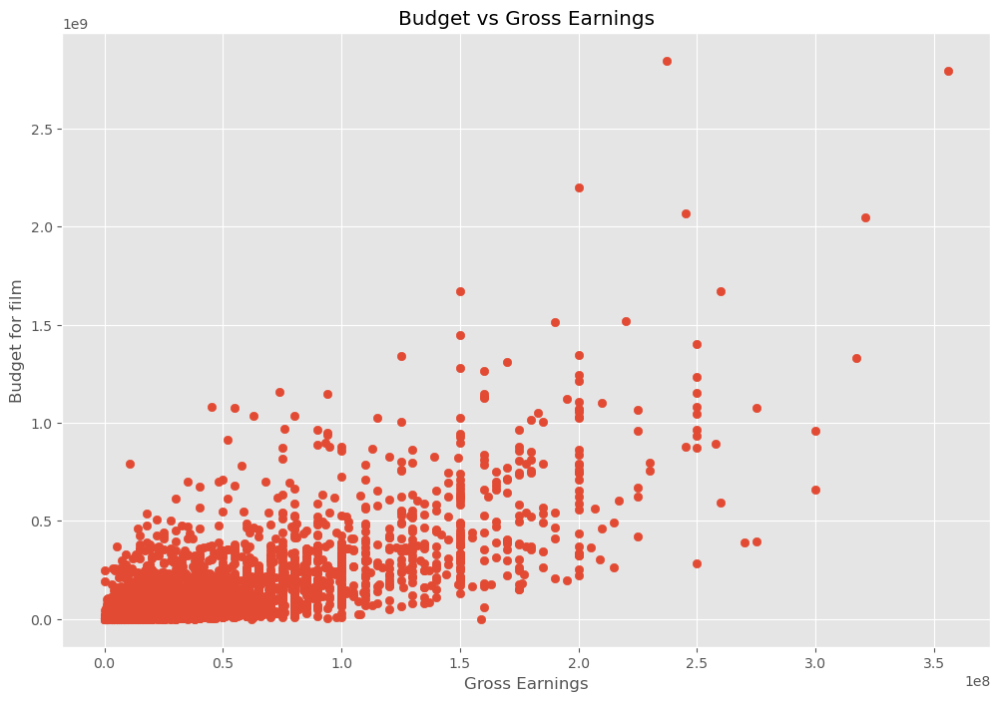

In [77]:
#checking the correlation between budget, gross and company


x=df['budget'].astype('float') 
y=df['gross'].astype('float')
plt.title('Budget vs Gross Earnings')
plt.xlabel('Gross Earnings')
plt.ylabel('Budget for film')

plt.scatter(x,y)




In [76]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,yearcorrect
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,NaN,162.0,Dece,2009
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,NaN,181.0,Apri,2019
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,NaN,194.0,Dece,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,NaN,138.0,Dece,2015
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,NaN,149.0,Apri,2018


In [82]:
print(df['budget'].unique())
print(df['gross'].unique())


<IntegerArray>
[237000000, 356000000, 200000000, 245000000, 321000000, 260000000, 150000000,
 220000000, 190000000, 250000000,
 ...
    323562,     75000,   5800000,    210000,    130000,     38000,   9400000,
    370000,      5000,     58750]
Length: 414, dtype: Int64
<IntegerArray>
[2847246203, 2797501328, 2201647264, 2069521700, 2048359754, 1670727580,
 1670516444, 1518815515, 1515341399, 1450026933,
 ...
       2037,       1808,       1672,       1605,       1400,        790,
        682,        596,        309,       <NA>]
Length: 7473, dtype: Int64


UFuncTypeError: Cannot cast ufunc 'svd_n_s' input from dtype('O') to dtype('float64') with casting rule 'same_kind'

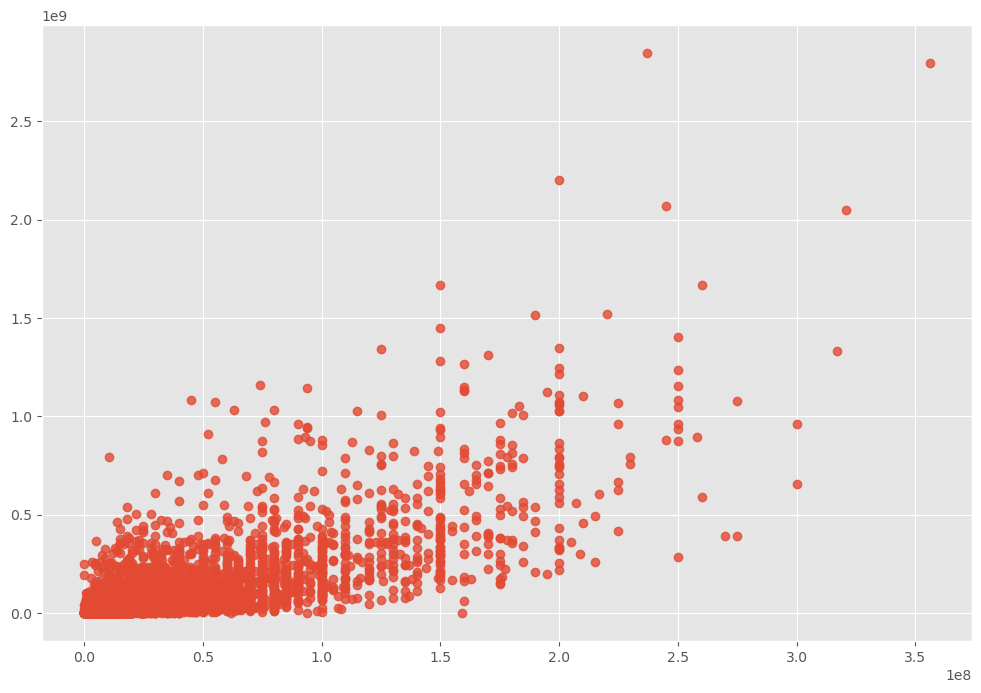

In [83]:
sns.regplot(x='budget', y='gross', data=df)

In [85]:
df.corr(method='pearson', numeric_only=True) #pearson, kendall, spearman

,year,score,votes,budget,gross,runtime
year,1.000000,0.097995,0.222945,0.329321,0.257486,0.120811
score,0.097995,1.000000,0.409182,0.076254,0.186258,0.399451
votes,0.222945,0.409182,1.000000,0.442429,0.630757,0.309212
budget,0.329321,0.076254,0.442429,1.000000,0.740395,0.320447
gross,0.257486,0.186258,0.630757,0.740395,1.000000,0.245216
runtime,0.120811,0.399451,0.309212,0.320447,0.245216,1.000000


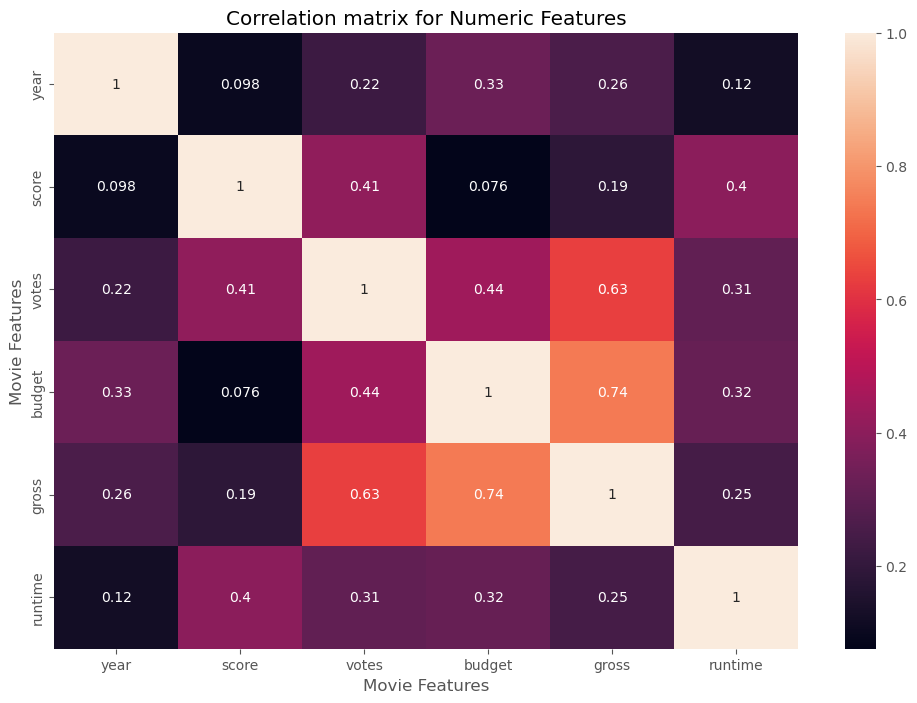

In [87]:
correlation_matrix = df.corr(method='pearson', numeric_only=True)

sns.heatmap(correlation_matrix, annot=True)

plt.title('Correlation matrix for Numeric Features')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')

plt.show()

In [88]:
#Looks at company

df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,yearcorrect
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,NaN,162.0,Dece,2009
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,NaN,181.0,Apri,2019
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,NaN,194.0,Dece,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,NaN,138.0,Dece,2015
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,NaN,149.0,Apri,2018


In [90]:
df_numerized = df

for col_name in df_numerized.columns:
    if(df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name] = df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes

df_numerized

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,yearcorrect
5445,533,5,0,2009,696,7.8,1100000.0,1155,1778,2334,55,237000000,2847246203,-1,162.0,10,29
7445,535,5,0,2019,183,8.4,903000.0,162,743,2241,55,356000000,2797501328,-1,181.0,8,39
3045,6896,5,6,1997,704,7.8,1100000.0,1155,1778,1595,55,200000000,2201647264,-1,194.0,10,17
6663,5144,5,0,2015,698,7.8,876000.0,1125,2550,524,55,245000000,2069521700,-1,138.0,10,35
7244,536,5,0,2018,192,8.4,897000.0,162,743,2241,55,321000000,2048359754,-1,149.0,8,38
7480,6194,4,2,2019,1488,6.9,222000.0,1455,1919,676,55,260000000,1670727580,-1,118.0,13,39
6653,2969,5,0,2015,1704,7.0,593000.0,517,3568,437,55,150000000,1670516444,-1,124.0,14,35
6043,5502,5,0,2012,2472,8.0,1300000.0,1517,2314,2241,55,220000000,1518815515,1605,143.0,16,32
6646,2145,5,0,2015,221,7.1,370000.0,1189,706,2721,55,190000000,1515341399,-1,137.0,8,35
7494,2131,4,2,2019,2676,6.8,148000.0,432,1950,1527,55,150000000,1450026933,-1,103.0,17,39


In [91]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,yearcorrect
5445,533,5,0,2009,696,7.8,1100000.0,1155,1778,2334,55,237000000,2847246203,-1,162.0,10,29
7445,535,5,0,2019,183,8.4,903000.0,162,743,2241,55,356000000,2797501328,-1,181.0,8,39
3045,6896,5,6,1997,704,7.8,1100000.0,1155,1778,1595,55,200000000,2201647264,-1,194.0,10,17
6663,5144,5,0,2015,698,7.8,876000.0,1125,2550,524,55,245000000,2069521700,-1,138.0,10,35
7244,536,5,0,2018,192,8.4,897000.0,162,743,2241,55,321000000,2048359754,-1,149.0,8,38
7480,6194,4,2,2019,1488,6.9,222000.0,1455,1919,676,55,260000000,1670727580,-1,118.0,13,39
6653,2969,5,0,2015,1704,7.0,593000.0,517,3568,437,55,150000000,1670516444,-1,124.0,14,35
6043,5502,5,0,2012,2472,8.0,1300000.0,1517,2314,2241,55,220000000,1518815515,1605,143.0,16,32
6646,2145,5,0,2015,221,7.1,370000.0,1189,706,2721,55,190000000,1515341399,-1,137.0,8,35
7494,2131,4,2,2019,2676,6.8,148000.0,432,1950,1527,55,150000000,1450026933,-1,103.0,17,39


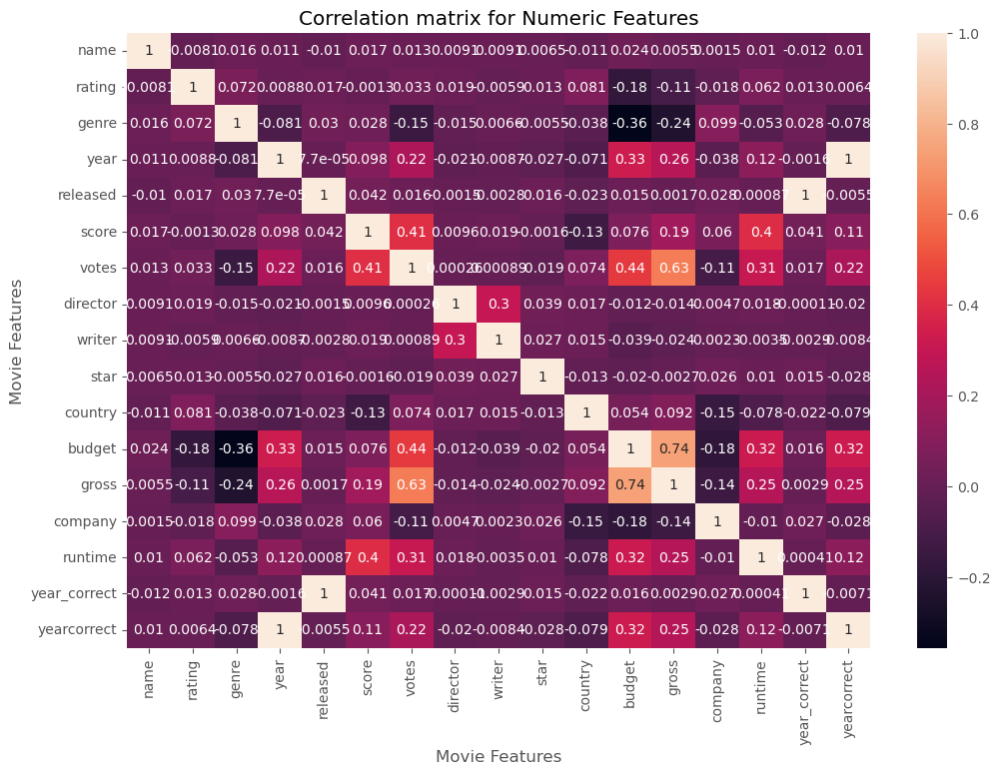

In [92]:
df_numerized = df.corr(method='pearson', numeric_only=True)

sns.heatmap(df_numerized, annot=True)

plt.title('Correlation matrix for Numeric Features')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')

plt.show()

In [93]:
df_numerized.corr()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,year_correct,yearcorrect
name,1.000000,-0.087566,0.000728,-0.102595,-0.131361,-0.100705,-0.129280,-0.068267,-0.064827,-0.058414,-0.070742,-0.076167,-0.110174,-0.036601,-0.114540,-0.131935,-0.102444
rating,-0.087566,1.000000,0.182440,-0.167826,-0.061007,-0.138833,-0.204795,-0.037035,-0.071514,-0.033387,0.094138,-0.409724,-0.362742,-0.029920,-0.098524,-0.063750,-0.167947
genre,0.000728,0.182440,1.000000,-0.335430,0.036436,-0.117560,-0.525585,-0.034829,0.007699,-0.008137,-0.119838,-0.716501,-0.639171,0.274173,-0.312176,0.034402,-0.329333
year,-0.102595,-0.167826,-0.335430,1.000000,-0.195373,0.094098,0.342869,-0.216994,-0.196682,-0.202489,-0.213309,0.504543,0.414182,-0.223241,0.172152,-0.195991,0.999880
released,-0.131361,-0.061007,0.036436,-0.195373,1.000000,-0.113159,-0.205943,-0.129488,-0.128367,-0.064100,-0.122263,-0.157214,-0.194165,0.011828,-0.201761,0.999978,-0.199951
score,-0.100705,-0.138833,-0.117560,0.094098,-0.113159,1.000000,0.552448,-0.156909,-0.142516,-0.150995,-0.347930,0.199424,0.294367,-0.027961,0.626849,-0.113206,0.100325
votes,-0.129280,-0.204795,-0.525585,0.342869,-0.205943,0.552448,1.000000,-0.214238,-0.221061,-0.215992,0.008721,0.751567,0.866174,-0.413186,0.546051,-0.204072,0.338311
director,-0.068267,-0.037035,-0.034829,-0.216994,-0.129488,-0.156909,-0.214238,1.000000,0.503672,0.007469,-0.016719,-0.185116,-0.205741,-0.030433,-0.159962,-0.127957,-0.215470
writer,-0.064827,-0.071514,0.007699,-0.196682,-0.128367,-0.142516,-0.221061,0.503672,1.000000,-0.011578,-0.024152,-0.218542,-0.225071,-0.024334,-0.193478,-0.127696,-0.194903
star,-0.058414,-0.033387,-0.008137,-0.202489,-0.064100,-0.150995,-0.215992,0.007469,-0.011578,1.000000,-0.071258,-0.170469,-0.174567,0.026834,-0.145340,-0.064032,-0.201604


In [94]:
correlation_mat = df_numerized.corr()

corr_pairs = correlation_mat.unstack()

corr_pairs

name          name            1.000000
              rating         -0.087566
              genre           0.000728
              year           -0.102595
              released       -0.131361
              score          -0.100705
              votes          -0.129280
              director       -0.068267
              writer         -0.064827
              star           -0.058414
              country        -0.070742
              budget         -0.076167
              gross          -0.110174
              company        -0.036601
              runtime        -0.114540
              year_correct   -0.131935
              yearcorrect    -0.102444
rating        name           -0.087566
              rating          1.000000
              genre           0.182440
              year           -0.167826
              released       -0.061007
              score          -0.138833
              votes          -0.204795
              director       -0.037035
              writer     

In [95]:
sorted_pairs = corr_pairs.sort_values()

sorted_pairs

genre         budget         -0.716501
budget        genre          -0.716501
gross         genre          -0.639171
genre         gross          -0.639171
              votes          -0.525585
votes         genre          -0.525585
budget        company        -0.466157
company       budget         -0.466157
gross         company        -0.455015
company       gross          -0.455015
              votes          -0.413186
votes         company        -0.413186
rating        budget         -0.409724
budget        rating         -0.409724
rating        gross          -0.362742
gross         rating         -0.362742
score         country        -0.347930
country       score          -0.347930
company       country        -0.340964
country       company        -0.340964
genre         year           -0.335430
year          genre          -0.335430
yearcorrect   genre          -0.329333
genre         yearcorrect    -0.329333
runtime       genre          -0.312176
genre         runtime    

In [96]:
high_corr = sorted_pairs[(sorted_pairs)> 0.5]

high_corr

director      writer          0.503672
writer        director        0.503672
year          budget          0.504543
budget        year            0.504543
runtime       votes           0.546051
votes         runtime         0.546051
              score           0.552448
score         votes           0.552448
runtime       score           0.626849
score         runtime         0.626849
budget        votes           0.751567
votes         budget          0.751567
gross         votes           0.866174
votes         gross           0.866174
gross         budget          0.941491
budget        gross           0.941491
year          yearcorrect     0.999880
yearcorrect   year            0.999880
year_correct  released        0.999978
released      year_correct    0.999978
name          name            1.000000
writer        writer          1.000000
runtime       runtime         1.000000
company       company         1.000000
gross         gross           1.000000
budget        budget     

In [ ]:
#Conclusion

#votes and budget have the highest correlation to gross earnings

#company has low correlation